In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'P4_2.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain]
x_val = xval
y_val = [yval,yval]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM, fx

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 292)      346896      input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 495)      145035      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        992         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/Desktop/Anomaly Detection/Anomaly-Detection/Consistency/Bayes_Lstm_P4-2/model checkpoint/P4-2_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik},loss_weights=[0.5,0.5],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 5000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 1128306.00000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00002: val_loss improved from 1128306.00000 to 786365.50000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00003: val_loss improved from 786365.50000 to 569188.68750, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00004: val_loss improved from 569188.68750 to 507462.37500, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00005: val_loss improved from 507462.37500 to 467531.87500, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00006: val_loss did not improve from 467531.87500

Epoch 00007: val_loss improved from 467531.87500 to 447798.31250, saving model to C:/Users/A


Epoch 00096: val_loss did not improve from 20706.83984

Epoch 00097: val_loss did not improve from 20706.83984

Epoch 00098: val_loss did not improve from 20706.83984

Epoch 00099: val_loss did not improve from 20706.83984

Epoch 00100: val_loss did not improve from 20706.83984

Epoch 00101: val_loss did not improve from 20706.83984

Epoch 00102: val_loss did not improve from 20706.83984

Epoch 00103: val_loss improved from 20706.83984 to 19884.93359, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00104: val_loss did not improve from 19884.93359

Epoch 00105: val_loss did not improve from 19884.93359

Epoch 00106: val_loss did not improve from 19884.93359

Epoch 00107: val_loss did not improve from 19884.93359

Epoch 00108: val_loss improved from 19884.93359 to 18913.55664, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00109: val_loss did not improve from 18913.55664

Epoch 00110: val_loss did not impro


Epoch 00213: val_loss did not improve from 14207.72852

Epoch 00214: val_loss did not improve from 14207.72852

Epoch 00215: val_loss did not improve from 14207.72852

Epoch 00216: val_loss did not improve from 14207.72852

Epoch 00217: val_loss did not improve from 14207.72852

Epoch 00218: val_loss did not improve from 14207.72852

Epoch 00219: val_loss did not improve from 14207.72852

Epoch 00220: val_loss improved from 14207.72852 to 13650.35938, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00221: val_loss did not improve from 13650.35938

Epoch 00222: val_loss did not improve from 13650.35938

Epoch 00223: val_loss did not improve from 13650.35938

Epoch 00224: val_loss did not improve from 13650.35938

Epoch 00225: val_loss improved from 13650.35938 to 13625.88574, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00226: val_loss did not improve from 13625.88574

Epoch 00227: val_loss did not impro


Epoch 00344: val_loss did not improve from 11887.72754

Epoch 00345: val_loss did not improve from 11887.72754

Epoch 00346: val_loss did not improve from 11887.72754

Epoch 00347: val_loss did not improve from 11887.72754

Epoch 00348: val_loss did not improve from 11887.72754

Epoch 00349: val_loss did not improve from 11887.72754

Epoch 00350: val_loss did not improve from 11887.72754

Epoch 00351: val_loss improved from 11887.72754 to 11169.51660, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00352: val_loss did not improve from 11169.51660

Epoch 00353: val_loss did not improve from 11169.51660

Epoch 00354: val_loss did not improve from 11169.51660

Epoch 00355: val_loss did not improve from 11169.51660

Epoch 00356: val_loss did not improve from 11169.51660

Epoch 00357: val_loss did not improve from 11169.51660

Epoch 00358: val_loss did not improve from 11169.51660

Epoch 00359: val_loss did not improve from 11169.51660

Epoch 00360: 

Epoch 00468: val_loss did not improve from 9451.93945

Epoch 00469: val_loss did not improve from 9451.93945

Epoch 00470: val_loss did not improve from 9451.93945

Epoch 00471: val_loss did not improve from 9451.93945

Epoch 00472: val_loss did not improve from 9451.93945

Epoch 00473: val_loss did not improve from 9451.93945

Epoch 00474: val_loss did not improve from 9451.93945

Epoch 00475: val_loss did not improve from 9451.93945

Epoch 00476: val_loss did not improve from 9451.93945

Epoch 00477: val_loss did not improve from 9451.93945

Epoch 00478: val_loss did not improve from 9451.93945

Epoch 00479: val_loss did not improve from 9451.93945

Epoch 00480: val_loss improved from 9451.93945 to 9320.58691, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00481: val_loss did not improve from 9320.58691

Epoch 00482: val_loss did not improve from 9320.58691

Epoch 00483: val_loss did not improve from 9320.58691

Epoch 00484: val_loss did not i


Epoch 00728: val_loss did not improve from 6033.21094

Epoch 00729: val_loss did not improve from 6033.21094

Epoch 00730: val_loss did not improve from 6033.21094

Epoch 00731: val_loss did not improve from 6033.21094

Epoch 00732: val_loss did not improve from 6033.21094

Epoch 00733: val_loss did not improve from 6033.21094

Epoch 00734: val_loss did not improve from 6033.21094

Epoch 00735: val_loss did not improve from 6033.21094

Epoch 00736: val_loss did not improve from 6033.21094

Epoch 00737: val_loss did not improve from 6033.21094

Epoch 00738: val_loss did not improve from 6033.21094

Epoch 00739: val_loss improved from 6033.21094 to 5976.06348, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00740: val_loss did not improve from 5976.06348

Epoch 00741: val_loss did not improve from 5976.06348

Epoch 00742: val_loss did not improve from 5976.06348

Epoch 00743: val_loss did not improve from 5976.06348

Epoch 00744: val_loss did not 

Epoch 00863: val_loss did not improve from 4738.37012

Epoch 00864: val_loss did not improve from 4738.37012

Epoch 00865: val_loss did not improve from 4738.37012

Epoch 00866: val_loss did not improve from 4738.37012

Epoch 00867: val_loss did not improve from 4738.37012

Epoch 00868: val_loss improved from 4738.37012 to 4578.54834, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00869: val_loss did not improve from 4578.54834

Epoch 00870: val_loss improved from 4578.54834 to 4401.64697, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00871: val_loss did not improve from 4401.64697

Epoch 00872: val_loss did not improve from 4401.64697

Epoch 00873: val_loss did not improve from 4401.64697

Epoch 00874: val_loss did not improve from 4401.64697

Epoch 00875: val_loss did not improve from 4401.64697

Epoch 00876: val_loss did not improve from 4401.64697

Epoch 00877: val_loss did not improve from 4401.6469


Epoch 00997: val_loss did not improve from 3408.99756

Epoch 00998: val_loss improved from 3408.99756 to 3287.20337, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 00999: val_loss did not improve from 3287.20337

Epoch 01000: val_loss did not improve from 3287.20337

Epoch 01001: val_loss did not improve from 3287.20337

Epoch 01002: val_loss did not improve from 3287.20337

Epoch 01003: val_loss did not improve from 3287.20337

Epoch 01004: val_loss did not improve from 3287.20337

Epoch 01005: val_loss did not improve from 3287.20337

Epoch 01006: val_loss did not improve from 3287.20337

Epoch 01007: val_loss did not improve from 3287.20337

Epoch 01008: val_loss did not improve from 3287.20337

Epoch 01009: val_loss did not improve from 3287.20337

Epoch 01010: val_loss did not improve from 3287.20337

Epoch 01011: val_loss did not improve from 3287.20337

Epoch 01012: val_loss did not improve from 3287.20337

Epoch 01013: val_loss did not 


Epoch 01130: val_loss did not improve from 2510.48584

Epoch 01131: val_loss improved from 2510.48584 to 2275.39941, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P4-2/model checkpoint\P4-2_ckpt

Epoch 01132: val_loss did not improve from 2275.39941

Epoch 01133: val_loss did not improve from 2275.39941

Epoch 01134: val_loss did not improve from 2275.39941

Epoch 01135: val_loss did not improve from 2275.39941

Epoch 01136: val_loss did not improve from 2275.39941

Epoch 01137: val_loss did not improve from 2275.39941

Epoch 01138: val_loss did not improve from 2275.39941

Epoch 01139: val_loss did not improve from 2275.39941

Epoch 01140: val_loss did not improve from 2275.39941

Epoch 01141: val_loss did not improve from 2275.39941

Epoch 01142: val_loss did not improve from 2275.39941

Epoch 01143: val_loss did not improve from 2275.39941

Epoch 01144: val_loss did not improve from 2275.39941

Epoch 01145: val_loss did not improve from 2275.39941

Epoch 01146: val_loss did not 


Epoch 01269: val_loss did not improve from 1343.42542

Epoch 01270: val_loss did not improve from 1343.42542

Epoch 01271: val_loss did not improve from 1343.42542

Epoch 01272: val_loss did not improve from 1343.42542

Epoch 01273: val_loss did not improve from 1343.42542

Epoch 01274: val_loss did not improve from 1343.42542

Epoch 01275: val_loss did not improve from 1343.42542

Epoch 01276: val_loss did not improve from 1343.42542

Epoch 01277: val_loss did not improve from 1343.42542

Epoch 01278: val_loss did not improve from 1343.42542

Epoch 01279: val_loss did not improve from 1343.42542

Epoch 01280: val_loss did not improve from 1343.42542

Epoch 01281: val_loss did not improve from 1343.42542

Epoch 01282: val_loss did not improve from 1343.42542

Epoch 01283: val_loss did not improve from 1343.42542

Epoch 01284: val_loss did not improve from 1343.42542

Epoch 01285: val_loss did not improve from 1343.42542

Epoch 01286: val_loss did not improve from 1343.42542

Epoch 012

Epoch 01547: val_loss did not improve from 123.60066

Epoch 01548: val_loss did not improve from 123.60066

Epoch 01549: val_loss did not improve from 123.60066

Epoch 01550: val_loss did not improve from 123.60066

Epoch 01551: val_loss did not improve from 123.60066

Epoch 01552: val_loss did not improve from 123.60066

Epoch 01553: val_loss did not improve from 123.60066

Epoch 01554: val_loss did not improve from 123.60066

Epoch 01555: val_loss did not improve from 123.60066

Epoch 01556: val_loss did not improve from 123.60066

Epoch 01557: val_loss did not improve from 123.60066

Epoch 01558: val_loss did not improve from 123.60066

Epoch 01559: val_loss did not improve from 123.60066

Epoch 01560: val_loss did not improve from 123.60066

Epoch 01561: val_loss did not improve from 123.60066

Epoch 01562: val_loss did not improve from 123.60066

Epoch 01563: val_loss did not improve from 123.60066

Epoch 01564: val_loss did not improve from 123.60066

Epoch 01565: val_loss did no


Epoch 01700: val_loss did not improve from 123.60066

Epoch 01701: val_loss did not improve from 123.60066

Epoch 01702: val_loss did not improve from 123.60066

Epoch 01703: val_loss did not improve from 123.60066

Epoch 01704: val_loss did not improve from 123.60066

Epoch 01705: val_loss did not improve from 123.60066

Epoch 01706: val_loss did not improve from 123.60066

Epoch 01707: val_loss did not improve from 123.60066

Epoch 01708: val_loss did not improve from 123.60066

Epoch 01709: val_loss did not improve from 123.60066

Epoch 01710: val_loss did not improve from 123.60066

Epoch 01711: val_loss did not improve from 123.60066

Epoch 01712: val_loss did not improve from 123.60066

Epoch 01713: val_loss did not improve from 123.60066

Epoch 01714: val_loss did not improve from 123.60066

Epoch 01715: val_loss did not improve from 123.60066

Epoch 01716: val_loss did not improve from 123.60066

Epoch 01717: val_loss did not improve from 123.60066

Epoch 01718: val_loss did n


Epoch 01852: val_loss did not improve from 109.24216

Epoch 01853: val_loss did not improve from 109.24216

Epoch 01854: val_loss did not improve from 109.24216

Epoch 01855: val_loss did not improve from 109.24216

Epoch 01856: val_loss did not improve from 109.24216

Epoch 01857: val_loss did not improve from 109.24216

Epoch 01858: val_loss did not improve from 109.24216

Epoch 01859: val_loss did not improve from 109.24216

Epoch 01860: val_loss did not improve from 109.24216

Epoch 01861: val_loss did not improve from 109.24216

Epoch 01862: val_loss did not improve from 109.24216

Epoch 01863: val_loss did not improve from 109.24216

Epoch 01864: val_loss did not improve from 109.24216

Epoch 01865: val_loss did not improve from 109.24216

Epoch 01866: val_loss did not improve from 109.24216

Epoch 01867: val_loss did not improve from 109.24216

Epoch 01868: val_loss did not improve from 109.24216

Epoch 01869: val_loss did not improve from 109.24216

Epoch 01870: val_loss did n

Epoch 02005: val_loss did not improve from 97.86037

Epoch 02006: val_loss did not improve from 97.86037

Epoch 02007: val_loss did not improve from 97.86037

Epoch 02008: val_loss did not improve from 97.86037

Epoch 02009: val_loss did not improve from 97.86037

Epoch 02010: val_loss did not improve from 97.86037

Epoch 02011: val_loss did not improve from 97.86037

Epoch 02012: val_loss did not improve from 97.86037

Epoch 02013: val_loss did not improve from 97.86037

Epoch 02014: val_loss did not improve from 97.86037

Epoch 02015: val_loss did not improve from 97.86037

Epoch 02016: val_loss did not improve from 97.86037

Epoch 02017: val_loss did not improve from 97.86037

Epoch 02018: val_loss did not improve from 97.86037

Epoch 02019: val_loss did not improve from 97.86037

Epoch 02020: val_loss did not improve from 97.86037

Epoch 02021: val_loss did not improve from 97.86037

Epoch 02022: val_loss did not improve from 97.86037

Epoch 02023: val_loss did not improve from 97.


Epoch 02160: val_loss did not improve from 95.50401

Epoch 02161: val_loss did not improve from 95.50401

Epoch 02162: val_loss did not improve from 95.50401

Epoch 02163: val_loss did not improve from 95.50401

Epoch 02164: val_loss did not improve from 95.50401

Epoch 02165: val_loss did not improve from 95.50401

Epoch 02166: val_loss did not improve from 95.50401

Epoch 02167: val_loss did not improve from 95.50401

Epoch 02168: val_loss did not improve from 95.50401

Epoch 02169: val_loss did not improve from 95.50401

Epoch 02170: val_loss did not improve from 95.50401

Epoch 02171: val_loss did not improve from 95.50401

Epoch 02172: val_loss did not improve from 95.50401

Epoch 02173: val_loss did not improve from 95.50401

Epoch 02174: val_loss did not improve from 95.50401

Epoch 02175: val_loss did not improve from 95.50401

Epoch 02176: val_loss did not improve from 95.50401

Epoch 02177: val_loss did not improve from 95.50401

Epoch 02178: val_loss did not improve from 95

Epoch 02470: val_loss did not improve from 95.50401

Epoch 02471: val_loss did not improve from 95.50401

Epoch 02472: val_loss did not improve from 95.50401

Epoch 02473: val_loss did not improve from 95.50401

Epoch 02474: val_loss did not improve from 95.50401

Epoch 02475: val_loss did not improve from 95.50401

Epoch 02476: val_loss did not improve from 95.50401

Epoch 02477: val_loss did not improve from 95.50401

Epoch 02478: val_loss did not improve from 95.50401

Epoch 02479: val_loss did not improve from 95.50401

Epoch 02480: val_loss did not improve from 95.50401

Epoch 02481: val_loss did not improve from 95.50401

Epoch 02482: val_loss did not improve from 95.50401

Epoch 02483: val_loss did not improve from 95.50401

Epoch 02484: val_loss did not improve from 95.50401

Epoch 02485: val_loss did not improve from 95.50401

Epoch 02486: val_loss did not improve from 95.50401

Epoch 02487: val_loss did not improve from 95.50401

Epoch 02488: val_loss did not improve from 95.


Epoch 02627: val_loss did not improve from 95.50401

Epoch 02628: val_loss did not improve from 95.50401

Epoch 02629: val_loss did not improve from 95.50401

Epoch 02630: val_loss did not improve from 95.50401

Epoch 02631: val_loss did not improve from 95.50401

Epoch 02632: val_loss did not improve from 95.50401

Epoch 02633: val_loss did not improve from 95.50401

Epoch 02634: val_loss did not improve from 95.50401

Epoch 02635: val_loss did not improve from 95.50401

Epoch 02636: val_loss did not improve from 95.50401

Epoch 02637: val_loss did not improve from 95.50401

Epoch 02638: val_loss did not improve from 95.50401

Epoch 02639: val_loss did not improve from 95.50401

Epoch 02640: val_loss did not improve from 95.50401

Epoch 02641: val_loss did not improve from 95.50401

Epoch 02642: val_loss did not improve from 95.50401

Epoch 02643: val_loss did not improve from 95.50401

Epoch 02644: val_loss did not improve from 95.50401

Epoch 02645: val_loss did not improve from 95

Epoch 02783: val_loss did not improve from 95.50401

Epoch 02784: val_loss did not improve from 95.50401

Epoch 02785: val_loss did not improve from 95.50401

Epoch 02786: val_loss did not improve from 95.50401

Epoch 02787: val_loss did not improve from 95.50401

Epoch 02788: val_loss did not improve from 95.50401

Epoch 02789: val_loss did not improve from 95.50401

Epoch 02790: val_loss did not improve from 95.50401

Epoch 02791: val_loss did not improve from 95.50401

Epoch 02792: val_loss did not improve from 95.50401

Epoch 02793: val_loss did not improve from 95.50401

Epoch 02794: val_loss did not improve from 95.50401

Epoch 02795: val_loss did not improve from 95.50401

Epoch 02796: val_loss did not improve from 95.50401

Epoch 02797: val_loss did not improve from 95.50401

Epoch 02798: val_loss did not improve from 95.50401

Epoch 02799: val_loss did not improve from 95.50401

Epoch 02800: val_loss did not improve from 95.50401

Epoch 02801: val_loss did not improve from 95.

Epoch 02938: val_loss did not improve from 95.50401

Epoch 02939: val_loss did not improve from 95.50401

Epoch 02940: val_loss did not improve from 95.50401

Epoch 02941: val_loss did not improve from 95.50401

Epoch 02942: val_loss did not improve from 95.50401

Epoch 02943: val_loss did not improve from 95.50401

Epoch 02944: val_loss did not improve from 95.50401

Epoch 02945: val_loss did not improve from 95.50401

Epoch 02946: val_loss did not improve from 95.50401

Epoch 02947: val_loss did not improve from 95.50401

Epoch 02948: val_loss did not improve from 95.50401

Epoch 02949: val_loss did not improve from 95.50401

Epoch 02950: val_loss did not improve from 95.50401

Epoch 02951: val_loss did not improve from 95.50401

Epoch 02952: val_loss did not improve from 95.50401

Epoch 02953: val_loss did not improve from 95.50401

Epoch 02954: val_loss did not improve from 95.50401

Epoch 02955: val_loss did not improve from 95.50401

Epoch 02956: val_loss did not improve from 95.

Epoch 03094: val_loss did not improve from 95.50401

Epoch 03095: val_loss did not improve from 95.50401

Epoch 03096: val_loss did not improve from 95.50401

Epoch 03097: val_loss did not improve from 95.50401

Epoch 03098: val_loss did not improve from 95.50401

Epoch 03099: val_loss did not improve from 95.50401

Epoch 03100: val_loss did not improve from 95.50401

Epoch 03101: val_loss did not improve from 95.50401

Epoch 03102: val_loss did not improve from 95.50401

Epoch 03103: val_loss did not improve from 95.50401

Epoch 03104: val_loss did not improve from 95.50401

Epoch 03105: val_loss did not improve from 95.50401

Epoch 03106: val_loss did not improve from 95.50401

Epoch 03107: val_loss did not improve from 95.50401

Epoch 03108: val_loss did not improve from 95.50401

Epoch 03109: val_loss did not improve from 95.50401

Epoch 03110: val_loss did not improve from 95.50401

Epoch 03111: val_loss did not improve from 95.50401

Epoch 03112: val_loss did not improve from 95.

Epoch 03249: val_loss did not improve from 95.50401

Epoch 03250: val_loss did not improve from 95.50401

Epoch 03251: val_loss did not improve from 95.50401

Epoch 03252: val_loss did not improve from 95.50401

Epoch 03253: val_loss did not improve from 95.50401

Epoch 03254: val_loss did not improve from 95.50401

Epoch 03255: val_loss did not improve from 95.50401

Epoch 03256: val_loss did not improve from 95.50401

Epoch 03257: val_loss did not improve from 95.50401

Epoch 03258: val_loss did not improve from 95.50401

Epoch 03259: val_loss did not improve from 95.50401

Epoch 03260: val_loss did not improve from 95.50401

Epoch 03261: val_loss did not improve from 95.50401

Epoch 03262: val_loss did not improve from 95.50401

Epoch 03263: val_loss did not improve from 95.50401

Epoch 03264: val_loss did not improve from 95.50401

Epoch 03265: val_loss did not improve from 95.50401

Epoch 03266: val_loss did not improve from 95.50401

Epoch 03267: val_loss did not improve from 95.


Epoch 03405: val_loss did not improve from 95.50401

Epoch 03406: val_loss did not improve from 95.50401

Epoch 03407: val_loss did not improve from 95.50401

Epoch 03408: val_loss did not improve from 95.50401

Epoch 03409: val_loss did not improve from 95.50401

Epoch 03410: val_loss did not improve from 95.50401

Epoch 03411: val_loss did not improve from 95.50401

Epoch 03412: val_loss did not improve from 95.50401

Epoch 03413: val_loss did not improve from 95.50401

Epoch 03414: val_loss did not improve from 95.50401

Epoch 03415: val_loss did not improve from 95.50401

Epoch 03416: val_loss did not improve from 95.50401

Epoch 03417: val_loss did not improve from 95.50401

Epoch 03418: val_loss did not improve from 95.50401

Epoch 03419: val_loss did not improve from 95.50401

Epoch 03420: val_loss did not improve from 95.50401

Epoch 03421: val_loss did not improve from 95.50401

Epoch 03422: val_loss did not improve from 95.50401

Epoch 03423: val_loss did not improve from 95

Epoch 03561: val_loss did not improve from 95.50401

Epoch 03562: val_loss did not improve from 95.50401

Epoch 03563: val_loss did not improve from 95.50401

Epoch 03564: val_loss did not improve from 95.50401

Epoch 03565: val_loss did not improve from 95.50401

Epoch 03566: val_loss did not improve from 95.50401

Epoch 03567: val_loss did not improve from 95.50401

Epoch 03568: val_loss did not improve from 95.50401

Epoch 03569: val_loss did not improve from 95.50401

Epoch 03570: val_loss did not improve from 95.50401

Epoch 03571: val_loss did not improve from 95.50401

Epoch 03572: val_loss did not improve from 95.50401

Epoch 03573: val_loss did not improve from 95.50401

Epoch 03574: val_loss did not improve from 95.50401

Epoch 03575: val_loss did not improve from 95.50401

Epoch 03576: val_loss did not improve from 95.50401

Epoch 03577: val_loss did not improve from 95.50401

Epoch 03578: val_loss did not improve from 95.50401

Epoch 03579: val_loss did not improve from 95.


Epoch 03717: val_loss did not improve from 95.50401

Epoch 03718: val_loss did not improve from 95.50401

Epoch 03719: val_loss did not improve from 95.50401

Epoch 03720: val_loss did not improve from 95.50401

Epoch 03721: val_loss did not improve from 95.50401

Epoch 03722: val_loss did not improve from 95.50401

Epoch 03723: val_loss did not improve from 95.50401

Epoch 03724: val_loss did not improve from 95.50401

Epoch 03725: val_loss did not improve from 95.50401

Epoch 03726: val_loss did not improve from 95.50401

Epoch 03727: val_loss did not improve from 95.50401

Epoch 03728: val_loss did not improve from 95.50401

Epoch 03729: val_loss did not improve from 95.50401

Epoch 03730: val_loss did not improve from 95.50401

Epoch 03731: val_loss did not improve from 95.50401

Epoch 03732: val_loss did not improve from 95.50401

Epoch 03733: val_loss did not improve from 95.50401

Epoch 03734: val_loss did not improve from 95.50401

Epoch 03735: val_loss did not improve from 95


Epoch 03872: val_loss did not improve from 95.50401

Epoch 03873: val_loss did not improve from 95.50401

Epoch 03874: val_loss did not improve from 95.50401

Epoch 03875: val_loss did not improve from 95.50401

Epoch 03876: val_loss did not improve from 95.50401

Epoch 03877: val_loss did not improve from 95.50401

Epoch 03878: val_loss did not improve from 95.50401

Epoch 03879: val_loss did not improve from 95.50401

Epoch 03880: val_loss did not improve from 95.50401

Epoch 03881: val_loss did not improve from 95.50401

Epoch 03882: val_loss did not improve from 95.50401

Epoch 03883: val_loss did not improve from 95.50401

Epoch 03884: val_loss did not improve from 95.50401

Epoch 03885: val_loss did not improve from 95.50401

Epoch 03886: val_loss did not improve from 95.50401

Epoch 03887: val_loss did not improve from 95.50401

Epoch 03888: val_loss did not improve from 95.50401

Epoch 03889: val_loss did not improve from 95.50401

Epoch 03890: val_loss did not improve from 95


Epoch 04182: val_loss did not improve from 95.50401

Epoch 04183: val_loss did not improve from 95.50401

Epoch 04184: val_loss did not improve from 95.50401

Epoch 04185: val_loss did not improve from 95.50401

Epoch 04186: val_loss did not improve from 95.50401

Epoch 04187: val_loss did not improve from 95.50401

Epoch 04188: val_loss did not improve from 95.50401

Epoch 04189: val_loss did not improve from 95.50401

Epoch 04190: val_loss did not improve from 95.50401

Epoch 04191: val_loss did not improve from 95.50401

Epoch 04192: val_loss did not improve from 95.50401

Epoch 04193: val_loss did not improve from 95.50401

Epoch 04194: val_loss did not improve from 95.50401

Epoch 04195: val_loss did not improve from 95.50401

Epoch 04196: val_loss did not improve from 95.50401

Epoch 04197: val_loss did not improve from 95.50401

Epoch 04198: val_loss did not improve from 95.50401

Epoch 04199: val_loss did not improve from 95.50401

Epoch 04200: val_loss did not improve from 95


Epoch 04337: val_loss did not improve from 95.50401

Epoch 04338: val_loss did not improve from 95.50401

Epoch 04339: val_loss did not improve from 95.50401

Epoch 04340: val_loss did not improve from 95.50401

Epoch 04341: val_loss did not improve from 95.50401

Epoch 04342: val_loss did not improve from 95.50401

Epoch 04343: val_loss did not improve from 95.50401

Epoch 04344: val_loss did not improve from 95.50401

Epoch 04345: val_loss did not improve from 95.50401

Epoch 04346: val_loss did not improve from 95.50401

Epoch 04347: val_loss did not improve from 95.50401

Epoch 04348: val_loss did not improve from 95.50401

Epoch 04349: val_loss did not improve from 95.50401

Epoch 04350: val_loss did not improve from 95.50401

Epoch 04351: val_loss did not improve from 95.50401

Epoch 04352: val_loss did not improve from 95.50401

Epoch 04353: val_loss did not improve from 95.50401

Epoch 04354: val_loss did not improve from 95.50401

Epoch 04355: val_loss did not improve from 95


Epoch 04493: val_loss did not improve from 95.50401

Epoch 04494: val_loss did not improve from 95.50401

Epoch 04495: val_loss did not improve from 95.50401

Epoch 04496: val_loss did not improve from 95.50401

Epoch 04497: val_loss did not improve from 95.50401

Epoch 04498: val_loss did not improve from 95.50401

Epoch 04499: val_loss did not improve from 95.50401

Epoch 04500: val_loss did not improve from 95.50401

Epoch 04501: val_loss did not improve from 95.50401

Epoch 04502: val_loss did not improve from 95.50401

Epoch 04503: val_loss did not improve from 95.50401

Epoch 04504: val_loss did not improve from 95.50401

Epoch 04505: val_loss did not improve from 95.50401

Epoch 04506: val_loss did not improve from 95.50401

Epoch 04507: val_loss did not improve from 95.50401

Epoch 04508: val_loss did not improve from 95.50401

Epoch 04509: val_loss did not improve from 95.50401

Epoch 04510: val_loss did not improve from 95.50401

Epoch 04511: val_loss did not improve from 95


Epoch 04649: val_loss did not improve from 95.50401

Epoch 04650: val_loss did not improve from 95.50401

Epoch 04651: val_loss did not improve from 95.50401

Epoch 04652: val_loss did not improve from 95.50401

Epoch 04653: val_loss did not improve from 95.50401

Epoch 04654: val_loss did not improve from 95.50401

Epoch 04655: val_loss did not improve from 95.50401

Epoch 04656: val_loss did not improve from 95.50401

Epoch 04657: val_loss did not improve from 95.50401

Epoch 04658: val_loss did not improve from 95.50401

Epoch 04659: val_loss did not improve from 95.50401

Epoch 04660: val_loss did not improve from 95.50401

Epoch 04661: val_loss did not improve from 95.50401

Epoch 04662: val_loss did not improve from 95.50401

Epoch 04663: val_loss did not improve from 95.50401

Epoch 04664: val_loss did not improve from 95.50401

Epoch 04665: val_loss did not improve from 95.50401

Epoch 04666: val_loss did not improve from 95.50401

Epoch 04667: val_loss did not improve from 95


Epoch 04804: val_loss did not improve from 95.50401

Epoch 04805: val_loss did not improve from 95.50401

Epoch 04806: val_loss did not improve from 95.50401

Epoch 04807: val_loss did not improve from 95.50401

Epoch 04808: val_loss did not improve from 95.50401

Epoch 04809: val_loss did not improve from 95.50401

Epoch 04810: val_loss did not improve from 95.50401

Epoch 04811: val_loss did not improve from 95.50401

Epoch 04812: val_loss did not improve from 95.50401

Epoch 04813: val_loss did not improve from 95.50401

Epoch 04814: val_loss did not improve from 95.50401

Epoch 04815: val_loss did not improve from 95.50401

Epoch 04816: val_loss did not improve from 95.50401

Epoch 04817: val_loss did not improve from 95.50401

Epoch 04818: val_loss did not improve from 95.50401

Epoch 04819: val_loss did not improve from 95.50401

Epoch 04820: val_loss did not improve from 95.50401

Epoch 04821: val_loss did not improve from 95.50401

Epoch 04822: val_loss did not improve from 95


Epoch 04959: val_loss did not improve from 95.50401

Epoch 04960: val_loss did not improve from 95.50401

Epoch 04961: val_loss did not improve from 95.50401

Epoch 04962: val_loss did not improve from 95.50401

Epoch 04963: val_loss did not improve from 95.50401

Epoch 04964: val_loss did not improve from 95.50401

Epoch 04965: val_loss did not improve from 95.50401

Epoch 04966: val_loss did not improve from 95.50401

Epoch 04967: val_loss did not improve from 95.50401

Epoch 04968: val_loss did not improve from 95.50401

Epoch 04969: val_loss did not improve from 95.50401

Epoch 04970: val_loss did not improve from 95.50401

Epoch 04971: val_loss did not improve from 95.50401

Epoch 04972: val_loss did not improve from 95.50401

Epoch 04973: val_loss did not improve from 95.50401

Epoch 04974: val_loss did not improve from 95.50401

Epoch 04975: val_loss did not improve from 95.50401

Epoch 04976: val_loss did not improve from 95.50401

Epoch 04977: val_loss did not improve from 95

In [25]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#SHAP cannot be used with model with probabilistic layers. So, define non probabilistic f'x

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 292)           346896    
_________________________________________________________________
dense_2 (Dense)              (None, 24, 495)           145035    
_________________________________________________________________
dense_3 (Dense)              (None, 24, 1)             496       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 492,427
Trainable params: 492,427
Non-trainable params: 0
_________________________________________________________________


In [27]:
#Extract only "Mean" weights, exclude "Standard Deviation" weights

a = model.layers[3].get_weights()

b = np.zeros((len(a[0]),1))
for x in range(len(a[0])):
    b[x] = a[0][x][0]
    
d = np.zeros(1)
for x in range(1):
    d[x] = a[1][x]
    
c = [b,d]

In [28]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(c)

In [29]:
#Transfer weights from fx to f'x

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [30]:
#Import SHAP & initialized JS for f'x explanation

import shap
shap.initjs()

In [31]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [32]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

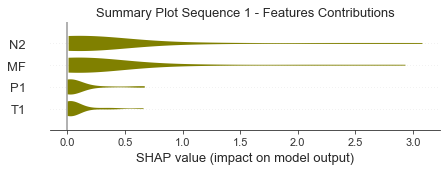

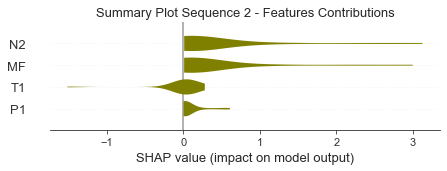

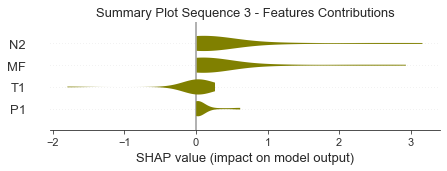

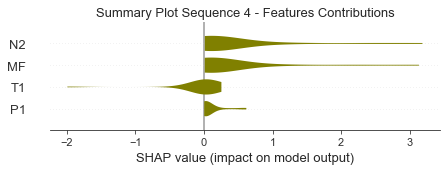

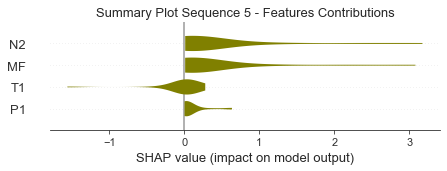

...

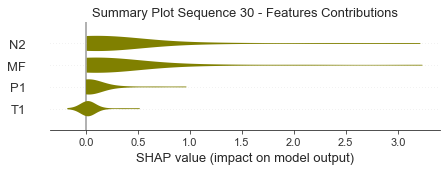

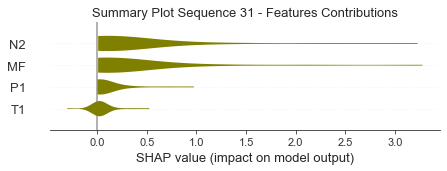

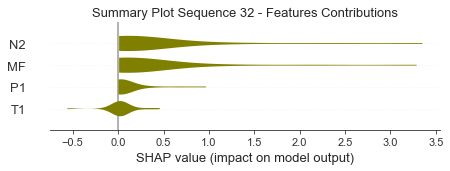

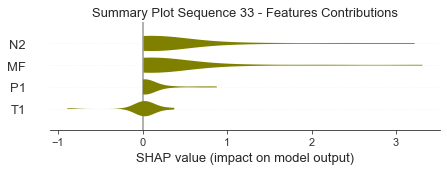

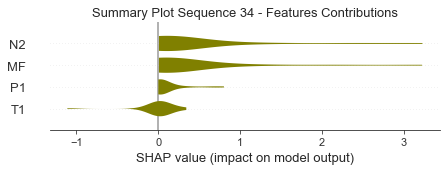

In [34]:
#SHAP Summmary Plot

import seaborn as sns
sns.set_style('ticks')
instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="violin", color='olive')
    plt.title("Summary Plot Sequence %i - Features Contributions" %(i+1),fontsize=13)
    plt.figure
    plt.show()

In [35]:
#SHAP Force Plot

import seaborn as sns
sns.set_style("ticks")
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    # Per individual array 
    for j in range(24):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,4),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


3 1


3 2


3 3


3 4


3 5


3 6


3 7


3 8


3 9


3 10


3 11


3 12


3 13


3 14


3 15


3 16


3 17


3 18


3 19


3 20


3 21


3 22


3 23


3 24


4 1


4 2


4 3


4 4


4 5


4 6


4 7


4 8


4 9


4 10


4 11


4 12


4 13


4 14


4 15


4 16


4 17


4 18


4 19


4 20


4 21


4 22


4 23


4 24


5 1


5 2


5 3


5 4


5 5


5 6


5 7


5 8


5 9


5 10


5 11


5 12


5 13


5 14


5 15


5 16


5 17


5 18


5 19


5 20


5 21


5 22


5 23


5 24


6 1


6 2


6 3


6 4


6 5


6 6


6 7


6 8


6 9


6 10


6 11


6 12


6 13


6 14


6 15


6 16


6 17


6 18


6 19


6 20


6 21


6 22


6 23


6 24


7 1


7 2


7 3


7 4


7 5


7 6


7 7


7 8


7 9


7 10


7 11


7 12


7 13


7 14


7 15


7 16


7 17


7 18


7 19


7 20


7 21


7 22


7 23


7 24


8 1


8 2


8 3


8 4


8 5


8 6


8 7


8 8


8 9


8 10


8 11


8 12


8 13


8 14


8 15


8 16


8 17


8 18


8 19


8 20


8 21


8 22


8 23


8 24


9 1


9 2


9 3


9 4


9 5


9 6


9 7


9 8


9 9


9 10


9 11


9 12


9 13


9 14


9 15


9 16


9 17


9 18


9 19


9 20


9 21


9 22


9 23


9 24


10 1


10 2


10 3


10 4


10 5


10 6


10 7


10 8


10 9


10 10


10 11


10 12


10 13


10 14


10 15


10 16


10 17


10 18


10 19


10 20


10 21


10 22


10 23


10 24


11 1


11 2


11 3


11 4


11 5


11 6


11 7


11 8


11 9


11 10


11 11


11 12


11 13


11 14


11 15


11 16


11 17


11 18


11 19


11 20


11 21


11 22


11 23


11 24


12 1


12 2


12 3


12 4


12 5


12 6


12 7


12 8


12 9


12 10


12 11


12 12


12 13


12 14


12 15


12 16


12 17


12 18


12 19


12 20


12 21


12 22


12 23


12 24


13 1


13 2


13 3


13 4


13 5


13 6


13 7


13 8


13 9


13 10


13 11


13 12


13 13


13 14


13 15


13 16


13 17


13 18


13 19


13 20


13 21


13 22


13 23


13 24


14 1


14 2


14 3


14 4


14 5


14 6


14 7


14 8


14 9


14 10


14 11


14 12


14 13


14 14


14 15


14 16


14 17


14 18


14 19


14 20


14 21


14 22


14 23


14 24


15 1


15 2


15 3


15 4


15 5


15 6


15 7


15 8


15 9


15 10


15 11


15 12


15 13


15 14


15 15


15 16


15 17


15 18


15 19


15 20


15 21


15 22


15 23


15 24


16 1


16 2


16 3


16 4


16 5


16 6


16 7


16 8


16 9


16 10


16 11


16 12


16 13


16 14


16 15


16 16


16 17


16 18


16 19


16 20


16 21


16 22


16 23


16 24


17 1


17 2


17 3


17 4


17 5


17 6


17 7


17 8


17 9


17 10


17 11


17 12


17 13


17 14


17 15


17 16


17 17


17 18


17 19


17 20


17 21


17 22


17 23


17 24


18 1


18 2


18 3


18 4


18 5


18 6


18 7


18 8


18 9


18 10


18 11


18 12


18 13


18 14


18 15


18 16


18 17


18 18


18 19


18 20


18 21


18 22


18 23


18 24


19 1


19 2


19 3


19 4


19 5


19 6


19 7


19 8


19 9


19 10


19 11


19 12


19 13


19 14


19 15


19 16


19 17


19 18


19 19


19 20


19 21


19 22


19 23


19 24


20 1


20 2


20 3


20 4


20 5


20 6


20 7


20 8


20 9


20 10


20 11


20 12


20 13


20 14


20 15


20 16


20 17


20 18


20 19


20 20


20 21


20 22


20 23


20 24


21 1


21 2


21 3


21 4


21 5


21 6


21 7


21 8


21 9


21 10


21 11


21 12


21 13


21 14


21 15


21 16


21 17


21 18


21 19


21 20


21 21


21 22


21 23


21 24


22 1


22 2


22 3


22 4


22 5


22 6


22 7


22 8


22 9


22 10


22 11


22 12


22 13


22 14


22 15


22 16


22 17


22 18


22 19


22 20


22 21


22 22


22 23


22 24


23 1


23 2


23 3


23 4


23 5


23 6


23 7


23 8


23 9


23 10


23 11


23 12


23 13


23 14


23 15


23 16


23 17


23 18


23 19


23 20


23 21


23 22


23 23


23 24


24 1


24 2


24 3


24 4


24 5


24 6


24 7


24 8


24 9


24 10


24 11


24 12


24 13


24 14


24 15


24 16


24 17


24 18


24 19


24 20


24 21


24 22


24 23


24 24


25 1


25 2


25 3


25 4


25 5


25 6


25 7


25 8


25 9


25 10


25 11


25 12


25 13


25 14


25 15


25 16


25 17


25 18


25 19


25 20


25 21


25 22


25 23


25 24


26 1


26 2


26 3


26 4


26 5


26 6


26 7


26 8


26 9


26 10


26 11


26 12


26 13


26 14


26 15


26 16


26 17


26 18


26 19


26 20


26 21


26 22


26 23


26 24


27 1


27 2


27 3


27 4


27 5


27 6


27 7


27 8


27 9


27 10


27 11


27 12


27 13


27 14


27 15


27 16


27 17


27 18


27 19


27 20


27 21


27 22


27 23


27 24


28 1


28 2


28 3


28 4


28 5


28 6


28 7


28 8


28 9


28 10


28 11


28 12


28 13


28 14


28 15


28 16


28 17


28 18


28 19


28 20


28 21


28 22


28 23


28 24


29 1


29 2


29 3


29 4


29 5


29 6


29 7


29 8


29 9


29 10


29 11


29 12


29 13


29 14


29 15


29 16


29 17


29 18


29 19


29 20


29 21


29 22


29 23


29 24


30 1


30 2


30 3


30 4


30 5


30 6


30 7


30 8


30 9


30 10


30 11


30 12


30 13


30 14


30 15


30 16


30 17


30 18


30 19


30 20


30 21


30 22


30 23


30 24


31 1


31 2


31 3


31 4


31 5


31 6


31 7


31 8


31 9


31 10


31 11


31 12


31 13


31 14


31 15


31 16


31 17


31 18


31 19


31 20


31 21


31 22


31 23


31 24


32 1


32 2


32 3


32 4


32 5


32 6


32 7


32 8


32 9


32 10


32 11


32 12


32 13


32 14


32 15


32 16


32 17


32 18


32 19


32 20


32 21


32 22


32 23


32 24


33 1


33 2


33 3


33 4


33 5


33 6


33 7


33 8


33 9


33 10


33 11


33 12


33 13


33 14


33 15


33 16


33 17


33 18


33 19


33 20


33 21


33 22


33 23


33 24


34 1


34 2


34 3


34 4


34 5


34 6


34 7


34 8


34 9


34 10


34 11


34 12


34 13


34 14


34 15


34 16


34 17


34 18


34 19


34 20


34 21


34 22


34 23


34 24


Contribution: [0.1637229  0.02438631 0.74134144 0.64434263]


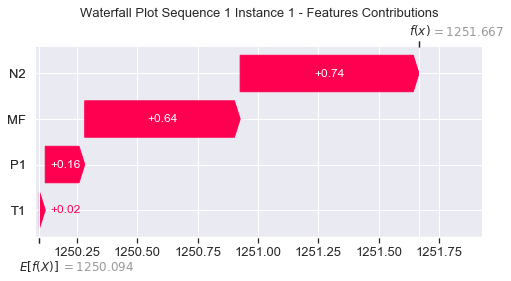

None

Contribution: [0.00317491 0.0036745  0.01102936 0.01051043]


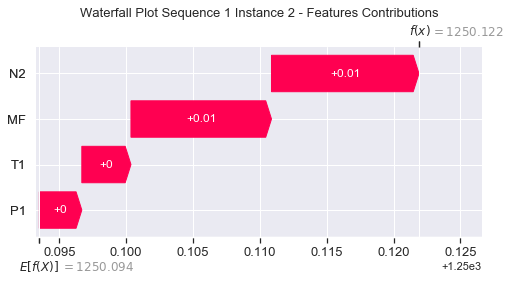

None

Contribution: [0.02383978 0.03115171 0.09487771 0.08530596]


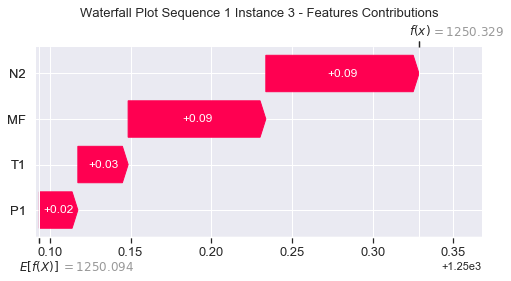

None

Contribution: [0.01698036 0.02244913 0.06594308 0.05879337]


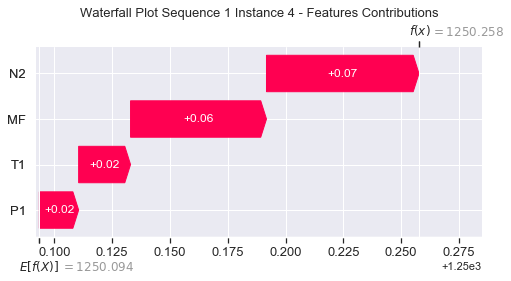

None

Contribution: [0.01973775 0.02641842 0.0753974  0.06658533]


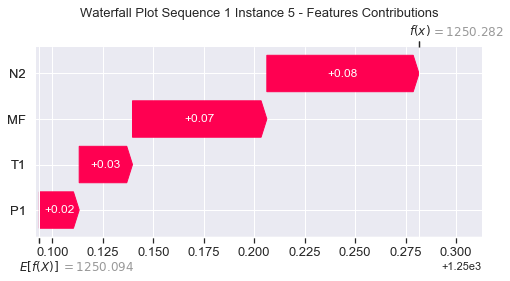

None

Contribution: [0.02088936 0.02733303 0.07873793 0.06973125]


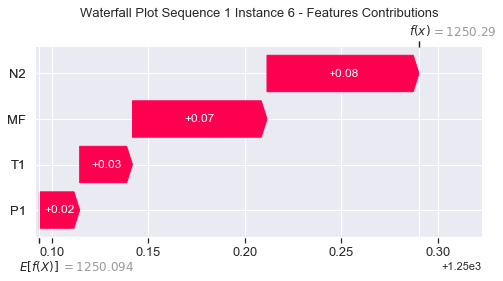

None

Contribution: [0.02008614 0.02670989 0.07598281 0.067416  ]


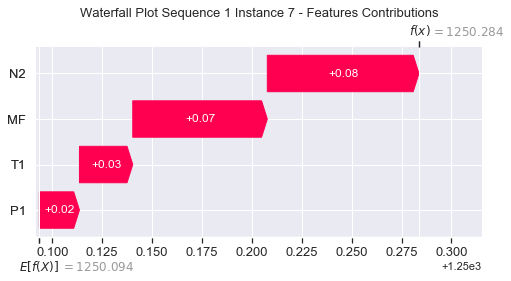

None

Contribution: [0.01882833 0.02507509 0.07102274 0.06296951]


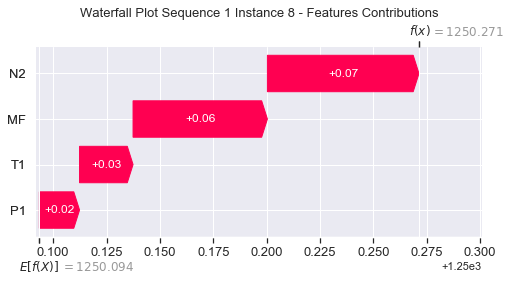

None

Contribution: [0.01791132 0.02519107 0.06677964 0.05974843]


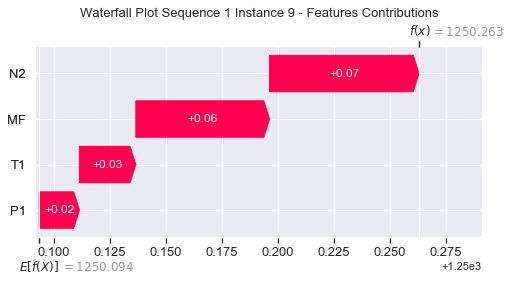

None

Contribution: [0.01668968 0.02272503 0.06267923 0.05605335]


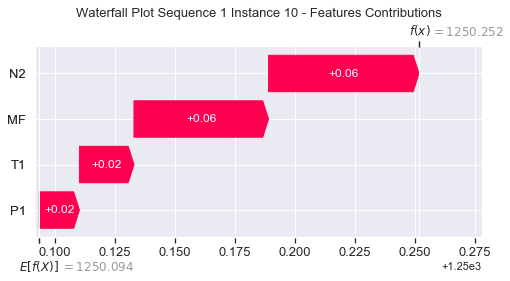

None

Contribution: [0.01630484 0.02175366 0.06024314 0.05363481]


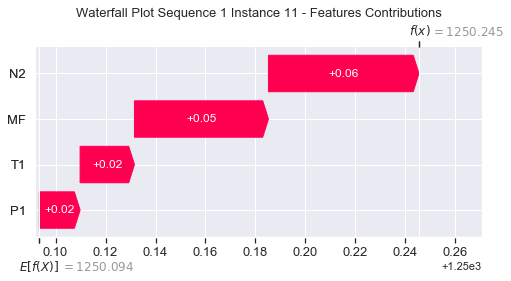

None

Contribution: [0.01535272 0.0201837  0.0583137  0.05181335]


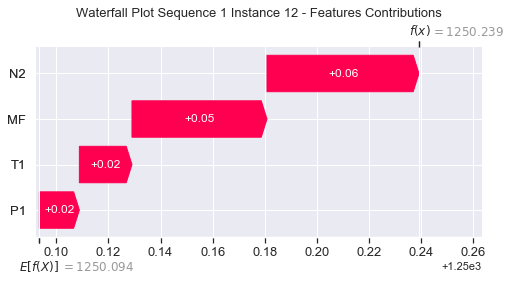

None

Contribution: [0.01524896 0.02015255 0.05785808 0.05144367]


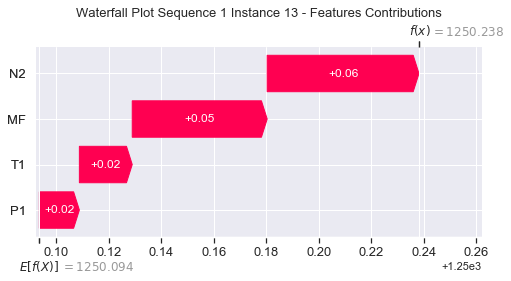

None

Contribution: [0.01582667 0.02002477 0.05788427 0.05139357]


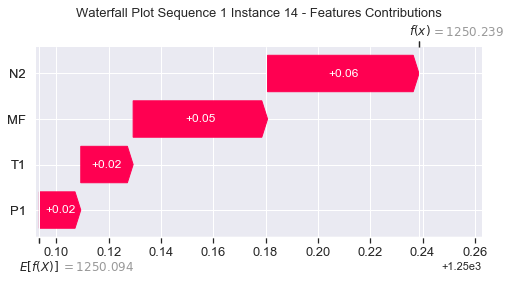

None

Contribution: [0.01582616 0.0204382  0.0592368  0.0528258 ]


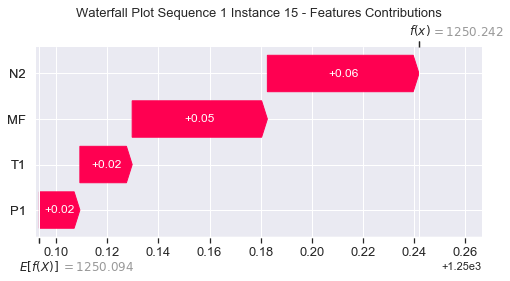

None

Contribution: [0.01680656 0.021554   0.06301618 0.05723146]


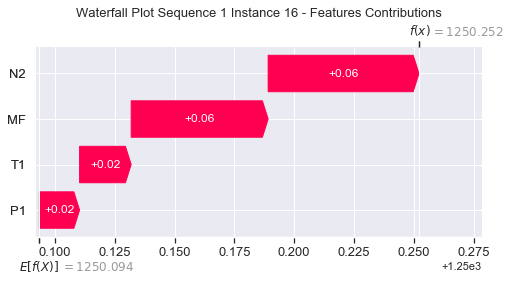

None

Contribution: [0.01974173 0.02446254 0.07255446 0.06505409]


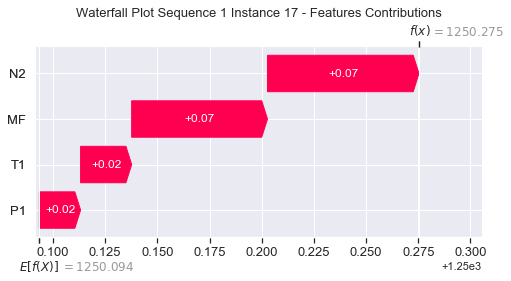

None

Contribution: [0.02687723 0.0316793  0.09694337 0.0872797 ]


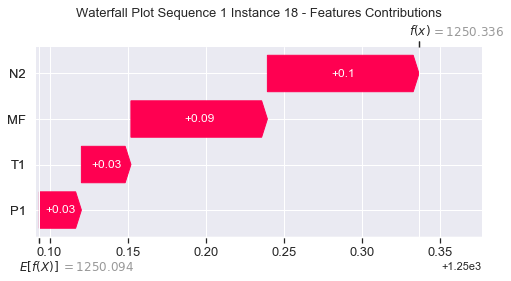

None

Contribution: [0.04384322 0.05027342 0.15802543 0.14350947]


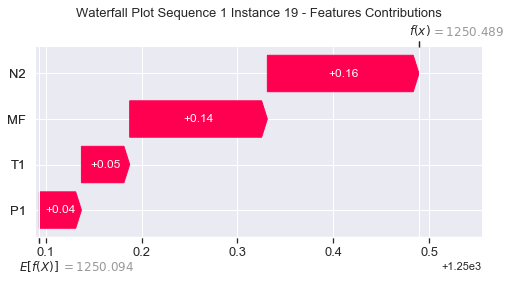

None

Contribution: [0.08674921 0.0970268  0.30460248 0.27674244]


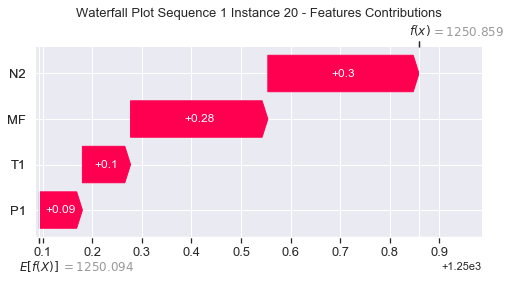

None

Contribution: [0.18105801 0.20051073 0.63299814 0.57659301]


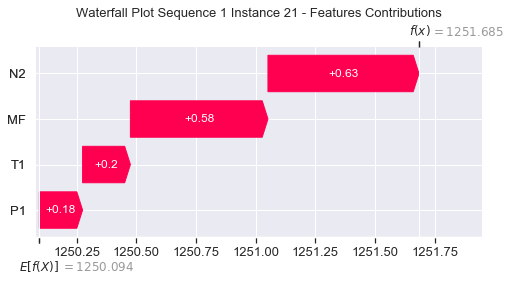

None

Contribution: [0.36573167 0.40242903 1.28450469 1.17308822]


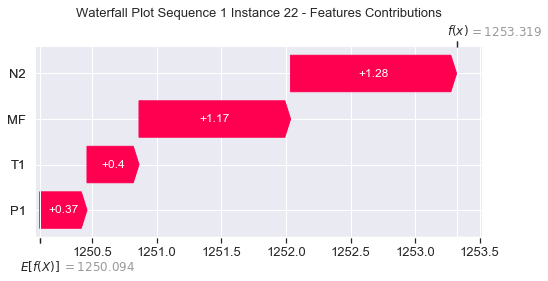

None

Contribution: [0.61464163 0.66165328 2.27930561 2.10286533]


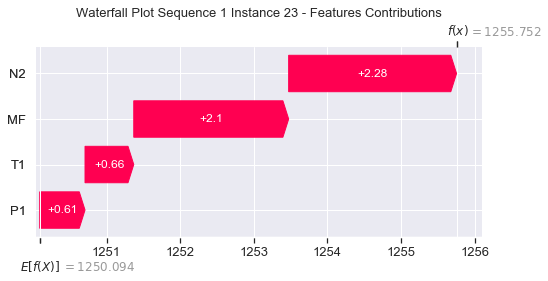

None

Contribution: [0.67224144 0.34549295 3.08131621 2.9344043 ]


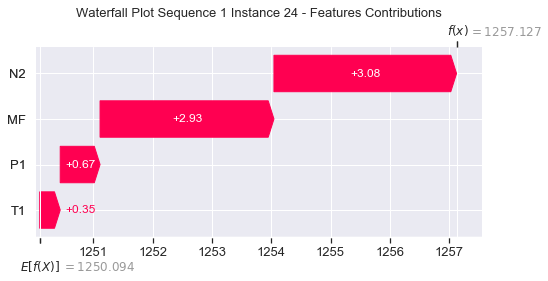

None

Contribution: [0.17831188 0.06513875 0.74619105 0.66219487]


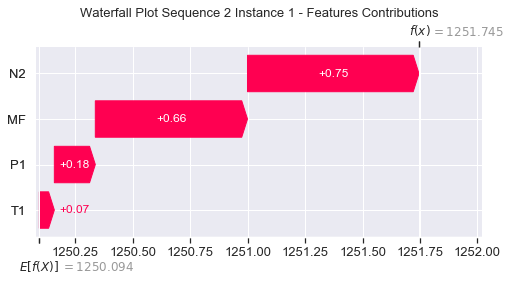

None

Contribution: [0.0032596  0.00438906 0.01158445 0.0108154 ]


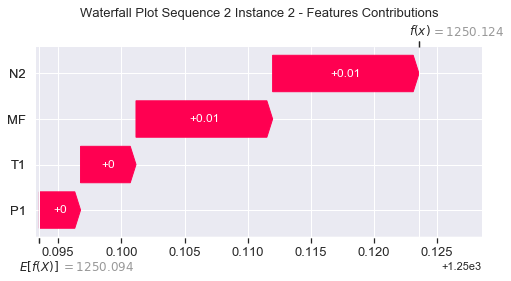

None

Contribution: [0.02554398 0.03343122 0.10095886 0.09198069]


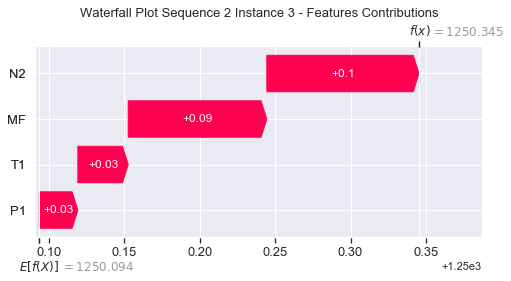

None

Contribution: [0.01766307 0.02392906 0.06919585 0.06062915]


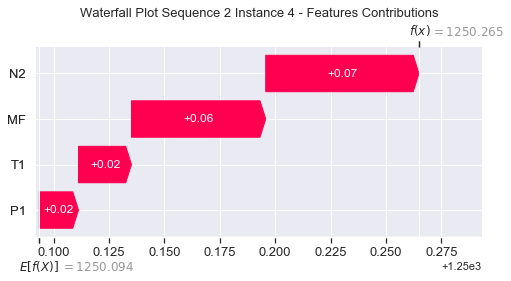

None

Contribution: [0.02053485 0.02276798 0.07938712 0.07125602]


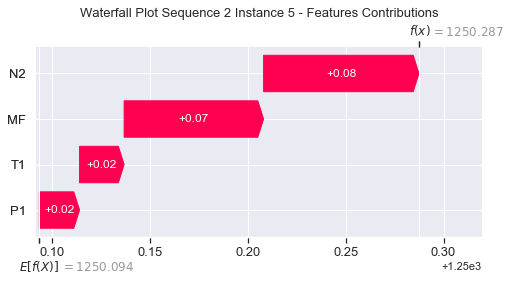

None

Contribution: [0.02149299 0.02265179 0.08277596 0.0739678 ]


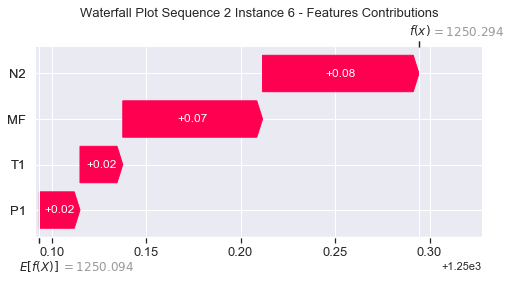

None

Contribution: [0.02082177 0.02161993 0.08009302 0.07144401]


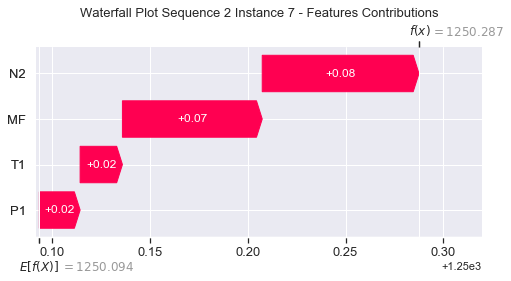

None

Contribution: [0.01944825 0.02021746 0.07485826 0.06677787]


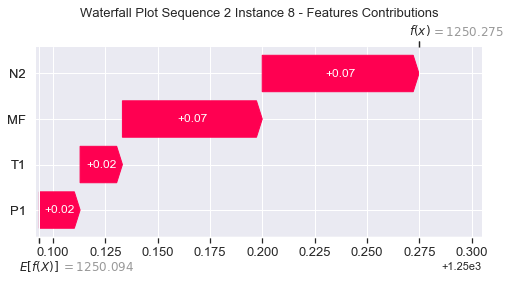

None

Contribution: [0.01840057 0.01840565 0.07044855 0.06259885]


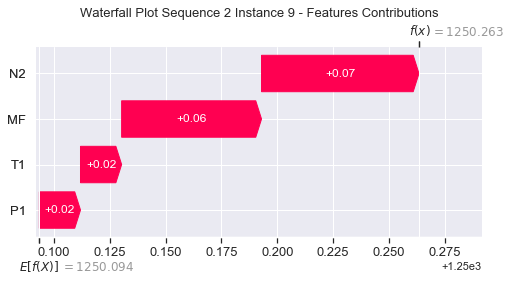

None

Contribution: [0.01722748 0.01705677 0.06635999 0.05892583]


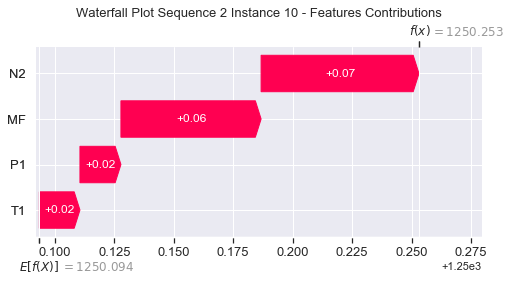

None

Contribution: [0.01649908 0.01628698 0.06328868 0.05619268]


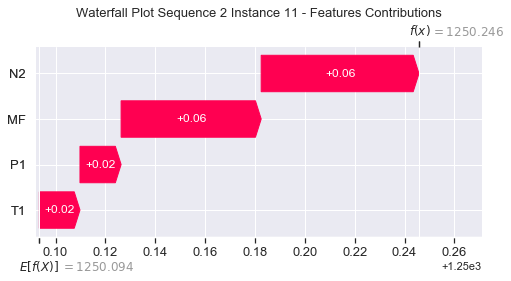

None

Contribution: [0.01588303 0.01517828 0.06112578 0.05409859]


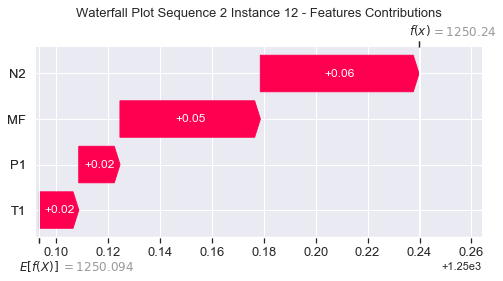

None

Contribution: [0.01580367 0.01512503 0.0606638  0.05375003]


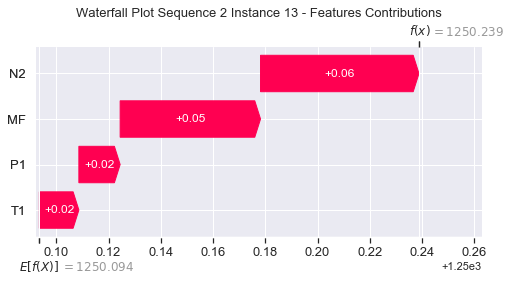

None

Contribution: [0.01590825 0.01463742 0.06058577 0.05371478]


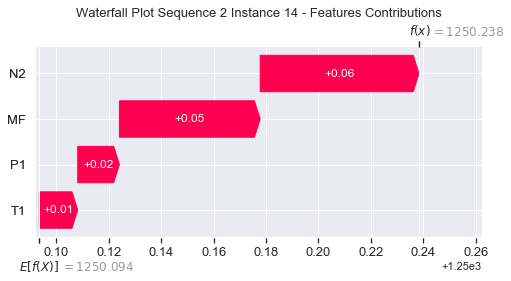

None

Contribution: [0.01630023 0.01528749 0.0620297  0.05506969]


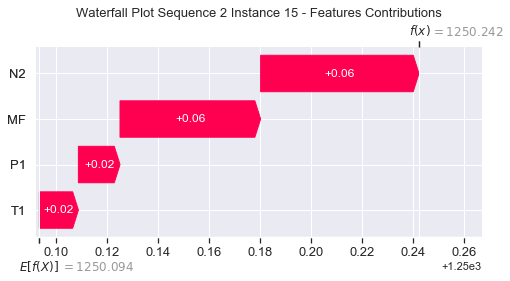

None

Contribution: [0.01735127 0.01628796 0.06602946 0.05903386]


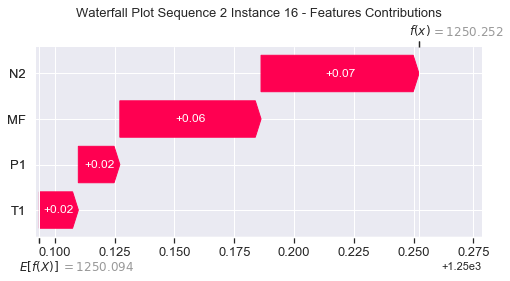

None

Contribution: [0.0204749  0.01813872 0.07625732 0.06803431]


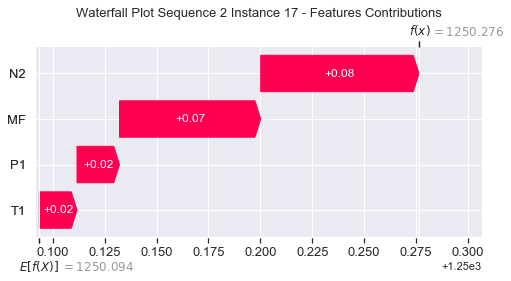

None

Contribution: [0.02797659 0.02394364 0.10235625 0.09183487]


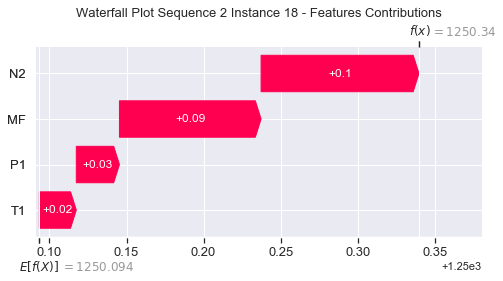

None

Contribution: [0.04670974 0.03947254 0.16732418 0.15078314]


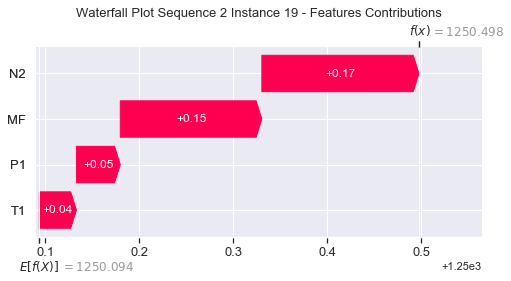

None

Contribution: [0.09081388 0.07490707 0.32246846 0.29276417]


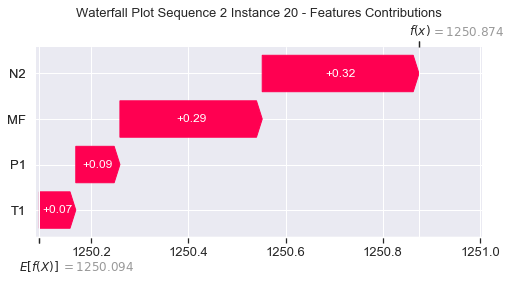

None

Contribution: [0.18810584 0.15143189 0.66535335 0.60567496]


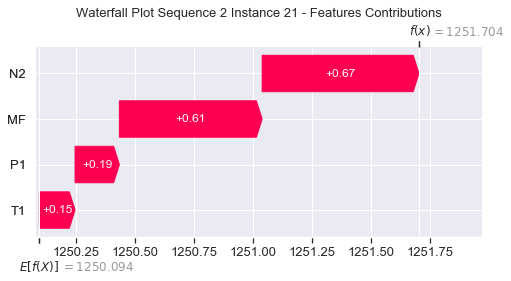

None

Contribution: [0.37456492 0.28100322 1.33577775 1.22043073]


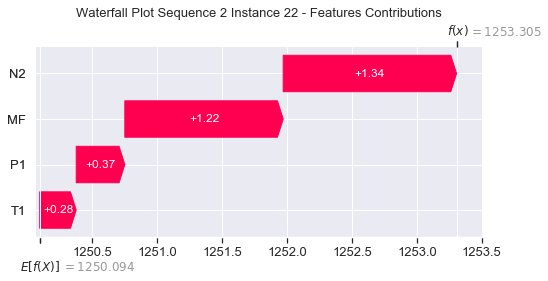

None

Contribution: [0.60859981 0.24047494 2.3416755  2.15932516]


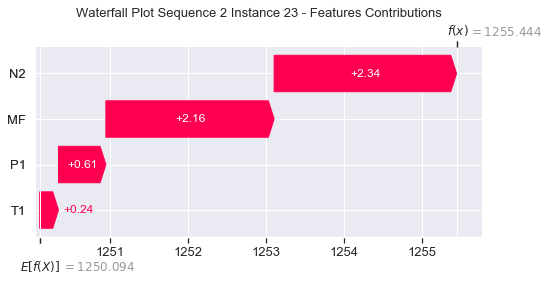

None

Contribution: [ 0.53402584 -1.51387189  3.12186412  2.99625716]


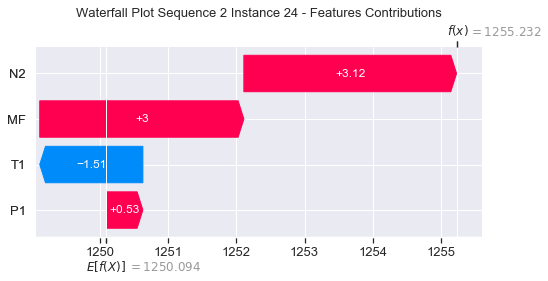

None

Contribution: [ 0.13607003 -0.27948847  0.76724622  0.65769892]


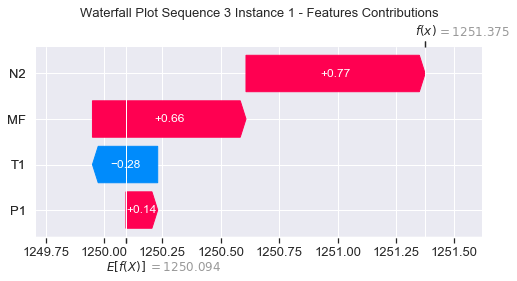

None

Contribution: [0.00318846 0.00161257 0.01165823 0.01076917]


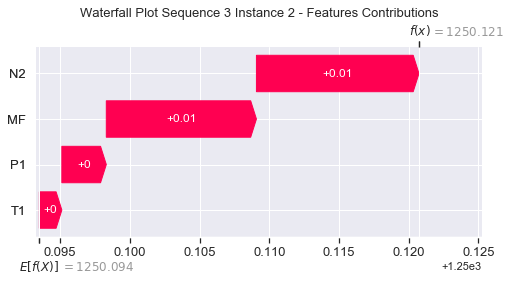

None

Contribution: [0.02482294 0.02157002 0.10131764 0.09051513]


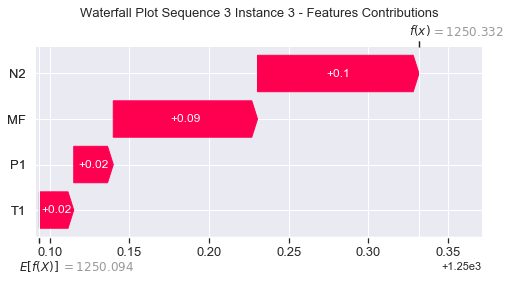

None

Contribution: [0.01708889 0.01523672 0.06664239 0.05889378]


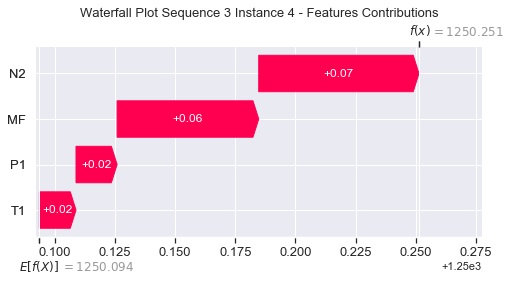

None

Contribution: [0.02016894 0.01854199 0.0779647  0.06869196]


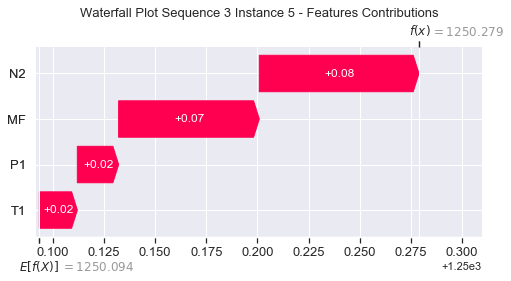

None

Contribution: [0.02165919 0.02058662 0.08354008 0.07362757]


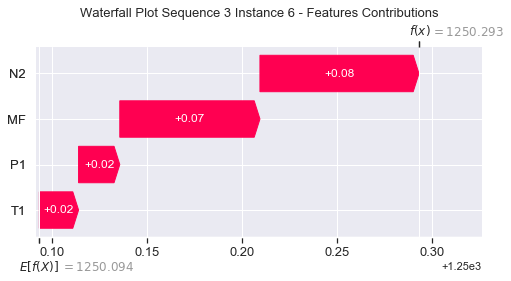

None

Contribution: [0.02114602 0.02008069 0.08156861 0.07188075]


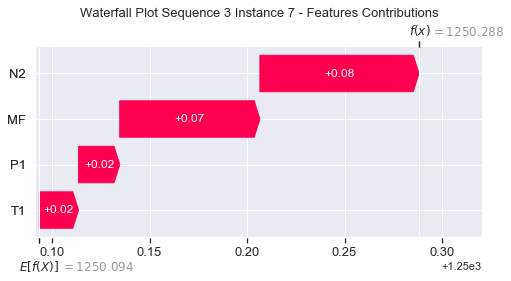

None

Contribution: [0.01987711 0.01894013 0.07653296 0.06741808]


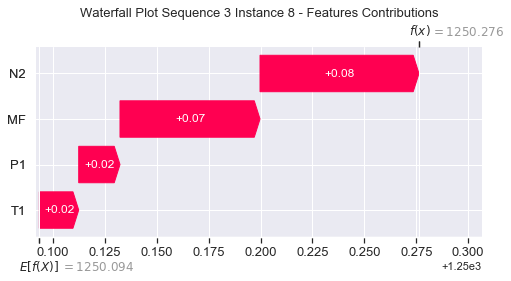

None

Contribution: [0.01868513 0.01886024 0.07192813 0.06298061]


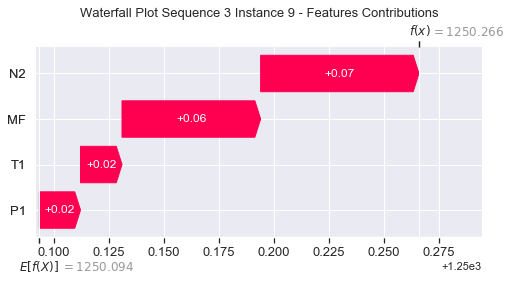

None

Contribution: [0.01790996 0.01905444 0.06824402 0.06023607]


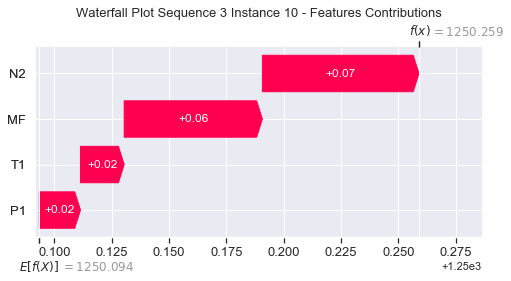

None

Contribution: [0.01708355 0.01724425 0.06506151 0.05706868]


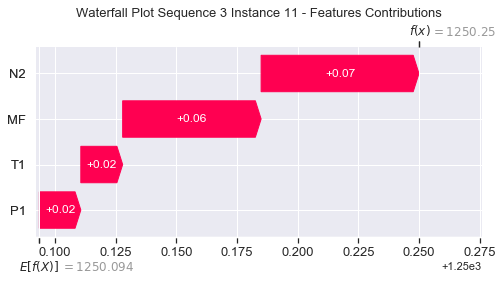

None

Contribution: [0.01653383 0.01545807 0.06296451 0.05552001]


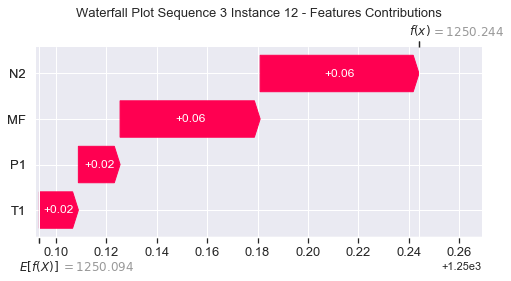

None

Contribution: [0.01635807 0.0151745  0.06230492 0.05496755]


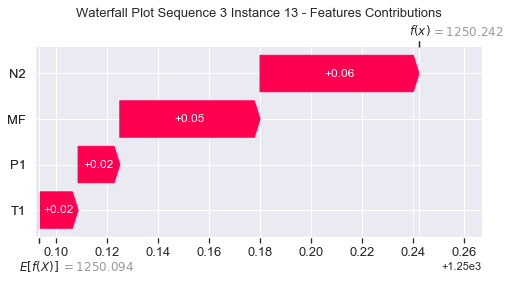

None

Contribution: [0.01602978 0.01563548 0.06232891 0.05497439]


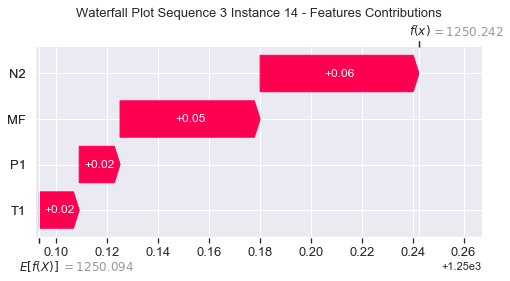

None

Contribution: [0.01676553 0.01538397 0.06360961 0.0563016 ]


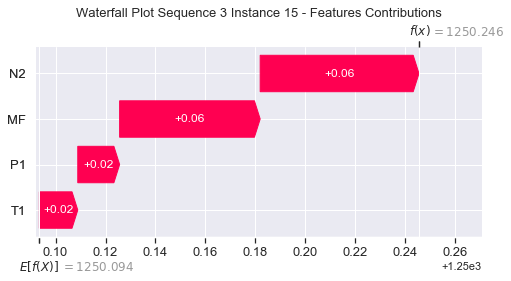

None

Contribution: [0.01828367 0.01650344 0.06783244 0.06107565]


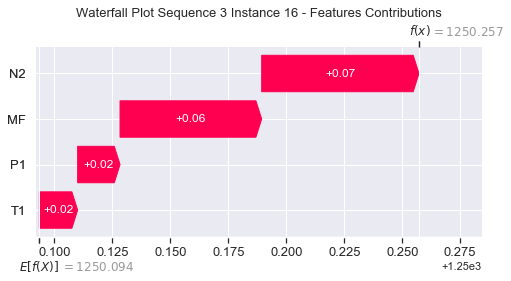

None

Contribution: [0.02089304 0.01837481 0.07776773 0.06925455]


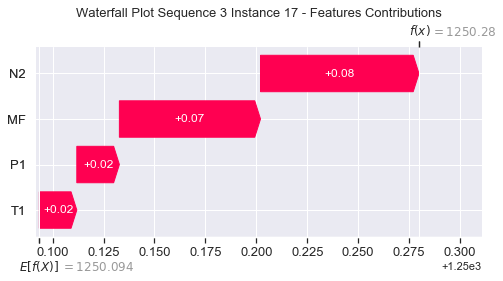

None

Contribution: [0.02845404 0.02414854 0.10403621 0.09319507]


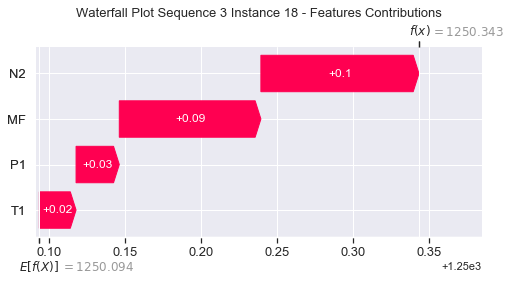

None

Contribution: [0.04772886 0.03773261 0.16967637 0.15279384]


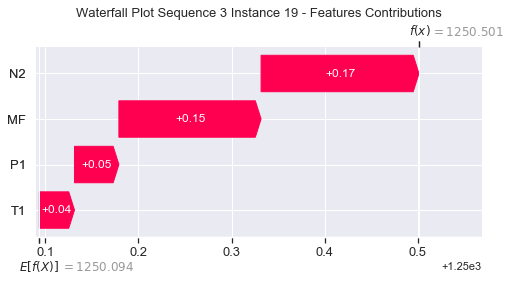

None

Contribution: [0.09151971 0.0726597  0.32537598 0.29467309]


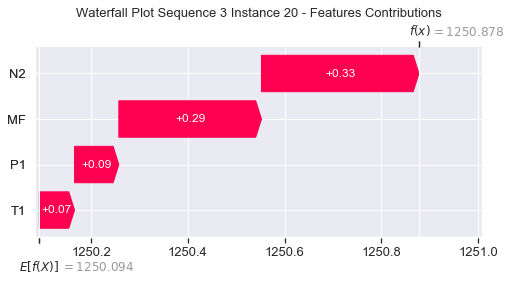

None

Contribution: [0.189502   0.14650982 0.6699209  0.60861214]


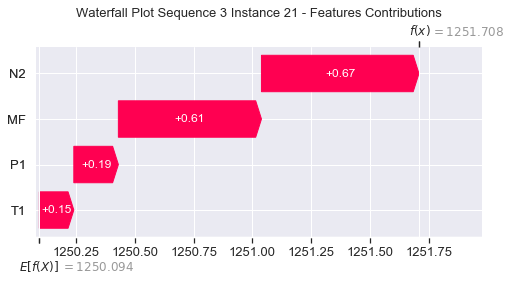

None

Contribution: [0.37773013 0.26598557 1.34332938 1.22491808]


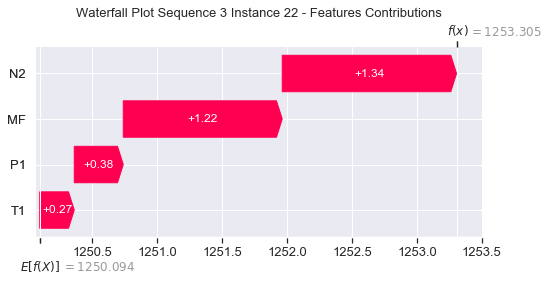

None

Contribution: [0.61787768 0.21182084 2.35876691 2.17221736]


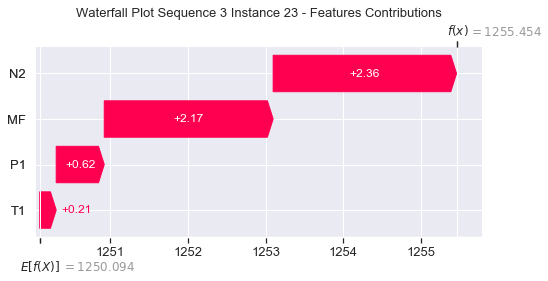

None

Contribution: [ 0.5930253  -1.79555928  3.16176224  2.93158931]


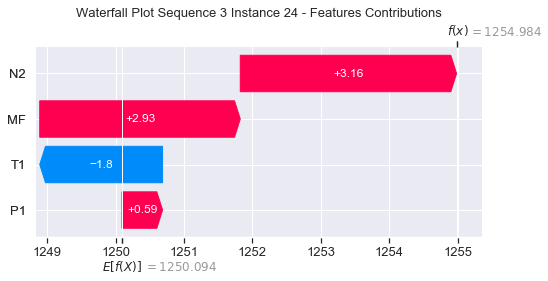

None

Contribution: [ 0.16641167 -0.32572291  0.76957392  0.61101102]


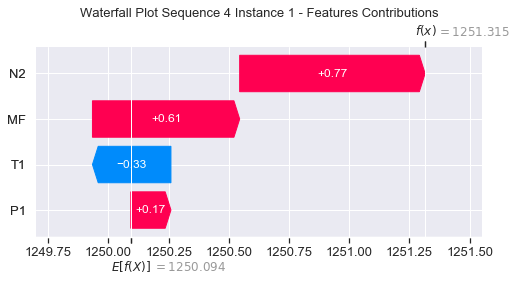

None

Contribution: [0.00337032 0.00143518 0.01198867 0.01115499]


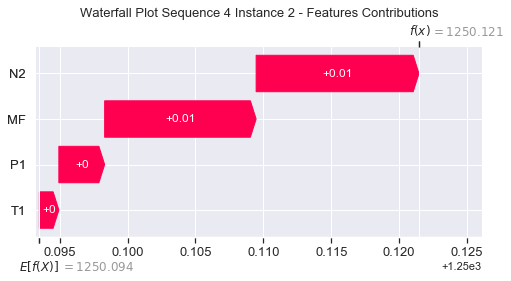

None

Contribution: [0.0245185  0.02212935 0.10195461 0.09160065]


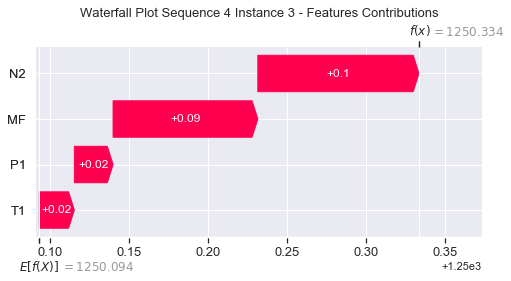

None

Contribution: [0.01740848 0.01608925 0.06719774 0.05934264]


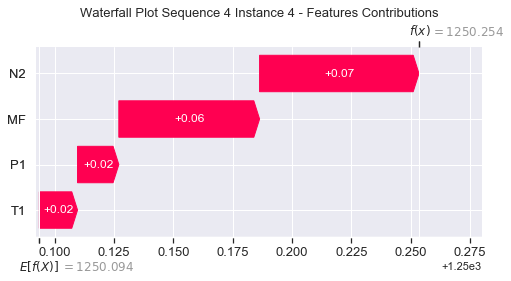

None

Contribution: [0.02039837 0.01799223 0.07839981 0.069308  ]


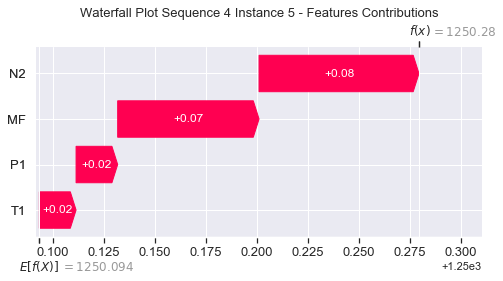

None

Contribution: [0.02201412 0.0192233  0.0839912  0.07466989]


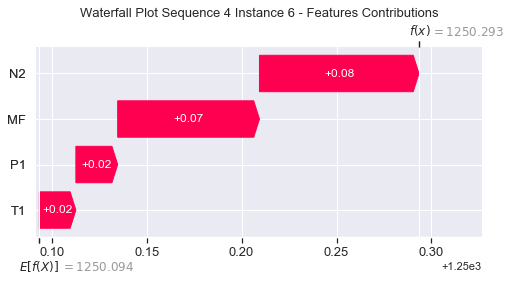

None

Contribution: [0.021544   0.01887391 0.08203366 0.07284696]


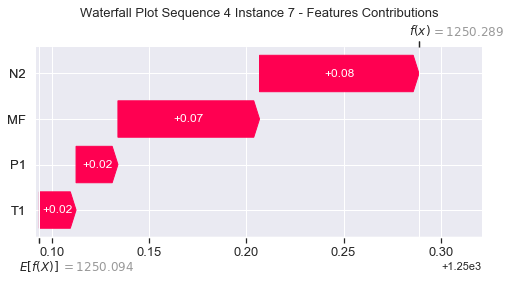

None

Contribution: [0.02012576 0.01770661 0.07693716 0.06837969]


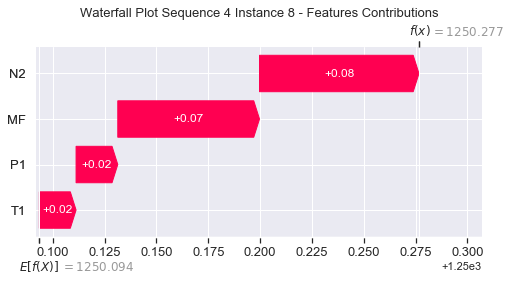

None

Contribution: [0.0186169  0.01730789 0.0722592  0.06440901]


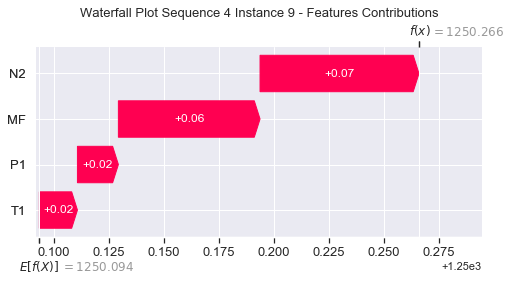

None

Contribution: [0.0180029  0.01549099 0.06804705 0.06075175]


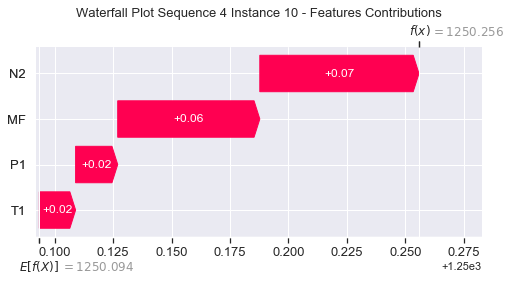

None

Contribution: [0.0167875  0.01530235 0.06522566 0.05827382]


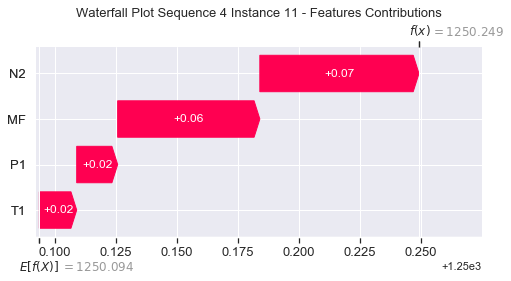

None

Contribution: [0.01654589 0.01456781 0.06313773 0.05590949]


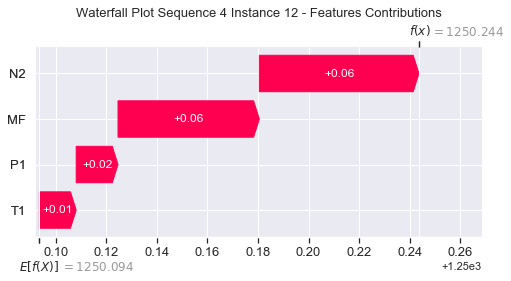

None

Contribution: [0.01643846 0.01441871 0.06258629 0.05545486]


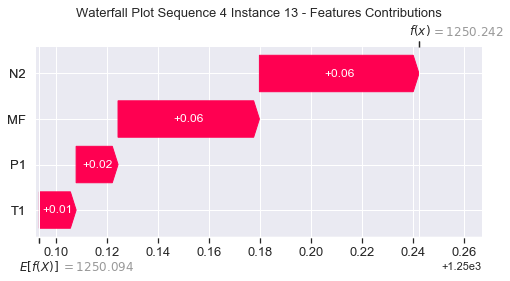

None

Contribution: [0.01638995 0.01479675 0.06284519 0.05652775]


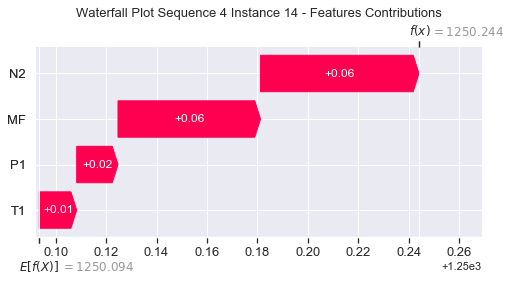

None

Contribution: [0.01685856 0.01450669 0.06377044 0.05678456]


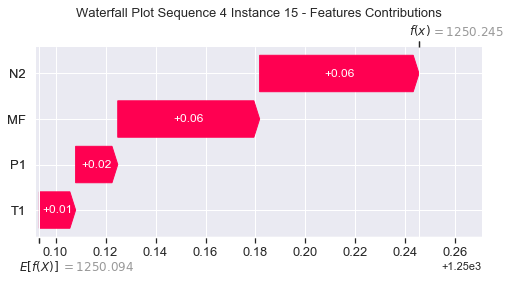

None

Contribution: [0.0178569  0.01559384 0.06765636 0.06039124]


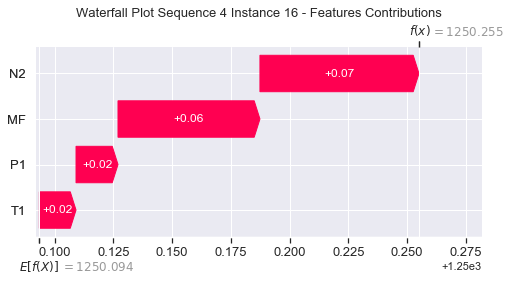

None

Contribution: [0.02106118 0.01744225 0.07803983 0.06994007]


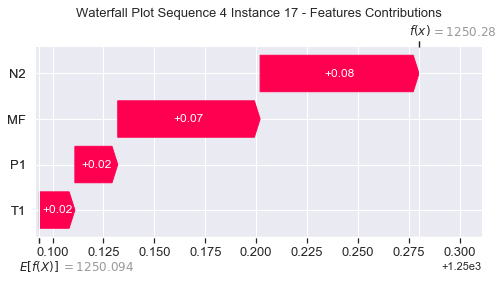

None

Contribution: [0.02866727 0.02291557 0.10440053 0.09414673]


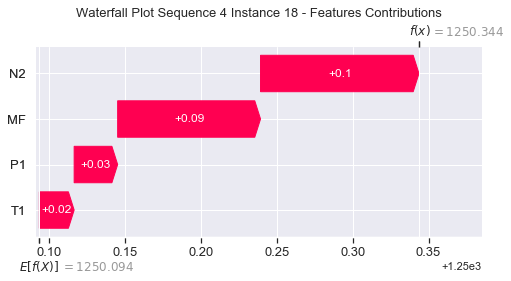

None

Contribution: [0.0480235  0.0377571  0.1698991  0.15224766]


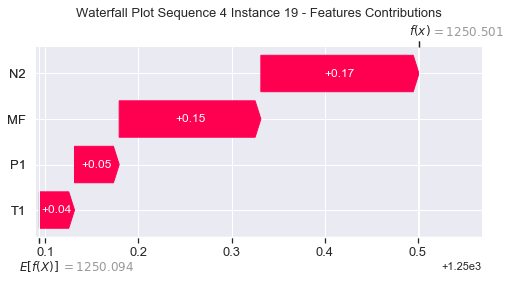

None

Contribution: [0.09214508 0.0698816  0.32622999 0.29715643]


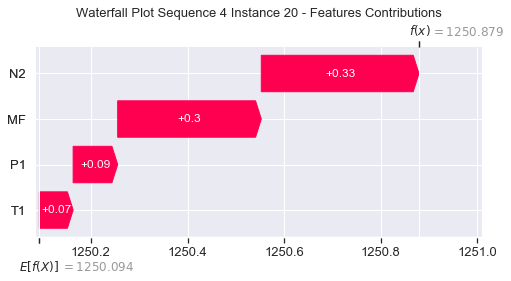

None

Contribution: [0.19021736 0.14107249 0.67142856 0.61332674]


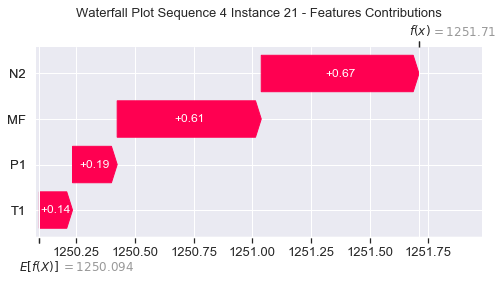

None

Contribution: [0.37788059 0.25338442 1.34578317 1.23418071]


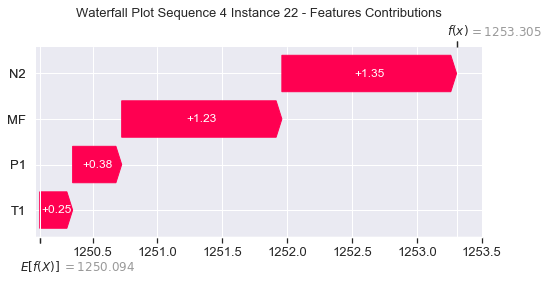

None

Contribution: [0.61701407 0.16118312 2.36272047 2.2022516 ]


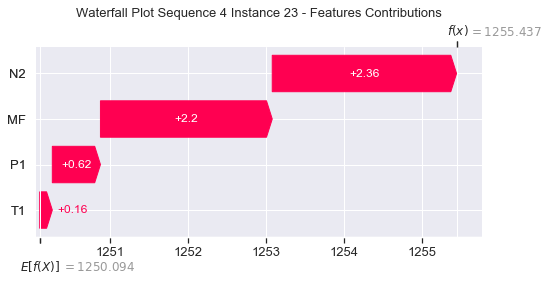

None

Contribution: [ 0.56130187 -1.99186799  3.18320925  3.13308362]


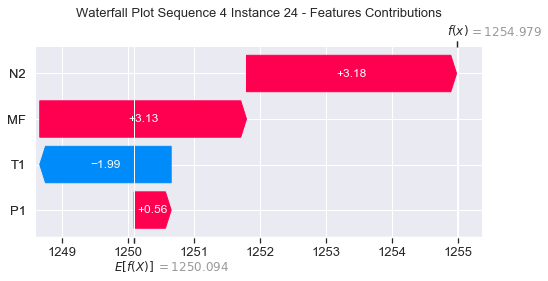

None

Contribution: [ 0.1398063  -0.34065599  0.77468594  0.67711997]


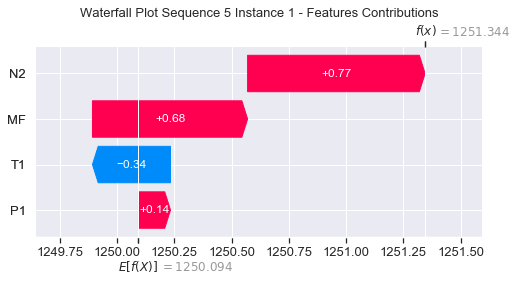

None

Contribution: [0.00319596 0.00129739 0.01172117 0.01097137]


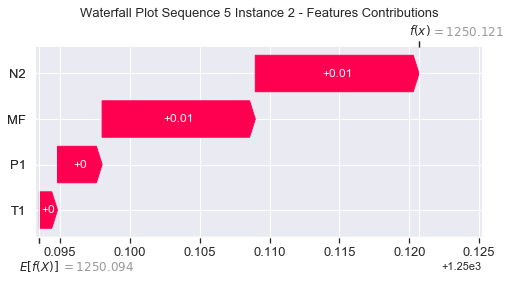

None

Contribution: [0.0241754  0.02128133 0.10058041 0.09103374]


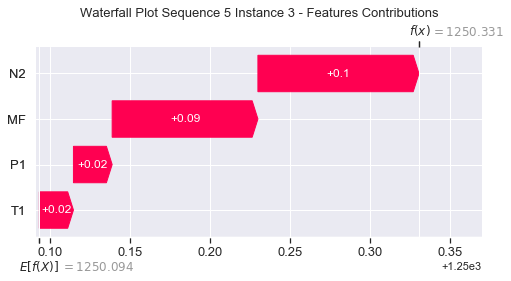

None

Contribution: [0.0167011  0.0158873  0.06637187 0.05892127]


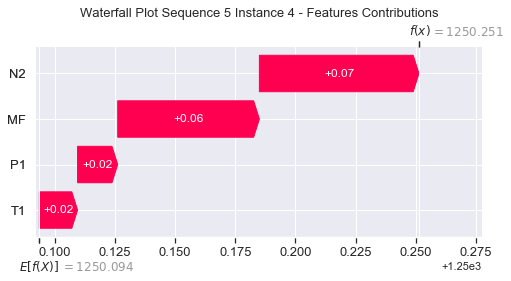

None

Contribution: [0.01974456 0.01808468 0.07760135 0.06910021]


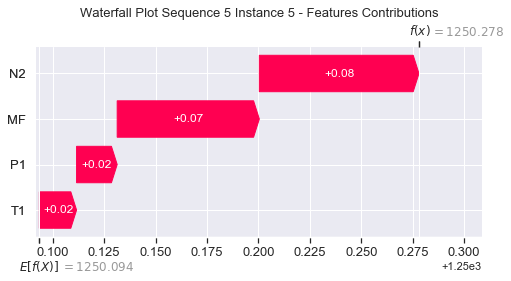

None

Contribution: [0.02141204 0.02008396 0.08318006 0.07428308]


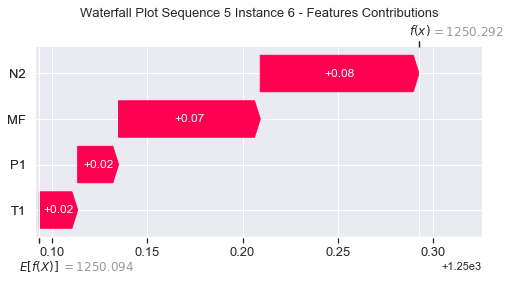

None

Contribution: [0.02091064 0.01956117 0.08114863 0.07240761]


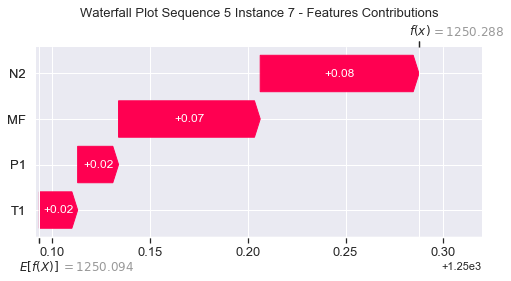

None

Contribution: [0.01962504 0.01849495 0.0760909  0.06785085]


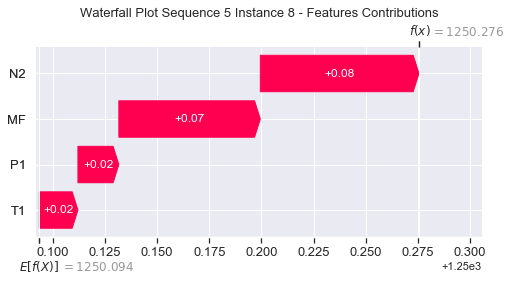

None

Contribution: [0.01843103 0.01799341 0.07124763 0.0633447 ]


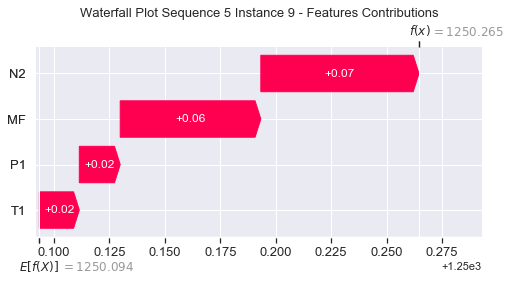

None

Contribution: [0.01705827 0.0168481  0.06712125 0.05956511]


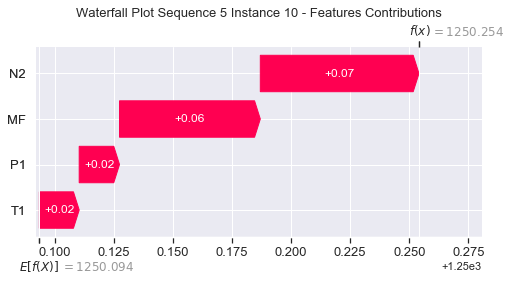

None

Contribution: [0.01671893 0.01675921 0.06455732 0.05732126]


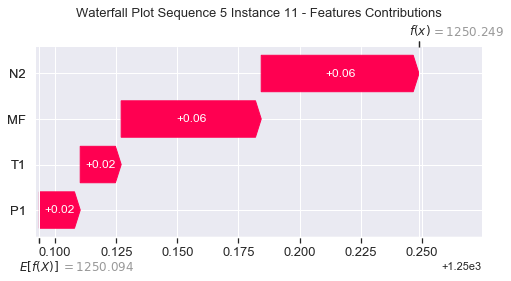

None

Contribution: [0.0161707  0.01537468 0.06253475 0.05548844]


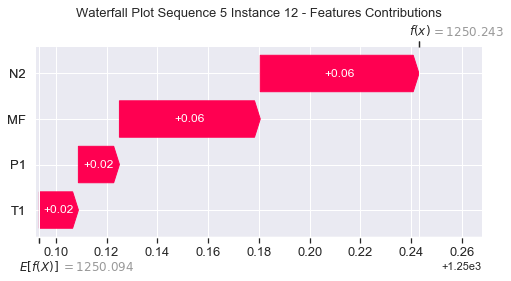

None

Contribution: [0.01607066 0.01509799 0.0619459  0.05501163]


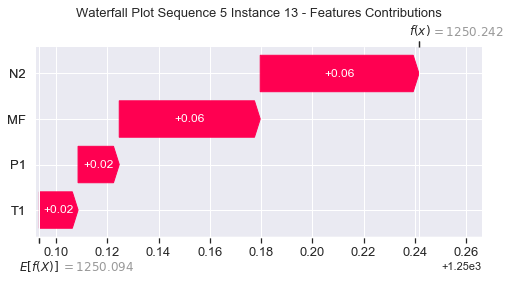

None

Contribution: [0.01640907 0.01525121 0.06231159 0.05576892]


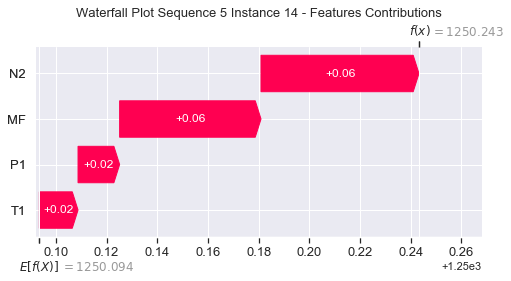

None

Contribution: [0.01663181 0.0154977  0.06335032 0.05648766]


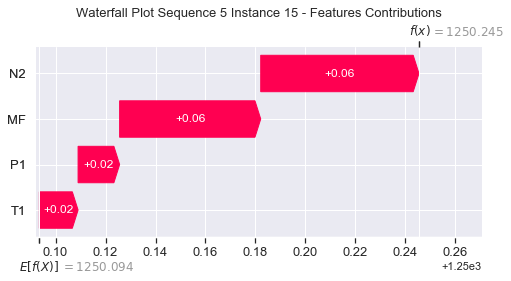

None

Contribution: [0.01823261 0.01622622 0.06776539 0.06236981]


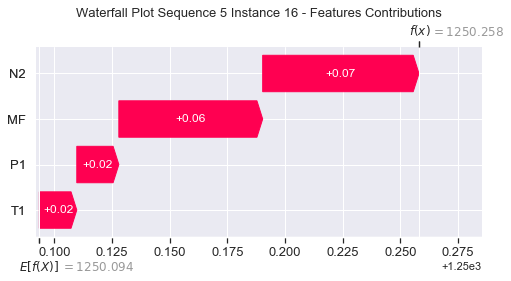

None

Contribution: [0.02081608 0.01854787 0.07736752 0.06934148]


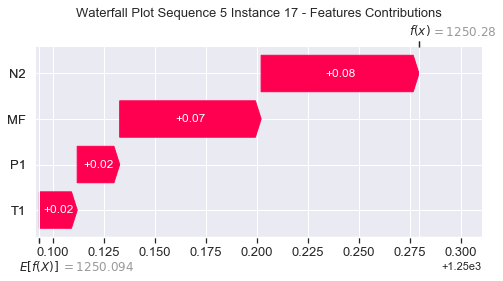

None

Contribution: [0.02838201 0.02446551 0.10341219 0.09318601]


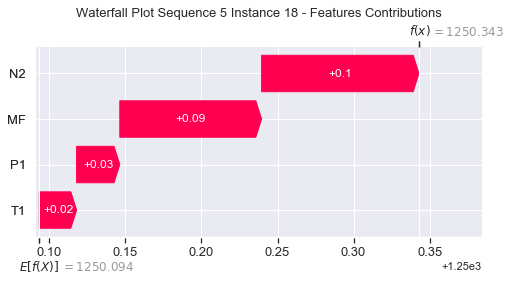

None

Contribution: [0.04719452 0.03814826 0.16790266 0.15196761]


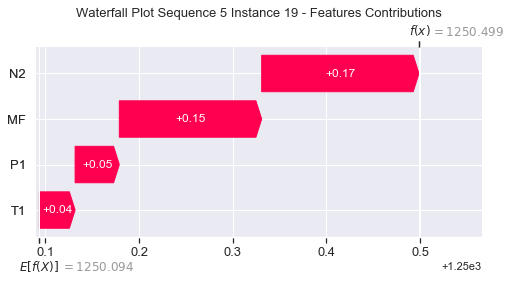

None

Contribution: [0.09140622 0.07395855 0.3228223  0.29376652]


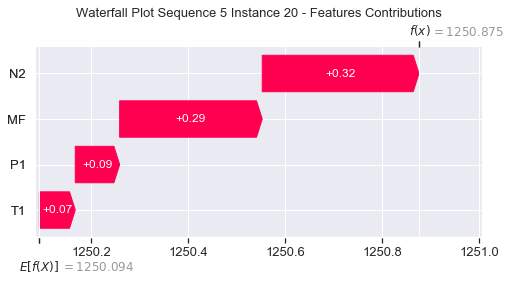

None

Contribution: [0.18912161 0.15023106 0.66507938 0.60657576]


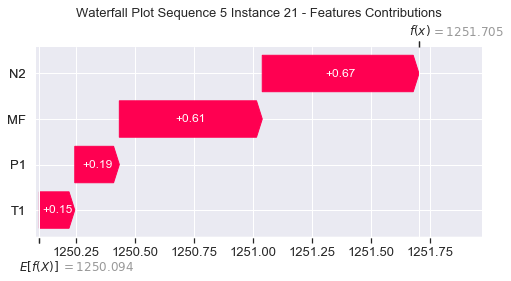

None

Contribution: [0.37711033 0.27884737 1.33544919 1.2215967 ]


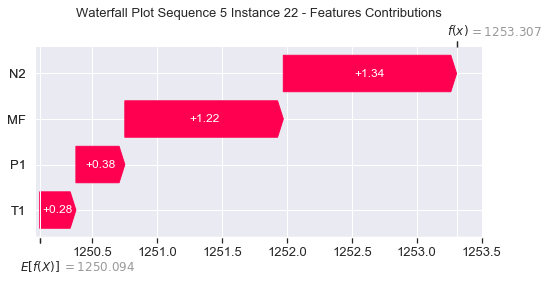

None

Contribution: [0.62306826 0.25973718 2.34909361 2.17703482]


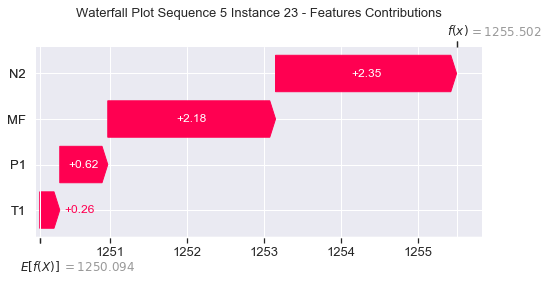

None

Contribution: [ 0.63480653 -1.55938893  3.17341243  3.08078649]


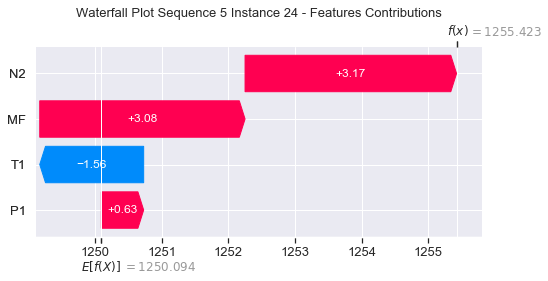

None

Contribution: [ 0.1726128  -0.28362244  0.78092161  0.68377972]


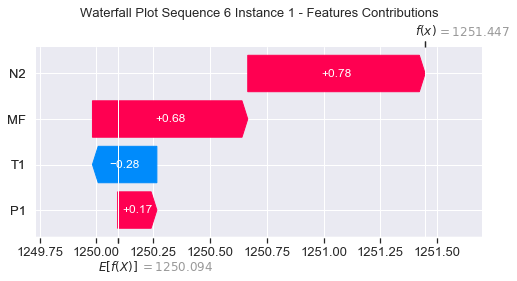

None

Contribution: [0.00337623 0.00188699 0.01207523 0.01116504]


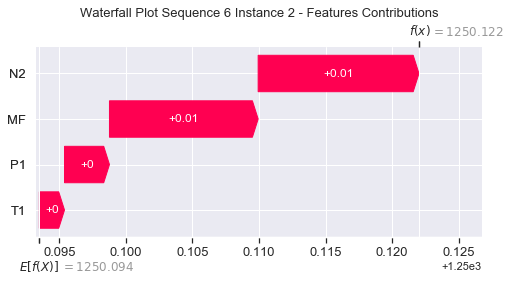

None

Contribution: [0.02522324 0.02502758 0.10376225 0.09337445]


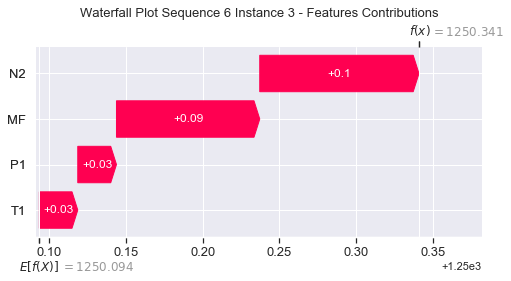

None

Contribution: [0.01761025 0.01736919 0.06886081 0.06039884]


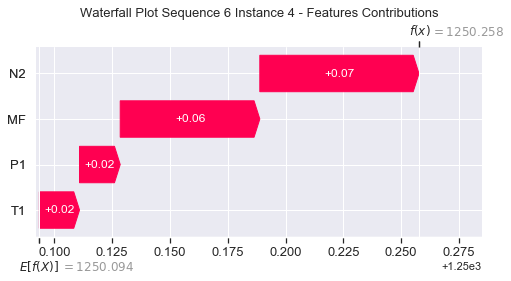

None

Contribution: [0.02079826 0.0206982  0.08038487 0.07107965]


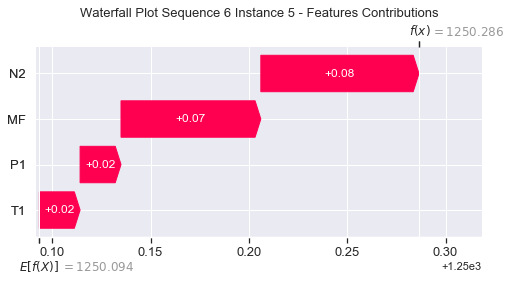

None

Contribution: [0.02225806 0.02119773 0.08533088 0.07562096]


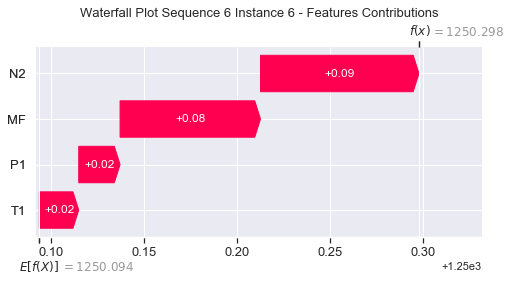

None

Contribution: [0.02169115 0.02036501 0.08295563 0.07353784]


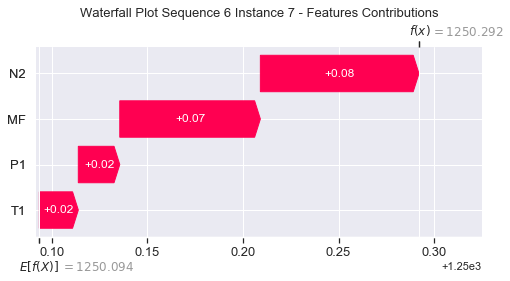

None

Contribution: [0.02024232 0.01884767 0.07762677 0.06865223]


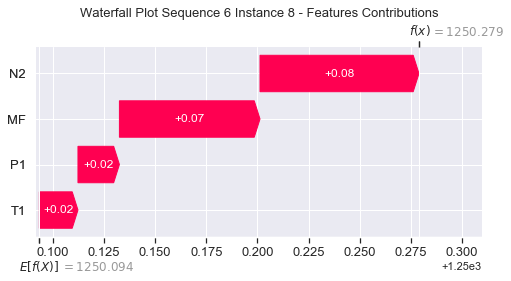

None

Contribution: [0.01898043 0.01735646 0.07255496 0.06370737]


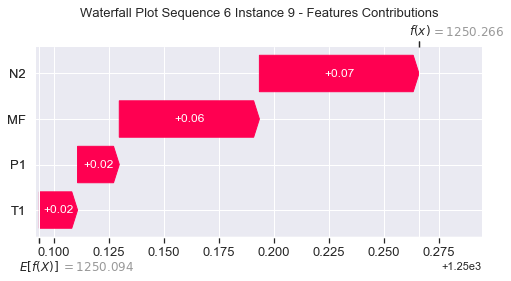

None

Contribution: [0.01770108 0.01680059 0.06857206 0.06097904]


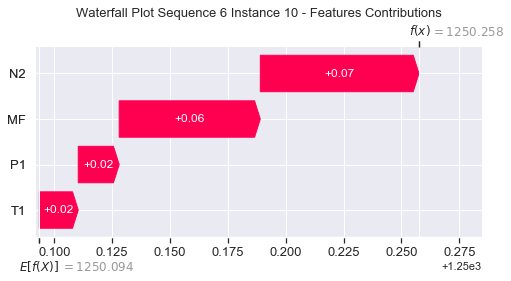

None

Contribution: [0.01706166 0.01540378 0.06549044 0.05735244]


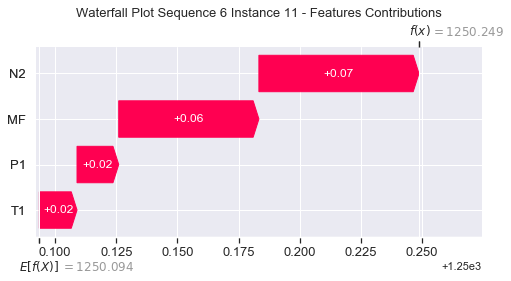

None

Contribution: [0.01658032 0.01446317 0.06332611 0.05591067]


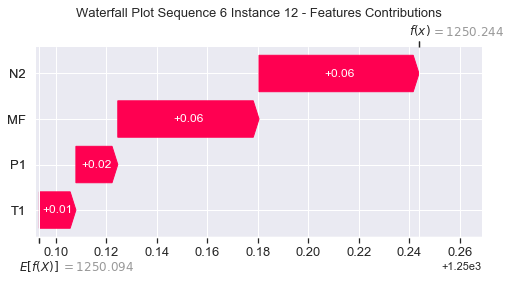

None

Contribution: [0.01646915 0.01422632 0.06280312 0.05549197]


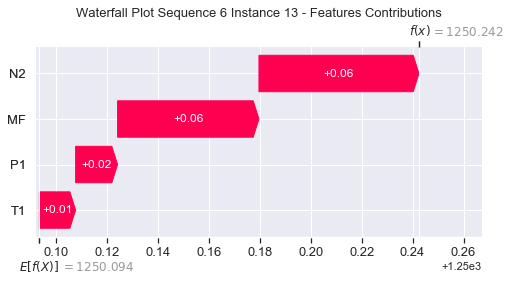

None

Contribution: [0.01654503 0.01476203 0.06280607 0.05579986]


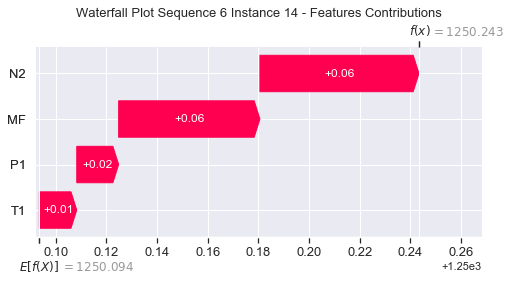

None

Contribution: [0.01689126 0.0141242  0.06400025 0.05666593]


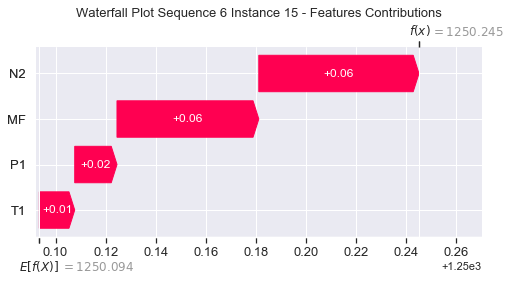

None

Contribution: [0.01807118 0.01402649 0.06774872 0.05979727]


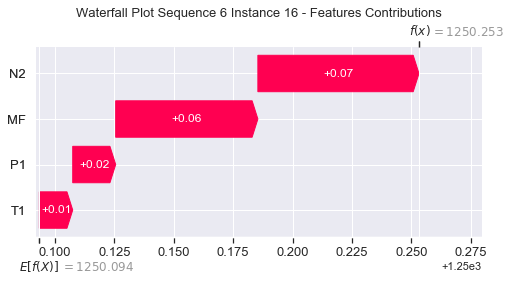

None

Contribution: [0.0211392  0.01638344 0.07851067 0.06994538]


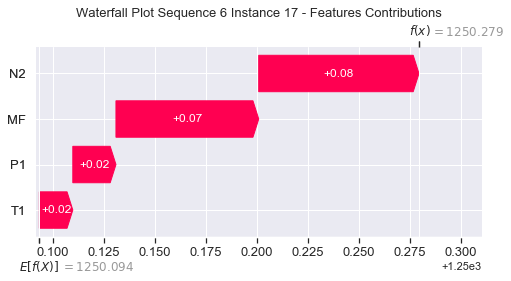

None

Contribution: [0.02886064 0.02139218 0.10545166 0.09443676]


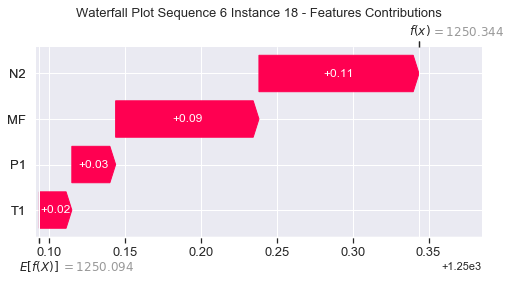

None

Contribution: [0.04829955 0.03372945 0.17269894 0.15501463]


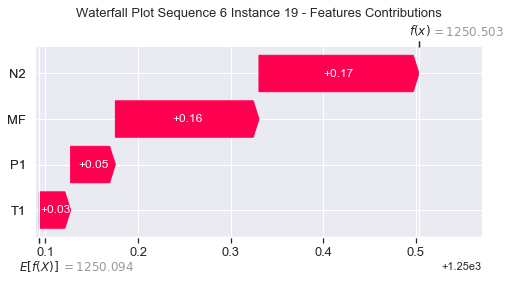

None

Contribution: [0.09322212 0.06472086 0.33170559 0.29993489]


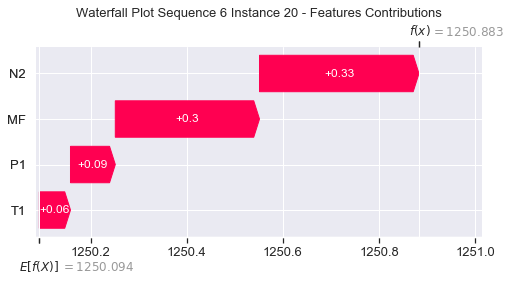

None

Contribution: [0.19230856 0.1289529  0.68205913 0.61806598]


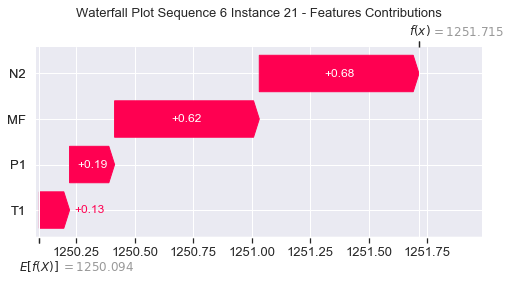

None

Contribution: [0.38057528 0.22204874 1.36428772 1.23821506]


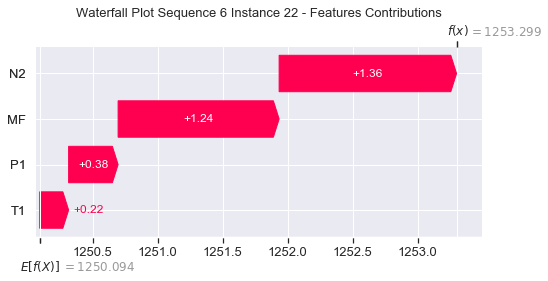

None

Contribution: [0.61469465 0.03417202 2.3890944  2.18074379]


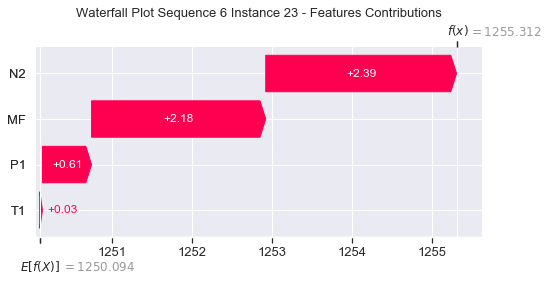

None

Contribution: [ 0.54324477 -2.55292927  3.23447407  2.94410869]


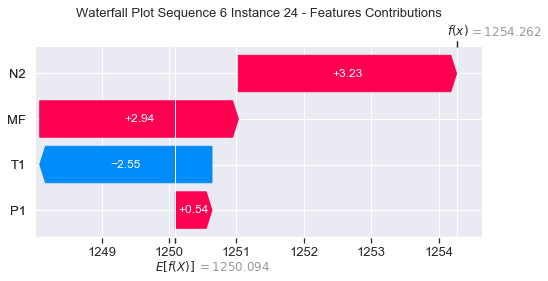

None

Contribution: [ 0.15277326 -0.46826571  0.79659428  0.64575184]


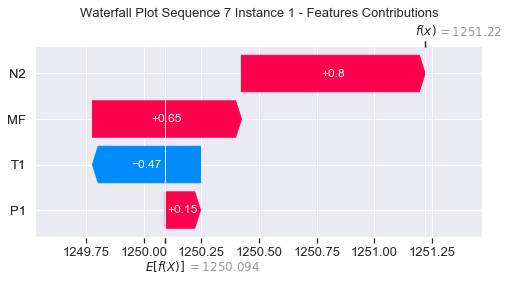

None

Contribution: [0.00330633 0.00041102 0.01229044 0.0110872 ]


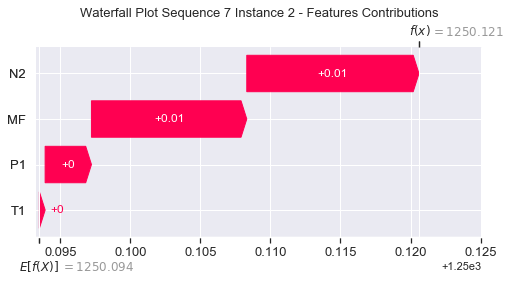

None

Contribution: [0.02541329 0.02092574 0.10420908 0.09350832]


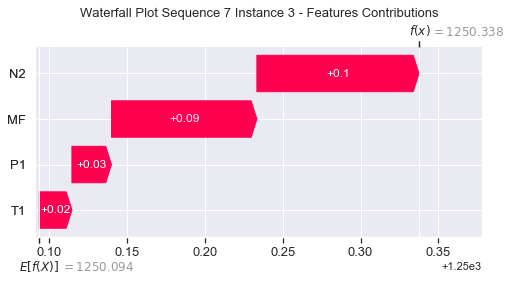

None

Contribution: [0.01729219 0.01347129 0.06785845 0.06019192]


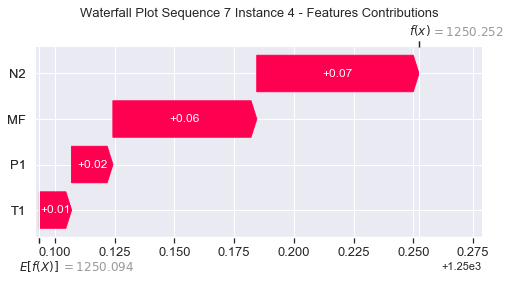

None

Contribution: [0.02062407 0.01580258 0.07963477 0.07095366]


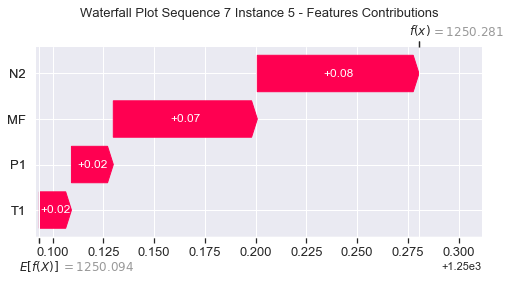

None

Contribution: [0.02208729 0.01672611 0.08534724 0.07591997]


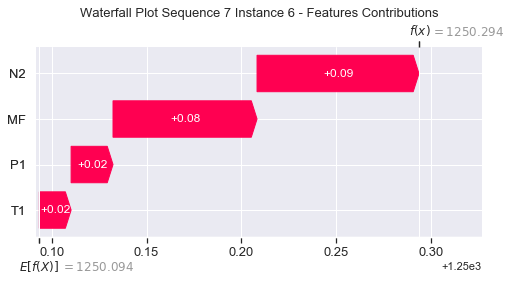

None

Contribution: [0.02160408 0.01663665 0.0837166  0.07460672]


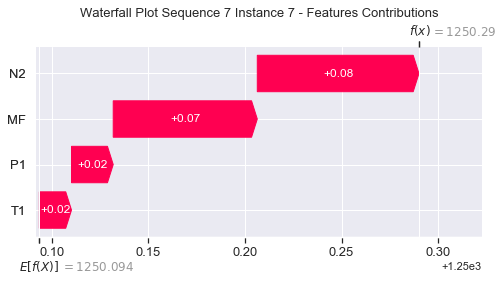

None

Contribution: [0.02034719 0.01569034 0.07865101 0.06990655]


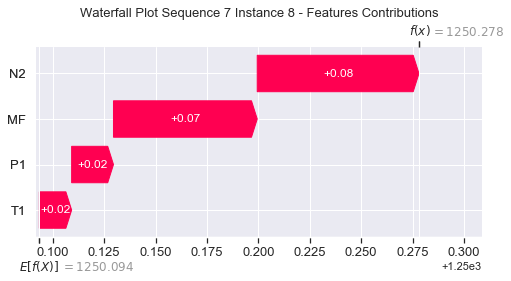

None

Contribution: [0.01906046 0.01602812 0.07381969 0.0657675 ]


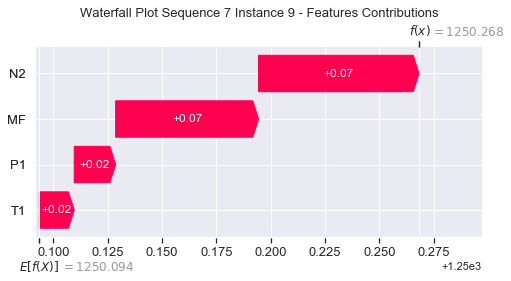

None

Contribution: [0.018253   0.01551162 0.06977167 0.06220726]


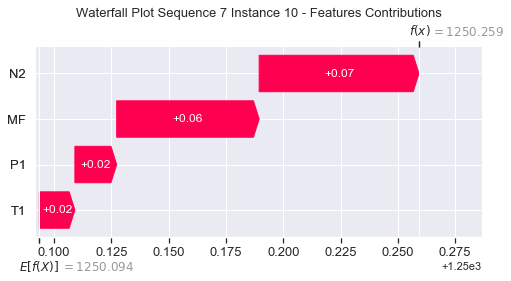

None

Contribution: [0.01728776 0.01381487 0.06629051 0.05841889]


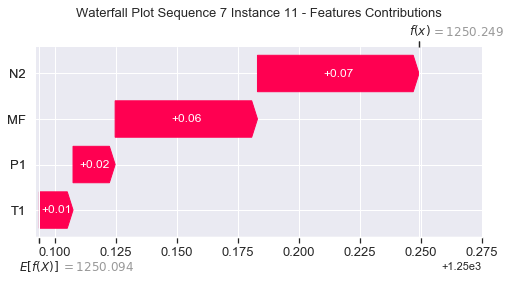

None

Contribution: [0.01662804 0.01299657 0.06446294 0.05706708]


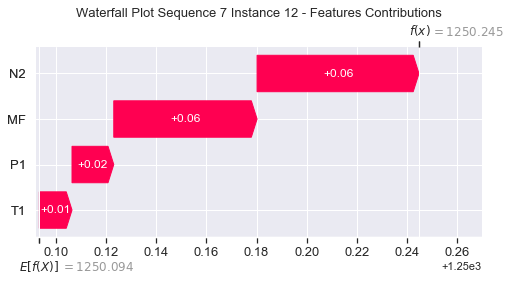

None

Contribution: [0.01650804 0.01295634 0.06392343 0.05668447]


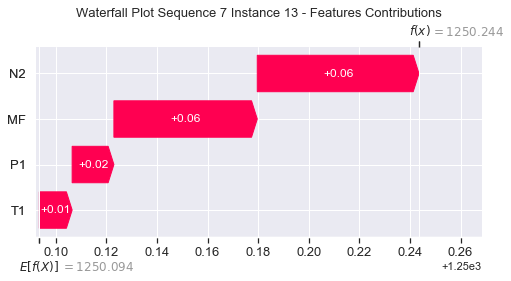

None

Contribution: [0.01652467 0.01403578 0.06401425 0.05686094]


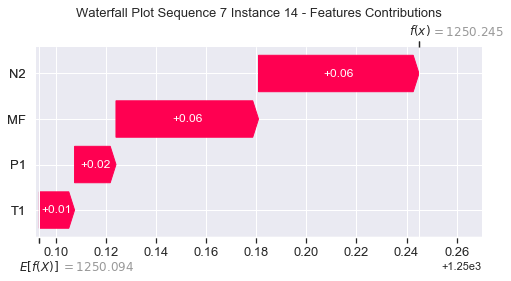

None

Contribution: [0.01694489 0.01303081 0.06510476 0.05776558]


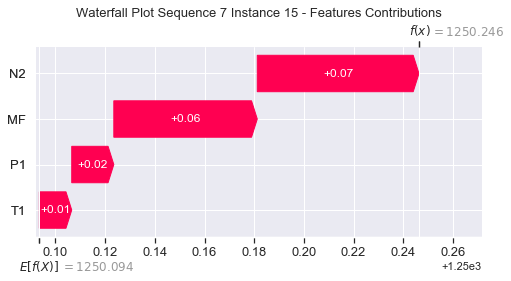

None

Contribution: [0.01861531 0.01351759 0.06932803 0.06218626]


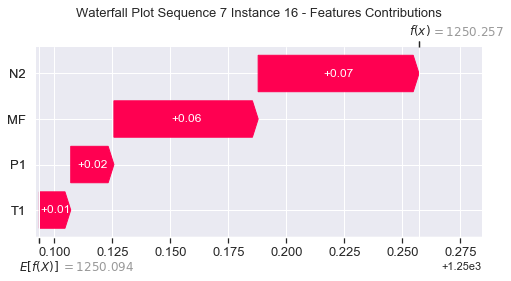

None

Contribution: [0.02109078 0.01588748 0.07961335 0.07104595]


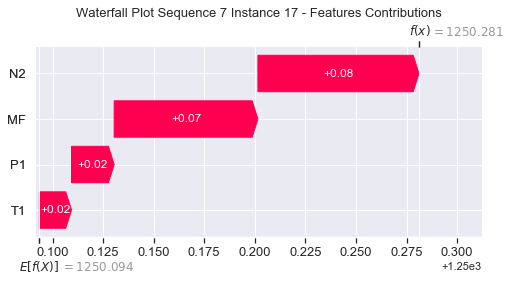

None

Contribution: [0.02878739 0.02096817 0.10657163 0.09545551]


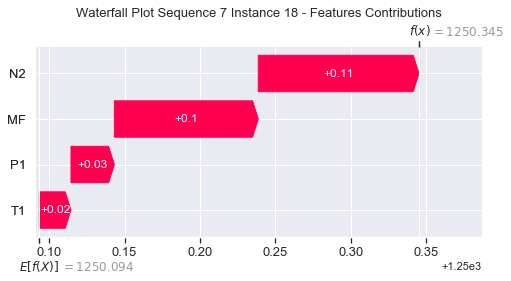

None

Contribution: [0.04899807 0.03280982 0.17407803 0.15693927]


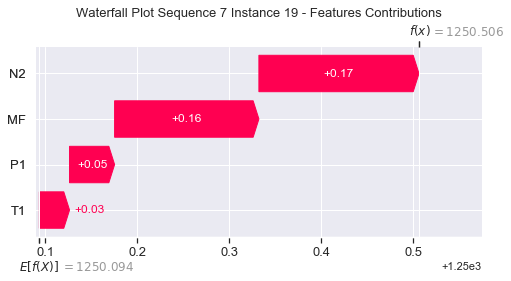

None

Contribution: [0.092767   0.06475583 0.33305723 0.30140153]


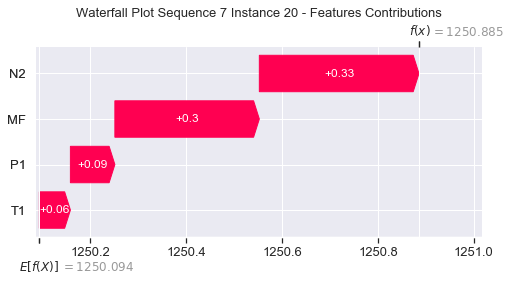

None

Contribution: [0.19121879 0.12997669 0.68371266 0.61984962]


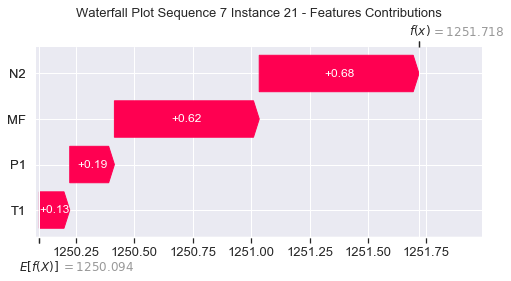

None

Contribution: [0.37908873 0.22406863 1.36604675 1.23917174]


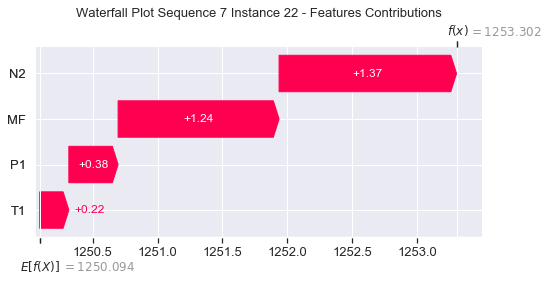

None

Contribution: [0.60825604 0.05213488 2.38771593 2.17057393]


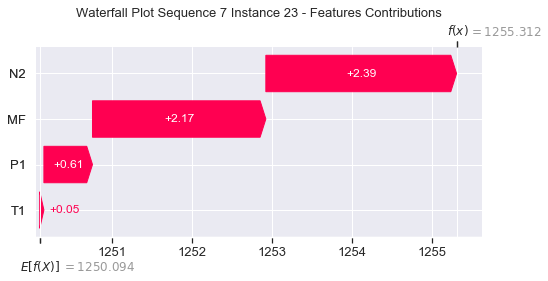

None

Contribution: [ 0.52838086 -2.54699941  3.20548185  2.89724534]


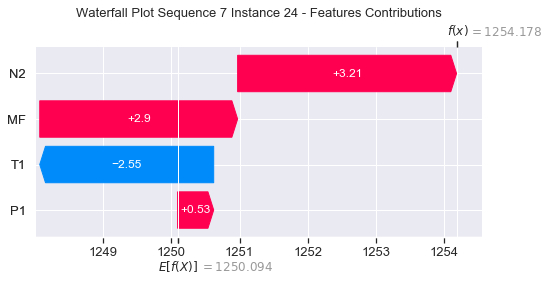

None

Contribution: [ 0.14174806 -0.46416197  0.77694371  0.64487291]


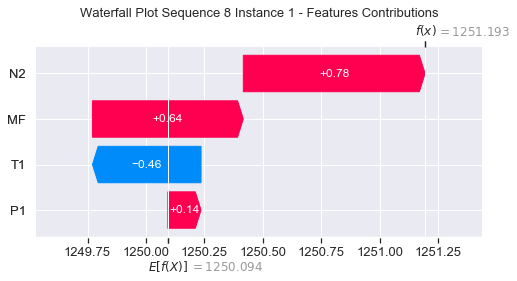

None

Contribution: [0.00320845 0.00073452 0.0120665  0.01089984]


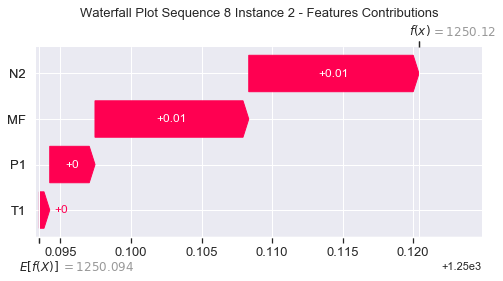

None

Contribution: [0.02424241 0.01793239 0.10108172 0.090943  ]


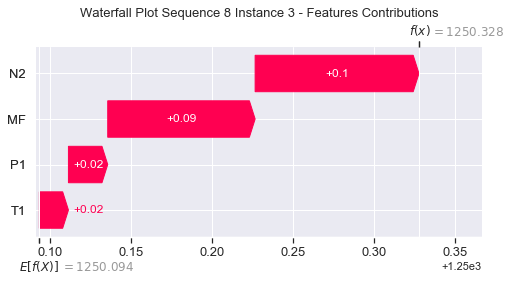

None

Contribution: [0.01607437 0.01267001 0.06468565 0.05757457]


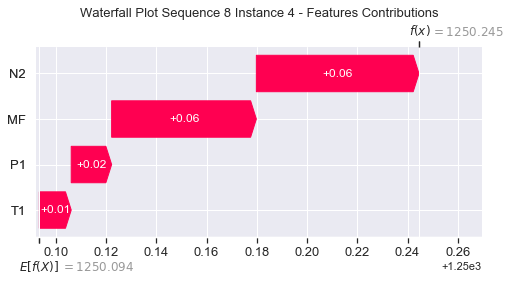

None

Contribution: [0.01768465 0.01438209 0.07395683 0.06191942]


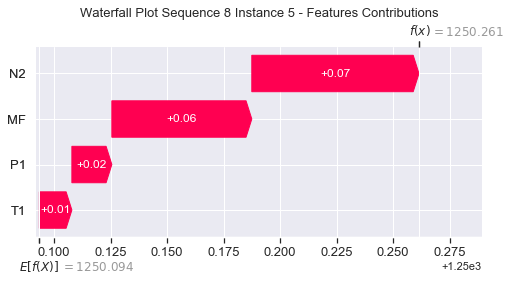

None

Contribution: [0.02083133 0.01786798 0.0819508  0.07121437]


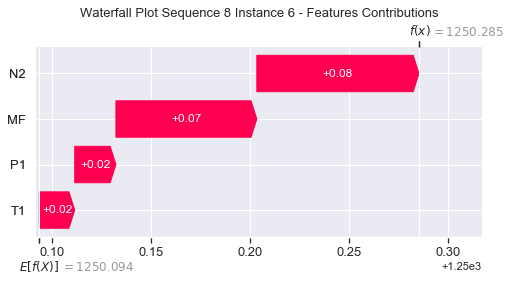

None

Contribution: [0.02050257 0.01756022 0.0807521  0.07039579]


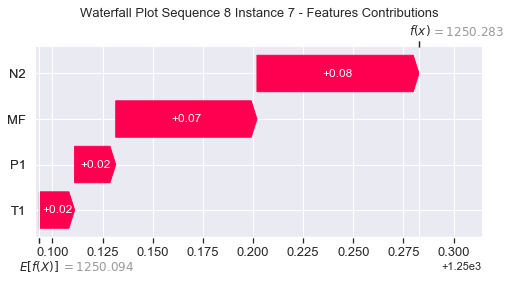

None

Contribution: [0.01928713 0.01691816 0.07594676 0.06624606]


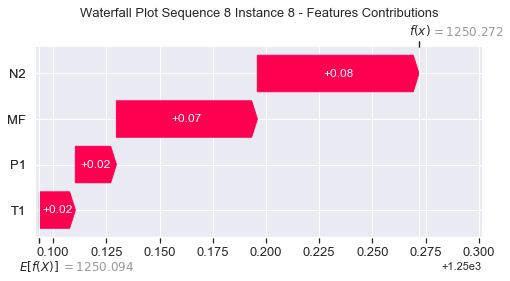

None

Contribution: [0.01766625 0.01526662 0.07140797 0.06355159]


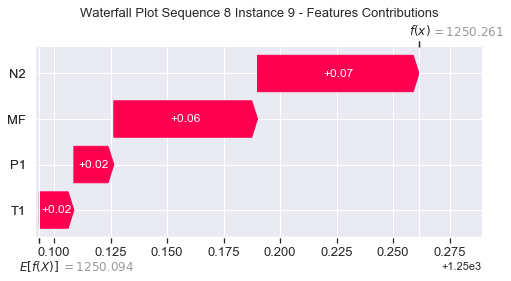

None

Contribution: [0.01557121 0.01355217 0.06686259 0.05780278]


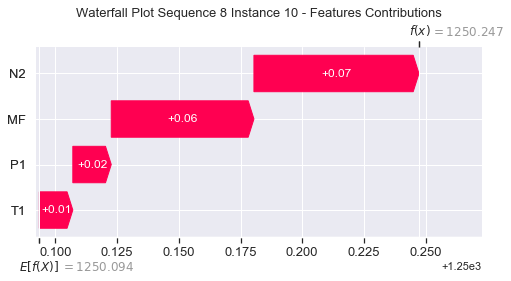

None

Contribution: [0.01702876 0.01641251 0.06574133 0.05909644]


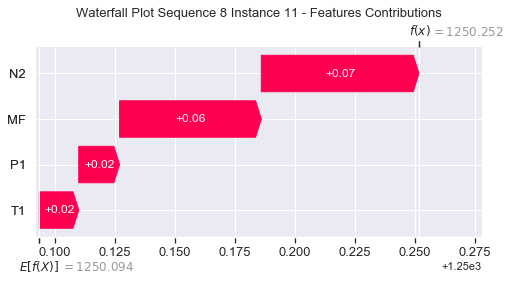

None

Contribution: [0.01676832 0.01671068 0.06360034 0.05644213]


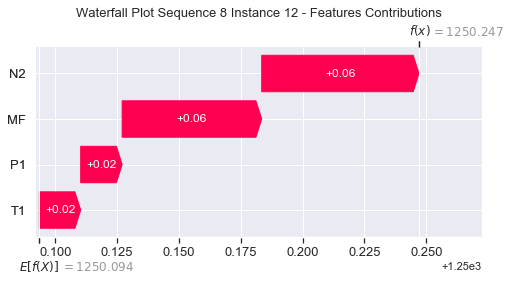

None

Contribution: [0.01643189 0.01603026 0.06275092 0.05551744]


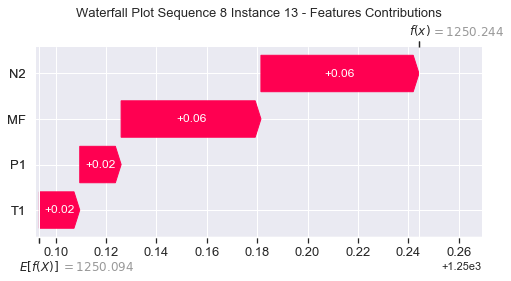

None

Contribution: [0.0165901  0.01594629 0.06288766 0.05647538]


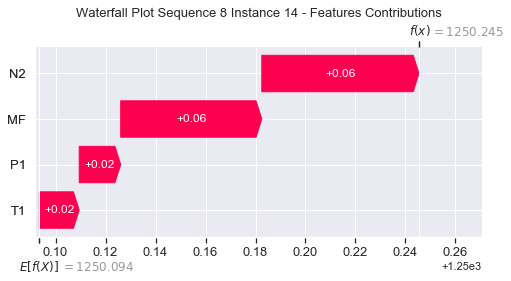

None

Contribution: [0.01709041 0.01630993 0.06400188 0.05703708]


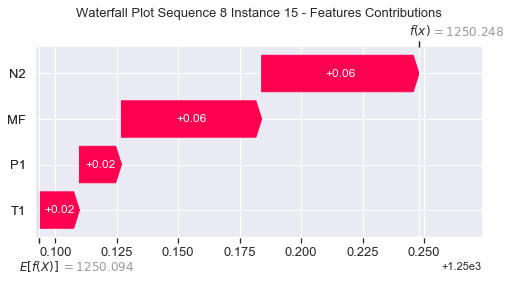

None

Contribution: [0.01826424 0.01681135 0.06794711 0.06142712]


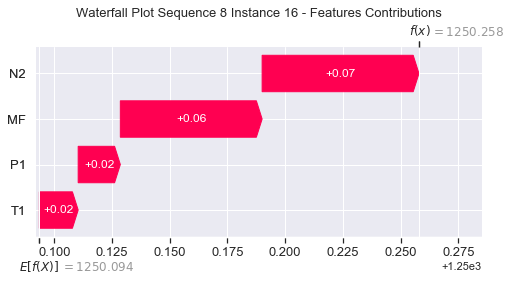

None

Contribution: [0.02129225 0.01974501 0.07797511 0.07018015]


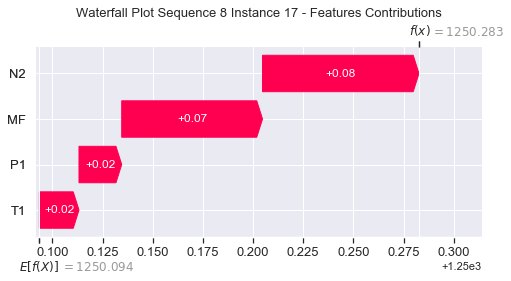

None

Contribution: [0.02895943 0.02621134 0.10367333 0.09389966]


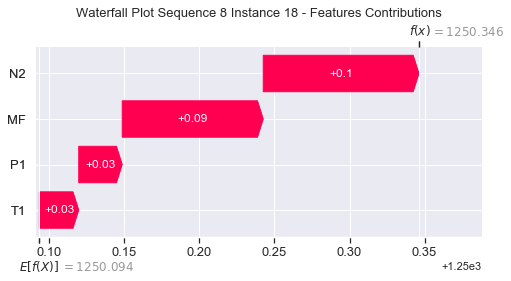

None

Contribution: [0.04757604 0.03892591 0.16774925 0.15121579]


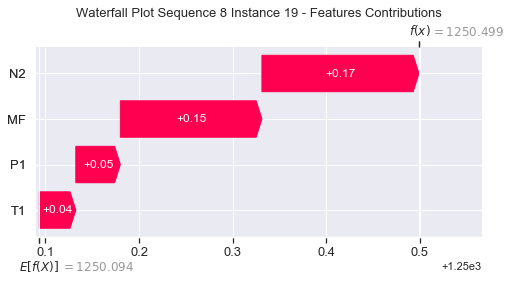

None

Contribution: [0.09105762 0.07656652 0.32054197 0.2909556 ]


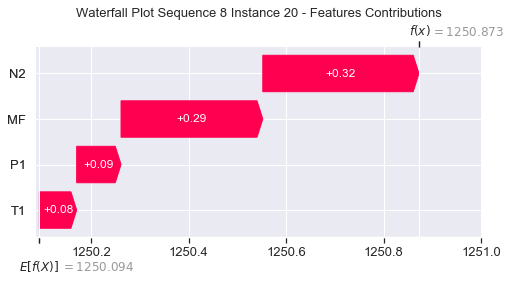

None

Contribution: [0.18843621 0.15871893 0.65961162 0.59991034]


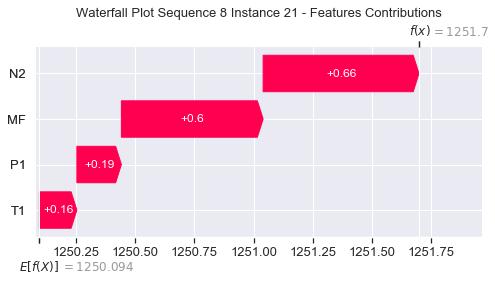

None

Contribution: [0.37716434 0.30491892 1.32553435 1.20551687]


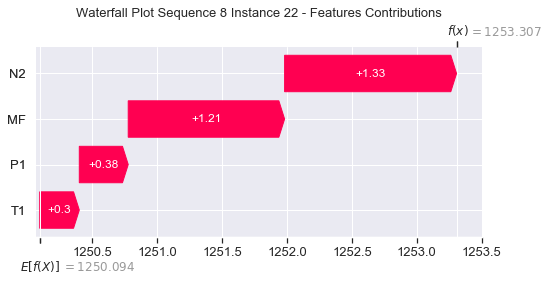

None

Contribution: [0.64670573 0.38269165 2.34545012 2.18076899]


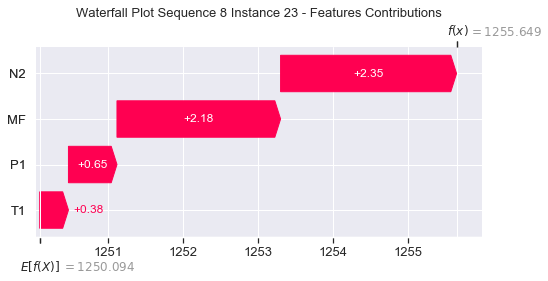

None

Contribution: [ 0.68931904 -1.14620213  3.19849718  2.94040063]


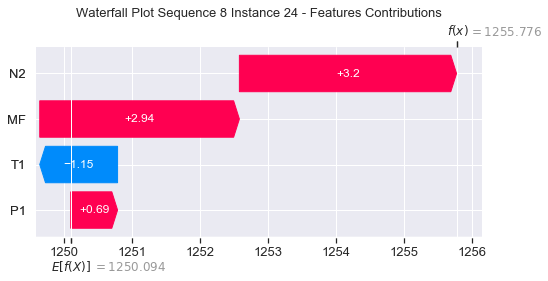

None

Contribution: [ 0.16532132 -0.21985846  0.76432796  0.61997449]


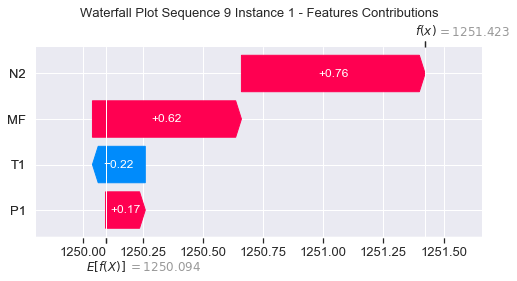

None

Contribution: [0.00331412 0.00275605 0.01164658 0.01063715]


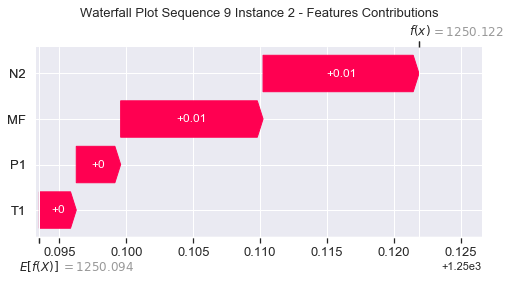

None

Contribution: [0.02476834 0.02288396 0.09948459 0.088473  ]


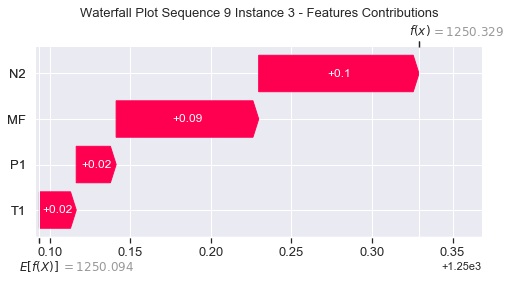

None

Contribution: [0.01680017 0.01948192 0.06634823 0.05808481]


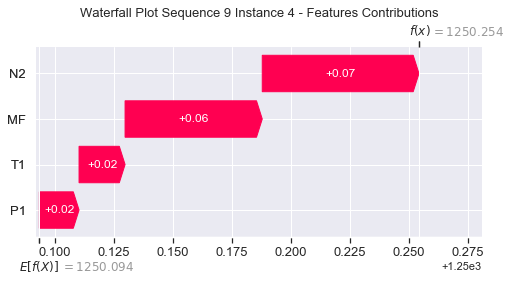

None

Contribution: [0.02007268 0.02148206 0.07757231 0.06912045]


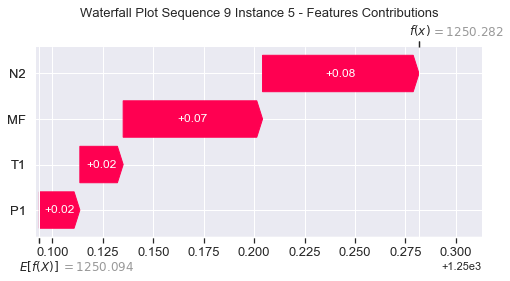

None

Contribution: [0.02132987 0.0222839  0.08210265 0.07287392]


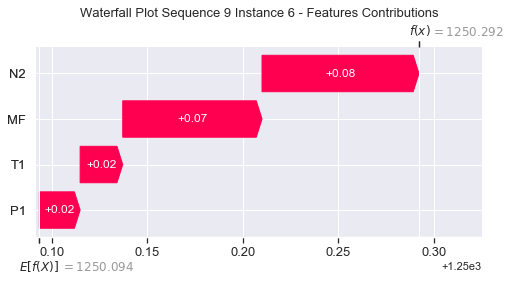

None

Contribution: [0.02078846 0.02164756 0.07980153 0.07067203]


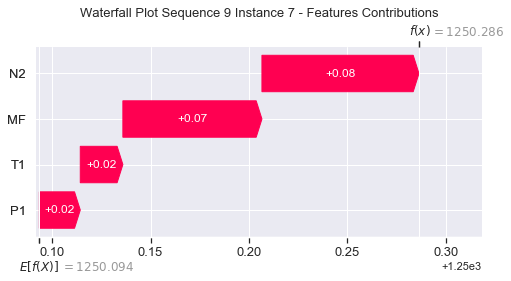

None

Contribution: [0.01959791 0.02032775 0.07486215 0.0664505 ]


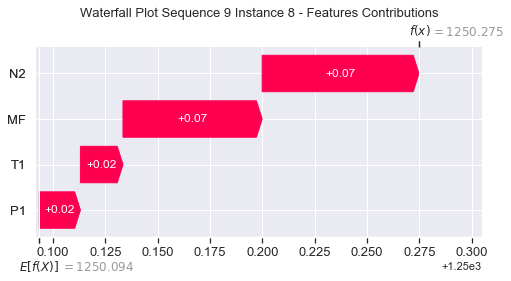

None

Contribution: [0.01890128 0.01995356 0.0703871  0.06230591]


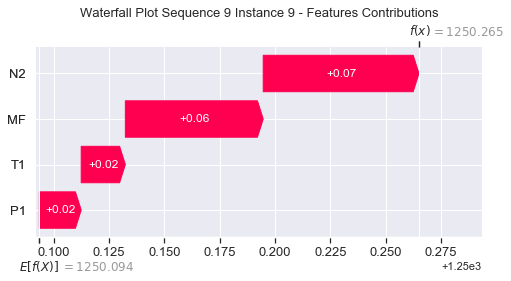

None

Contribution: [0.01758698 0.01878974 0.06664963 0.06032226]


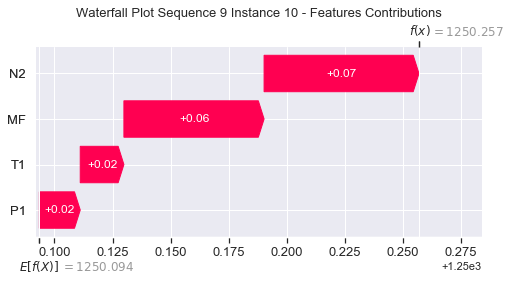

None

Contribution: [0.01704425 0.01776674 0.06363599 0.05658625]


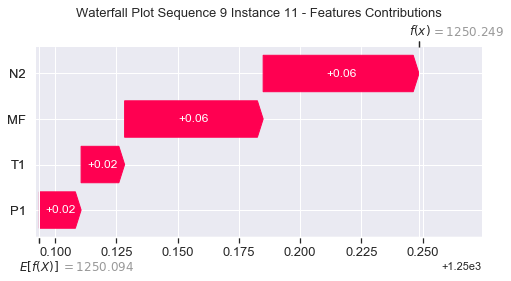

None

Contribution: [0.01621791 0.01615439 0.06154455 0.05449916]


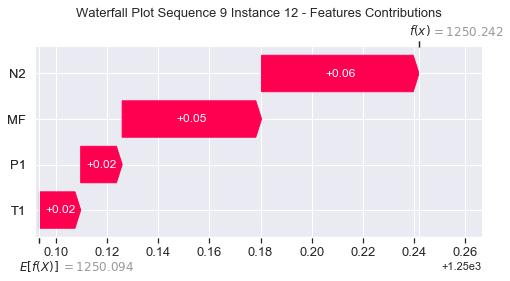

None

Contribution: [0.01615669 0.01596482 0.06103821 0.0541125 ]


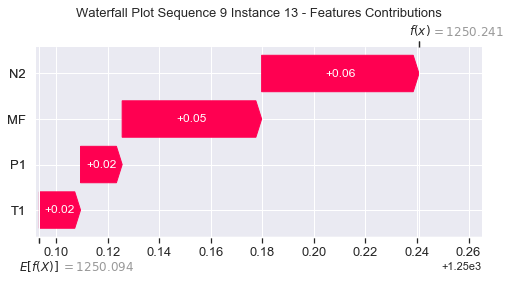

None

Contribution: [0.01657606 0.01556398 0.06139206 0.05545408]


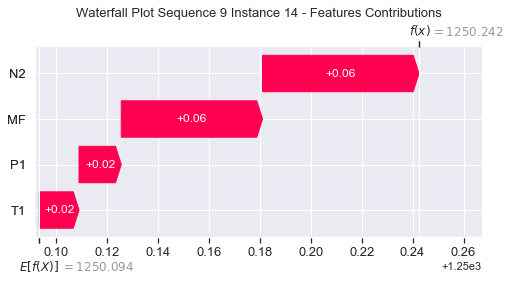

None

Contribution: [0.01665302 0.01595881 0.06227553 0.05542763]


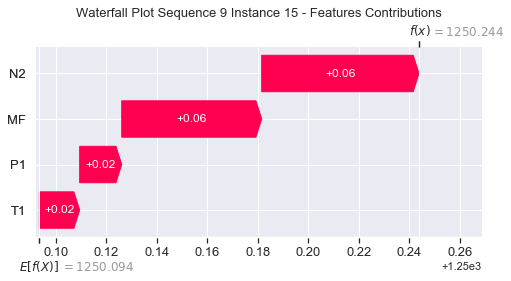

None

Contribution: [0.01802578 0.0156239  0.06625652 0.05999455]


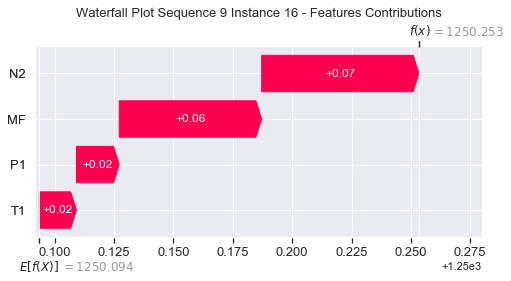

None

Contribution: [0.02089947 0.01885415 0.0762235  0.06816412]


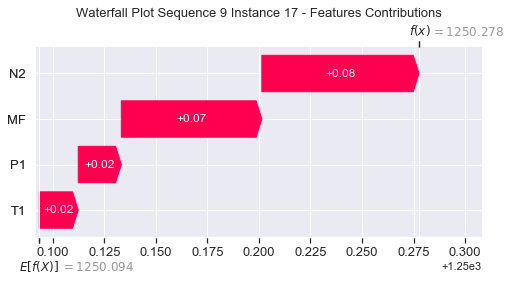

None

Contribution: [0.0284825  0.02458129 0.10199168 0.09180024]


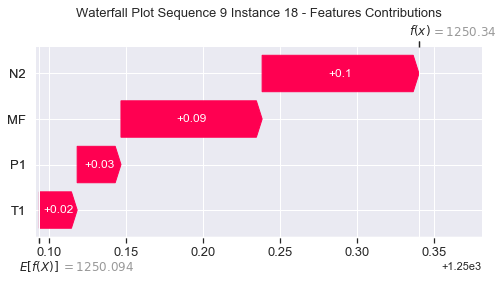

None

Contribution: [0.04720635 0.04073171 0.16633213 0.1518626 ]


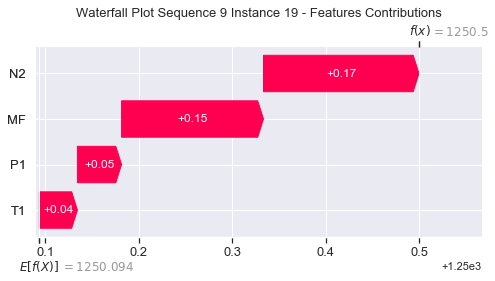

None

Contribution: [0.0921707  0.07483751 0.31952743 0.29096201]


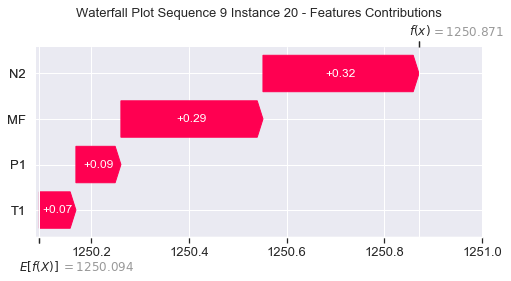

None

Contribution: [0.19160367 0.15174015 0.65992212 0.60319357]


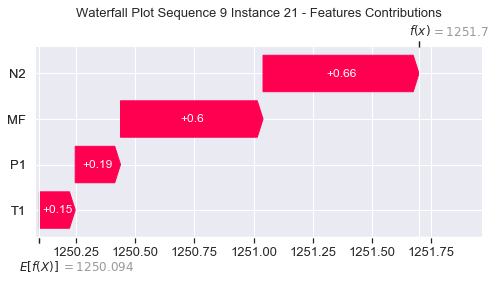

None

Contribution: [0.38529991 0.28232298 1.3293342  1.22262884]


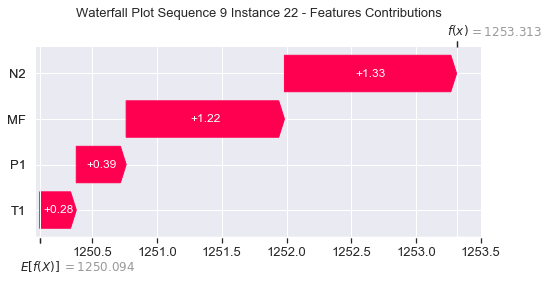

None

Contribution: [0.65339338 0.25791955 2.3514129  2.19817674]


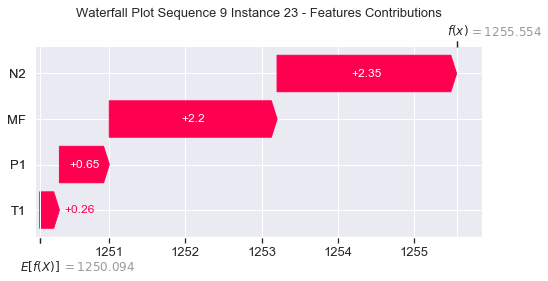

None

Contribution: [ 0.78450996 -1.57376201  3.21966704  3.19418271]


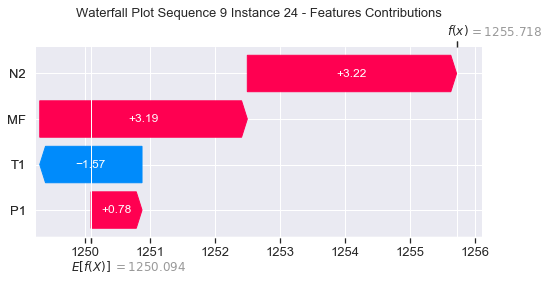

None

Contribution: [ 0.20015772 -0.3069573   0.77113985  0.66699569]


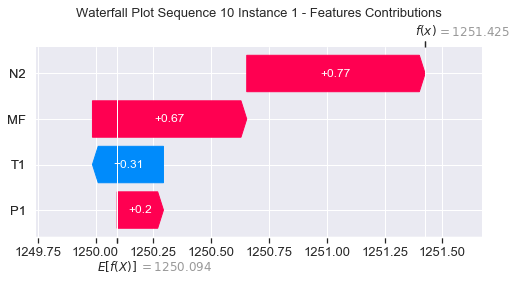

None

Contribution: [0.00357842 0.00176784 0.01176897 0.01138853]


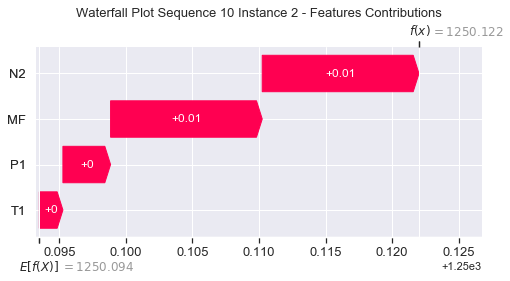

None

Contribution: [0.02507818 0.02341883 0.10005434 0.09068416]


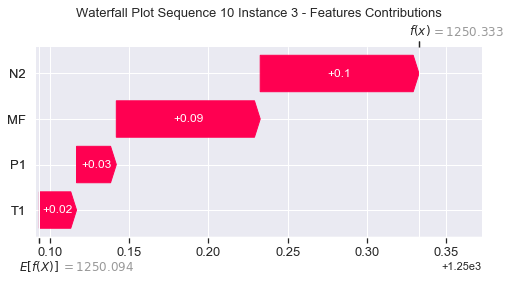

None

Contribution: [0.01773568 0.01714308 0.06698373 0.05873916]


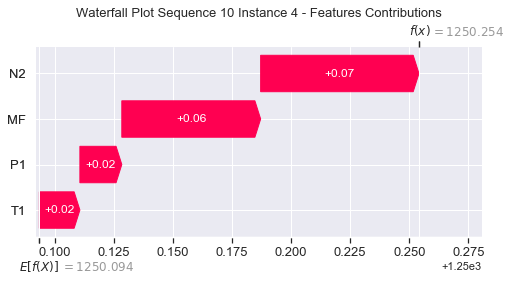

None

Contribution: [0.0212568  0.02273005 0.07869115 0.07016495]


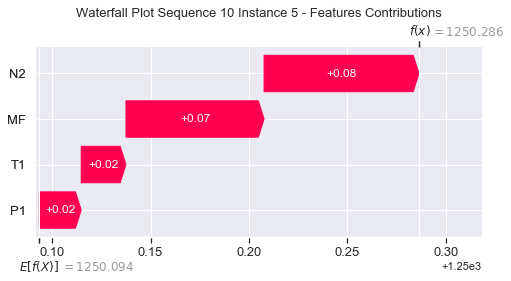

None

Contribution: [0.02293458 0.02060173 0.08320453 0.07521714]


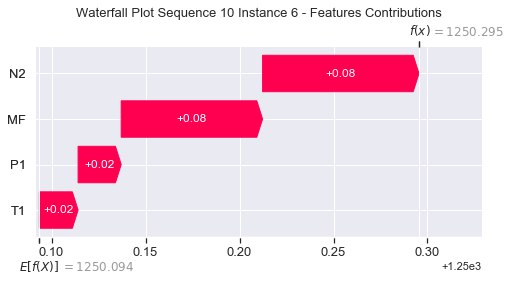

None

Contribution: [0.02201871 0.01889829 0.08050027 0.07254412]


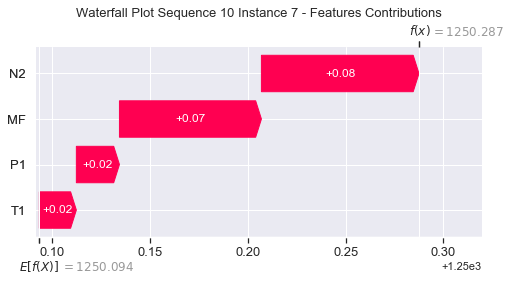

None

Contribution: [0.02106708 0.01880179 0.07583884 0.06859268]


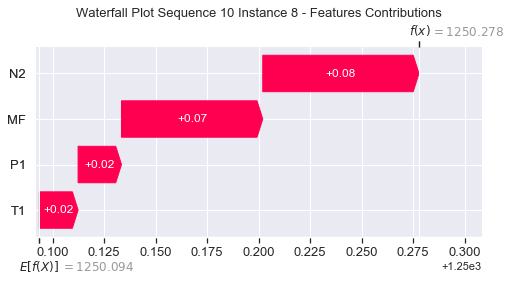

None

Contribution: [0.02078234 0.02008344 0.07168198 0.0656818 ]


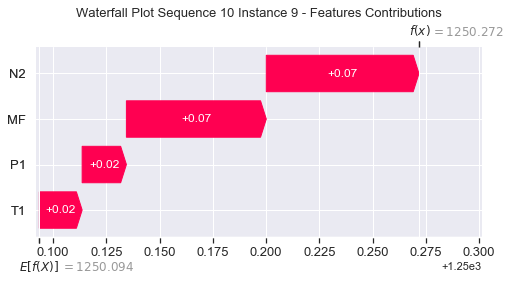

None

Contribution: [0.01956657 0.0198035  0.0680459  0.06198013]


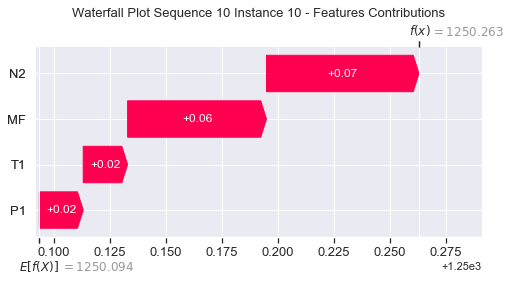

None

Contribution: [0.01993344 0.02002295 0.06588524 0.0615961 ]


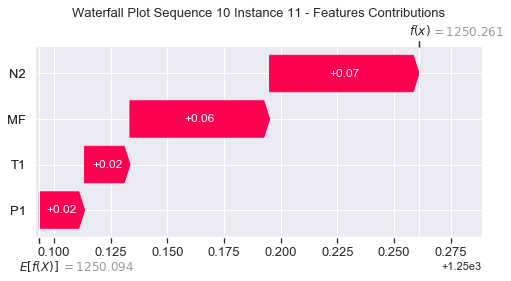

None

Contribution: [0.01750811 0.01478644 0.06263045 0.05692774]


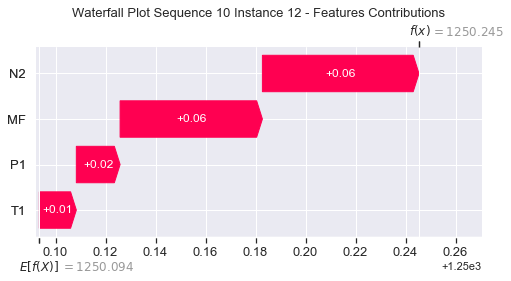

None

Contribution: [0.01719212 0.01424811 0.06182736 0.05592902]


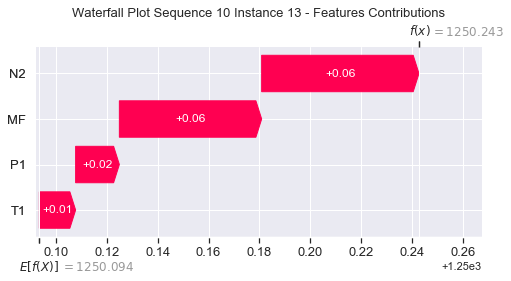

None

Contribution: [0.01745792 0.01627122 0.06190114 0.05569455]


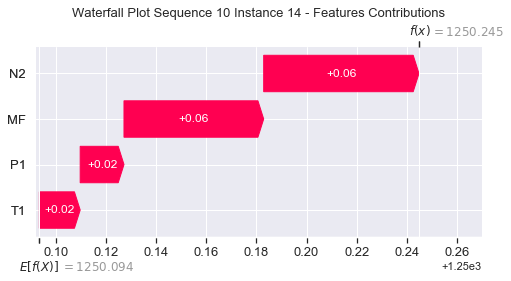

None

Contribution: [0.01758055 0.01347919 0.06257298 0.05676899]


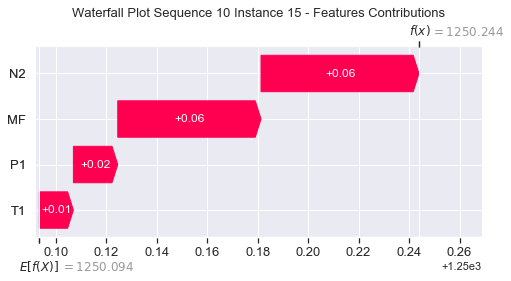

None

Contribution: [0.01768804 0.00794793 0.06561665 0.05967341]


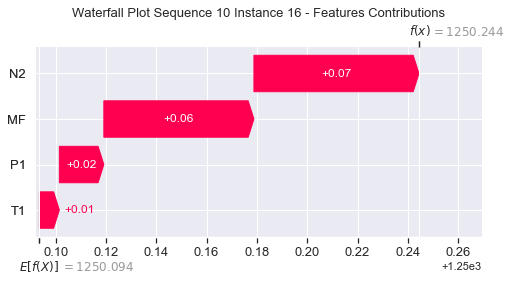

None

Contribution: [0.02186896 0.01502538 0.07678759 0.06967849]


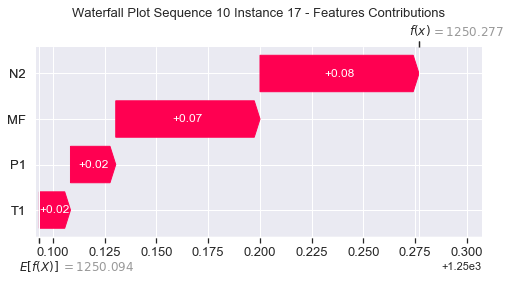

None

Contribution: [0.02996843 0.01968698 0.10328542 0.0941727 ]


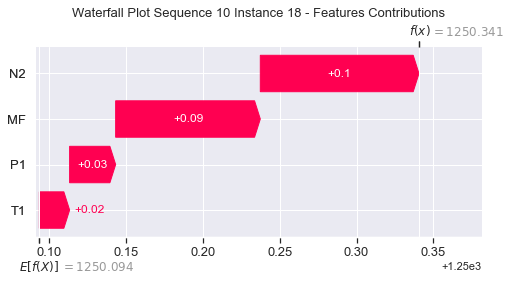

None

Contribution: [0.04918415 0.0228753  0.16977126 0.15596013]


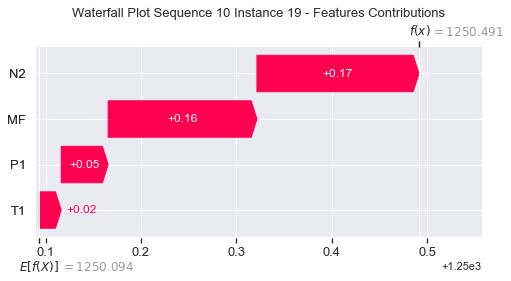

None

Contribution: [0.09615288 0.06014937 0.32454562 0.29664411]


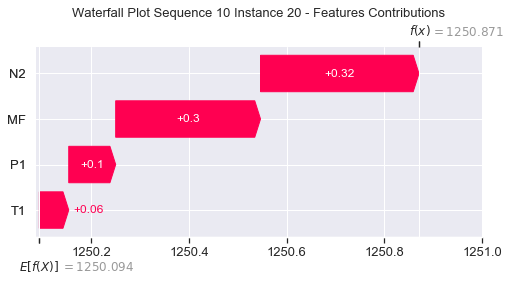

None

Contribution: [0.19969634 0.12553922 0.66823019 0.6127957 ]


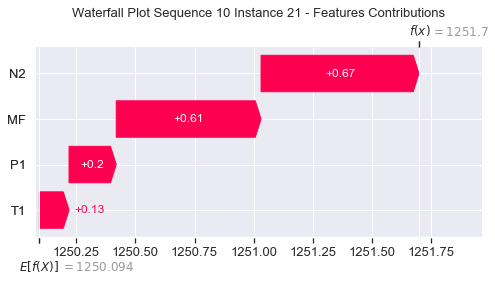

None

Contribution: [0.4044252  0.23247768 1.34129162 1.23769143]


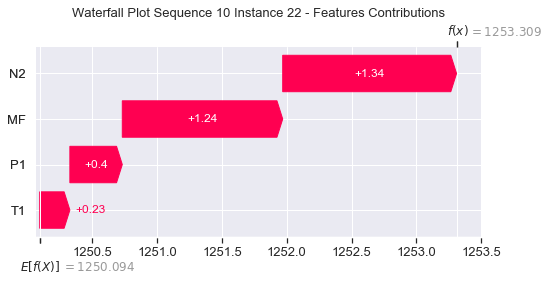

None

Contribution: [0.71481308 0.05959969 2.3696859  2.24154849]


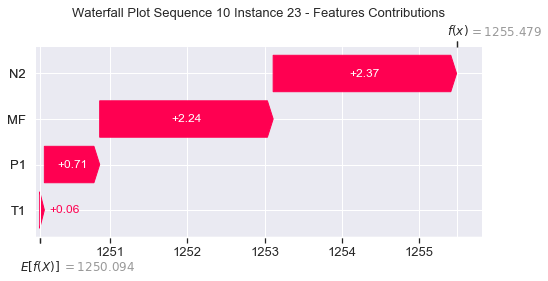

None

Contribution: [ 0.98135539 -2.20969699  3.21301208  3.16658146]


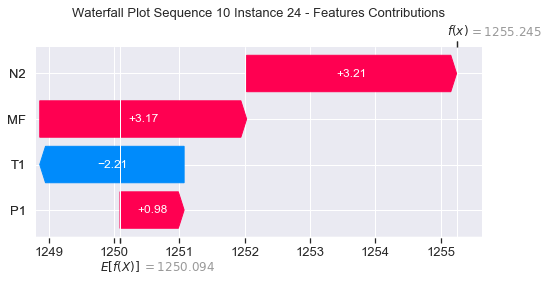

None

Contribution: [ 0.19051001 -0.3333279   0.72997075  0.60062927]


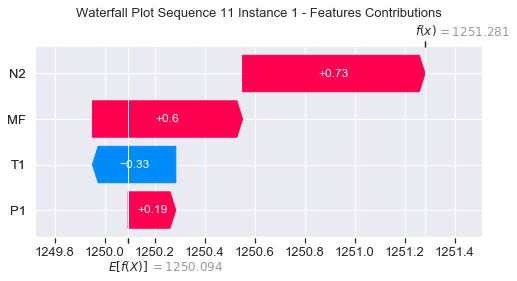

None

Contribution: [0.00368111 0.00105315 0.01113681 0.01079231]


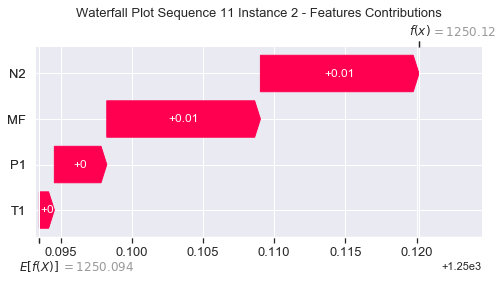

None

Contribution: [0.02474088 0.02174935 0.09385757 0.0863776 ]


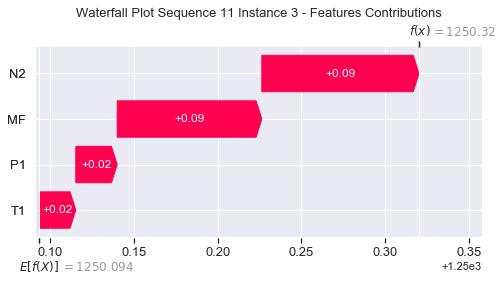

None

Contribution: [0.01813809 0.01895342 0.06445857 0.05810752]


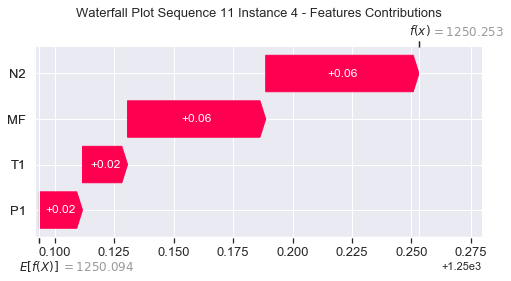

None

Contribution: [0.02125017 0.02233944 0.07522992 0.06802676]


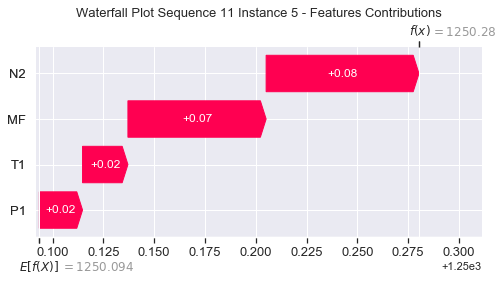

None

Contribution: [0.02275443 0.02391667 0.07933426 0.07192646]


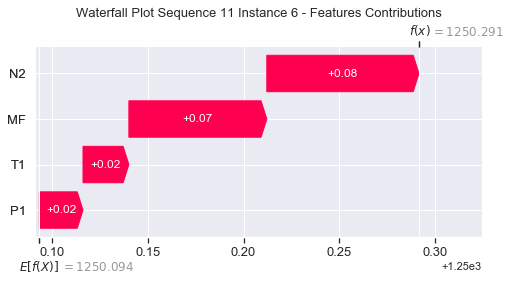

None

Contribution: [0.02180528 0.02330327 0.07658635 0.06916564]


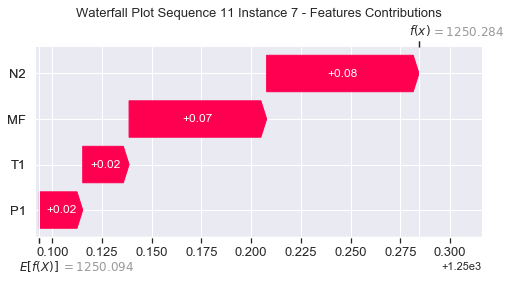

None

Contribution: [0.02042584 0.02178991 0.0714329  0.06455523]


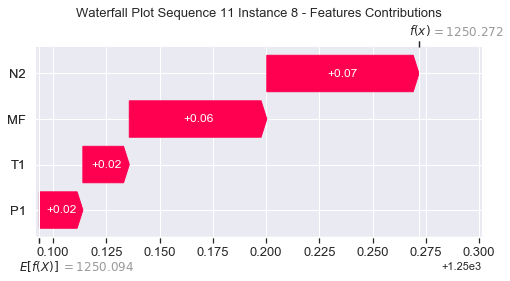

None

Contribution: [0.01853073 0.02075604 0.06644253 0.05864812]


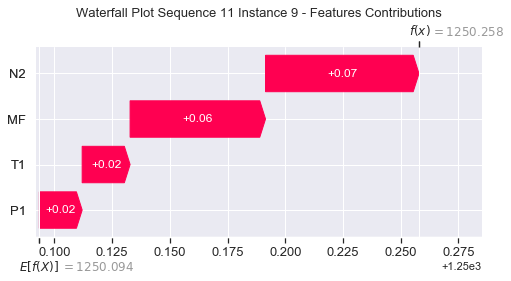

None

Contribution: [0.01738473 0.01948433 0.06292877 0.05626924]


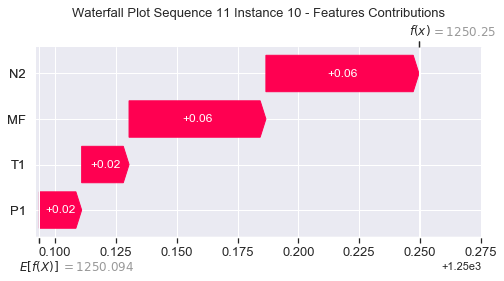

None

Contribution: [0.01754026 0.01850176 0.06060024 0.05425268]


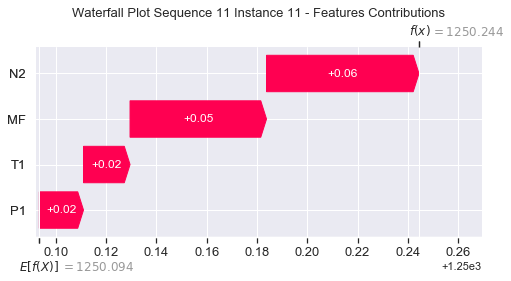

None

Contribution: [0.01705753 0.01787622 0.05897767 0.05335848]


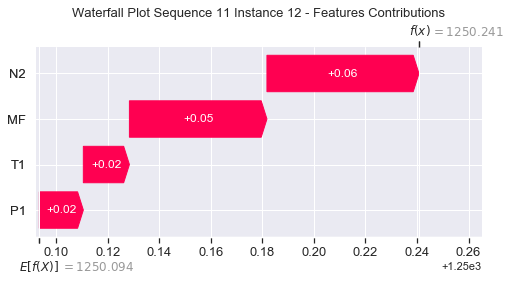

None

Contribution: [0.01681594 0.01779913 0.05842068 0.05280801]


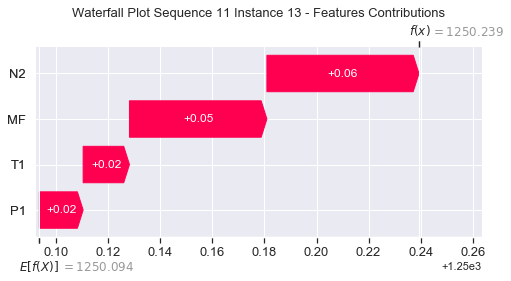

None

Contribution: [0.01690264 0.01811805 0.05852924 0.05320552]


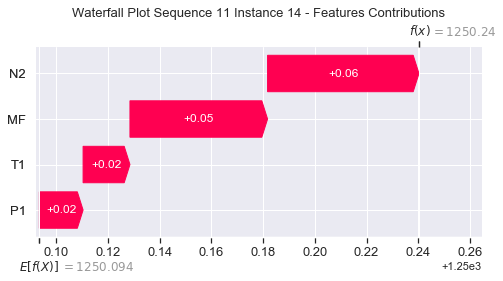

None

Contribution: [0.01733454 0.01819652 0.05968487 0.05422396]


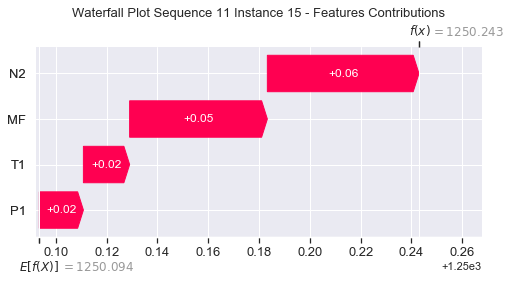

None

Contribution: [0.01949528 0.0182798  0.06342808 0.05899263]


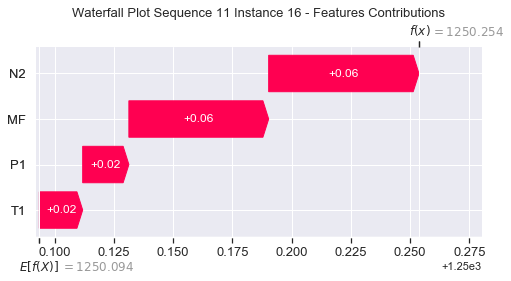

None

Contribution: [0.02129527 0.02193682 0.07273079 0.06625207]


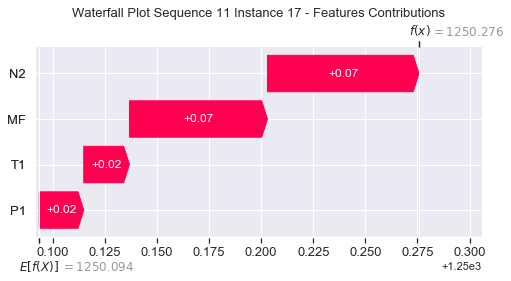

None

Contribution: [0.02881181 0.02864416 0.09686497 0.08882379]


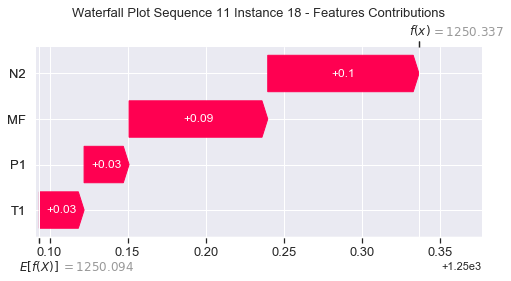

None

Contribution: [0.04838974 0.04603916 0.15747714 0.14853089]


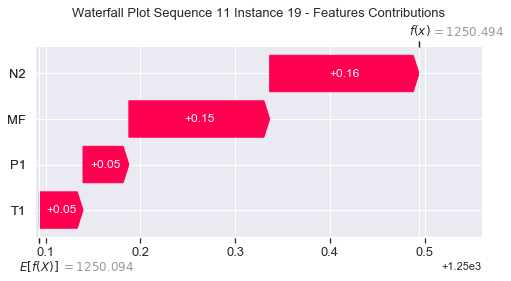

None

Contribution: [0.0915599  0.08756837 0.30281823 0.2799902 ]


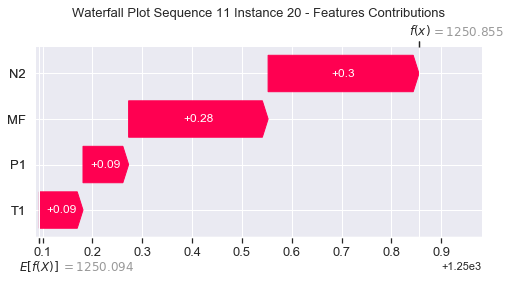

None

Contribution: [0.19180904 0.18056829 0.62936083 0.58409052]


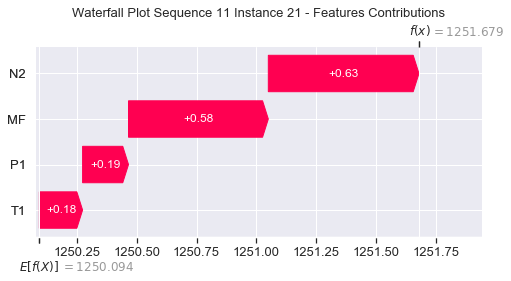

None

Contribution: [0.39370348 0.35743502 1.27873788 1.1975143 ]


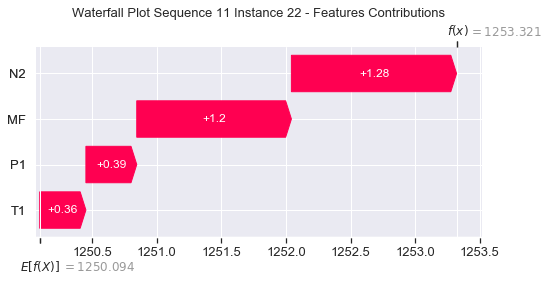

None

Contribution: [0.71412667 0.54094915 2.28126996 2.20855201]


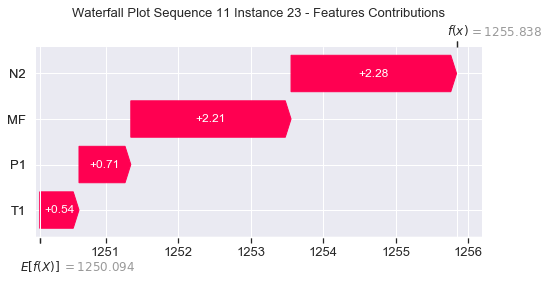

None

Contribution: [ 1.11806837 -0.194952    3.13337143  3.45847736]


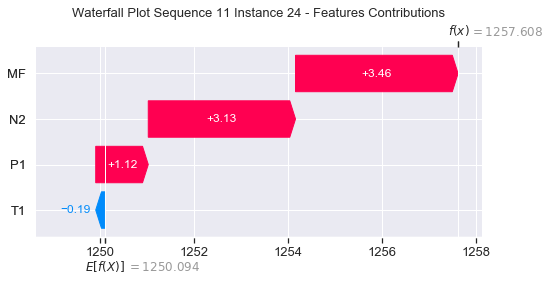

None

Contribution: [ 0.24533365 -0.04890019  0.72676088  0.68904981]


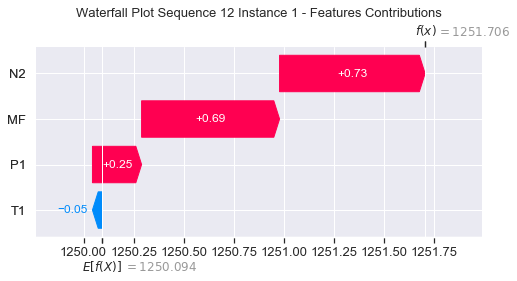

None

Contribution: [0.00378391 0.00328562 0.01087497 0.01113569]


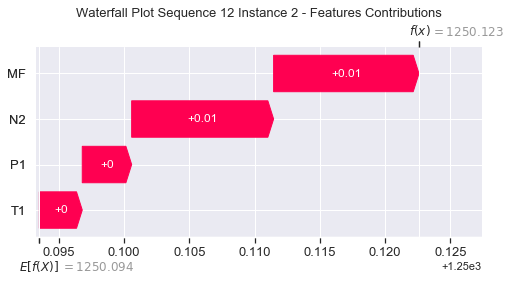

None

Contribution: [0.02551561 0.02804959 0.09422611 0.0873379 ]


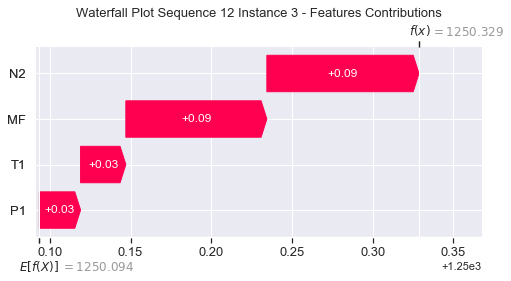

None

Contribution: [0.01849325 0.02144521 0.06580817 0.05947129]


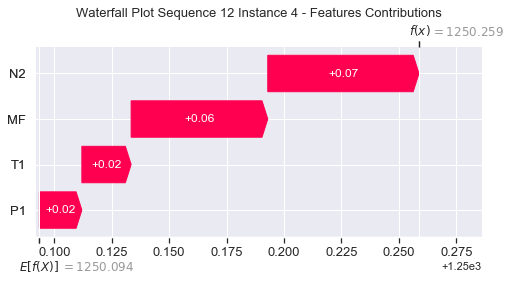

None

Contribution: [0.02136937 0.02475593 0.07580208 0.06828484]


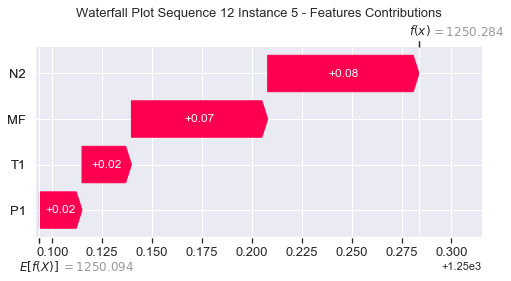

None

Contribution: [0.02243359 0.02486421 0.07912716 0.07206801]


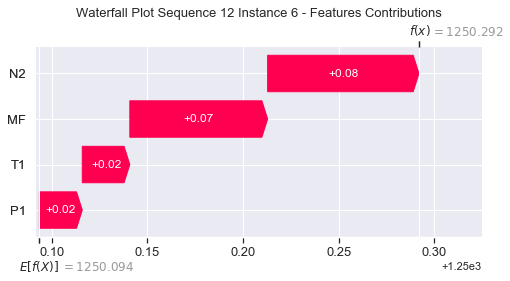

None

Contribution: [0.02162773 0.023629   0.07616805 0.06935836]


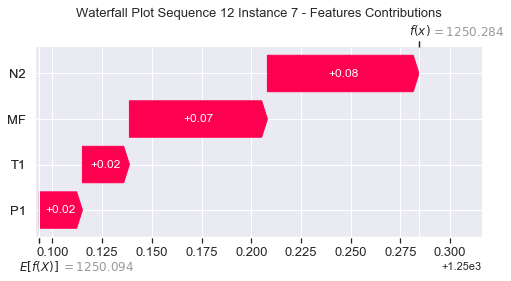

None

Contribution: [0.02018872 0.02219296 0.07107784 0.06460568]


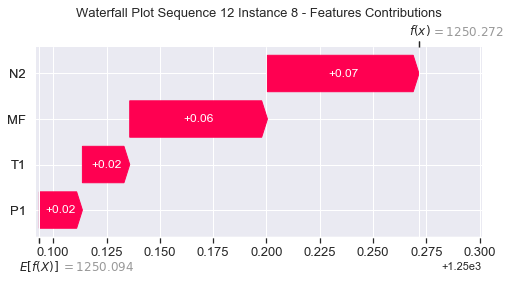

None

Contribution: [0.01896177 0.02066469 0.0664737  0.05999683]


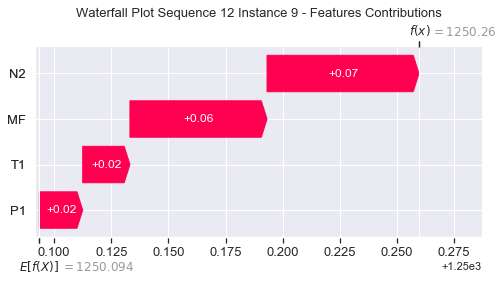

None

Contribution: [0.01850708 0.01961437 0.06322293 0.05808192]


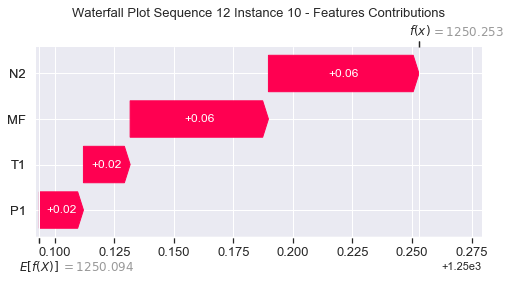

None

Contribution: [0.01711217 0.01877878 0.06018817 0.05424123]


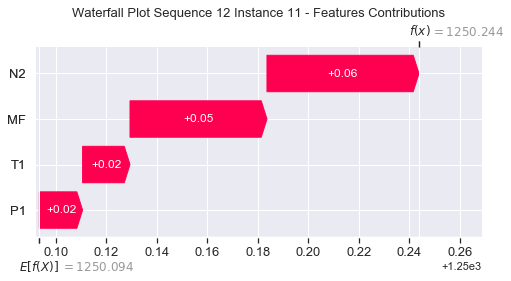

None

Contribution: [0.01653013 0.01720623 0.05840311 0.05285109]


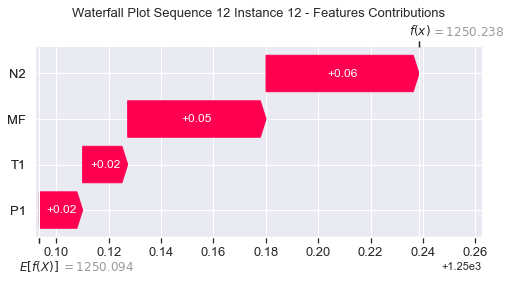

None

Contribution: [0.01646406 0.01704767 0.05797207 0.05251383]


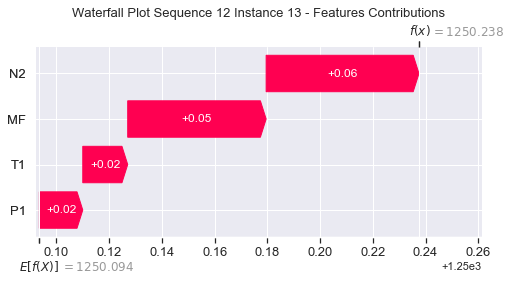

None

Contribution: [0.01672392 0.01637628 0.05810859 0.05337425]


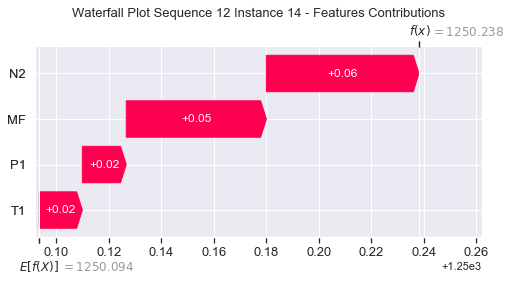

None

Contribution: [0.01698579 0.01722773 0.0593698  0.0539765 ]


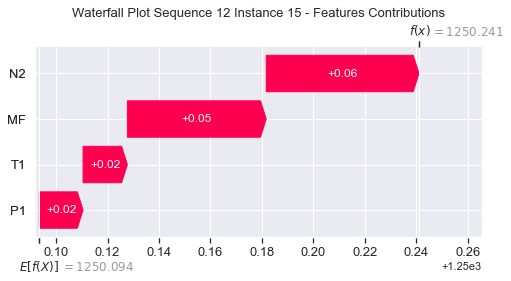

None

Contribution: [0.01836154 0.01714173 0.06316161 0.05812853]


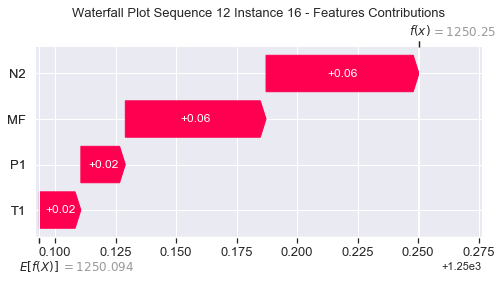

None

Contribution: [0.02120968 0.02030047 0.07287704 0.06672517]


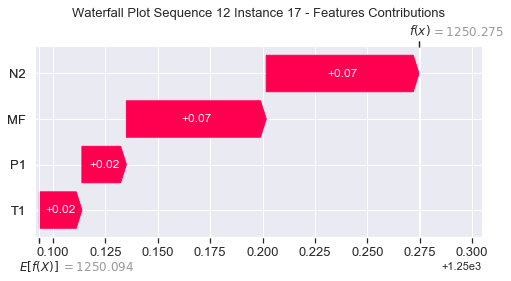

None

Contribution: [0.02875434 0.02653793 0.09749498 0.08971689]


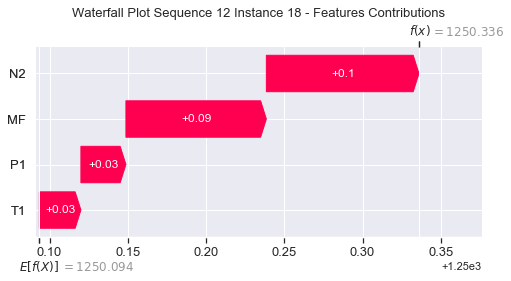

None

Contribution: [0.0470716  0.04131907 0.15889408 0.14528442]


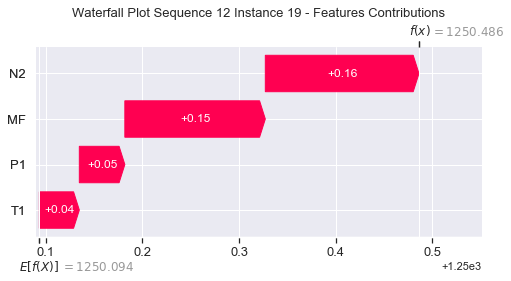

None

Contribution: [0.09257014 0.081702   0.30618469 0.28383259]


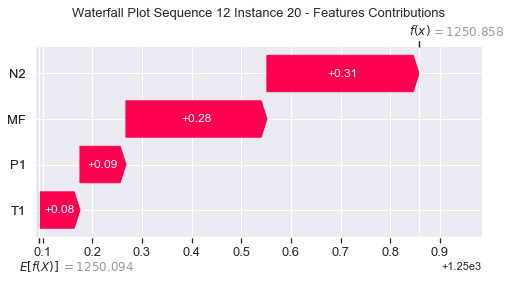

None

Contribution: [0.19335607 0.16834564 0.63612593 0.5907465 ]


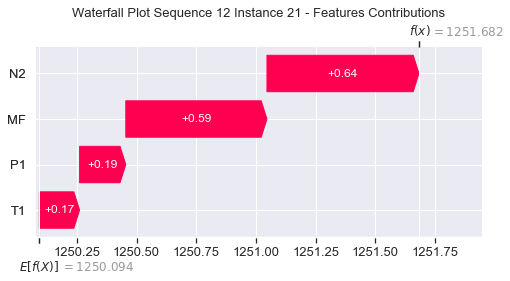

None

Contribution: [0.39414203 0.33110087 1.29162554 1.20407455]


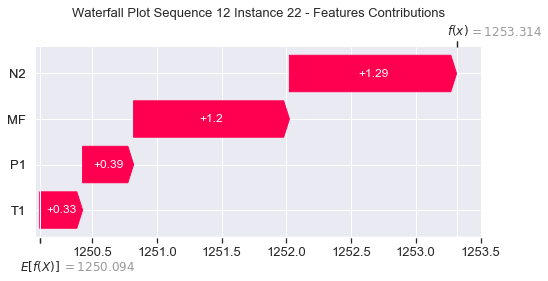

None

Contribution: [0.70328196 0.43344033 2.30563742 2.21507561]


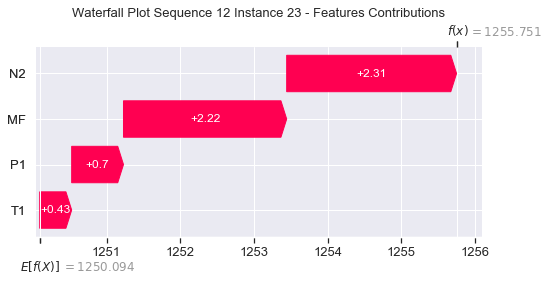

None

Contribution: [ 1.0490531  -0.53464618  3.22006699  3.50350361]


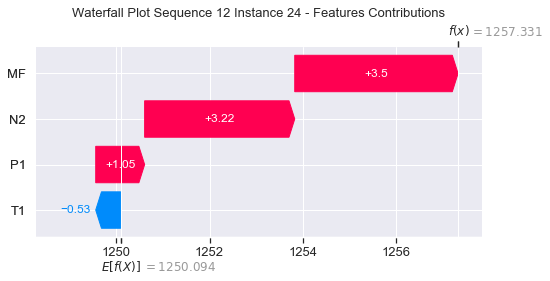

None

Contribution: [ 0.22436267 -0.07920202  0.74644846  0.73896281]


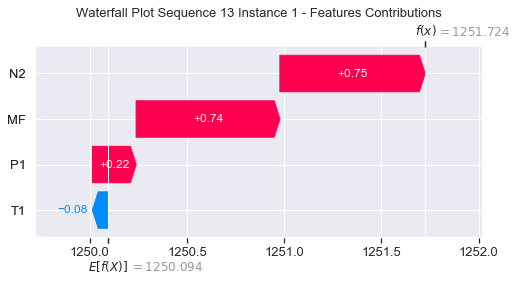

None

Contribution: [0.00361644 0.00265812 0.01074076 0.0105653 ]


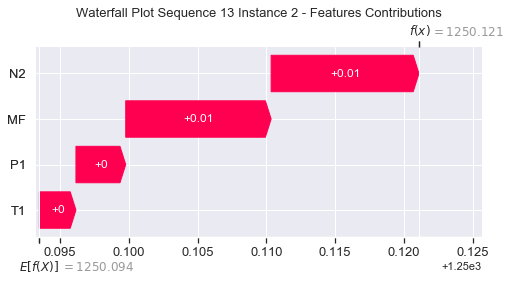

None

Contribution: [0.02461826 0.02737964 0.09408583 0.08490382]


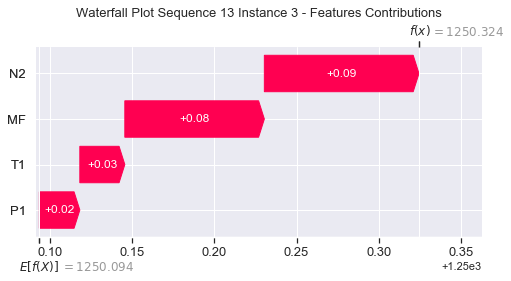

None

Contribution: [0.01768904 0.02136804 0.06548363 0.059001  ]


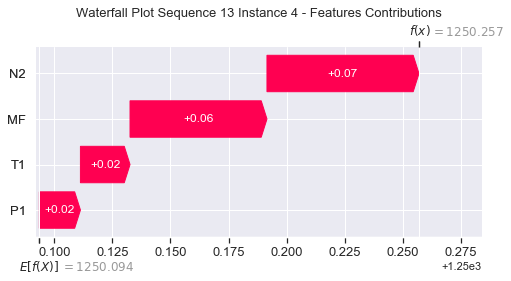

None

Contribution: [0.02058589 0.023179   0.07503955 0.06727602]


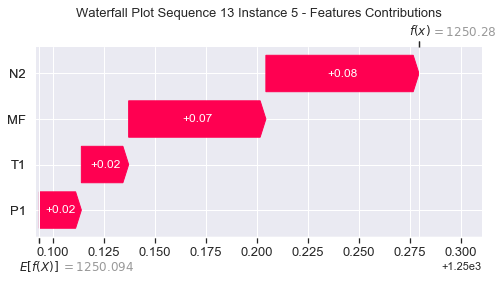

None

Contribution: [0.02159841 0.02414125 0.07836833 0.06989319]


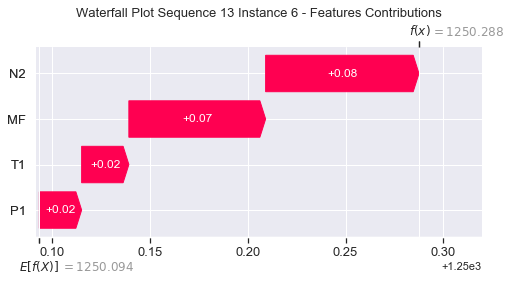

None

Contribution: [0.02087649 0.02326717 0.07566868 0.06753892]


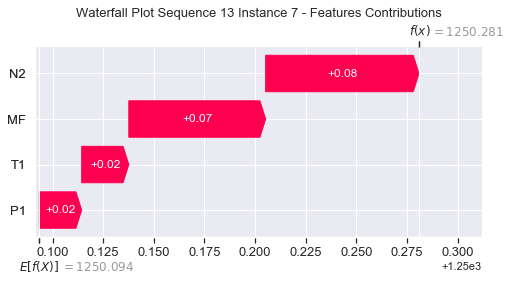

None

Contribution: [0.01956801 0.02195519 0.07081118 0.06341935]


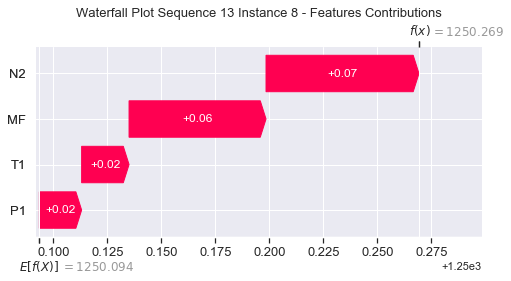

None

Contribution: [0.01865354 0.02072702 0.06648087 0.06035322]


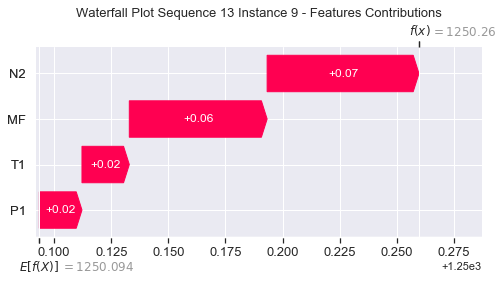

None

Contribution: [0.01730619 0.01722027 0.06235785 0.05612993]


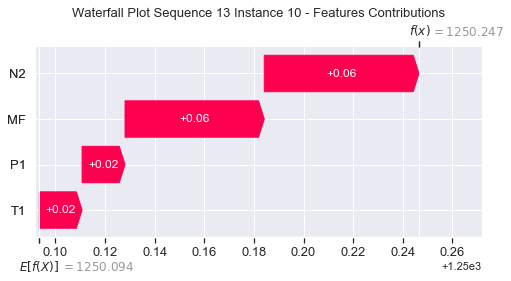

None

Contribution: [0.01697643 0.01919381 0.06049669 0.05484988]


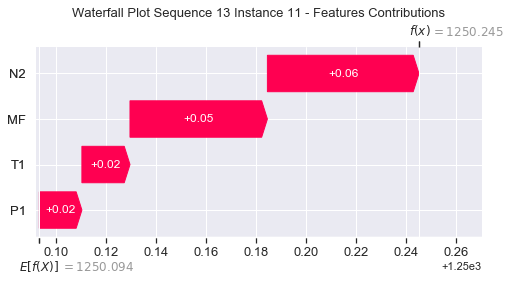

None

Contribution: [0.01626692 0.0186256  0.05870656 0.05267455]


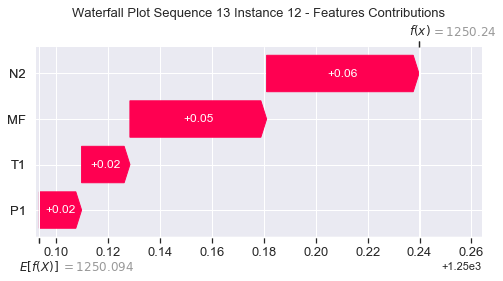

None

Contribution: [0.01616422 0.01835724 0.05825442 0.05236736]


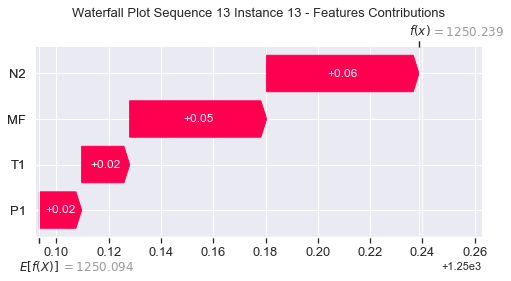

None

Contribution: [0.01640619 0.01896546 0.05848925 0.05324689]


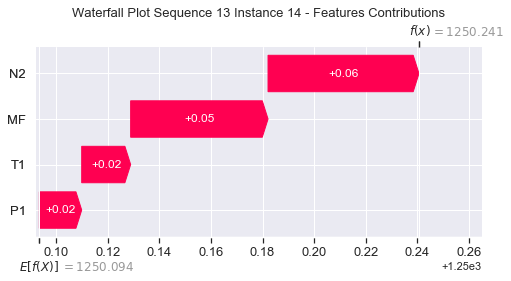

None

Contribution: [0.01657976 0.01867857 0.05947591 0.05358731]


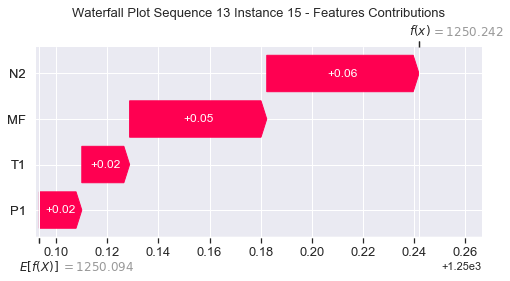

None

Contribution: [0.01767074 0.01918059 0.06309353 0.05701386]


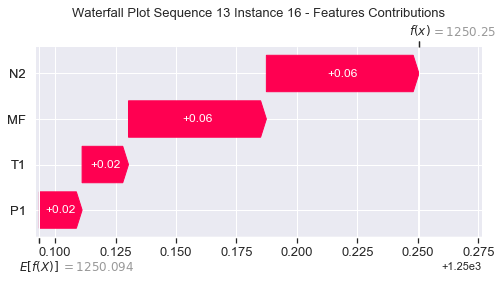

None

Contribution: [0.02064346 0.02213463 0.07280891 0.06606793]


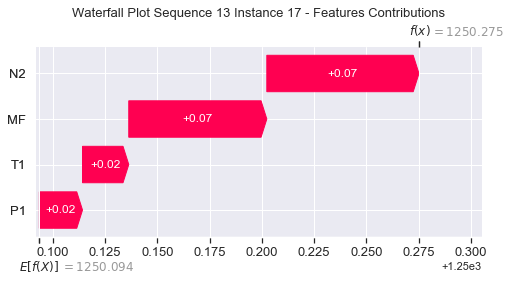

None

Contribution: [0.02792825 0.02885055 0.09716801 0.08862   ]


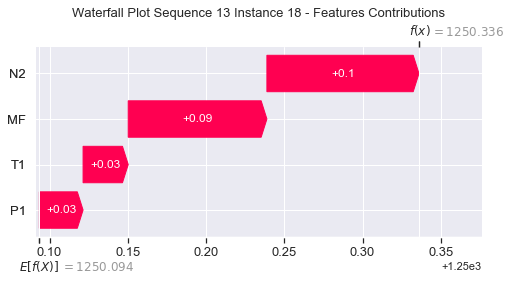

None

Contribution: [0.04544637 0.04457791 0.15812481 0.14493776]


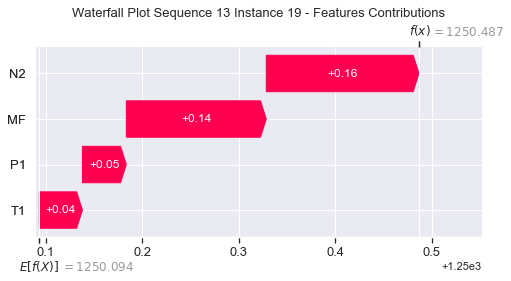

None

Contribution: [0.08952183 0.08700849 0.30399036 0.28072608]


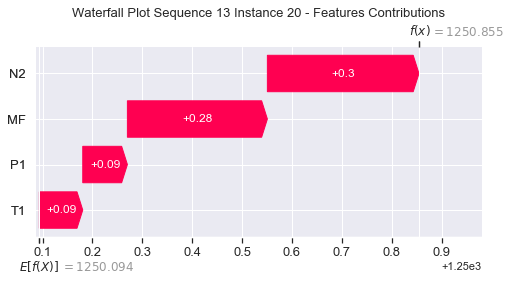

None

Contribution: [0.18709047 0.18117592 0.63147568 0.58591984]


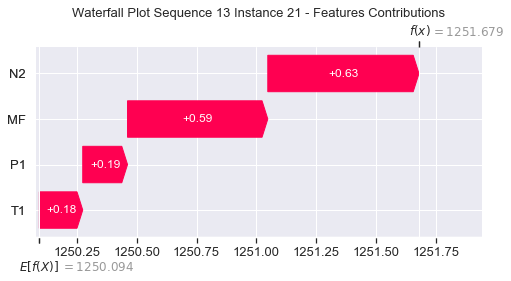

None

Contribution: [0.38045544 0.36369664 1.28389076 1.20056141]


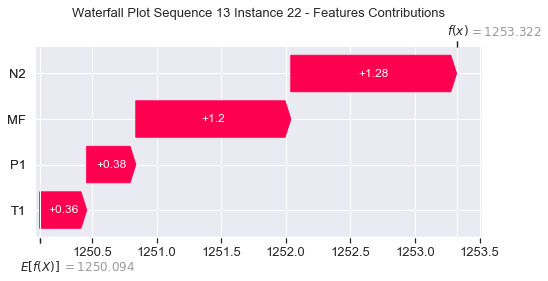

None

Contribution: [0.66400334 0.55436089 2.29712906 2.20483681]


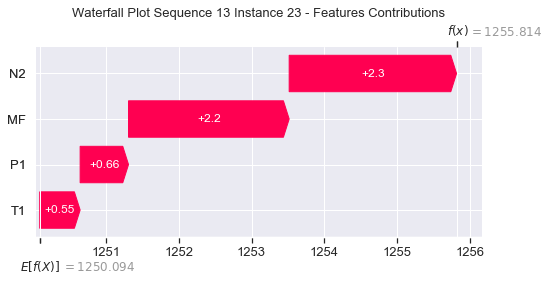

None

Contribution: [ 0.88271809 -0.07633884  3.20315785  3.37000159]


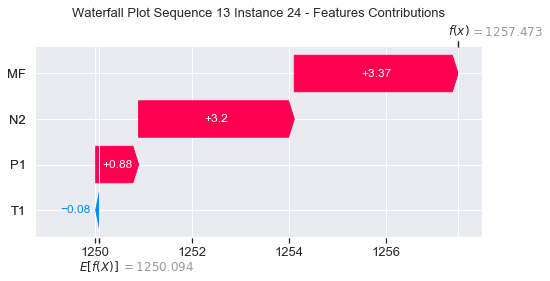

None

Contribution: [0.20623571 0.0164393  0.74113518 0.65845384]


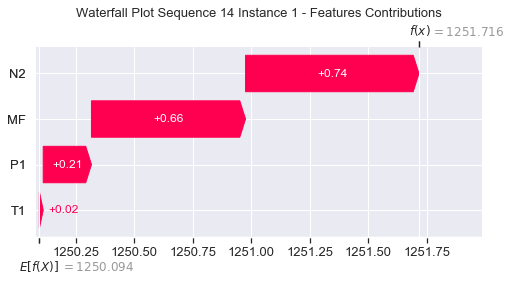

None

Contribution: [0.00348418 0.00359919 0.01106906 0.01146138]


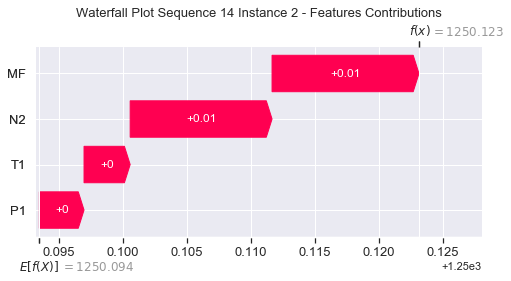

None

Contribution: [0.02436818 0.03245064 0.09415961 0.08643684]


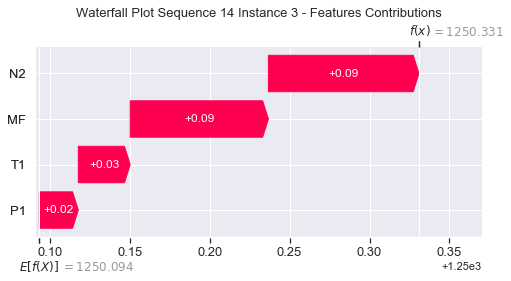

None

Contribution: [0.01846339 0.02404127 0.06684384 0.0613473 ]


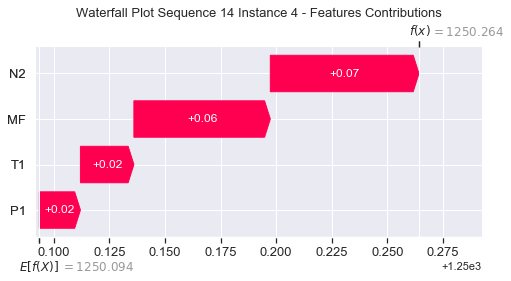

None

Contribution: [0.02093383 0.0271862  0.07555993 0.06797734]


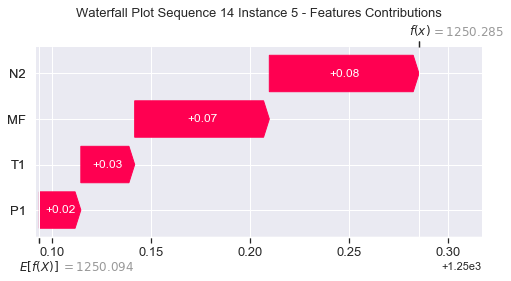

None

Contribution: [0.02162425 0.02722066 0.07820061 0.07019787]


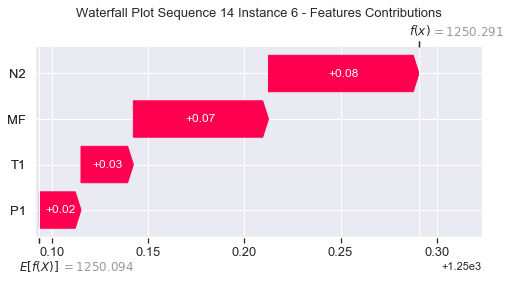

None

Contribution: [0.02084897 0.0261117  0.07524252 0.06765805]


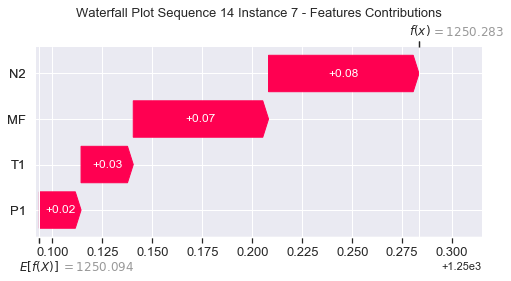

None

Contribution: [0.01948591 0.02447353 0.07029615 0.06315729]


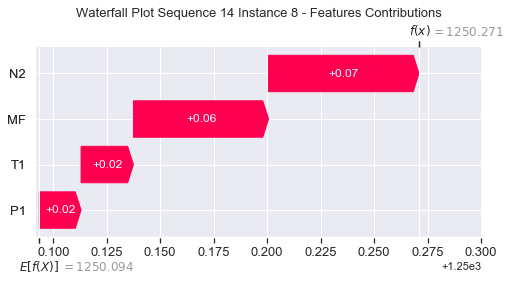

None

Contribution: [0.01856739 0.02394199 0.06609495 0.05929452]


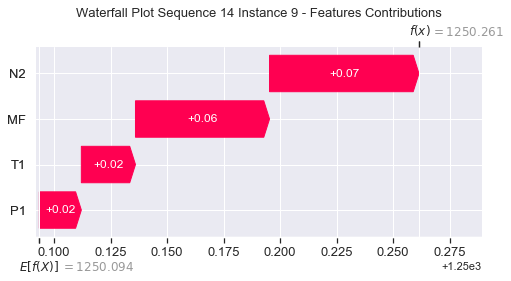

None

Contribution: [0.01754299 0.02235612 0.0624808  0.05654528]


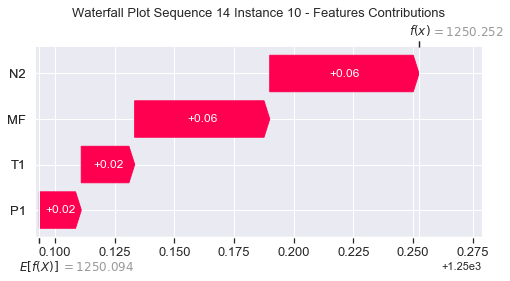

None

Contribution: [0.01667333 0.02124278 0.05981245 0.05338089]


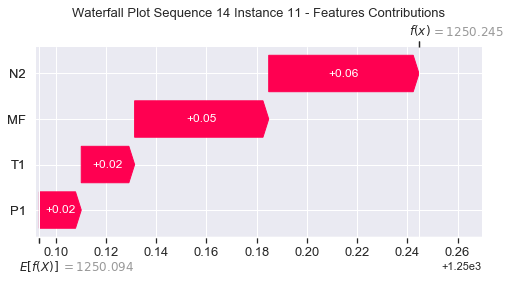

None

Contribution: [0.01604247 0.01934579 0.0580101  0.05211783]


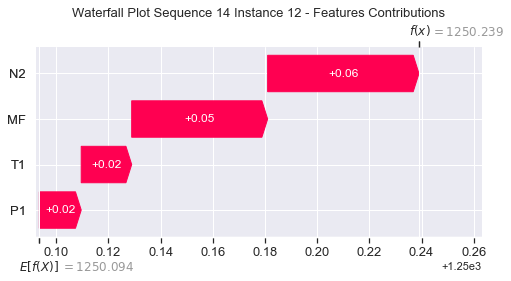

None

Contribution: [0.01597196 0.0191404  0.05755719 0.05180757]


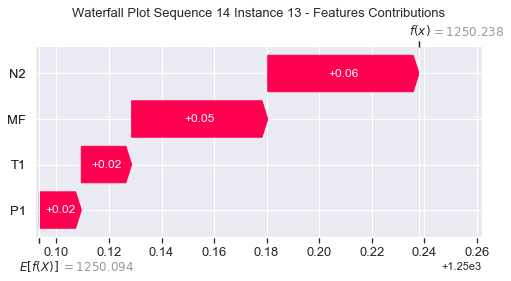

None

Contribution: [0.01608058 0.01902605 0.05749892 0.05164227]


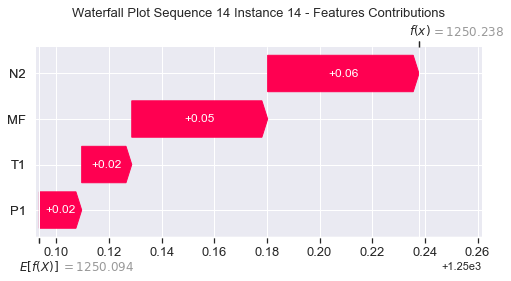

None

Contribution: [0.01643618 0.01911863 0.05886    0.05307233]


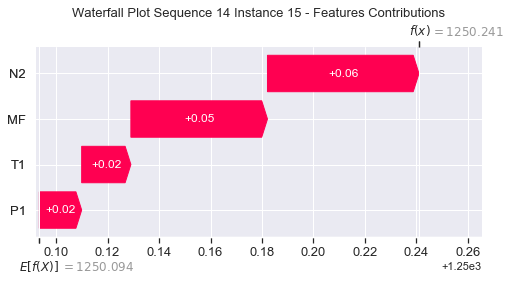

None

Contribution: [0.01750446 0.01871238 0.06252595 0.05689331]


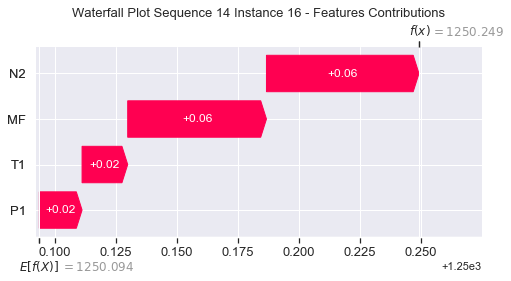

None

Contribution: [0.02050874 0.02234612 0.0722413  0.06556792]


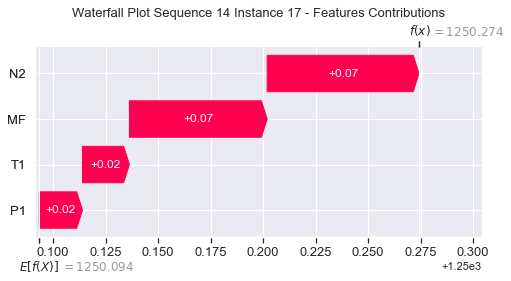

None

Contribution: [0.02780743 0.02884254 0.09665812 0.08811014]


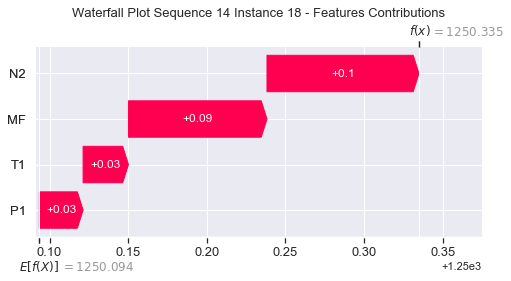

None

Contribution: [0.04637962 0.0442334  0.15809105 0.14526758]


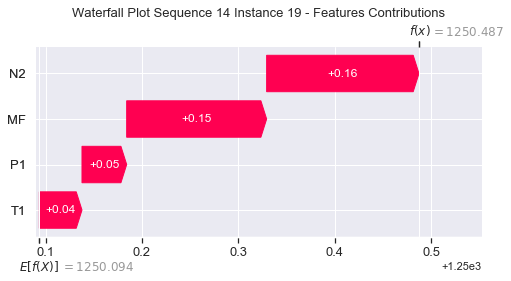

None

Contribution: [0.08999309 0.08752263 0.30449787 0.28064566]


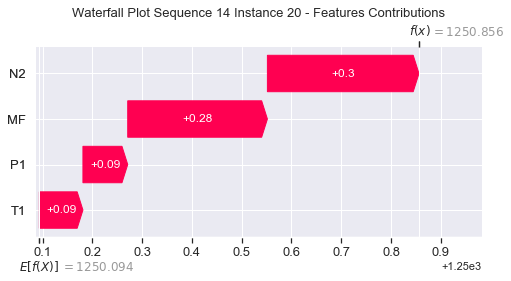

None

Contribution: [0.18828445 0.18079999 0.63367789 0.58585927]


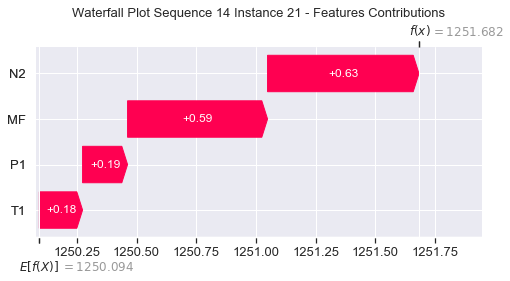

None

Contribution: [0.38334271 0.35853283 1.28884772 1.19800334]


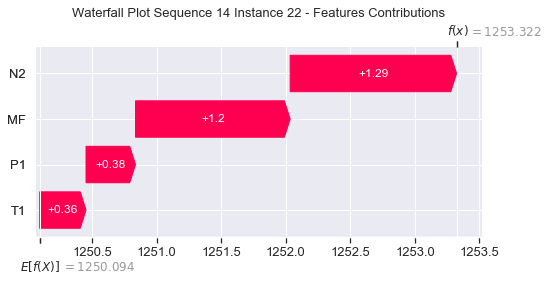

None

Contribution: [0.66796688 0.51545103 2.30335986 2.18909835]


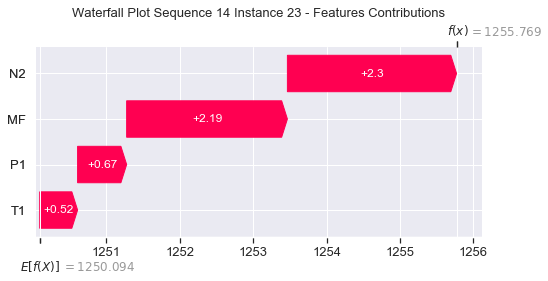

None

Contribution: [ 0.89111622 -0.24663862  3.1865191   3.25956473]


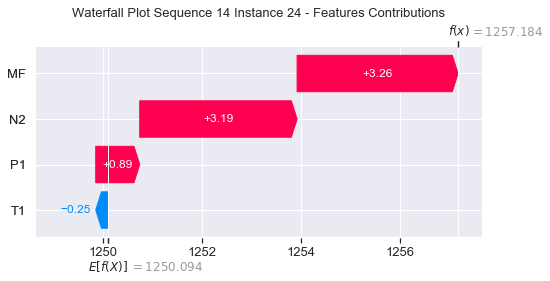

None

Contribution: [ 0.20238571 -0.02757899  0.73068241  0.63597669]


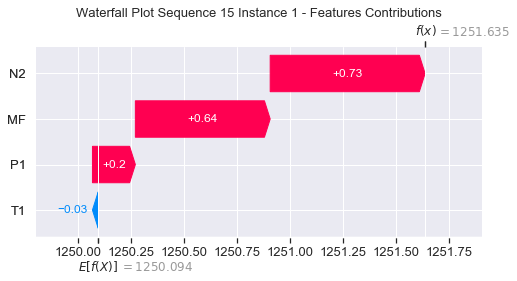

None

Contribution: [0.00349681 0.00319753 0.01099289 0.01101732]


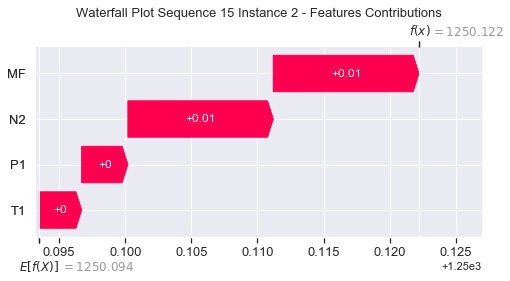

None

Contribution: [0.02464819 0.02924446 0.09402259 0.08526313]


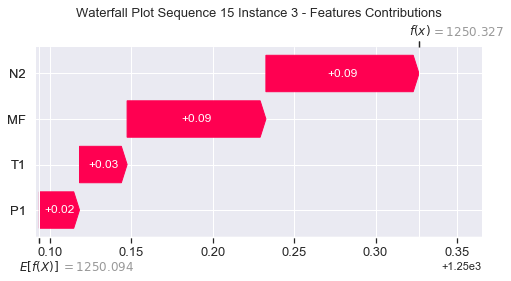

None

Contribution: [0.01741051 0.02079766 0.06506585 0.05825632]


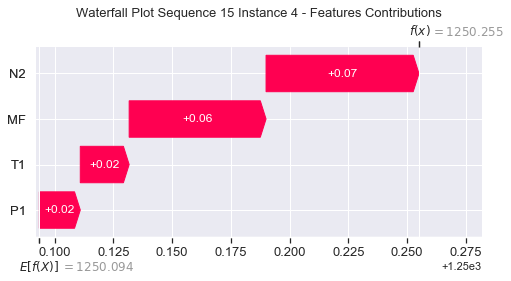

None

Contribution: [0.02074766 0.02501328 0.07538358 0.06775799]


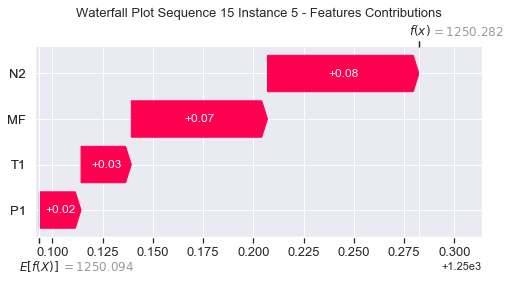

None

Contribution: [0.02186754 0.02532804 0.0788346  0.07116933]


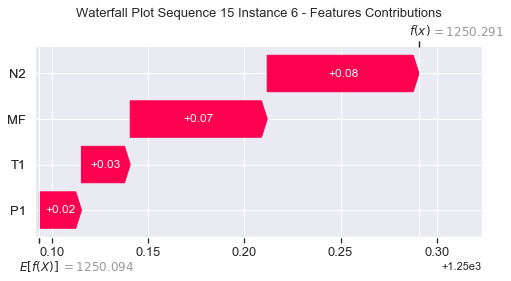

None

Contribution: [0.02111355 0.02466085 0.07605516 0.0687193 ]


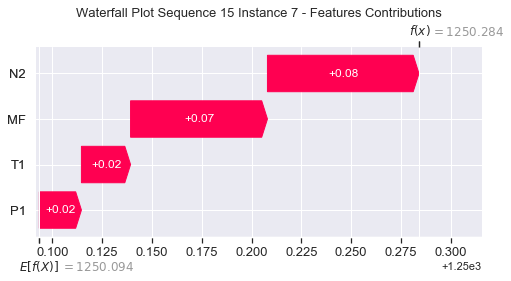

None

Contribution: [0.01965912 0.02303384 0.07096175 0.06398443]


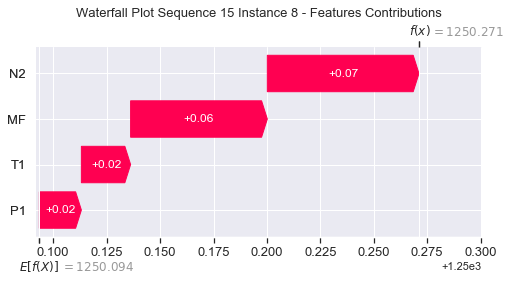

None

Contribution: [0.01837255 0.02223656 0.06651645 0.05990741]


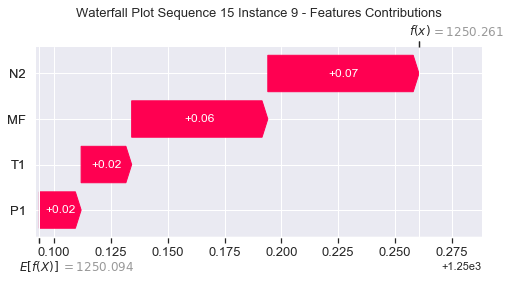

None

Contribution: [0.01759916 0.02076459 0.06286802 0.05708352]


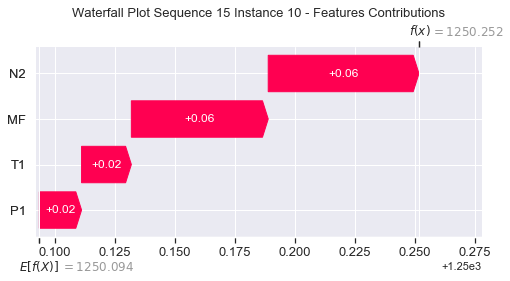

None

Contribution: [0.01647053 0.01950784 0.05998542 0.05352738]


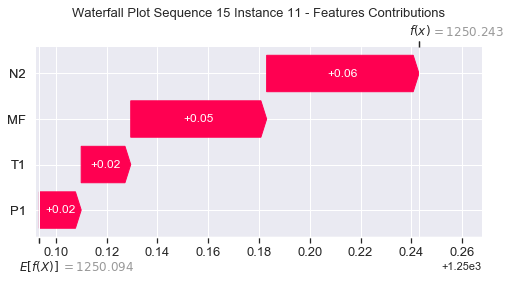

None

Contribution: [0.01612355 0.01908871 0.05843611 0.05233086]


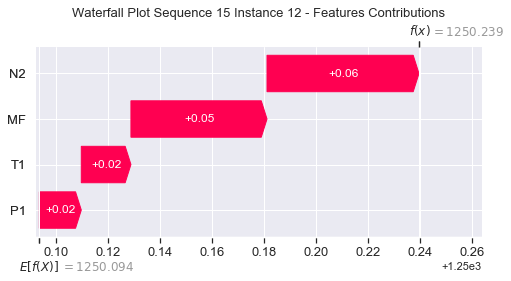

None

Contribution: [0.01605998 0.01894309 0.05802575 0.05209497]


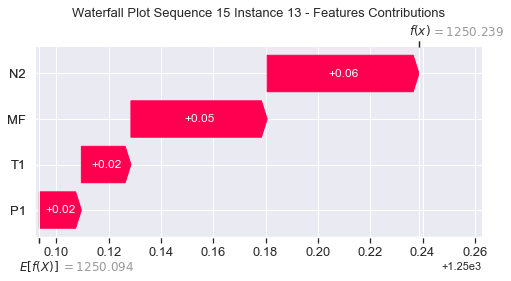

None

Contribution: [0.01643438 0.01808102 0.05825624 0.05311546]


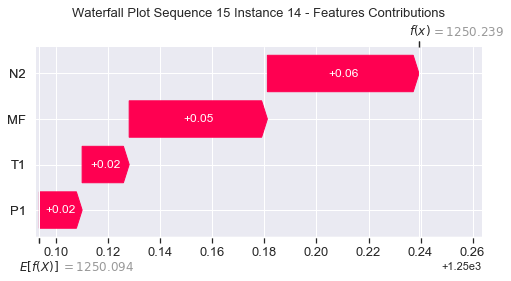

None

Contribution: [0.01653508 0.0189869  0.05937056 0.05353123]


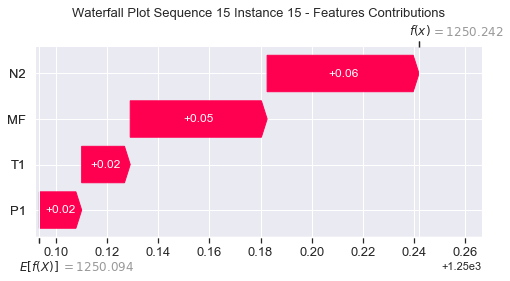

None

Contribution: [0.0178082  0.02009864 0.06314532 0.05759272]


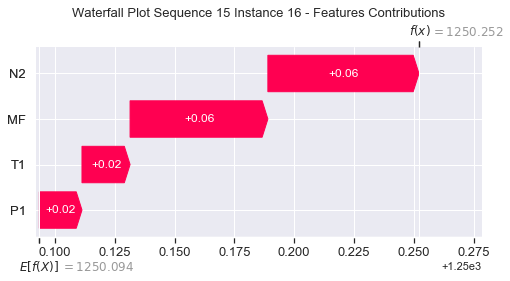

None

Contribution: [0.02061938 0.02246511 0.07269411 0.06600316]


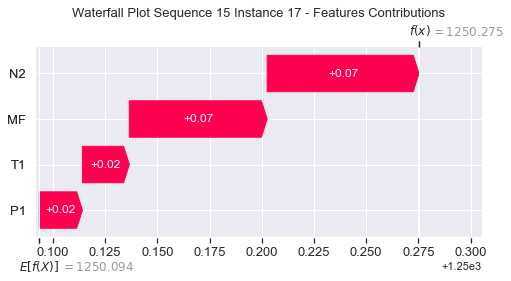

None

Contribution: [0.02792723 0.02899446 0.09704603 0.08852325]


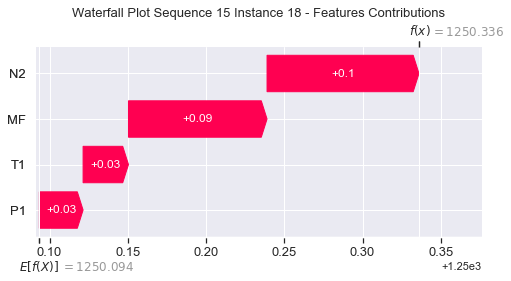

None

Contribution: [0.04645643 0.04657858 0.15802646 0.14456499]


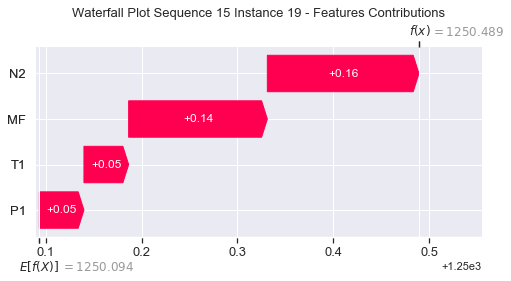

None

Contribution: [0.0898728  0.08819425 0.30464673 0.28069024]


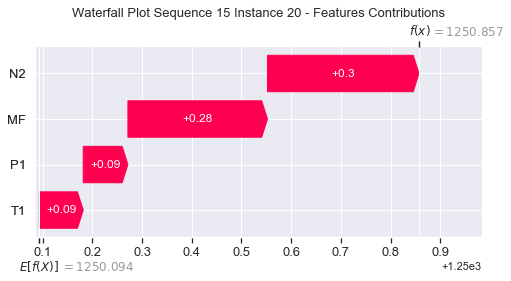

None

Contribution: [0.18763954 0.1829778  0.63354567 0.5847349 ]


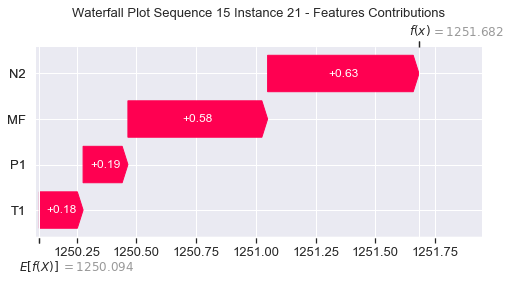

None

Contribution: [0.38072053 0.36466175 1.28785493 1.19247326]


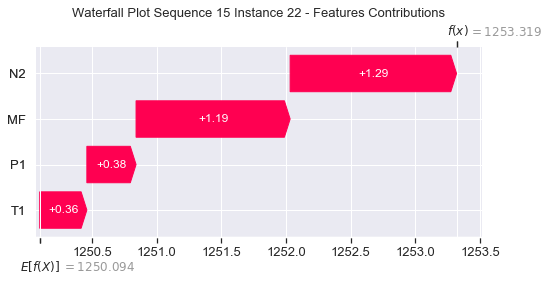

None

Contribution: [0.66361298 0.53942337 2.30099626 2.17632982]


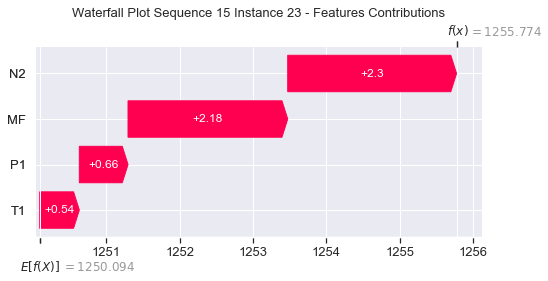

None

Contribution: [ 0.90102791 -0.18338515  3.20700527  3.36509689]


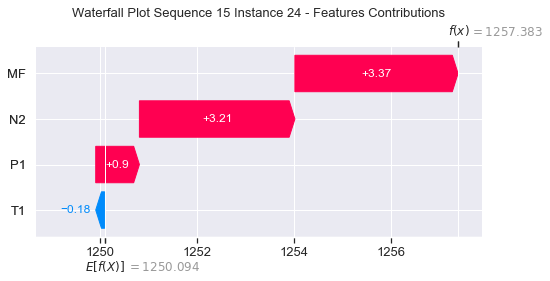

None

Contribution: [ 0.21861146 -0.01285795  0.74706759  0.72987483]


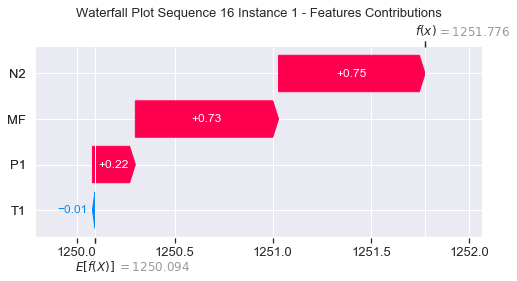

None

Contribution: [0.00337174 0.00357208 0.01088941 0.01052362]


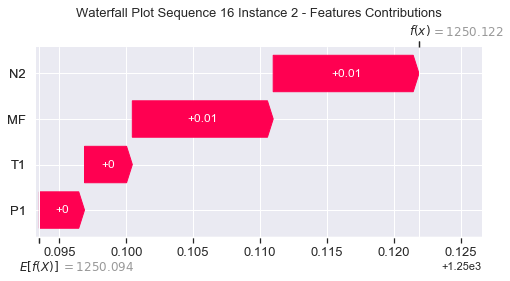

None

Contribution: [0.02445999 0.03106768 0.09518302 0.0869569 ]


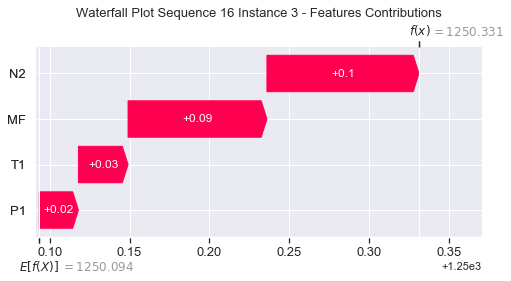

None

Contribution: [0.01820902 0.02306713 0.06656687 0.05937416]


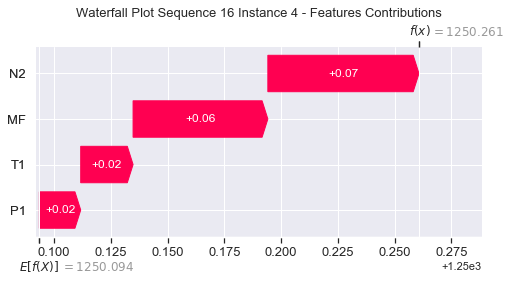

None

Contribution: [0.02114872 0.02478761 0.07619605 0.06890693]


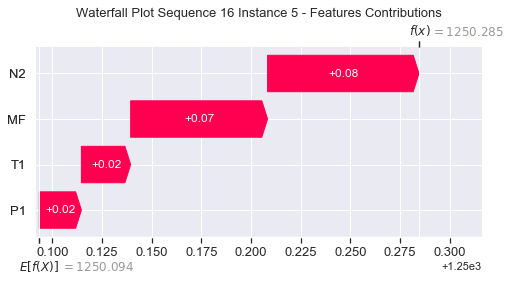

None

Contribution: [0.02209644 0.02511331 0.07933626 0.07179734]


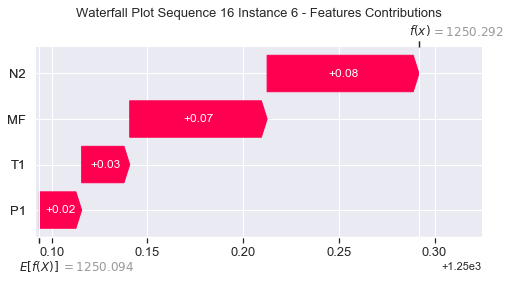

None

Contribution: [0.02125376 0.0243796  0.07641581 0.06913744]


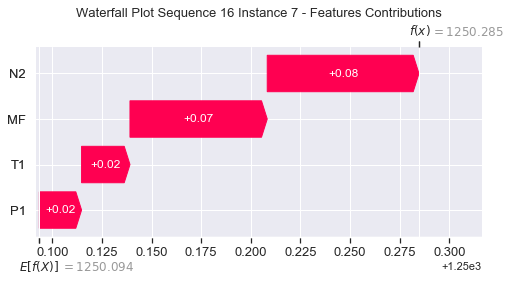

None

Contribution: [0.01980934 0.02248694 0.07124766 0.06443825]


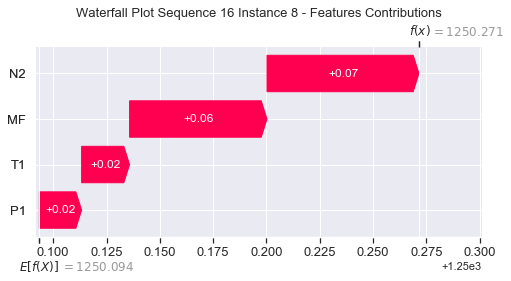

None

Contribution: [0.01855336 0.02056493 0.06673473 0.06047255]


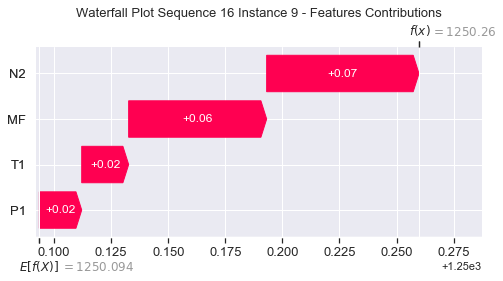

None

Contribution: [0.0175526  0.02039386 0.06310227 0.05716249]


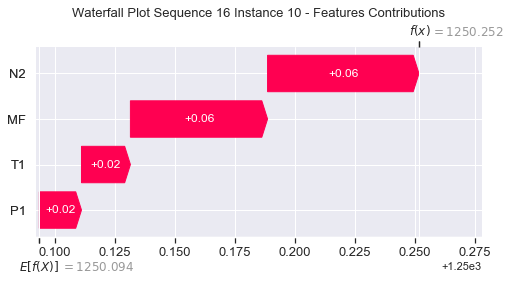

None

Contribution: [0.0168134  0.01769644 0.06041512 0.05473246]


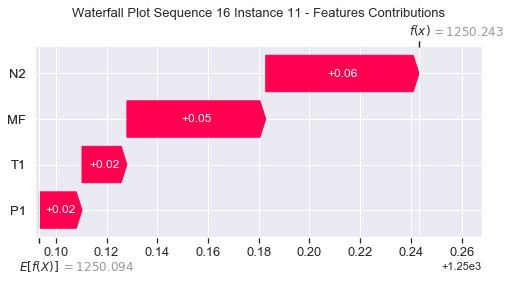

None

Contribution: [0.01624459 0.01825645 0.05888224 0.05321131]


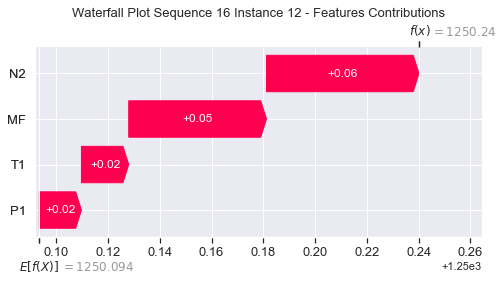

None

Contribution: [0.01613601 0.01818162 0.0583821  0.0527543 ]


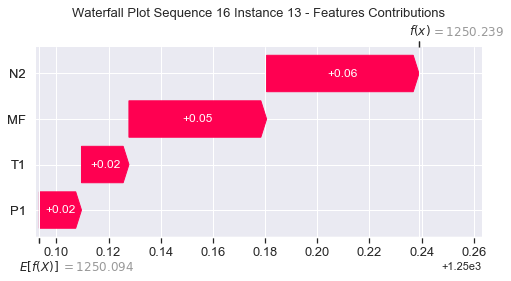

None

Contribution: [0.01609415 0.01791374 0.05825399 0.05245542]


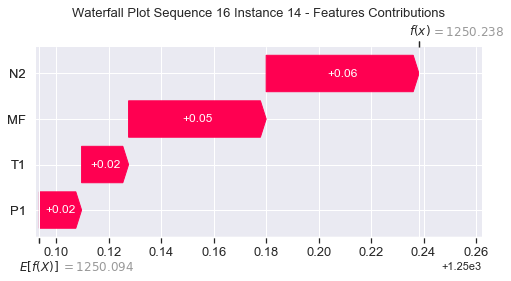

None

Contribution: [0.0165912  0.01816204 0.05954957 0.05377615]


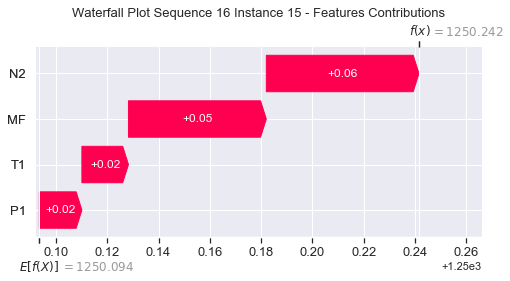

None

Contribution: [0.01746657 0.01812157 0.06291647 0.05613696]


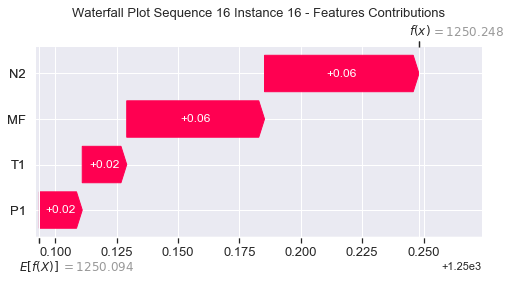

None

Contribution: [0.02066901 0.02163788 0.07305252 0.06624929]


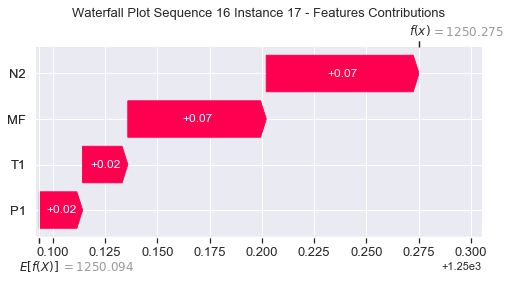

None

Contribution: [0.0280509  0.02803163 0.09769057 0.08894862]


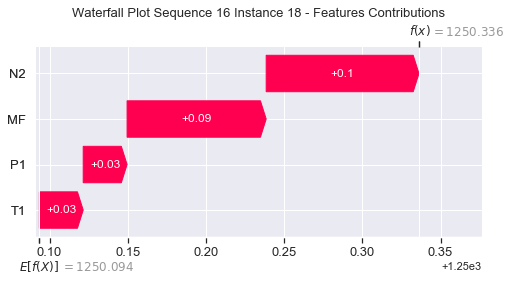

None

Contribution: [0.04683437 0.04386178 0.15933619 0.14749148]


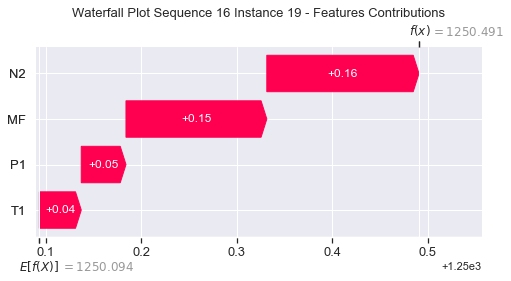

None

Contribution: [0.09057166 0.08564537 0.30729437 0.28204014]


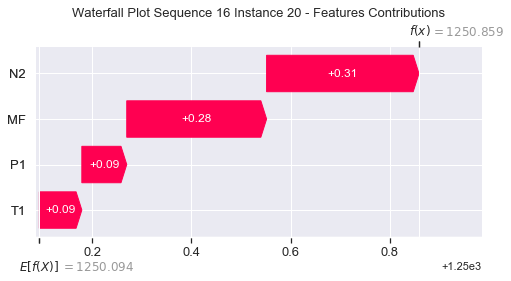

None

Contribution: [0.18907535 0.17636306 0.63861247 0.58771023]


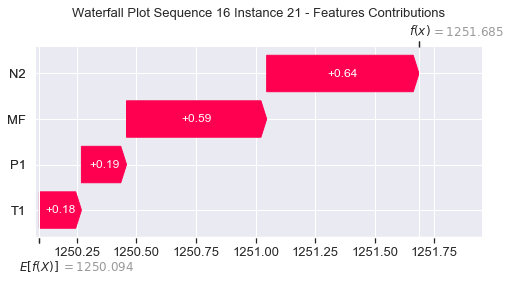

None

Contribution: [0.3839674  0.34461938 1.29573661 1.19762861]


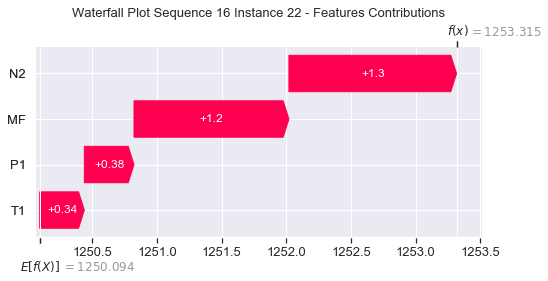

None

Contribution: [0.66627134 0.47048435 2.30699591 2.17417176]


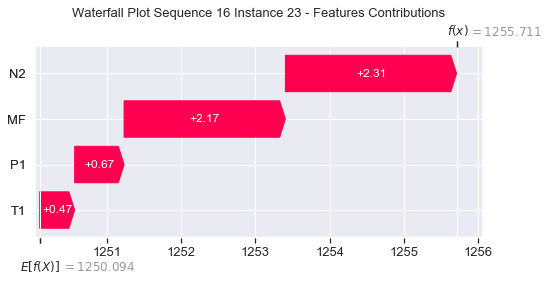

None

Contribution: [ 0.90376086 -0.42089903  3.18297894  3.26201926]


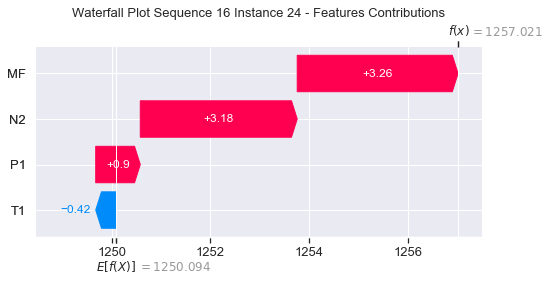

None

Contribution: [ 0.2167254  -0.02473837  0.7505516   0.71203363]


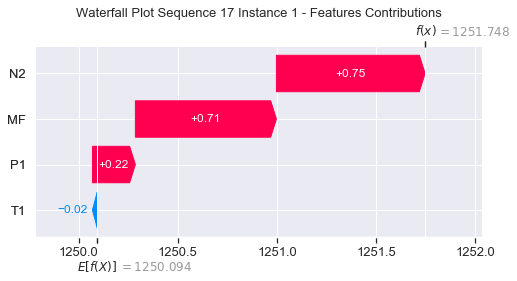

None

Contribution: [0.00343596 0.00307441 0.01103028 0.01073459]


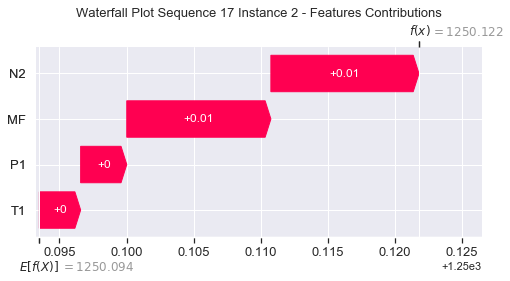

None

Contribution: [0.02569712 0.02846233 0.09659774 0.08769651]


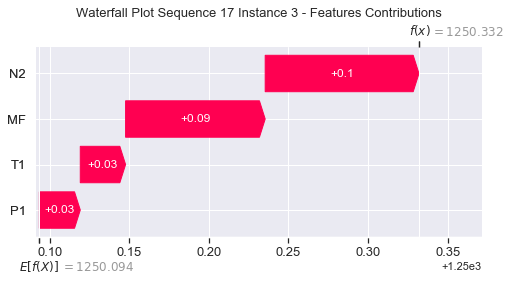

None

Contribution: [0.01879904 0.02133916 0.0676389  0.06176263]


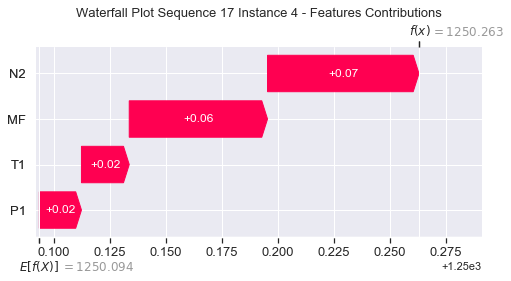

None

Contribution: [0.02123901 0.02308843 0.07652223 0.06877118]


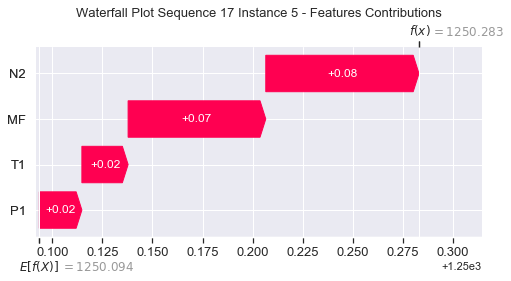

None

Contribution: [0.02205214 0.0236877  0.07971592 0.07138218]


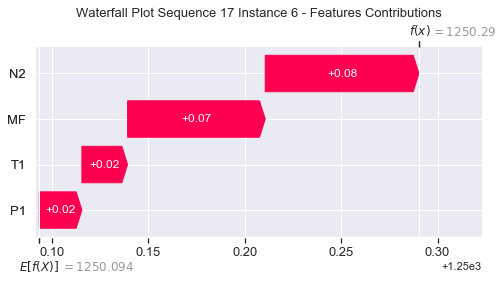

None

Contribution: [0.02130388 0.02281621 0.07691474 0.06886854]


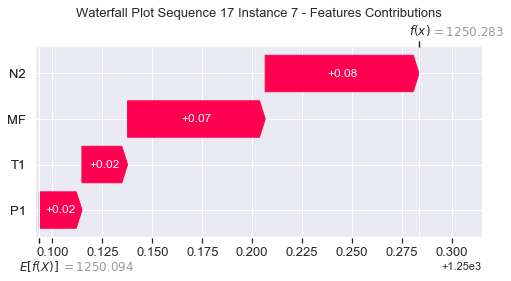

None

Contribution: [0.01989006 0.02137216 0.07183914 0.06428916]


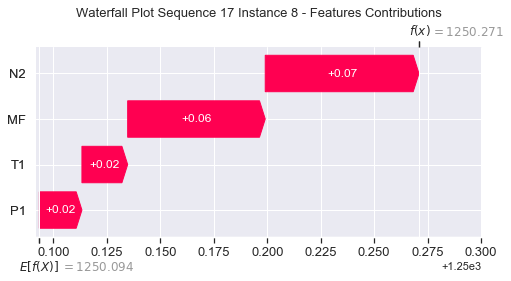

None

Contribution: [0.0187489  0.01996997 0.06727078 0.06036999]


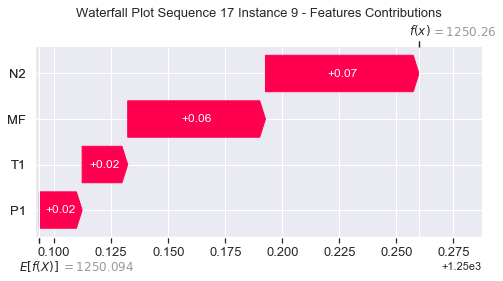

None

Contribution: [0.01763116 0.01954266 0.06392357 0.05731407]


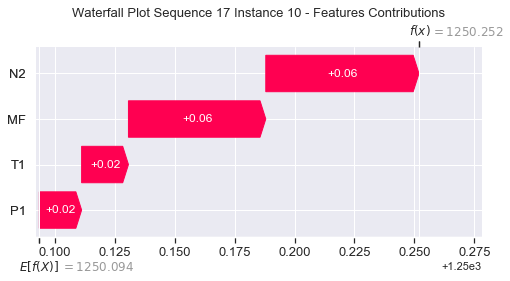

None

Contribution: [0.01687589 0.0180911  0.06092278 0.05441278]


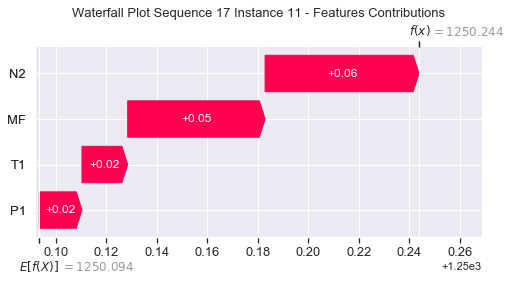

None

Contribution: [0.01640525 0.01742883 0.05933709 0.05293508]


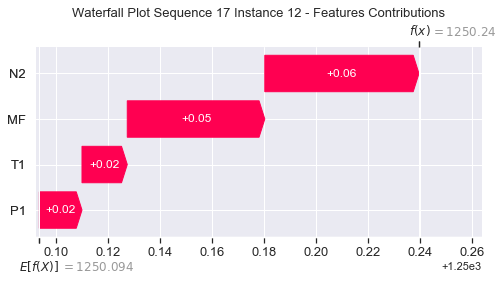

None

Contribution: [0.01629698 0.01722512 0.0587982  0.05250475]


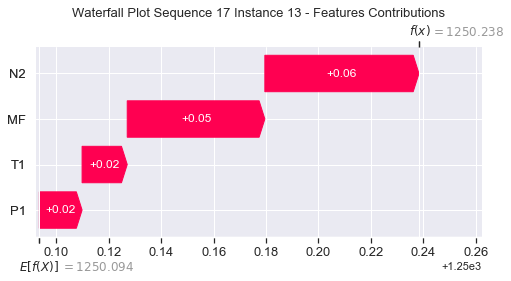

None

Contribution: [0.01601041 0.01652892 0.05865149 0.05222331]


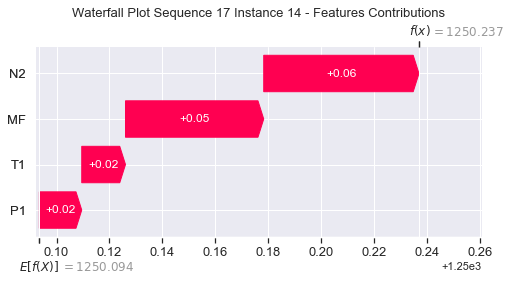

None

Contribution: [0.01680372 0.01747901 0.06022972 0.05382013]


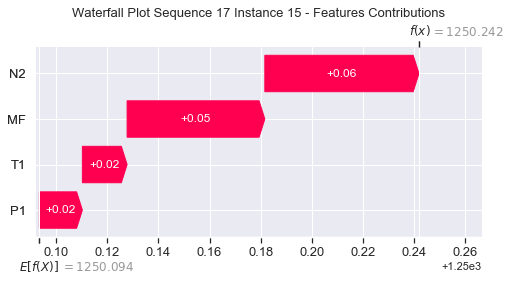

None

Contribution: [0.01835067 0.0187578  0.0642075  0.05778165]


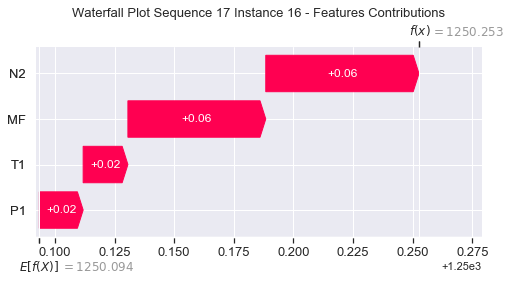

None

Contribution: [0.02089907 0.020705   0.07380778 0.06625417]


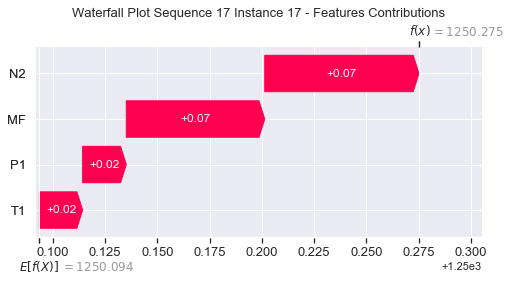

None

Contribution: [0.0283304  0.02705303 0.09874379 0.08900855]


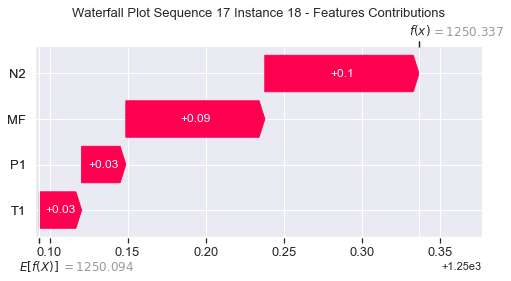

None

Contribution: [0.04732411 0.04492152 0.16119874 0.1460883 ]


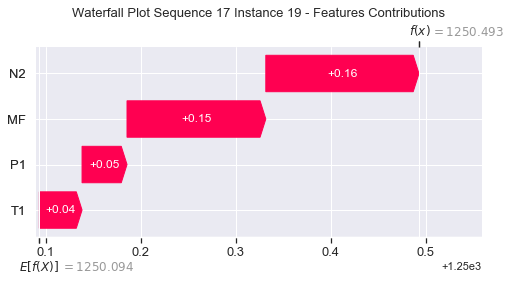

None

Contribution: [0.09151359 0.08269966 0.31051001 0.28277135]


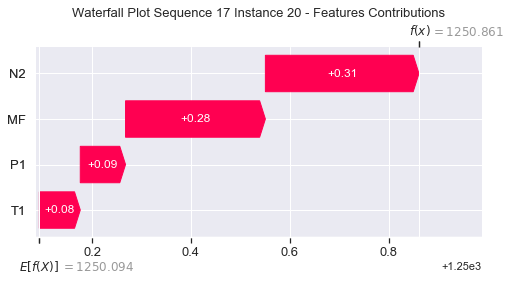

None

Contribution: [0.19090521 0.17015335 0.64415455 0.58831516]


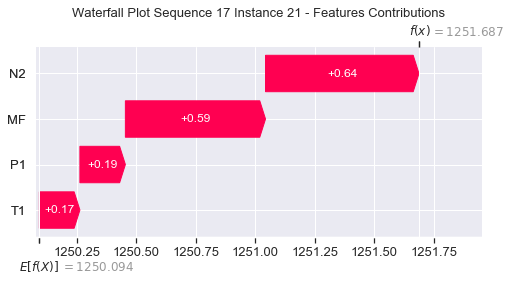

None

Contribution: [0.38724296 0.33260719 1.3048048  1.19581521]


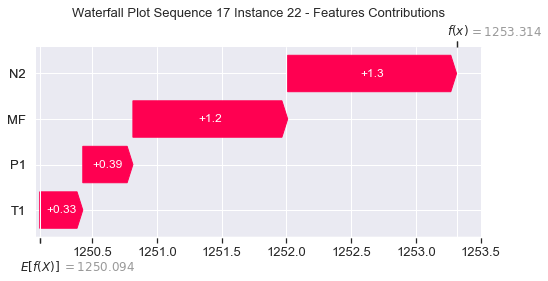

None

Contribution: [0.67001309 0.43857082 2.3221555  2.15063666]


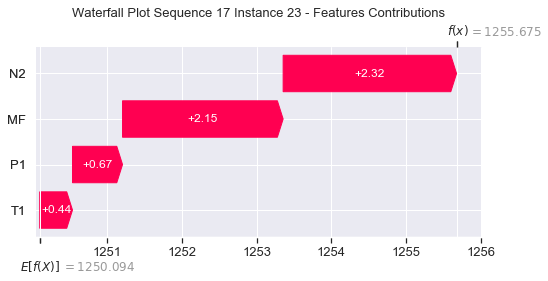

None

Contribution: [ 0.93212194 -0.62191648  3.2233864   3.19554382]


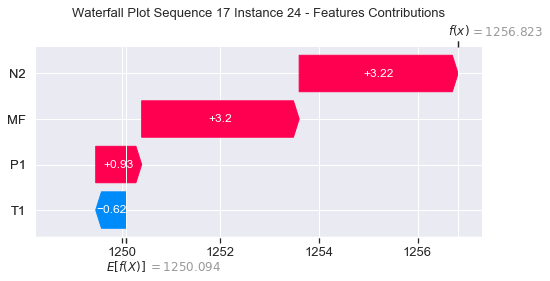

None

Contribution: [ 0.23696649 -0.09741704  0.74840253  0.71725232]


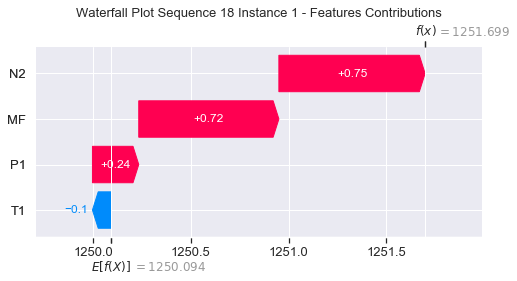

None

Contribution: [0.00346066 0.00279832 0.01089732 0.01037699]


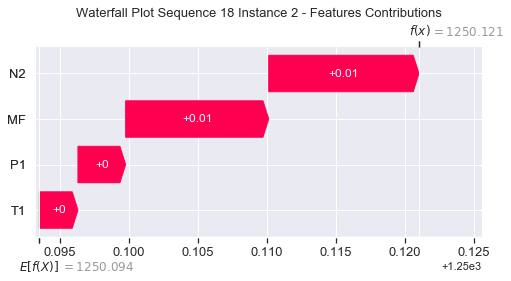

None

Contribution: [0.02528588 0.02750508 0.0948008  0.08608695]


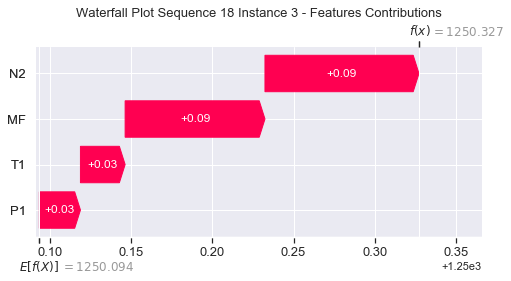

None

Contribution: [0.01767153 0.01953958 0.06527966 0.05848747]


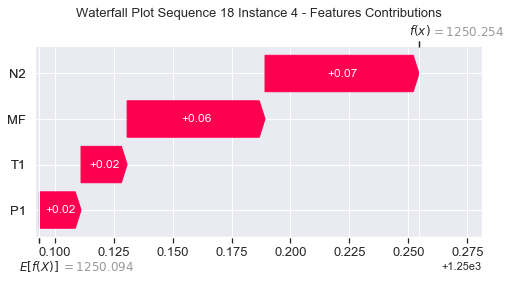

None

Contribution: [0.02099622 0.02316544 0.07561939 0.06827925]


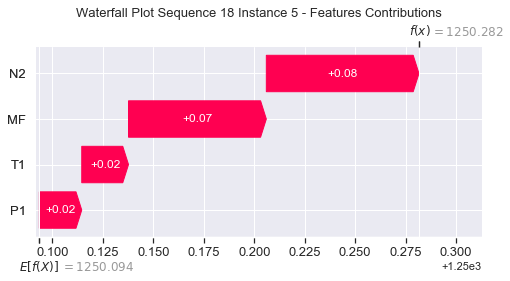

None

Contribution: [0.02228161 0.02437939 0.07940935 0.07219843]


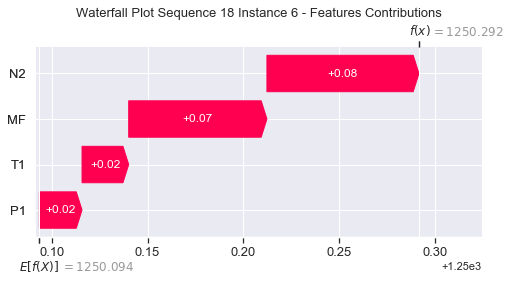

None

Contribution: [0.02162239 0.02365292 0.07664641 0.06974317]


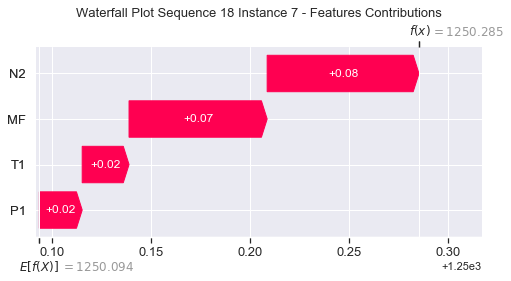

None

Contribution: [0.02007571 0.02208633 0.07145446 0.0648427 ]


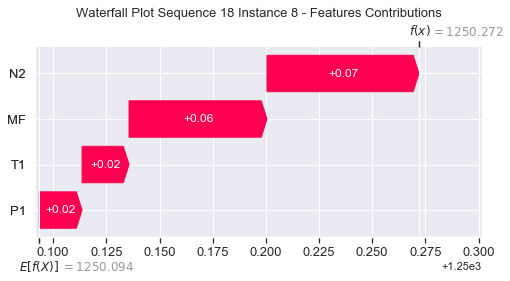

None

Contribution: [0.01879908 0.02131196 0.06687043 0.06043059]


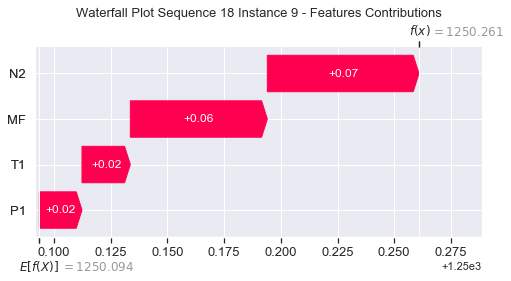

None

Contribution: [0.0180464  0.01970878 0.06310403 0.05704145]


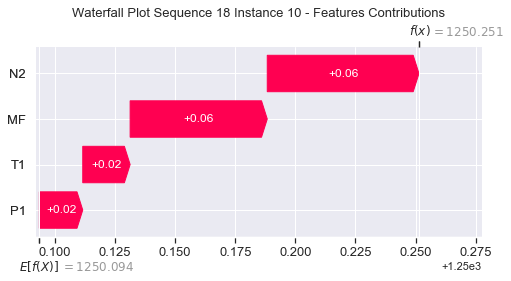

None

Contribution: [0.0170174  0.01914066 0.06072715 0.05503056]


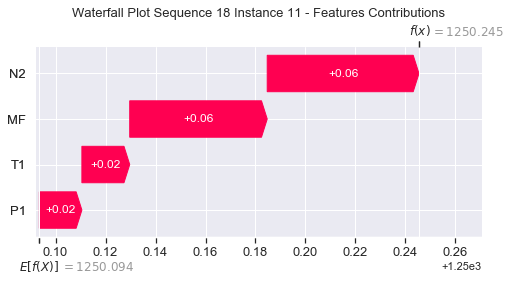

None

Contribution: [0.01698875 0.01856446 0.05933046 0.05423543]


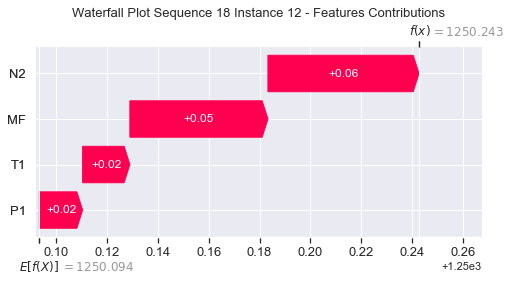

None

Contribution: [0.01680764 0.01828724 0.05872977 0.053558  ]


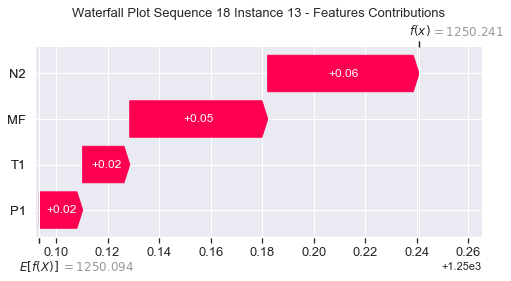

None

Contribution: [0.01640311 0.0187509  0.05846741 0.05263522]


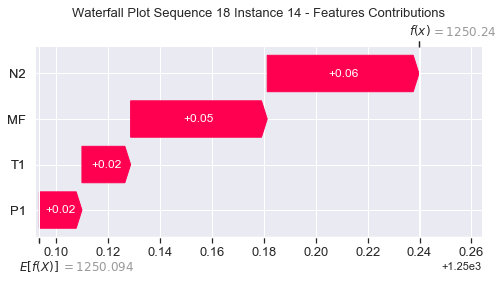

None

Contribution: [0.01709667 0.01834646 0.05983559 0.05440254]


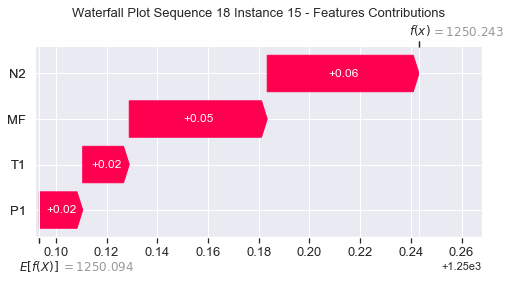

None

Contribution: [0.01785279 0.01965126 0.06318878 0.05679383]


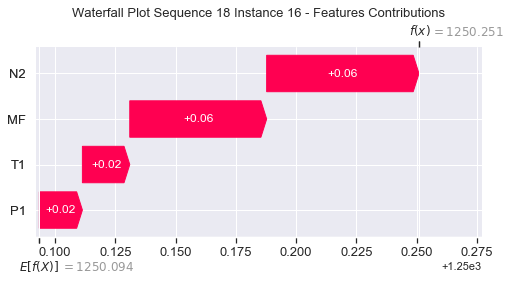

None

Contribution: [0.02123472 0.02170883 0.07321446 0.06671021]


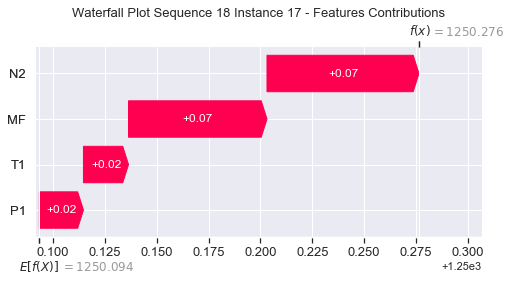

None

Contribution: [0.0286377  0.02812709 0.09775265 0.08928147]


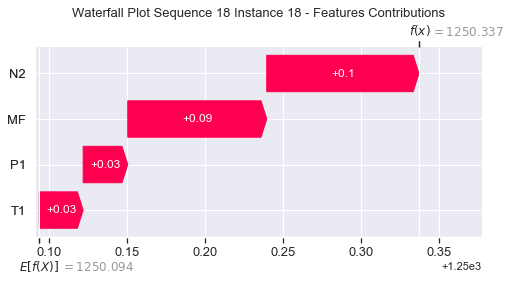

None

Contribution: [0.04733919 0.04454042 0.15938799 0.14647148]


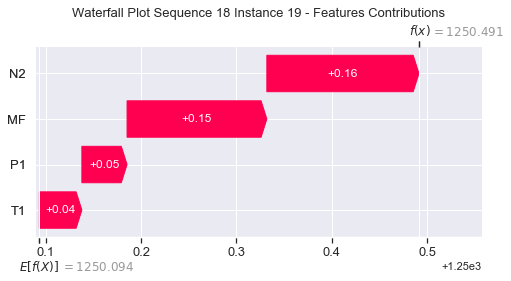

None

Contribution: [0.09160816 0.0846062  0.30736231 0.28150913]


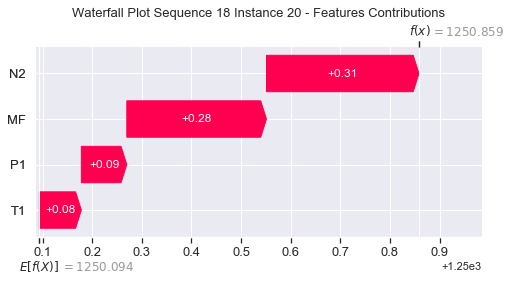

None

Contribution: [0.19152423 0.1748256  0.63892246 0.58668887]


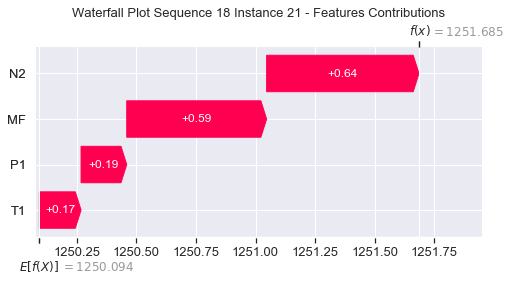

None

Contribution: [0.38869855 0.34247887 1.29706647 1.19425137]


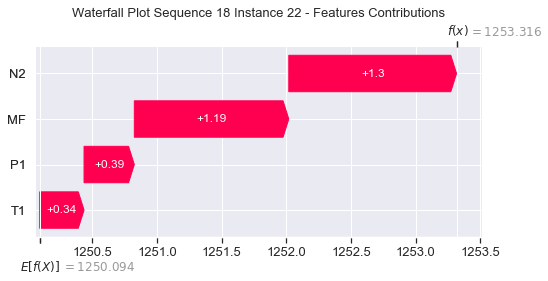

None

Contribution: [0.68345169 0.47770253 2.3143045  2.16987346]


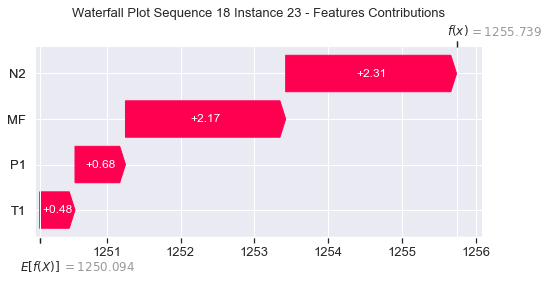

None

Contribution: [ 0.95798406 -0.49431362  3.21242925  3.1833253 ]


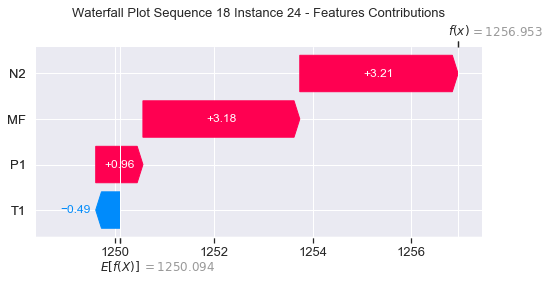

None

Contribution: [ 0.24598509 -0.05648733  0.74969582  0.69652658]


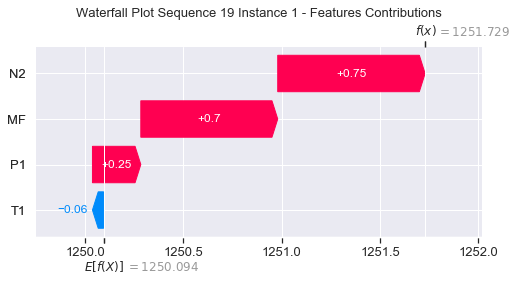

None

Contribution: [0.00358876 0.00306984 0.01092195 0.01053155]


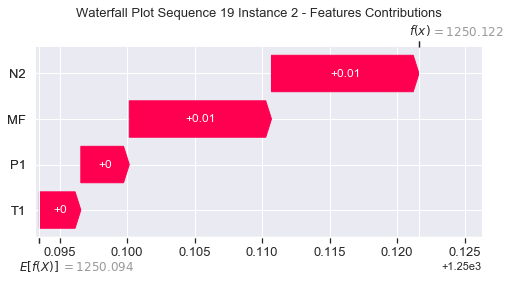

None

Contribution: [0.02471318 0.02837839 0.09521869 0.08567125]


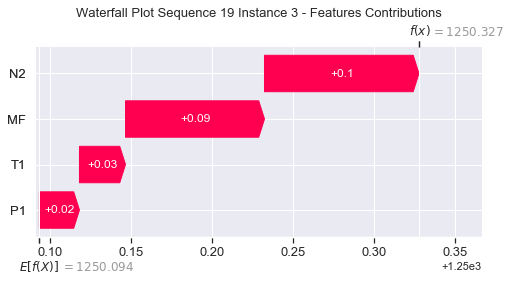

None

Contribution: [0.01831069 0.02067973 0.06648664 0.05980693]


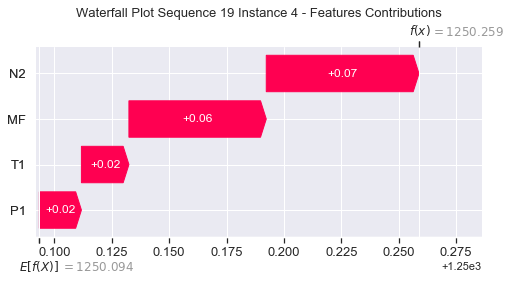

None

Contribution: [0.02136736 0.02361617 0.07638178 0.06904976]


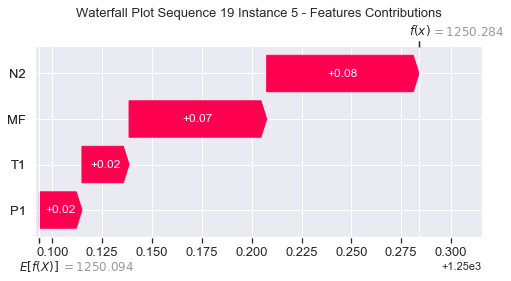

None

Contribution: [0.0221922  0.02413427 0.07943859 0.0713056 ]


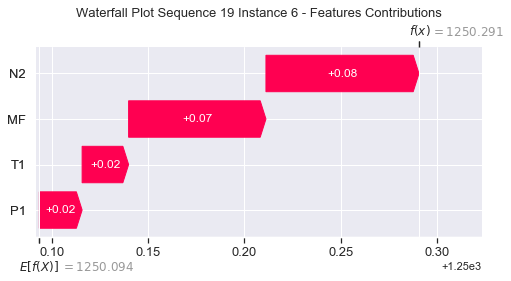

None

Contribution: [0.02153114 0.02350503 0.07670145 0.06889986]


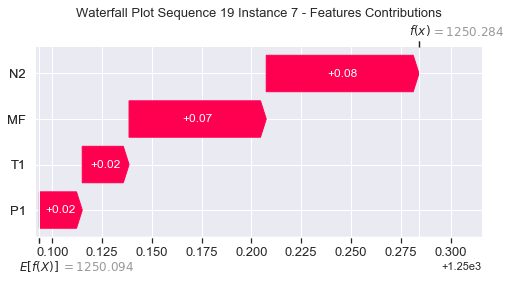

None

Contribution: [0.02007453 0.02188559 0.07164826 0.06438934]


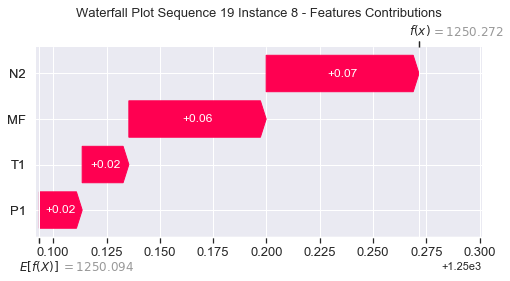

None

Contribution: [0.01894152 0.02098514 0.0673632  0.06076603]


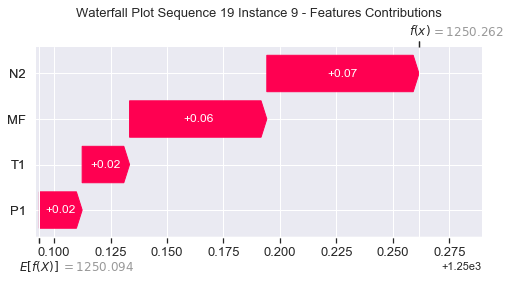

None

Contribution: [0.01795798 0.01974251 0.06342364 0.05698825]


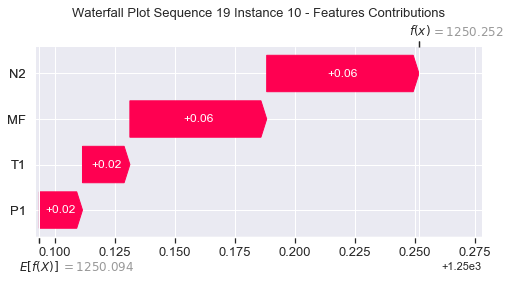

None

Contribution: [0.01683879 0.01812839 0.06065553 0.05434536]


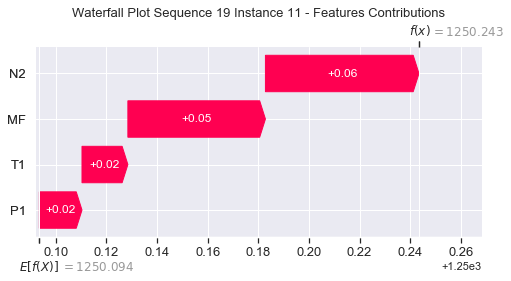

None

Contribution: [0.01655143 0.01776648 0.05898143 0.05280207]


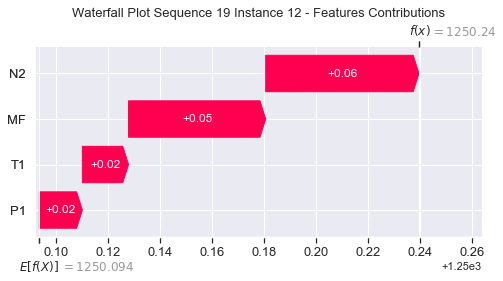

None

Contribution: [0.01652726 0.01771947 0.05861735 0.05260492]


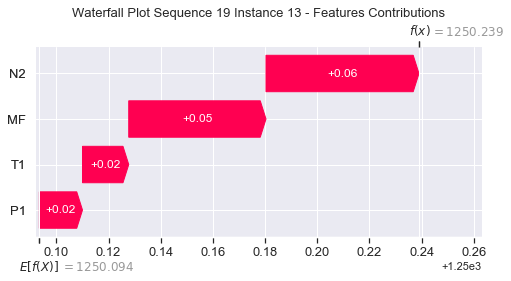

None

Contribution: [0.01674795 0.01792127 0.0589705  0.05360619]


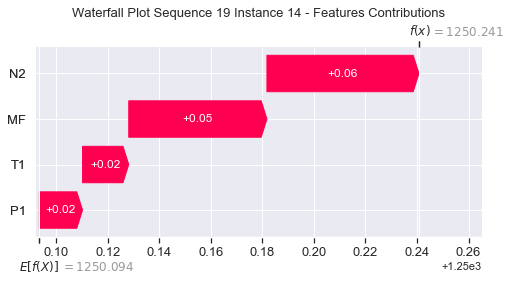

None

Contribution: [0.0170046  0.01784636 0.0598638  0.053815  ]


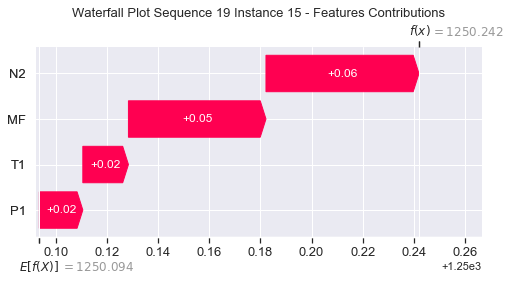

None

Contribution: [0.01809449 0.01926503 0.06360419 0.05746103]


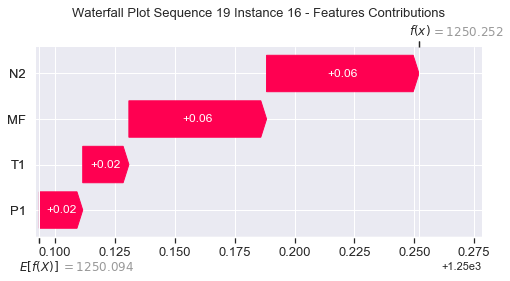

None

Contribution: [0.02120038 0.02129606 0.07331253 0.06627794]


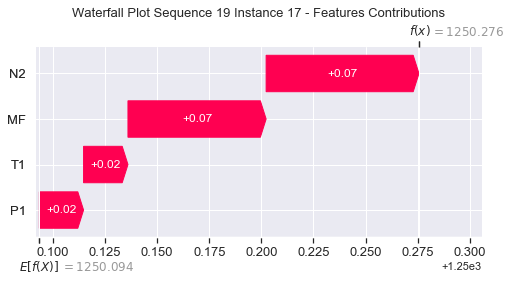

None

Contribution: [0.02866935 0.02762489 0.09793896 0.08892158]


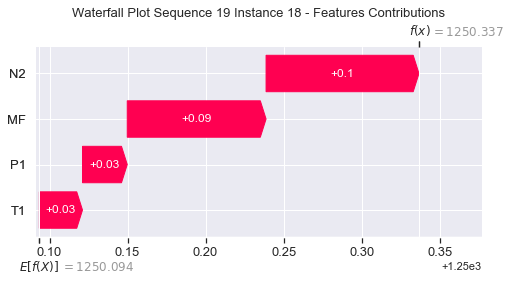

None

Contribution: [0.04691677 0.04415013 0.15959183 0.14479538]


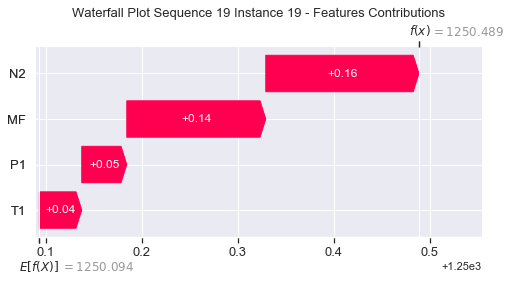

None

Contribution: [0.09246461 0.08439683 0.30742438 0.28251877]


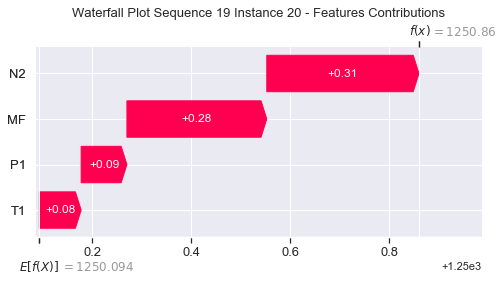

None

Contribution: [0.19320537 0.17367242 0.63847786 0.5888645 ]


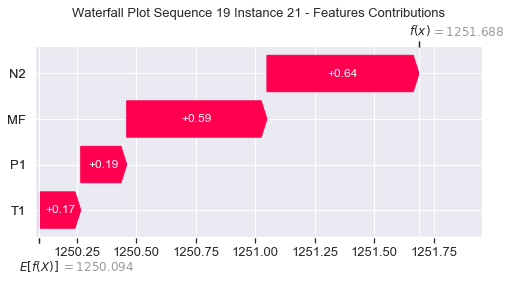

None

Contribution: [0.39351675 0.3388009  1.29556597 1.2015402 ]


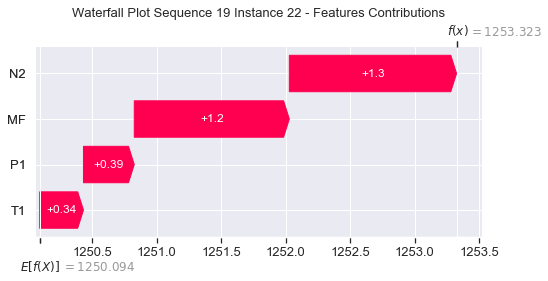

None

Contribution: [0.69331378 0.45575783 2.30491039 2.17738964]


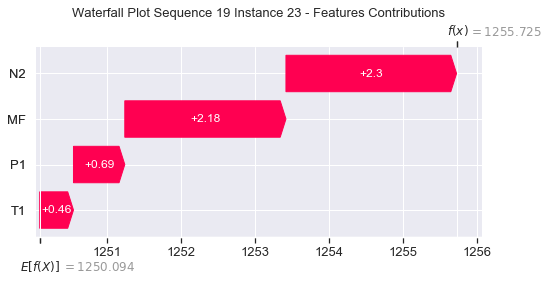

None

Contribution: [ 0.9614299  -0.59695973  3.14012141  3.1691423 ]


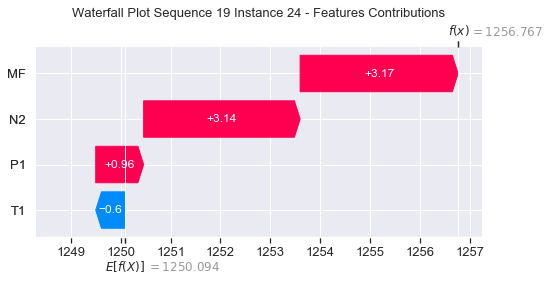

None

Contribution: [ 0.19827481 -0.10724586  0.72274156  0.61938676]


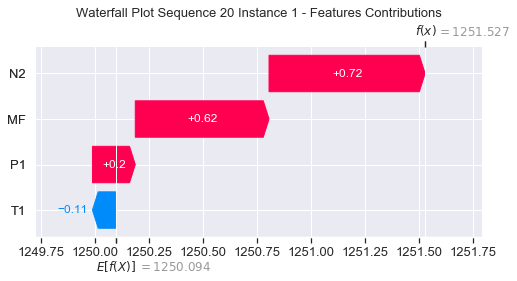

None

Contribution: [0.00374846 0.00292706 0.01113695 0.0110785 ]


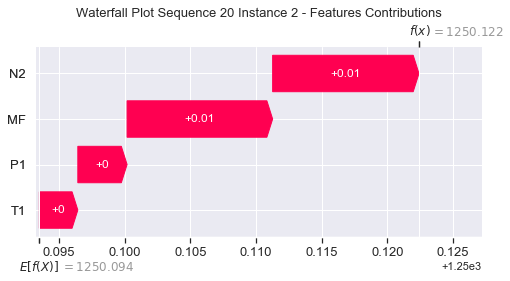

None

Contribution: [0.02545597 0.02792765 0.09462293 0.08559833]


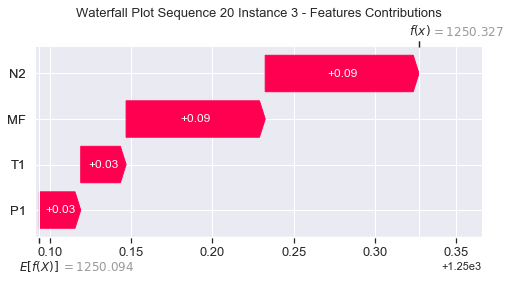

None

Contribution: [0.01777953 0.02096084 0.06519935 0.05760961]


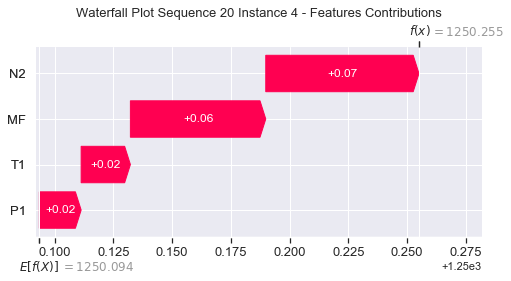

None

Contribution: [0.02155639 0.02451181 0.07607958 0.0687196 ]


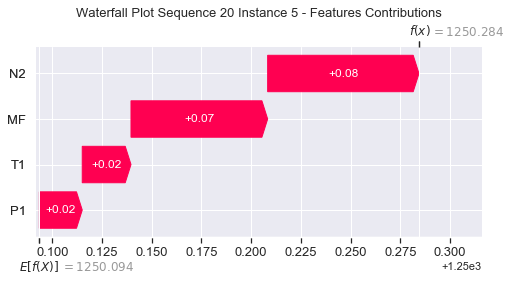

None

Contribution: [0.02220785 0.02476117 0.07923404 0.07093186]


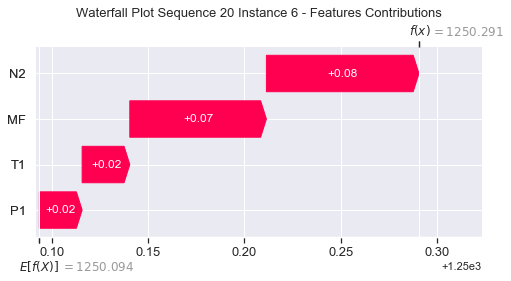

None

Contribution: [0.02153942 0.02404324 0.07660534 0.06871197]


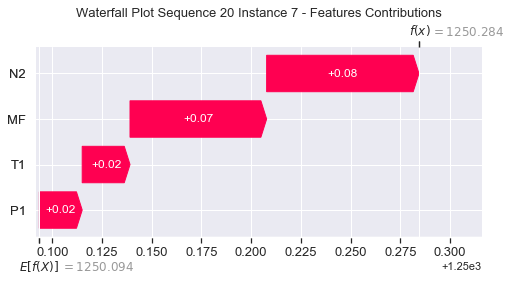

None

Contribution: [0.02005682 0.02234954 0.07142919 0.06407681]


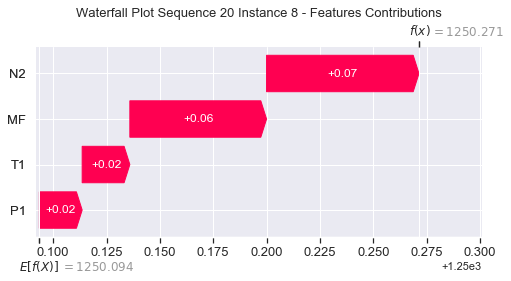

None

Contribution: [0.01864251 0.02080316 0.06689638 0.06016194]


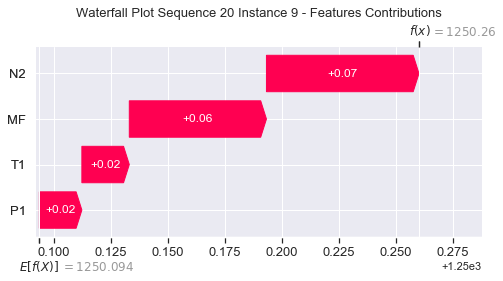

None

Contribution: [0.01805341 0.01829035 0.06283814 0.0569329 ]


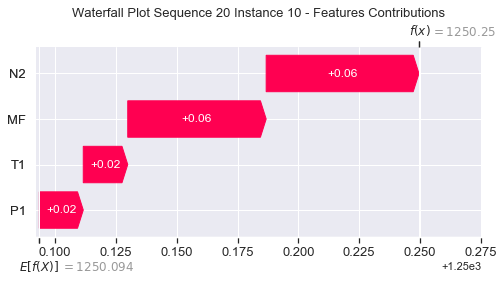

None

Contribution: [0.01663909 0.01838148 0.06022838 0.05381217]


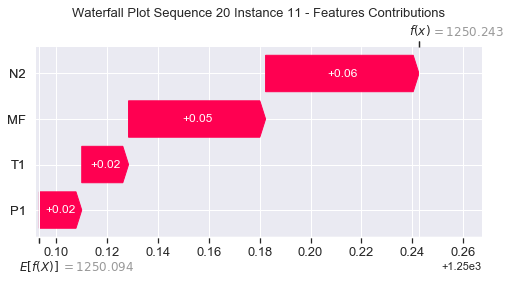

None

Contribution: [0.01668333 0.01874302 0.05905454 0.05323941]


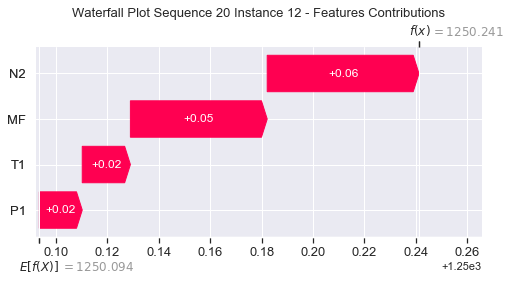

None

Contribution: [0.0166342  0.01853626 0.05864286 0.0529682 ]


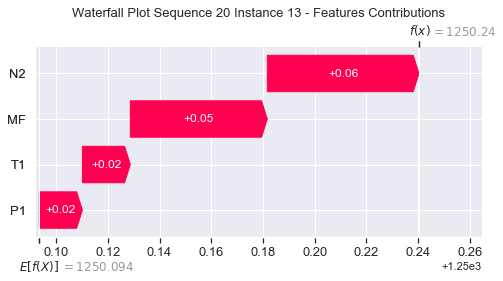

None

Contribution: [0.01660373 0.01870934 0.05864324 0.05301994]


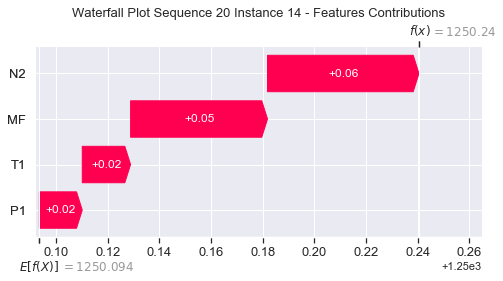

None

Contribution: [0.01700865 0.01851506 0.05978837 0.05400602]


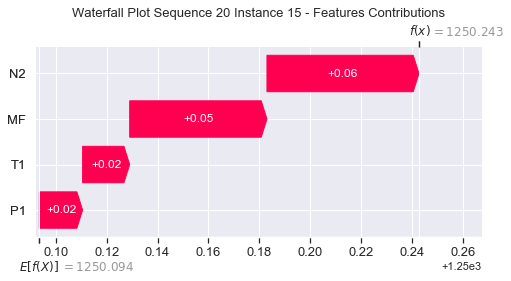

None

Contribution: [0.01809647 0.01880597 0.06348191 0.05760727]


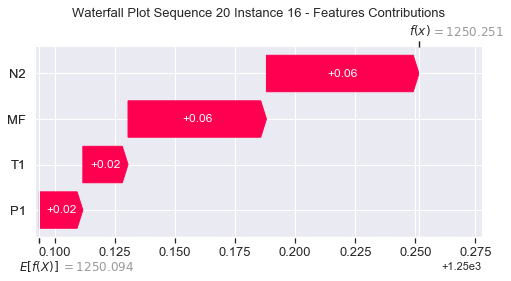

None

Contribution: [0.02114203 0.02177161 0.07315274 0.06641927]


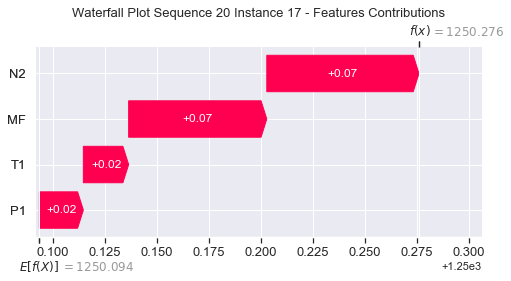

None

Contribution: [0.02853816 0.02808827 0.09757042 0.08889292]


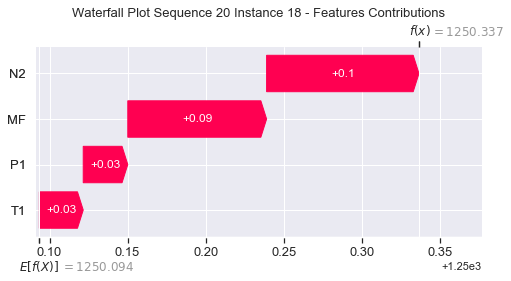

None

Contribution: [0.04737754 0.04476302 0.15897692 0.14533065]


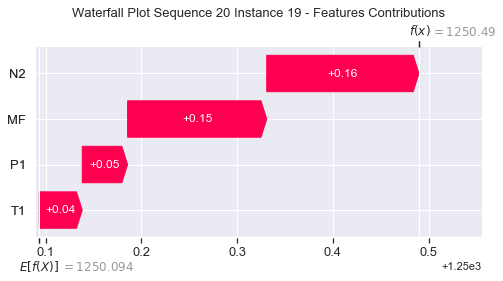

None

Contribution: [0.09195492 0.08469204 0.30596142 0.28184691]


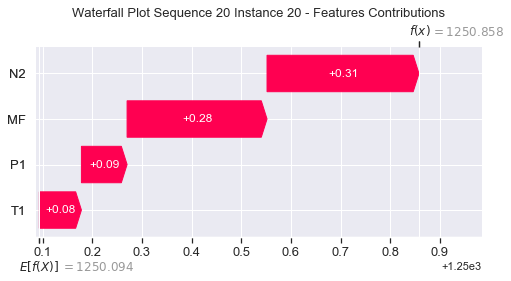

None

Contribution: [0.19240959 0.17555739 0.6354222  0.58812736]


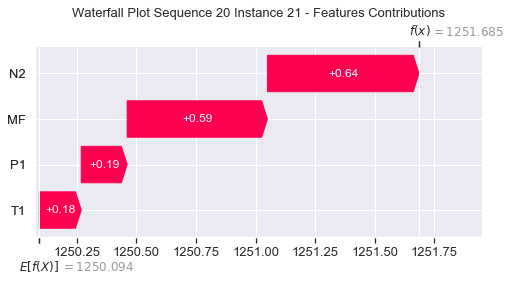

None

Contribution: [0.39295466 0.3468241  1.29016162 1.20254236]


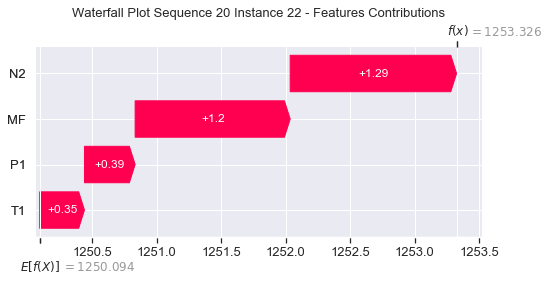

None

Contribution: [0.69388192 0.48076041 2.30028642 2.18994767]


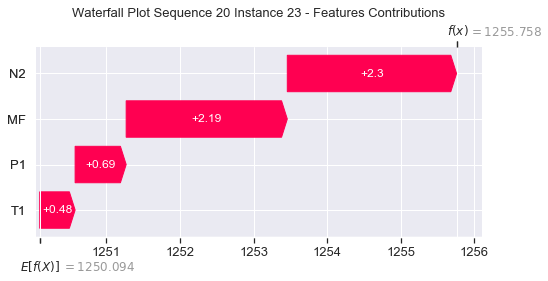

None

Contribution: [ 1.01564559 -0.4658671   3.15339689  3.3414617 ]


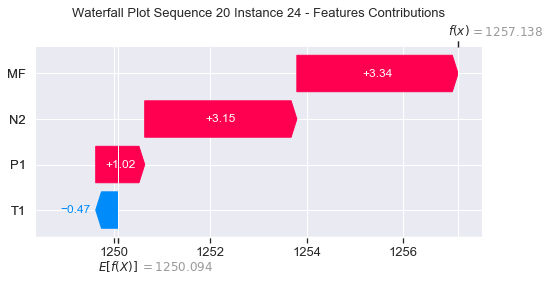

None

Contribution: [ 0.23055721 -0.06014675  0.72633961  0.71191797]


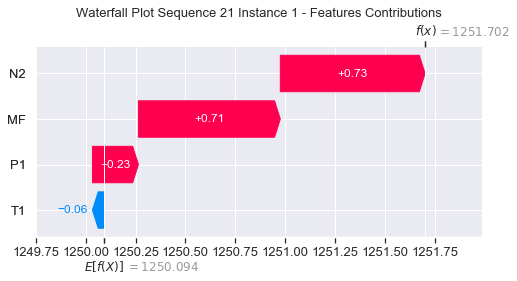

None

Contribution: [0.00382199 0.00328421 0.01112364 0.01146065]


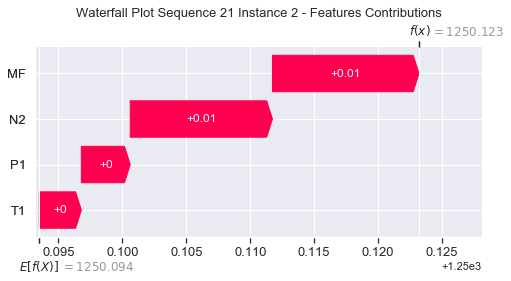

None

Contribution: [0.02576003 0.03110648 0.09498492 0.08778448]


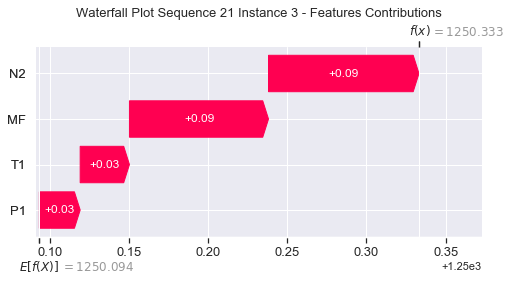

None

Contribution: [0.01875403 0.02292767 0.06657336 0.0600049 ]


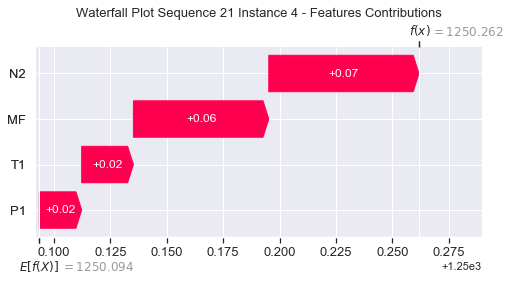

None

Contribution: [0.02146882 0.02435995 0.07609895 0.06918634]


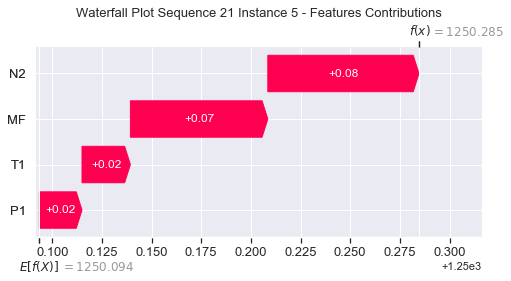

None

Contribution: [0.02263481 0.02536218 0.07938845 0.07226868]


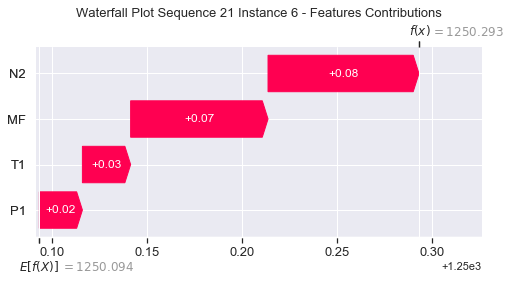

None

Contribution: [0.0217407  0.02436117 0.07640808 0.06952245]


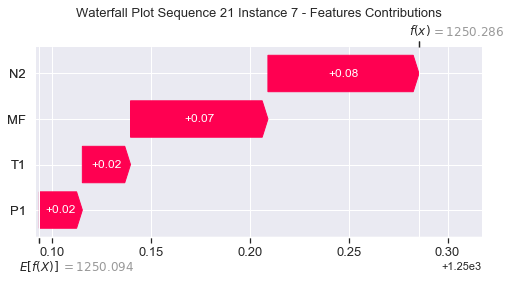

None

Contribution: [0.02028625 0.02255846 0.07125911 0.06479647]


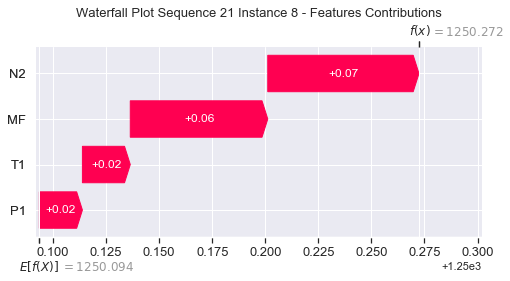

None

Contribution: [0.0190293  0.02086192 0.06663554 0.06067896]


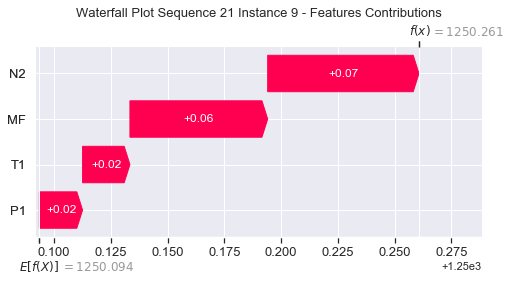

None

Contribution: [0.01712851 0.01957583 0.06266035 0.05641741]


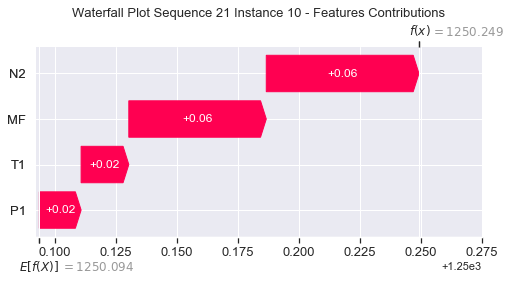

None

Contribution: [0.01735577 0.01863677 0.06054791 0.05515485]


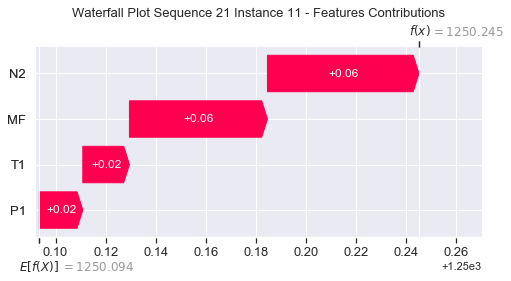

None

Contribution: [0.01652285 0.01793139 0.05878502 0.05330723]


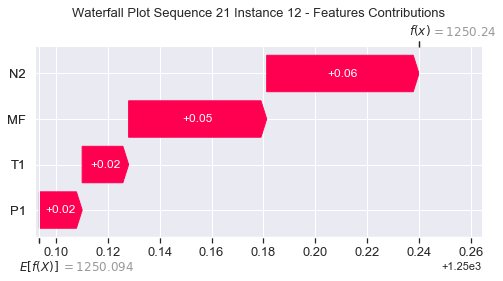

None

Contribution: [0.01641125 0.0177077  0.05830658 0.05284661]


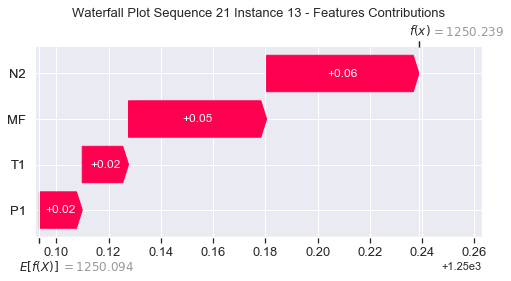

None

Contribution: [0.01683968 0.01770471 0.05852733 0.05314641]


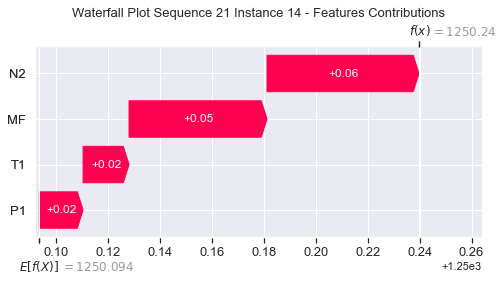

None

Contribution: [0.01699636 0.0178254  0.05968832 0.05416665]


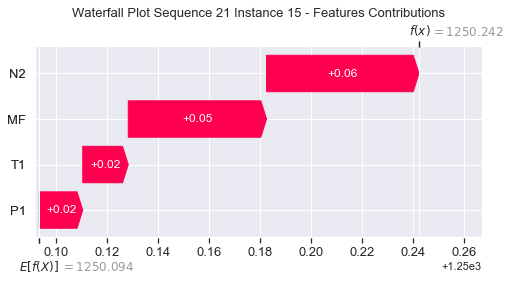

None

Contribution: [0.01818162 0.0189575  0.06344623 0.05805821]


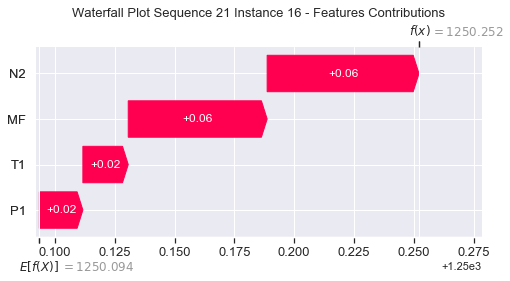

None

Contribution: [0.02111475 0.020959   0.07310273 0.06649217]


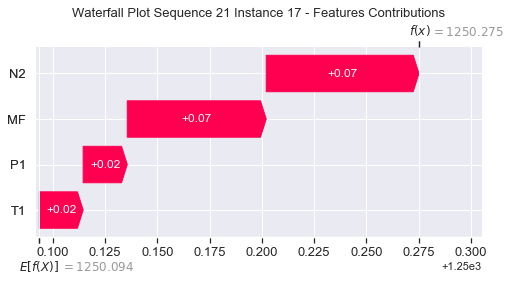

None

Contribution: [0.02866023 0.02720289 0.0978039  0.08926103]


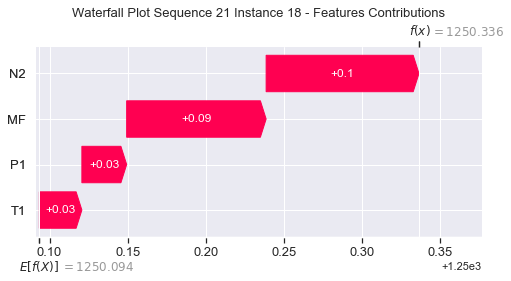

None

Contribution: [0.04774796 0.04290776 0.1598057  0.14743   ]


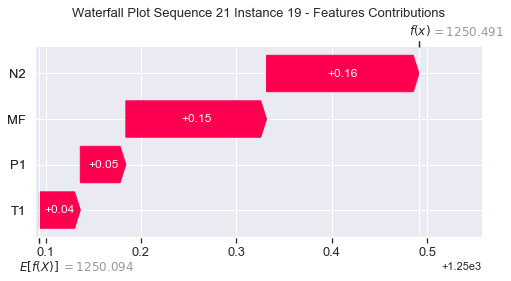

None

Contribution: [0.09254111 0.0822131  0.30828414 0.28335783]


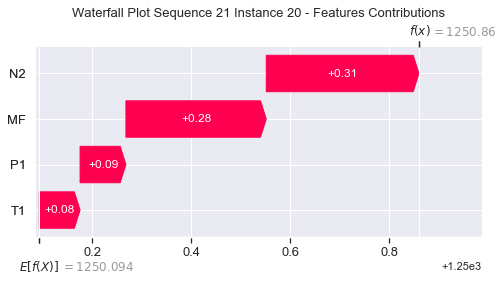

None

Contribution: [0.19321468 0.16831558 0.64108718 0.59073427]


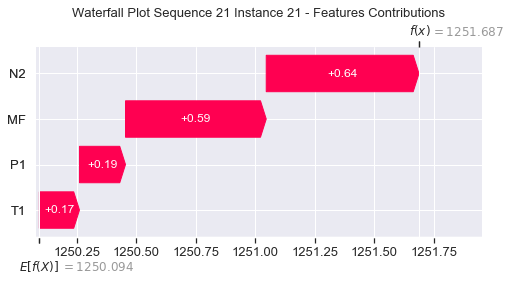

None

Contribution: [0.3934587  0.32479586 1.30163798 1.20498562]


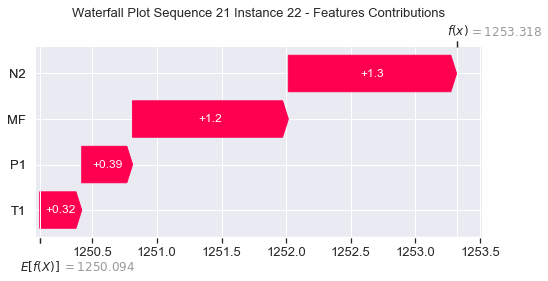

None

Contribution: [0.69764488 0.41580463 2.32352605 2.19411185]


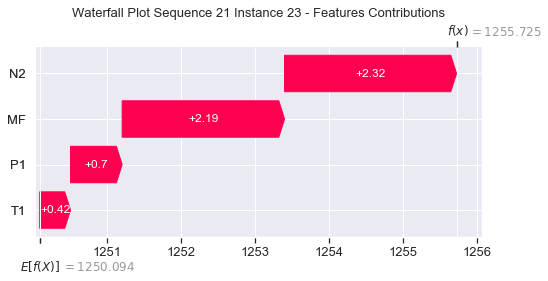

None

Contribution: [ 0.96072052 -0.79470428  3.21366007  3.20087201]


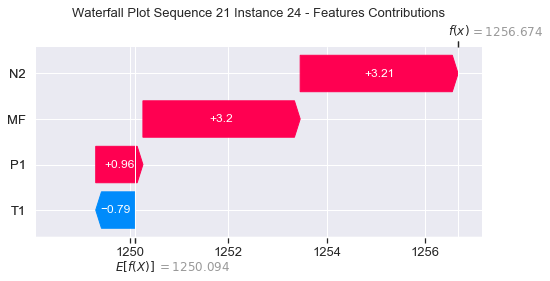

None

Contribution: [ 0.17780299 -0.15843985  0.73352029  0.61930913]


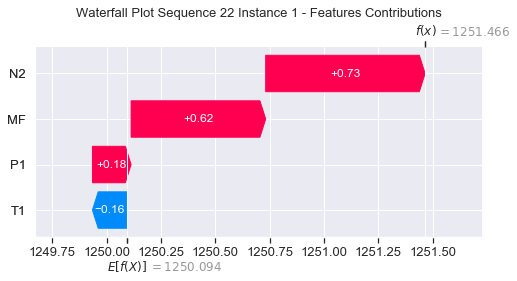

None

Contribution: [0.00363399 0.00247172 0.01135067 0.01106161]


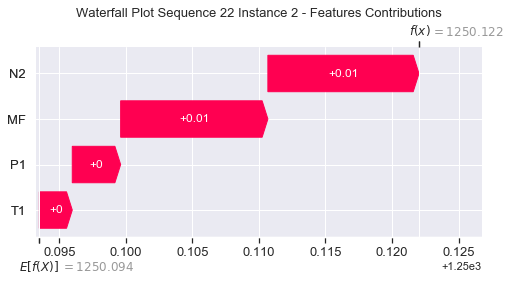

None

Contribution: [0.02558585 0.02580611 0.09509485 0.08721526]


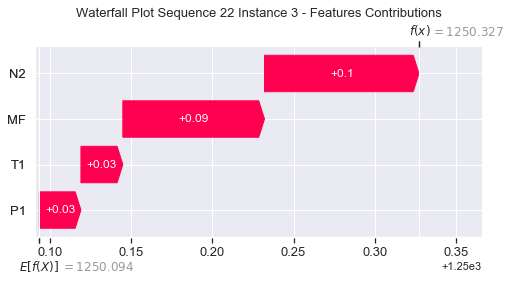

None

Contribution: [0.01834026 0.01890429 0.0654115  0.0591539 ]


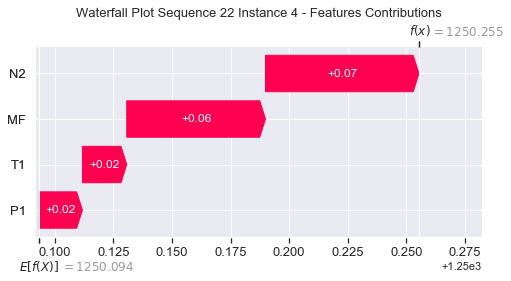

None

Contribution: [0.02112191 0.02126669 0.07503219 0.06826794]


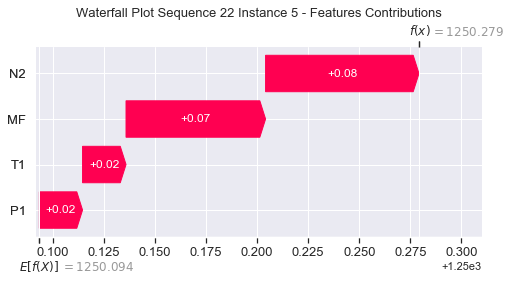

None

Contribution: [0.02218997 0.02263581 0.07873131 0.07187502]


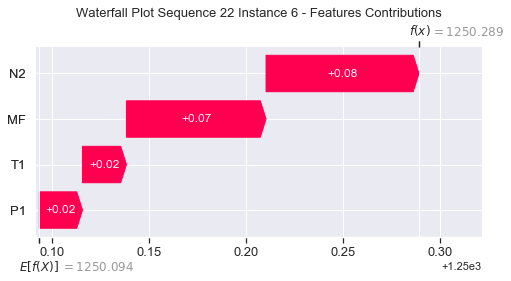

None

Contribution: [0.02159318 0.02198565 0.07618422 0.06981156]


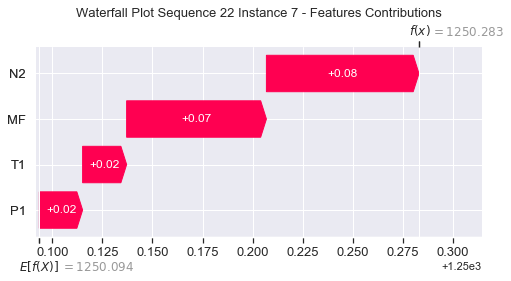

None

Contribution: [0.02007304 0.0207592  0.07107515 0.06485196]


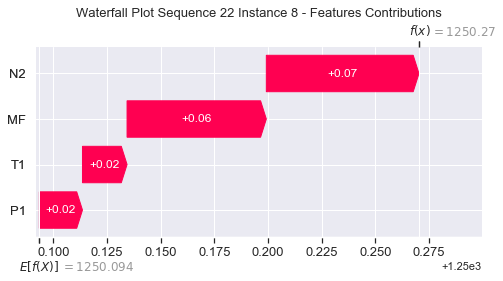

None

Contribution: [0.01872345 0.01962842 0.06630978 0.06032719]


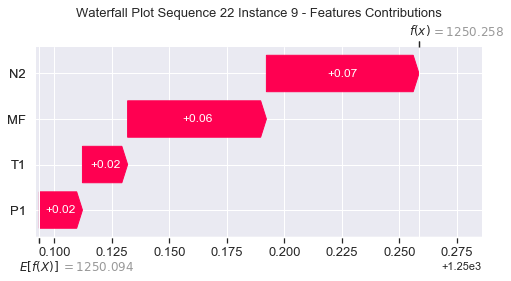

None

Contribution: [0.01787518 0.01914802 0.06270878 0.05643912]


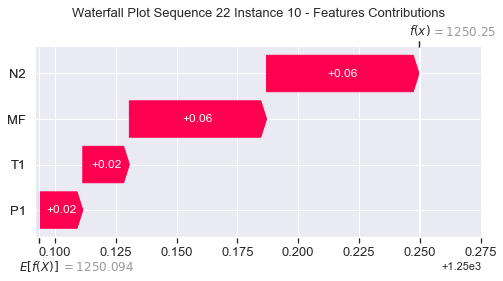

None

Contribution: [0.01664018 0.01827403 0.05995562 0.05387066]


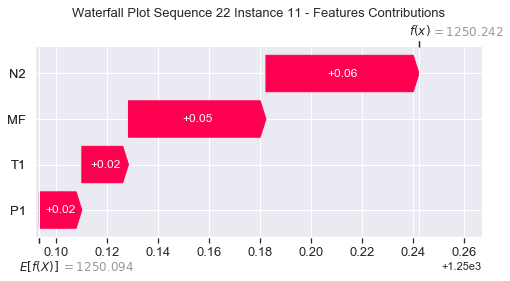

None

Contribution: [0.01655728 0.01796067 0.05886675 0.05377492]


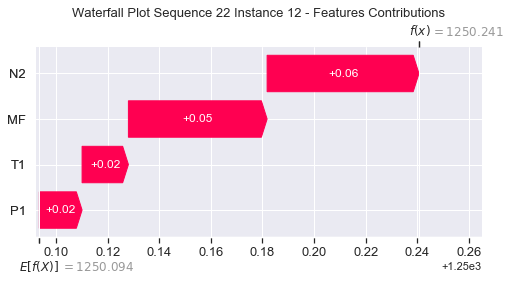

None

Contribution: [0.01652946 0.01771698 0.05844226 0.05347221]


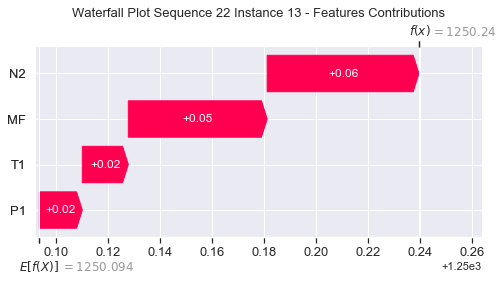

None

Contribution: [0.01651381 0.01789685 0.05854676 0.053764  ]


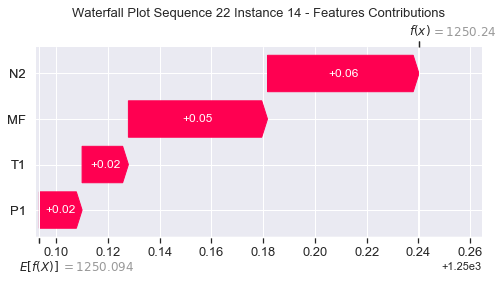

None

Contribution: [0.01700551 0.01791443 0.05971545 0.05470009]


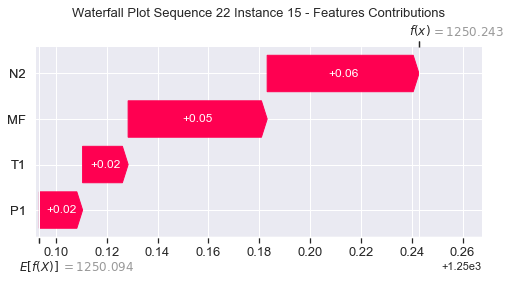

None

Contribution: [0.01829601 0.01888418 0.06354103 0.05825457]


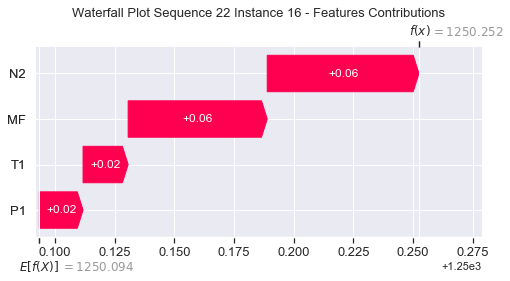

None

Contribution: [0.02120946 0.02145838 0.0730674  0.06729595]


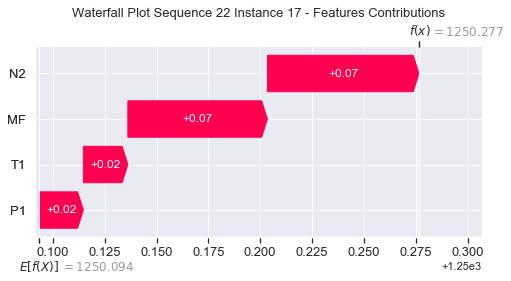

None

Contribution: [0.02860741 0.02804757 0.09737998 0.08986377]


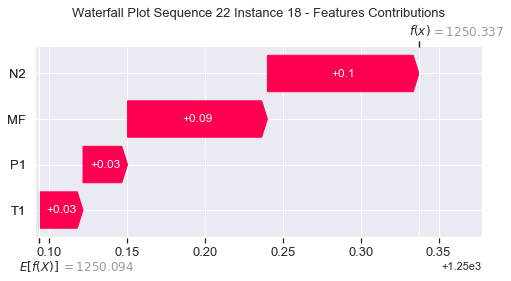

None

Contribution: [0.04654748 0.04422187 0.15832188 0.14496741]


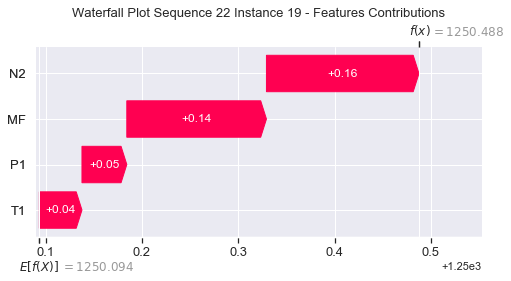

None

Contribution: [0.09195822 0.08451715 0.3044654  0.2829895 ]


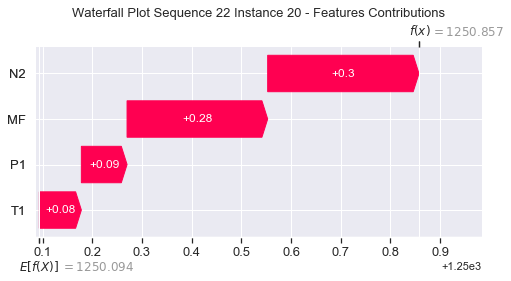

None

Contribution: [0.19199265 0.17565146 0.63267492 0.58947534]


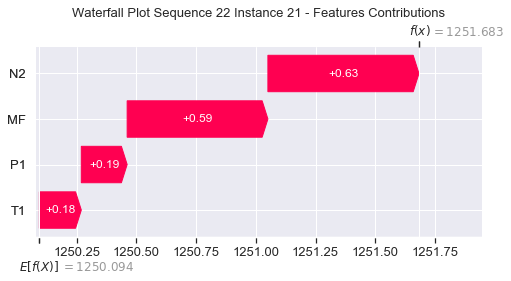

None

Contribution: [0.39129285 0.34915559 1.28669905 1.20360474]


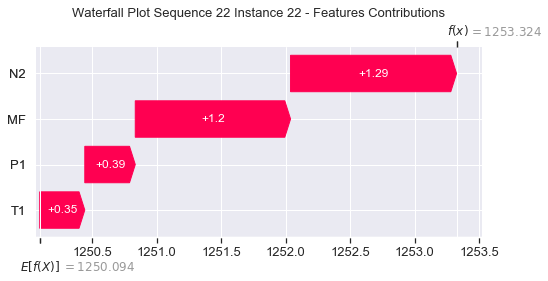

None

Contribution: [0.69418768 0.51825915 2.30026556 2.2088948 ]


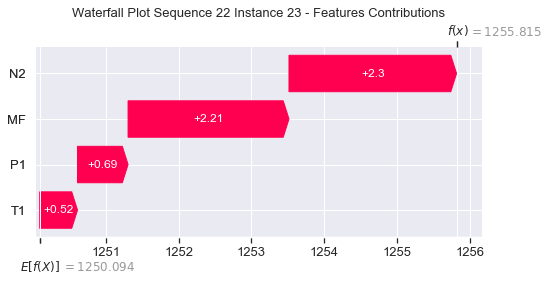

None

Contribution: [ 0.98406119 -0.35659454  3.20714253  3.37422796]


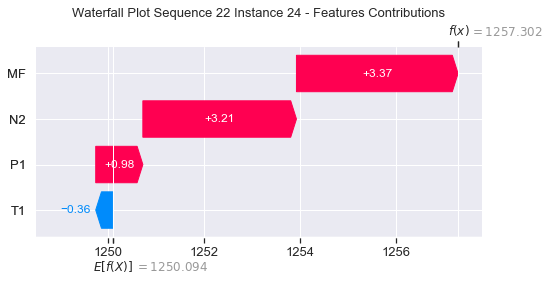

None

Contribution: [ 0.19868484 -0.0733594   0.74443167  0.68374903]


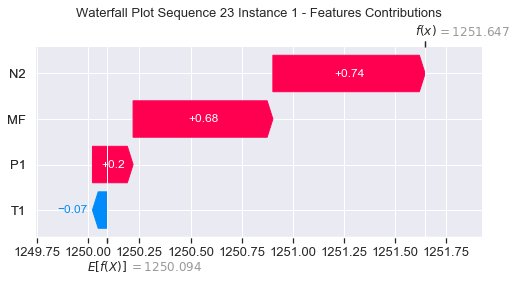

None

Contribution: [0.00368689 0.00336972 0.01109453 0.01122197]


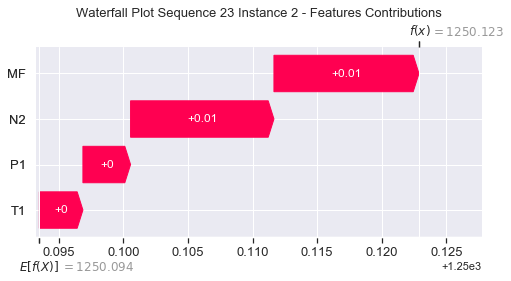

None

Contribution: [0.02472455 0.02594815 0.09485476 0.08720409]


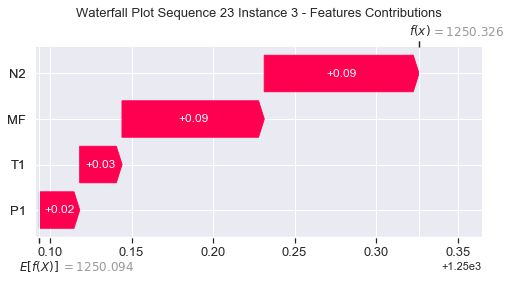

None

Contribution: [0.01738472 0.01933876 0.06509119 0.05825571]


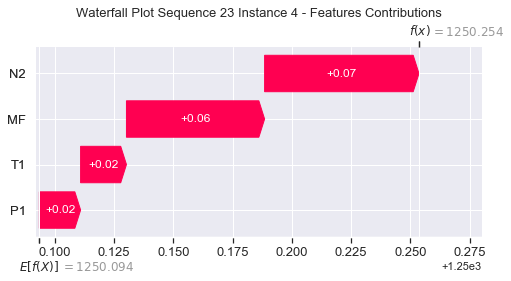

None

Contribution: [0.02129281 0.02280487 0.0758668  0.06887443]


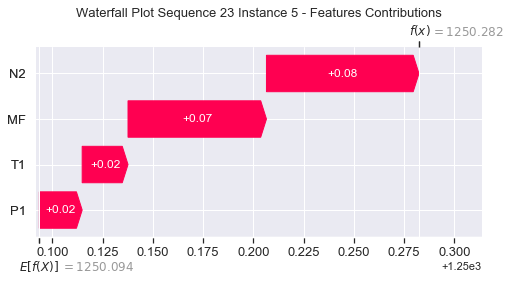

None

Contribution: [0.02251701 0.02407614 0.0795204  0.07201904]


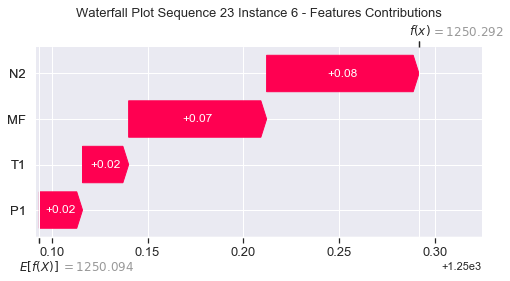

None

Contribution: [0.02180762 0.02341529 0.07681045 0.06959462]


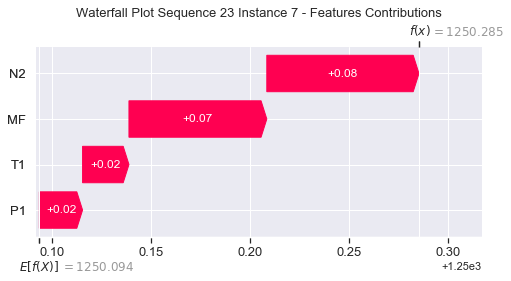

None

Contribution: [0.02030208 0.02181074 0.07167724 0.06481293]


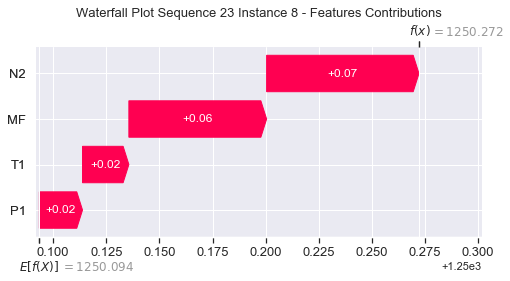

None

Contribution: [0.01914872 0.02073878 0.06726784 0.06087228]


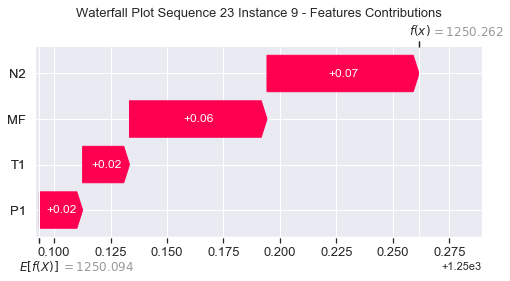

None

Contribution: [0.01825307 0.01955572 0.06343623 0.05729072]


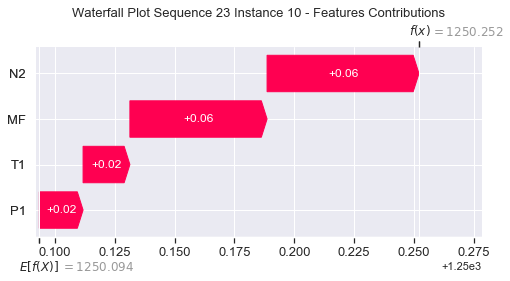

None

Contribution: [0.0171435  0.01844603 0.06067416 0.05435025]


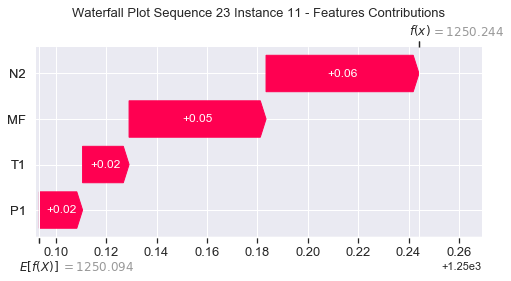

None

Contribution: [0.01674589 0.01815103 0.05911363 0.05308111]


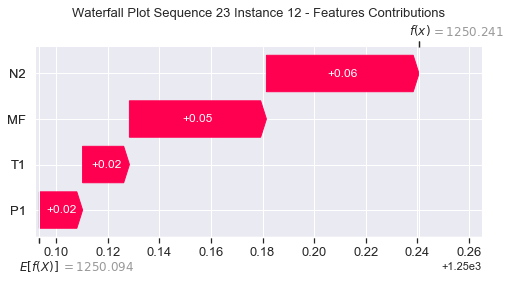

None

Contribution: [0.01667151 0.0179746  0.05871073 0.05282148]


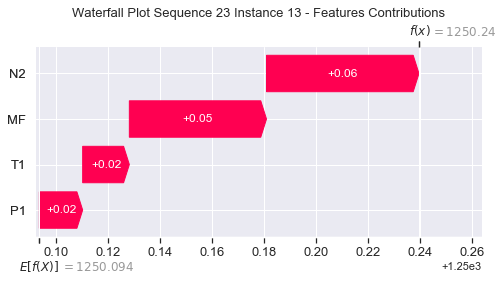

None

Contribution: [0.01676907 0.01819731 0.05896197 0.05400721]


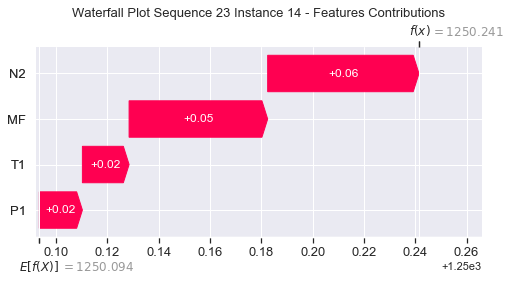

None

Contribution: [0.01709252 0.0181454  0.05990084 0.05392908]


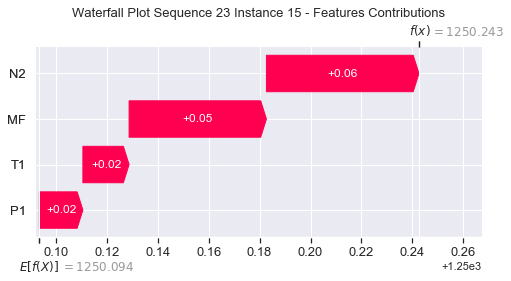

None

Contribution: [0.01787191 0.01888382 0.06342545 0.05712138]


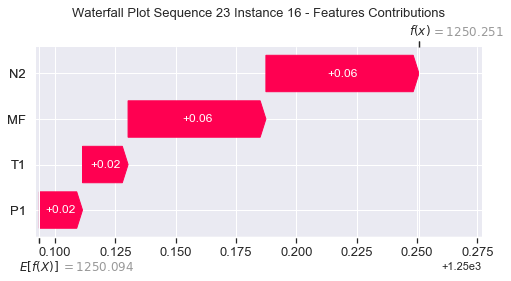

None

Contribution: [0.02128438 0.02159545 0.07335941 0.06636909]


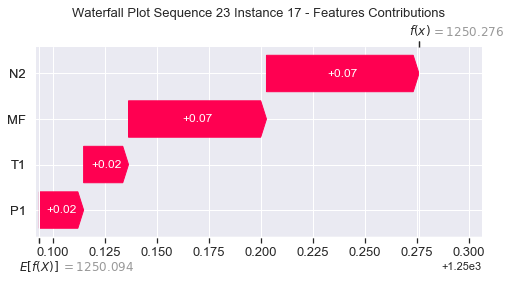

None

Contribution: [0.02876249 0.02804792 0.09794574 0.08891041]


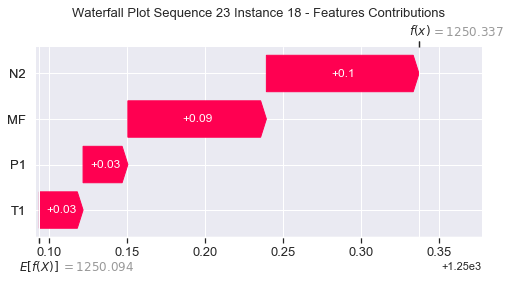

None

Contribution: [0.04747577 0.0440475  0.15935289 0.14385432]


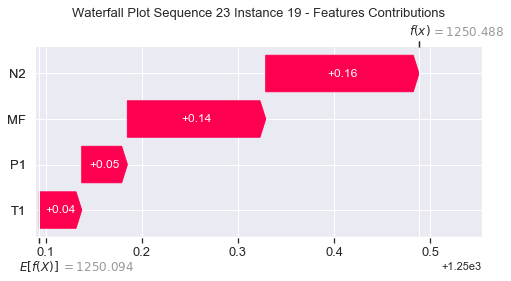

None

Contribution: [0.09229535 0.08463457 0.30730977 0.28159991]


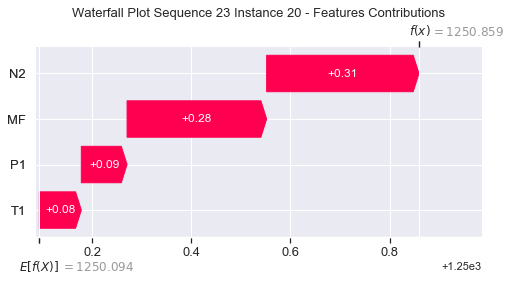

None

Contribution: [0.19267746 0.17455879 0.63852407 0.58647599]


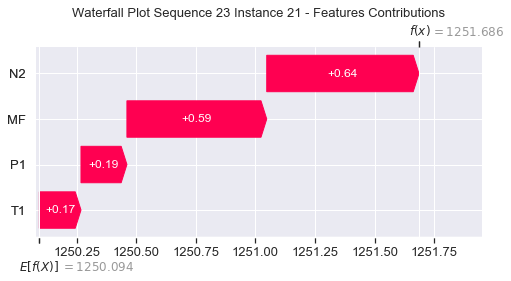

None

Contribution: [0.39177267 0.3419393  1.29657295 1.19406528]


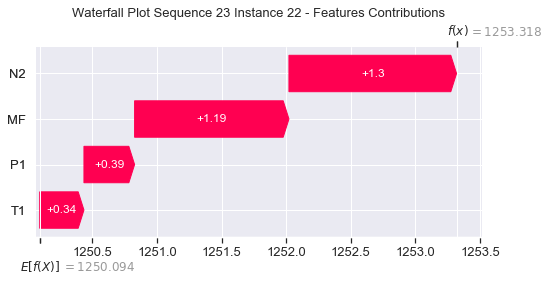

None

Contribution: [0.6927236  0.47774569 2.31361792 2.15933178]


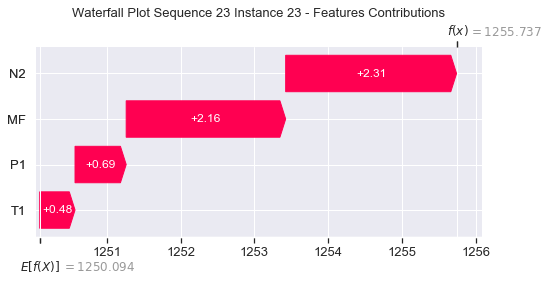

None

Contribution: [ 1.03670217 -0.49012903  3.22362503  3.21906396]


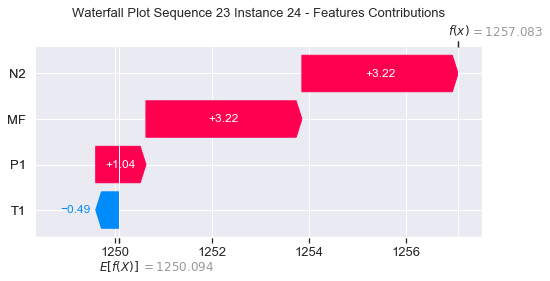

None

Contribution: [ 0.25564834 -0.06838901  0.74603178  0.68921874]


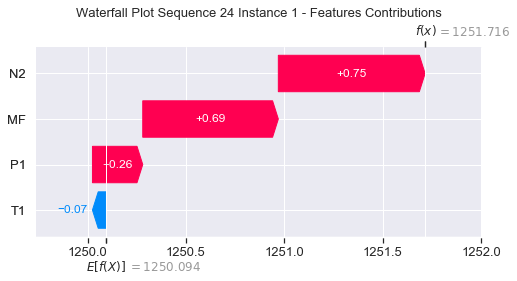

None

Contribution: [0.00358349 0.00301772 0.01093916 0.01045302]


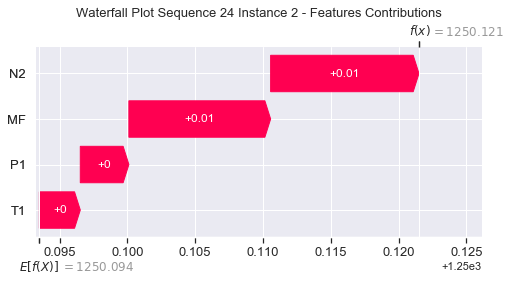

None

Contribution: [0.02549222 0.02794315 0.09461953 0.08621023]


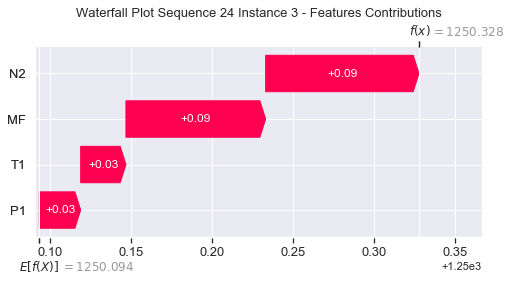

None

Contribution: [0.01872933 0.01980151 0.0657719  0.05947585]


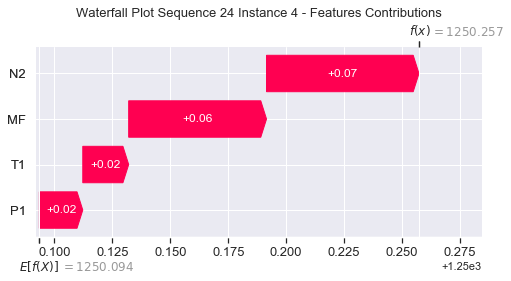

None

Contribution: [0.02125573 0.02216076 0.07508304 0.06741762]


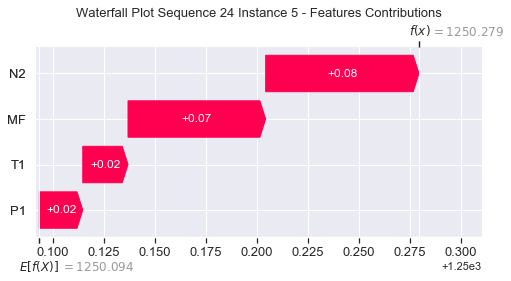

None

Contribution: [0.02223946 0.0230503  0.07853459 0.07068675]


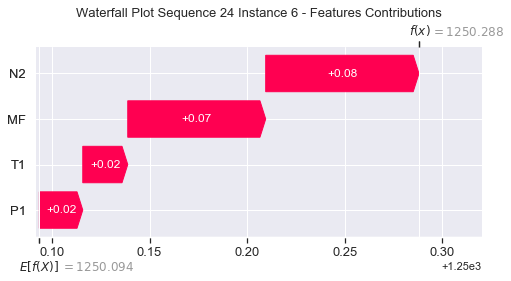

None

Contribution: [0.02154194 0.02244189 0.0758505  0.06839861]


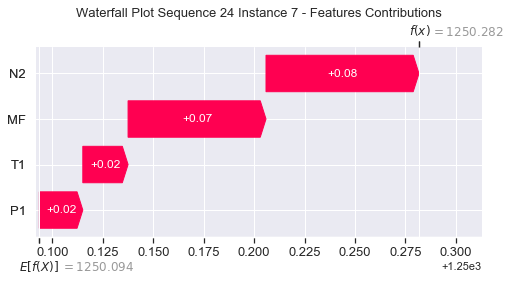

None

Contribution: [0.02003374 0.02103575 0.07070726 0.06360157]


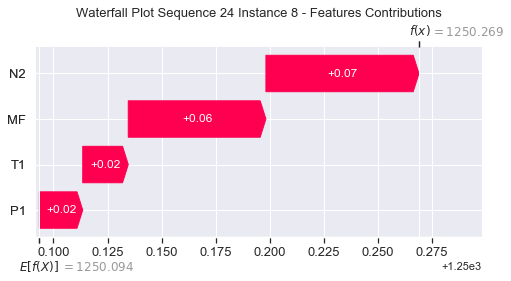

None

Contribution: [0.01860226 0.01988339 0.0660804  0.05889074]


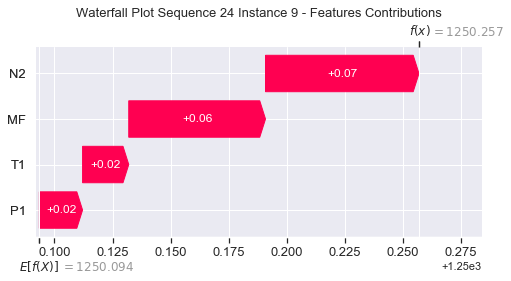

None

Contribution: [0.01780965 0.01828068 0.06250648 0.05664161]


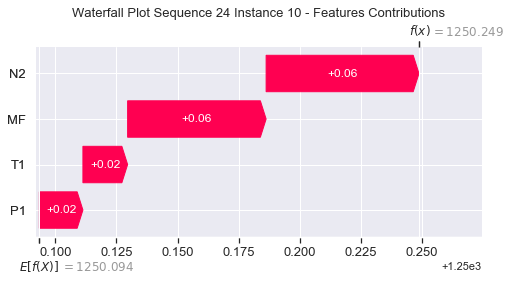

None

Contribution: [0.01679636 0.01761402 0.05983441 0.05330358]


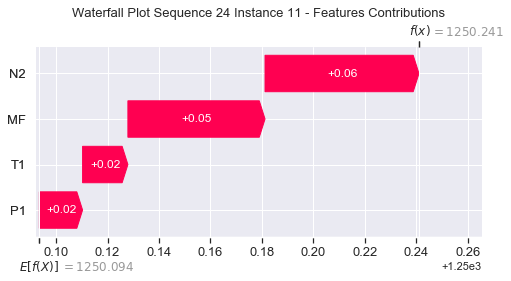

None

Contribution: [0.01671677 0.0173236  0.05860779 0.05303992]


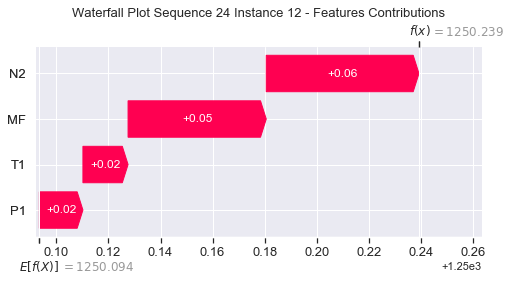

None

Contribution: [0.01660415 0.01731523 0.05810813 0.05259207]


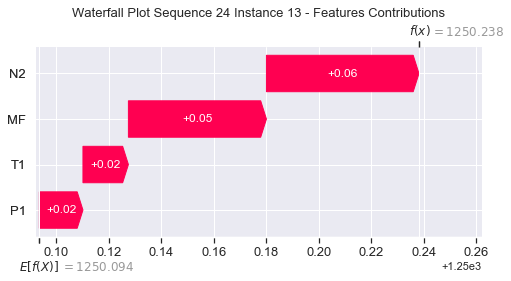

None

Contribution: [0.01639088 0.01705019 0.05789171 0.05183534]


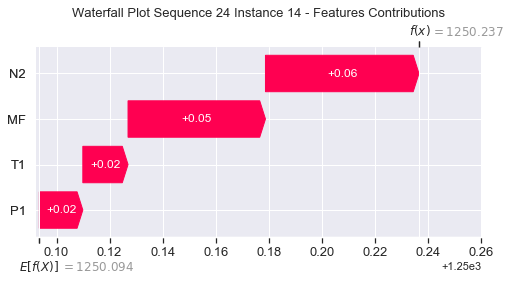

None

Contribution: [0.01706955 0.01782712 0.05940379 0.05388144]


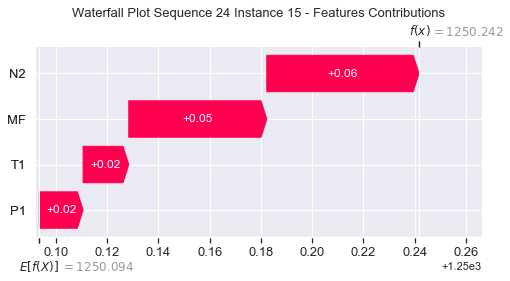

None

Contribution: [0.01775813 0.01792381 0.06270086 0.05653284]


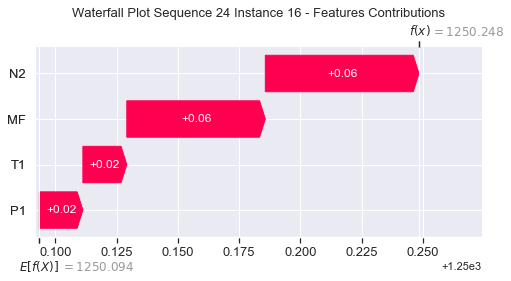

None

Contribution: [0.02120006 0.02160278 0.07278175 0.06632136]


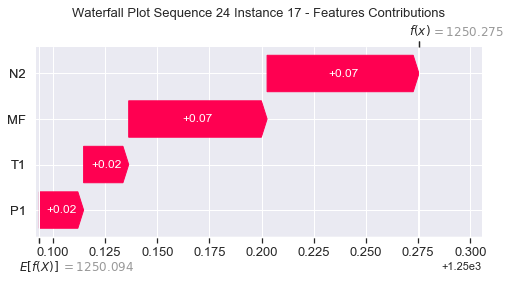

None

Contribution: [0.02857735 0.02830245 0.09699772 0.08871007]


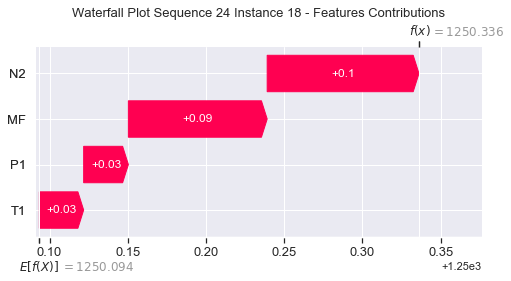

None

Contribution: [0.04680761 0.04552805 0.15802733 0.14449005]


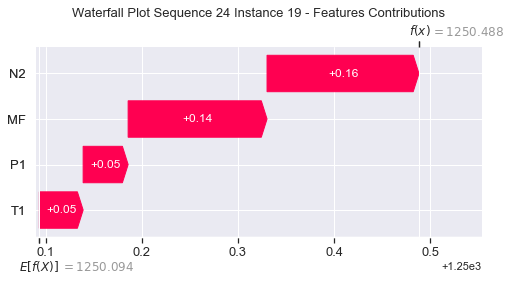

None

Contribution: [0.09139803 0.08747262 0.30312392 0.27941348]


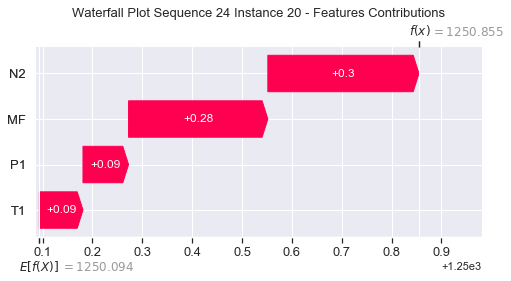

None

Contribution: [0.1913011  0.18111254 0.63017802 0.58290427]


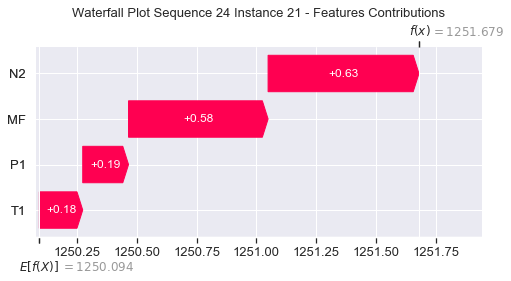

None

Contribution: [0.39144682 0.36213555 1.28230773 1.19317138]


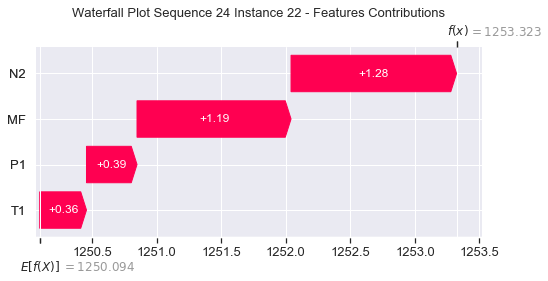

None

Contribution: [0.69821969 0.55240315 2.29755422 2.18899779]


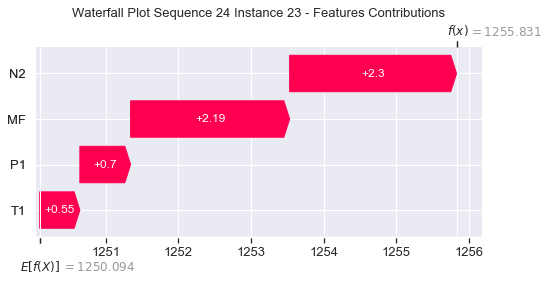

None

Contribution: [ 1.03737289 -0.07470395  3.20339383  3.30334881]


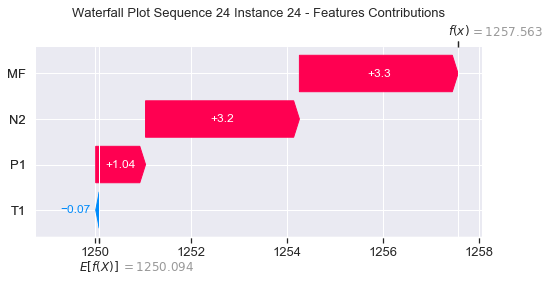

None

Contribution: [ 0.2296182  -0.01048502  0.73474277  0.65817492]


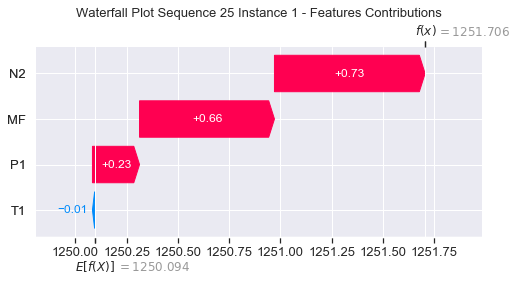

None

Contribution: [0.00378775 0.00347749 0.01112582 0.0112084 ]


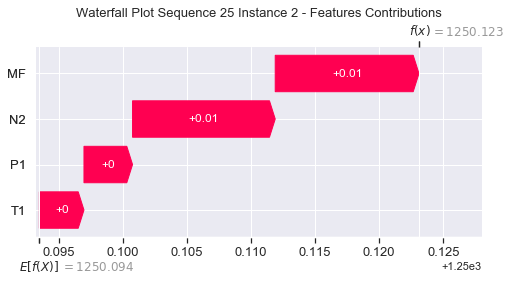

None

Contribution: [0.02583534 0.02917808 0.09459967 0.08747282]


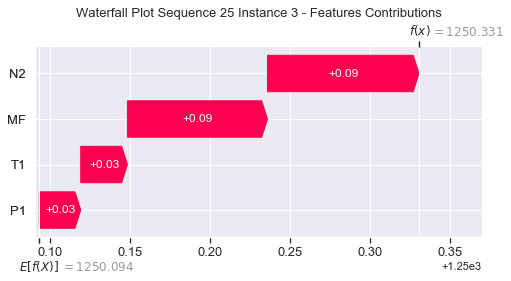

None

Contribution: [0.01770507 0.02009323 0.06509001 0.0580882 ]


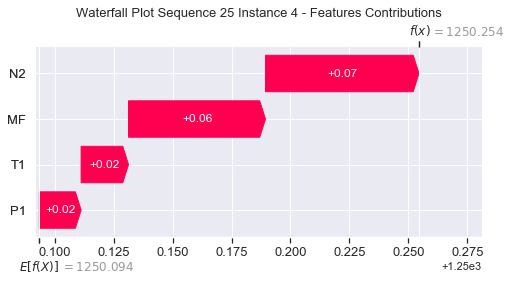

None

Contribution: [0.02089879 0.02383664 0.07482    0.06660425]


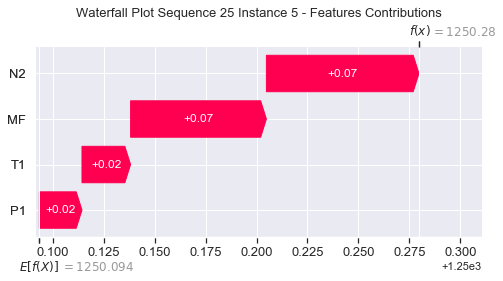

None

Contribution: [0.02181541 0.02432478 0.07817614 0.06976454]


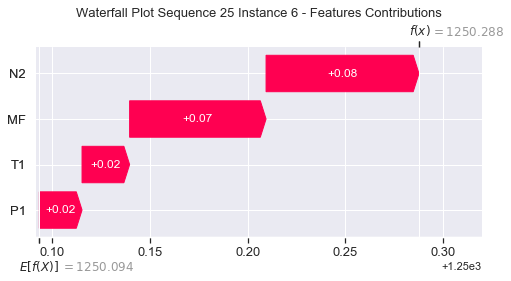

None

Contribution: [0.02108433 0.02342464 0.07547064 0.06748828]


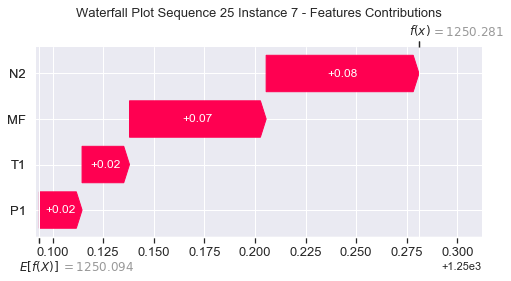

None

Contribution: [0.01975735 0.02216404 0.07057825 0.06316177]


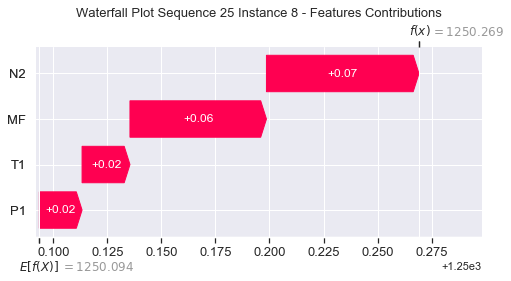

None

Contribution: [0.0188154  0.02100191 0.06635478 0.06034018]


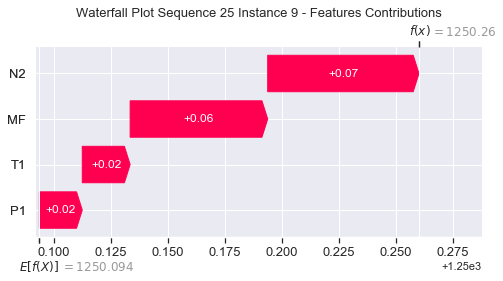

None

Contribution: [0.01692325 0.01877039 0.06202727 0.05479686]


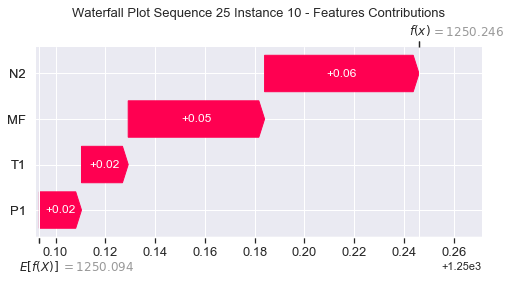

None

Contribution: [0.01710038 0.01928792 0.06030616 0.05463789]


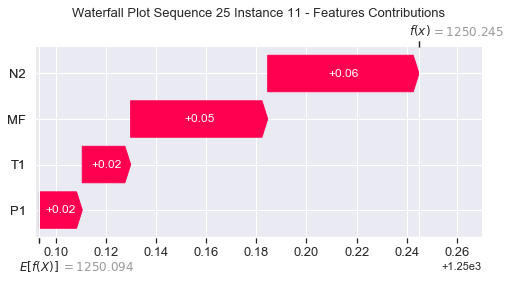

None

Contribution: [0.01644516 0.01833547 0.05848904 0.0525353 ]


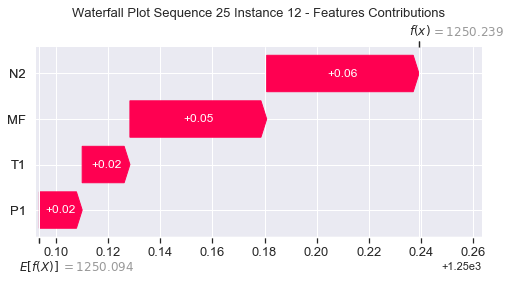

None

Contribution: [0.01632462 0.01815714 0.05796415 0.05209265]


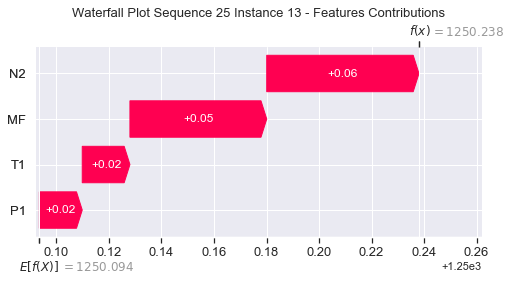

None

Contribution: [0.0164818  0.01785911 0.05785502 0.05172722]


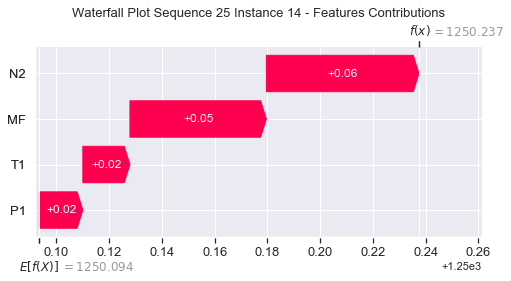

None

Contribution: [0.01677721 0.01849555 0.05920383 0.05335466]


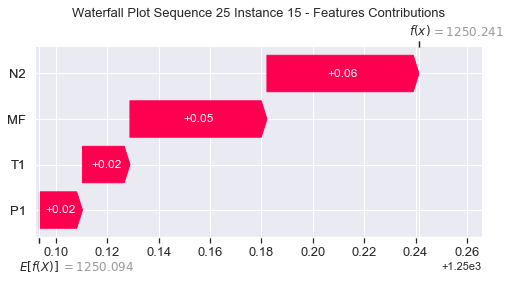

None

Contribution: [0.01735004 0.01839    0.06245943 0.05564643]


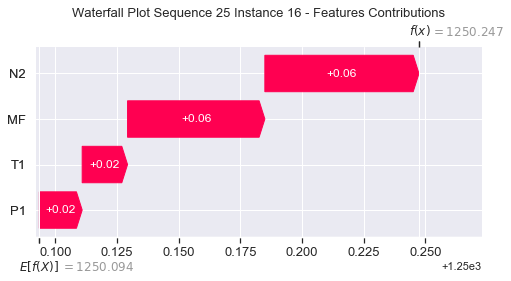

None

Contribution: [0.02086506 0.02201616 0.07257126 0.06578615]


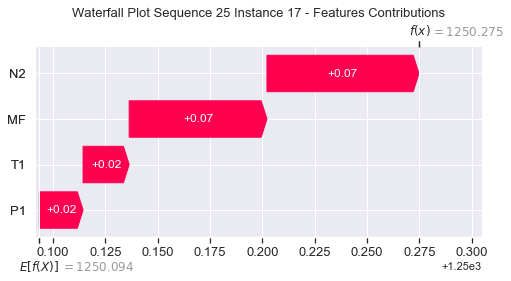

None

Contribution: [0.02820051 0.02876588 0.09681669 0.08811696]


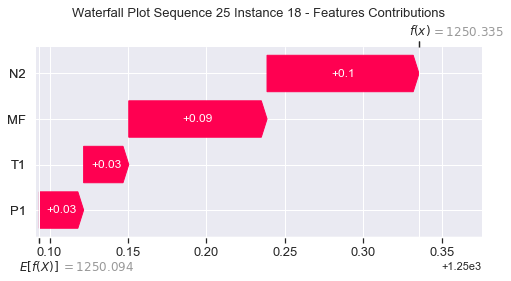

None

Contribution: [0.04722282 0.04580252 0.15760772 0.1447208 ]


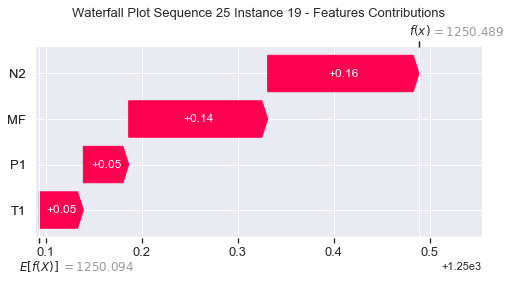

None

Contribution: [0.09050413 0.08813049 0.30306218 0.27845857]


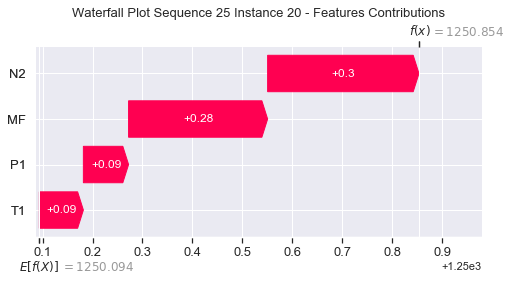

None

Contribution: [0.18946614 0.1834431  0.63006875 0.58093625]


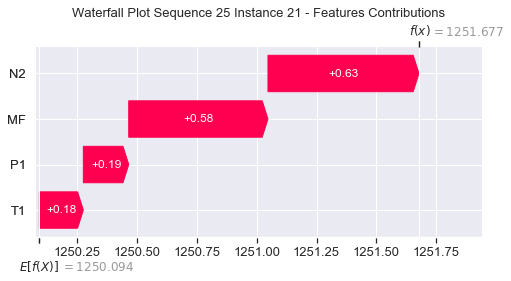

None

Contribution: [0.38735204 0.37057215 1.28189342 1.18812257]


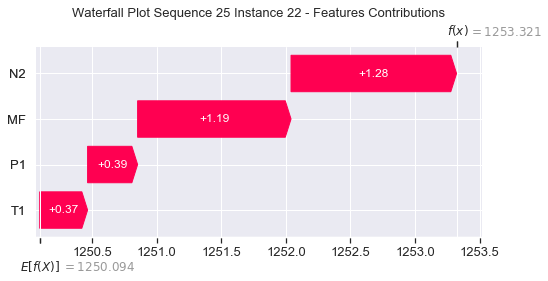

None

Contribution: [0.68638695 0.57424497 2.29737954 2.1738091 ]


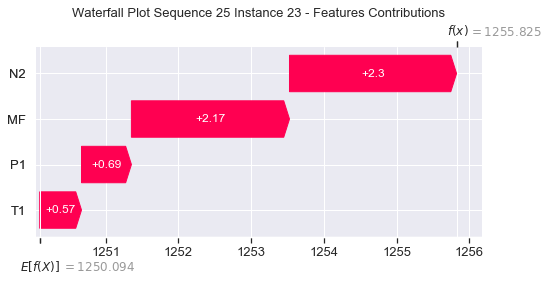

None

Contribution: [0.98482547 0.03748066 3.222433   3.33151355]


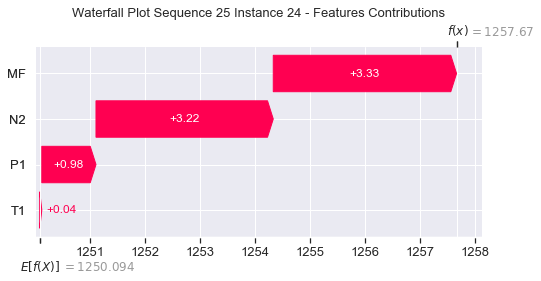

None

Contribution: [0.22108034 0.01436314 0.74486057 0.72236372]


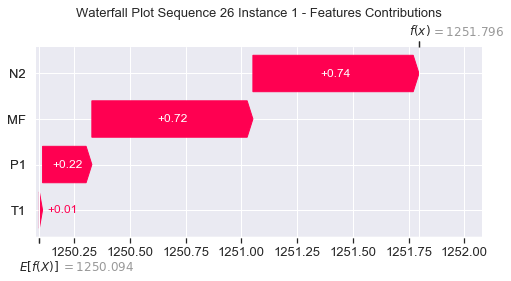

None

Contribution: [0.00364055 0.00367912 0.01093598 0.01089596]


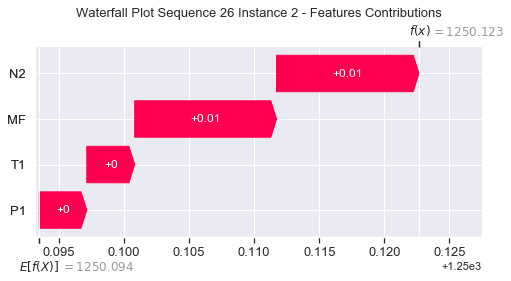

None

Contribution: [0.02553038 0.03091077 0.09403578 0.08707773]


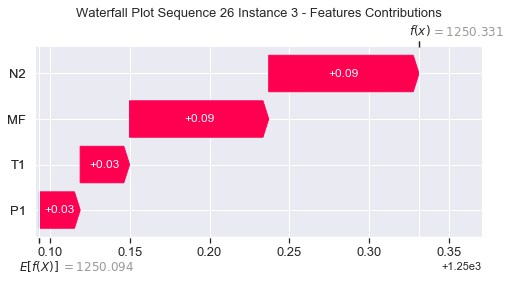

None

Contribution: [0.01835447 0.0220615  0.06598948 0.05944135]


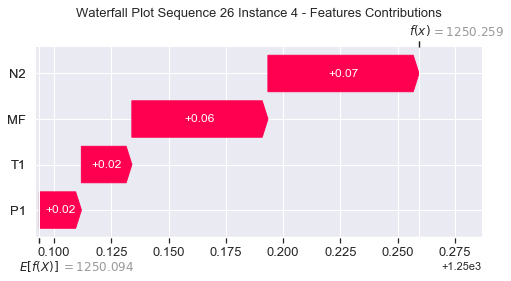

None

Contribution: [0.0211244  0.02488752 0.07511302 0.06764548]


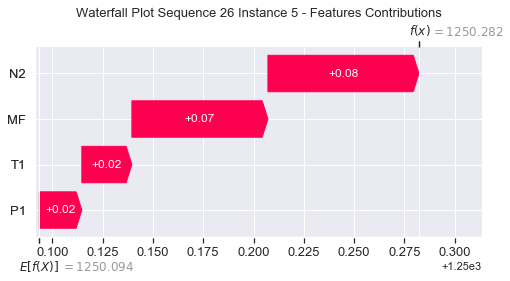

None

Contribution: [0.02170638 0.02523115 0.07786336 0.07001803]


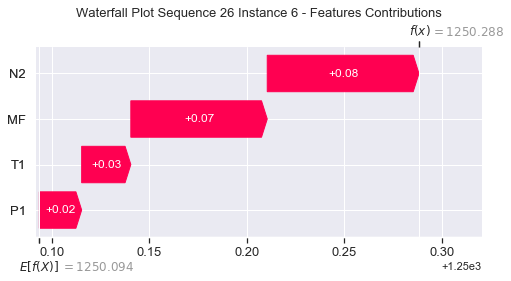

None

Contribution: [0.02095841 0.02435058 0.07498646 0.06758436]


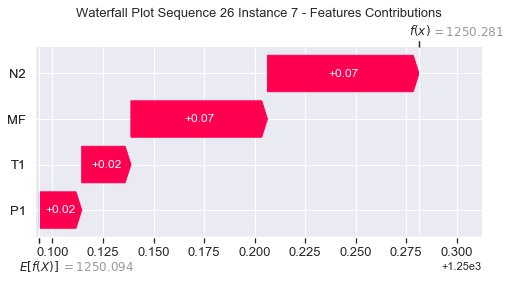

None

Contribution: [0.0195812  0.02279883 0.06995886 0.06296761]


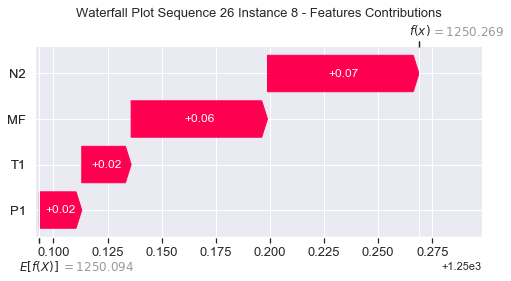

None

Contribution: [0.01845752 0.02154543 0.06556792 0.05895903]


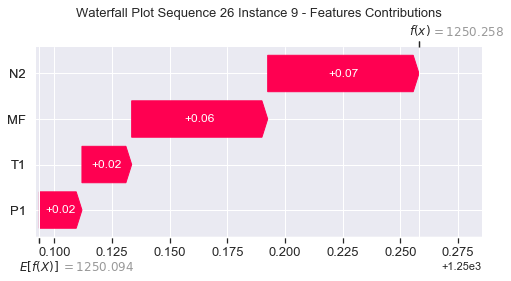

None

Contribution: [0.01744929 0.02020004 0.06200639 0.0560606 ]


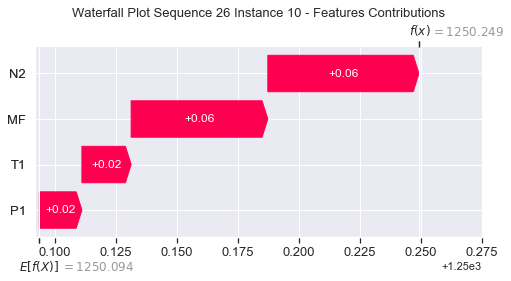

None

Contribution: [0.01683358 0.01922981 0.05951672 0.05340837]


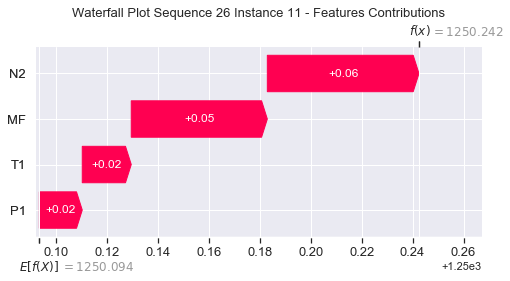

None

Contribution: [0.01663625 0.0187022  0.05817936 0.05287934]


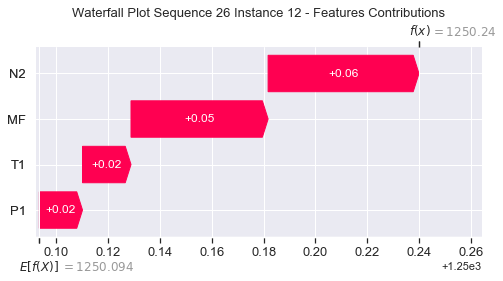

None

Contribution: [0.01648383 0.01856041 0.05768071 0.0524226 ]


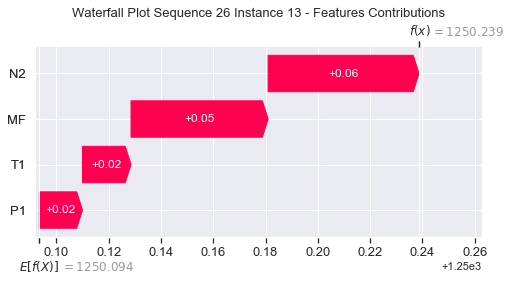

None

Contribution: [0.01636284 0.01845273 0.05758821 0.05220673]


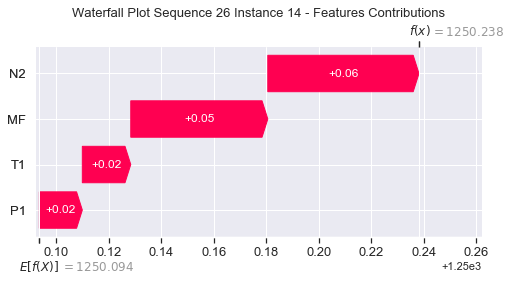

None

Contribution: [0.01683134 0.01868895 0.05893746 0.05360579]


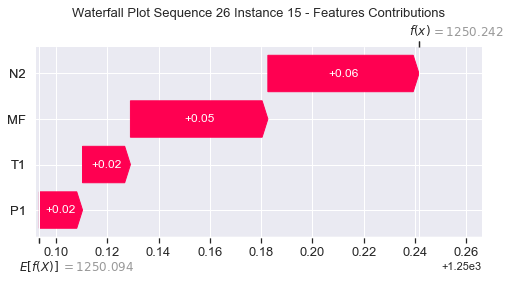

None

Contribution: [0.01781326 0.01999513 0.06257589 0.05694243]


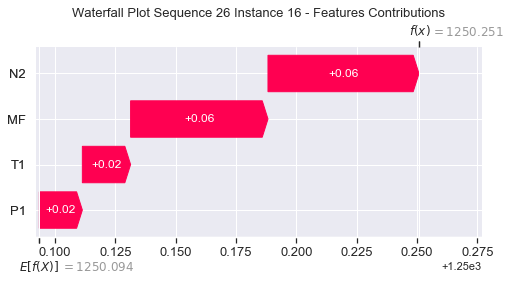

None

Contribution: [0.02082899 0.02217866 0.07213636 0.06584316]


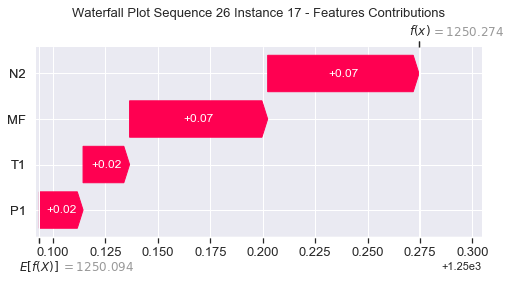

None

Contribution: [0.02809488 0.02880671 0.09629296 0.08812756]


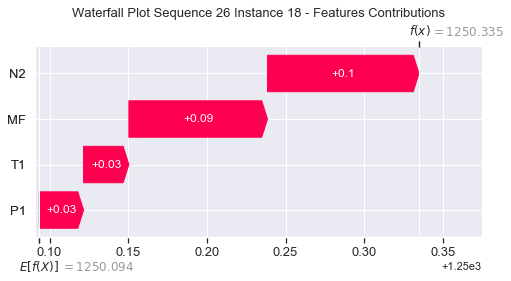

None

Contribution: [0.04655215 0.0465113  0.15688452 0.14420027]


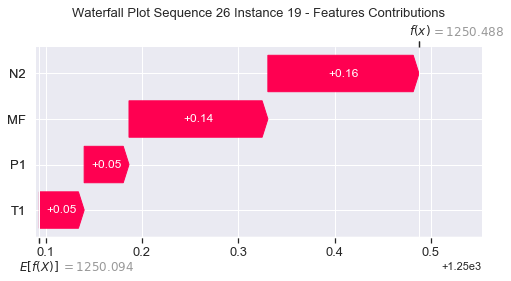

None

Contribution: [0.09014398 0.0879907  0.30255388 0.27890223]


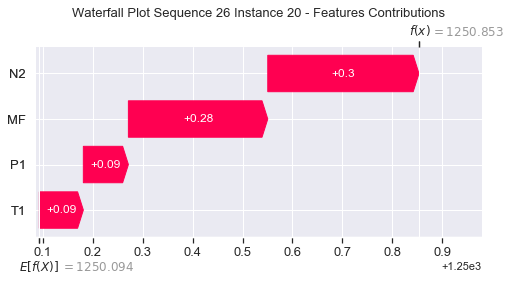

None

Contribution: [0.18942752 0.18235881 0.62986806 0.58316127]


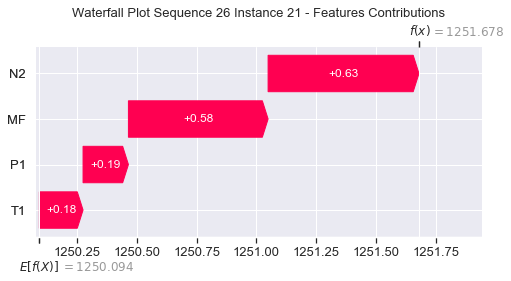

None

Contribution: [0.38822775 0.3640555  1.28269485 1.19543323]


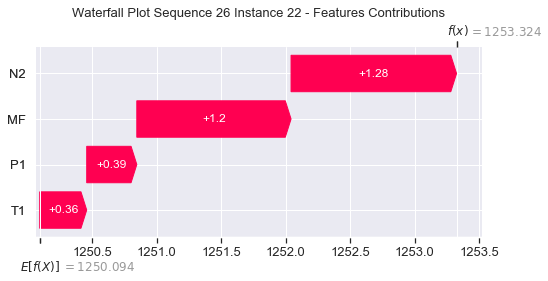

None

Contribution: [0.68635524 0.55018449 2.29811967 2.19144078]


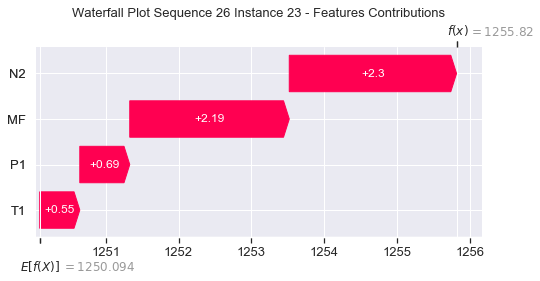

None

Contribution: [ 0.95482845 -0.11667899  3.19472441  3.31605794]


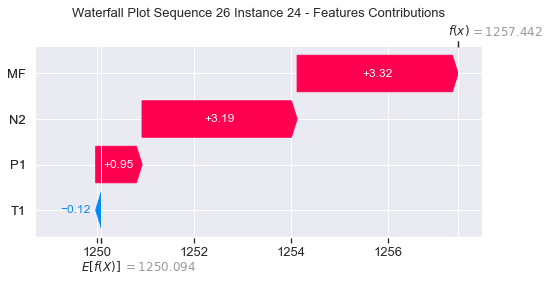

None

Contribution: [ 0.21399997 -0.01815877  0.73180547  0.68012952]


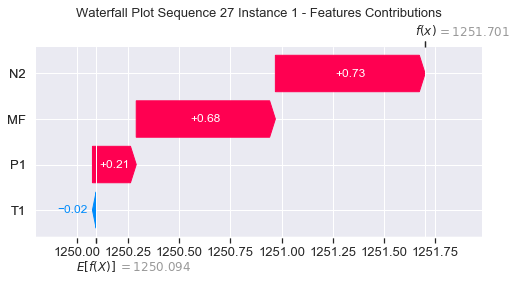

None

Contribution: [0.00386001 0.00352531 0.01123538 0.01152534]


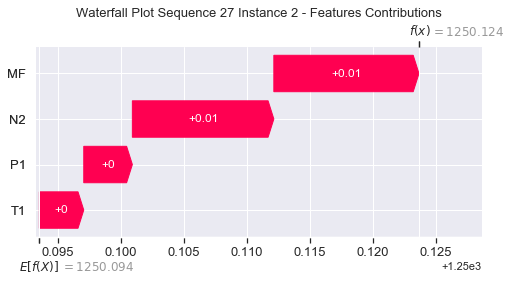

None

Contribution: [0.02569646 0.0288252  0.09485638 0.08911017]


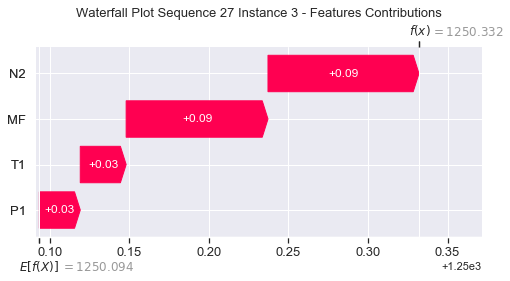

None

Contribution: [0.01852622 0.02181329 0.06628407 0.06037334]


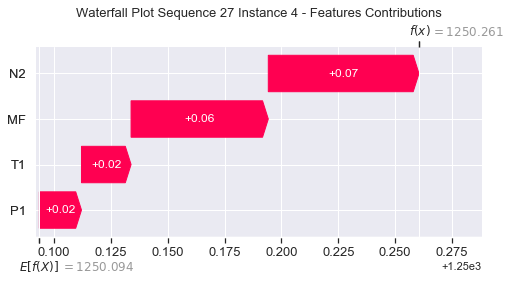

None

Contribution: [0.02059059 0.02294796 0.07473747 0.06678962]


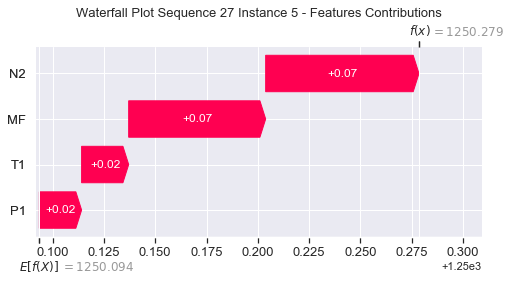

None

Contribution: [0.02195839 0.02442698 0.07833803 0.07069077]


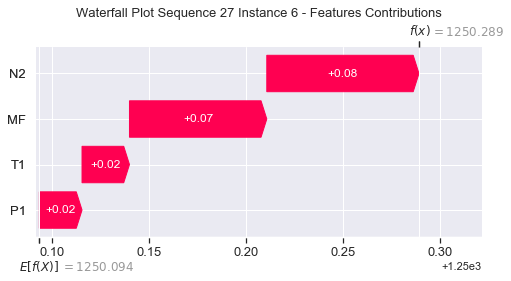

None

Contribution: [0.02119086 0.02375164 0.07552648 0.06809689]


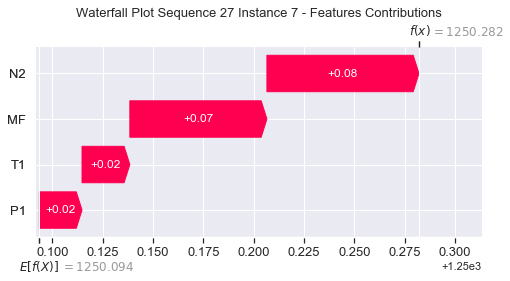

None

Contribution: [0.01972541 0.02216377 0.07044173 0.06343681]


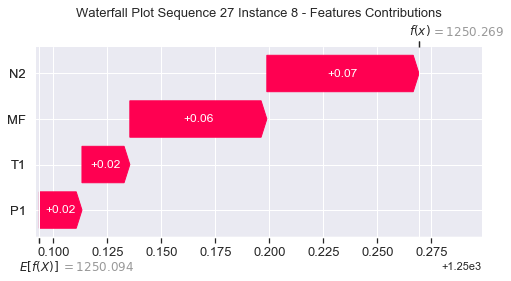

None

Contribution: [0.01838496 0.02111367 0.06591632 0.05894941]


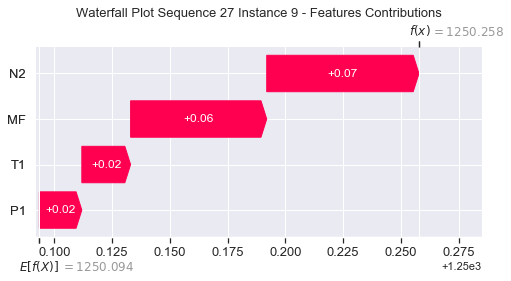

None

Contribution: [0.0173755  0.01965414 0.06218548 0.05560674]


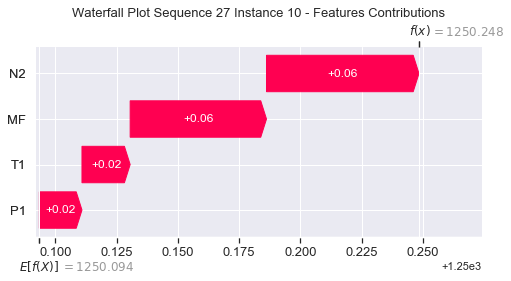

None

Contribution: [0.01662069 0.01842821 0.05961537 0.05330017]


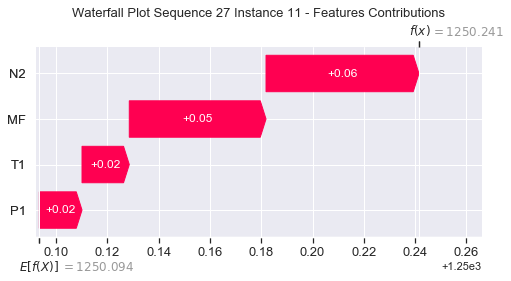

None

Contribution: [0.01614501 0.01782962 0.05795822 0.05179449]


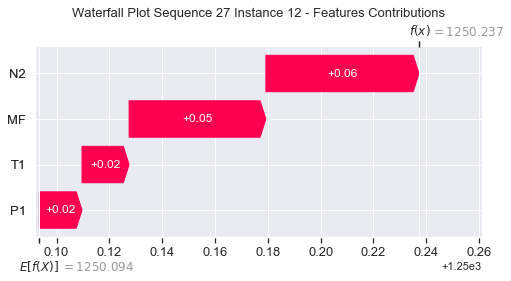

None

Contribution: [0.01607368 0.01785914 0.0575743  0.05151944]


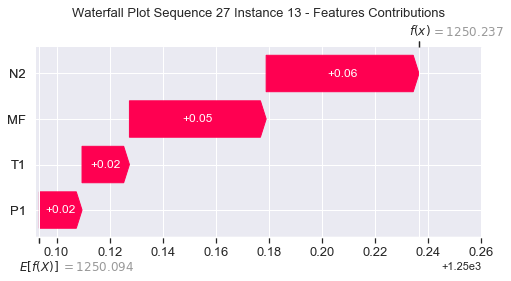

None

Contribution: [0.01616409 0.01823254 0.05777911 0.0520884 ]


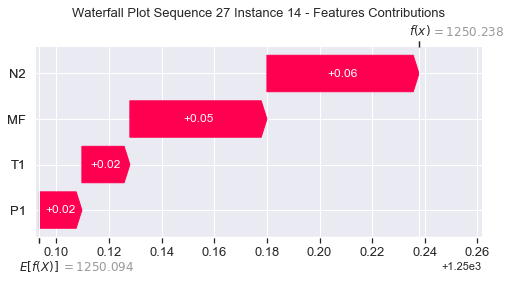

None

Contribution: [0.01662183 0.0184318  0.05906256 0.05312549]


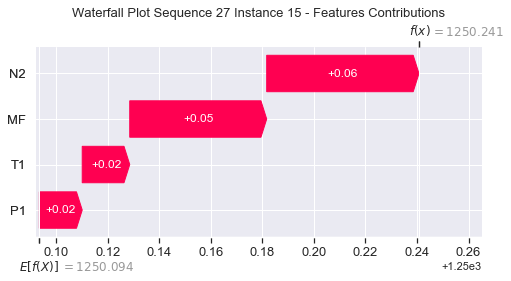

None

Contribution: [0.01794433 0.01998833 0.0629096  0.05695336]


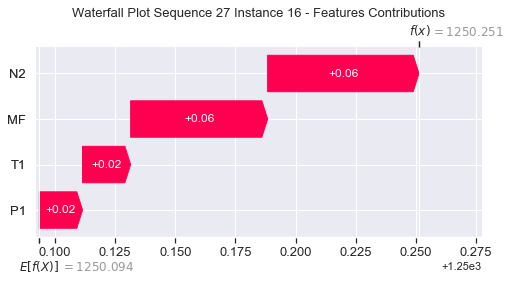

None

Contribution: [0.02080468 0.02237068 0.07245249 0.065711  ]


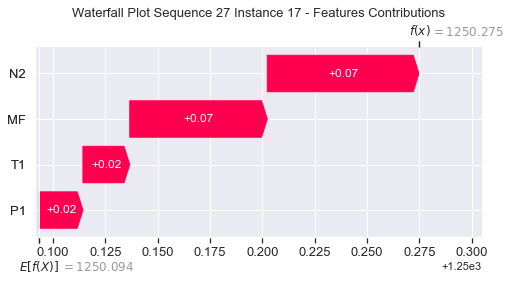

None

Contribution: [0.02818746 0.02926133 0.09669626 0.08825524]


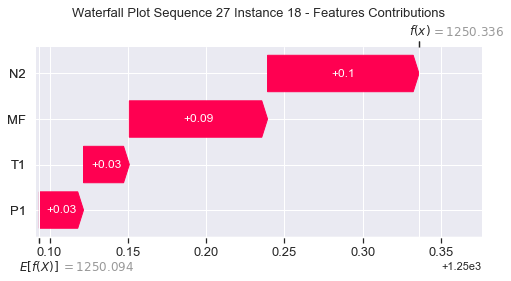

None

Contribution: [0.04657524 0.04642389 0.15720406 0.14318498]


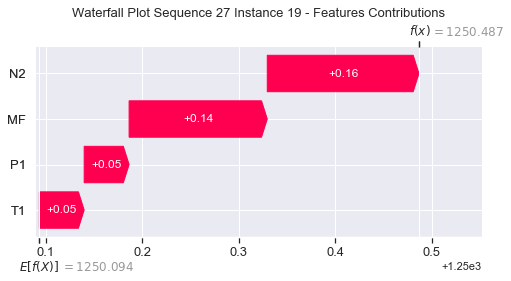

None

Contribution: [0.09045268 0.08993098 0.30288445 0.27924557]


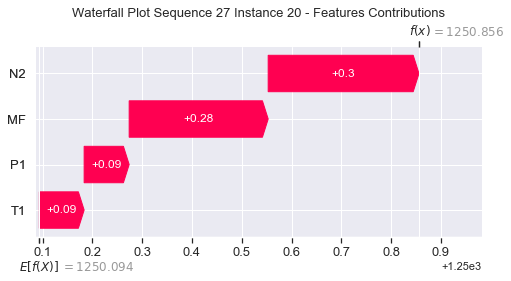

None

Contribution: [0.18881074 0.18540443 0.63014158 0.58191371]


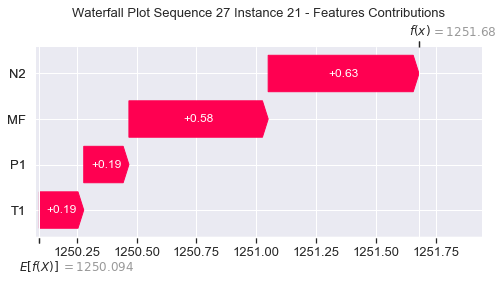

None

Contribution: [0.38380953 0.36841891 1.28189441 1.18806615]


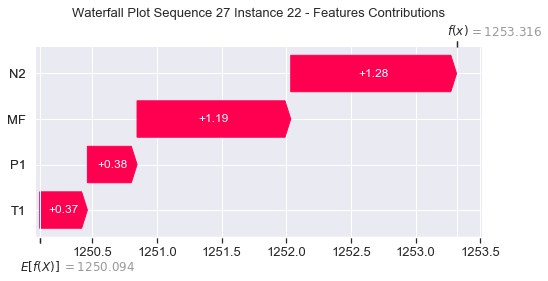

None

Contribution: [0.67945332 0.5748471  2.29202627 2.17912811]


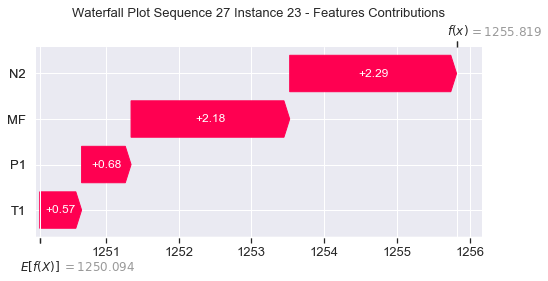

None

Contribution: [0.93974604 0.05288181 3.17980581 3.32836086]


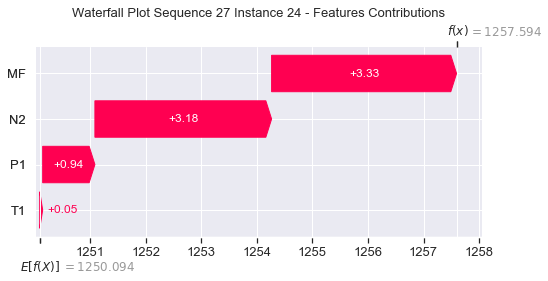

None

Contribution: [0.20029926 0.02870367 0.73189691 0.67053103]


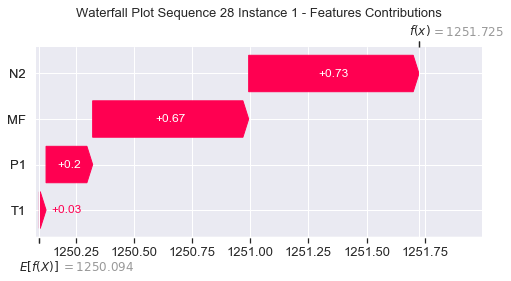

None

Contribution: [0.00336462 0.00336867 0.01066584 0.01025506]


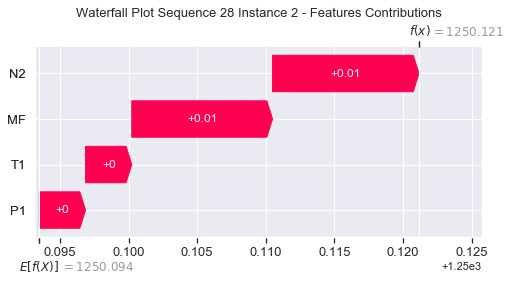

None

Contribution: [0.02397168 0.02924399 0.09397301 0.08448453]


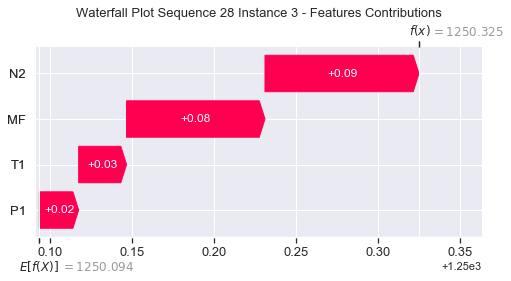

None

Contribution: [0.01856476 0.02191103 0.06616076 0.06008467]


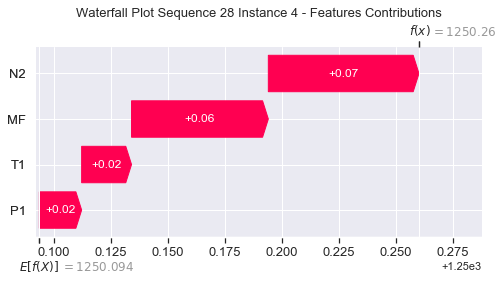

None

Contribution: [0.02191031 0.02464195 0.07624576 0.06973849]


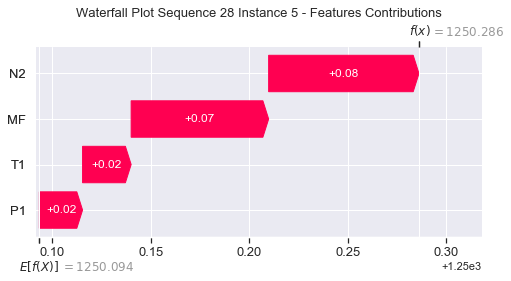

None

Contribution: [0.02252065 0.02677327 0.07935014 0.07214555]


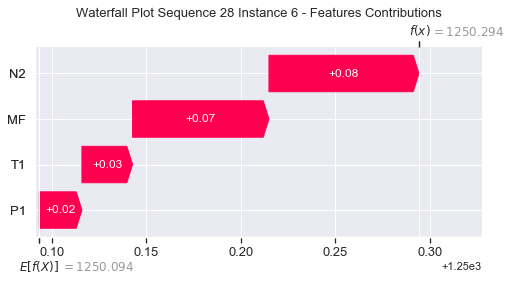

None

Contribution: [0.02150233 0.02648162 0.07650886 0.06956794]


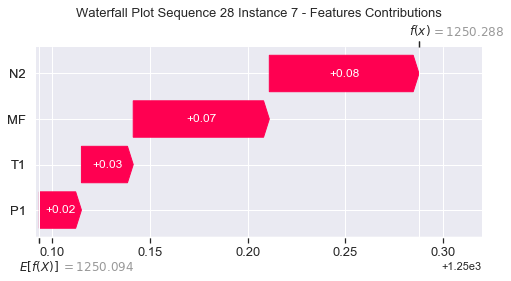

None

Contribution: [0.02031347 0.02394285 0.07144206 0.06489934]


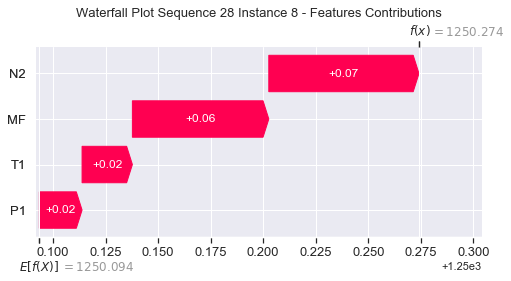

None

Contribution: [0.01903482 0.02426541 0.06756131 0.06127705]


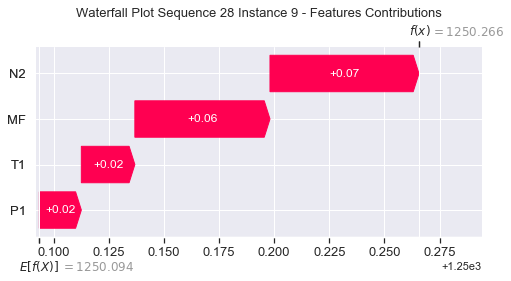

None

Contribution: [0.01855994 0.02241014 0.06380133 0.05861958]


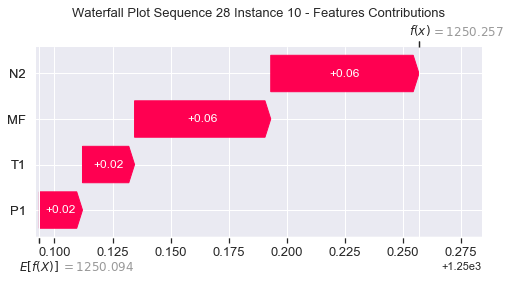

None

Contribution: [0.01762292 0.01968945 0.06066758 0.05469178]


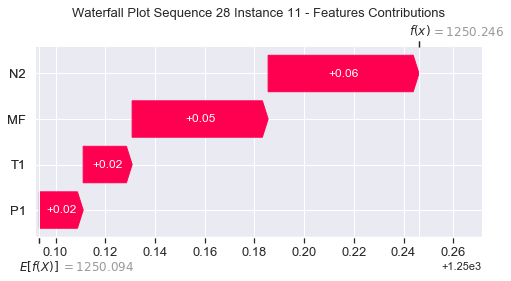

None

Contribution: [0.016842   0.01850097 0.05881927 0.05345315]


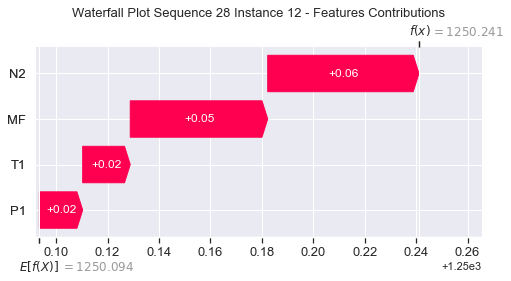

None

Contribution: [0.01668373 0.01828595 0.05826537 0.05299722]


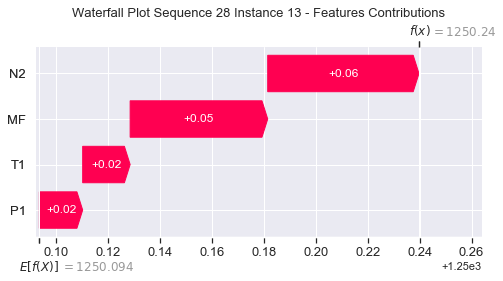

None

Contribution: [0.01623734 0.01762131 0.05792005 0.05166652]


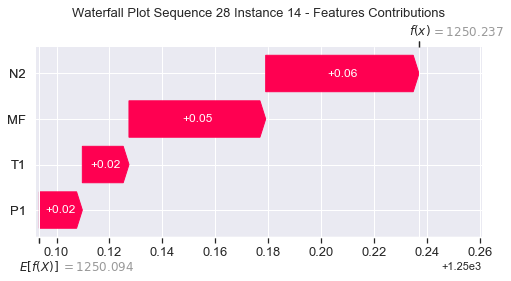

None

Contribution: [0.01723406 0.01786668 0.05957717 0.05407975]


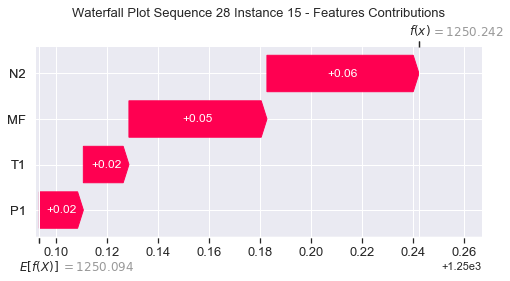

None

Contribution: [0.01874606 0.01953258 0.06355666 0.05838397]


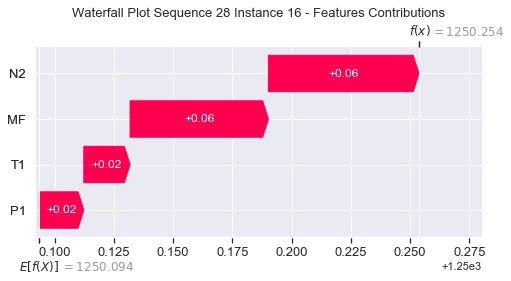

None

Contribution: [0.02141473 0.02107316 0.07305638 0.06659482]


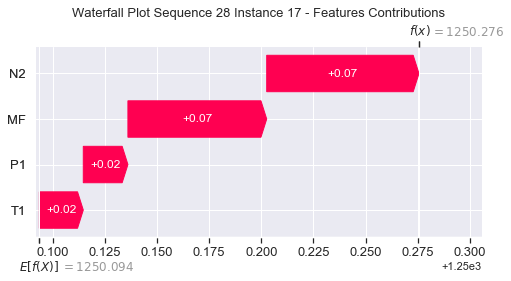

None

Contribution: [0.02916513 0.02669052 0.0977215  0.0893554 ]


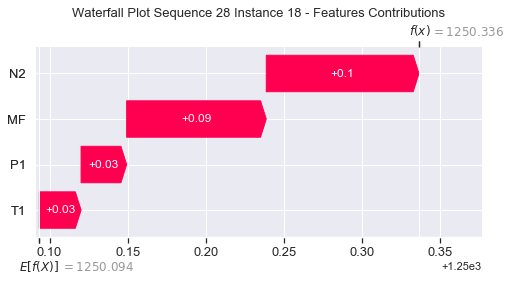

None

Contribution: [0.04747708 0.04174725 0.15980064 0.1468586 ]


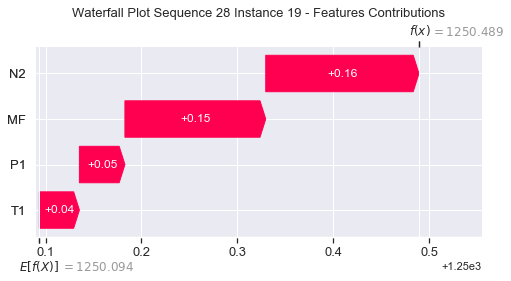

None

Contribution: [0.09494665 0.07849982 0.30889    0.28506705]


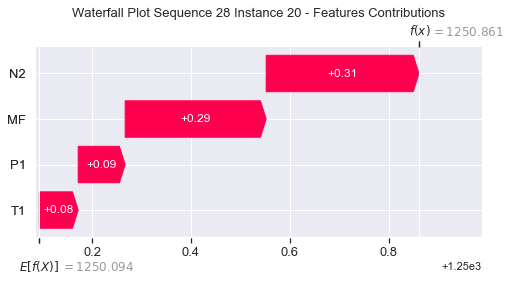

None

Contribution: [0.20037739 0.15610335 0.64313532 0.59580919]


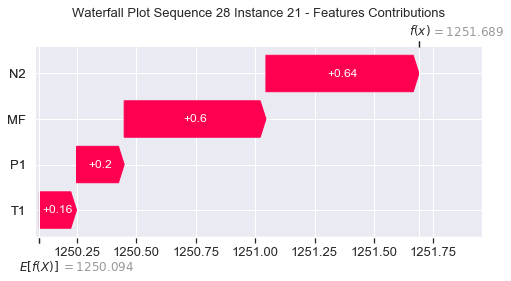

None

Contribution: [0.41561376 0.27887568 1.30665357 1.21761552]


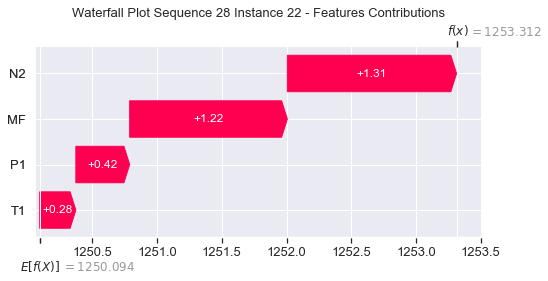

None

Contribution: [0.76303329 0.26567982 2.32941293 2.21909717]


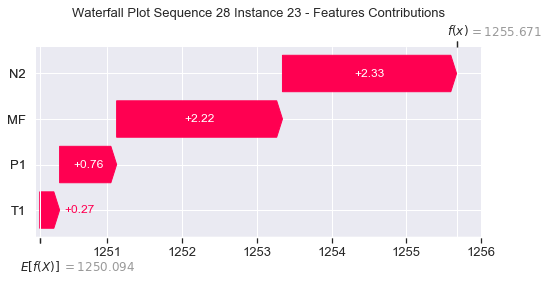

None

Contribution: [ 1.57426703 -1.92635165  3.30006986  3.75755961]


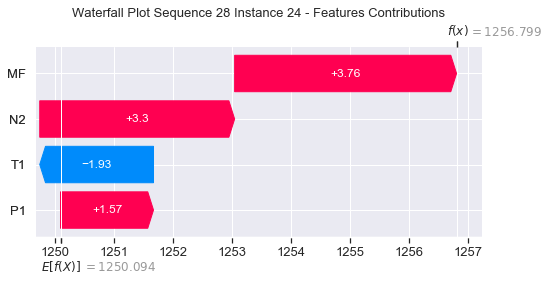

None

Contribution: [ 0.4494907  -0.48958464  0.79752339  0.95862207]


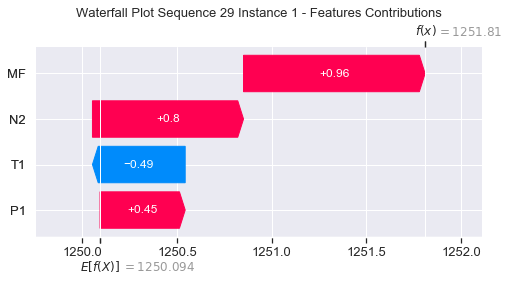

None

Contribution: [0.0042563  0.00130077 0.0110018  0.01115136]


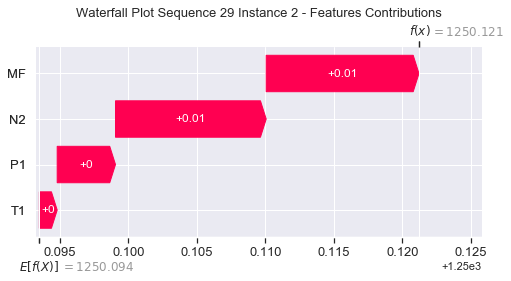

None

Contribution: [0.02938066 0.01514146 0.09762517 0.09072449]


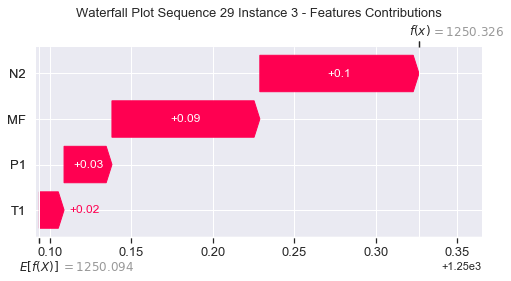

None

Contribution: [0.02172602 0.0121662  0.06754805 0.06334371]


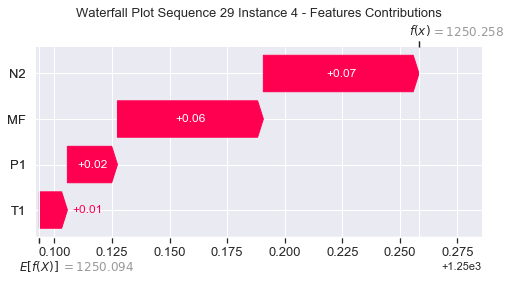

None

Contribution: [0.0233228  0.01363924 0.07595944 0.06812446]


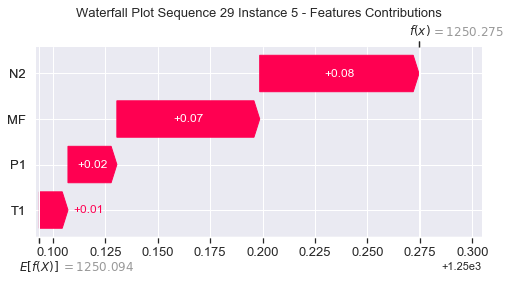

None

Contribution: [0.02647316 0.01312084 0.08104247 0.07500065]


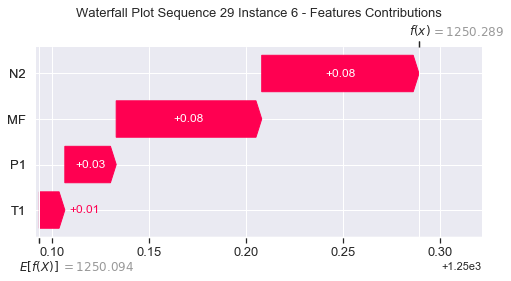

None

Contribution: [0.02567278 0.01241499 0.07839552 0.07258592]


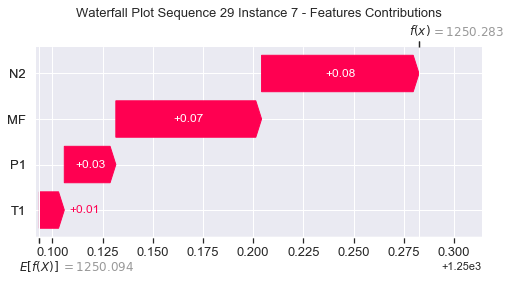

None

Contribution: [0.02355092 0.01236921 0.07302693 0.06725824]


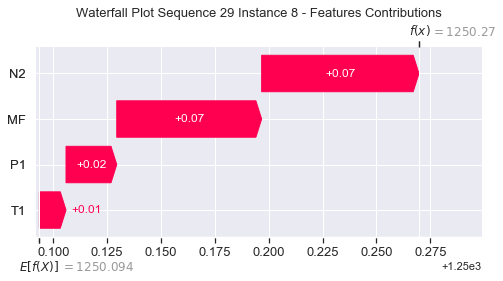

None

Contribution: [0.02166685 0.01074688 0.06771683 0.06173391]


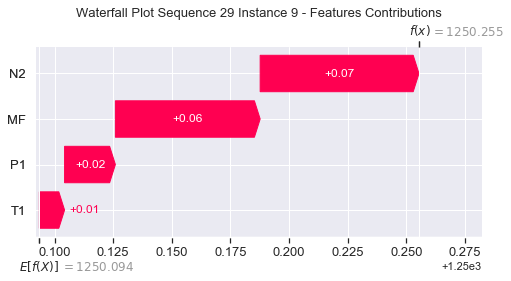

None

Contribution: [0.01873284 0.01035121 0.06329289 0.05638002]


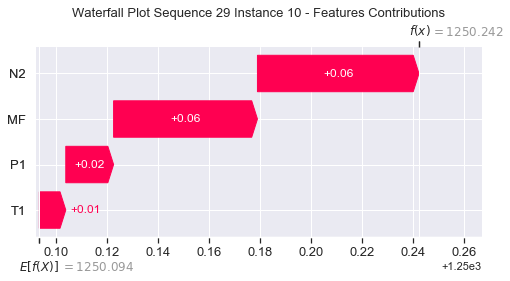

None

Contribution: [0.01999907 0.01024126 0.0621101  0.05735132]


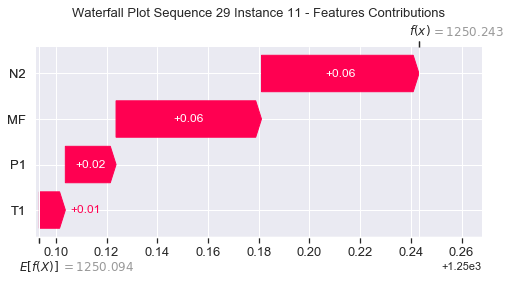

None

Contribution: [0.01985763 0.00984826 0.06070625 0.05691304]


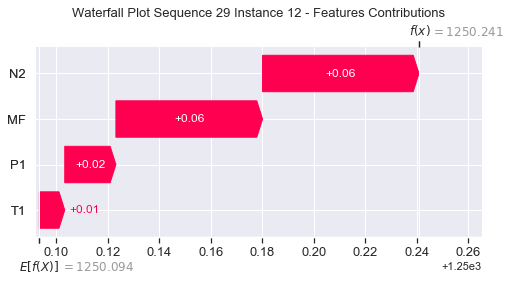

None

Contribution: [0.01942728 0.01032068 0.0601711  0.05602788]


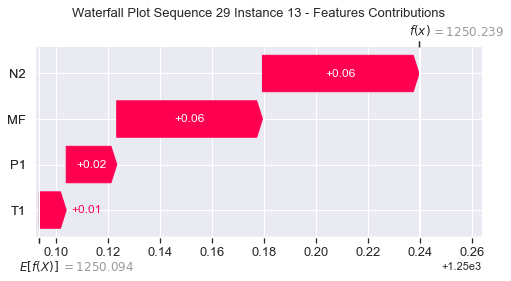

None

Contribution: [0.02060011 0.01101869 0.06063439 0.05713453]


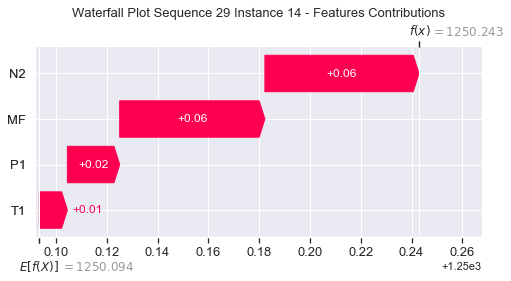

None

Contribution: [0.01968734 0.01159256 0.06141094 0.0570934 ]


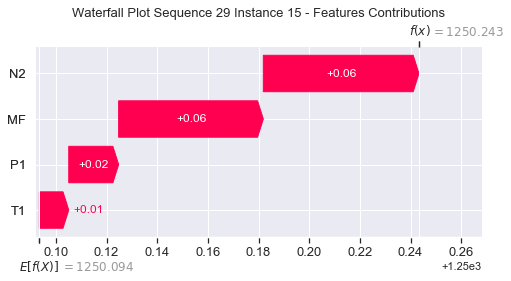

None

Contribution: [0.02128214 0.0105874  0.06515047 0.0610566 ]


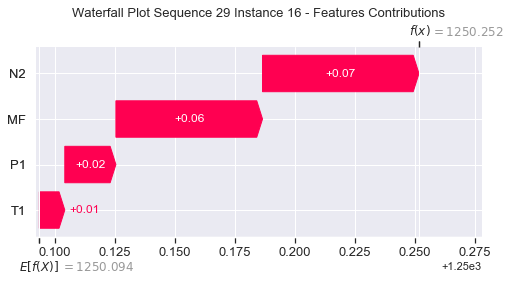

None

Contribution: [0.02382643 0.01514322 0.07498982 0.06963178]


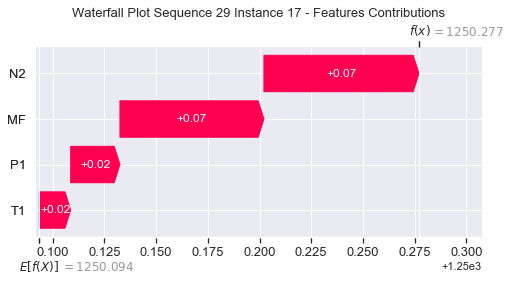

None

Contribution: [0.03167312 0.02122079 0.09999319 0.09292808]


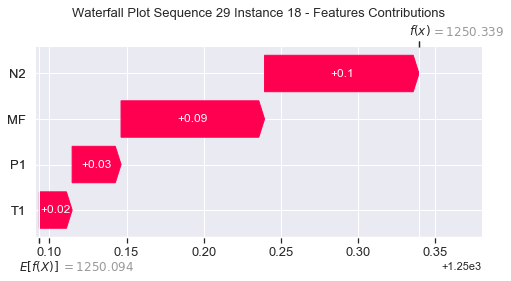

None

Contribution: [0.04957493 0.04003065 0.16179681 0.1480598 ]


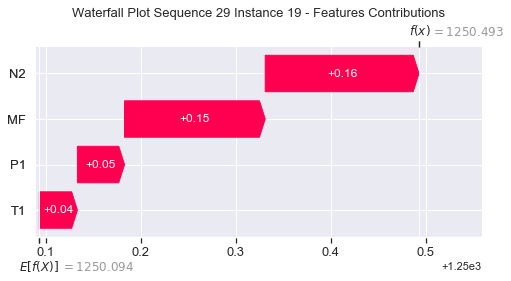

None

Contribution: [0.09628802 0.07319019 0.31162131 0.28686736]


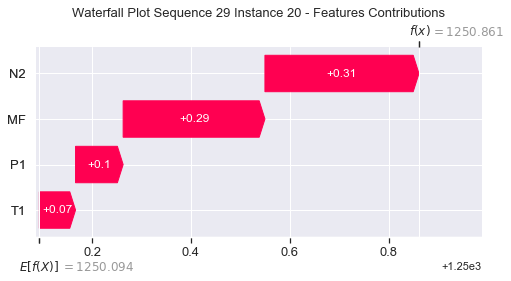

None

Contribution: [0.19904501 0.15262086 0.64536068 0.59508415]


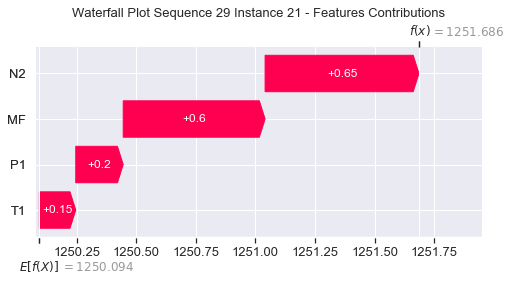

None

Contribution: [0.39801678 0.30465561 1.30527682 1.20371882]


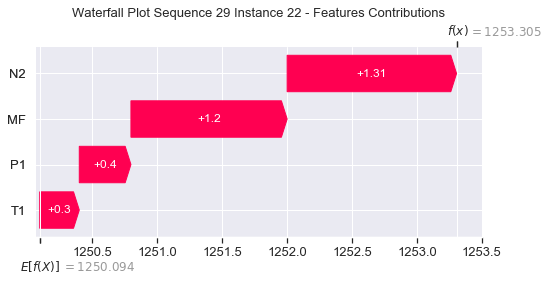

None

Contribution: [0.71992235 0.3666341  2.32882783 2.21045587]


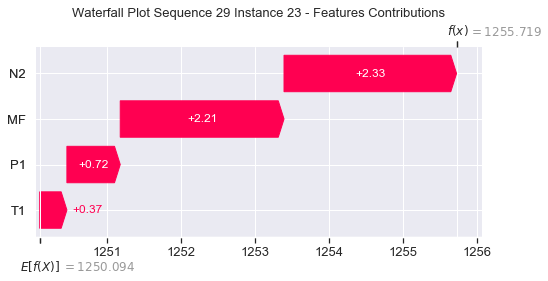

None

Contribution: [ 0.94526545 -0.59109539  3.24990432  3.23752174]


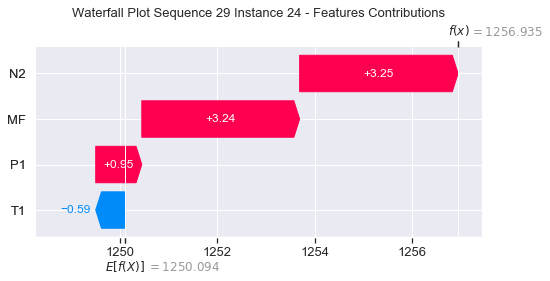

None

Contribution: [ 0.20572181 -0.05074249  0.756166    0.70940914]


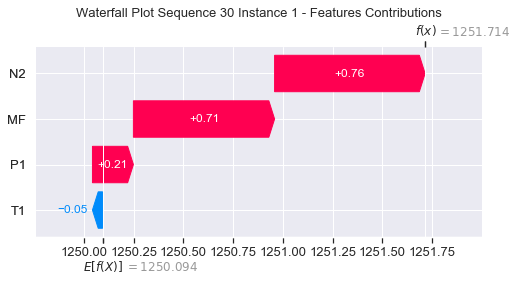

None

Contribution: [0.00330258 0.00261389 0.01063993 0.01012004]


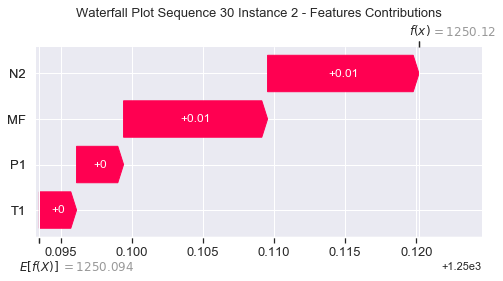

None

Contribution: [0.02472484 0.02521185 0.09458606 0.08523953]


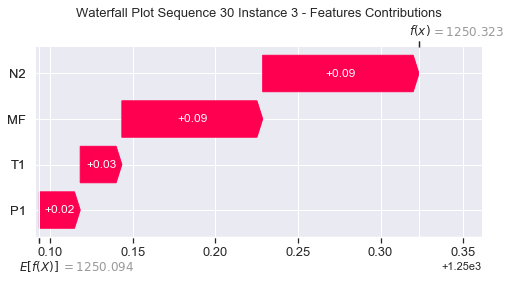

None

Contribution: [0.01640755 0.01742583 0.06414277 0.05642939]


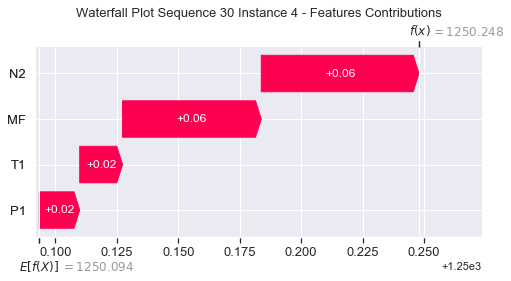

None

Contribution: [0.02131185 0.02437617 0.07605447 0.06839918]


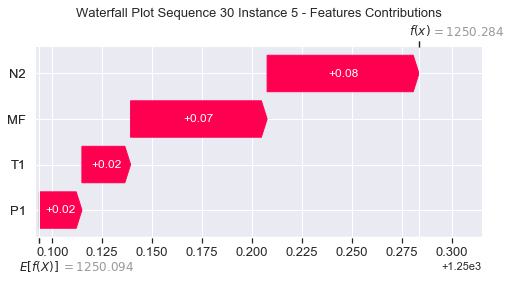

None

Contribution: [0.02225838 0.02494033 0.07965264 0.07144942]


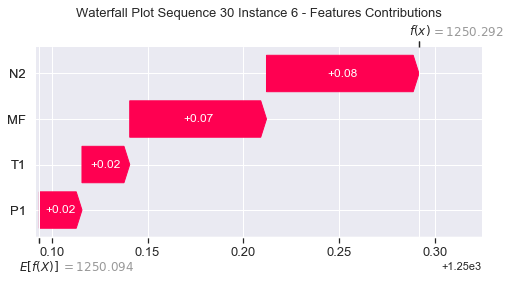

None

Contribution: [0.02150068 0.02414401 0.07688379 0.06894169]


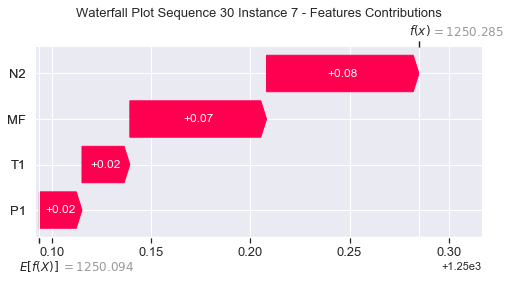

None

Contribution: [0.0200864  0.02267798 0.07183356 0.0643893 ]


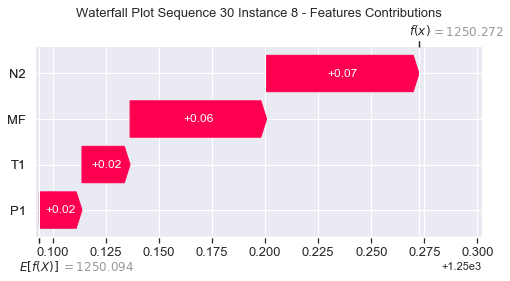

None

Contribution: [0.0189389  0.02201752 0.0672939  0.06047473]


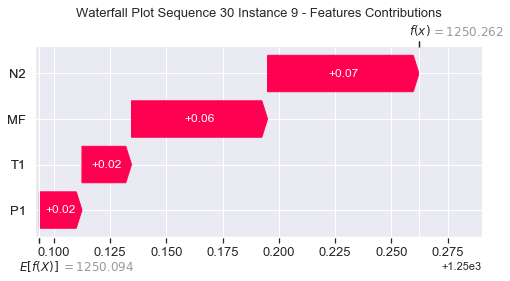

None

Contribution: [0.01798831 0.02010492 0.06351088 0.05668255]


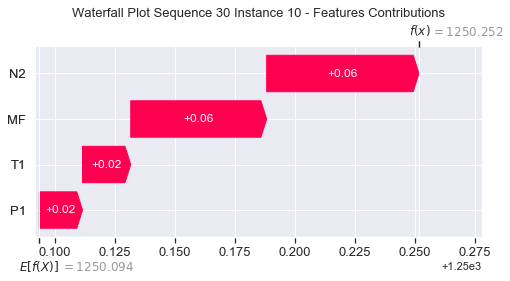

None

Contribution: [0.01694578 0.01938275 0.0608786  0.05445039]


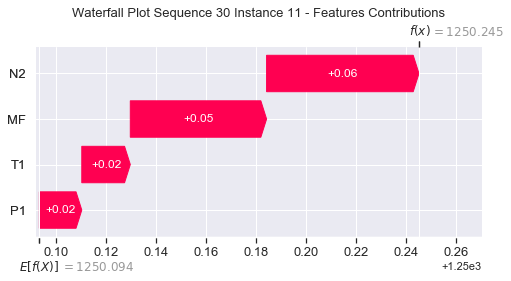

None

Contribution: [0.01634826 0.01810336 0.05904081 0.05259098]


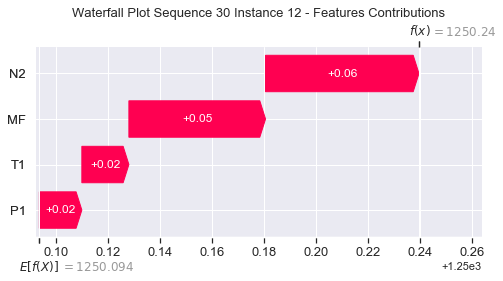

None

Contribution: [0.01626132 0.0180043  0.0584615  0.05213856]


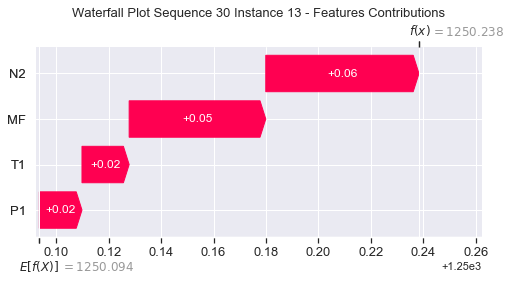

None

Contribution: [0.01635069 0.01730418 0.05820018 0.05126574]


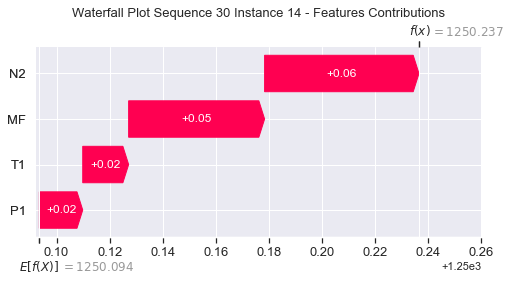

None

Contribution: [0.01675865 0.01832145 0.05989396 0.05349783]


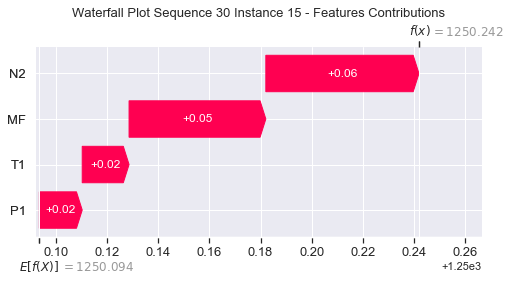

None

Contribution: [0.01825764 0.01948206 0.06383693 0.05789854]


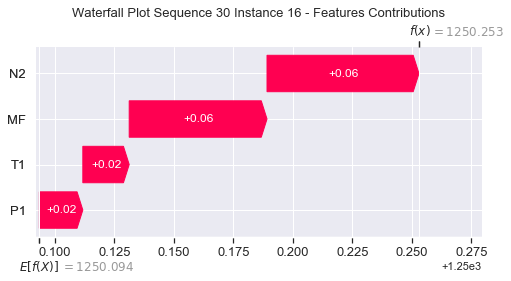

None

Contribution: [0.02084018 0.02181377 0.07323009 0.06574217]


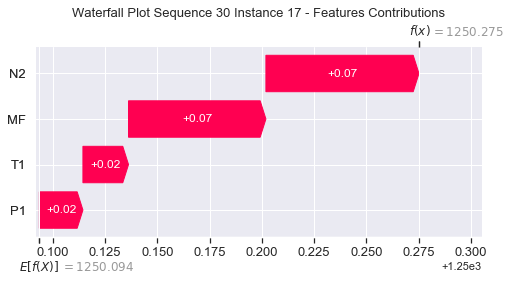

None

Contribution: [0.02820854 0.02840073 0.0977673  0.08818293]


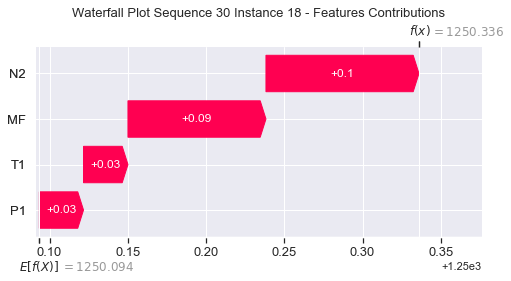

None

Contribution: [0.04715596 0.04672064 0.15926349 0.14519944]


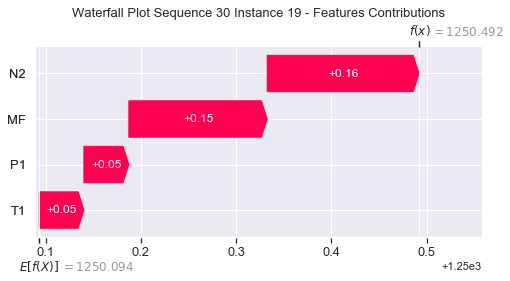

None

Contribution: [0.09097452 0.08743419 0.30657326 0.27965201]


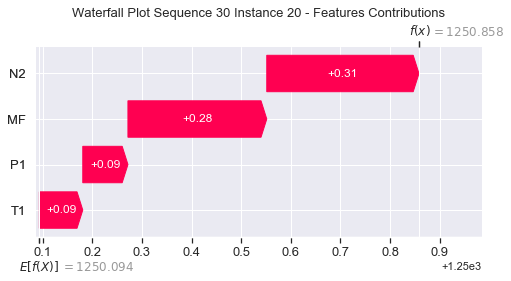

None

Contribution: [0.18985435 0.18034807 0.63687119 0.58232665]


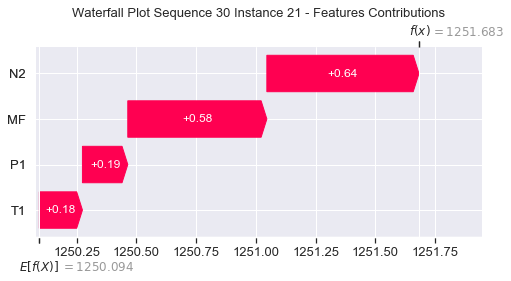

None

Contribution: [0.38567242 0.35754561 1.29309796 1.18638023]


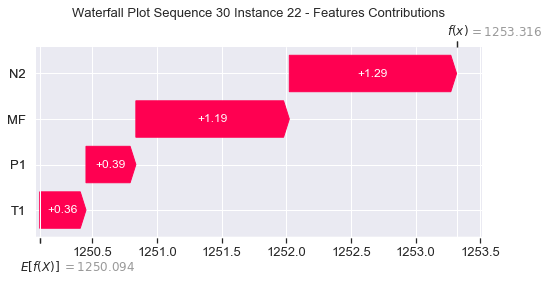

None

Contribution: [0.67272683 0.51975261 2.30662066 2.14224533]


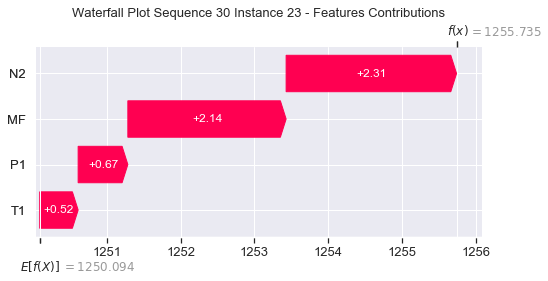

None

Contribution: [ 0.96798848 -0.17651971  3.21746997  3.23716082]


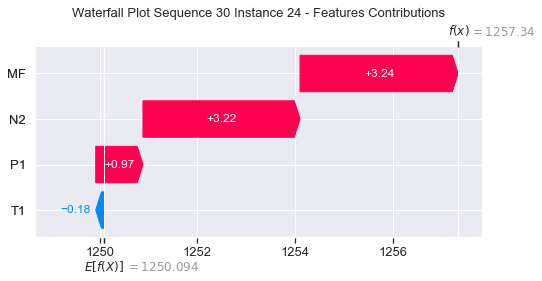

None

Contribution: [0.24133199 0.00370864 0.74774355 0.72784538]


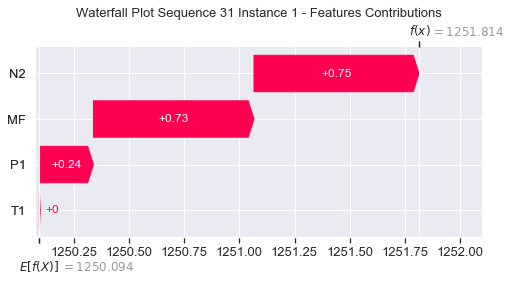

None

Contribution: [0.00340638 0.00321474 0.01069912 0.01014081]


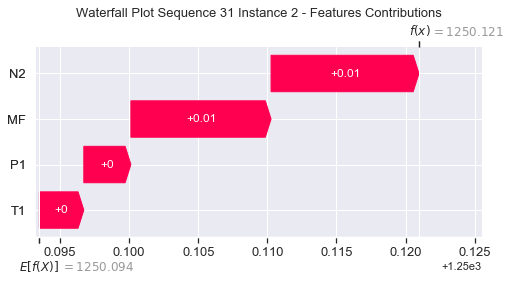

None

Contribution: [0.02462874 0.02967364 0.09485191 0.0854402 ]


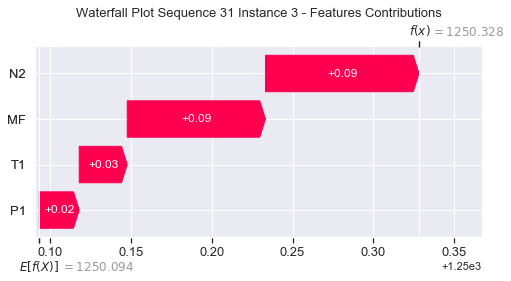

None

Contribution: [0.0178005  0.02180125 0.06592709 0.05861954]


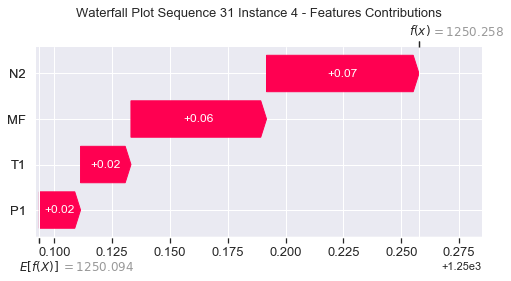

None

Contribution: [0.02123391 0.02426392 0.07614151 0.0683386 ]


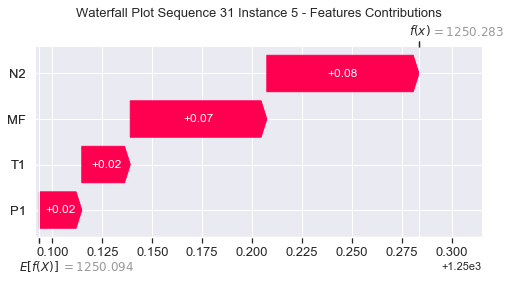

None

Contribution: [0.02168381 0.02489678 0.07879338 0.07008162]


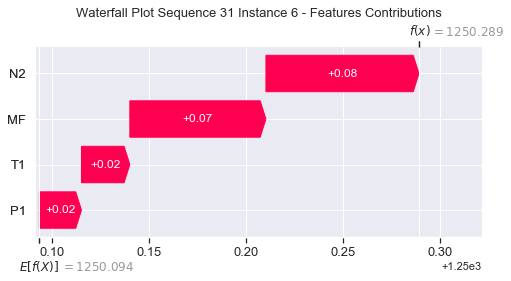

None

Contribution: [0.02098654 0.02404911 0.07590621 0.06749662]


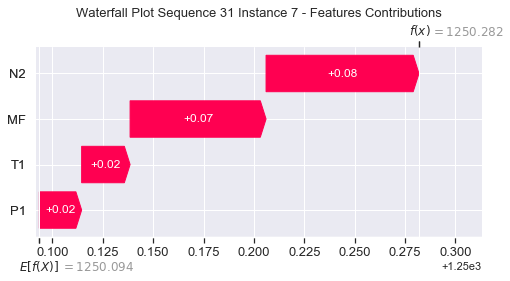

None

Contribution: [0.01974316 0.02255939 0.07104061 0.0634219 ]


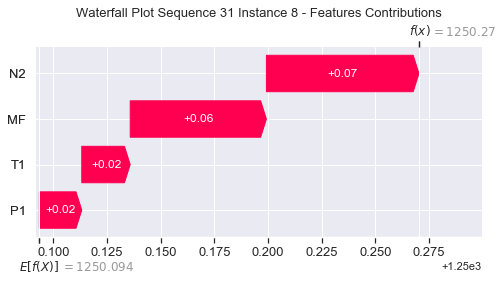

None

Contribution: [0.01927338 0.02138216 0.06686061 0.06076559]


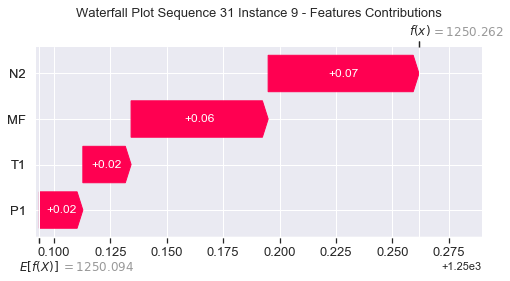

None

Contribution: [0.01785069 0.02052711 0.06289495 0.05637584]


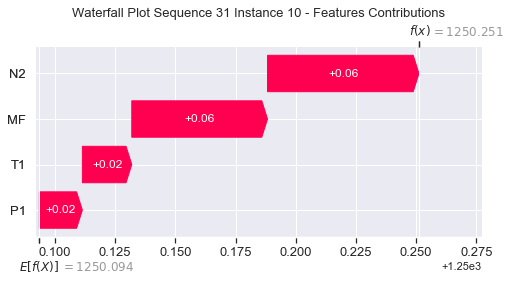

None

Contribution: [0.01710826 0.01914962 0.0603564  0.05458578]


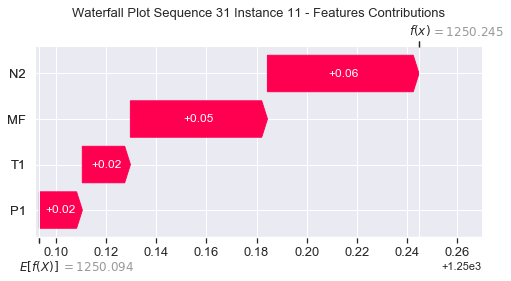

None

Contribution: [0.01606898 0.01821064 0.05827091 0.05161913]


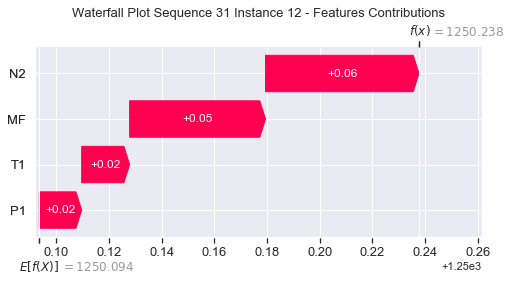

None

Contribution: [0.01606678 0.01806381 0.05783452 0.05138649]


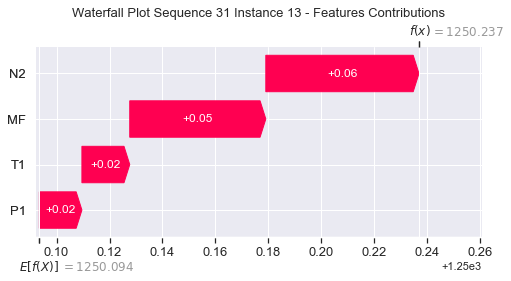

None

Contribution: [0.01607331 0.01734903 0.05789331 0.05198826]


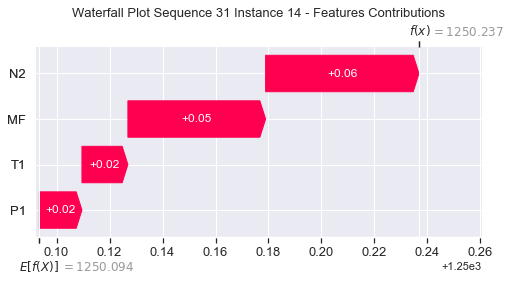

None

Contribution: [0.01655356 0.01837957 0.05928565 0.05286133]


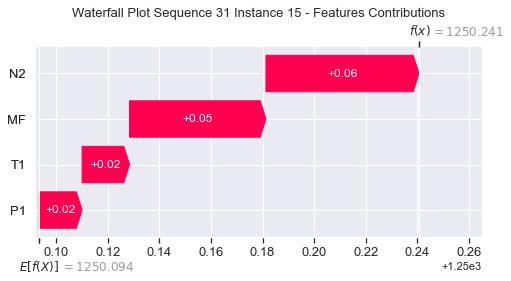

None

Contribution: [0.01801128 0.02021514 0.06336336 0.05735237]


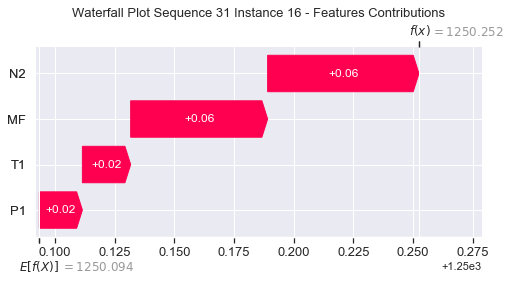

None

Contribution: [0.020748   0.02186403 0.07265091 0.06523998]


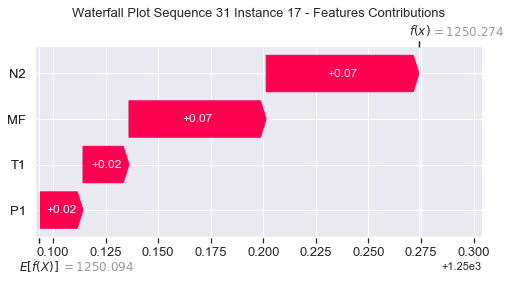

None

Contribution: [0.02811012 0.02847543 0.09707627 0.08766395]


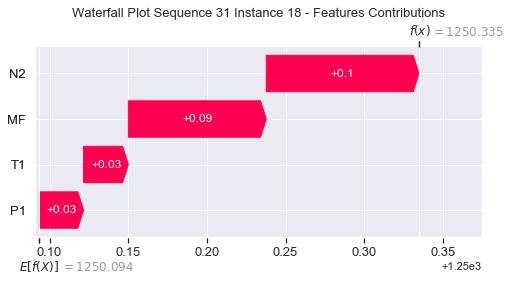

None

Contribution: [0.04629068 0.04537077 0.15852931 0.14240649]


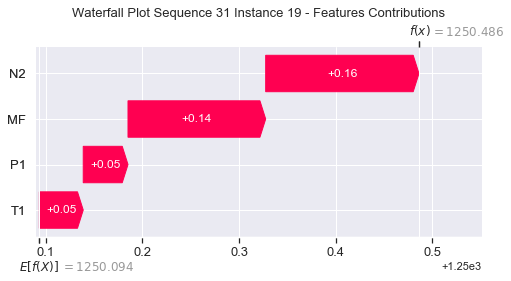

None

Contribution: [0.09138032 0.08697163 0.30470827 0.27938971]


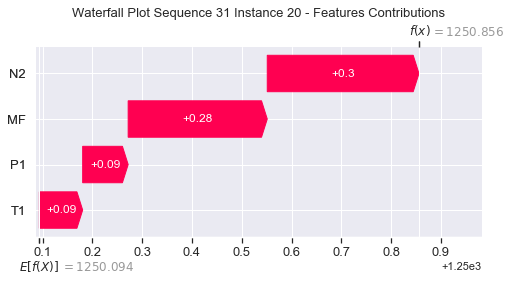

None

Contribution: [0.19126503 0.17955843 0.63350073 0.58323995]


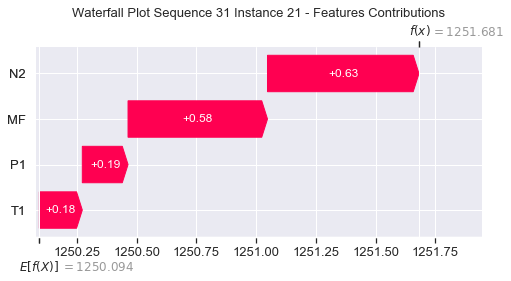

None

Contribution: [0.39064353 0.35672955 1.28877498 1.19409308]


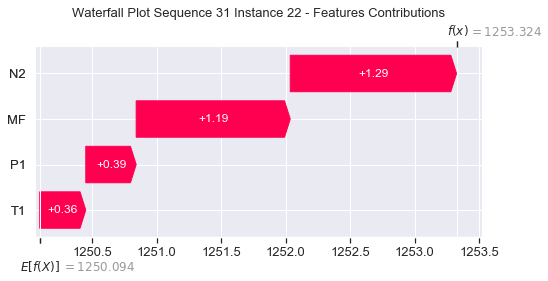

None

Contribution: [0.68935043 0.52626488 2.30569141 2.17387247]


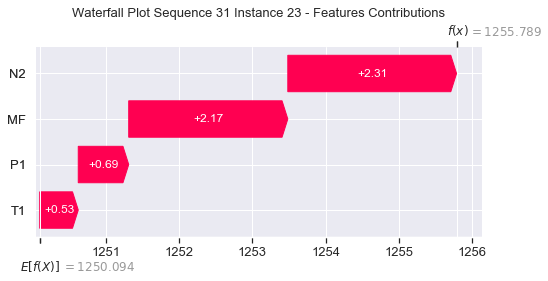

None

Contribution: [ 0.97583956 -0.299937    3.22774674  3.27644744]


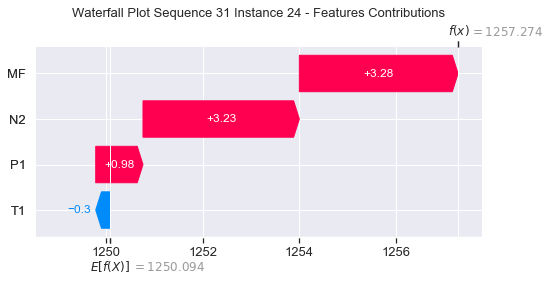

None

Contribution: [ 0.19947137 -0.09813708  0.74194474  0.64948111]


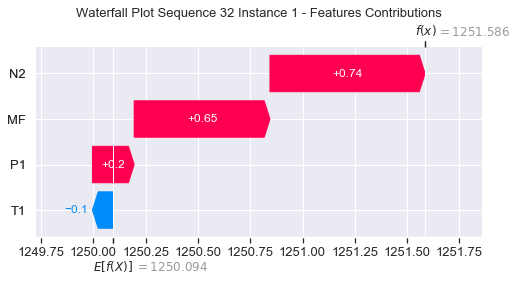

None

Contribution: [0.00371928 0.00324067 0.01106786 0.0110117 ]


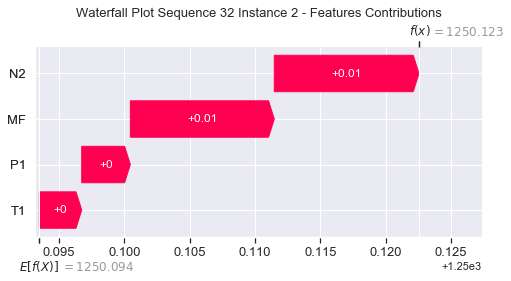

None

Contribution: [0.0240604  0.02857702 0.09446396 0.08516921]


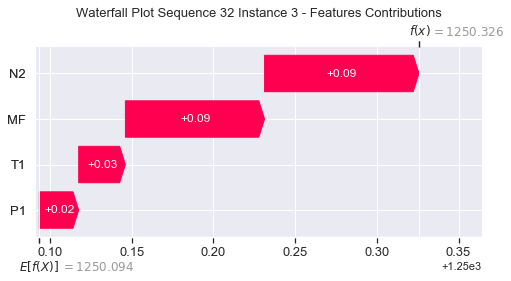

None

Contribution: [0.01828809 0.02126789 0.06647086 0.05899576]


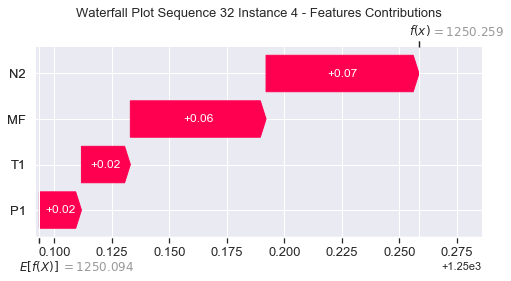

None

Contribution: [0.02186271 0.02406333 0.07722556 0.07021347]


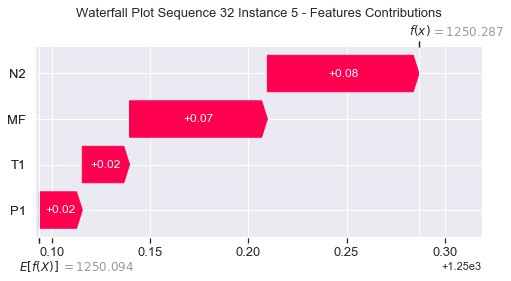

None

Contribution: [0.02268774 0.02462019 0.08027154 0.07277417]


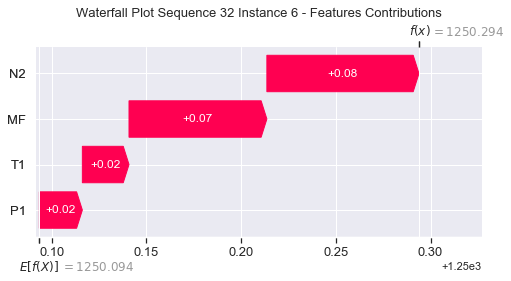

None

Contribution: [0.02182215 0.02379767 0.07726096 0.07010643]


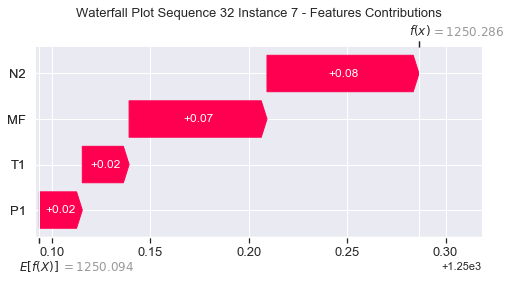

None

Contribution: [0.02022478 0.02216948 0.07184071 0.0649861 ]


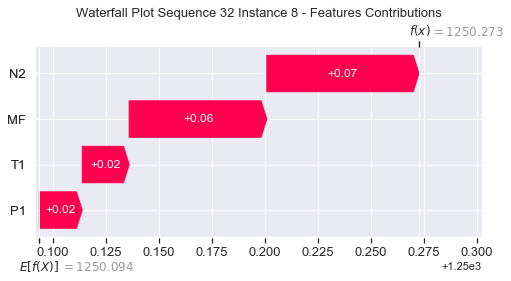

None

Contribution: [0.01821205 0.02113039 0.06639853 0.05931284]


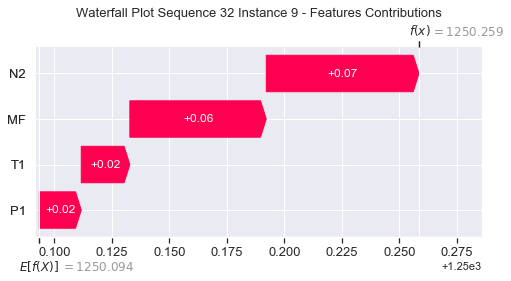

None

Contribution: [0.01683875 0.01982766 0.06218075 0.05503902]


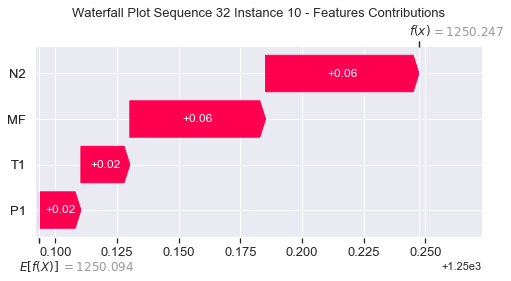

None

Contribution: [0.0166422  0.01883376 0.06036971 0.05386883]


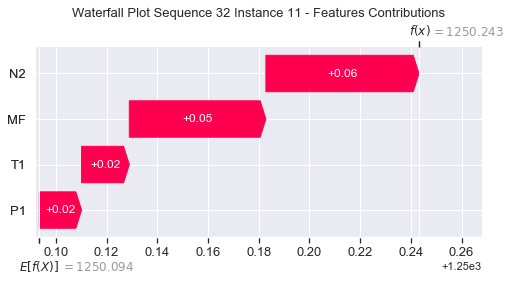

None

Contribution: [0.01684413 0.01843183 0.05954706 0.05416413]


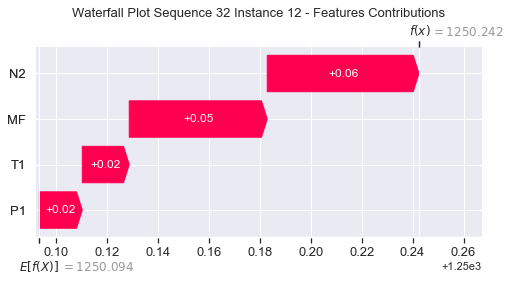

None

Contribution: [0.01669202 0.01821594 0.05902357 0.05363985]


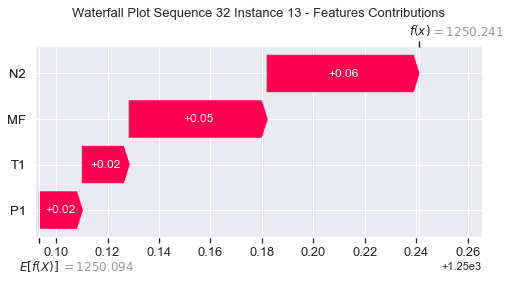

None

Contribution: [0.01643286 0.01890411 0.05887454 0.05284514]


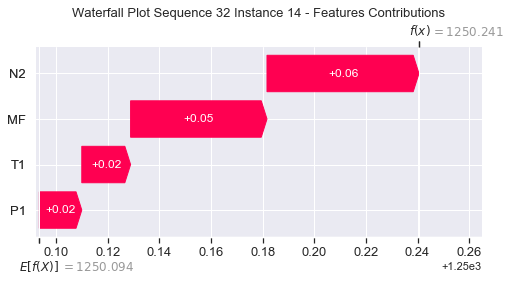

None

Contribution: [0.01697169 0.01806066 0.06007071 0.05438036]


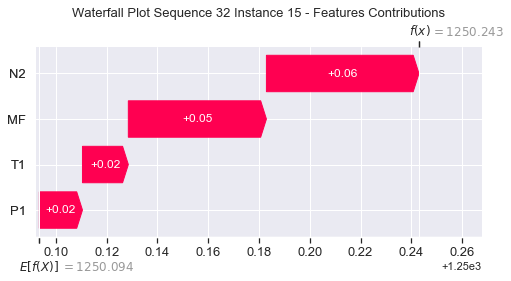

None

Contribution: [0.0177462  0.01866812 0.06350176 0.05674764]


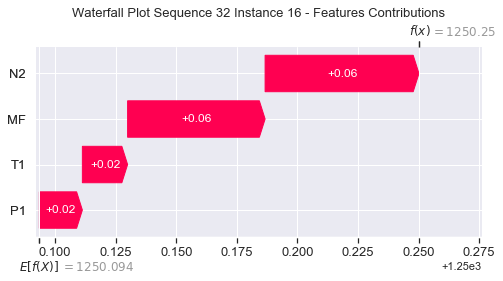

None

Contribution: [0.02104718 0.02140173 0.07347225 0.06670322]


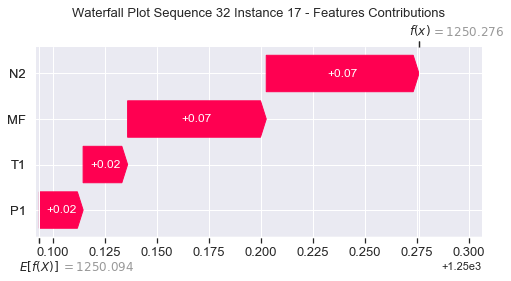

None

Contribution: [0.0284528  0.02768976 0.09808569 0.089276  ]


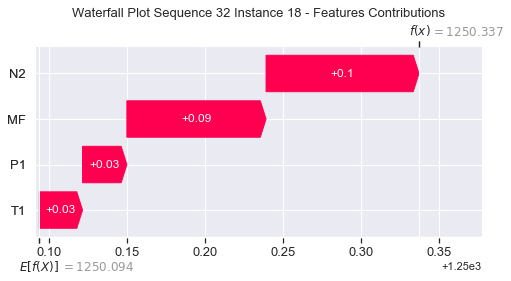

None

Contribution: [0.04517208 0.04172005 0.15916565 0.14432655]


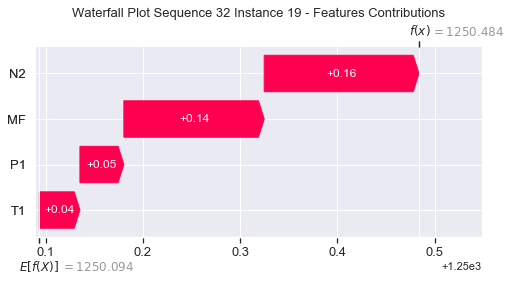

None

Contribution: [0.09120205 0.08343738 0.30761236 0.2817227 ]


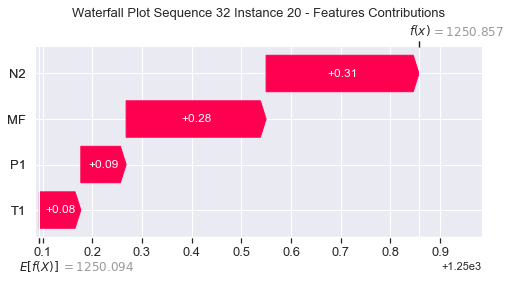

None

Contribution: [0.19090794 0.17259417 0.63955061 0.58779638]


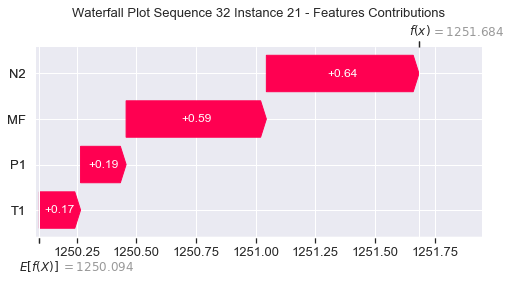

None

Contribution: [0.38908959 0.33757324 1.30161025 1.20078134]


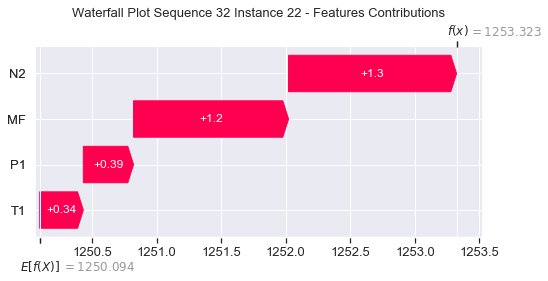

None

Contribution: [0.68493231 0.45873243 2.33721743 2.18946991]


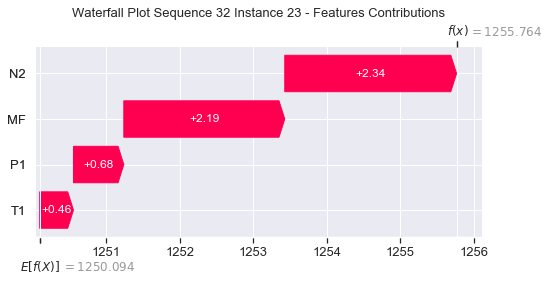

None

Contribution: [ 0.96899057 -0.55961672  3.35246489  3.2880211 ]


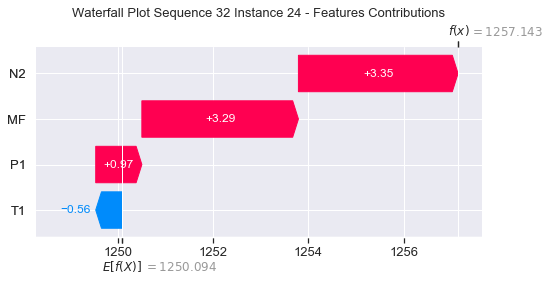

None

Contribution: [ 0.22168405 -0.07082288  0.78070158  0.69129476]


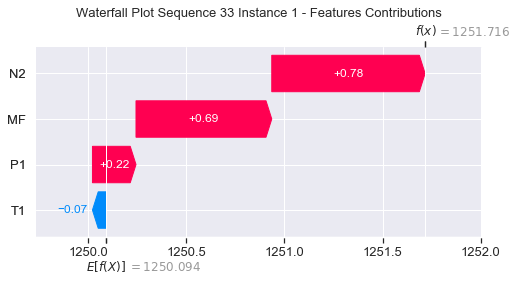

None

Contribution: [0.00365156 0.00304287 0.01137548 0.01114888]


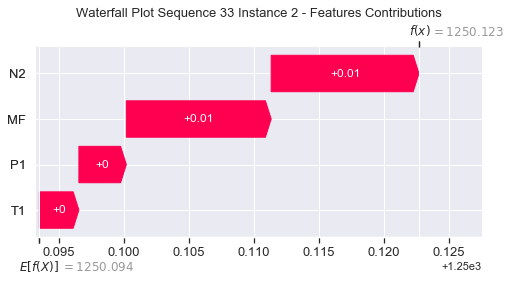

None

Contribution: [0.02454947 0.02725138 0.0975151  0.08708133]


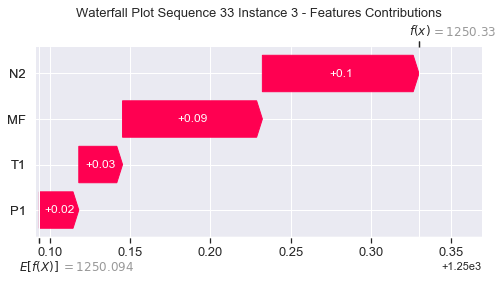

None

Contribution: [0.01893358 0.02237918 0.06850198 0.06142602]


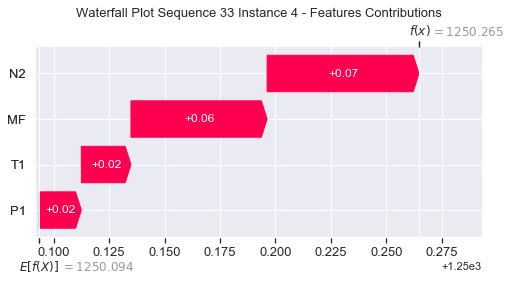

None

Contribution: [0.02110696 0.02325403 0.0777511  0.06899691]


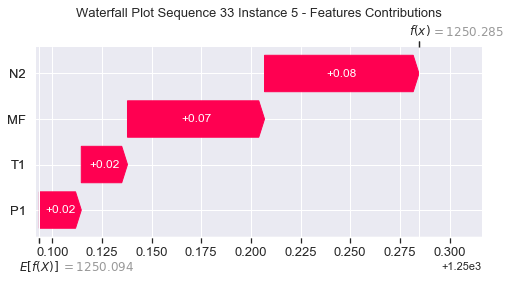

None

Contribution: [0.02267702 0.02441234 0.08139801 0.07311242]


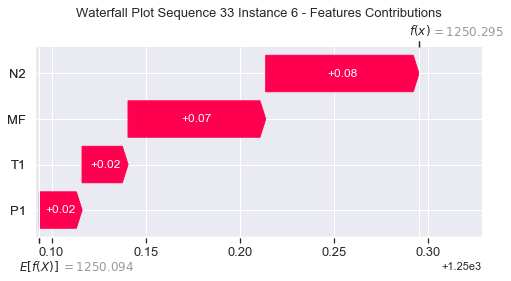

None

Contribution: [0.02167849 0.023267   0.07824616 0.0699678 ]


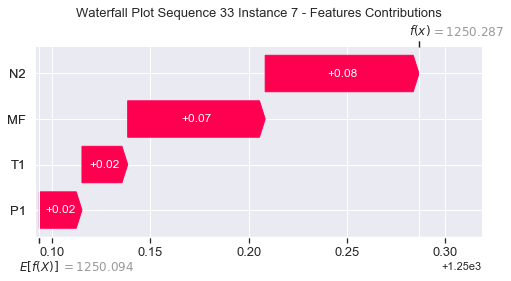

None

Contribution: [0.02013058 0.0217177  0.07290587 0.0652959 ]


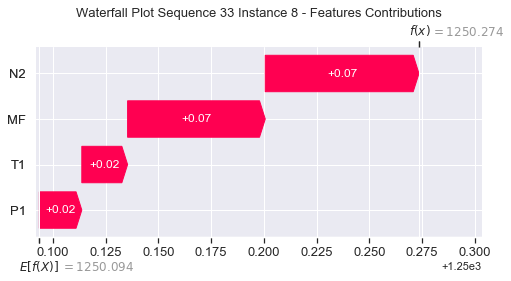

None

Contribution: [0.01793679 0.02013803 0.06774211 0.06017963]


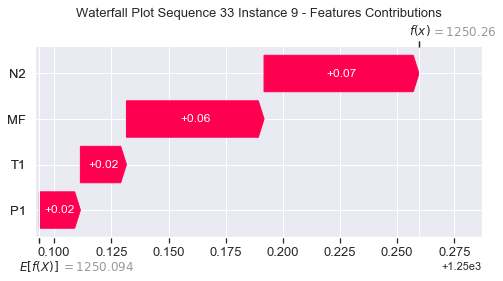

None

Contribution: [0.01734497 0.01959949 0.06382566 0.05647486]


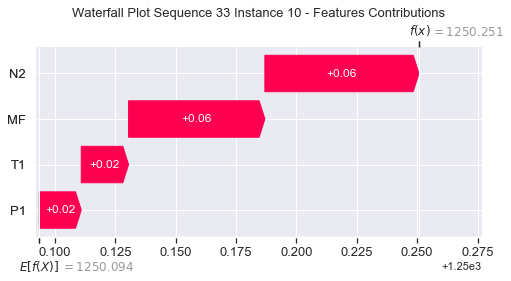

None

Contribution: [0.01694383 0.01851356 0.06200412 0.05628788]


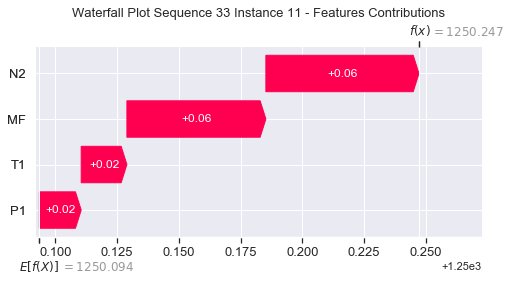

None

Contribution: [0.01678128 0.01711907 0.06004956 0.05409925]


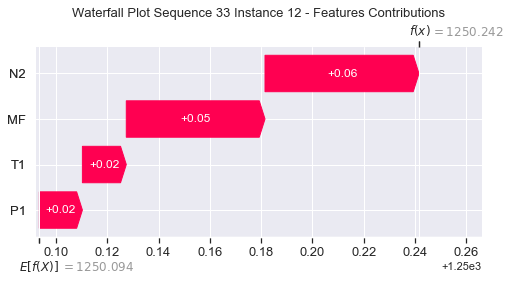

None

Contribution: [0.016495   0.01684444 0.05935226 0.05323639]


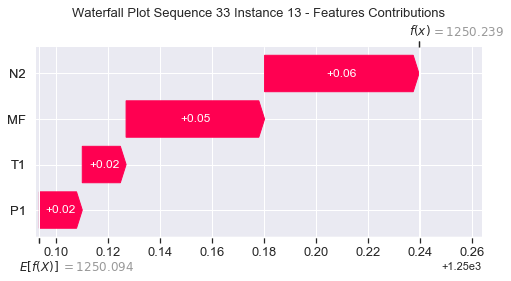

None

Contribution: [0.01645869 0.01659152 0.05905397 0.05245948]


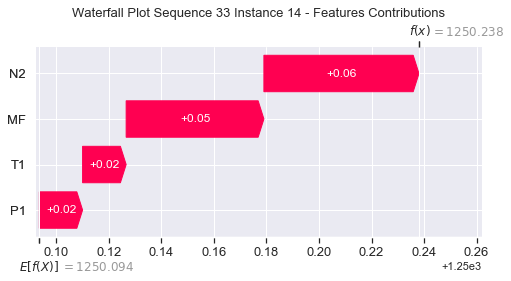

None

Contribution: [0.01697464 0.01699327 0.06064624 0.0545721 ]


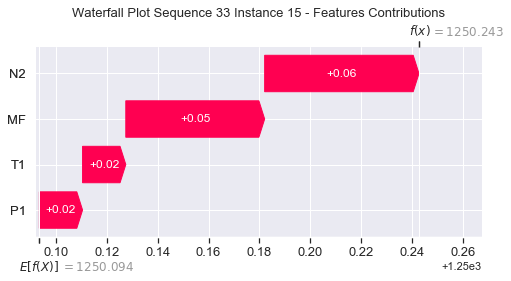

None

Contribution: [0.0179215  0.01832973 0.06414887 0.05736668]


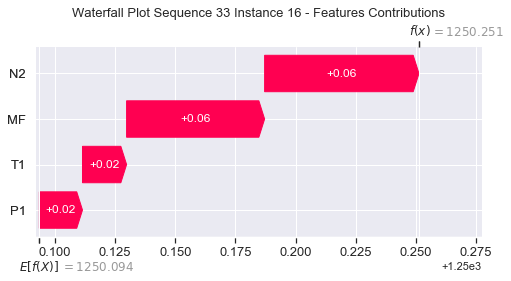

None

Contribution: [0.021009   0.0200879  0.07421715 0.06690677]


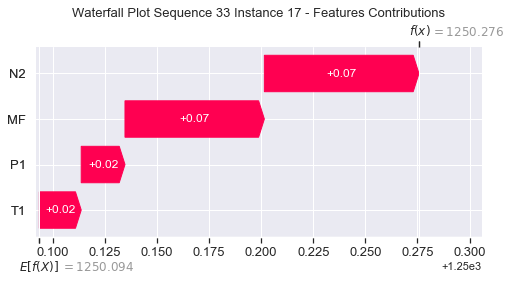

None

Contribution: [0.02859796 0.0263299  0.09941108 0.09018085]


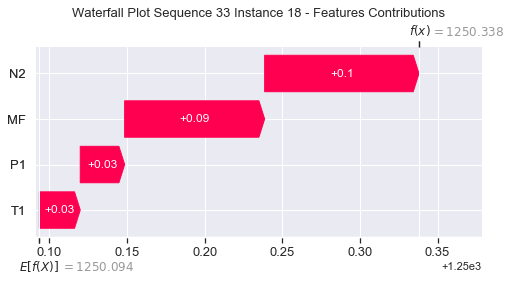

None

Contribution: [0.04653726 0.04205894 0.16212284 0.14591217]


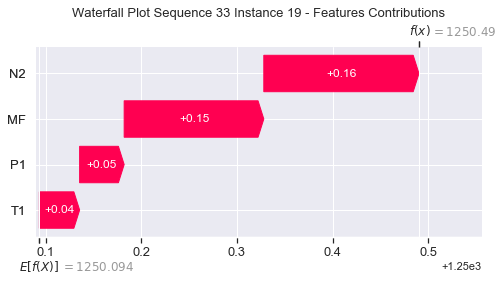

None

Contribution: [0.09123574 0.08009718 0.31289004 0.28495582]


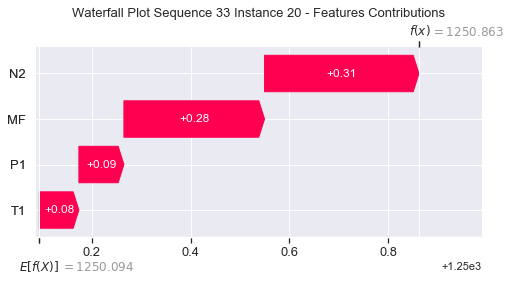

None

Contribution: [0.19002913 0.16331395 0.64839531 0.59282748]


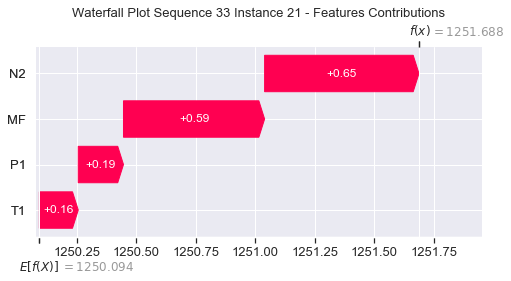

None

Contribution: [0.38383093 0.31198257 1.31066601 1.20555283]


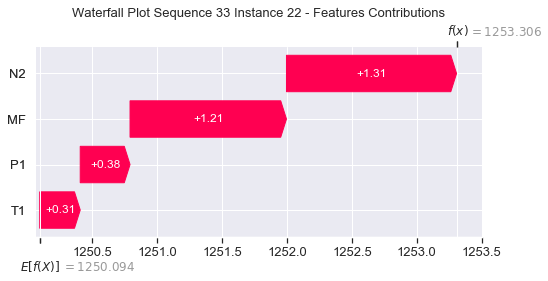

None

Contribution: [0.66558613 0.37474964 2.32412342 2.18619685]


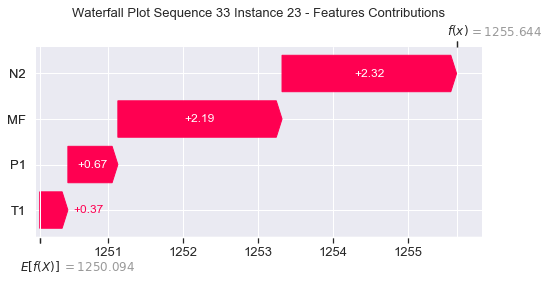

None

Contribution: [ 0.8790112  -0.89072808  3.220938    3.31173829]


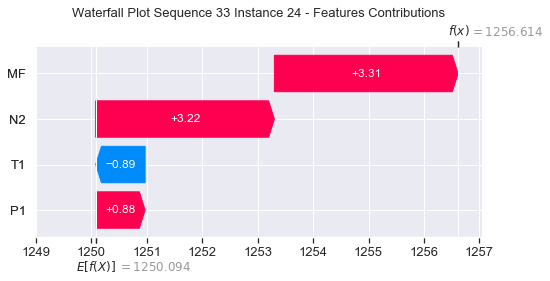

None

Contribution: [ 0.22285749 -0.13830404  0.76955935  0.74478853]


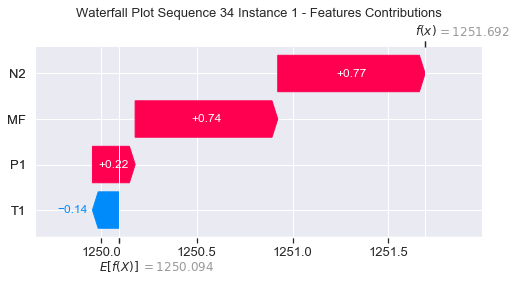

None

Contribution: [0.00336715 0.00228315 0.01110965 0.01059999]


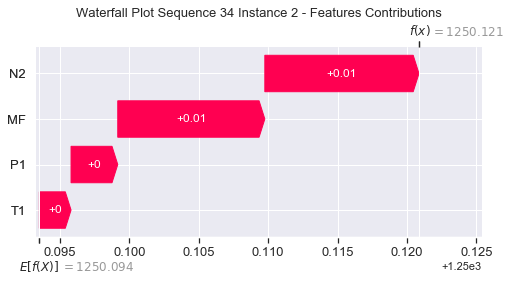

None

Contribution: [0.02527911 0.02413313 0.09844175 0.09002089]


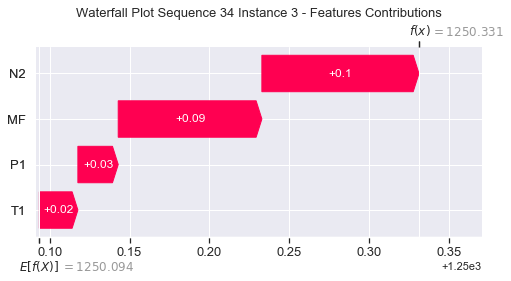

None

Contribution: [0.01804862 0.01872356 0.067367   0.06097096]


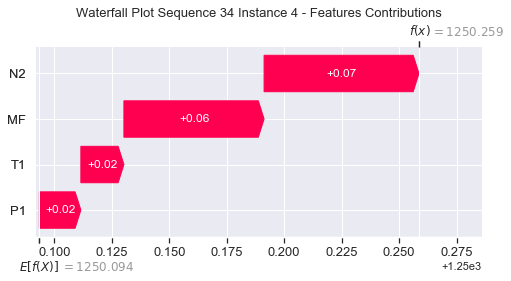

None

Contribution: [0.02081474 0.02123758 0.07721797 0.06854648]


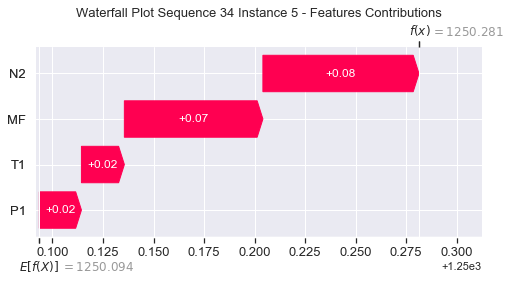

None

Contribution: [0.02207618 0.02251155 0.08159436 0.07292577]


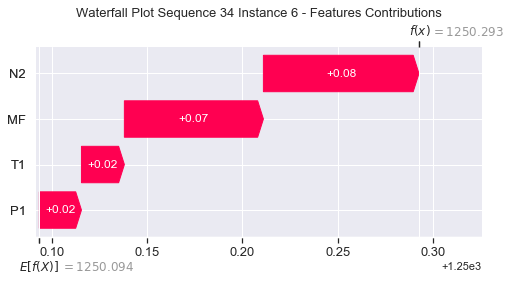

None

Contribution: [0.02138485 0.0218595  0.07902832 0.07058999]


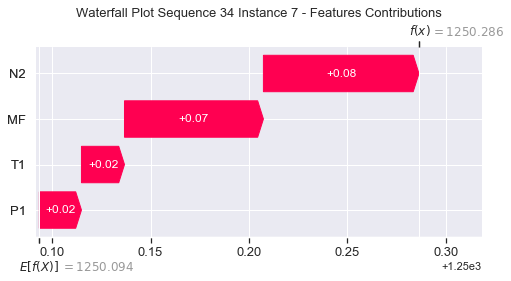

None

Contribution: [0.01983303 0.02030611 0.07377051 0.06583811]


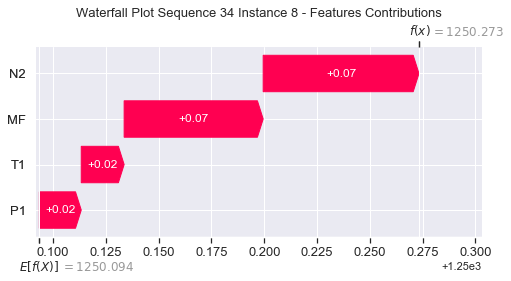

None

Contribution: [0.01805988 0.01884482 0.06902449 0.06148555]


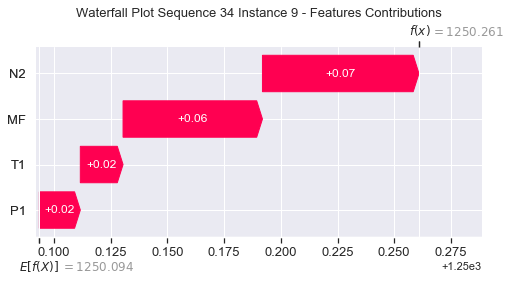

None

Contribution: [0.01690552 0.01739848 0.06509489 0.0581135 ]


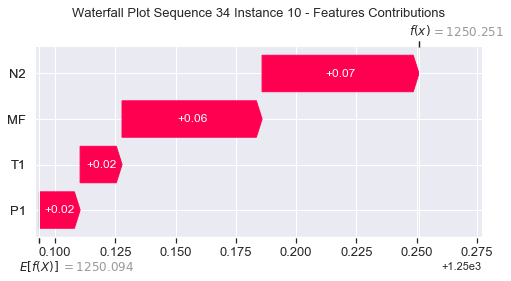

None

Contribution: [0.01614626 0.01692194 0.06255233 0.05585397]


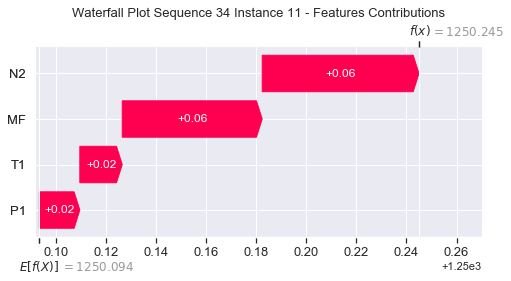

None

Contribution: [0.01597462 0.01664414 0.06083559 0.05415726]


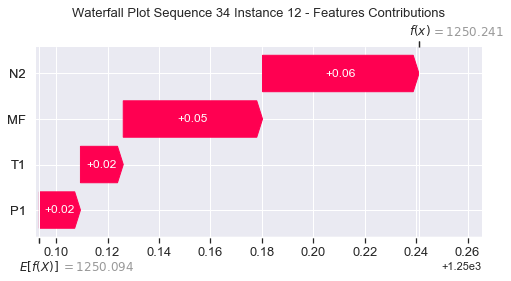

None

Contribution: [0.01589855 0.01640645 0.06018064 0.05355777]


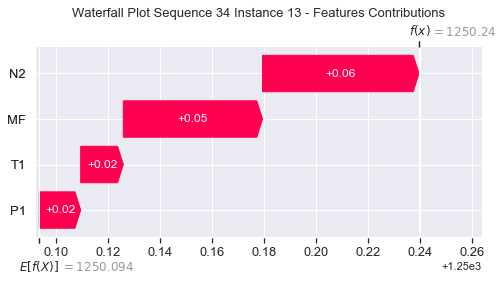

None

Contribution: [0.01523828 0.01589132 0.05993443 0.0524924 ]


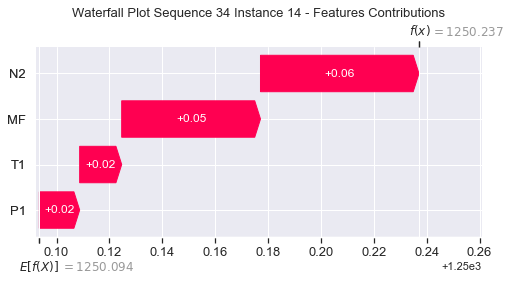

None

Contribution: [0.01653518 0.01665733 0.06163292 0.05503934]


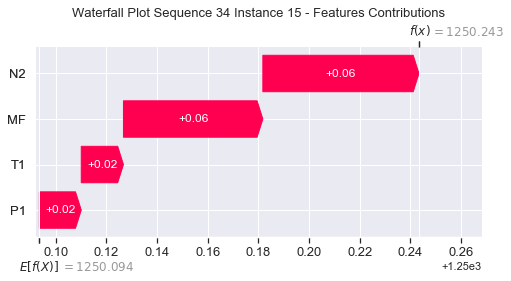

None

Contribution: [0.01821413 0.01683897 0.06577019 0.05931255]


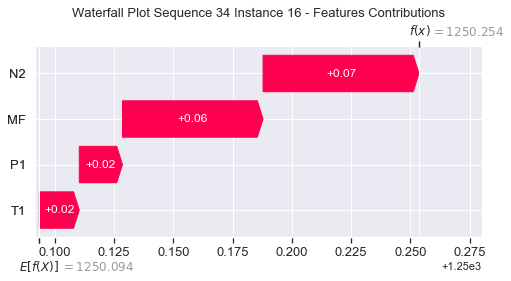

None

Contribution: [0.02072952 0.01985164 0.07552787 0.06785084]


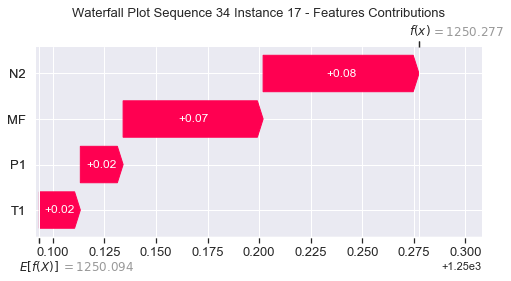

None

Contribution: [0.02821805 0.02593583 0.1009726  0.09120806]


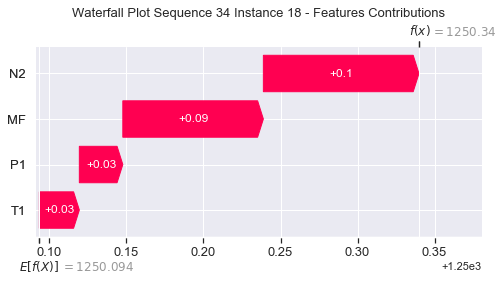

None

Contribution: [0.04587336 0.04016667 0.16445436 0.14786273]


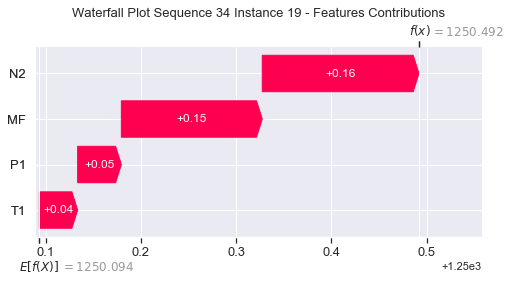

None

Contribution: [0.09151735 0.0786106  0.31602184 0.28809245]


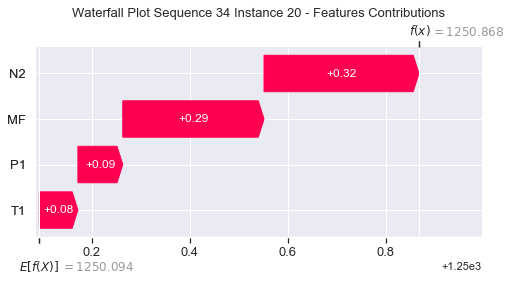

None

Contribution: [0.18967512 0.16056721 0.6537351  0.59734801]


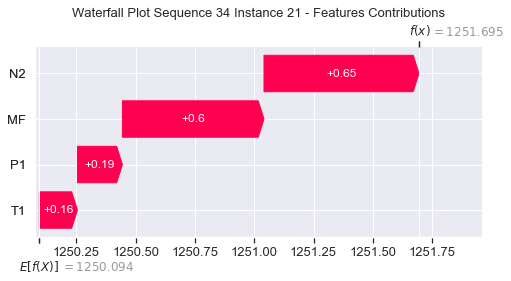

None

Contribution: [0.38107368 0.3050956  1.31959961 1.209725  ]


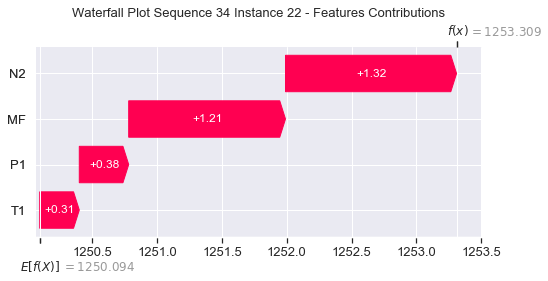

None

Contribution: [0.64303219 0.34464755 2.34071198 2.17960695]


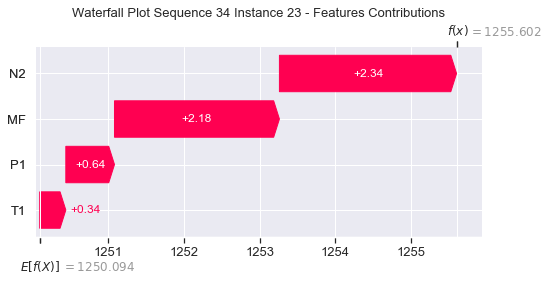

None

Contribution: [ 0.80468988 -1.10790411  3.22765483  3.22363009]


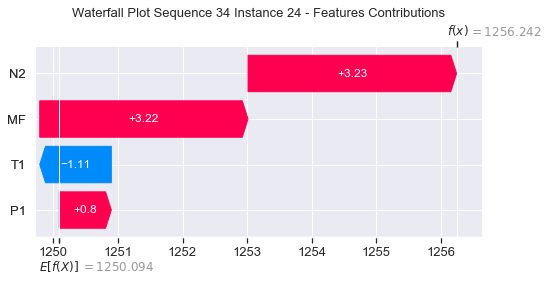

None

In [36]:
#Waterfall Plot for Local Accuracy & Consistency metrics

sns.set()
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [37]:
#Define f''x

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 292)           345728    
_________________________________________________________________
dense_4 (Dense)              (None, 24, 495)           145035    
_________________________________________________________________
dense_5 (Dense)              (None, 24, 1)             496       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 491,259
Trainable params: 491,259
Non-trainable params: 0
_________________________________________________________________


In [38]:
#Extract only weights for 3 variables excluding mf

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [39]:
#Transfer weights from f'x to f''x

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [40]:
#Load xtest and delete mf

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete mf

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [41]:
#Prediction with features excluding mf

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [42]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [ -2.21220753 -11.19747265   2.89179173]


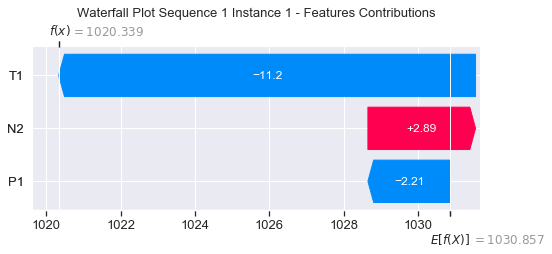

None

Contribution: [-0.42634632 -1.9201663  -0.28675555]


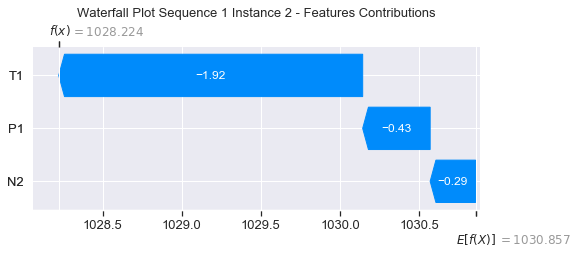

None

Contribution: [-0.52121651 -3.52277882  0.27179167]


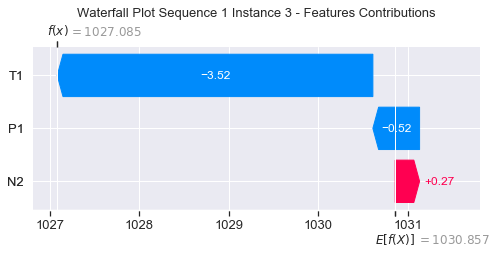

None

Contribution: [-0.34199394 -1.53335491 -0.04687411]


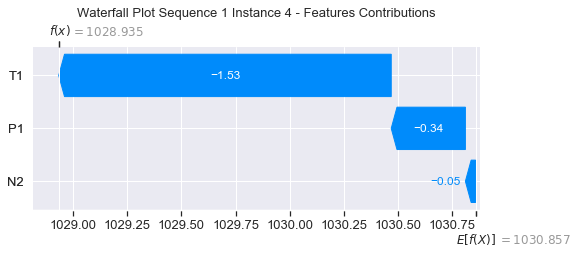

None

Contribution: [-0.27245467 -1.06628251 -0.09484092]


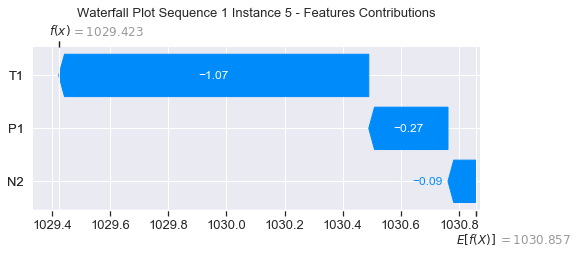

None

Contribution: [-0.21352528 -1.04608296 -0.10946608]


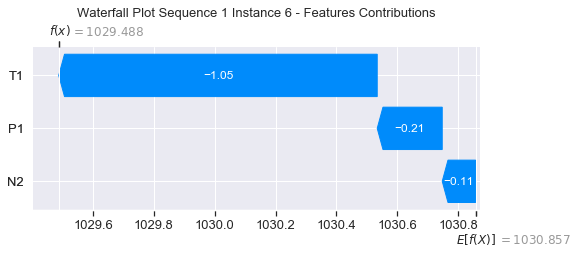

None

Contribution: [-0.22677512 -0.98145591 -0.12668619]


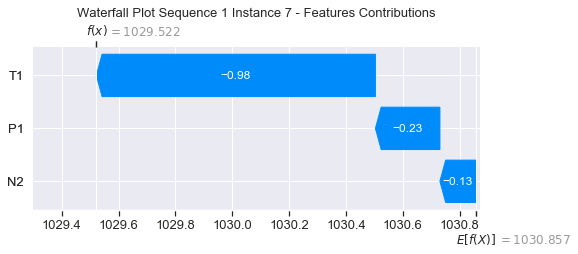

None

Contribution: [-0.21912223 -0.96369677 -0.13607811]


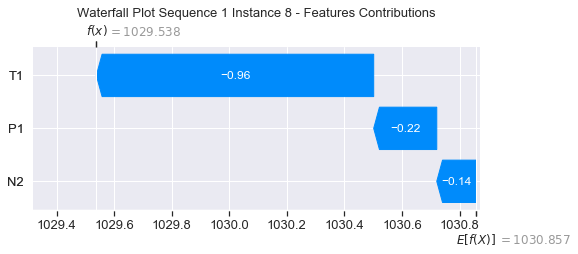

None

Contribution: [-0.25557579 -0.64102002 -0.11809427]


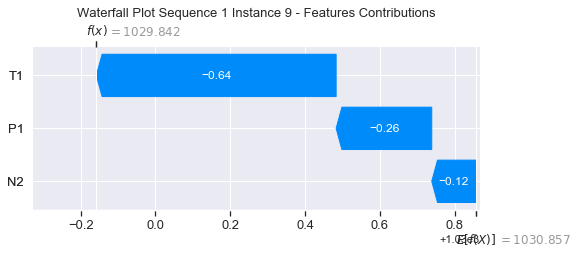

None

Contribution: [-0.33189208 -0.77932514 -0.12150661]


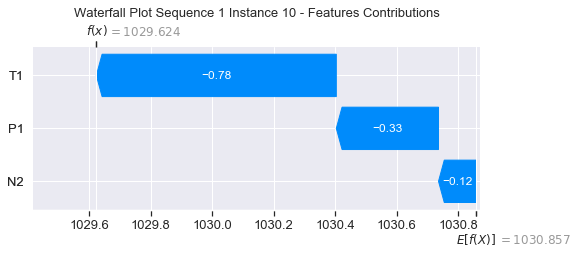

None

Contribution: [-0.21230761 -0.78077877 -0.10757384]


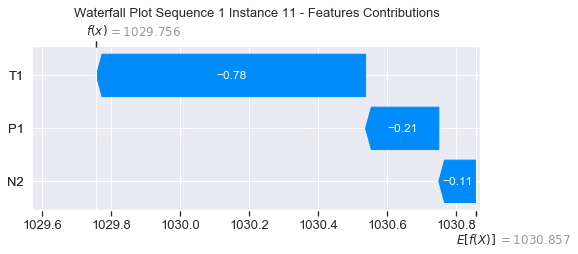

None

Contribution: [-0.25422486 -1.09576009 -0.12910928]


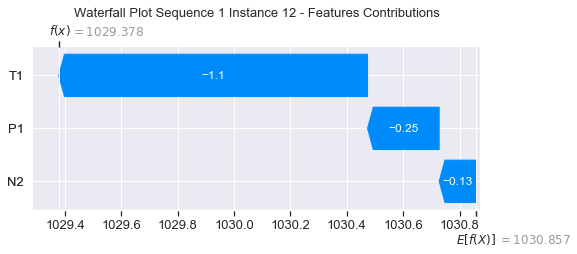

None

Contribution: [-0.25153665 -0.98595665 -0.12249498]


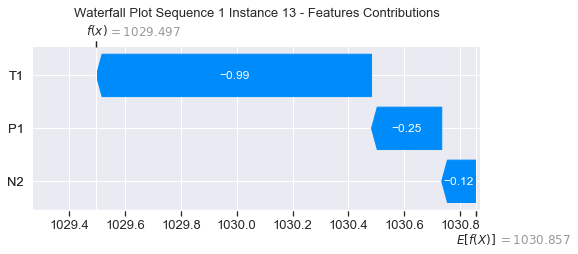

None

Contribution: [-0.14367851 -1.03657945 -0.15353131]


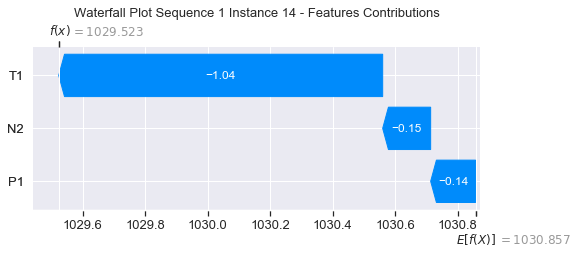

None

Contribution: [-0.27412088 -1.07149803 -0.21204603]


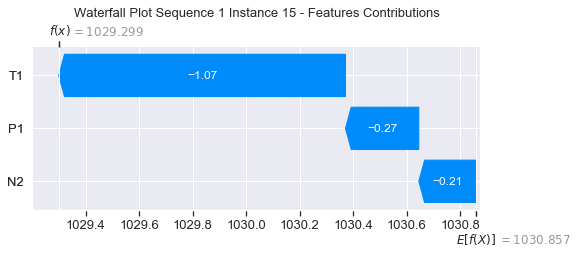

None

Contribution: [-0.40038445 -1.03547847 -0.28017767]


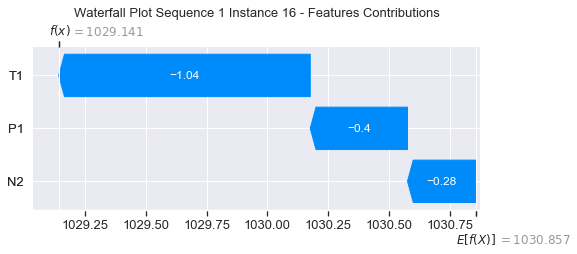

None

Contribution: [-0.34893244 -1.0400853  -0.43019978]


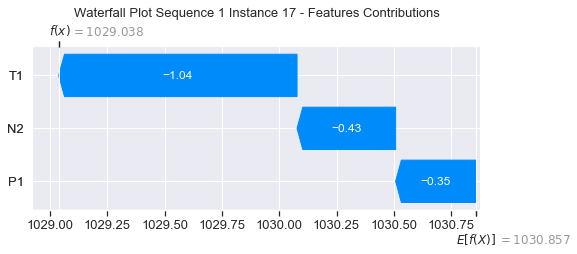

None

Contribution: [-0.37599277 -1.03573136 -0.4454441 ]


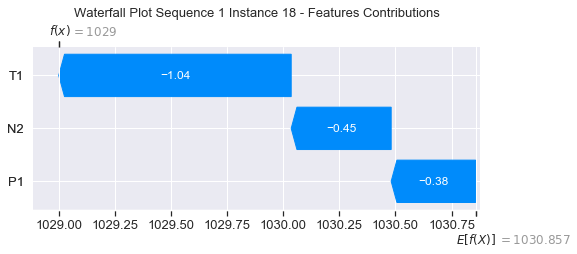

None

Contribution: [-0.58756    -0.96536863 -0.18006584]


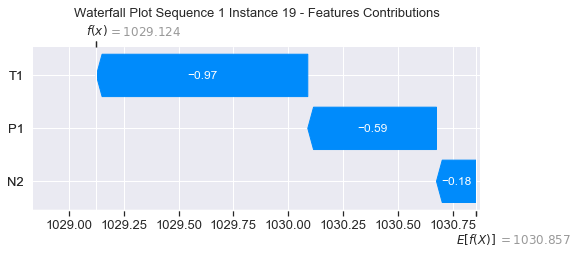

None

Contribution: [-0.28506296 -0.45502115  0.5115917 ]


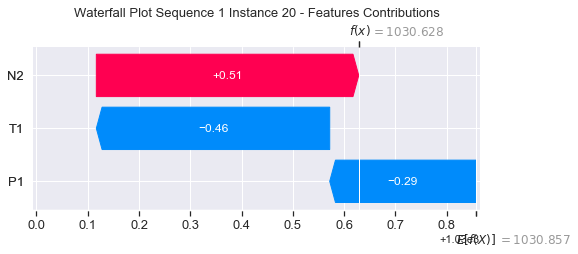

None

Contribution: [-0.11116398 -0.01447243  1.77671415]


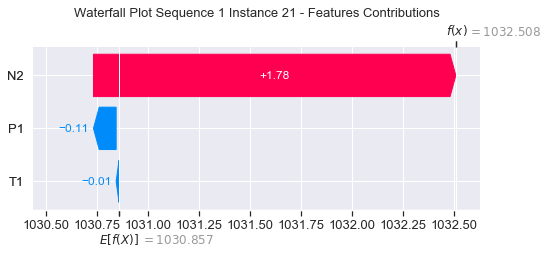

None

Contribution: [0.00898786 0.20011416 3.44313978]


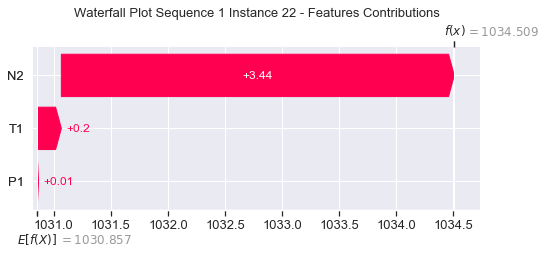

None

Contribution: [-0.23076594 -0.28207926  4.76557696]


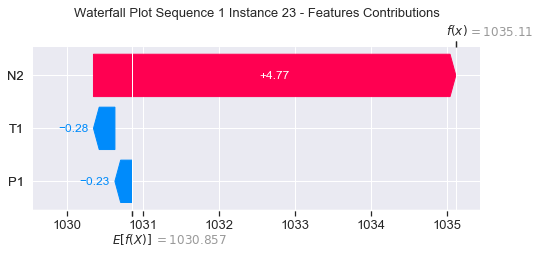

None

Contribution: [-0.07197322 -1.87312586  4.5529999 ]


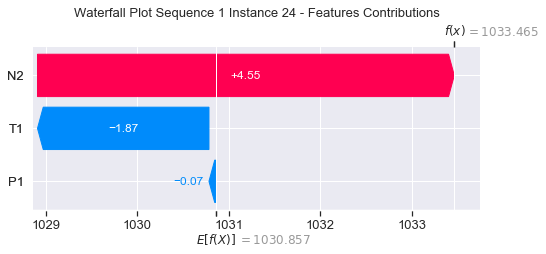

None

Contribution: [-1.8387137  -9.97944681  1.42447124]


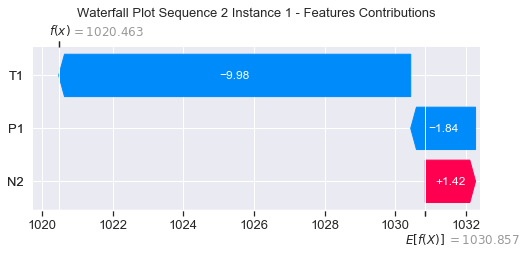

None

Contribution: [-0.5730092  -1.61934311 -0.46457399]


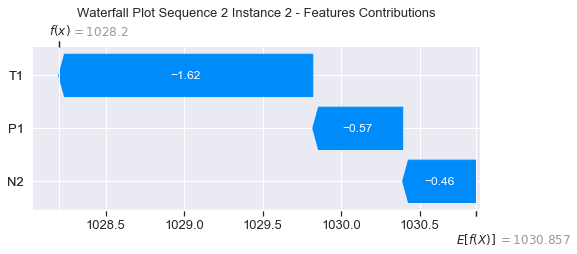

None

Contribution: [-0.54340853 -3.68419943 -0.09717231]


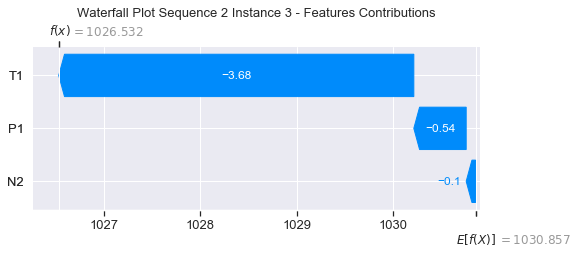

None

Contribution: [-0.42557995 -1.53475016 -0.21060792]


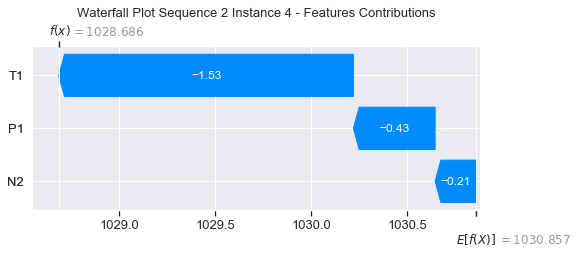

None

Contribution: [-0.31154741 -2.03720846 -0.10088303]


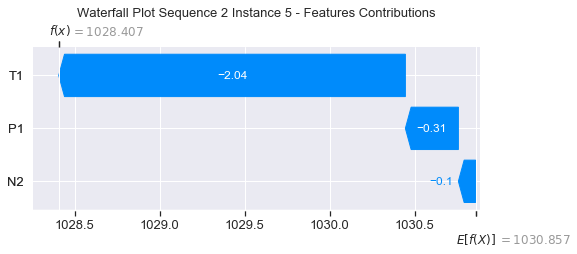

None

Contribution: [-0.28108994 -1.99318496 -0.13250742]


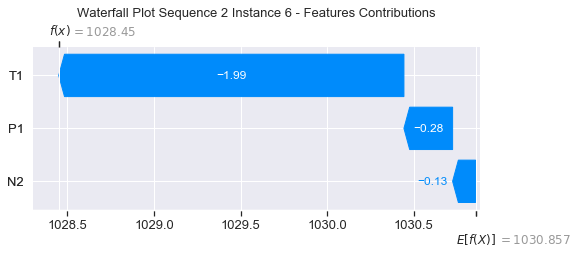

None

Contribution: [-0.26610881 -1.93731234 -0.14237814]


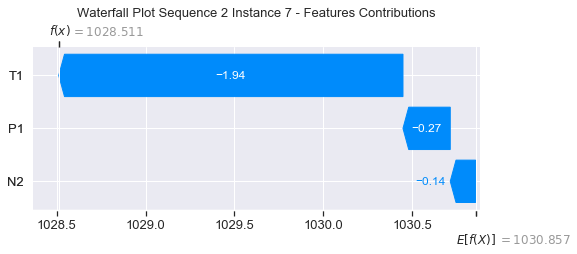

None

Contribution: [-0.26775811 -1.89775525 -0.15625204]


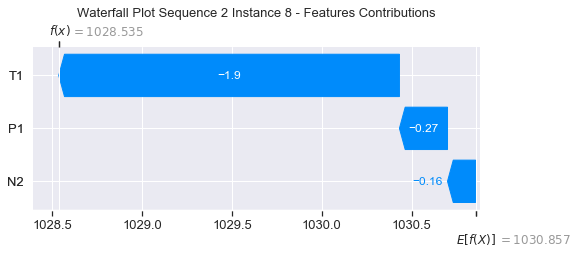

None

Contribution: [-0.31091705 -1.98204532 -0.08255126]


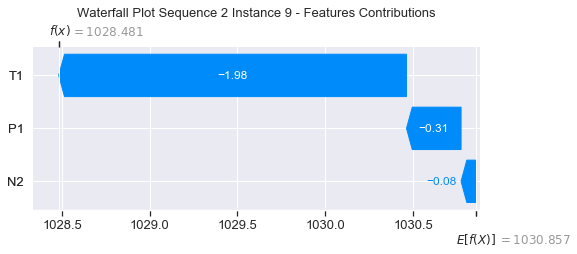

None

Contribution: [-0.37270821 -1.99288325 -0.05678325]


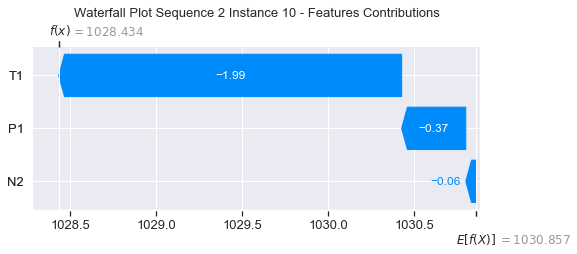

None

Contribution: [-0.32175311 -2.02321936 -0.10783359]


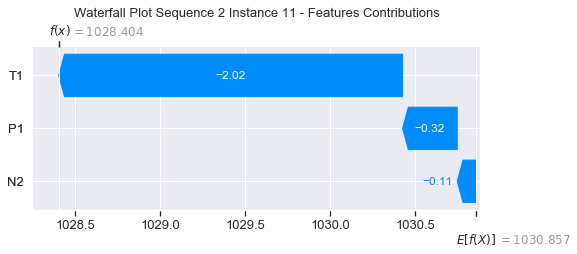

None

Contribution: [-0.2797898  -2.27357349 -0.14735114]


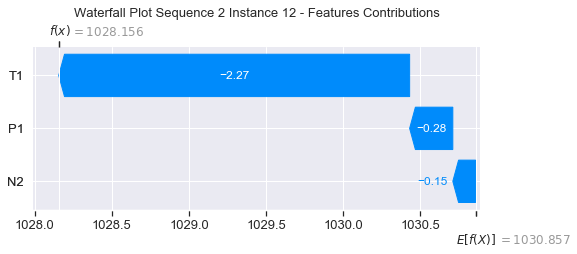

None

Contribution: [-0.26871719 -2.2278778  -0.11958135]


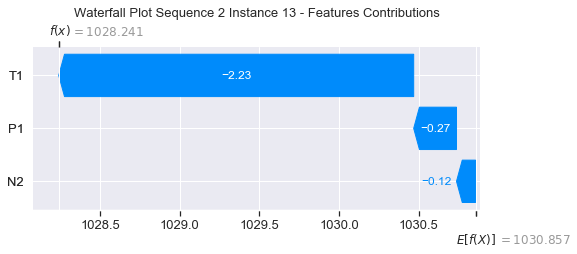

None

Contribution: [-0.27304443 -2.3970355  -0.1436505 ]


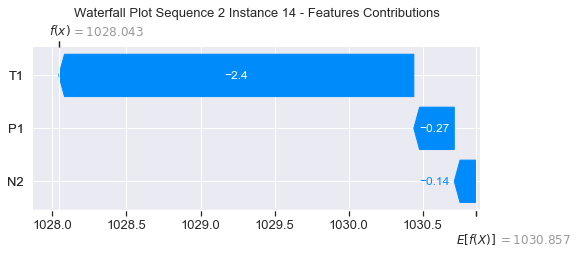

None

Contribution: [-0.31736    -2.44488763 -0.21542192]


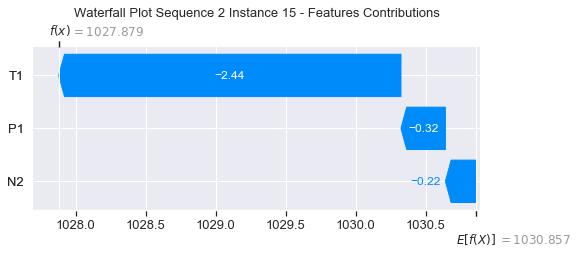

None

Contribution: [-0.44448277 -2.49754588 -0.31120256]


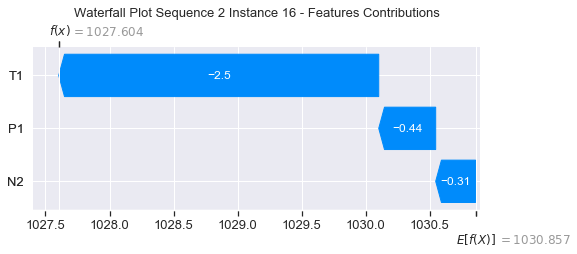

None

Contribution: [-0.41808286 -2.79845538 -0.51176923]


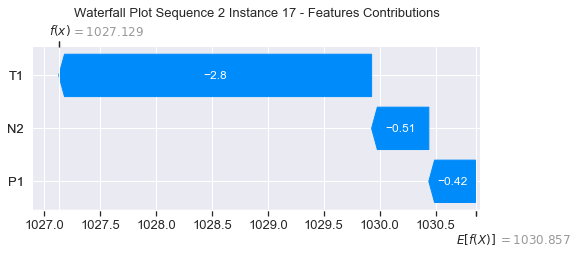

None

Contribution: [-0.49291354 -3.1102769  -0.59555323]


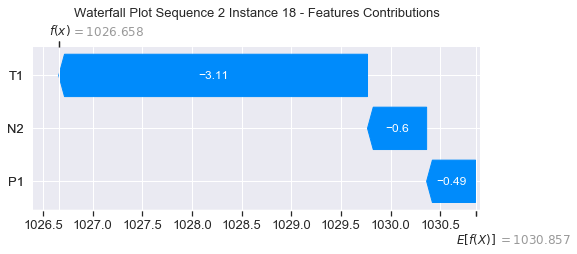

None

Contribution: [-0.62230289 -3.49831502 -0.38741695]


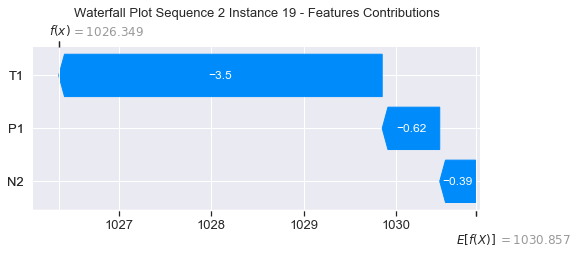

None

Contribution: [-0.49175783 -4.18727321  0.36382556]


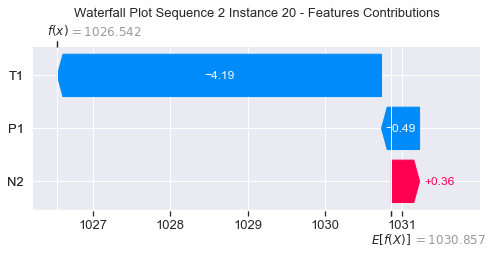

None

Contribution: [-0.39971562 -5.53141855  1.71233168]


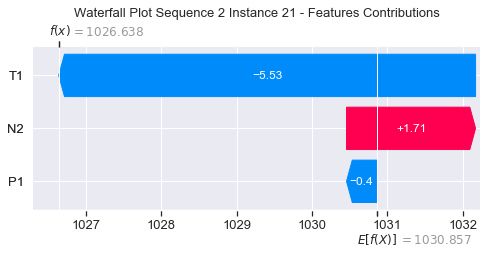

None

Contribution: [-0.4263527  -7.8253909   3.47386293]


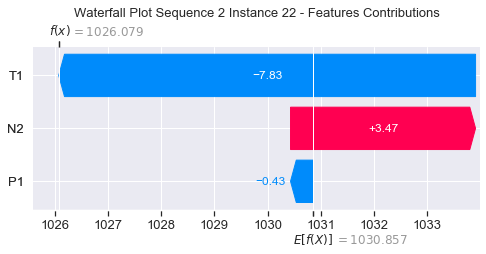

None

Contribution: [ -0.91736122 -11.43393185   4.82399285]


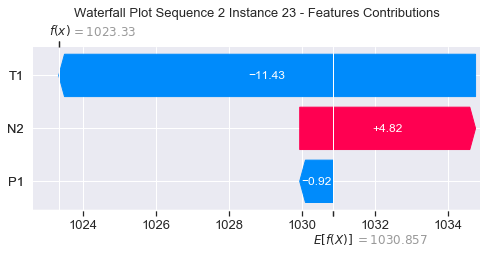

None

Contribution: [ -0.97152861 -12.87674265   4.5942443 ]


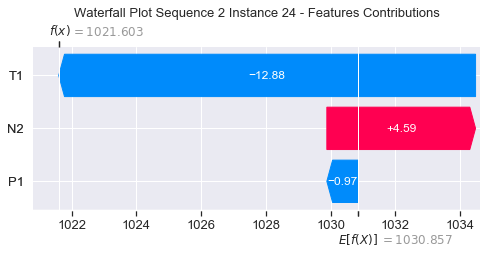

None

Contribution: [ -4.46268851 -27.52732161   1.3828488 ]


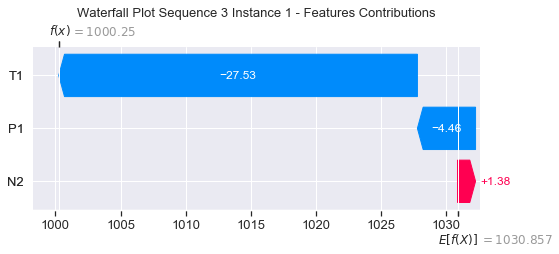

None

Contribution: [-0.55256954 -3.54267584 -0.42765361]


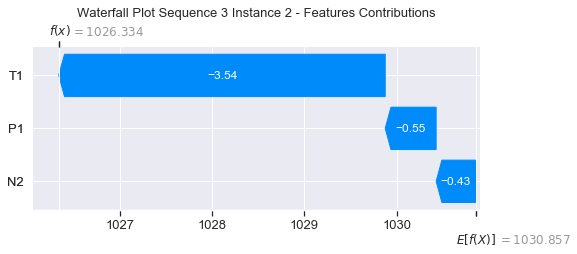

None

Contribution: [-0.78348836 -8.25586683 -0.12631618]


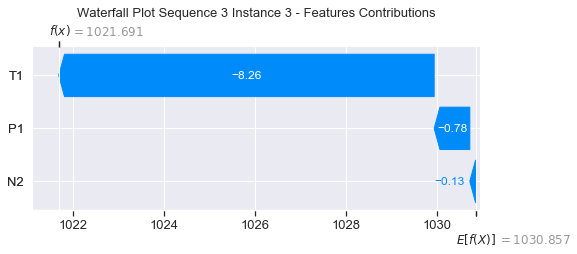

None

Contribution: [-0.32866228 -3.21882134 -0.17858422]


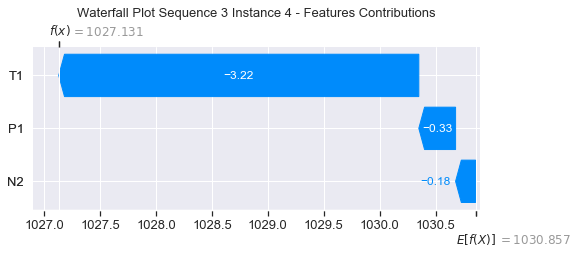

None

Contribution: [-0.28258255 -2.43333473 -0.18163275]


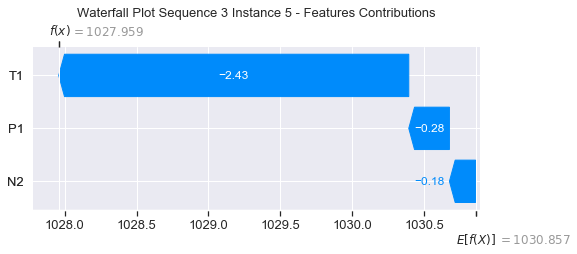

None

Contribution: [-0.25602638 -2.06095146 -0.1723993 ]


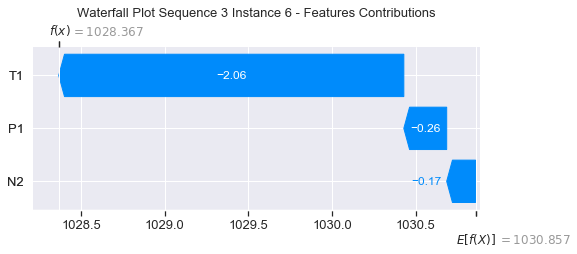

None

Contribution: [-0.25207483 -1.97891716 -0.18679038]


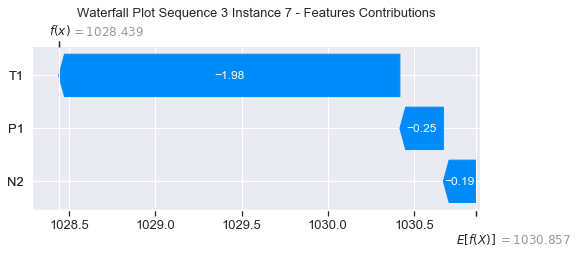

None

Contribution: [-0.25201896 -1.96477959 -0.19441711]


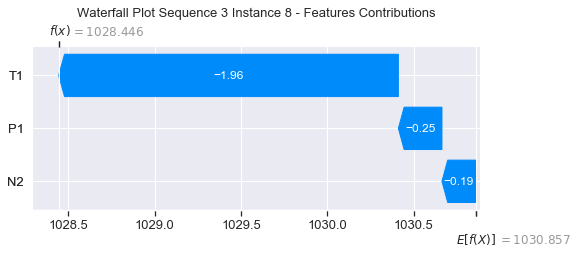

None

Contribution: [-0.32899564 -1.86169453 -0.17158578]


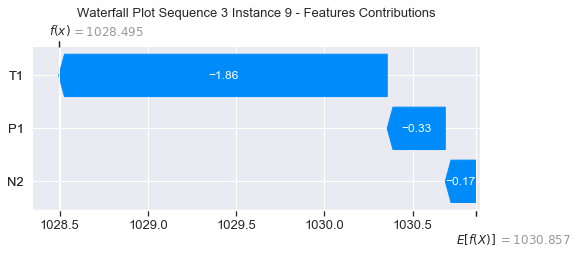

None

Contribution: [-0.34244845 -1.67218138 -0.11970063]


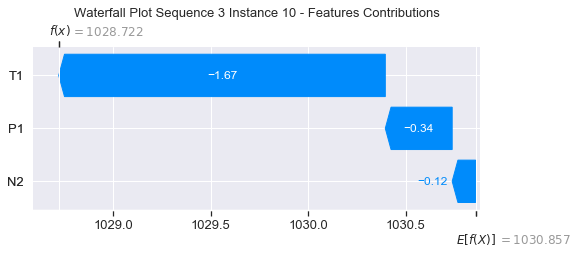

None

Contribution: [-0.29520172 -1.85989342 -0.13081026]


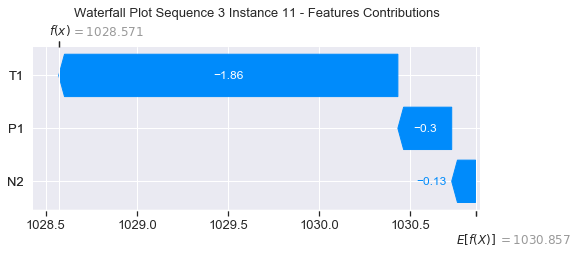

None

Contribution: [-0.22971061 -2.20857256 -0.12591352]


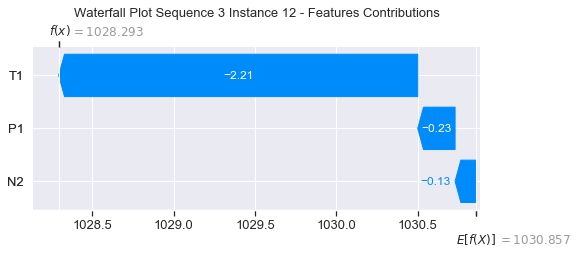

None

Contribution: [-0.22577627 -2.20160627 -0.09826286]


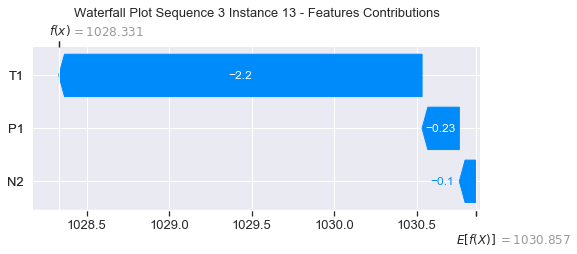

None

Contribution: [-0.31200827 -2.18784791 -0.09106433]


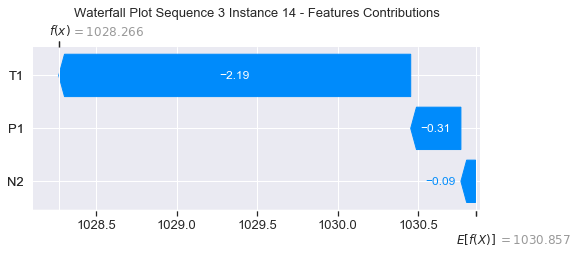

None

Contribution: [-0.28188189 -2.41954099 -0.17490332]


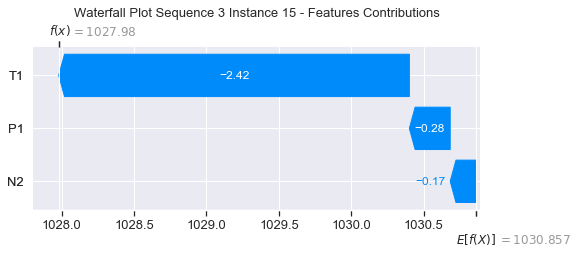

None

Contribution: [-0.31845027 -2.47874744 -0.25978356]


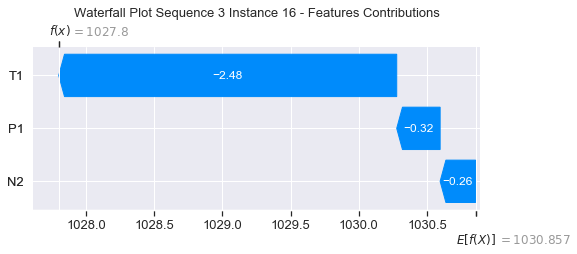

None

Contribution: [-0.40159224 -2.79108677 -0.5197965 ]


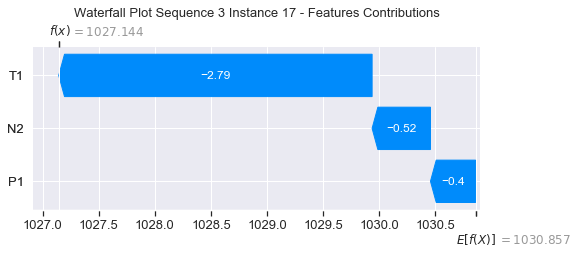

None

Contribution: [-0.48603598 -3.16337409 -0.63757403]


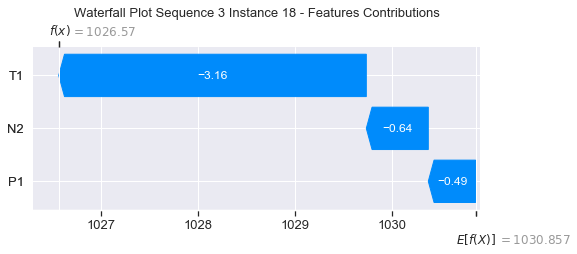

None

Contribution: [-0.56904092 -3.95472986 -0.42989489]


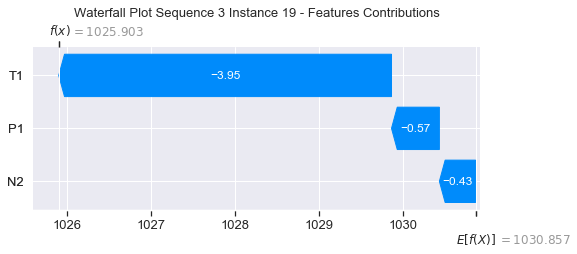

None

Contribution: [-0.54855041 -4.77408715  0.2408748 ]


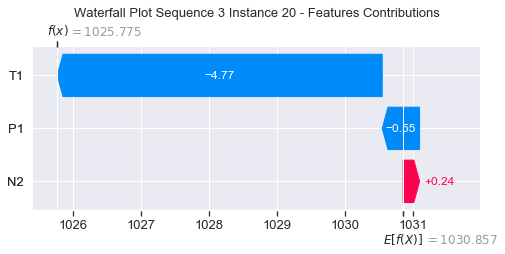

None

Contribution: [-0.44402488 -6.45490711  1.64481333]


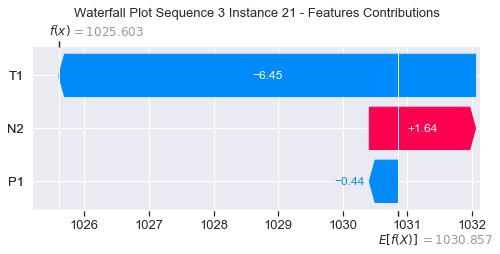

None

Contribution: [-0.41790731 -9.33925191  3.53914043]


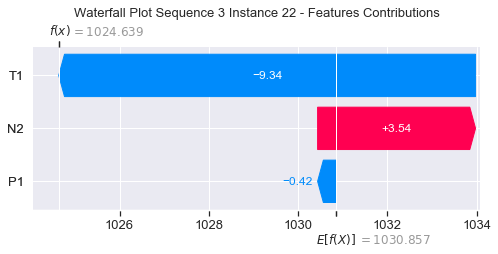

None

Contribution: [ -0.81879993 -12.82621022   5.11495676]


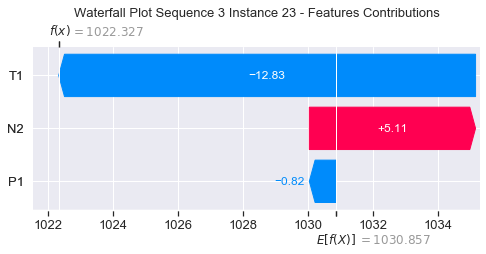

None

Contribution: [ -0.67978196 -14.87708722   4.79894322]


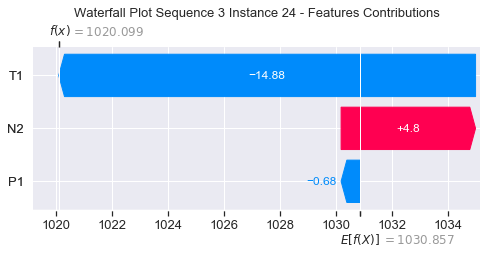

None

Contribution: [ -2.75139383 -29.73813685   1.31325533]


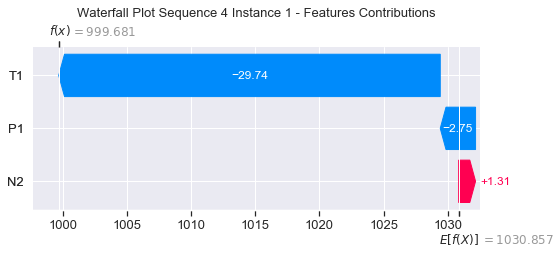

None

Contribution: [-0.46247713 -3.65874906 -0.35605661]


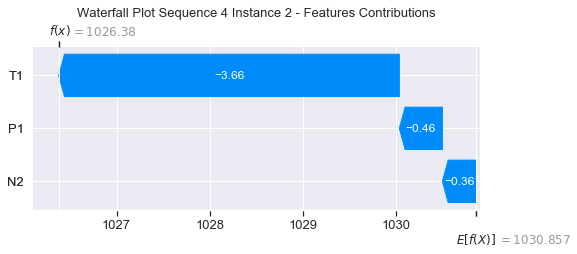

None

Contribution: [-0.9569704  -8.04691372 -0.08285841]


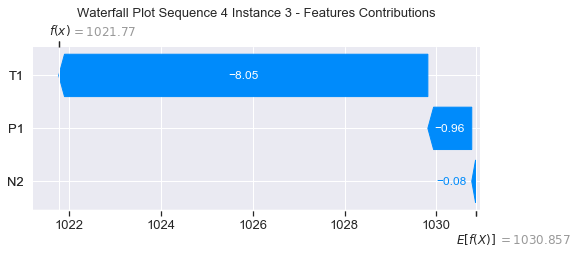

None

Contribution: [-0.28482163 -3.03953655 -0.17076156]


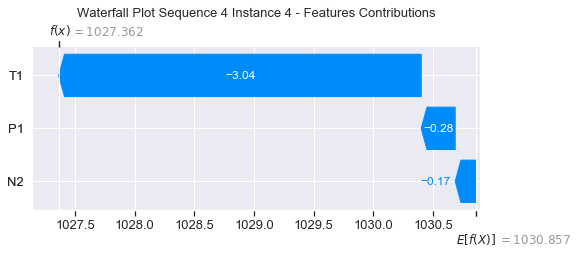

None

Contribution: [-0.25604087 -2.50740267 -0.16134493]


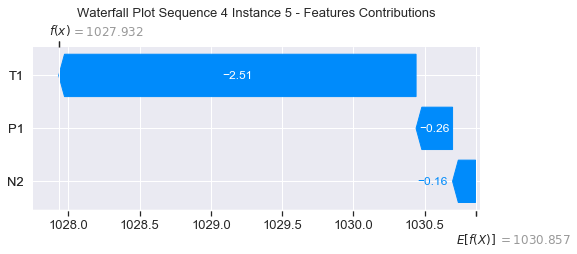

None

Contribution: [-0.21566141 -2.20513169 -0.15040004]


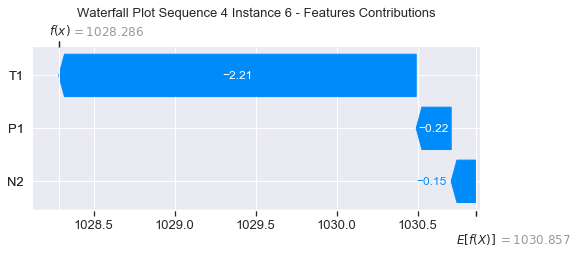

None

Contribution: [-0.20773689 -2.0830233  -0.16663367]


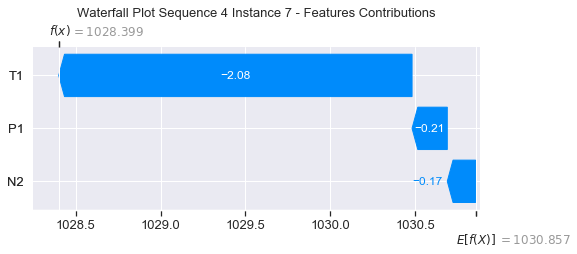

None

Contribution: [-0.22216337 -2.06496227 -0.17689446]


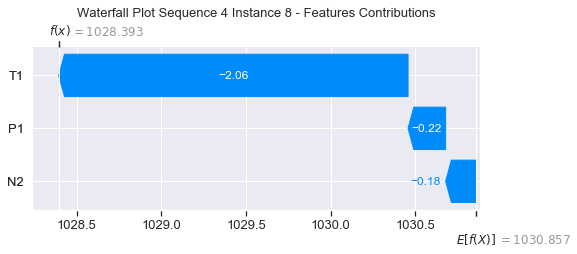

None

Contribution: [-0.33250448 -2.01000166 -0.14812684]


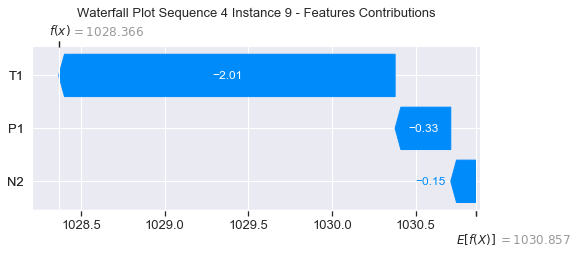

None

Contribution: [-0.30777284 -2.1344391  -0.12366518]


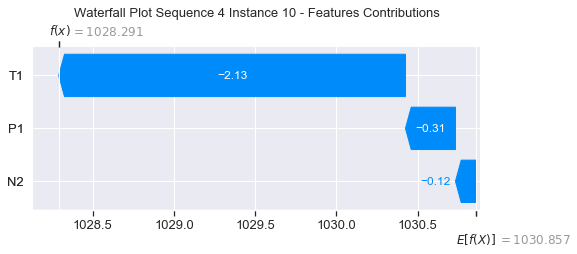

None

Contribution: [-0.33811862 -2.11761414 -0.11820539]


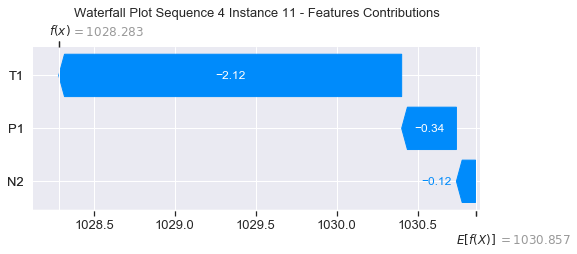

None

Contribution: [-0.22919182 -2.31901169 -0.12358352]


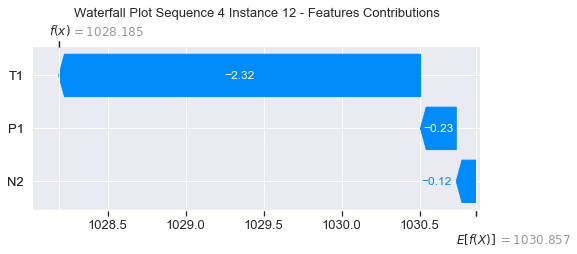

None

Contribution: [-0.21854959 -2.31635235 -0.09001949]


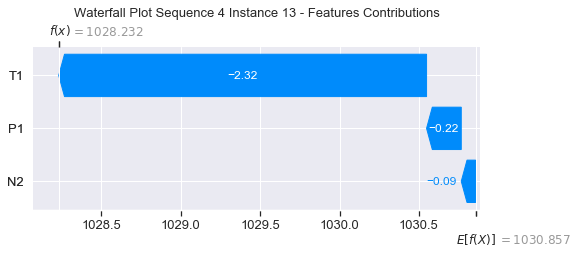

None

Contribution: [-0.25624095 -2.33903529 -0.06035383]


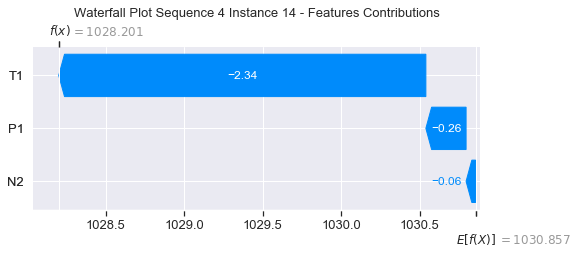

None

Contribution: [-0.26495227 -2.56906449 -0.164324  ]


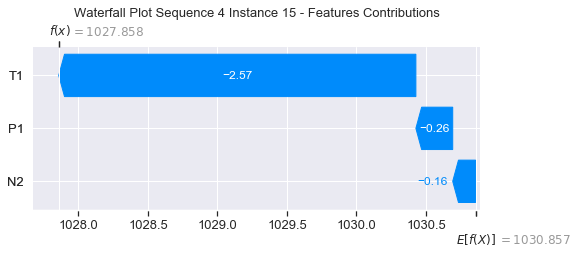

None

Contribution: [-0.39616168 -2.63119448 -0.28866555]


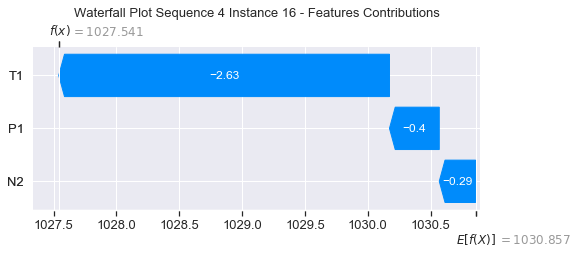

None

Contribution: [-0.37765415 -2.96720159 -0.51444334]


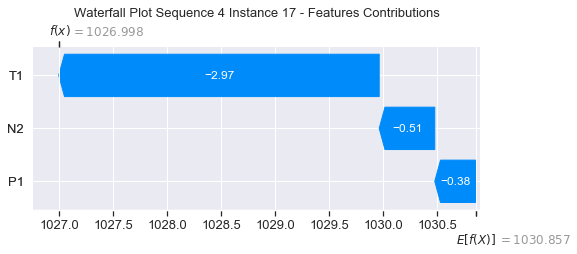

None

Contribution: [-0.46187605 -3.40260181 -0.63617357]


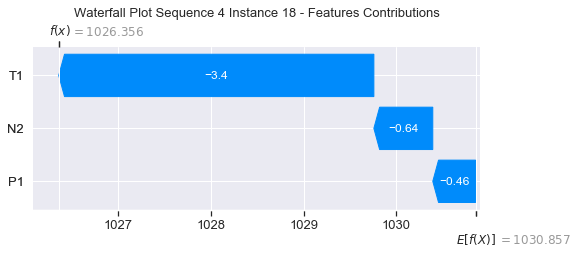

None

Contribution: [-0.54579395 -3.98965027 -0.47922585]


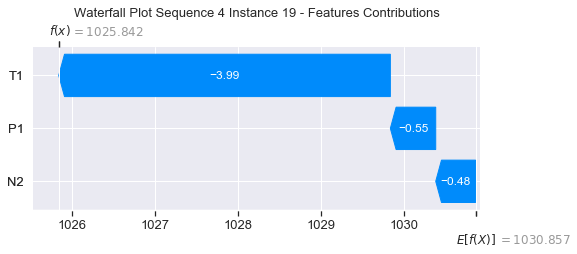

None

Contribution: [-0.50029441 -5.18715066  0.25064266]


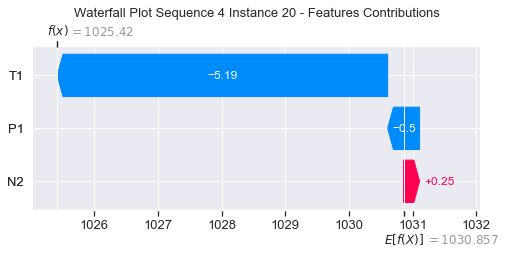

None

Contribution: [-0.41953518 -7.05710827  1.66481376]


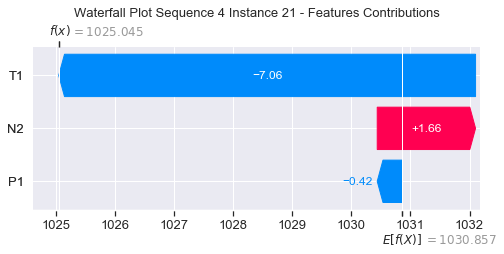

None

Contribution: [ -0.45704821 -10.22438568   3.56072135]


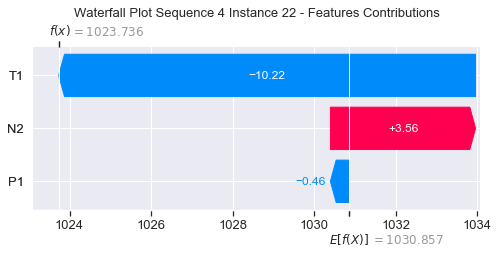

None

Contribution: [ -0.87575653 -14.26446394   5.15604748]


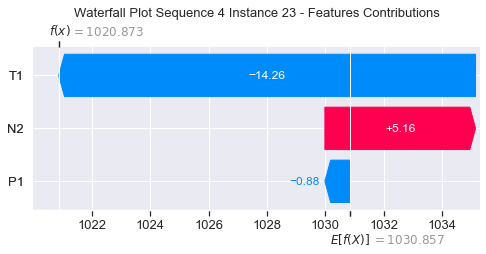

None

Contribution: [ -0.87814138 -16.12431674   4.92424485]


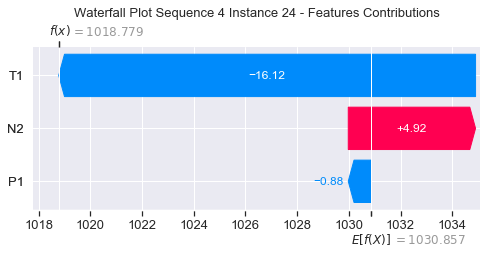

None

Contribution: [ -4.14908931 -30.26074187   1.97578096]


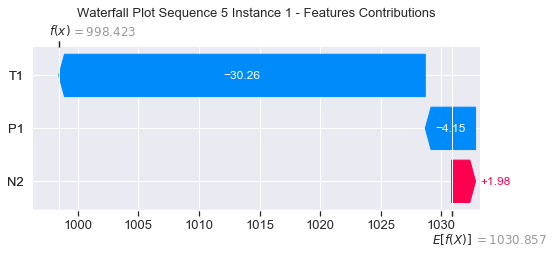

None

Contribution: [-0.52908913 -3.68468786 -0.36788856]


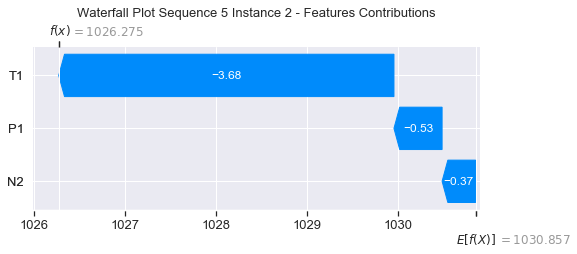

None

Contribution: [-0.96662553 -8.16678761 -0.15076475]


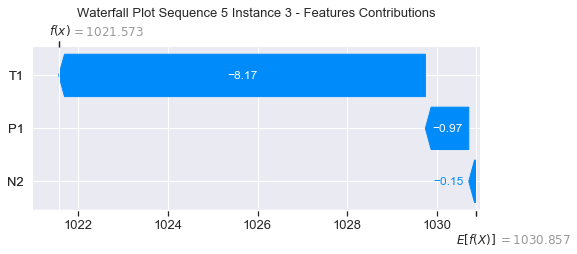

None

Contribution: [-0.39873441 -2.99627076 -0.17918439]


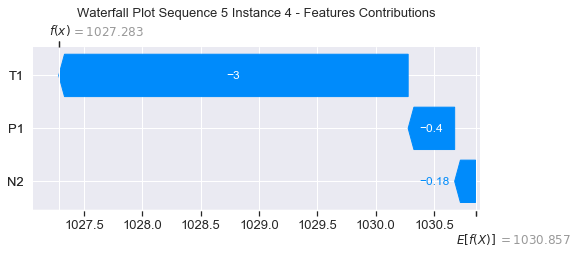

None

Contribution: [-0.32715567 -2.43327158 -0.16940593]


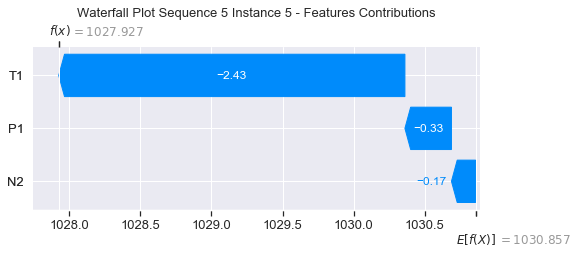

None

Contribution: [-0.26752307 -2.0573655  -0.1621117 ]


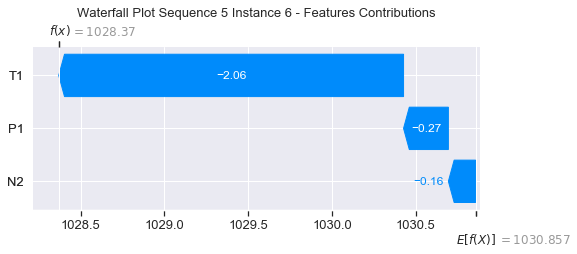

None

Contribution: [-0.25966062 -1.97107623 -0.18038638]


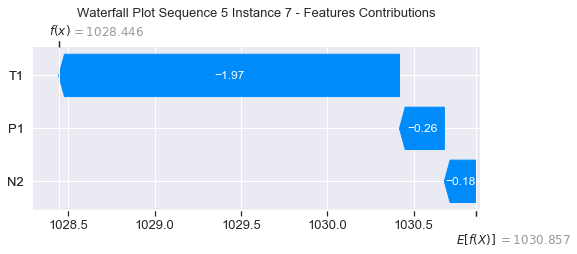

None

Contribution: [-0.26120699 -1.94479235 -0.1887591 ]


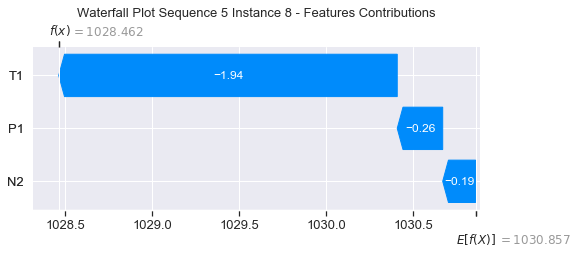

None

Contribution: [-0.33084173 -1.89603318 -0.17789988]


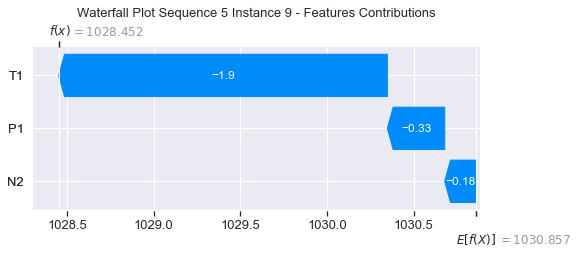

None

Contribution: [-0.42462533 -1.91333992 -0.1500947 ]


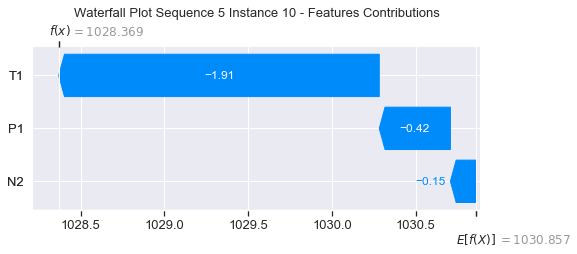

None

Contribution: [-0.32831314 -1.87037605 -0.13627445]


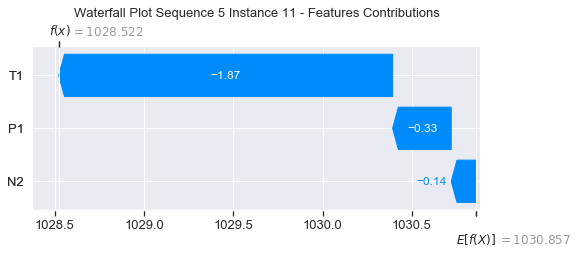

None

Contribution: [-0.27085957 -2.16478342 -0.12775212]


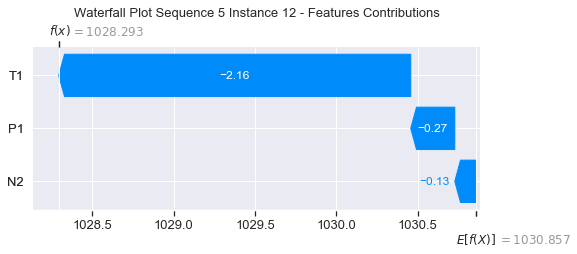

None

Contribution: [-0.25931616 -2.17250947 -0.09824985]


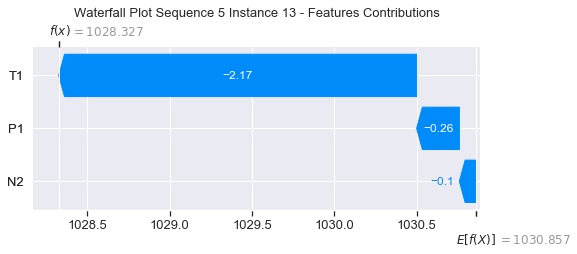

None

Contribution: [-0.22546715 -2.23309475 -0.05367629]


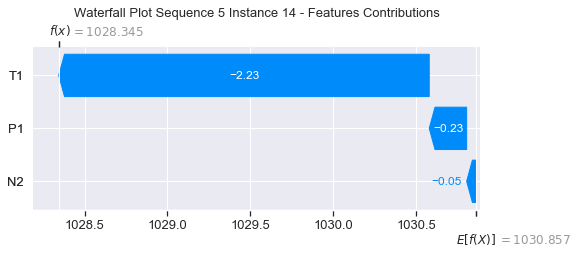

None

Contribution: [-0.29145101 -2.36565811 -0.16878228]


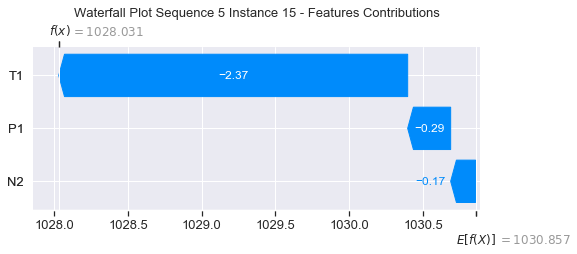

None

Contribution: [-0.31371398 -2.5037226  -0.22551265]


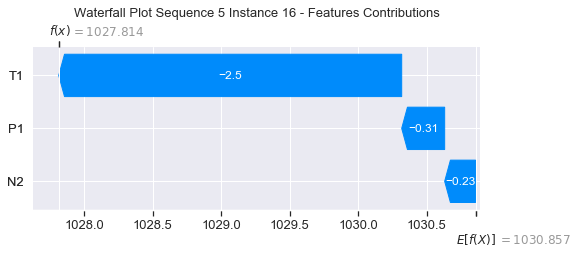

None

Contribution: [-0.39314997 -2.72037252 -0.51796459]


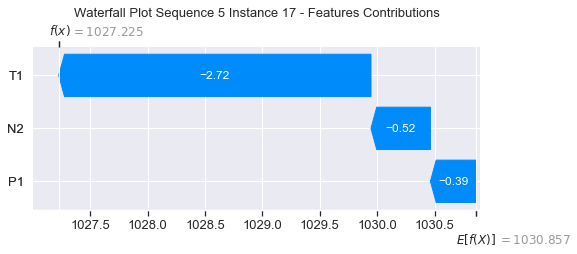

None

Contribution: [-0.46519867 -3.05883094 -0.63618538]


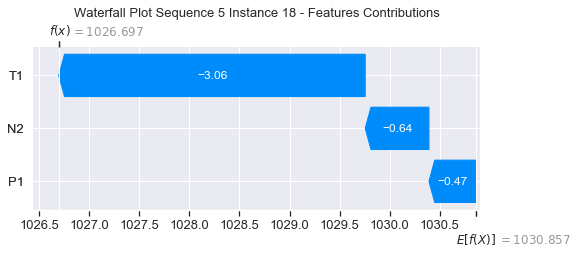

None

Contribution: [-0.59913095 -3.82172339 -0.52651532]


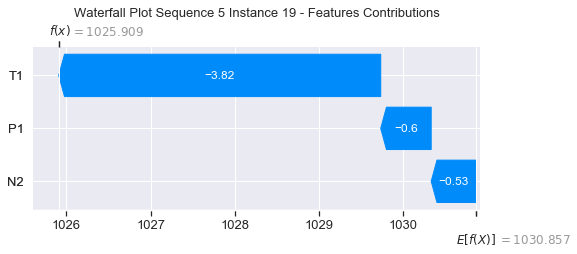

None

Contribution: [-0.47008827 -4.51080812  0.24030104]


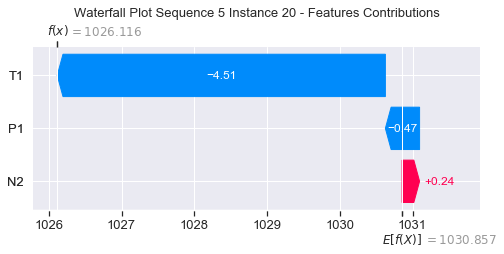

None

Contribution: [-0.34771239 -5.97828004  1.655043  ]


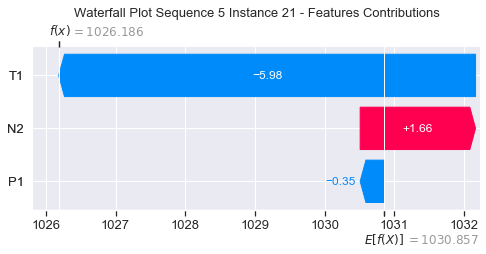

None

Contribution: [-0.31365973 -8.45160268  3.56696718]


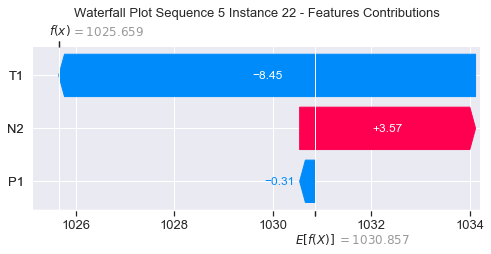

None

Contribution: [ -0.61387303 -11.573016     5.15048175]


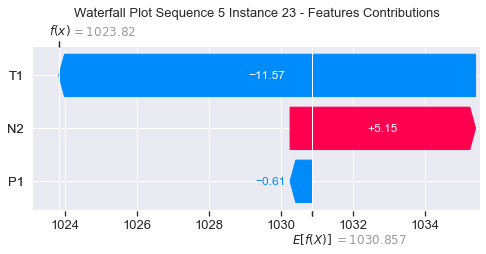

None

Contribution: [ -0.42602132 -13.53790957   4.92027452]


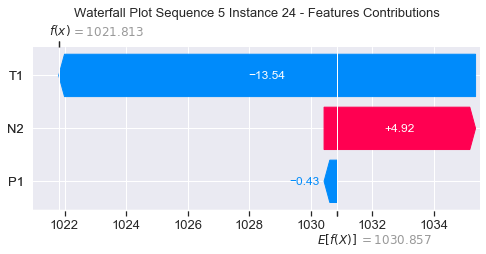

None

Contribution: [ -2.50147131 -28.32241006   1.84143204]


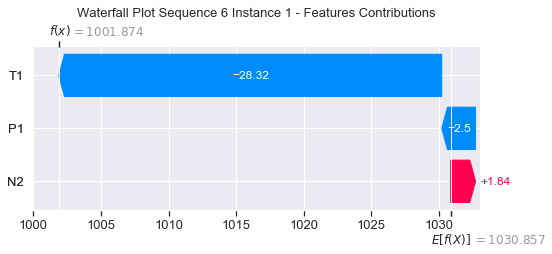

None

Contribution: [-0.4962532  -3.51668344 -0.34951806]


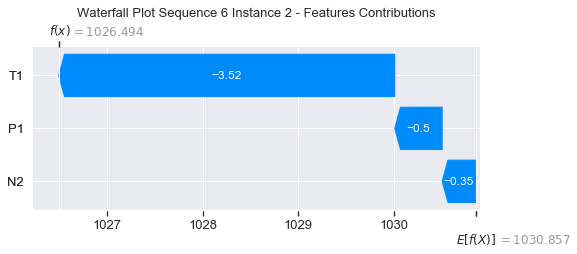

None

Contribution: [-0.85568086 -7.26367424  0.03732182]


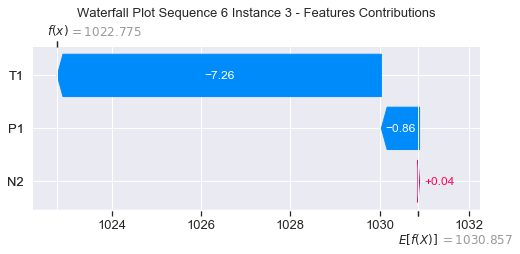

None

Contribution: [-0.34612661 -2.94619467 -0.14180248]


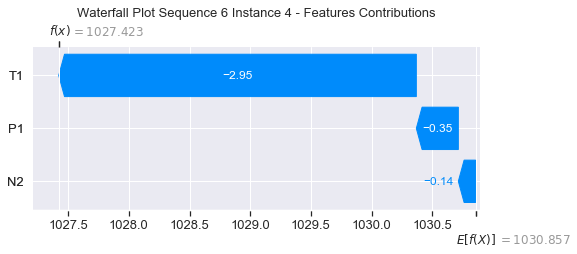

None

Contribution: [-0.28274526 -2.25743242 -0.13638753]


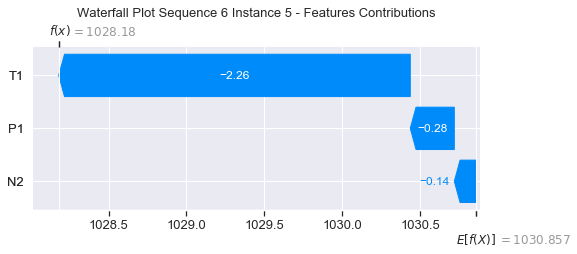

None

Contribution: [-0.23882379 -2.09679969 -0.14144405]


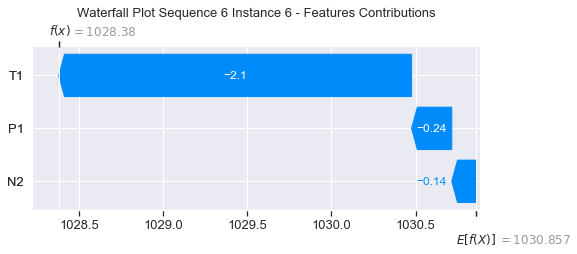

None

Contribution: [-0.22869935 -2.02214294 -0.16515615]


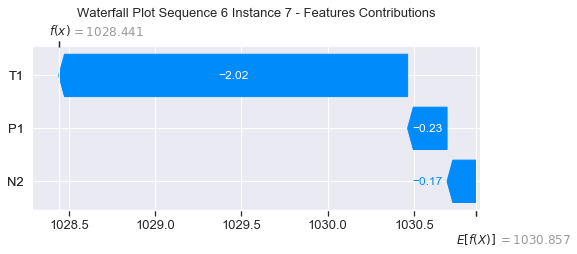

None

Contribution: [-0.23722744 -2.01796564 -0.17219231]


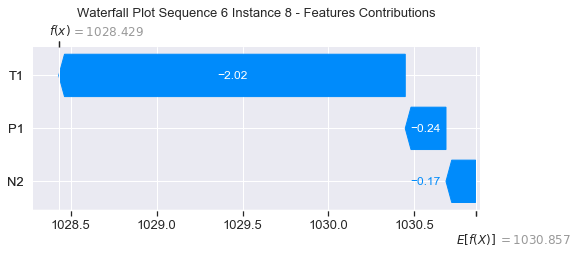

None

Contribution: [-0.30471877 -2.07577802 -0.16261056]


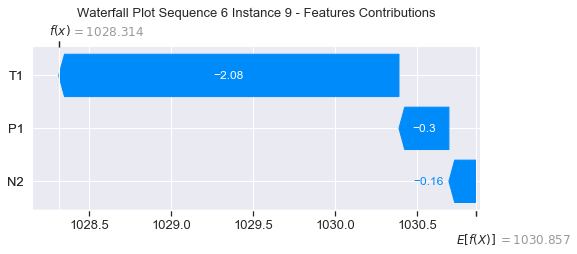

None

Contribution: [-0.38378771 -2.00292412 -0.12801276]


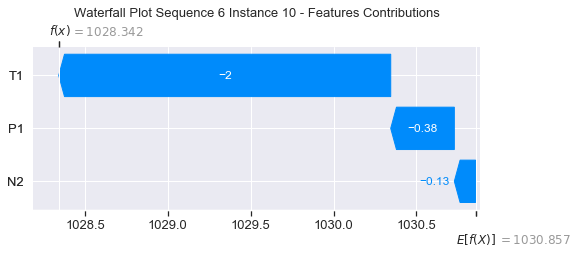

None

Contribution: [-0.31180323 -2.14855975 -0.12950535]


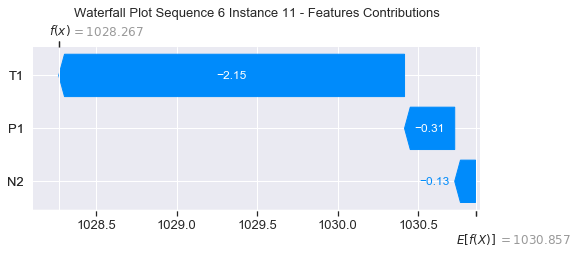

None

Contribution: [-0.24309008 -2.37632055 -0.15834697]


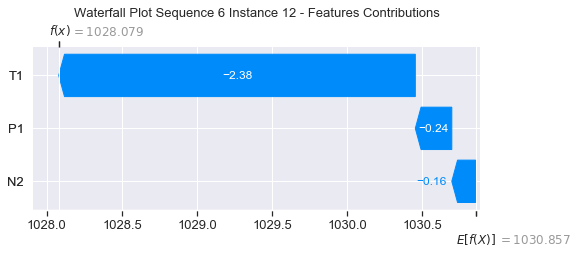

None

Contribution: [-0.23251585 -2.38266866 -0.12006726]


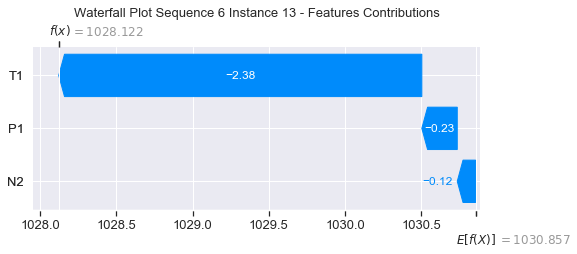

None

Contribution: [-0.24309105 -2.37020855 -0.12685725]


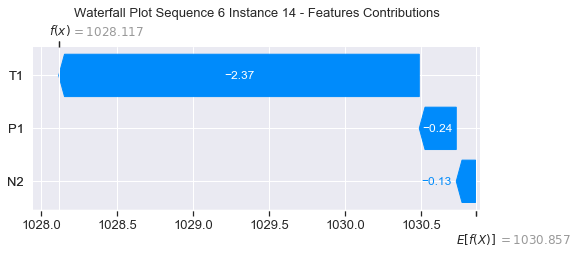

None

Contribution: [-0.27561955 -2.66124624 -0.18623031]


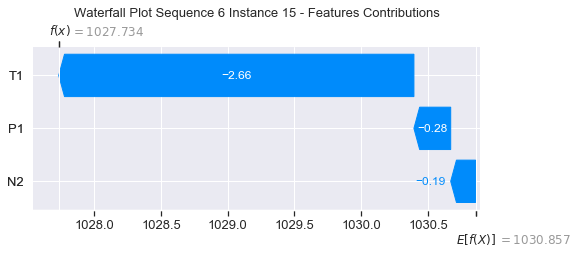

None

Contribution: [-0.36663681 -2.94086096 -0.3254415 ]


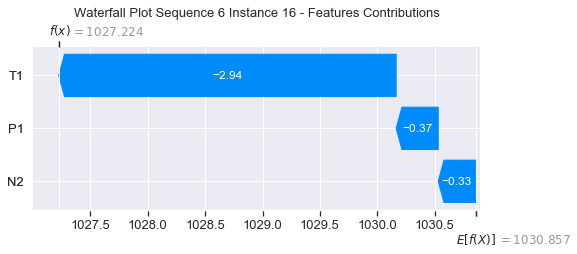

None

Contribution: [-0.39248339 -3.19232408 -0.54278735]


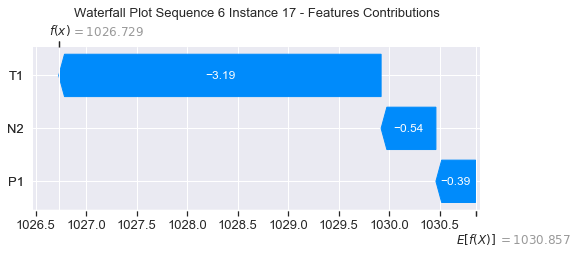

None

Contribution: [-0.48490759 -3.73082214 -0.66439471]


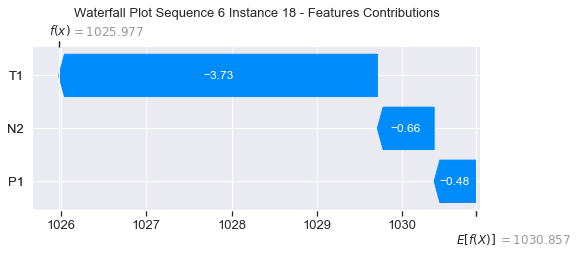

None

Contribution: [-0.61658328 -4.73597972 -0.44255839]


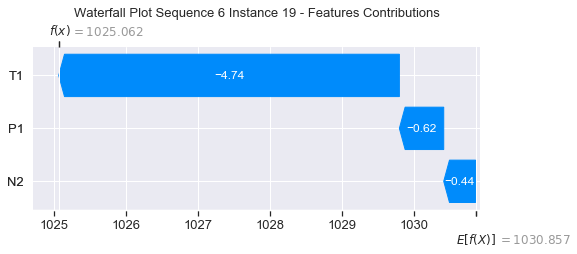

None

Contribution: [-0.55993805 -6.03984331  0.2607103 ]


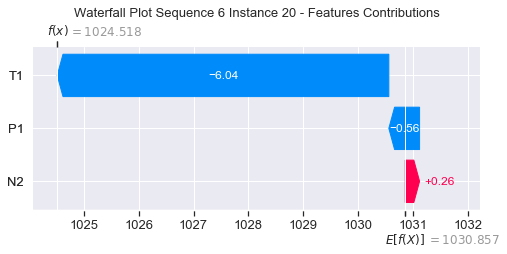

None

Contribution: [-0.50767816 -8.48196688  1.68408476]


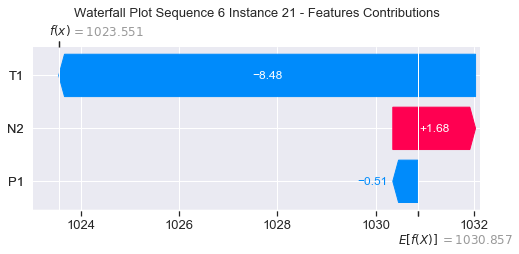

None

Contribution: [ -0.59590758 -12.39866836   3.63607824]


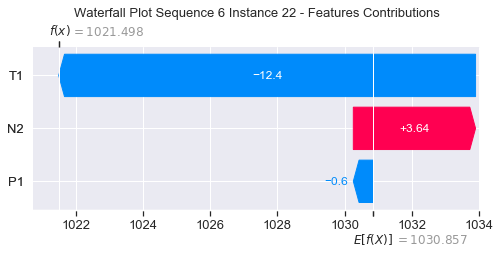

None

Contribution: [ -1.08851406 -17.61968173   5.26211239]


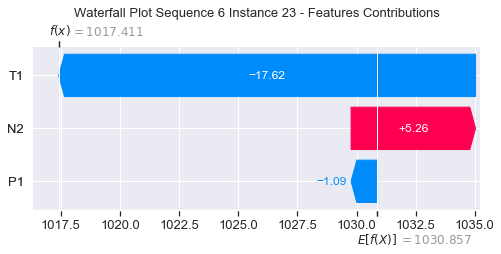

None

Contribution: [ -0.99953226 -19.37843447   5.1399775 ]


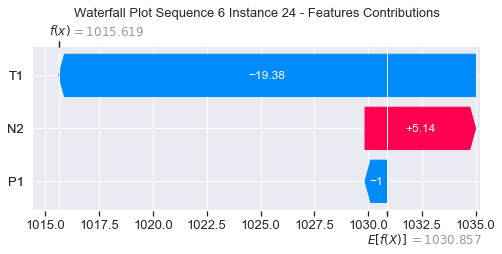

None

Contribution: [ -3.65605417 -36.07467583   1.88096168]


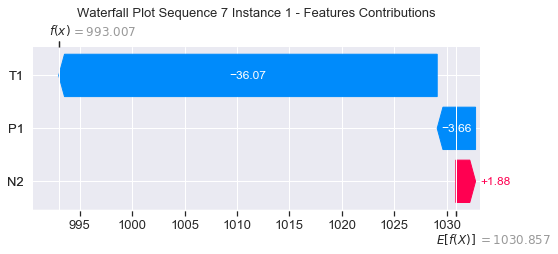

None

Contribution: [-0.53861937 -4.15945338 -0.36390656]


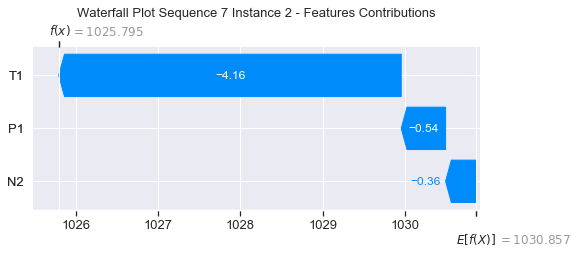

None

Contribution: [-0.80082205 -8.38015195 -0.19827328]


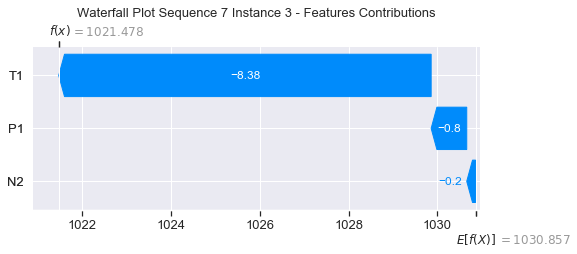

None

Contribution: [-0.32112122 -3.43549222 -0.15167994]


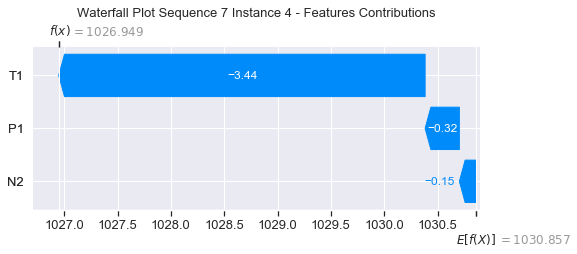

None

Contribution: [-0.24837196 -2.66592838 -0.15672293]


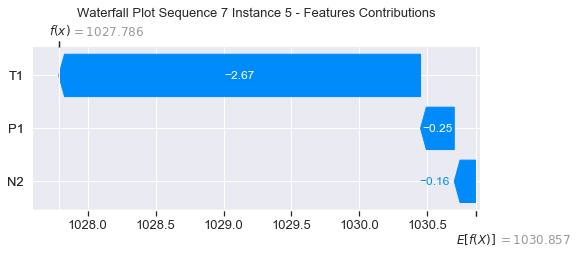

None

Contribution: [-0.23346731 -2.32780542 -0.16880007]


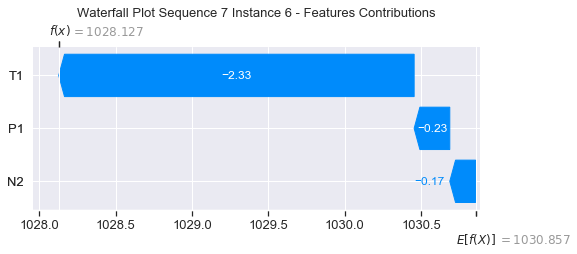

None

Contribution: [-0.23497772 -2.17722142 -0.18410113]


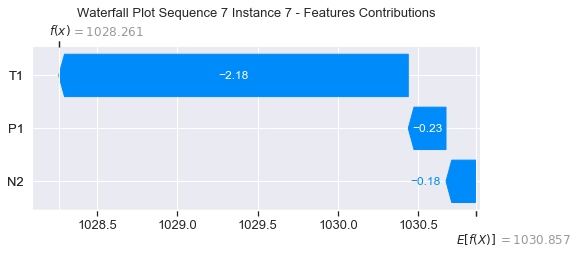

None

Contribution: [-0.23635684 -2.17360125 -0.19679332]


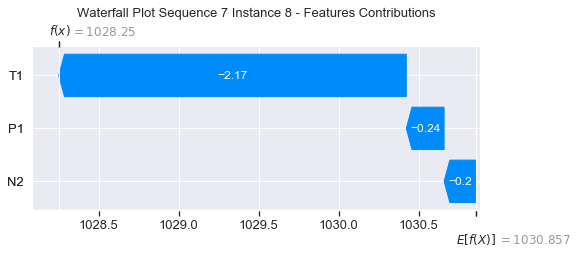

None

Contribution: [-0.32085325 -2.10000761 -0.1949601 ]


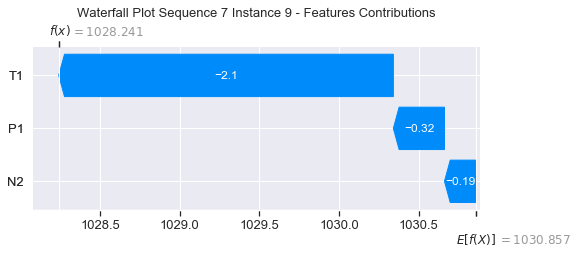

None

Contribution: [-0.33156923 -2.08318252 -0.15080783]


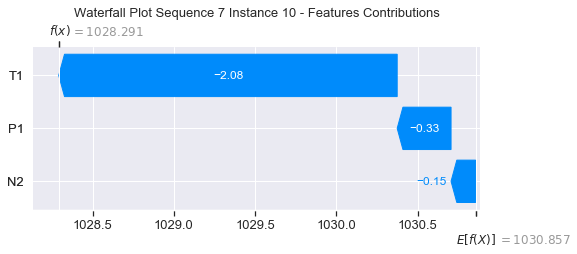

None

Contribution: [-0.30316585 -2.28537162 -0.17485605]


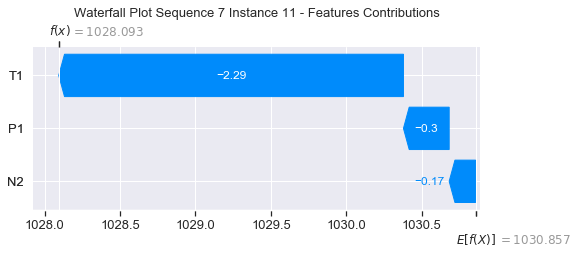

None

Contribution: [-0.26419813 -2.50369384 -0.14053836]


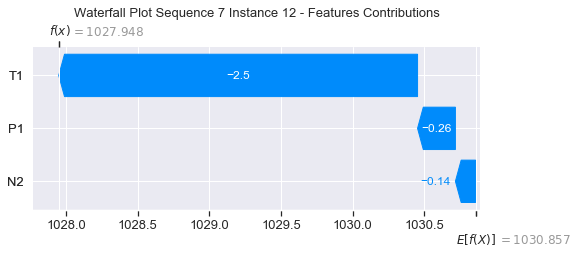

None

Contribution: [-0.25560312 -2.4980319  -0.09646595]


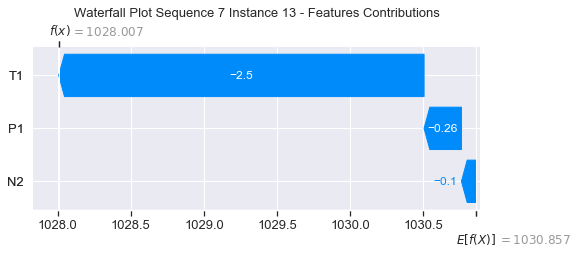

None

Contribution: [-0.27727228 -2.4195468  -0.08198674]


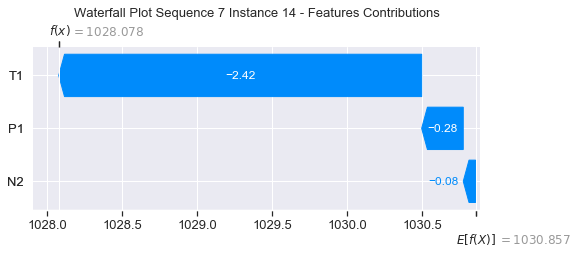

None

Contribution: [-0.29662071 -2.77425013 -0.15759147]


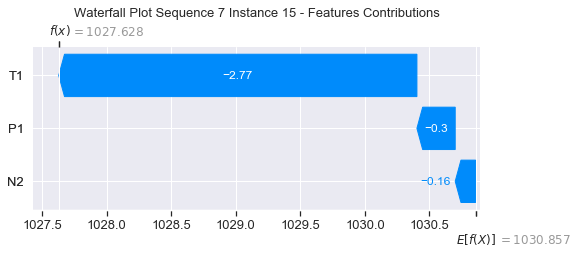

None

Contribution: [-0.31113719 -2.96850537 -0.26005493]


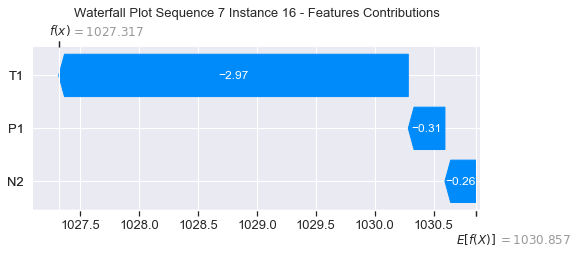

None

Contribution: [-0.43914578 -3.2286762  -0.54171584]


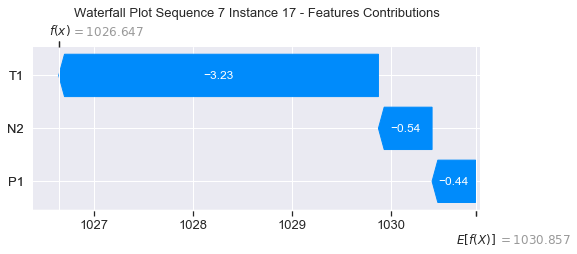

None

Contribution: [-0.54455963 -3.77961017 -0.69842112]


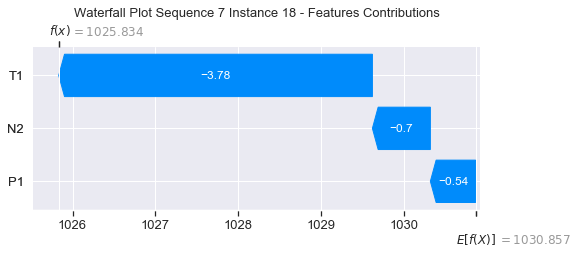

None

Contribution: [-0.56972196 -4.8994566  -0.48717586]


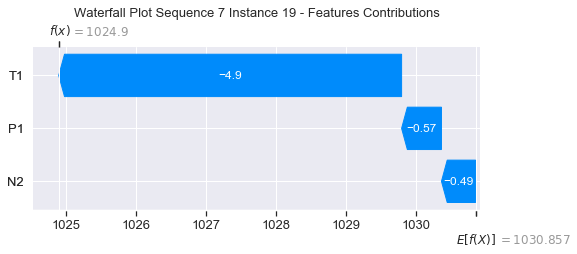

None

Contribution: [-0.68724136 -6.14040557  0.15732201]


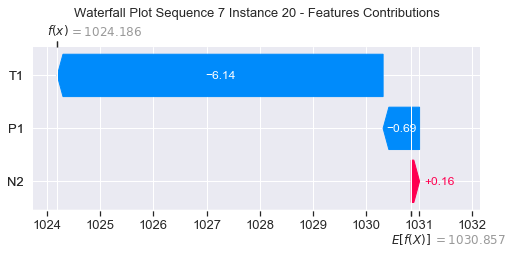

None

Contribution: [-0.68519608 -8.59837192  1.59156486]


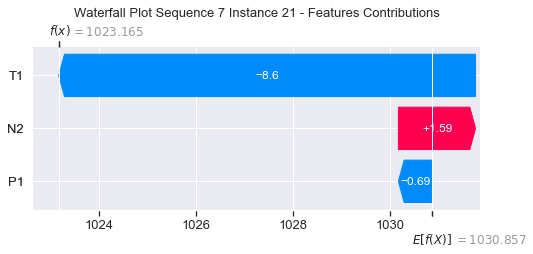

None

Contribution: [ -0.76255553 -12.5940931    3.55665283]


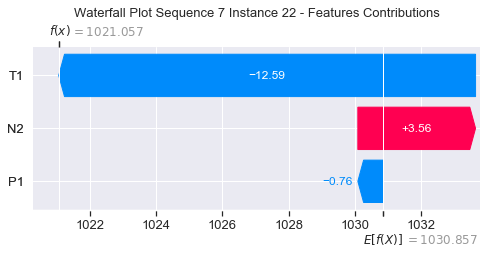

None

Contribution: [ -1.31615913 -17.4886239    5.14465554]


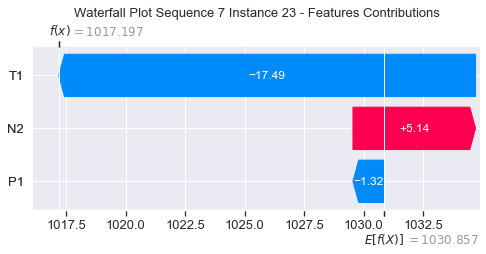

None

Contribution: [ -1.11023162 -19.51738413   4.95557402]


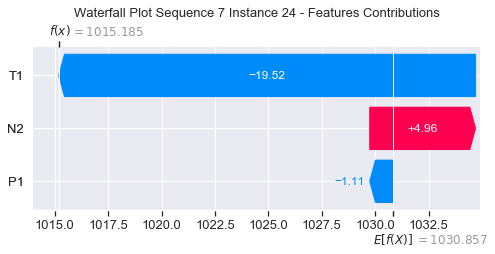

None

Contribution: [ -3.93604563 -35.18876007   1.86774948]


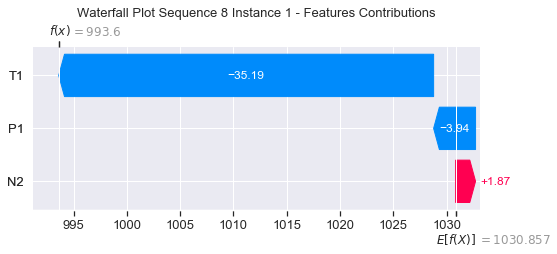

None

Contribution: [-0.53858372 -3.82384898 -0.33543194]


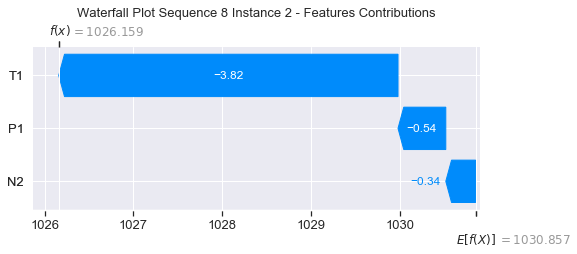

None

Contribution: [-0.887132   -9.03498581  0.05706108]


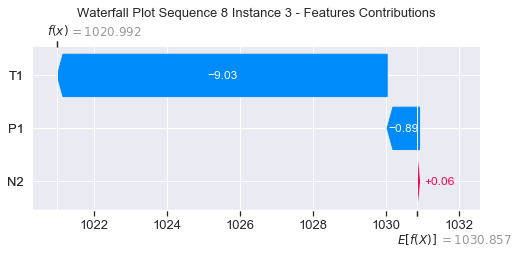

None

Contribution: [-0.39865051 -3.37517478 -0.14599913]


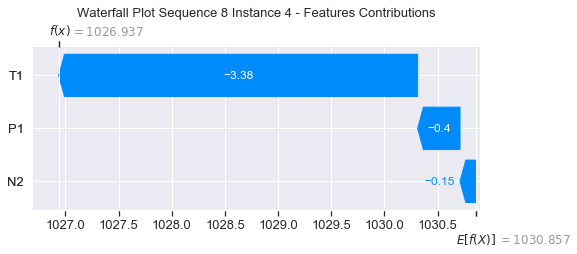

None

Contribution: [-0.47913814 -2.64538777 -0.24169175]


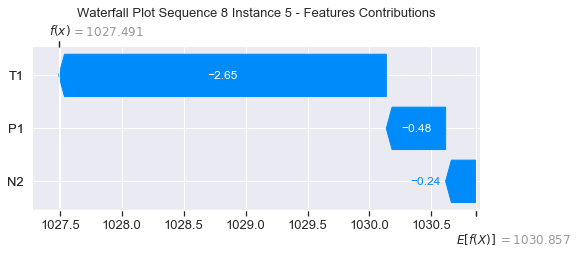

None

Contribution: [-0.27298185 -2.08442867 -0.16792328]


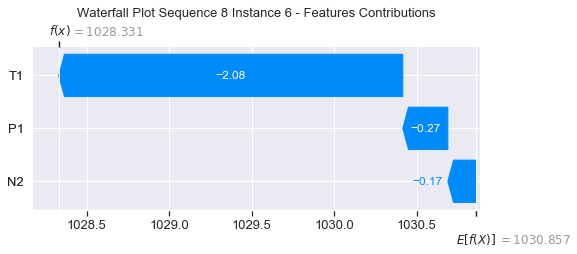

None

Contribution: [-0.26832107 -1.99800117 -0.17812251]


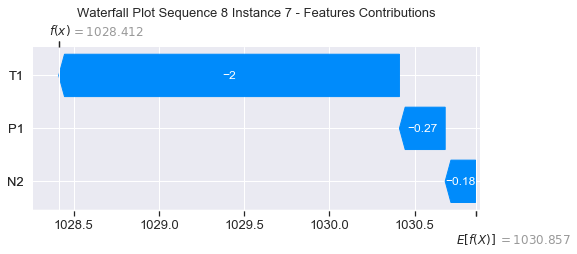

None

Contribution: [-0.27371247 -1.95942369 -0.18905497]


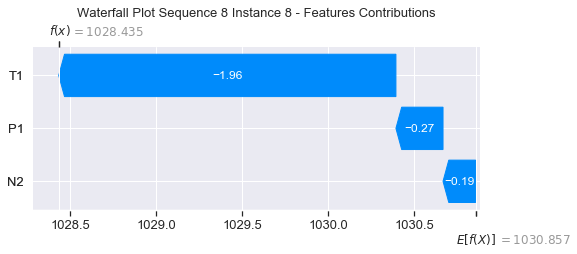

None

Contribution: [-0.39713749 -2.09371374 -0.13616962]


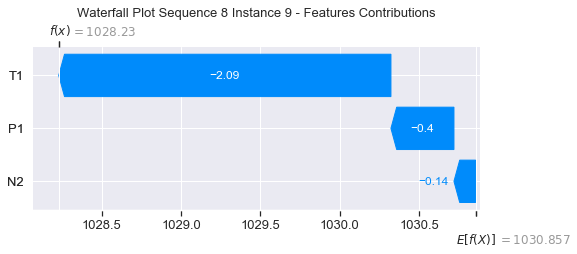

None

Contribution: [-0.59490017 -2.25408433 -0.1257847 ]


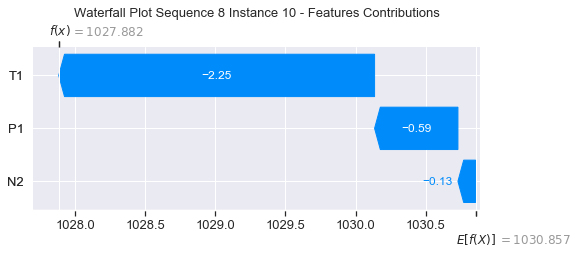

None

Contribution: [-0.30120671 -1.90424537 -0.06774212]


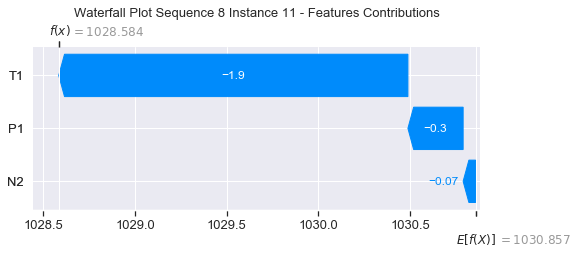

None

Contribution: [-0.20208777 -1.95446438 -0.08483168]


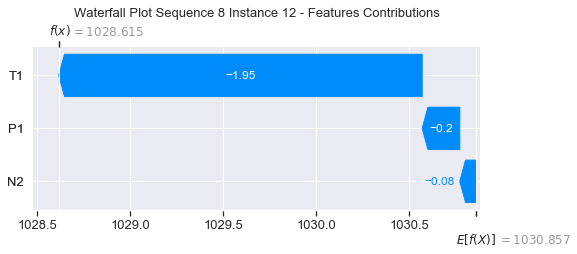

None

Contribution: [-0.2209383  -2.0264587  -0.05780014]


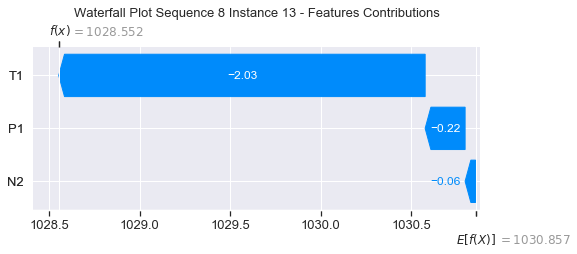

None

Contribution: [-0.21445637 -2.11686992 -0.03338893]


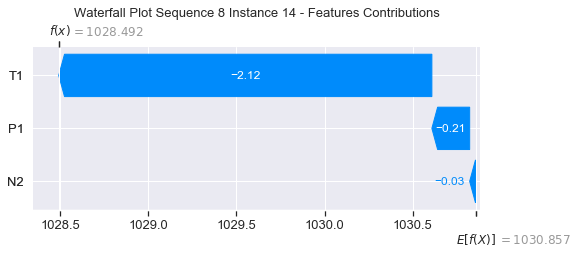

None

Contribution: [-0.22022126 -2.21540564 -0.11621716]


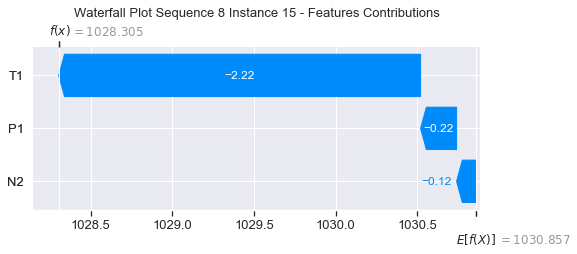

None

Contribution: [-0.31236056 -2.37856005 -0.21248482]


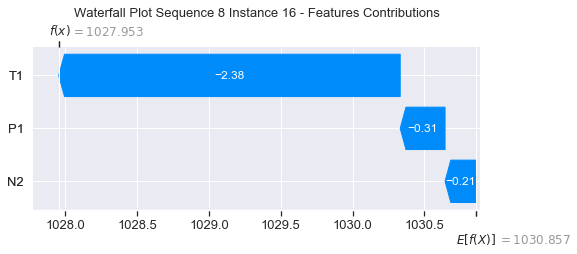

None

Contribution: [-0.31051888 -2.48398474 -0.4442264 ]


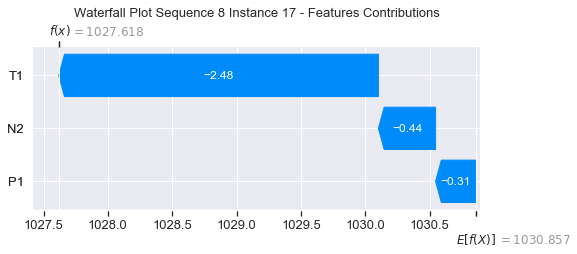

None

Contribution: [-0.34448761 -2.70872395 -0.54699034]


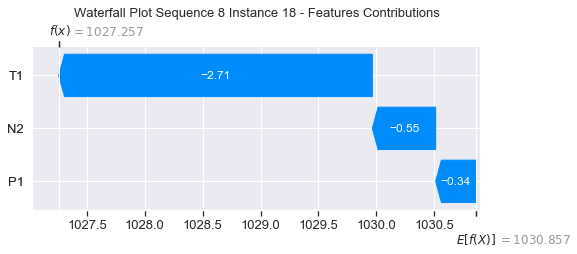

None

Contribution: [-0.47879742 -3.61473904 -0.35755239]


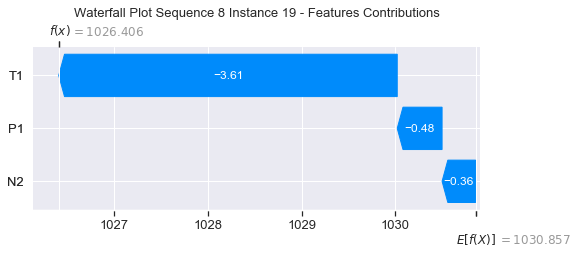

None

Contribution: [-0.39498547 -4.03066703  0.34982249]


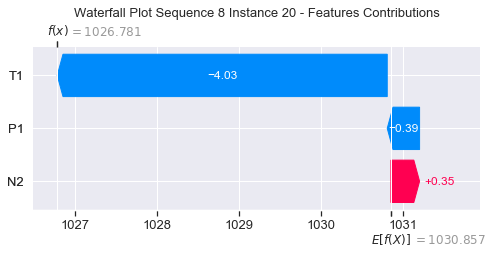

None

Contribution: [-0.21735959 -4.96619882  1.80117194]


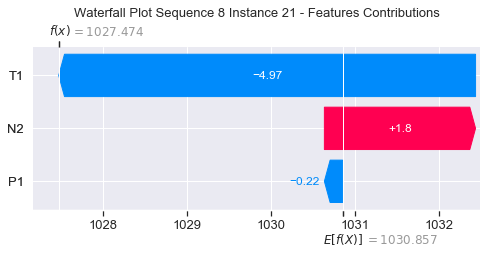

None

Contribution: [-0.08477343 -6.6567316   3.74608424]


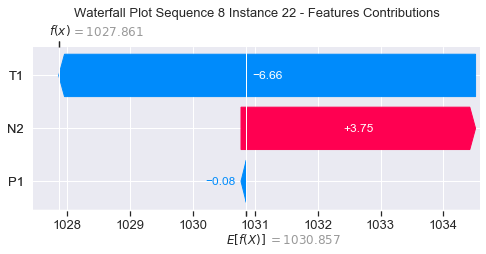

None

Contribution: [ 0.13090485 -8.29147447  5.55211648]


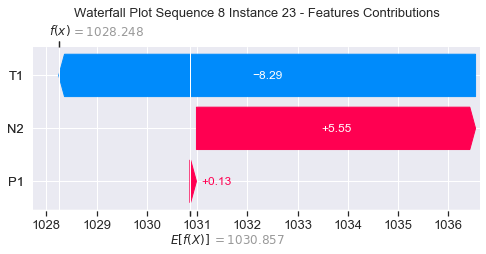

None

Contribution: [ -0.08950669 -11.07680113   5.11480199]


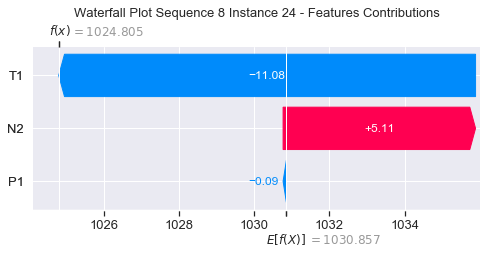

None

Contribution: [ -2.6137544  -24.693033     2.08230589]


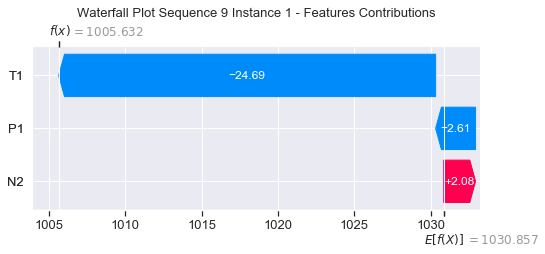

None

Contribution: [-0.43703159 -2.7579142  -0.31093335]


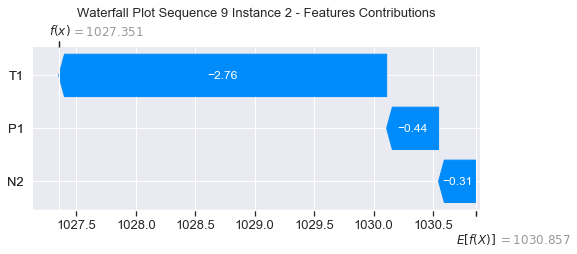

None

Contribution: [-0.59449433 -7.75918599  0.10047798]


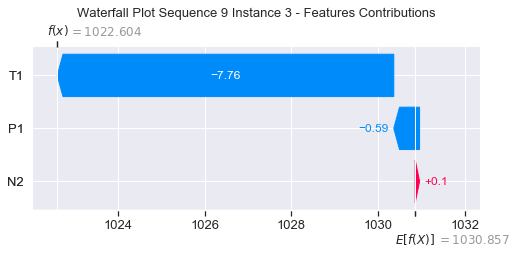

None

Contribution: [-0.41551644 -2.32780148 -0.2057532 ]


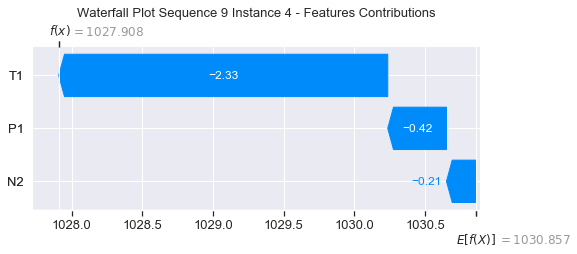

None

Contribution: [-0.29523091 -2.05249467 -0.1497599 ]


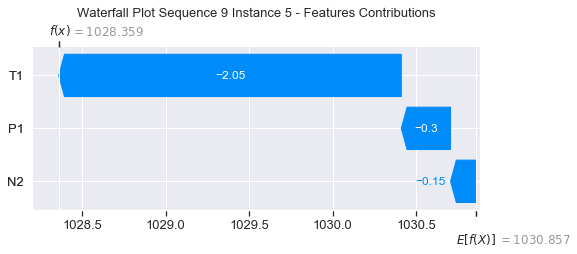

None

Contribution: [-0.26427058 -1.90145126 -0.15477522]


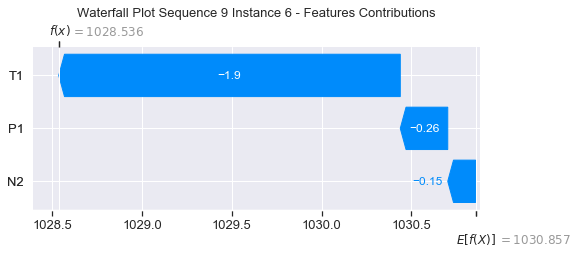

None

Contribution: [-0.25150698 -1.82781186 -0.17140416]


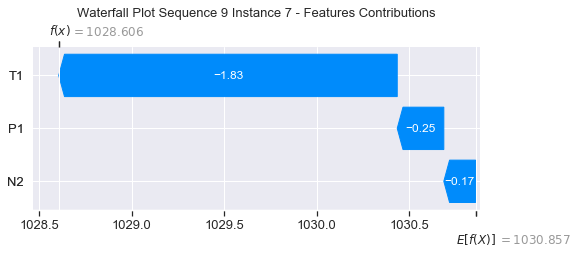

None

Contribution: [-0.23884883 -1.81090827 -0.17379577]


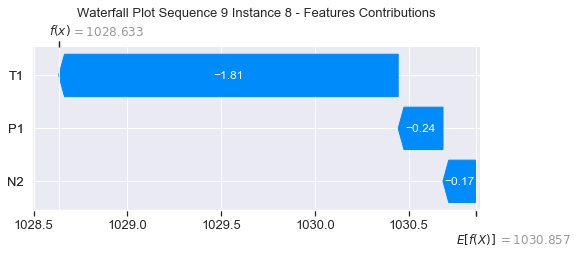

None

Contribution: [-0.23942078 -1.70206245 -0.15025583]


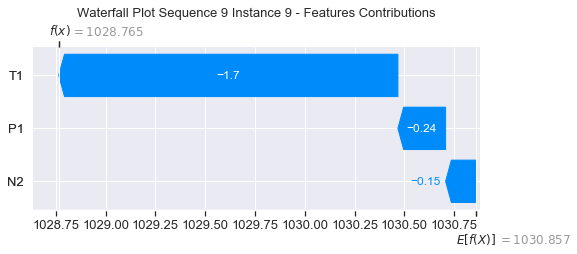

None

Contribution: [-0.33034822 -1.68610911 -0.10021415]


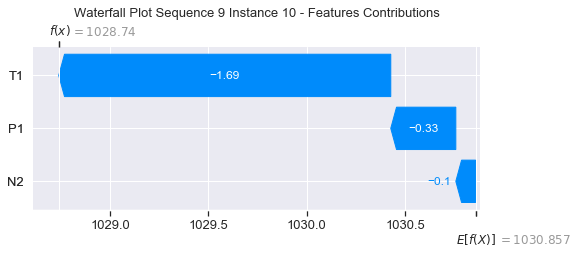

None

Contribution: [-0.23443442 -1.74171816 -0.10738934]


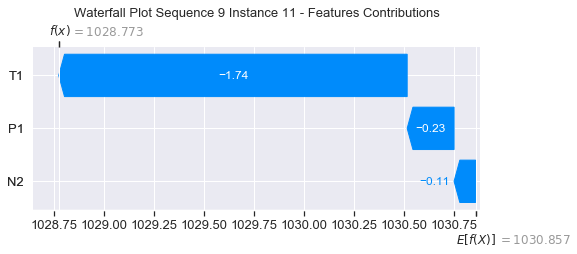

None

Contribution: [-0.22102101 -2.06563565 -0.10583067]


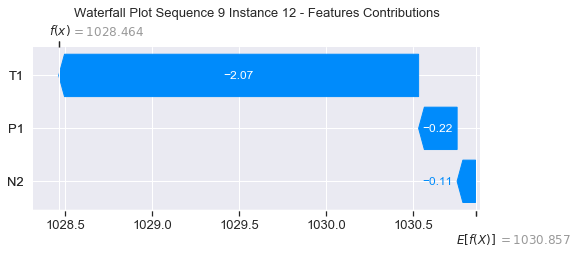

None

Contribution: [-0.20301439 -2.03858392 -0.08097064]


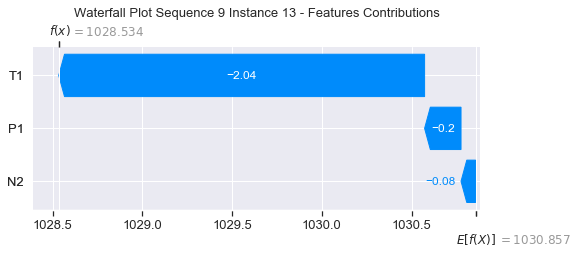

None

Contribution: [-0.14806328 -2.19084627 -0.04380216]


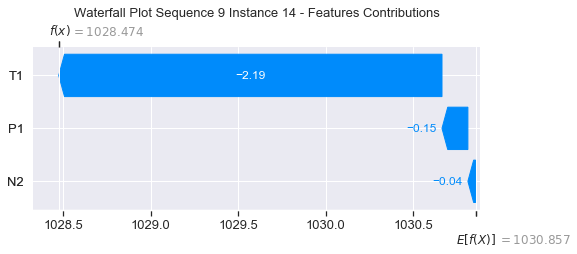

None

Contribution: [-0.23613211 -2.26890785 -0.16188758]


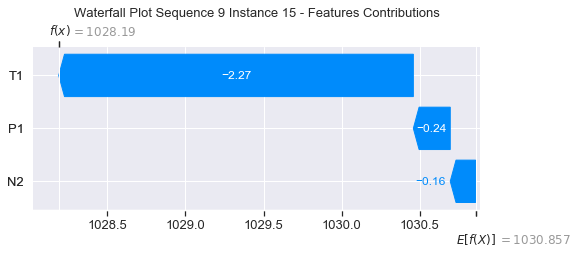

None

Contribution: [-0.28570148 -2.59677671 -0.24106953]


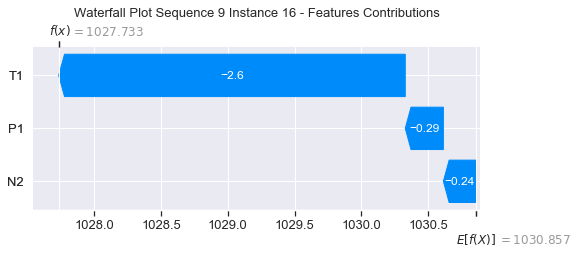

None

Contribution: [-0.30990047 -2.61510512 -0.47291434]


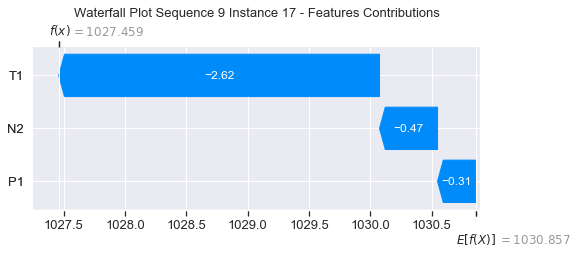

None

Contribution: [-0.35655382 -2.95286482 -0.5515904 ]


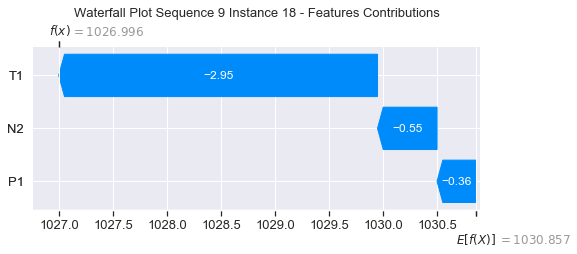

None

Contribution: [-0.46337185 -3.24697206 -0.29110788]


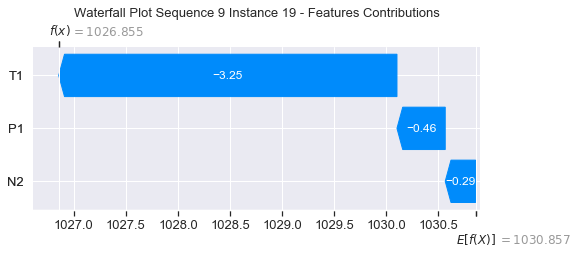

None

Contribution: [-0.20335657 -4.14254996  0.41999506]


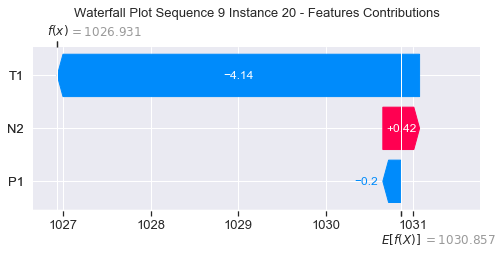

None

Contribution: [ 0.0854051  -5.45404917  1.87367535]


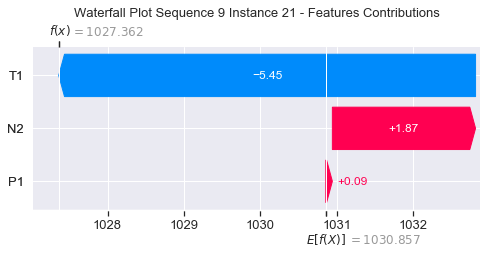

None

Contribution: [ 0.36730544 -7.77687098  3.84500861]


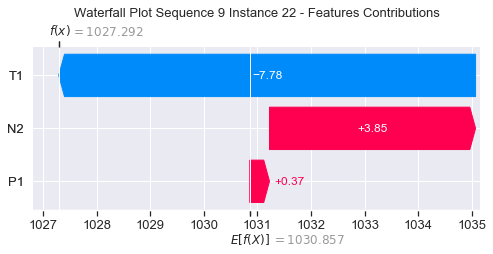

None

Contribution: [  0.27140102 -11.23611852   5.49111891]


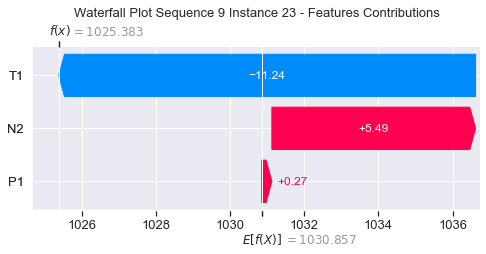

None

Contribution: [  0.48154094 -13.44406212   5.2250023 ]


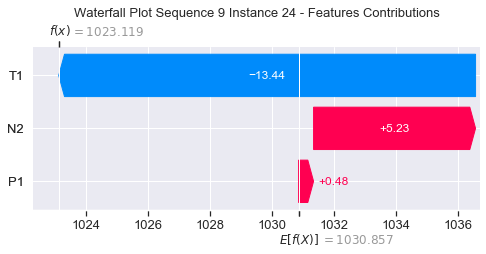

None

Contribution: [ -0.64490768 -29.5992863    2.21519744]


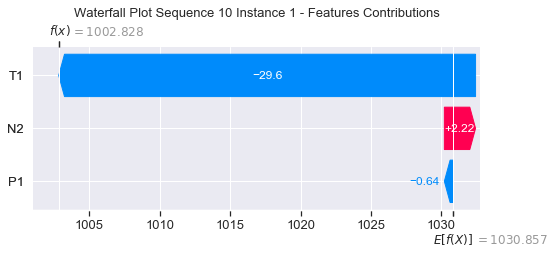

None

Contribution: [-0.24970388 -3.54981274 -0.25843814]


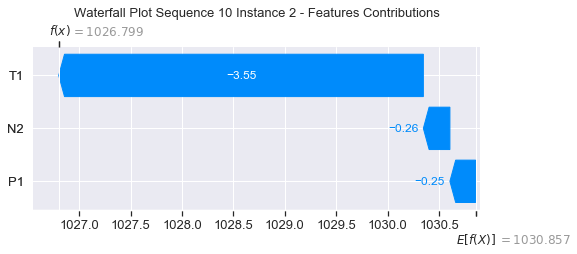

None

Contribution: [-0.52272266 -7.62236881  0.09177429]


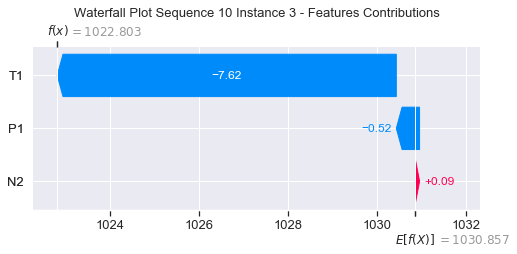

None

Contribution: [-0.19549867 -2.94391262 -0.11973168]


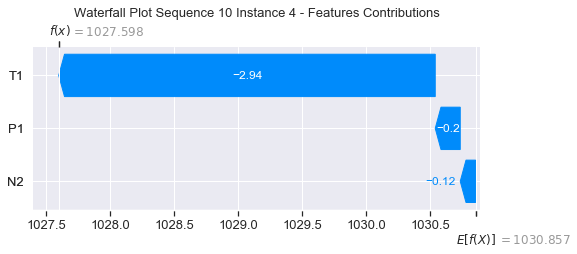

None

Contribution: [-0.13216535 -1.906167   -0.12706824]


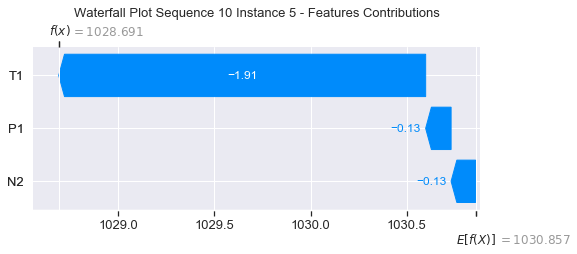

None

Contribution: [-0.05851583 -2.18969151 -0.10062644]


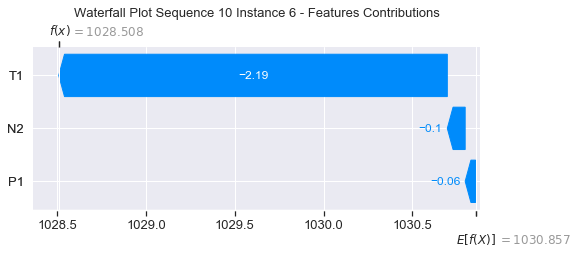

None

Contribution: [-0.09586406 -2.24033042 -0.13358771]


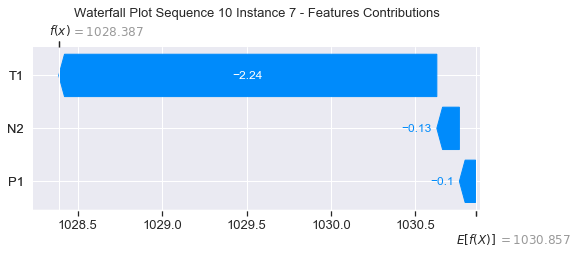

None

Contribution: [-0.05396335 -2.09634018 -0.13606582]


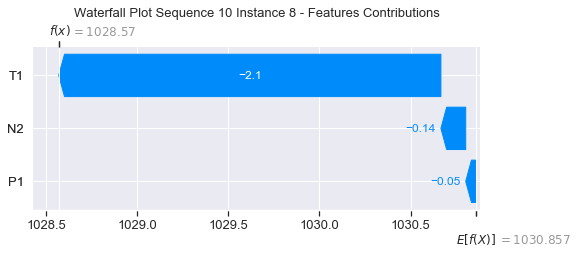

None

Contribution: [ 0.00918074 -1.78826449 -0.12280646]


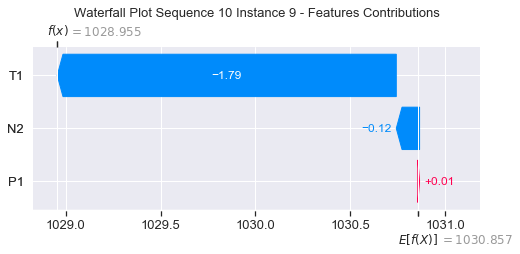

None

Contribution: [-0.04869621 -1.63723288 -0.06408623]


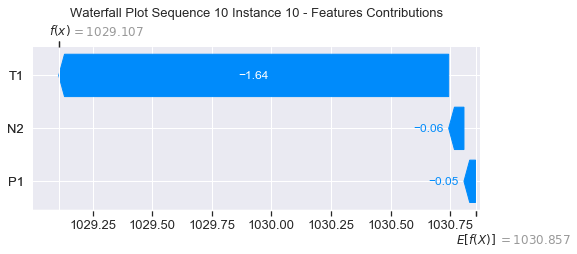

None

Contribution: [ 2.19879841e-01 -1.47415862e+00 -3.06222758e-04]


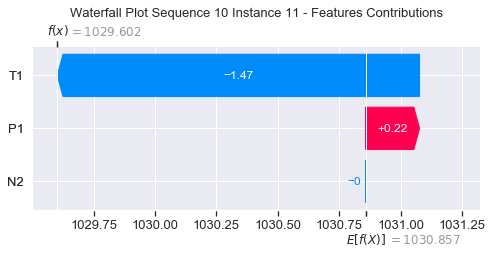

None

Contribution: [-0.00551591 -2.40751413 -0.02233074]


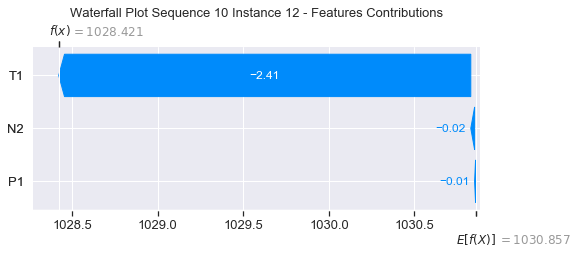

None

Contribution: [-0.01886711 -2.40647292 -0.00920511]


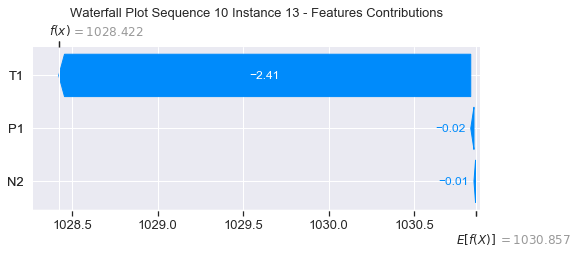

None

Contribution: [ 0.0105106  -2.05080643 -0.01834137]


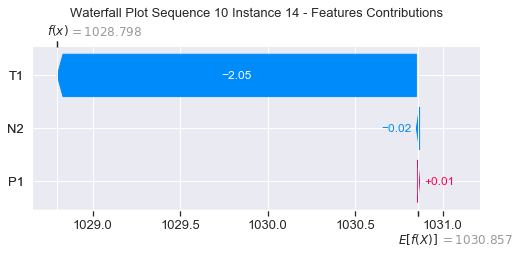

None

Contribution: [-0.03844121 -2.69871031 -0.09388519]


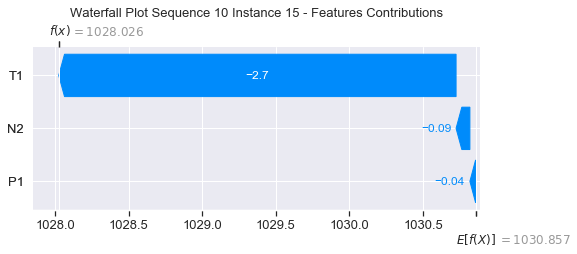

None

Contribution: [-0.30320111 -3.94251824 -0.24597346]


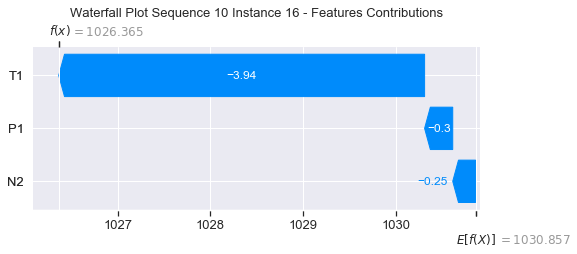

None

Contribution: [-0.14038495 -3.29371562 -0.46732723]


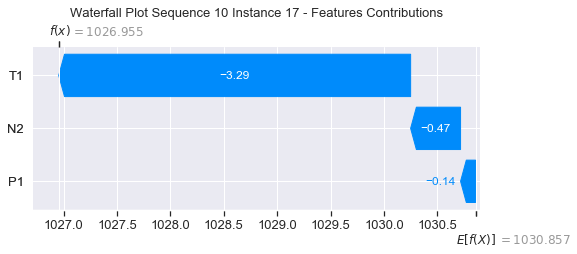

None

Contribution: [-0.15187664 -3.85591174 -0.57972299]


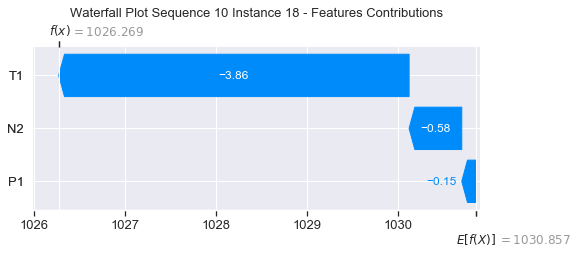

None

Contribution: [-0.30057337 -6.17893603 -0.28910976]


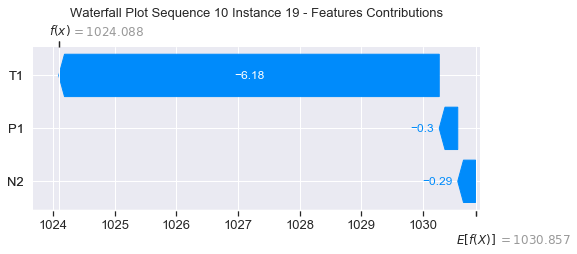

None

Contribution: [ 0.07644234 -6.26158935  0.31453808]


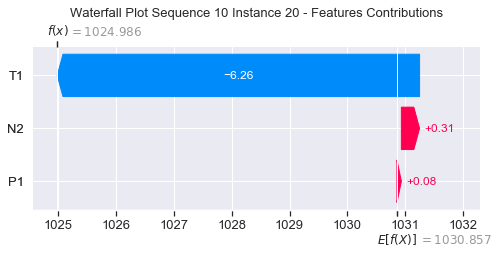

None

Contribution: [ 0.56297844 -8.29697401  1.79420548]


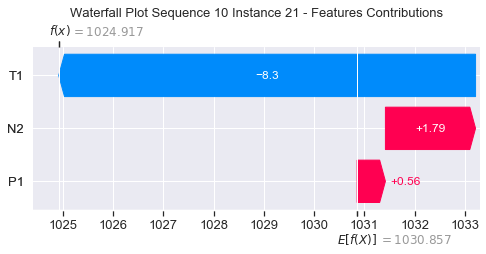

None

Contribution: [  1.24855494 -11.2375958    3.82420461]


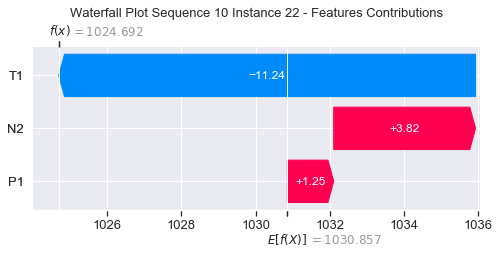

None

Contribution: [  1.70776784 -16.74030494   5.59261562]


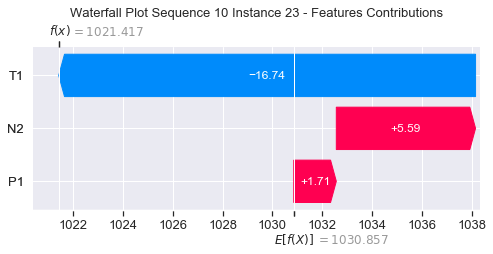

None

Contribution: [  1.6239034  -17.36744633   5.1394045 ]


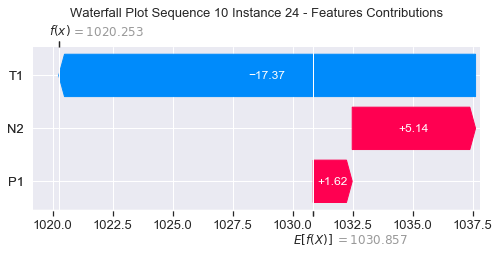

None

Contribution: [ -0.70038442 -29.67152078   1.49866743]


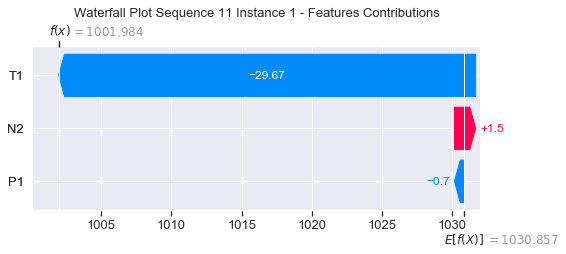

None

Contribution: [-0.03001896 -3.8760925  -0.30972432]


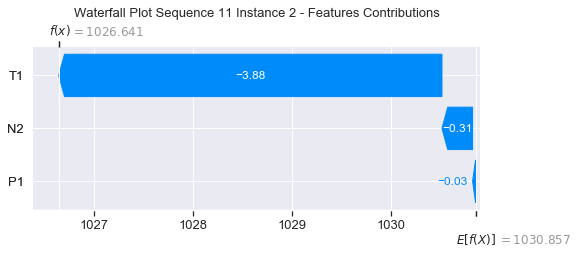

None

Contribution: [ 0.05827028 -7.43745422  0.18703184]


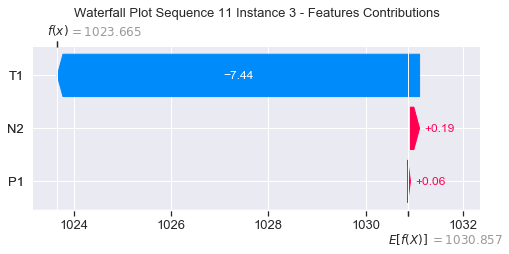

None

Contribution: [ 0.09348536 -2.26404237 -0.09346959]


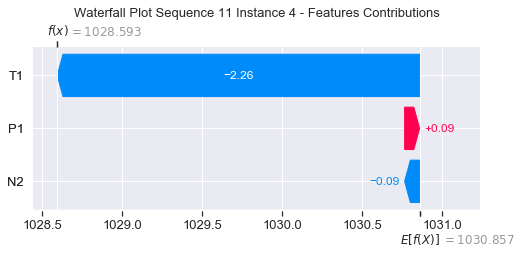

None

Contribution: [ 0.06264085 -1.77368787 -0.05787172]


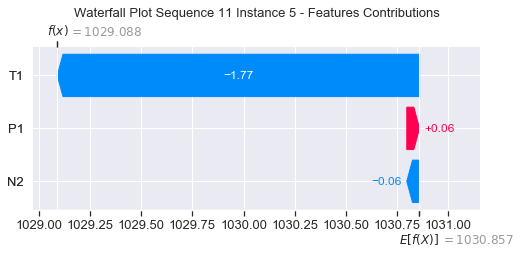

None

Contribution: [ 0.09359043 -1.56480461 -0.06561818]


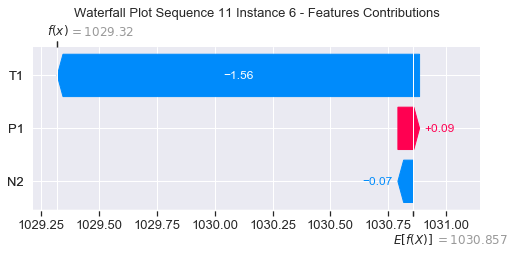

None

Contribution: [ 0.04757975 -1.49406574 -0.09113127]


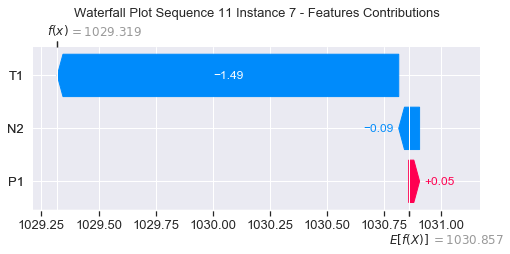

None

Contribution: [ 0.05441643 -1.47637989 -0.0993084 ]


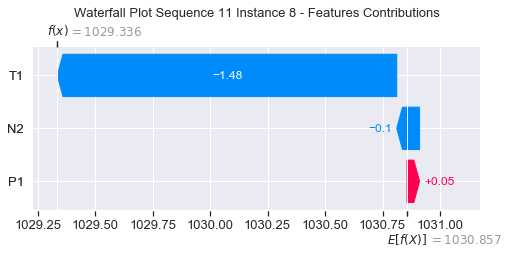

None

Contribution: [-0.10875912 -1.40084077 -0.10540041]


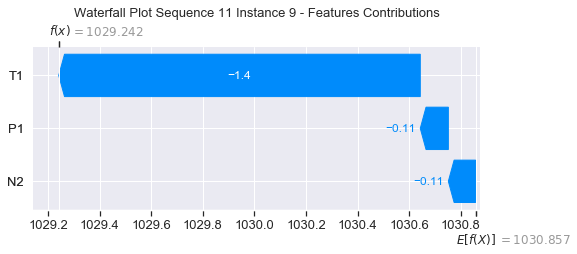

None

Contribution: [-0.1739961  -1.38194521 -0.05410266]


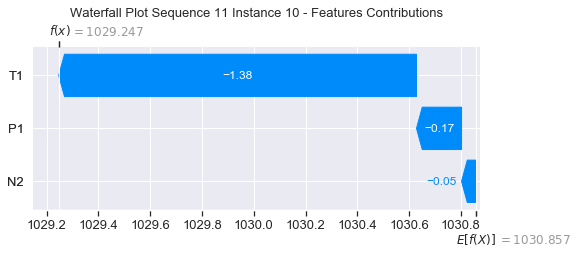

None

Contribution: [ 0.04835693 -1.44486364 -0.04648295]


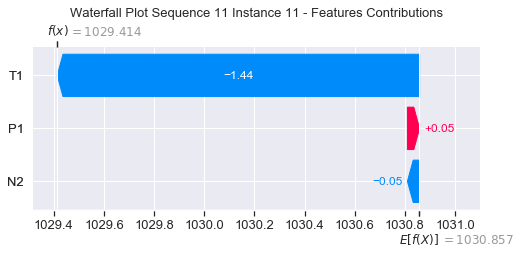

None

Contribution: [ 0.11334364 -1.59797347 -0.04788925]


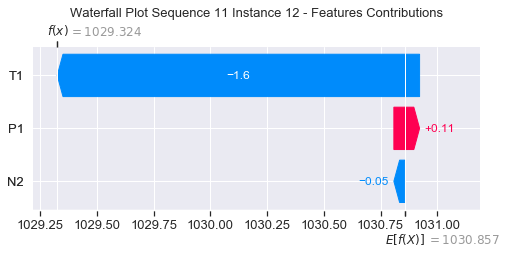

None

Contribution: [ 0.10238699 -1.52558886 -0.04025524]


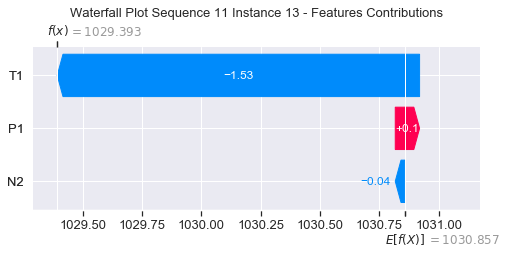

None

Contribution: [ 0.09831016 -1.49726799 -0.04692913]


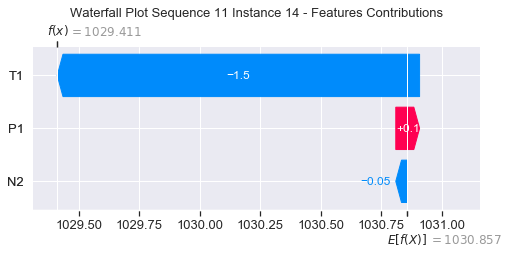

None

Contribution: [ 0.0828255  -1.62510958 -0.13581306]


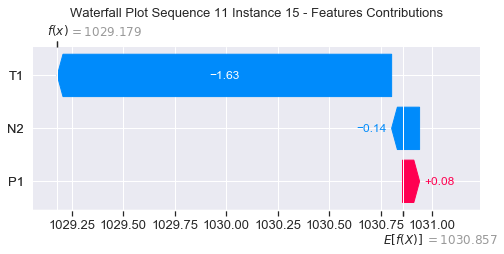

None

Contribution: [ 0.23472247 -1.84829744 -0.22095522]


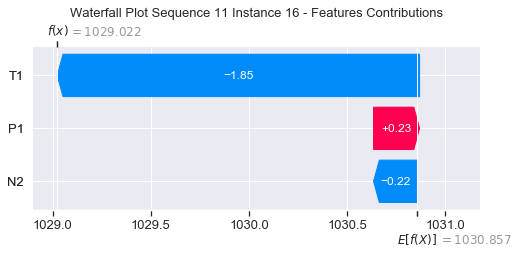

None

Contribution: [ 0.0100448  -1.67499101 -0.40684569]


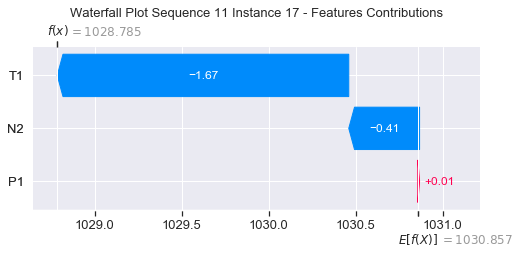

None

Contribution: [ 0.03513695 -1.7350378  -0.44939243]


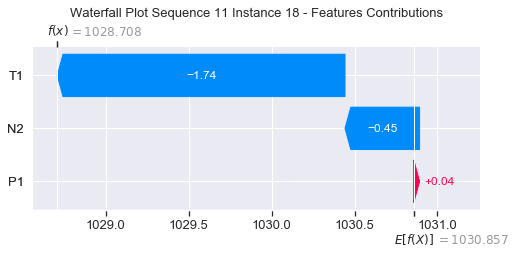

None

Contribution: [ 0.21589902 -1.74010722 -0.14736908]


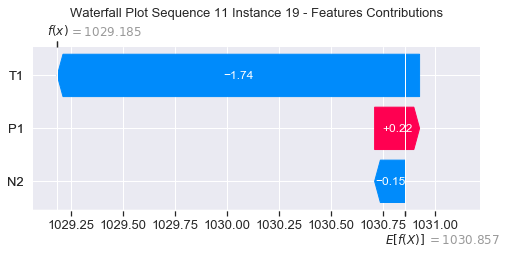

None

Contribution: [ 0.35782161 -1.67391548  0.4891119 ]


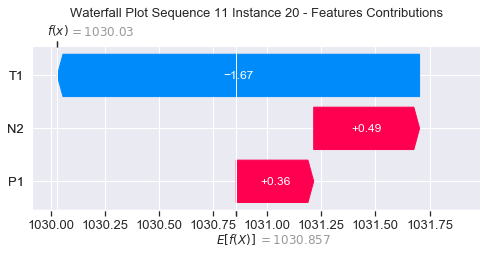

None

Contribution: [ 0.89617328 -1.74310171  1.84923179]


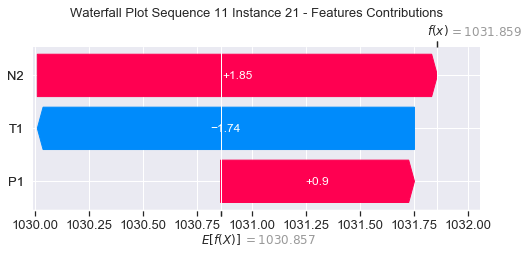

None

Contribution: [ 1.6386525  -2.27199171  3.67640765]


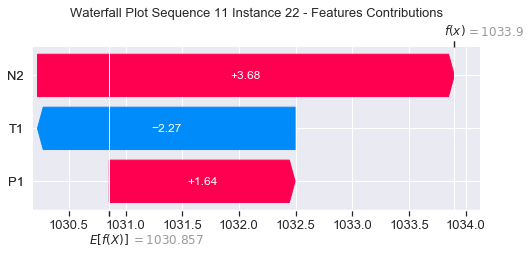

None

Contribution: [ 2.22752229 -3.36787104  5.19885676]


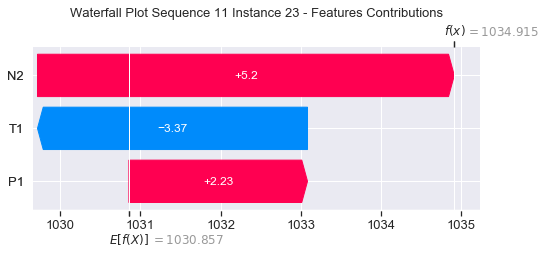

None

Contribution: [ 2.49757131 -5.17847806  4.93173818]


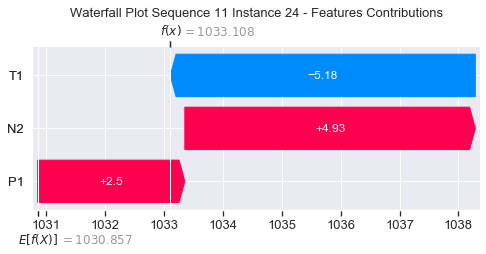

None

Contribution: [  2.83980564 -15.46582623   2.06779349]


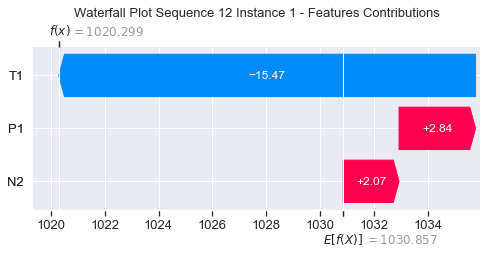

None

Contribution: [ 0.12989166 -2.27713403 -0.35666171]


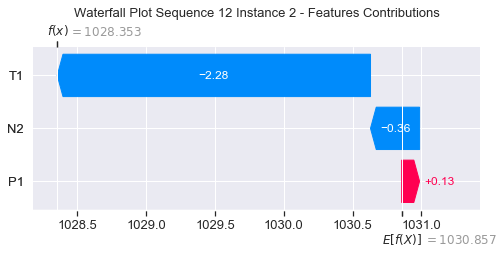

None

Contribution: [ 0.29971153 -5.08674112 -0.07311632]


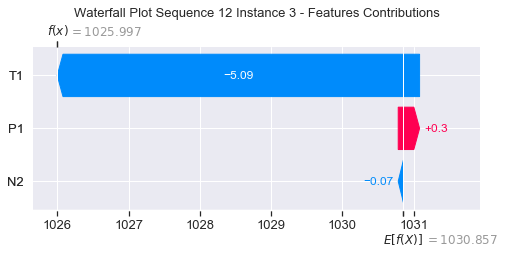

None

Contribution: [ 0.07180707 -1.85549781 -0.16362866]


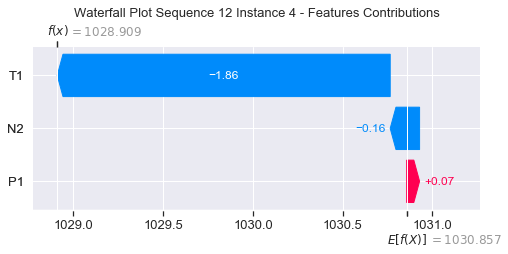

None

Contribution: [ 0.05031508 -1.44507556 -0.09255433]


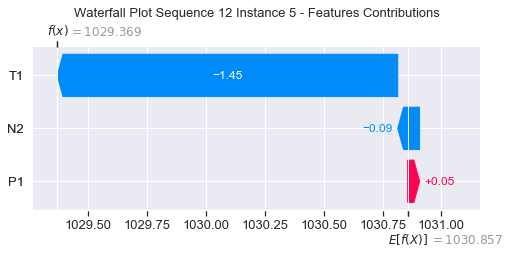

None

Contribution: [ 0.05156396 -1.4982467  -0.08802989]


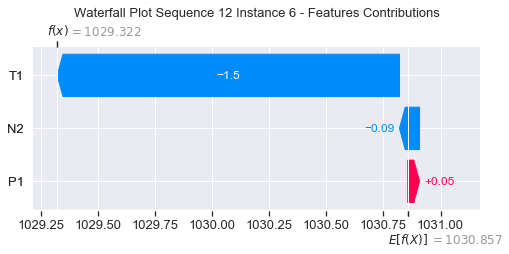

None

Contribution: [ 0.04049613 -1.51172304 -0.10784831]


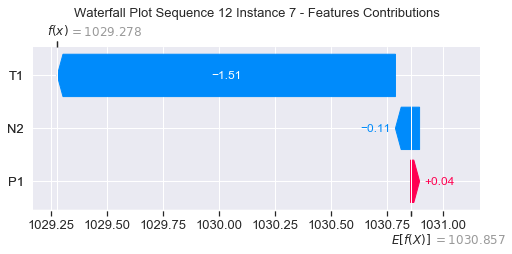

None

Contribution: [ 0.03374079 -1.47018402 -0.11529814]


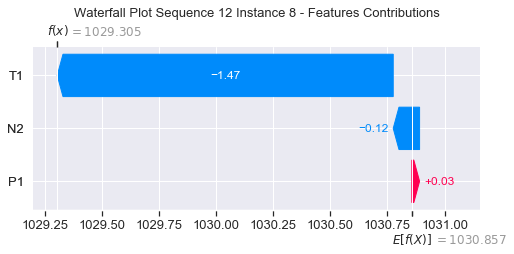

None

Contribution: [-0.02999998 -1.48630872 -0.11055704]


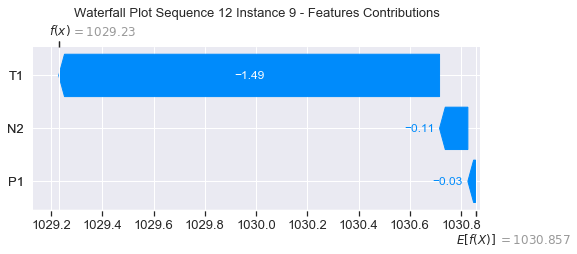

None

Contribution: [ 0.0427676  -1.4248525  -0.03275989]


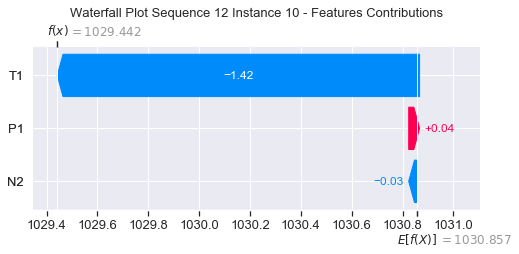

None

Contribution: [-0.02215923 -1.41583049 -0.08193304]


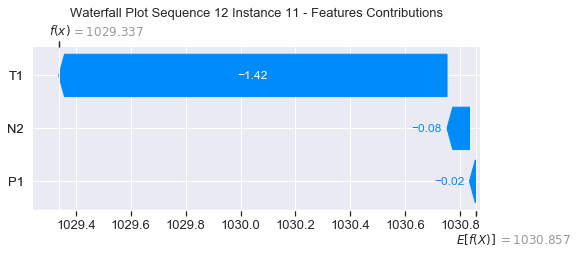

None

Contribution: [ 0.02513406 -1.75780481 -0.08879252]


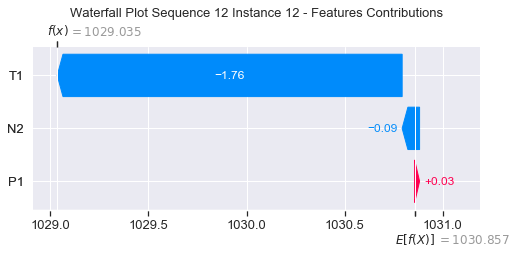

None

Contribution: [ 0.04407786 -1.70057937 -0.0758984 ]


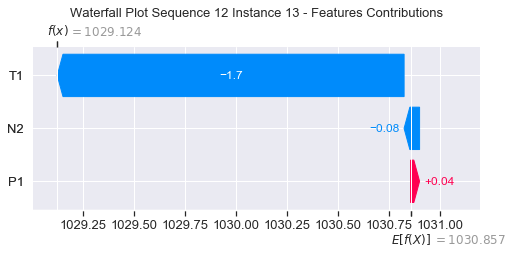

None

Contribution: [ 0.07729388 -1.89767355 -0.0838002 ]


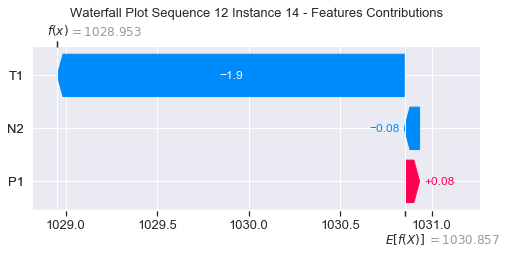

None

Contribution: [ 0.01718534 -1.84609278 -0.15813103]


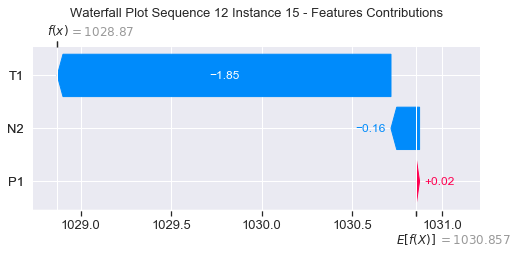

None

Contribution: [-0.01400012 -2.10193337 -0.22302621]


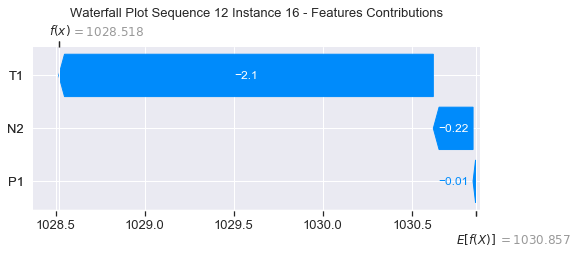

None

Contribution: [-0.01194848 -2.04368605 -0.3826141 ]


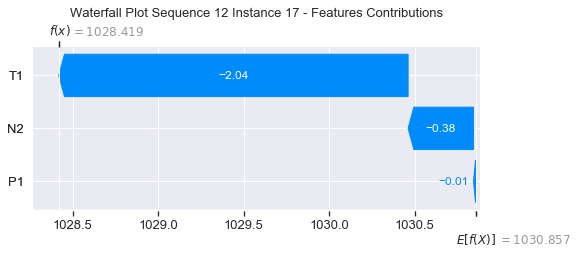

None

Contribution: [-2.06731180e-04 -2.17395765e+00 -3.94009550e-01]


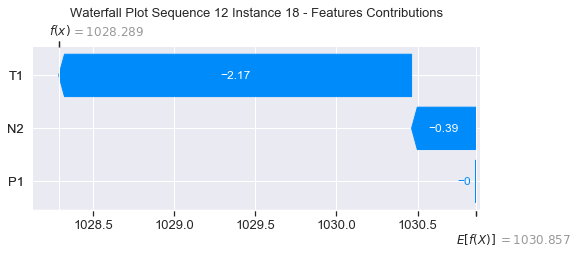

None

Contribution: [-0.07808401 -2.56395429 -0.12911323]


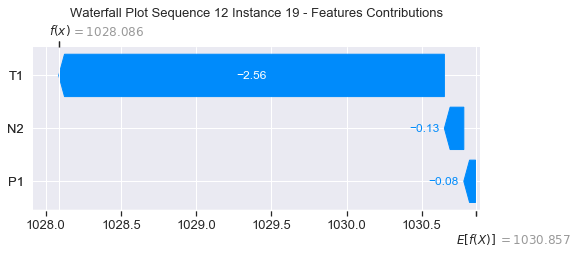

None

Contribution: [ 0.40188764 -2.42731683  0.64922193]


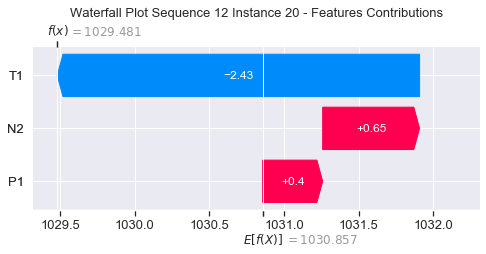

None

Contribution: [ 0.90391609 -2.82717965  2.03862489]


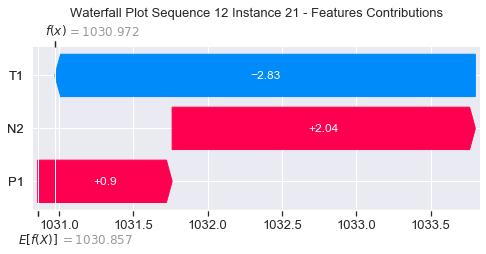

None

Contribution: [ 1.50691644 -3.71415431  3.89617861]


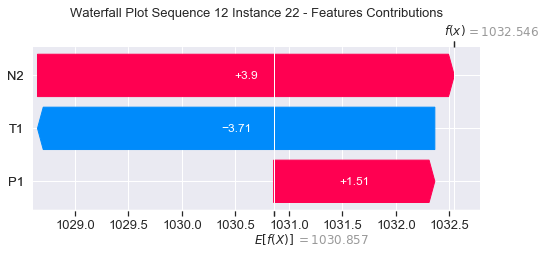

None

Contribution: [ 1.86490361 -5.88243906  5.49272729]


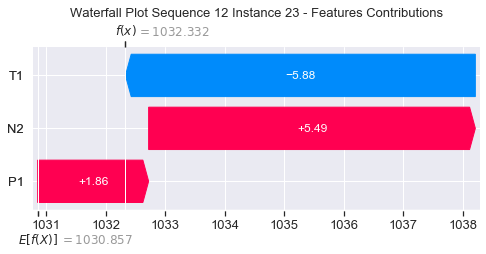

None

Contribution: [ 2.0757387  -7.02764194  5.390338  ]


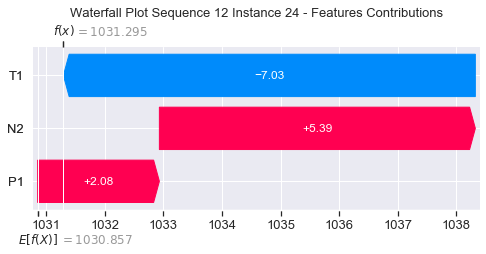

None

Contribution: [  1.57082316 -16.88690184   3.40724576]


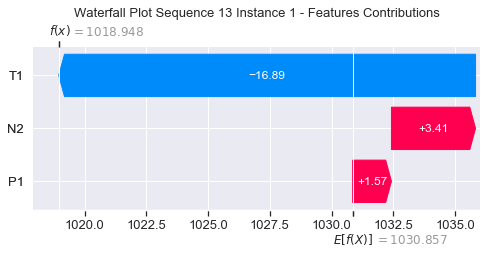

None

Contribution: [ 0.03107587 -2.80281723 -0.30734328]


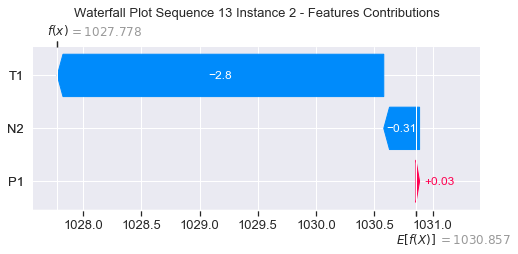

None

Contribution: [-0.08838605 -5.23744762  0.04435285]


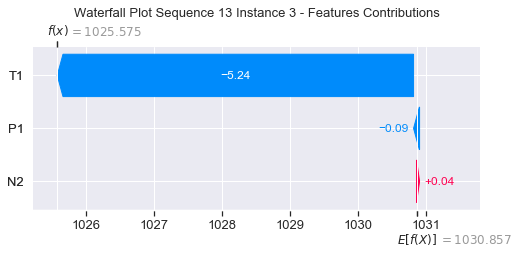

None

Contribution: [-0.11890863 -1.79024603 -0.1200196 ]


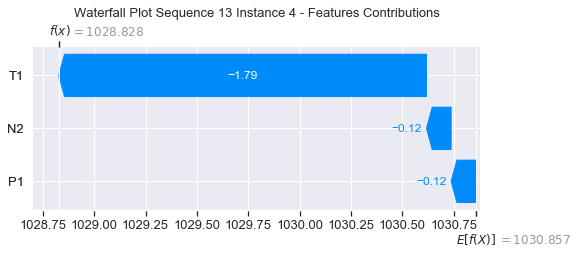

None

Contribution: [-0.06650659 -1.67187574 -0.0860691 ]


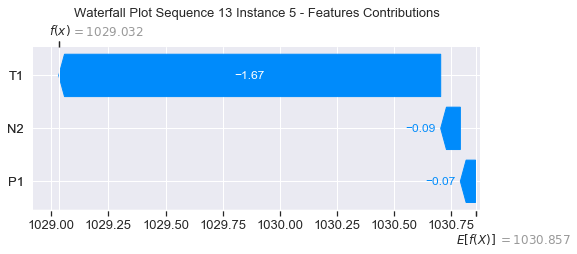

None

Contribution: [-0.06110602 -1.54006135 -0.09677159]


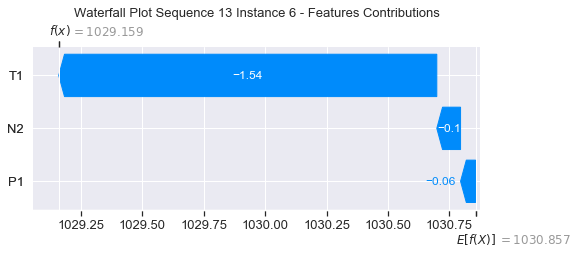

None

Contribution: [-0.06620463 -1.50397362 -0.11348449]


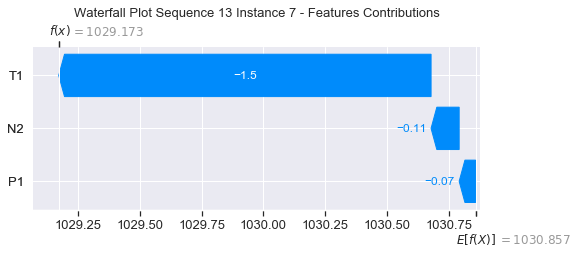

None

Contribution: [-0.06479413 -1.45782734 -0.1171746 ]


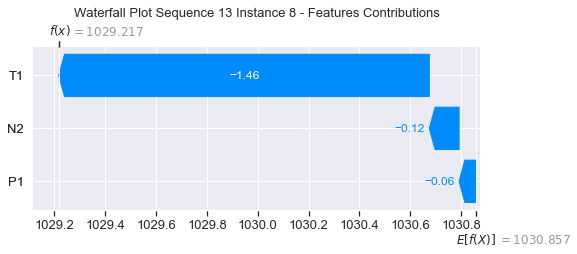

None

Contribution: [-0.08111288 -1.42972104 -0.08388024]


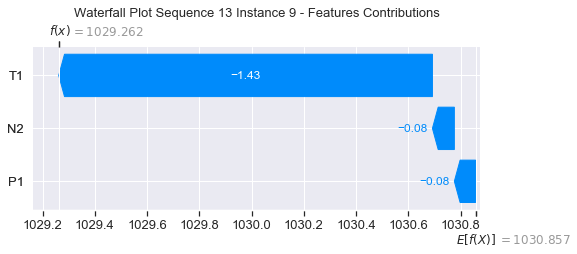

None

Contribution: [-0.16235578 -1.82340378 -0.06946414]


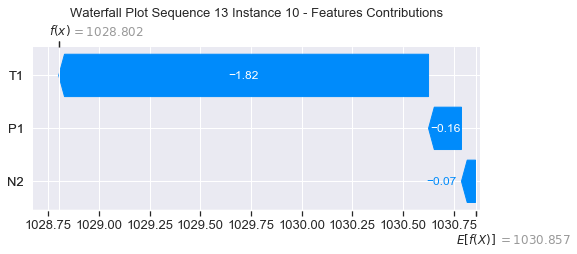

None

Contribution: [-0.06046206 -1.31779447 -0.04544691]


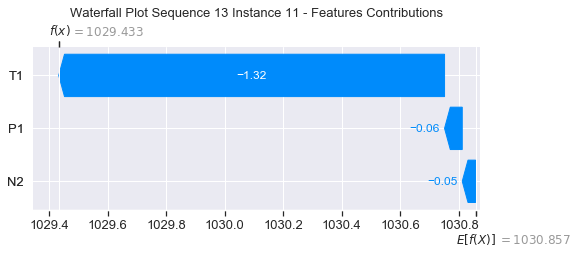

None

Contribution: [-0.04519709 -1.44494005 -0.05642574]


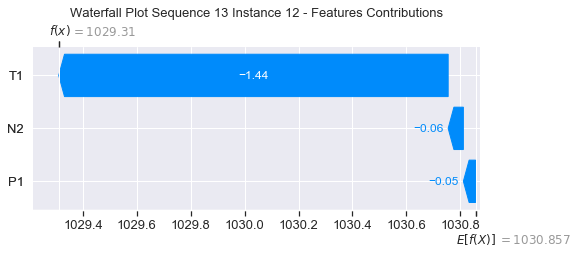

None

Contribution: [-0.03632085 -1.41033224 -0.04493393]


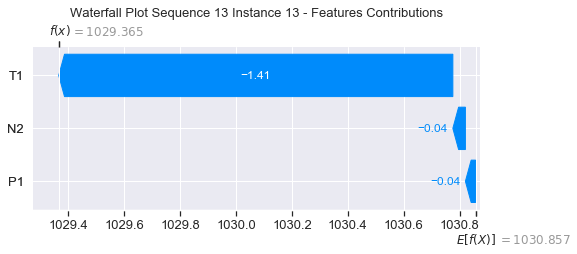

None

Contribution: [-0.01311515 -1.3075964  -0.0452292 ]


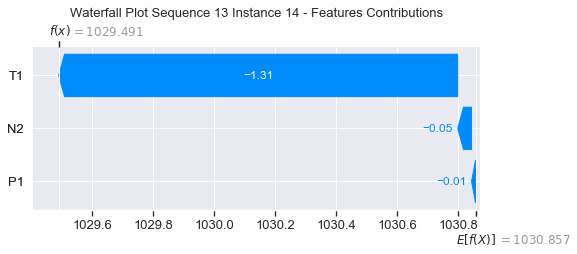

None

Contribution: [-0.08104599 -1.49932472 -0.13213433]


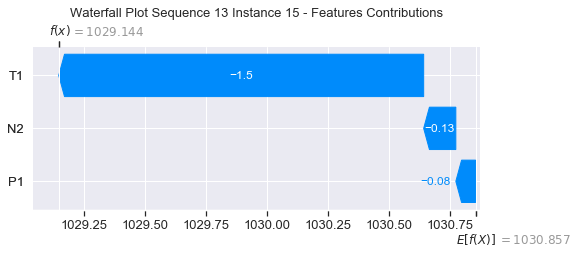

None

Contribution: [-0.17327843 -1.60504059 -0.21327774]


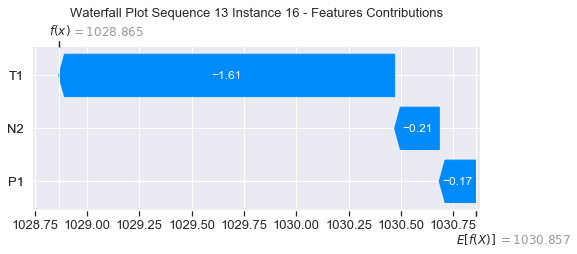

None

Contribution: [-0.13161277 -1.59843154 -0.35718293]


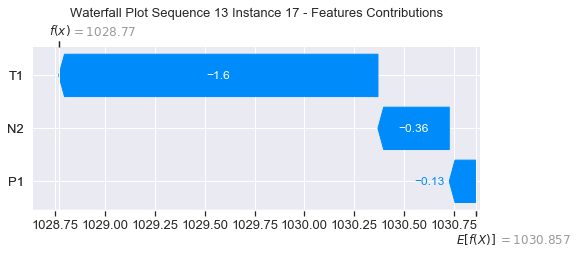

None

Contribution: [-0.14644514 -1.64908841 -0.37163829]


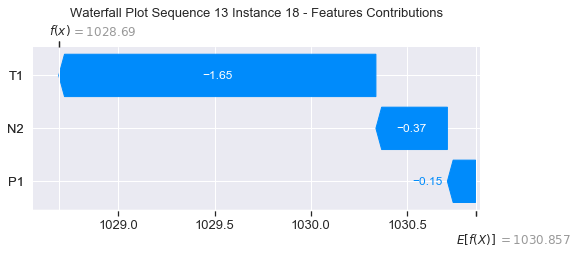

None

Contribution: [-0.29864118 -1.93866909 -0.08316582]


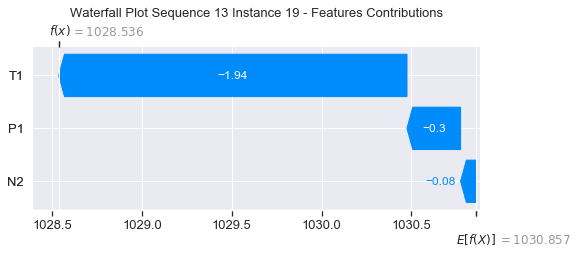

None

Contribution: [ 0.10733734 -1.66016642  0.64810492]


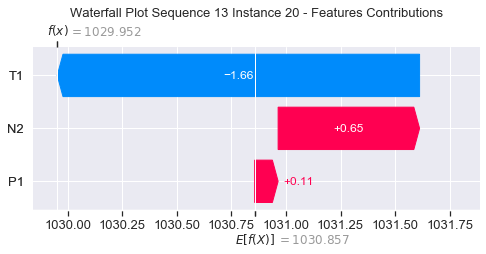

None

Contribution: [ 0.49453958 -1.57191893  2.04854857]


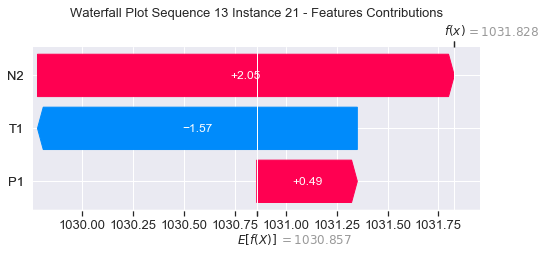

None

Contribution: [ 0.90906215 -1.77823369  3.92627037]


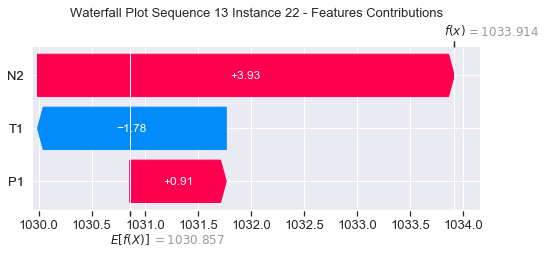

None

Contribution: [ 0.98871817 -2.86495562  5.50572743]


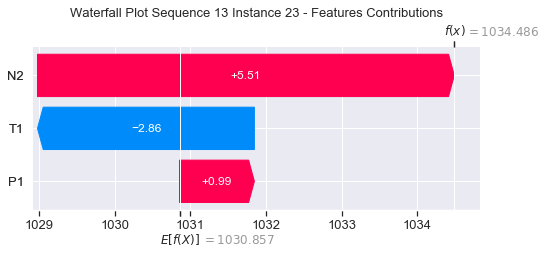

None

Contribution: [ 1.12474628 -4.36112853  5.30663212]


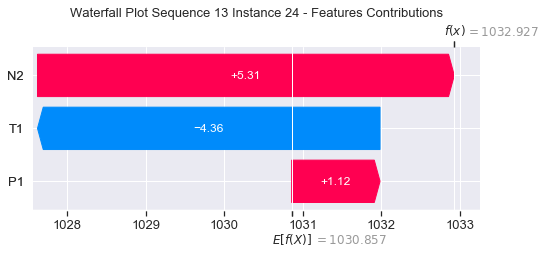

None

Contribution: [  0.50982238 -11.77836499   3.27781843]


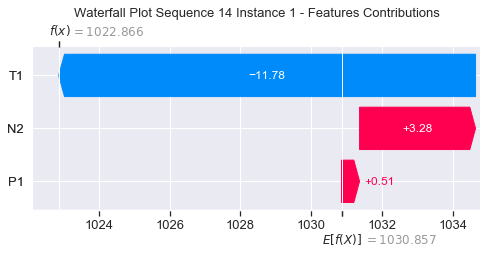

None

Contribution: [-0.14480026 -2.02937387 -0.23989922]


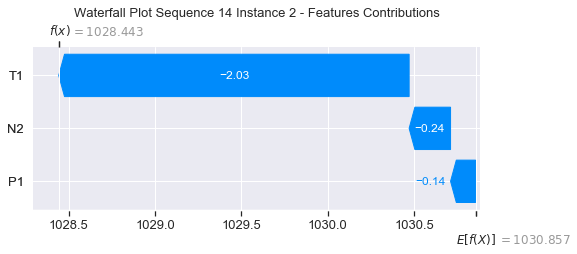

None

Contribution: [-0.19542489 -2.83774426  0.23336365]


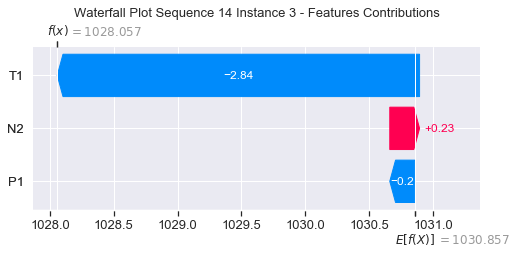

None

Contribution: [ 0.01134069 -1.19277635 -0.04698643]


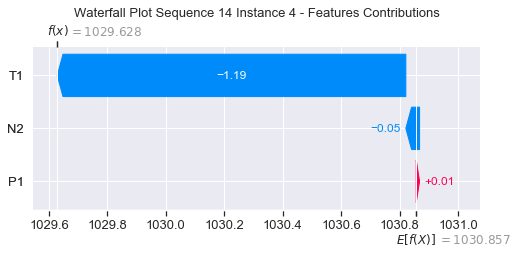

None

Contribution: [-0.02735126 -0.93367513 -0.09020773]


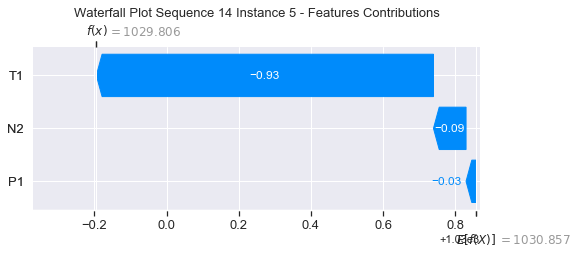

None

Contribution: [-0.05126132 -1.05443306 -0.09914643]


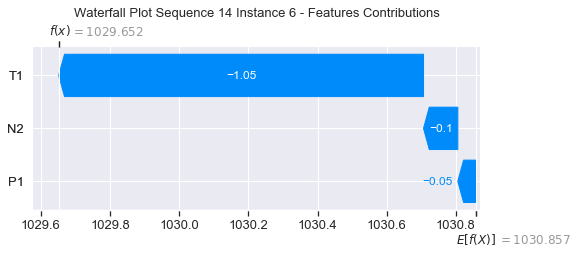

None

Contribution: [-0.0518278  -1.06016373 -0.11234971]


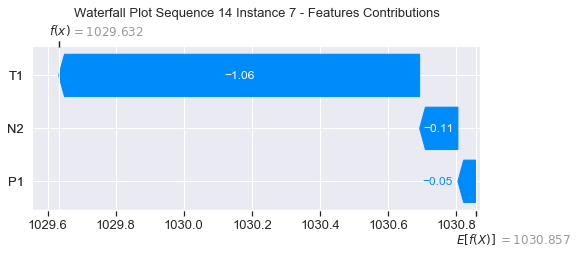

None

Contribution: [-0.0542735  -1.0416901  -0.11511902]


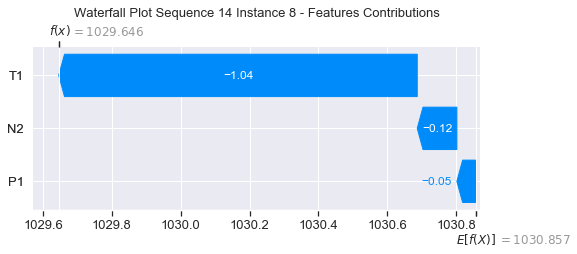

None

Contribution: [-0.07693759 -0.83752283 -0.08336738]


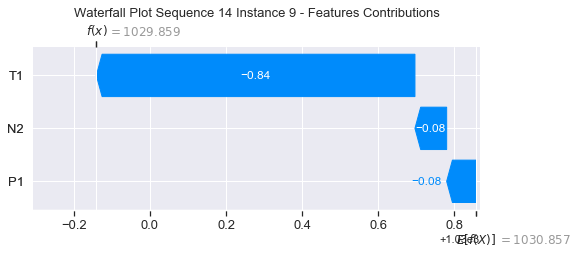

None

Contribution: [-0.11699423 -0.82587551 -0.04363191]


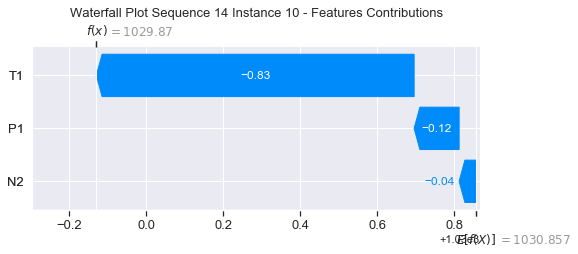

None

Contribution: [-0.08804319 -0.85281878 -0.05518884]


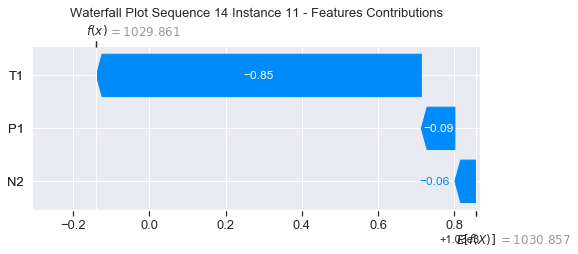

None

Contribution: [-0.05781693 -1.26454324 -0.07131094]


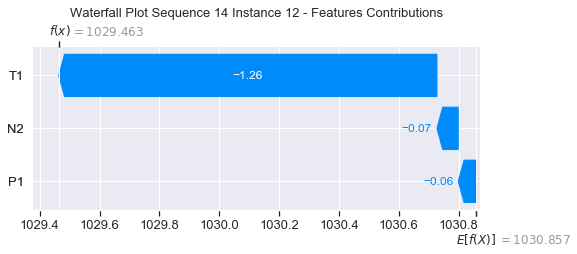

None

Contribution: [-0.04168549 -1.19566555 -0.06433979]


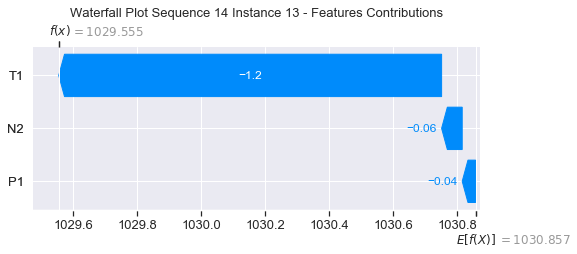

None

Contribution: [-0.04068481 -1.23938418 -0.10273991]


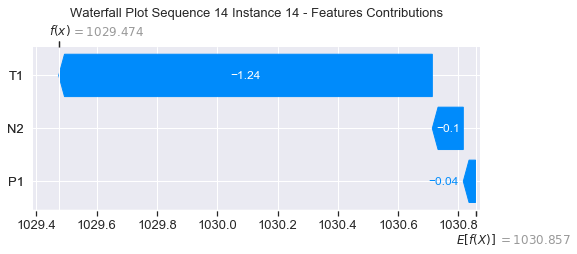

None

Contribution: [-0.07985589 -1.35061996 -0.15044943]


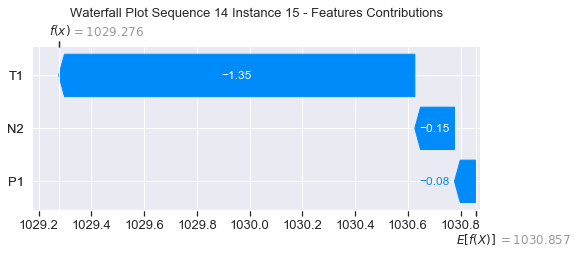

None

Contribution: [-0.17618117 -1.67229678 -0.20926638]


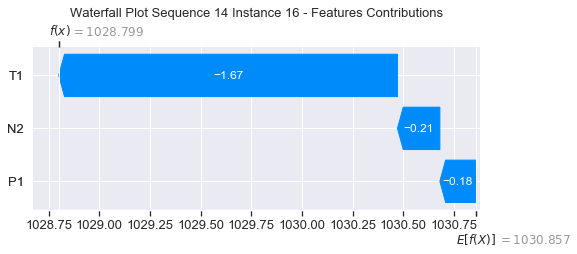

None

Contribution: [-0.12382697 -1.48933928 -0.34792864]


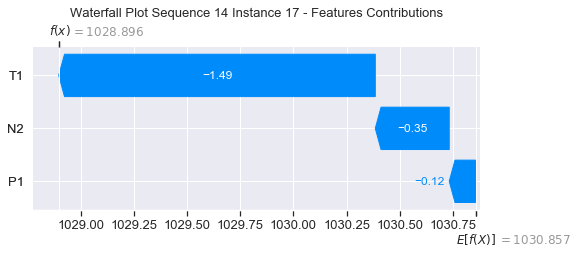

None

Contribution: [-0.13424358 -1.58286489 -0.34272354]


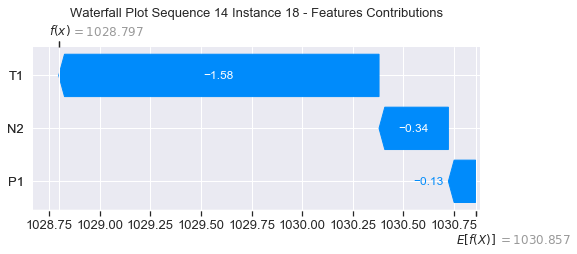

None

Contribution: [-0.11325899 -1.92741595  0.00902223]


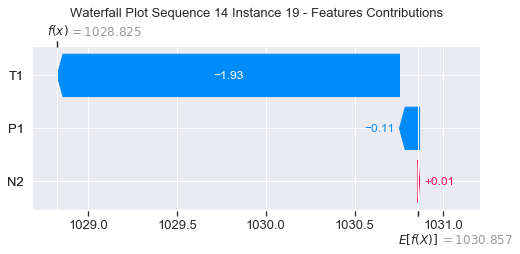

None

Contribution: [ 0.16054372 -1.54144101  0.69790784]


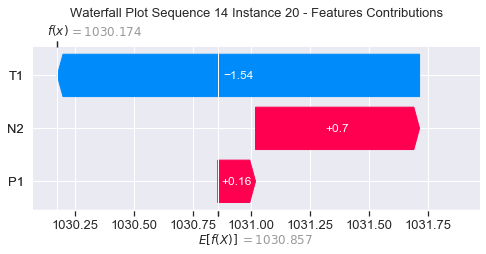

None

Contribution: [ 0.54362451 -1.56822676  2.0591584 ]


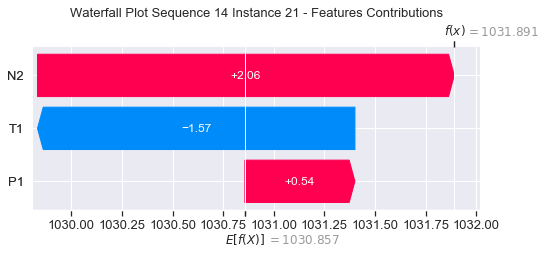

None

Contribution: [ 0.97642905 -2.01573884  3.8835198 ]


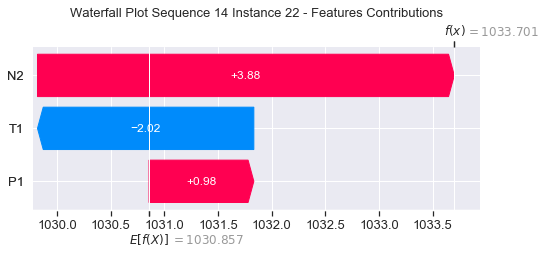

None

Contribution: [ 1.03189436 -3.68210884  5.42073812]


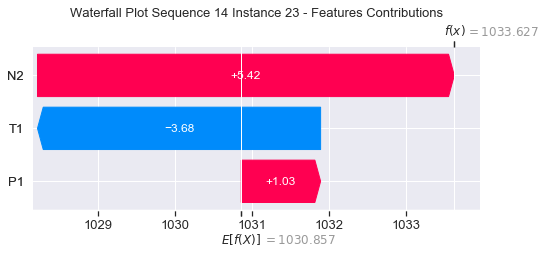

None

Contribution: [ 1.16392841 -5.22198422  5.15873549]


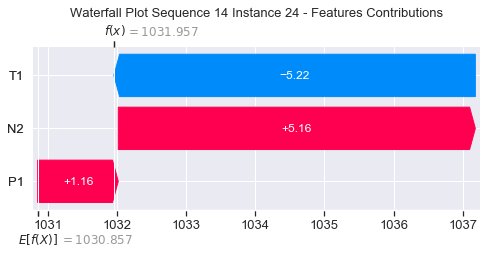

None

Contribution: [  0.18927977 -14.08878441   2.31010456]


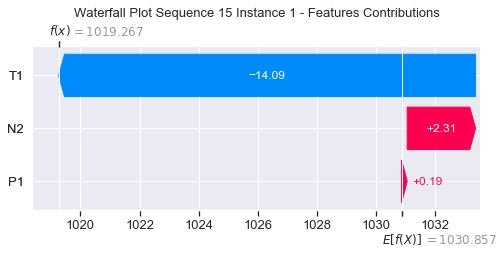

None

Contribution: [-0.12677943 -2.3476704  -0.27852028]


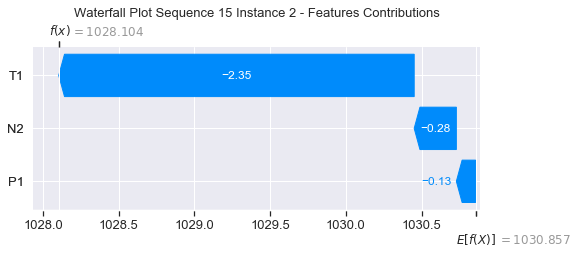

None

Contribution: [-0.04068606 -4.36340981  0.14432301]


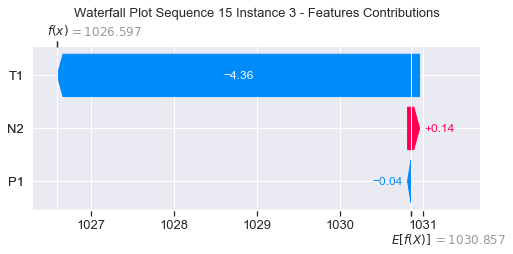

None

Contribution: [-0.16560534 -1.93673529 -0.11435693]


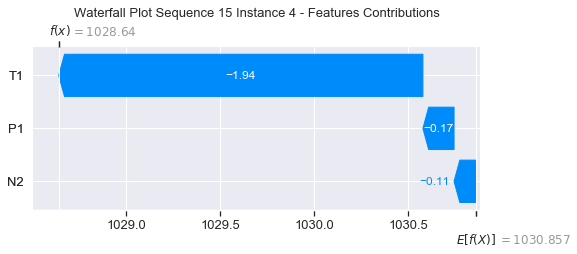

None

Contribution: [-0.04993836 -1.34548794 -0.07219138]


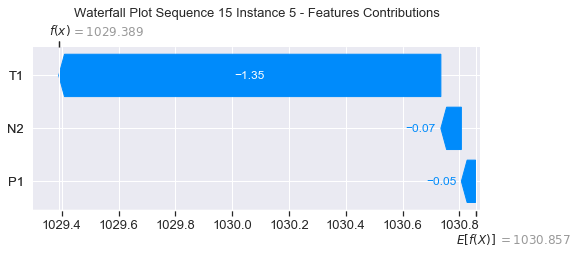

None

Contribution: [-0.02903641 -1.38617971 -0.06757857]


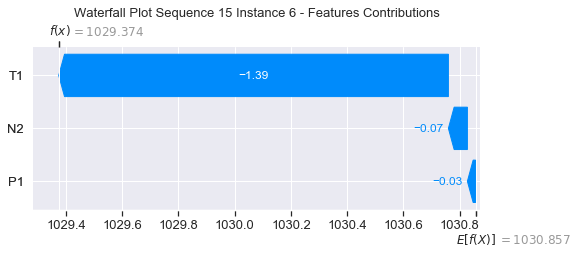

None

Contribution: [-0.03607143 -1.31815363 -0.08345527]


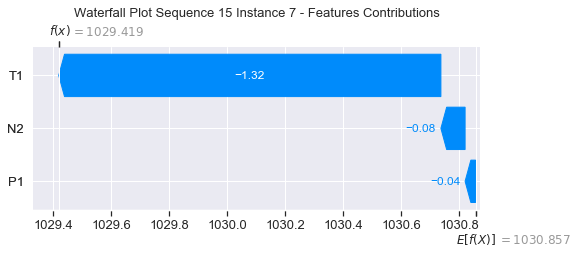

None

Contribution: [-0.05032092 -1.30652737 -0.09470009]


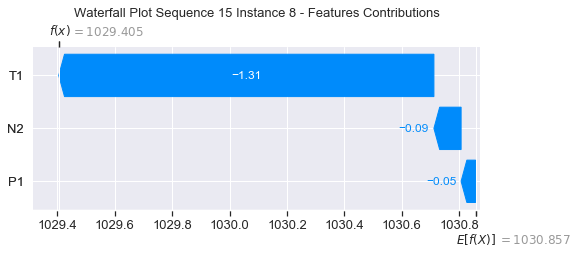

None

Contribution: [-0.13678145 -1.17873438 -0.07706679]


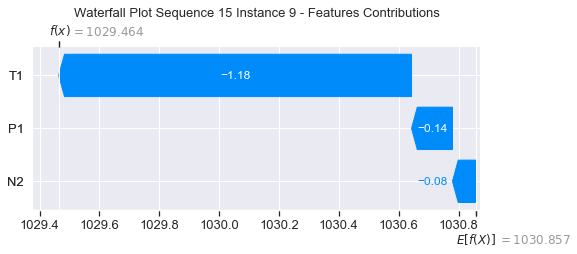

None

Contribution: [-0.12405844 -1.16763131 -0.03365632]


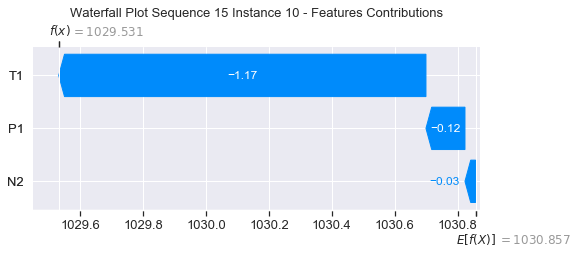

None

Contribution: [-0.14641333 -1.24129796 -0.06583189]


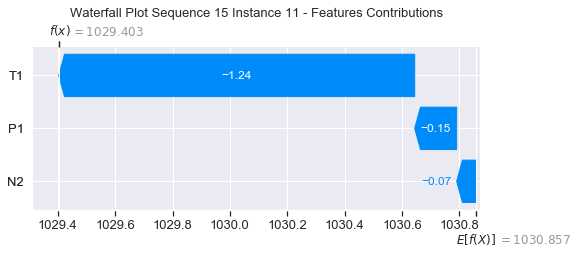

None

Contribution: [-0.06426621 -1.33691717 -0.06713276]


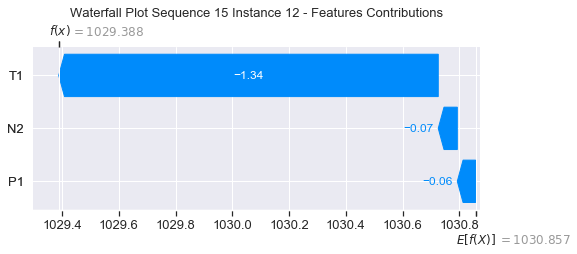

None

Contribution: [-0.0487991  -1.26653042 -0.05486158]


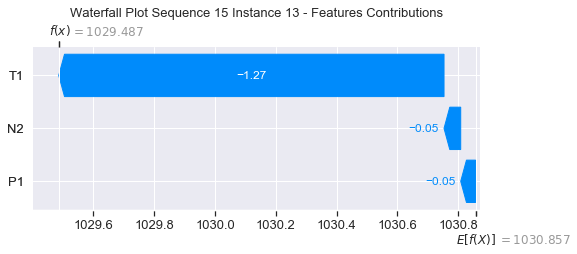

None

Contribution: [ 0.01187534 -1.50170753 -0.03921515]


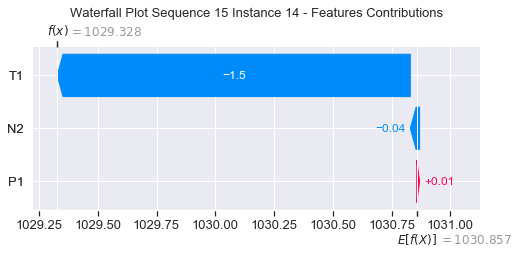

None

Contribution: [-0.0861044  -1.41967586 -0.13510092]


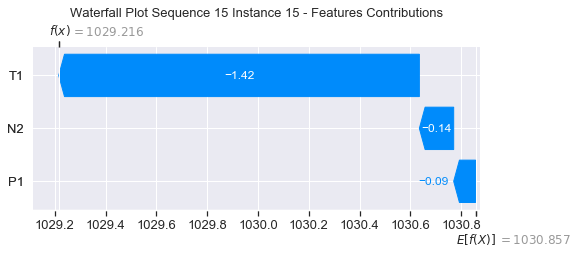

None

Contribution: [-0.14034372 -1.38489129 -0.19950624]


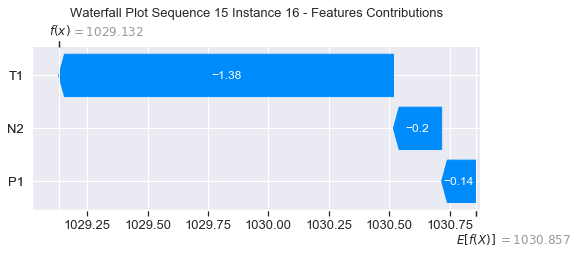

None

Contribution: [-0.12516999 -1.50490759 -0.34046974]


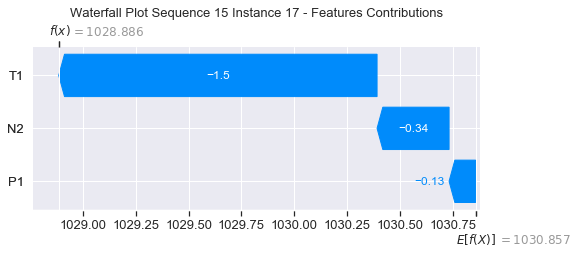

None

Contribution: [-0.13160165 -1.59413282 -0.3434211 ]


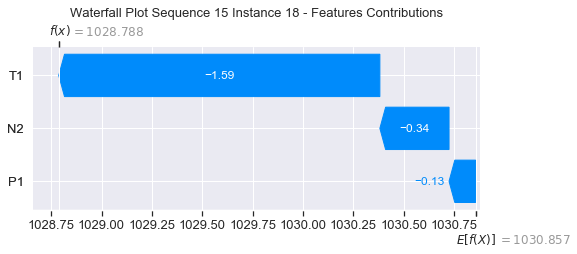

None

Contribution: [-0.11434229 -1.57303806 -0.05188234]


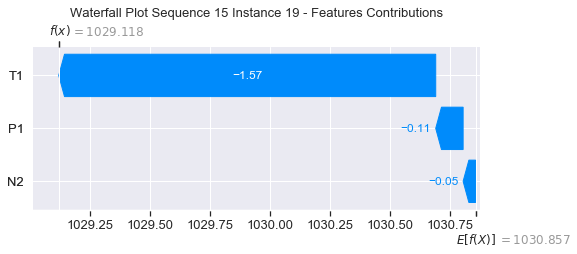

None

Contribution: [ 0.13966223 -1.50144438  0.693095  ]


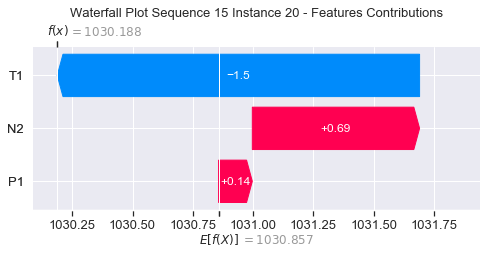

None

Contribution: [ 0.49341396 -1.43319457  2.06060526]


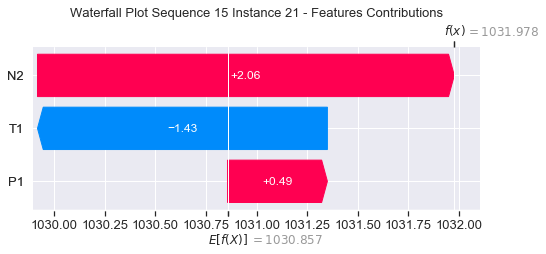

None

Contribution: [ 0.85018765 -1.75245872  3.87871021]


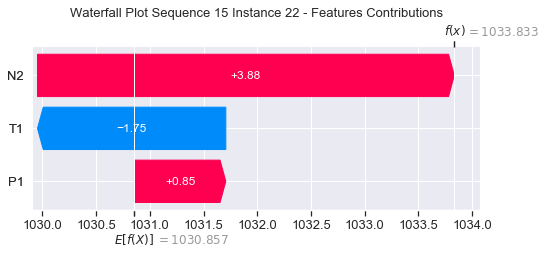

None

Contribution: [ 0.94112338 -3.19550079  5.43872043]


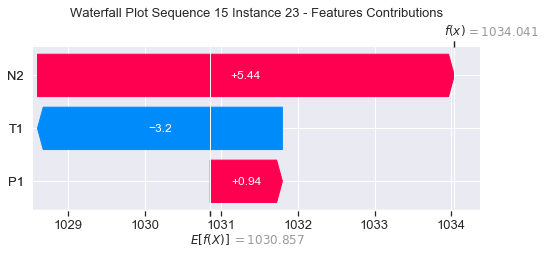

None

Contribution: [ 1.22535032 -4.93380644  5.30642253]


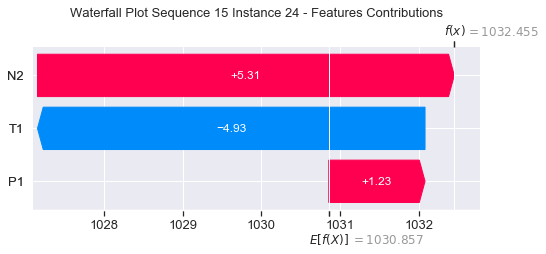

None

Contribution: [  1.20624419 -13.54324192   3.38370372]


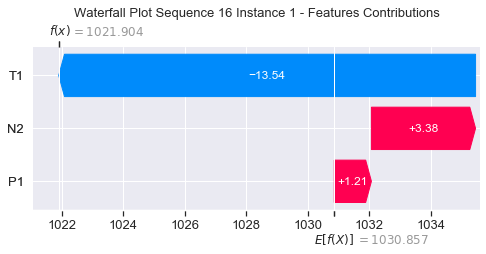

None

Contribution: [-0.23017545 -2.04705473 -0.31000524]


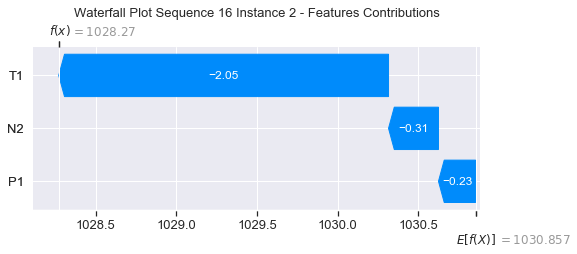

None

Contribution: [-0.28309603 -3.70329822  0.19584609]


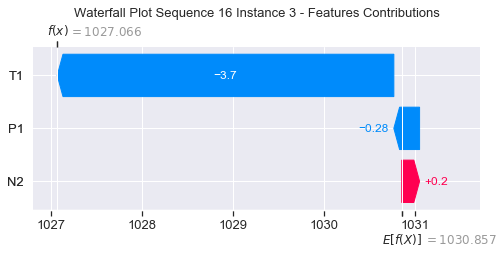

None

Contribution: [-0.05329465 -1.45896008 -0.099329  ]


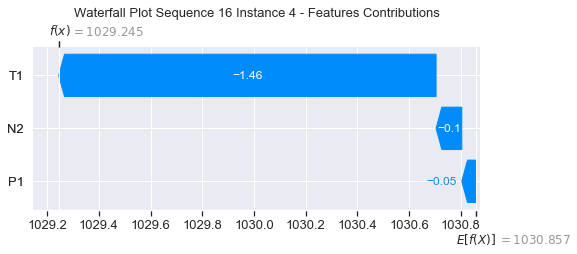

None

Contribution: [-0.01239321 -1.4663398  -0.06811229]


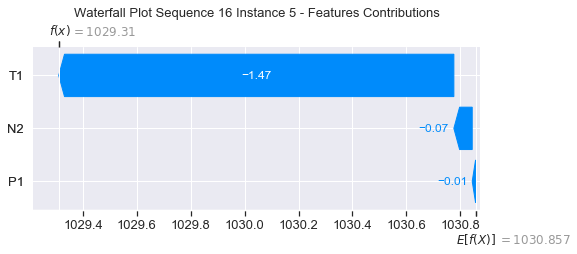

None

Contribution: [-0.01322549 -1.46866066 -0.0675703 ]


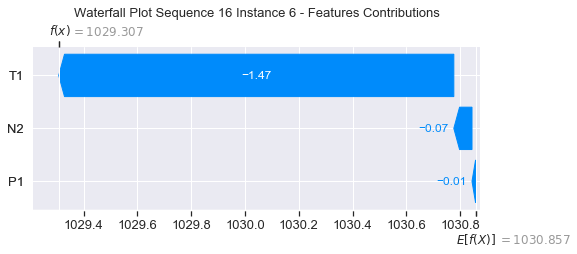

None

Contribution: [-0.03019299 -1.39688632 -0.08571728]


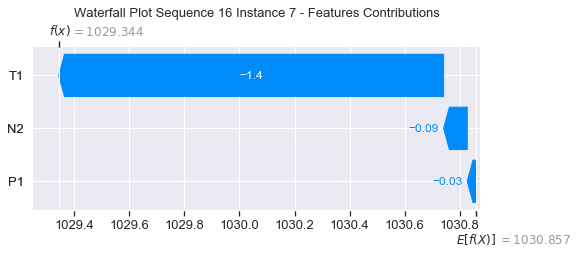

None

Contribution: [-0.03836312 -1.42647282 -0.09773303]


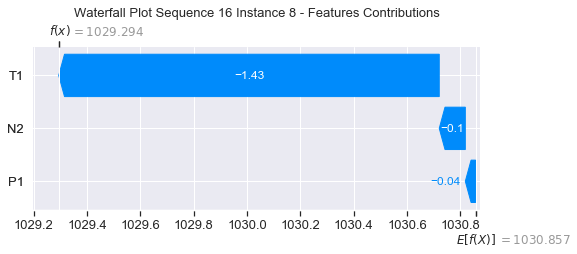

None

Contribution: [-0.11268773 -1.51143969 -0.07441927]


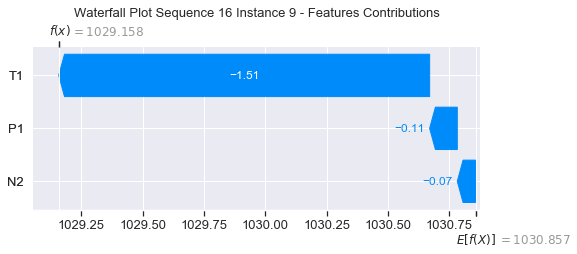

None

Contribution: [-0.15068771 -1.26202846 -0.0433412 ]


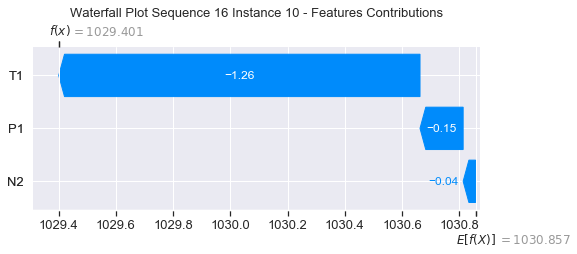

None

Contribution: [-0.09105481 -1.65585745 -0.045521  ]


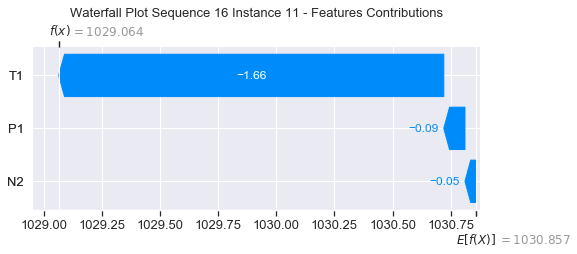

None

Contribution: [-0.06061644 -1.55342184 -0.0522141 ]


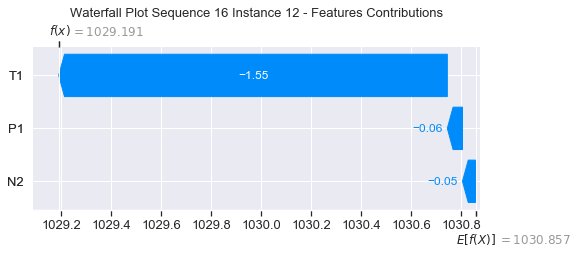

None

Contribution: [-0.05146486 -1.47112667 -0.04545087]


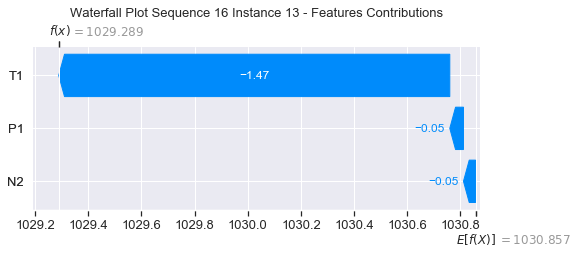

None

Contribution: [-0.08248789 -1.55831664 -0.08053916]


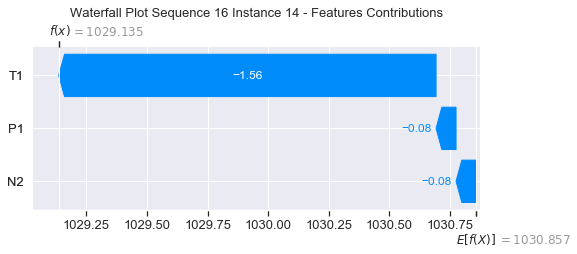

None

Contribution: [-0.08512237 -1.63928836 -0.13896308]


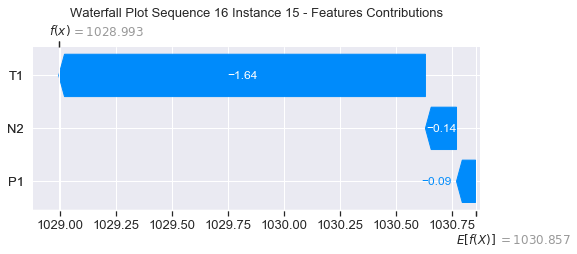

None

Contribution: [-0.22374796 -1.86734345 -0.25602186]


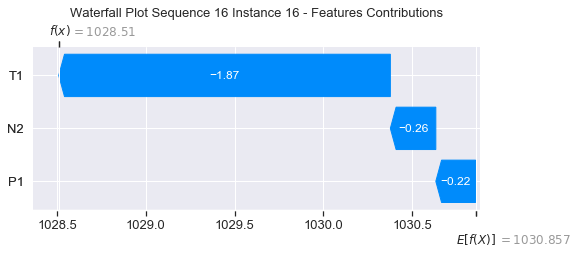

None

Contribution: [-0.14439368 -1.74221704 -0.36488698]


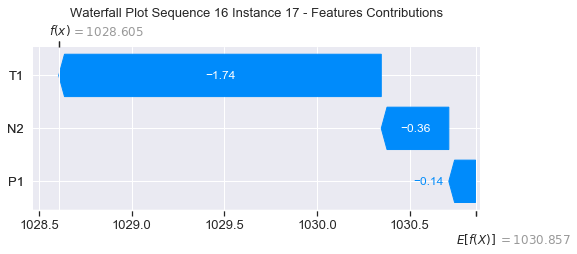

None

Contribution: [-0.15526159 -1.86521212 -0.37915519]


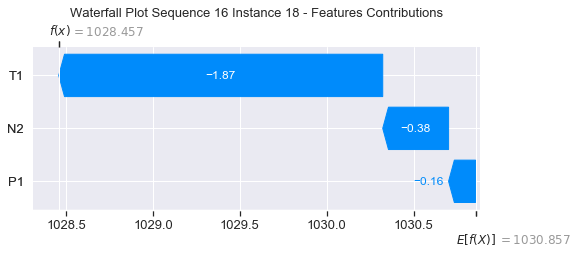

None

Contribution: [-0.12914351 -2.13517233 -0.09457577]


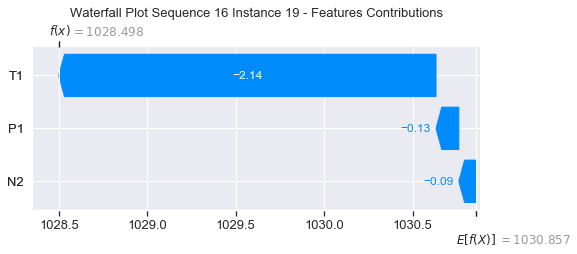

None

Contribution: [ 0.10807039 -1.96394598  0.62286898]


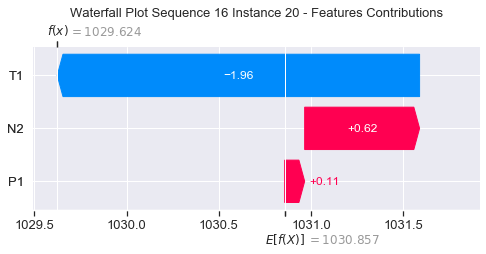

None

Contribution: [ 0.46464521 -2.18337566  1.98655774]


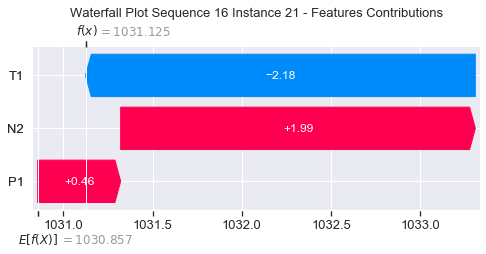

None

Contribution: [ 0.87060027 -3.01868926  3.7958861 ]


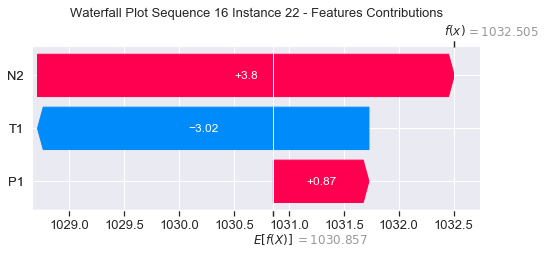

None

Contribution: [ 0.92161779 -4.95174676  5.30984233]


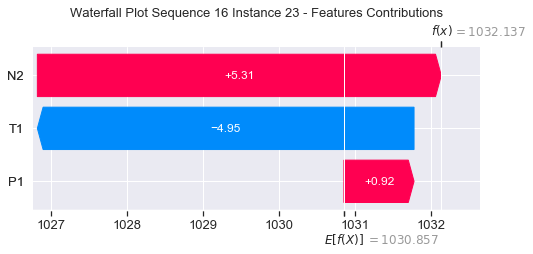

None

Contribution: [ 1.2296965  -6.30948501  5.13232696]


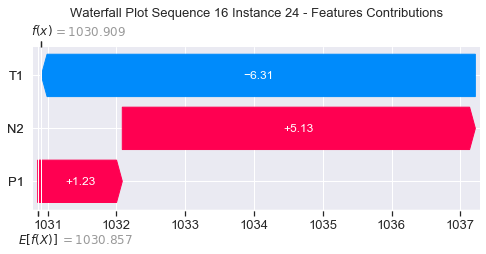

None

Contribution: [  0.95694604 -14.23002058   3.15251806]


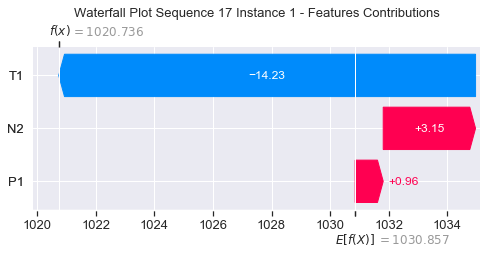

None

Contribution: [-0.21676998 -2.54886821 -0.32285384]


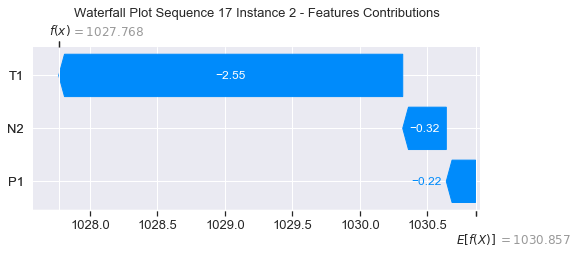

None

Contribution: [ 0.15902193 -5.1249237   0.23273741]


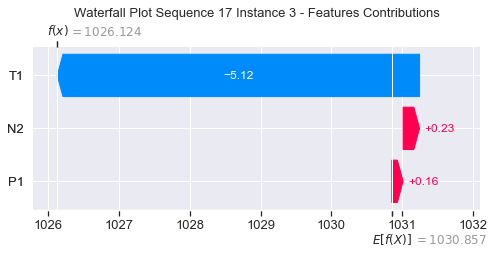

None

Contribution: [ 0.04938651 -1.99093847 -0.03275672]


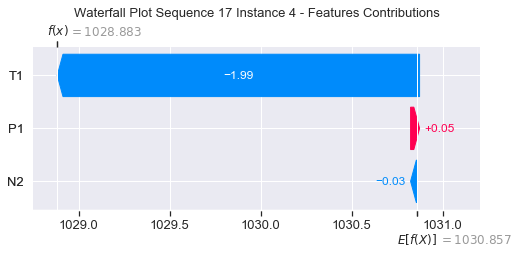

None

Contribution: [-0.0180907  -1.80649423 -0.08966876]


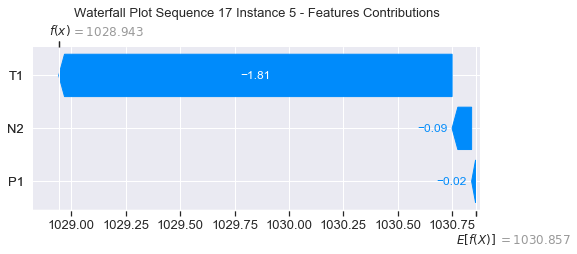

None

Contribution: [-0.04901558 -1.70484926 -0.10254321]


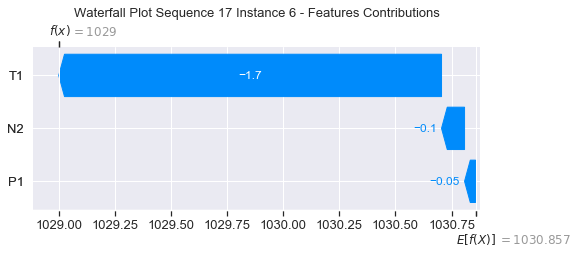

None

Contribution: [-0.05414085 -1.65363305 -0.11897192]


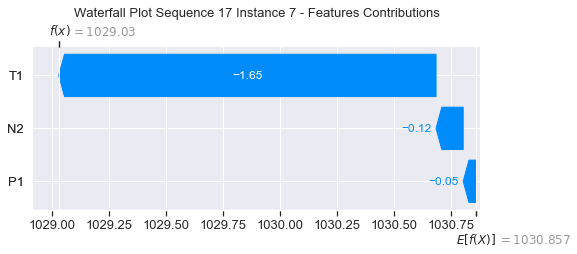

None

Contribution: [-0.06138006 -1.623847   -0.12800884]


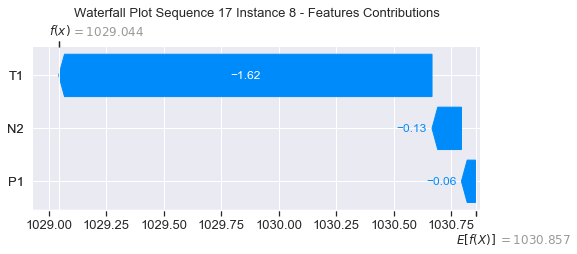

None

Contribution: [-0.11629195 -1.6344278  -0.121111  ]


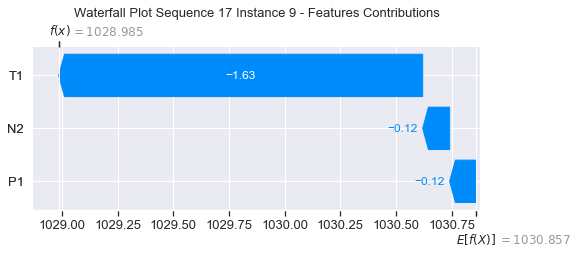

None

Contribution: [-0.17635632 -1.46074441 -0.03255137]


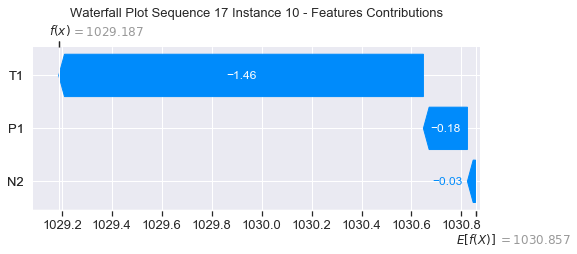

None

Contribution: [-0.12105086 -1.59596486 -0.09218829]


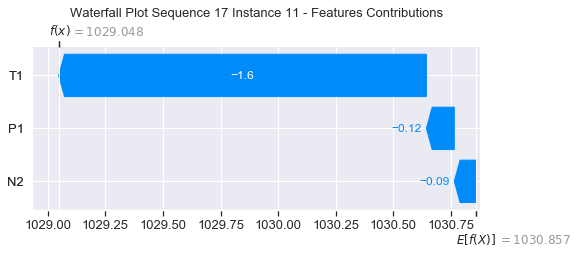

None

Contribution: [-0.05809644 -1.75435967 -0.07507188]


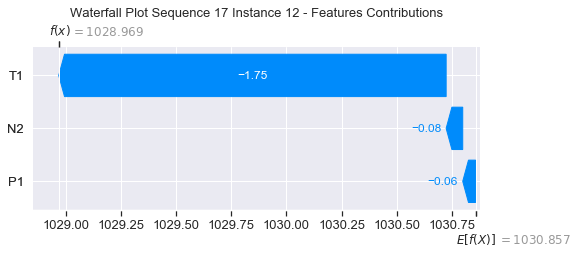

None

Contribution: [-0.04463733 -1.70719663 -0.06312909]


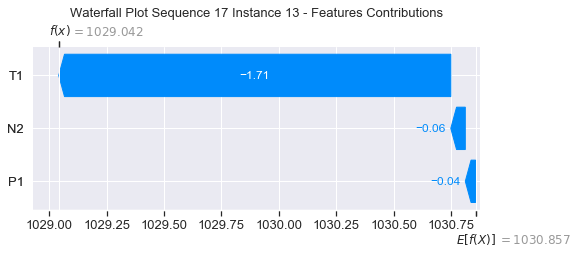

None

Contribution: [-0.1298342  -1.89892696 -0.09296684]


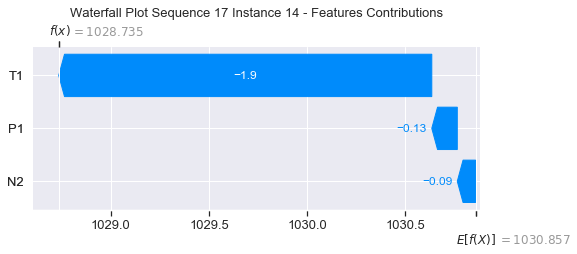

None

Contribution: [-0.08184783 -1.84979964 -0.14791636]


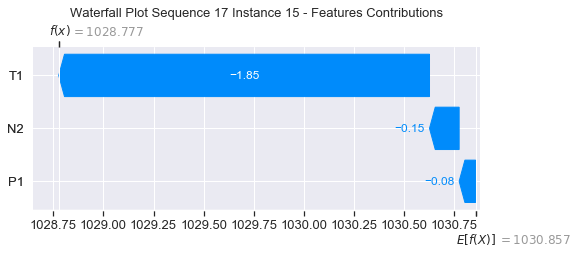

None

Contribution: [-0.08204615 -1.79943457 -0.20147296]


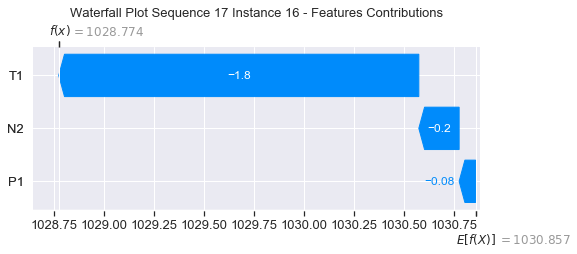

None

Contribution: [-0.14456237 -2.02589265 -0.38057308]


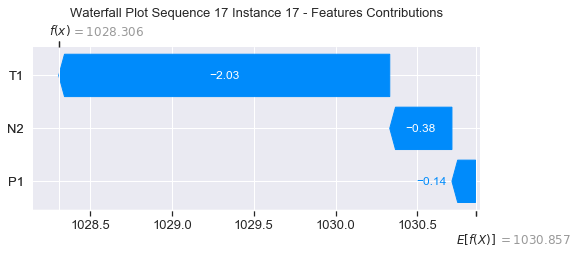

None

Contribution: [-0.16561554 -2.15946544 -0.39985587]


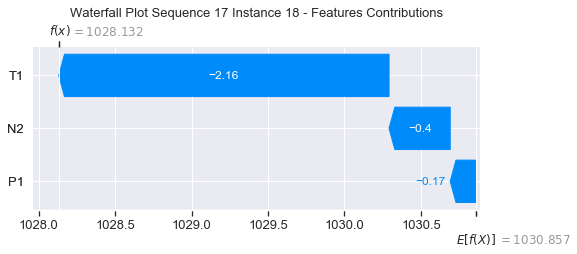

None

Contribution: [-0.13770202 -2.08199497 -0.0895091 ]


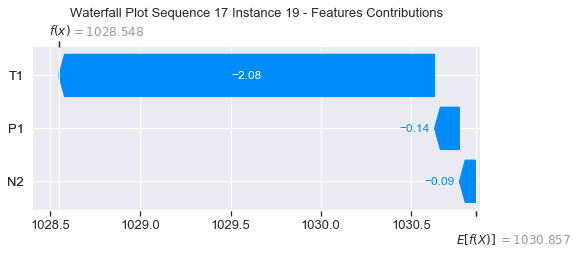

None

Contribution: [ 0.10960323 -2.48773675  0.63155056]


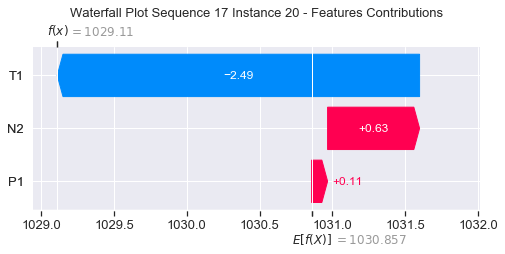

None

Contribution: [ 0.49371107 -2.90627138  2.03589354]


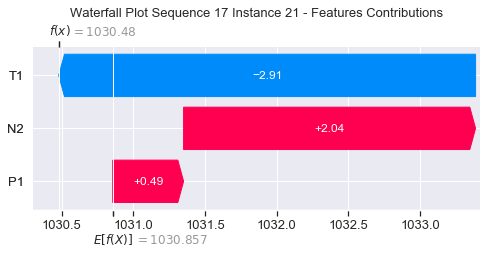

None

Contribution: [ 0.93609637 -3.86692441  3.92540808]


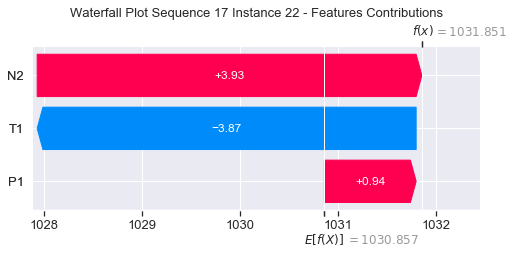

None

Contribution: [ 0.95310619 -5.86596678  5.50200875]


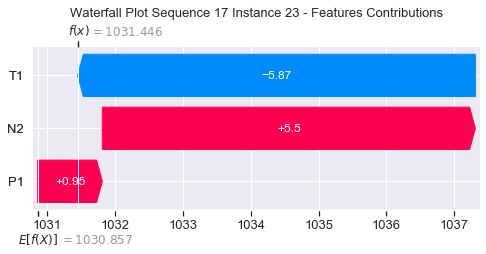

None

Contribution: [ 1.38522939 -7.5212729   5.34635283]


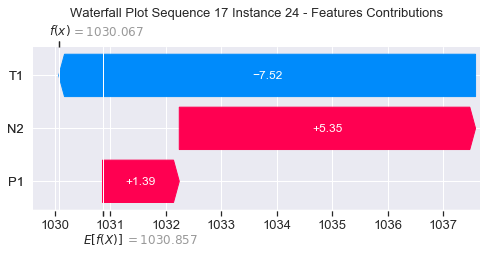

None

Contribution: [  2.29887502 -18.10542405   3.32981639]


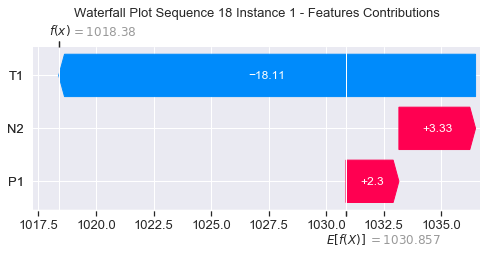

None

Contribution: [-0.13097222 -2.72560937 -0.2596324 ]


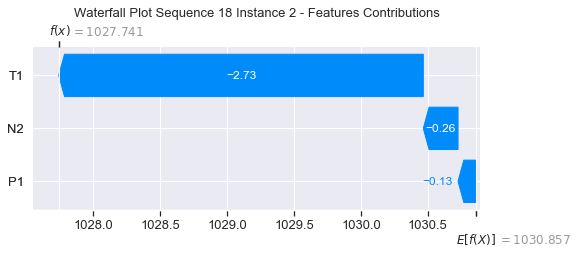

None

Contribution: [ 0.21516576 -5.27979621  0.30479312]


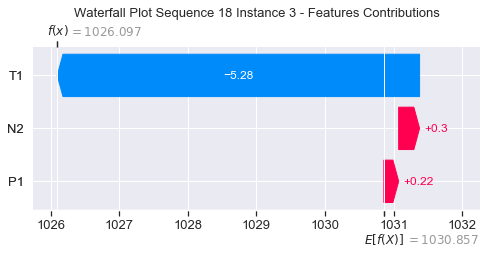

None

Contribution: [-0.0972439  -2.2927953  -0.08456739]


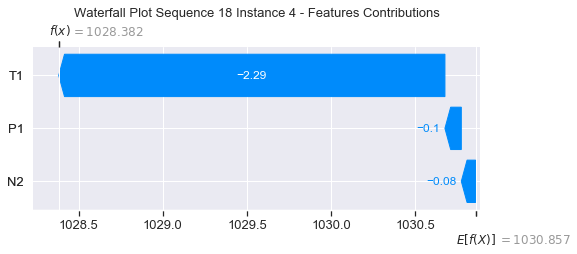

None

Contribution: [-0.00631604 -1.72688896 -0.05472639]


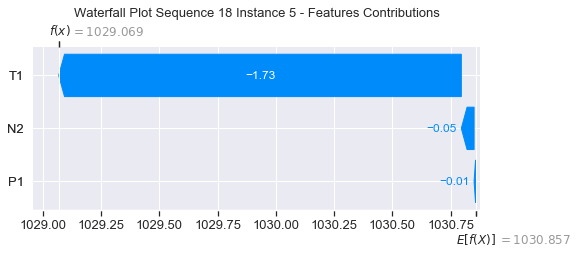

None

Contribution: [ 0.02187335 -1.56867622 -0.04533697]


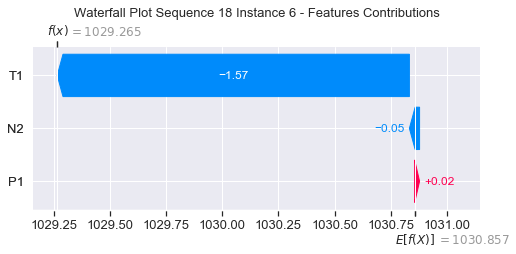

None

Contribution: [ 0.02907267 -1.50830654 -0.06028382]


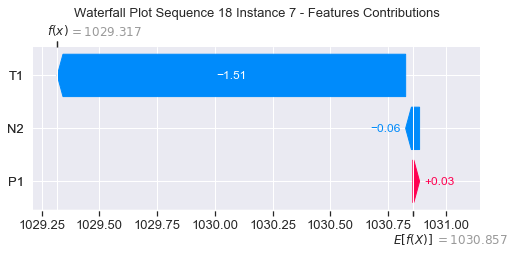

None

Contribution: [ 0.00525974 -1.49360938 -0.07535076]


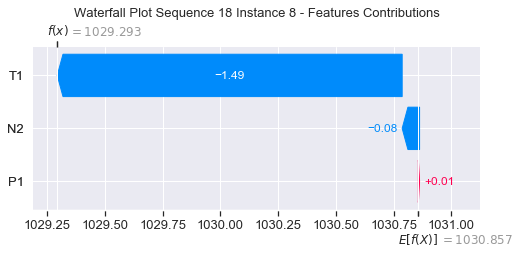

None

Contribution: [-0.06985408 -1.37451247 -0.06472587]


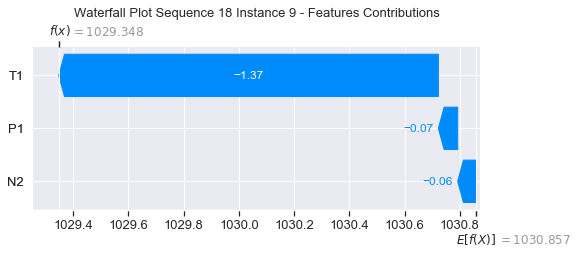

None

Contribution: [-0.04679225 -1.40509727 -0.03767926]


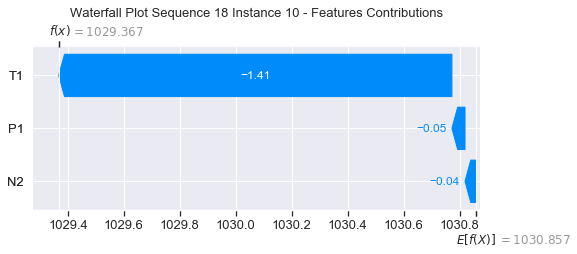

None

Contribution: [-0.06242592 -1.36937459 -0.03176253]


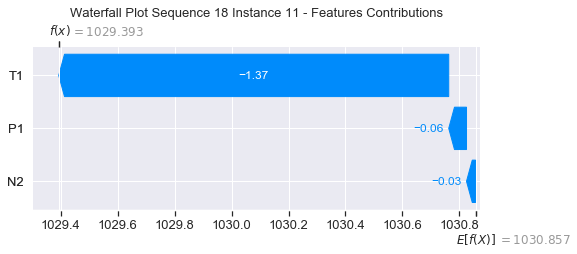

None

Contribution: [ 0.09391905 -1.51382902 -0.00931733]


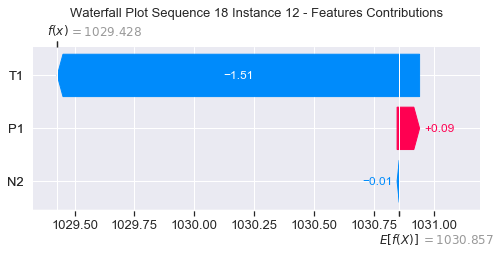

None

Contribution: [ 0.09745979 -1.46915278 -0.00255627]


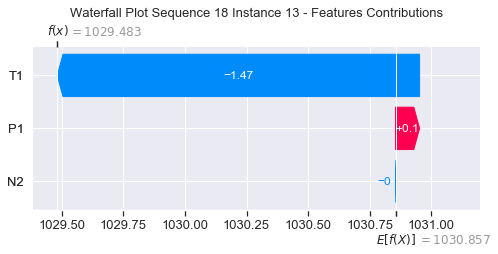

None

Contribution: [-0.01473019 -1.3759513  -0.05412139]


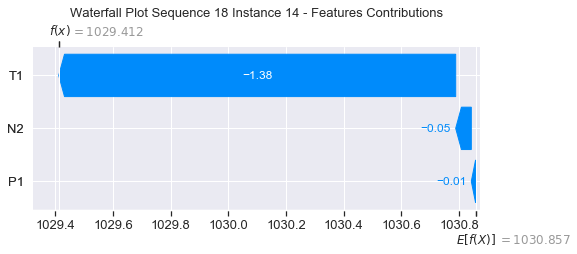

None

Contribution: [ 0.03130978 -1.61334289 -0.09691074]


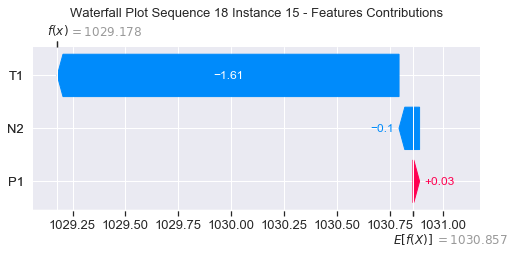

None

Contribution: [-0.14080694 -1.52033012 -0.22799026]


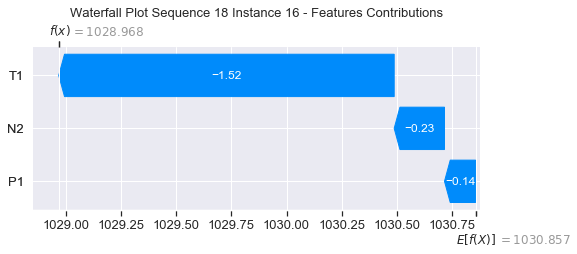

None

Contribution: [-0.00750087 -1.72997417 -0.31568318]


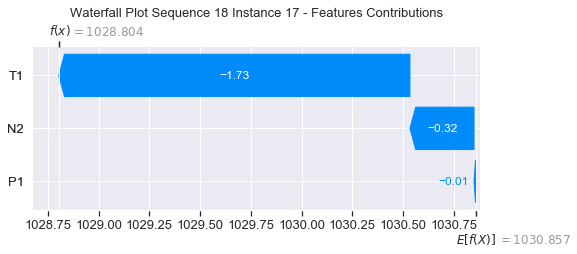

None

Contribution: [-0.01985175 -1.84007238 -0.32792171]


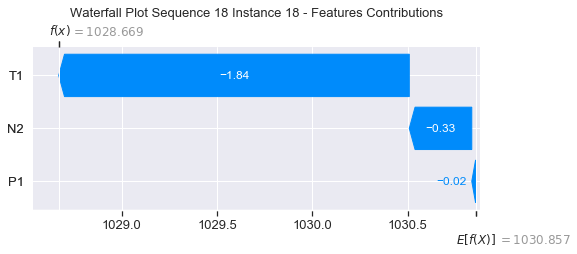

None

Contribution: [-0.02748611 -2.01076601 -0.03073805]


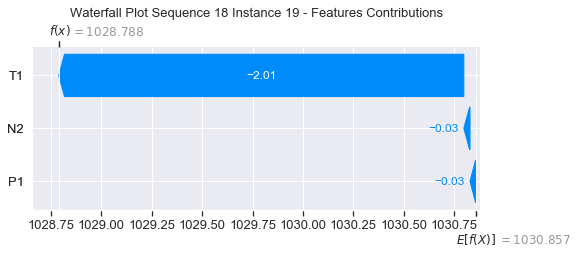

None

Contribution: [ 0.25173449 -2.08155922  0.68930109]


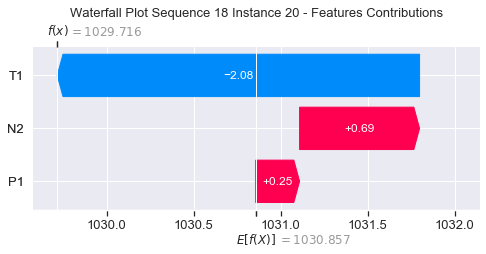

None

Contribution: [ 0.69049402 -2.3041467   2.08308015]


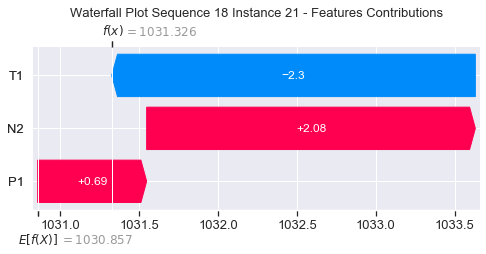

None

Contribution: [ 1.13905393 -3.13367944  3.93038295]


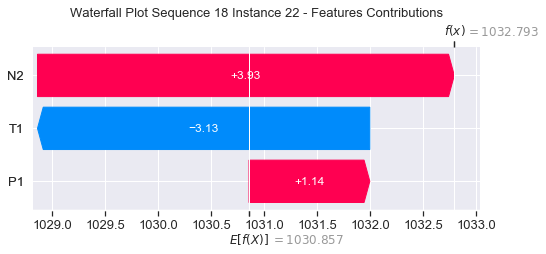

None

Contribution: [ 1.34010233 -4.79674992  5.52603565]


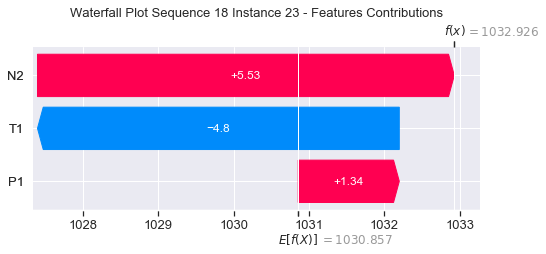

None

Contribution: [ 1.53713059 -6.73868739  5.2945153 ]


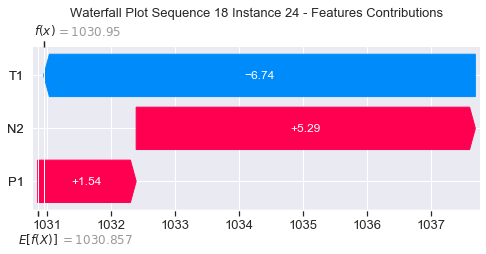

None

Contribution: [  2.82895385 -15.90967666   3.30336675]


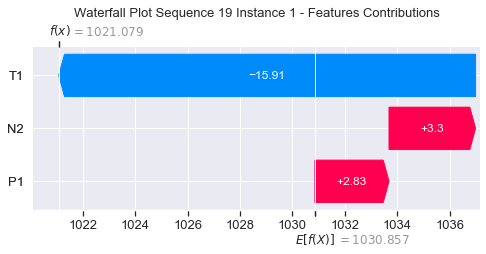

None

Contribution: [-0.03110488 -2.50333939 -0.27516133]


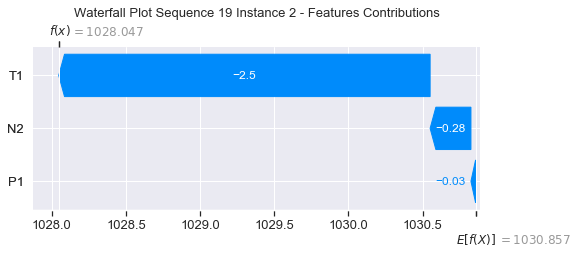

None

Contribution: [-0.16536059 -4.99774073  0.13058623]


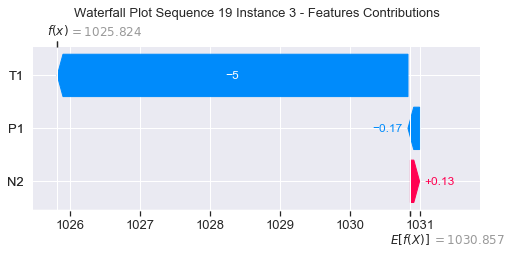

None

Contribution: [-2.80728736e-04 -2.08384147e+00 -4.57457073e-02]


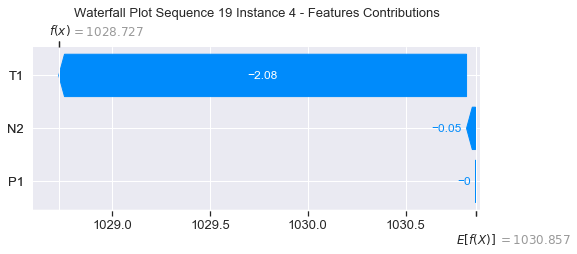

None

Contribution: [ 0.02957993 -1.69043648 -0.04487475]


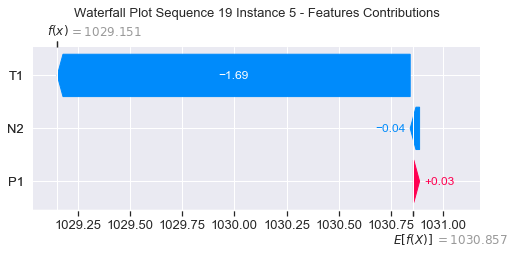

None

Contribution: [-0.00456455 -1.62686557 -0.07945648]


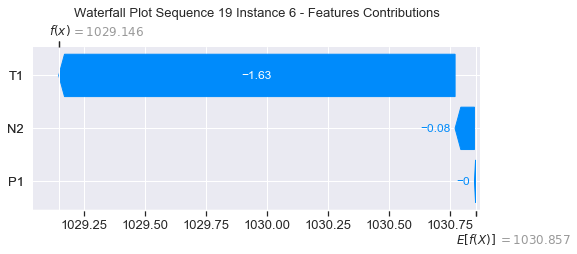

None

Contribution: [ 1.50081929e-03 -1.54498449e+00 -9.36989310e-02]


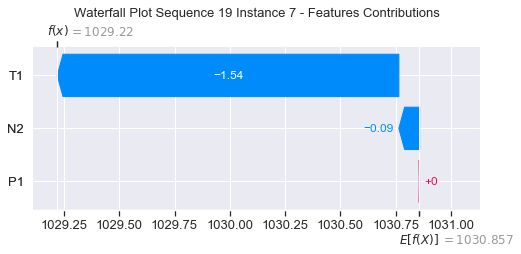

None

Contribution: [-0.01246244 -1.5428492  -0.10235302]


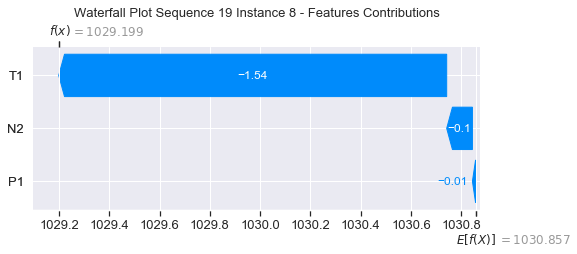

None

Contribution: [-0.06714972 -1.45663194 -0.05752623]


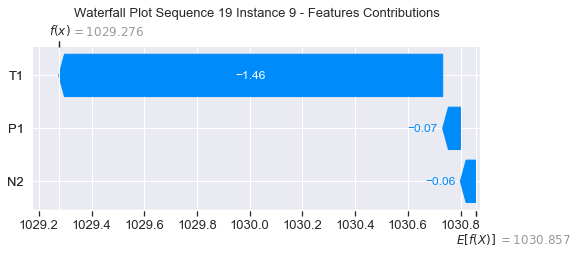

None

Contribution: [-0.08458075 -1.41033933 -0.04029508]


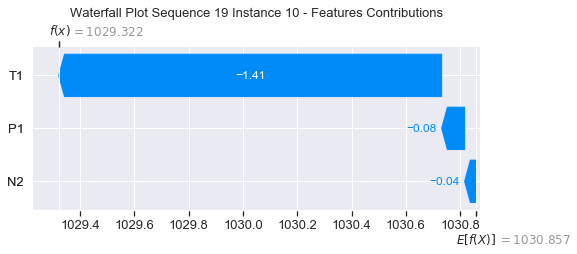

None

Contribution: [-0.10282615 -1.57652439 -0.055312  ]


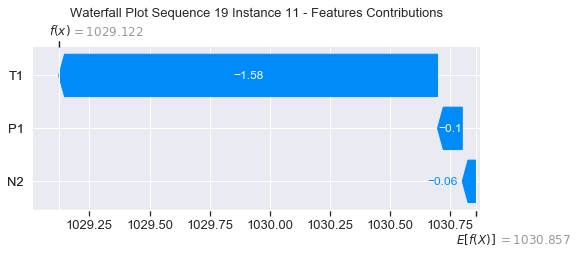

None

Contribution: [-0.00248545 -1.67292777 -0.07326156]


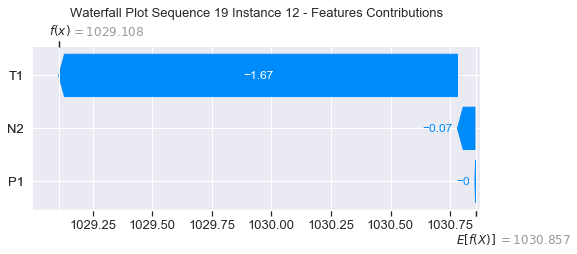

None

Contribution: [ 0.02148281 -1.59788779 -0.05865022]


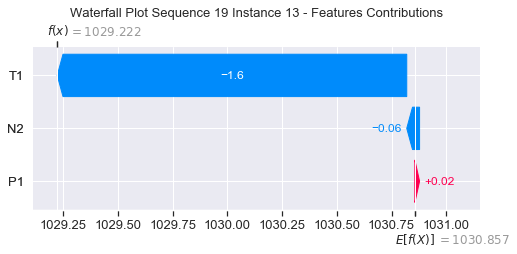

None

Contribution: [ 0.04063534 -1.59636694 -0.03135707]


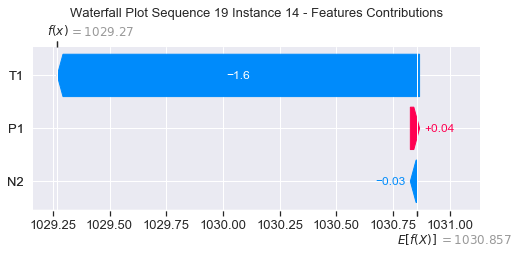

None

Contribution: [-0.00955246 -1.74696516 -0.15135144]


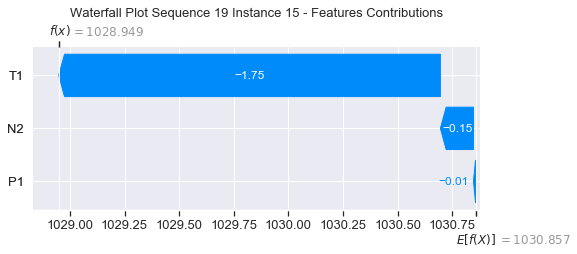

None

Contribution: [-0.11162563 -1.64427307 -0.23288254]


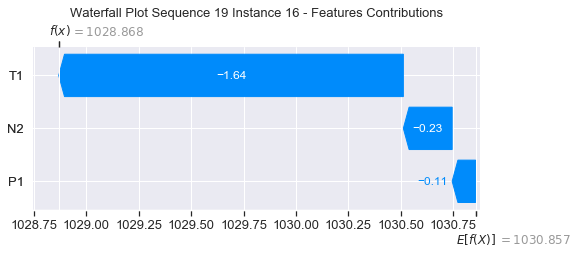

None

Contribution: [-0.04244808 -1.85162638 -0.38285667]


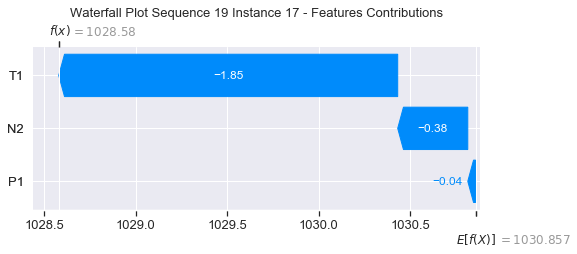

None

Contribution: [-0.04886688 -1.9808485  -0.40855984]


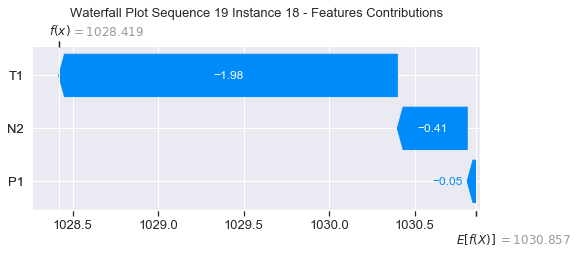

None

Contribution: [-0.14260071 -2.12239037 -0.14311811]


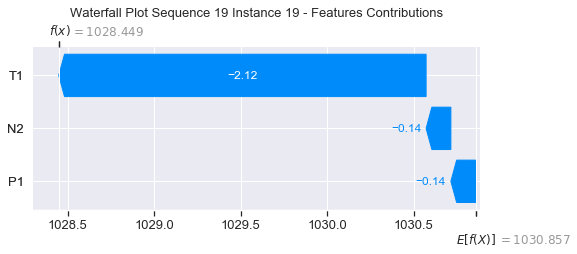

None

Contribution: [ 0.32819653 -2.14441096  0.5994577 ]


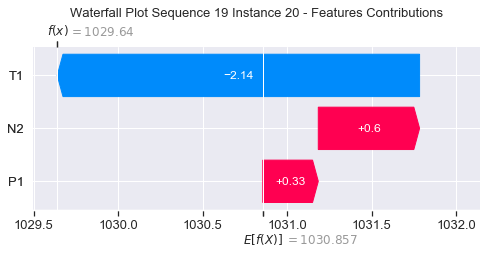

None

Contribution: [ 0.80760159 -2.43795147  1.96237785]


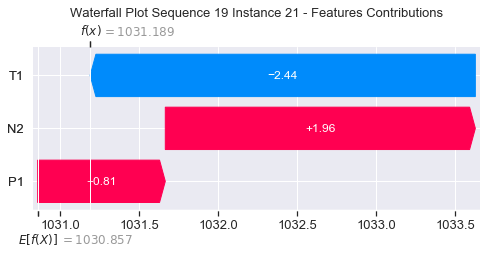

None

Contribution: [ 1.36992511 -3.36783835  3.7670252 ]


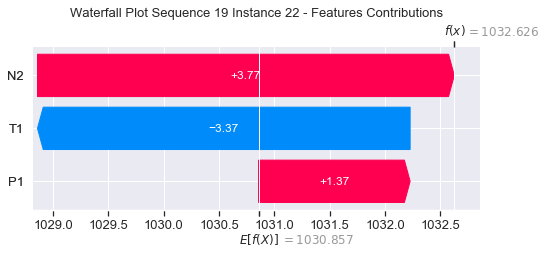

None

Contribution: [ 1.54806148 -5.34760569  5.21165971]


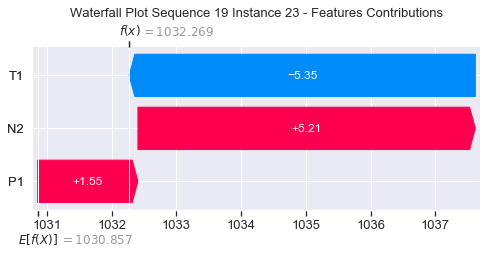

None

Contribution: [ 1.55077073 -7.31958913  4.86223067]


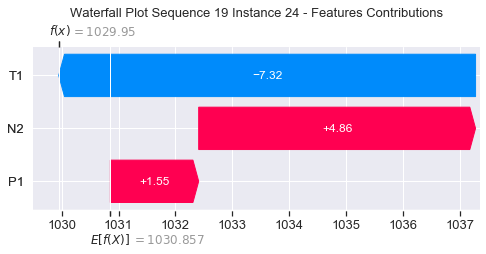

None

Contribution: [ -0.18608824 -18.47440661   1.36949143]


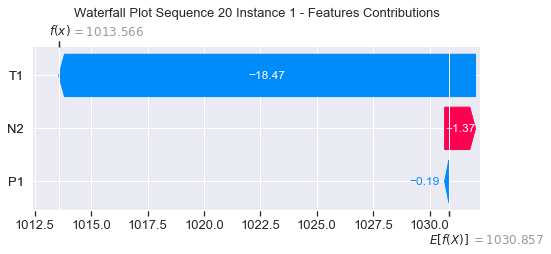

None

Contribution: [ 0.02747622 -2.59577917 -0.33242558]


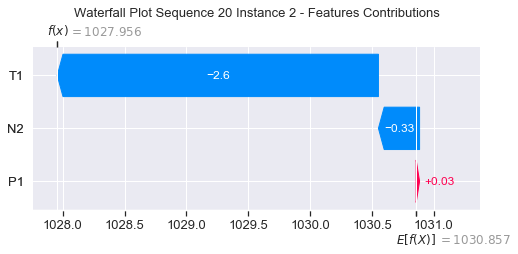

None

Contribution: [ 0.26572751 -5.07469408  0.08645331]


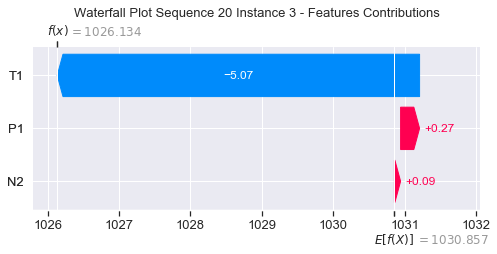

None

Contribution: [-0.0757605  -1.90420507 -0.14254083]


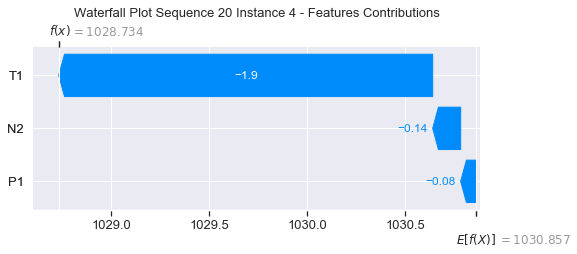

None

Contribution: [ 0.08124382 -1.48104916 -0.05999524]


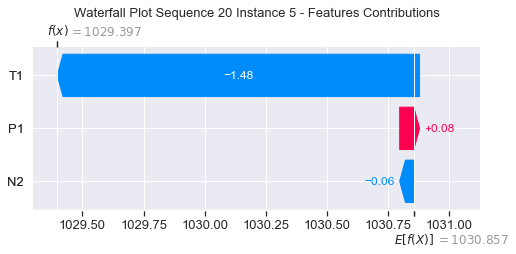

None

Contribution: [ 0.00575252 -1.49664929 -0.08633367]


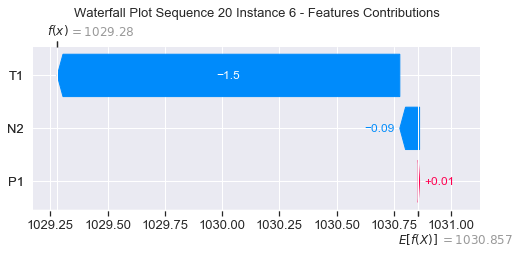

None

Contribution: [ 0.00774409 -1.4350455  -0.0902484 ]


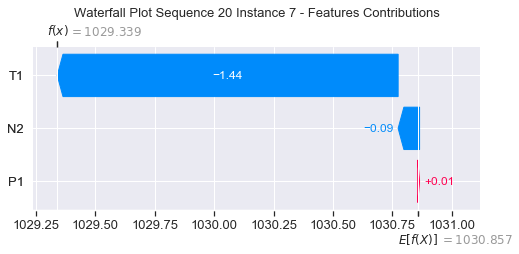

None

Contribution: [-0.00716965 -1.43537757 -0.10867964]


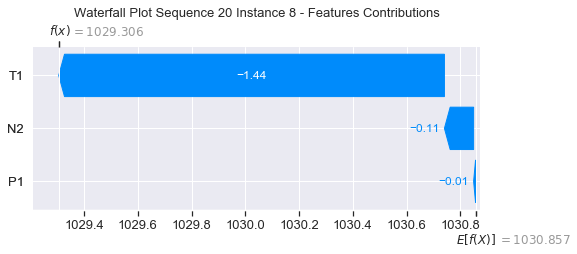

None

Contribution: [-0.10450699 -1.44909863 -0.07863161]


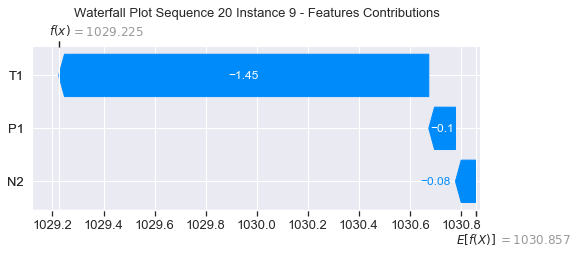

None

Contribution: [-0.0439671  -1.65329602 -0.0819593 ]


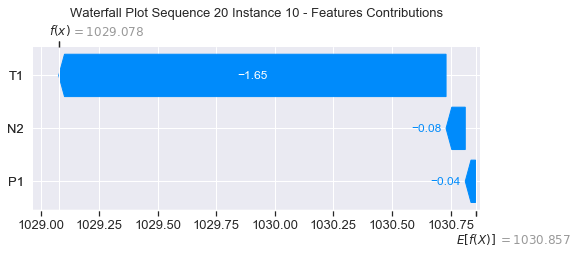

None

Contribution: [-0.13359012 -1.49401231 -0.10366157]


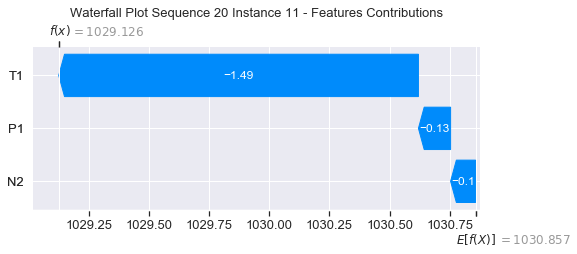

None

Contribution: [ 0.02207791 -1.45446386 -0.07283042]


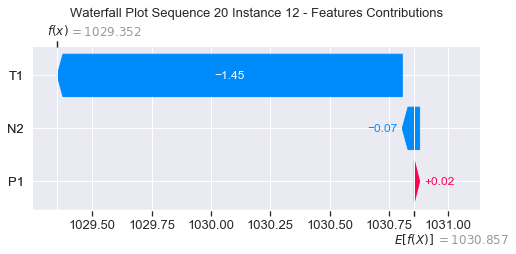

None

Contribution: [ 0.04683406 -1.40718485 -0.05036192]


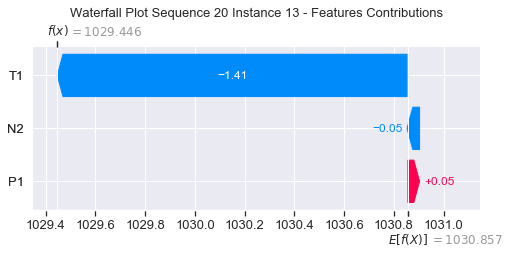

None

Contribution: [ 0.01779829 -1.39620128 -0.06647597]


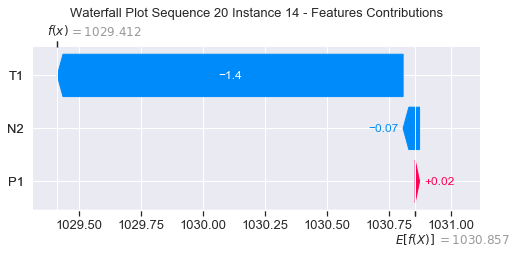

None

Contribution: [-9.83587499e-04 -1.57633087e+00 -1.42298049e-01]


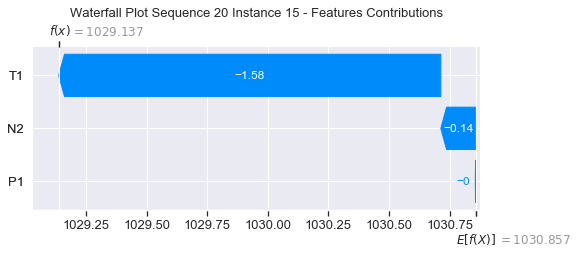

None

Contribution: [-0.09567067 -1.73478914 -0.20951635]


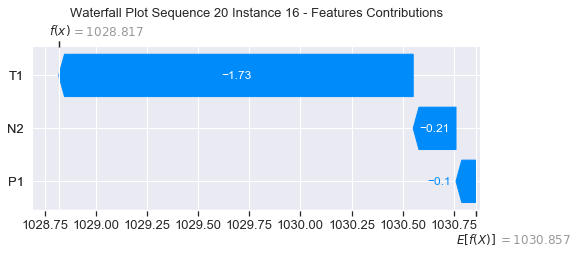

None

Contribution: [-0.04124454 -1.72683416 -0.36894142]


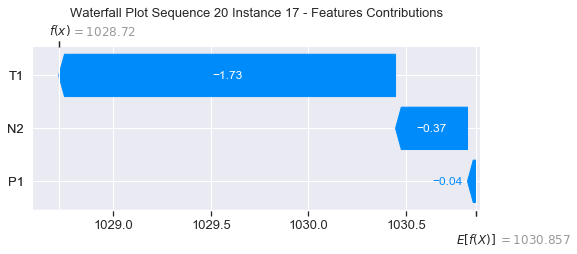

None

Contribution: [-0.05039675 -1.86301936 -0.39841345]


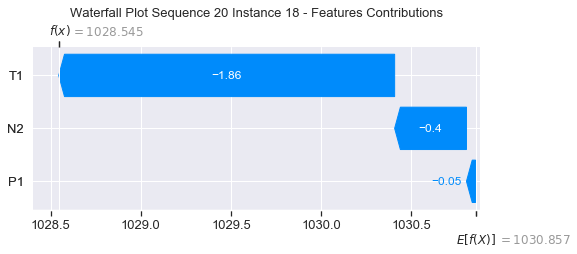

None

Contribution: [-0.01827504 -1.98410959 -0.09284391]


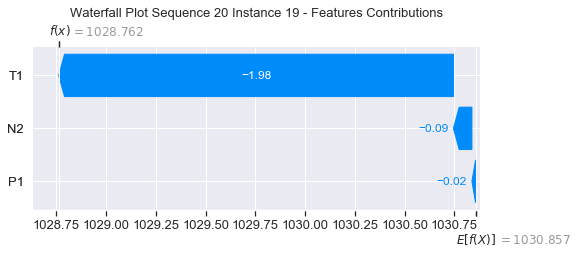

None

Contribution: [ 0.32957898 -2.06084392  0.63056837]


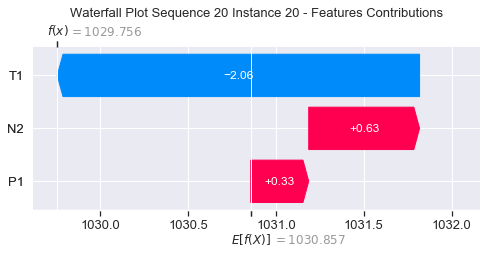

None

Contribution: [ 0.83391184 -2.21239468  2.00988043]


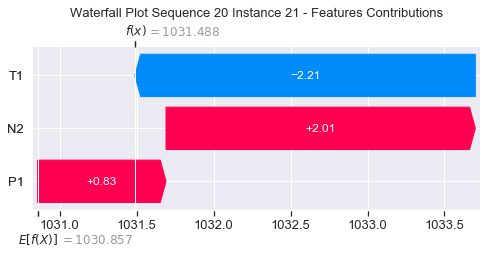

None

Contribution: [ 1.44705294 -2.87930875  3.82690478]


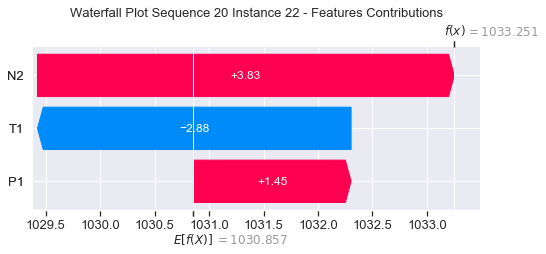

None

Contribution: [ 1.62125954 -4.76808322  5.30385189]


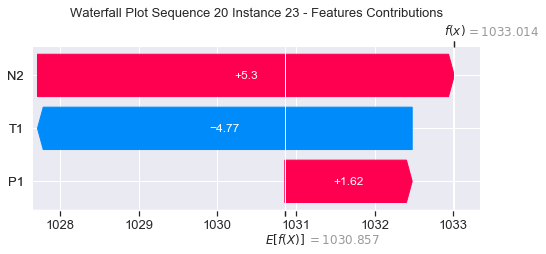

None

Contribution: [ 1.87564579 -6.63096601  4.98247041]


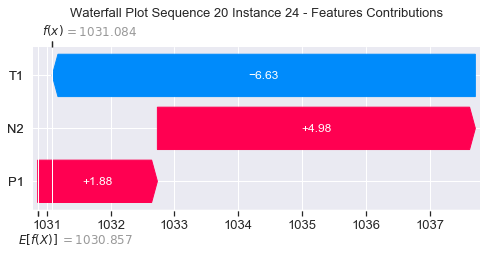

None

Contribution: [  1.92355286 -16.29181121   1.92946403]


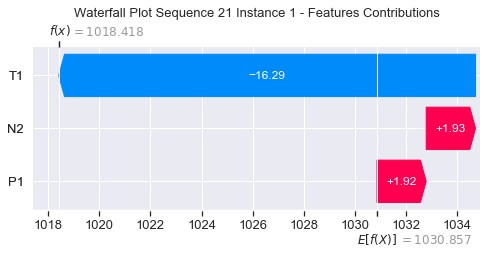

None

Contribution: [ 0.11951372 -2.37381872 -0.30456741]


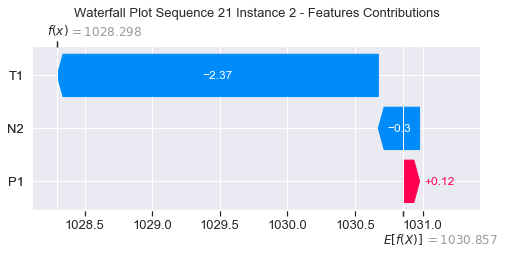

None

Contribution: [ 0.36418778 -3.70805802  0.10489688]


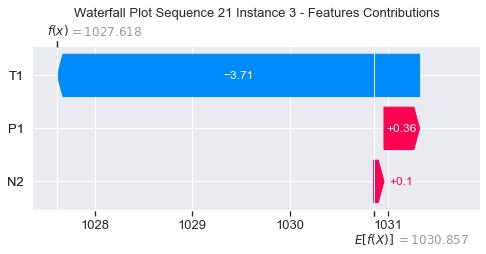

None

Contribution: [ 0.09718726 -1.51614804 -0.12651783]


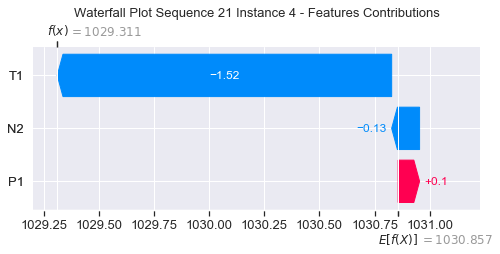

None

Contribution: [ 0.05836667 -1.56199501 -0.08057527]


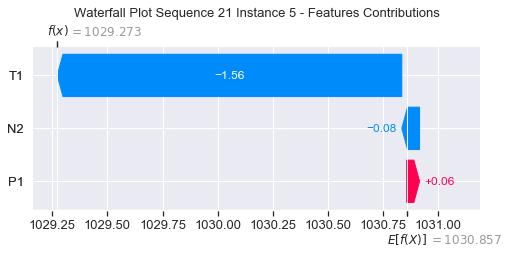

None

Contribution: [ 0.08131707 -1.43909093 -0.07043929]


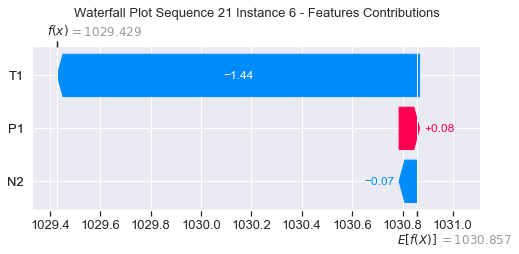

None

Contribution: [ 0.05554012 -1.4119879  -0.08765553]


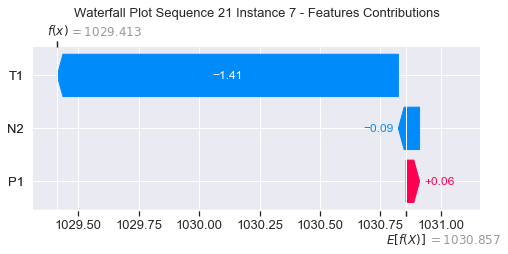

None

Contribution: [ 0.04901403 -1.42600335 -0.09542351]


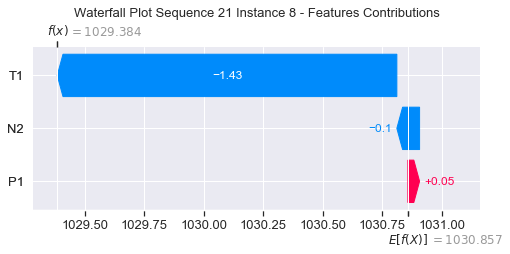

None

Contribution: [-0.01556695 -1.46197442 -0.07806141]


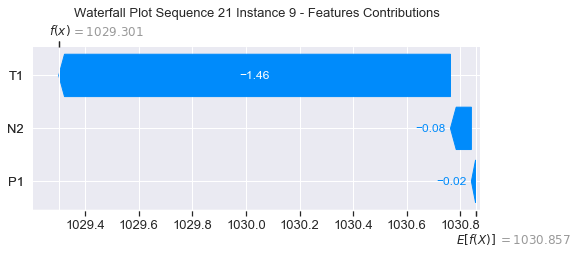

None

Contribution: [-0.22037534 -1.41691631 -0.06499408]


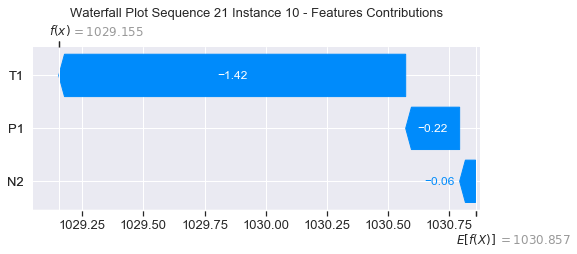

None

Contribution: [ 0.02158783 -1.472172   -0.04032411]


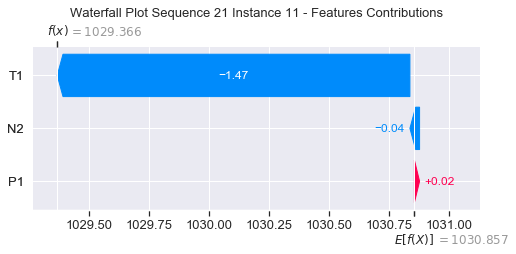

None

Contribution: [ 0.01021844 -1.63241063 -0.05105016]


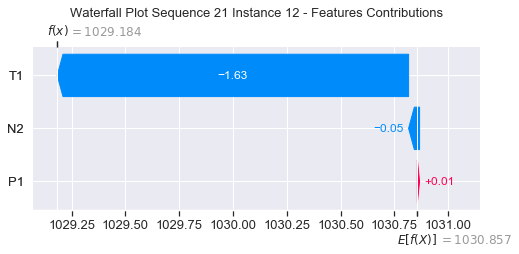

None

Contribution: [ 0.02001276 -1.58716766 -0.04218649]


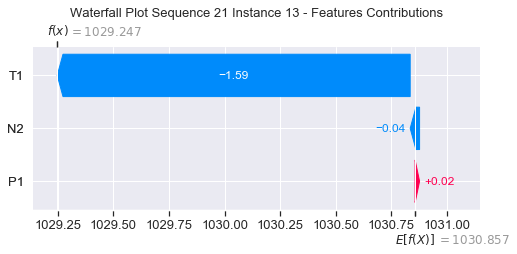

None

Contribution: [ 0.0939467  -1.62799497 -0.03285325]


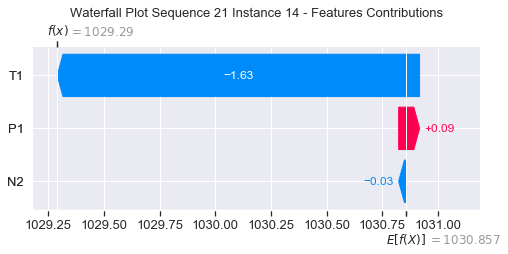

None

Contribution: [ 0.01027539 -1.74059109 -0.11928609]


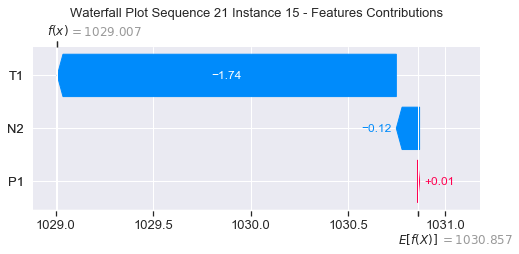

None

Contribution: [-0.06806026 -1.70302665 -0.19319784]


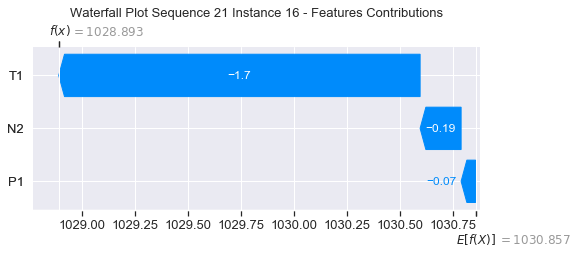

None

Contribution: [-0.03489396 -1.91048776 -0.33798476]


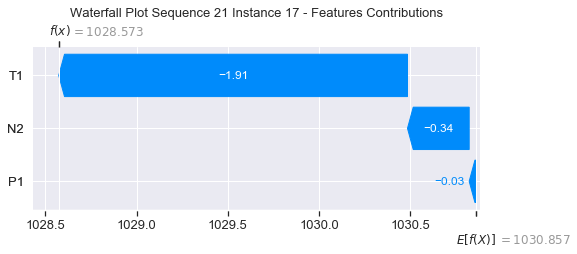

None

Contribution: [-0.0232887  -2.05040395 -0.34417247]


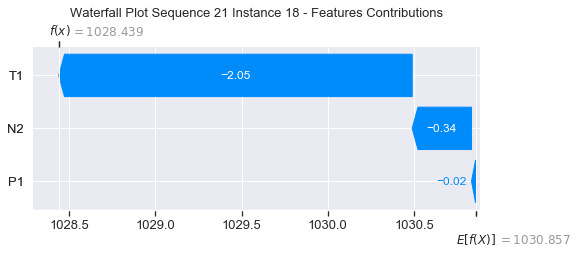

None

Contribution: [ 0.02247736 -2.31750841 -0.02379559]


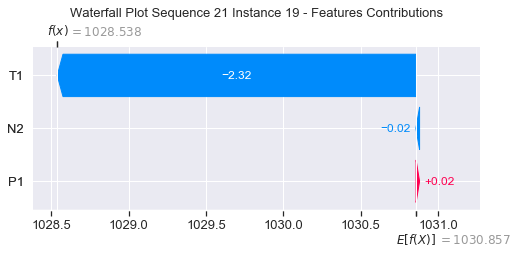

None

Contribution: [ 0.33524293 -2.42164921  0.69806506]


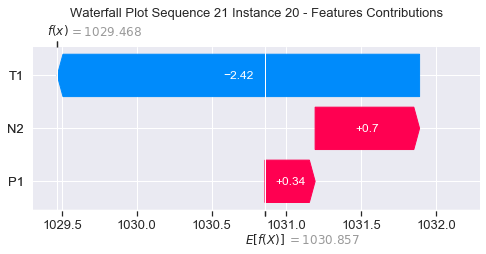

None

Contribution: [ 0.78489438 -2.92207484  2.10430735]


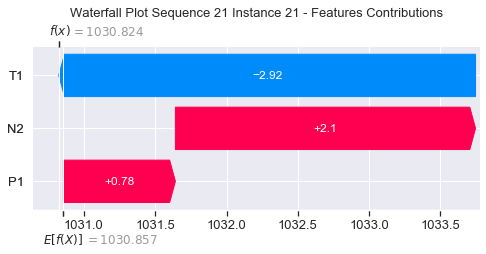

None

Contribution: [ 1.33854925 -4.15302538  3.99584832]


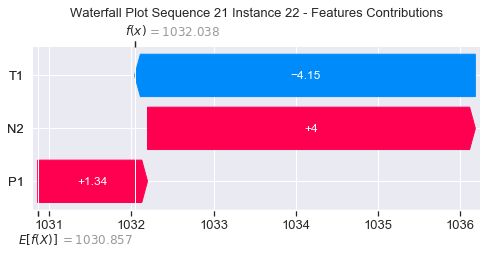

None

Contribution: [ 1.64148738 -6.31983102  5.6231641 ]


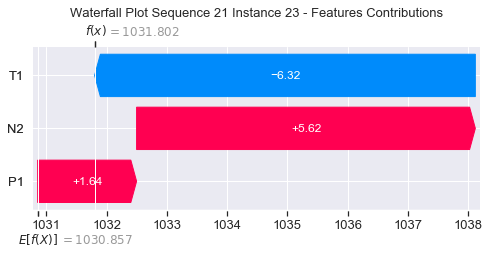

None

Contribution: [ 1.54397291 -8.44732803  5.27176948]


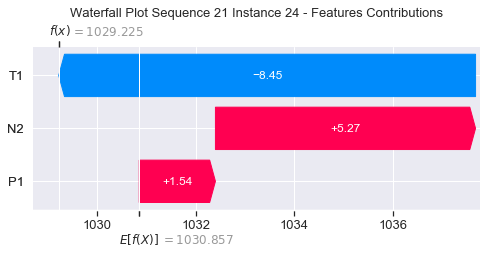

None

Contribution: [ -1.41511655 -20.91732917   1.95118605]


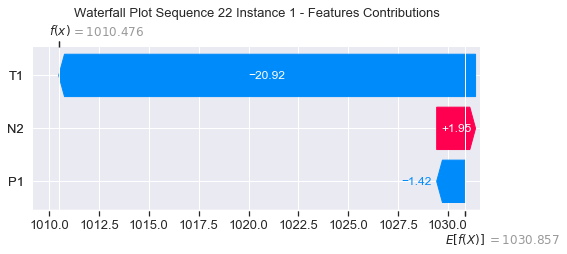

None

Contribution: [-0.09489137 -2.94416397 -0.25669632]


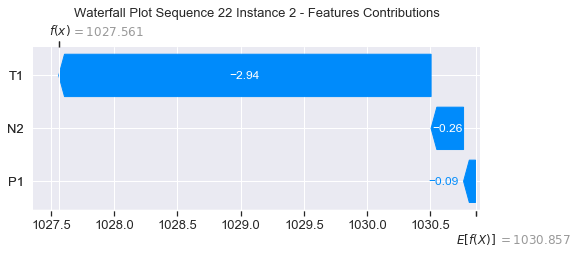

None

Contribution: [ 0.31915597 -5.93948016  0.31215625]


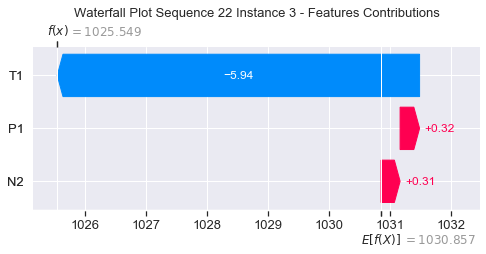

None

Contribution: [ 0.08941051 -2.38172966 -0.0492801 ]


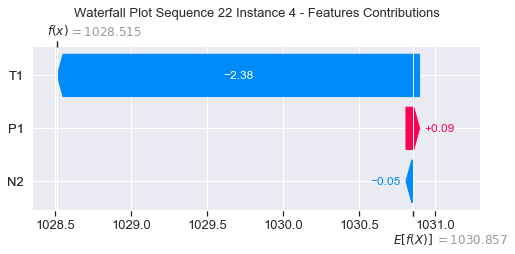

None

Contribution: [ 0.03629179 -1.99845283 -0.10431226]


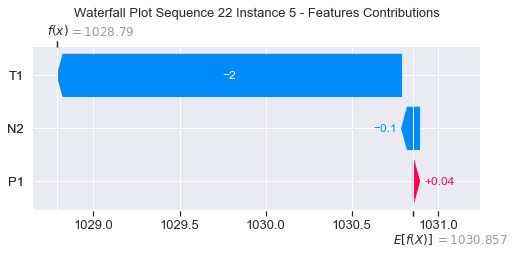

None

Contribution: [ 0.01258478 -1.76234613 -0.12536827]


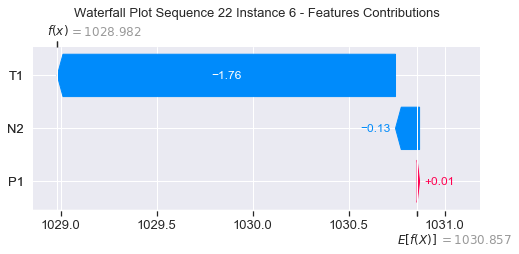

None

Contribution: [ 0.01909386 -1.69055568 -0.13659928]


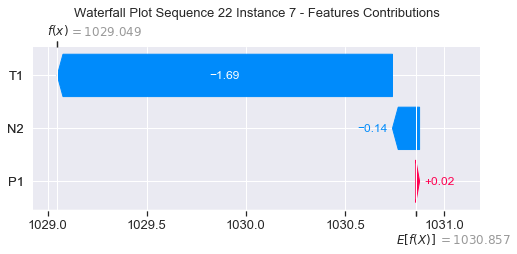

None

Contribution: [-1.41977185e-03 -1.63726044e+00 -1.48262001e-01]


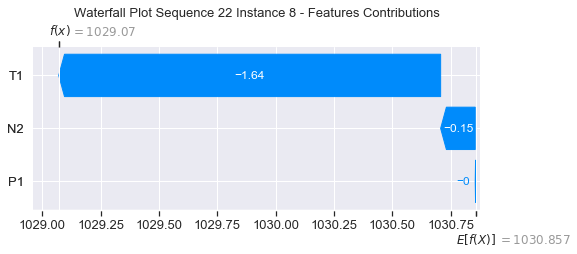

None

Contribution: [-0.08222544 -1.60747762 -0.15859316]


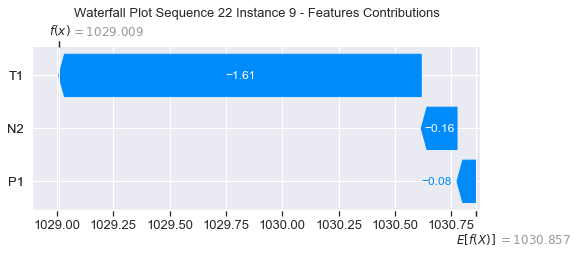

None

Contribution: [-0.08095952 -1.45288508 -0.10680758]


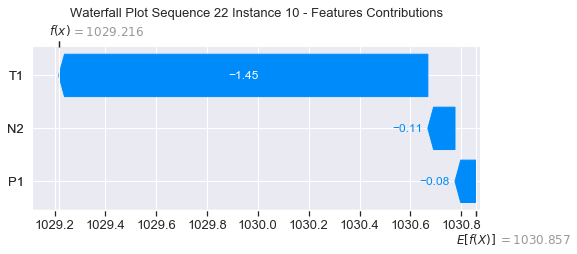

None

Contribution: [-0.12872772 -1.48446762 -0.14707341]


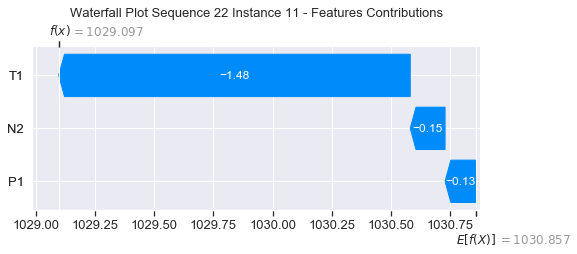

None

Contribution: [-1.12917377e-03 -1.59009138e+00 -9.21248918e-02]


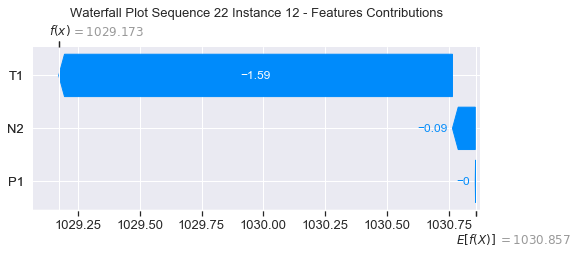

None

Contribution: [ 0.02781723 -1.55918206 -0.0710921 ]


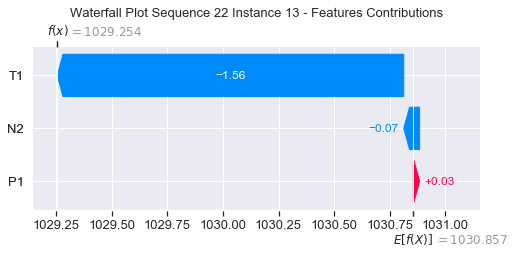

None

Contribution: [-1.74601327e-05 -1.55985805e+00 -7.24898152e-02]


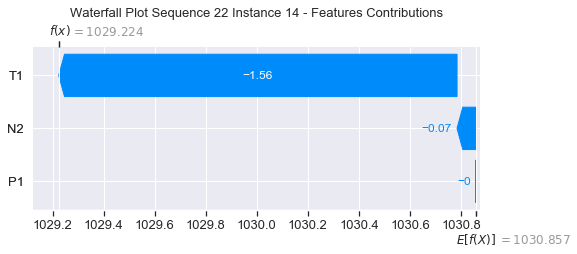

None

Contribution: [-1.34813914e-03 -1.70051067e+00 -1.53349164e-01]


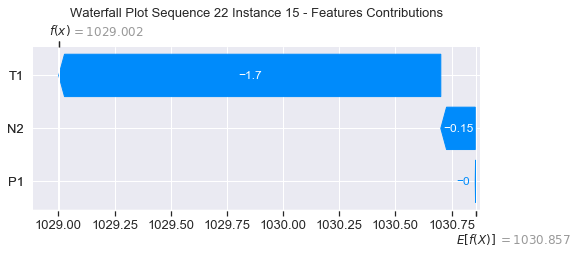

None

Contribution: [-0.05198722 -1.7125784  -0.20929371]


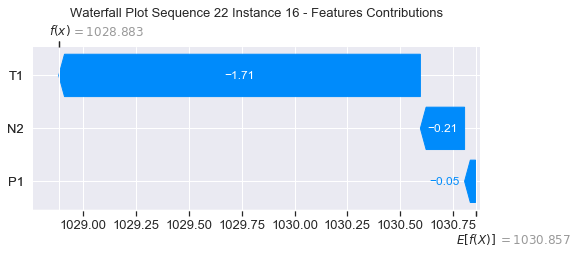

None

Contribution: [-0.02702805 -1.79849118 -0.39025307]


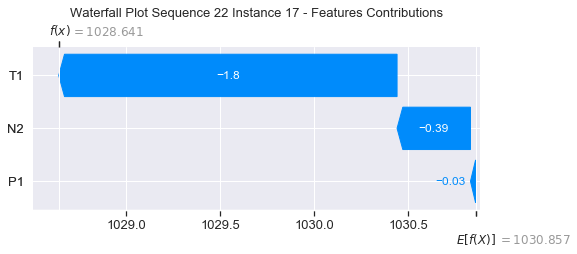

None

Contribution: [-0.0304957  -1.87245366 -0.41932974]


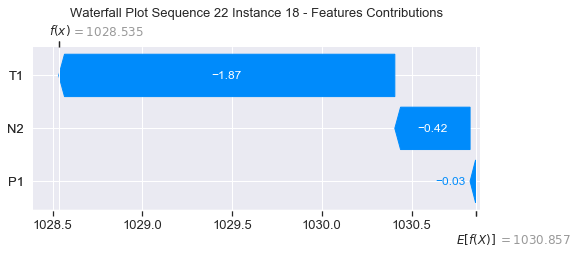

None

Contribution: [-0.14053862 -2.07161974 -0.14292194]


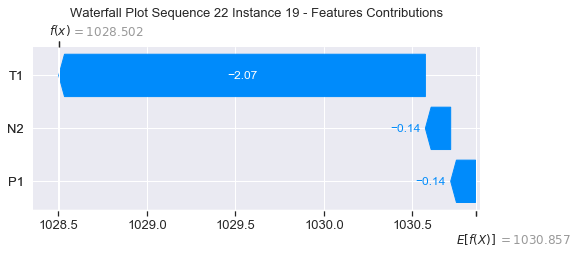

None

Contribution: [ 0.38213054 -2.05989176  0.61431999]


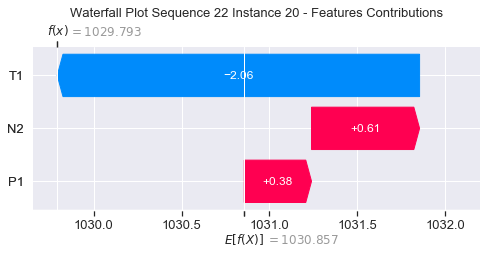

None

Contribution: [ 0.87810423 -2.17076553  2.03097536]


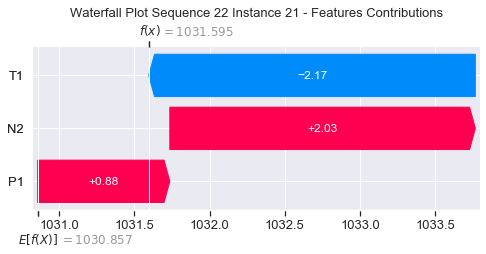

None

Contribution: [ 1.4491283  -2.73001789  3.93369338]


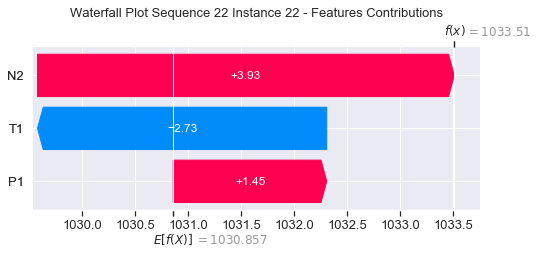

None

Contribution: [ 1.69059052 -3.89320861  5.51263783]


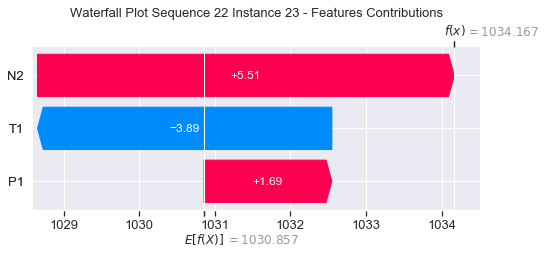

None

Contribution: [ 1.70347678 -6.05717951  5.32024171]


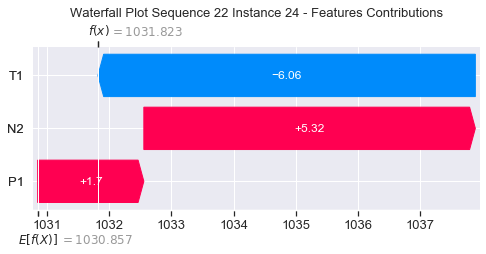

None

Contribution: [ -0.10613807 -16.67626809   2.91990815]


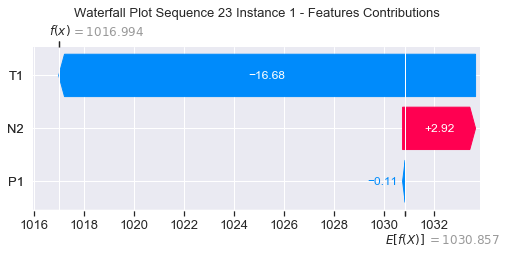

None

Contribution: [ 0.02395751 -2.16708073 -0.23833849]


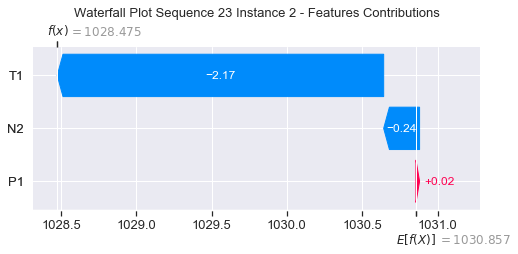

None

Contribution: [-0.0894464  -6.02199043  0.20077749]


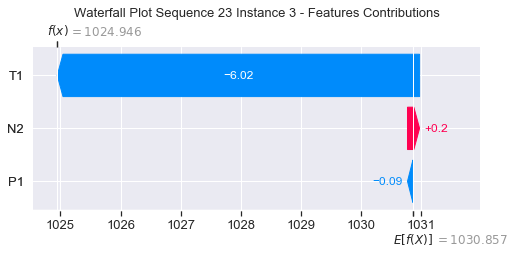

None

Contribution: [-0.17126345 -2.32223952 -0.11773371]


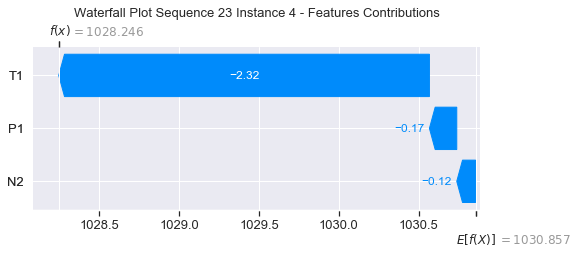

None

Contribution: [ 0.03998258 -1.7976915  -0.05594245]


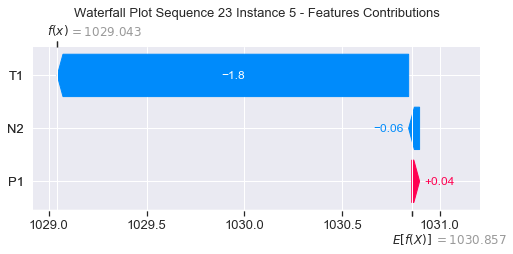

None

Contribution: [ 0.05138581 -1.61546066 -0.06423874]


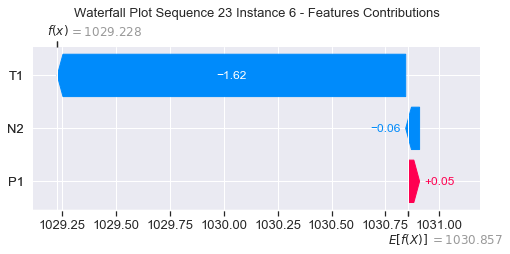

None

Contribution: [ 0.04688419 -1.54497532 -0.07690427]


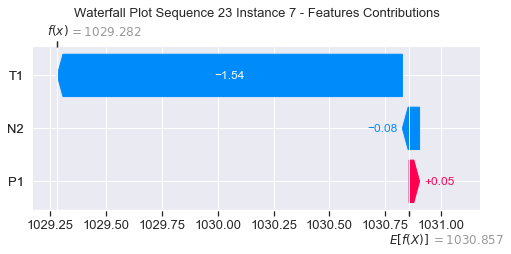

None

Contribution: [ 0.02973285 -1.54093754 -0.08789018]


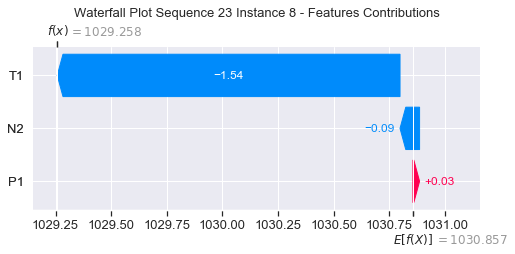

None

Contribution: [-0.0217827  -1.48683702 -0.05290182]


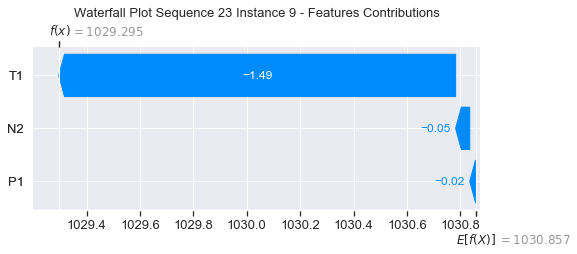

None

Contribution: [-0.02074529 -1.43774395 -0.02387472]


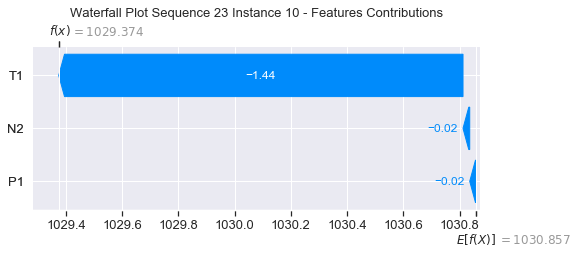

None

Contribution: [-0.03467597 -1.50307073 -0.04307996]


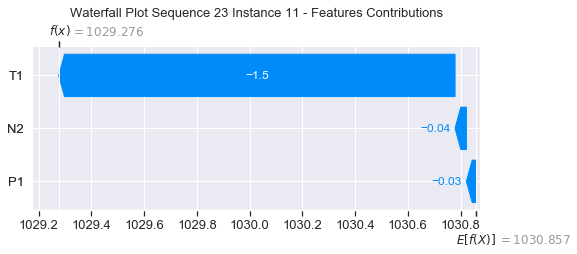

None

Contribution: [ 0.04204492 -1.58452897 -0.04124653]


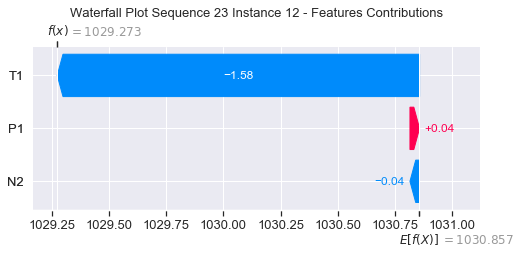

None

Contribution: [ 0.05811633 -1.53322859 -0.02612338]


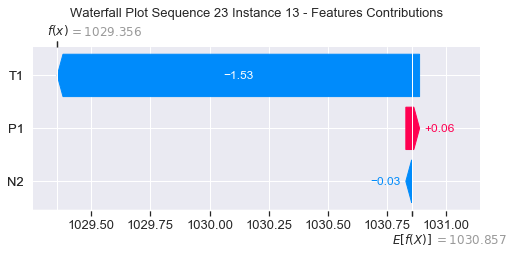

None

Contribution: [ 0.04971496 -1.52284054 -0.01787319]


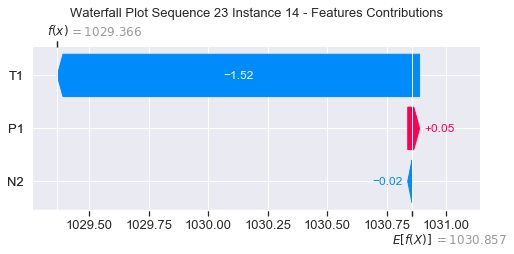

None

Contribution: [ 0.0202463  -1.66195525 -0.1126421 ]


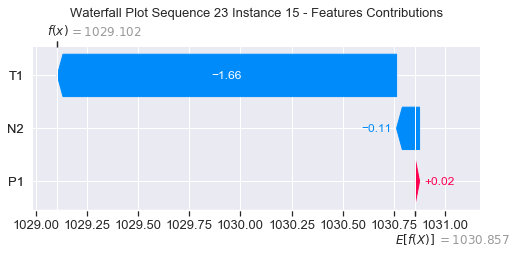

None

Contribution: [-0.14785865 -1.71188585 -0.21502283]


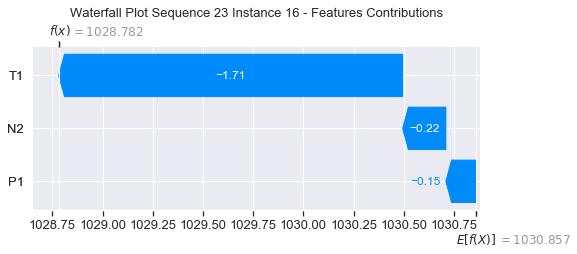

None

Contribution: [-0.01237026 -1.7695545  -0.33562817]


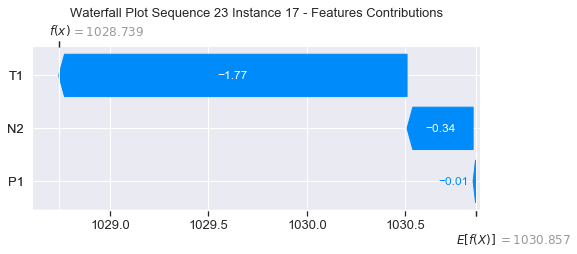

None

Contribution: [-0.01331812 -1.87720747 -0.35311171]


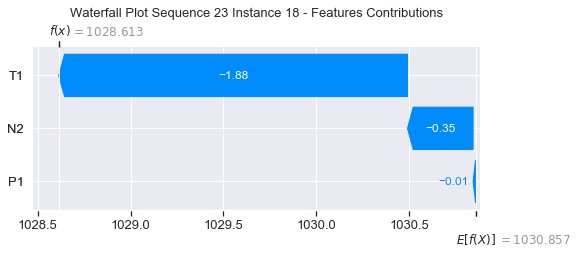

None

Contribution: [-0.02611103 -2.11968182 -0.10813922]


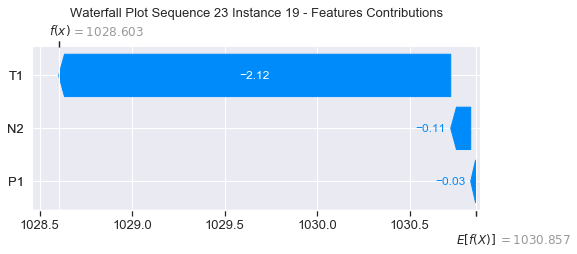

None

Contribution: [ 0.33783535 -2.08958136  0.68693391]


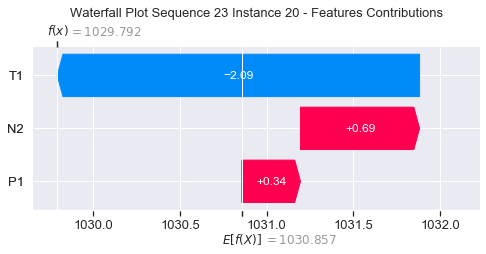

None

Contribution: [ 0.80220645 -2.33289312  2.0958336 ]


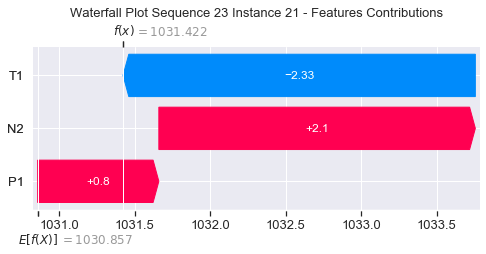

None

Contribution: [ 1.32215338 -3.17255267  3.96938395]


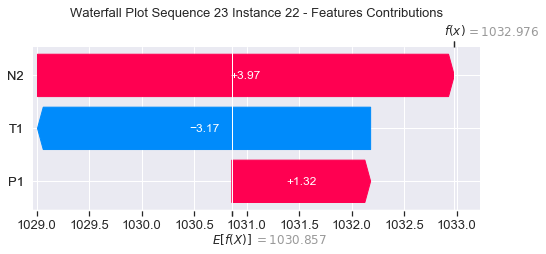

None

Contribution: [ 1.57092629 -4.82218978  5.54647847]


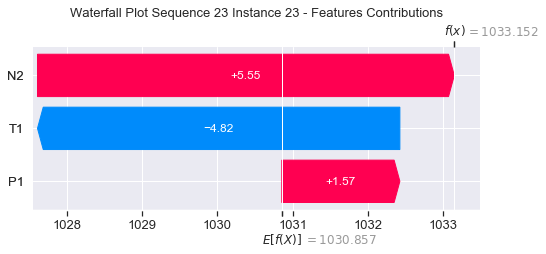

None

Contribution: [ 1.99266933 -6.74447527  5.37546161]


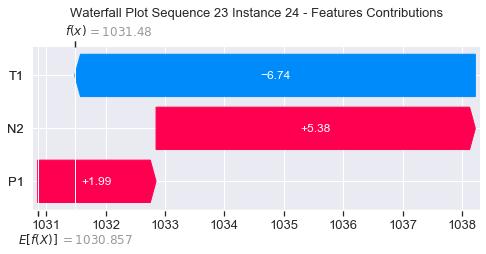

None

Contribution: [  3.503149   -16.13923367   3.46613027]


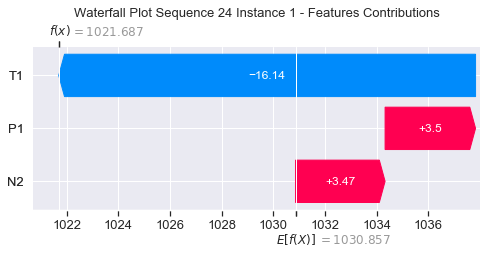

None

Contribution: [-0.03115338 -2.49314414 -0.25745376]


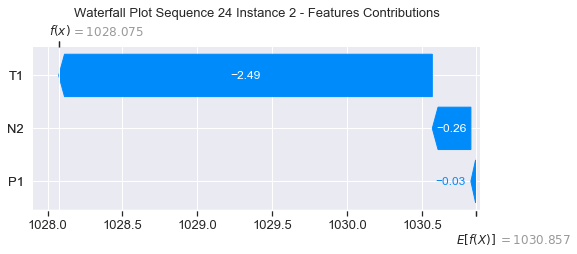

None

Contribution: [ 0.33465477 -4.96673952  0.31764789]


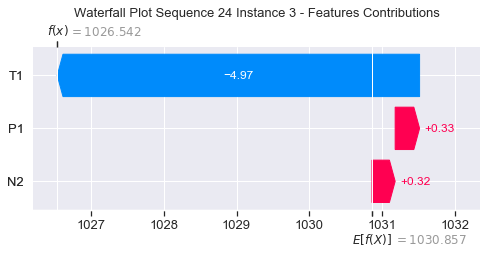

None

Contribution: [ 0.17373024 -2.21500564 -0.04451731]


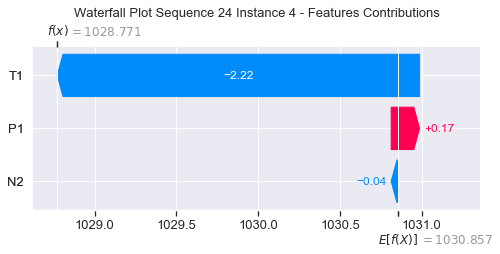

None

Contribution: [ 0.07804487 -1.86309964 -0.05453437]


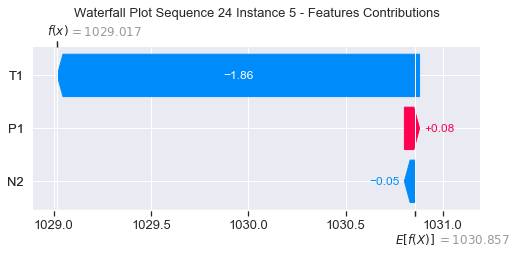

None

Contribution: [ 0.05408435 -1.71542354 -0.05491391]


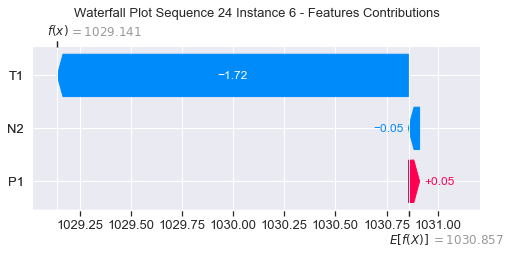

None

Contribution: [ 0.05036448 -1.62891044 -0.06690812]


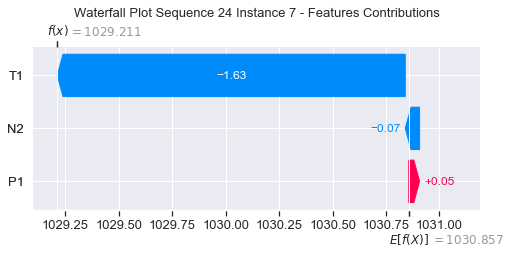

None

Contribution: [ 0.03167041 -1.5929049  -0.08369481]


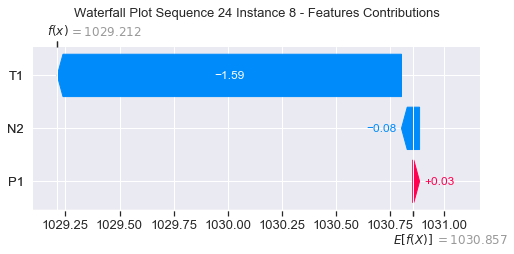

None

Contribution: [-0.06620753 -1.55150466 -0.0748319 ]


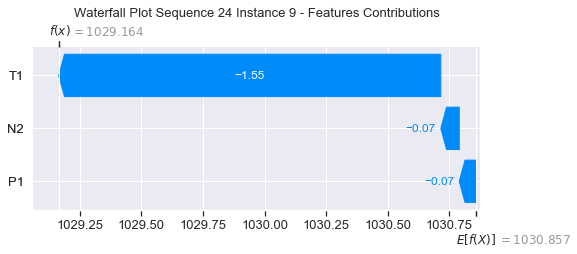

None

Contribution: [-0.05827543 -1.60364526 -0.03517662]


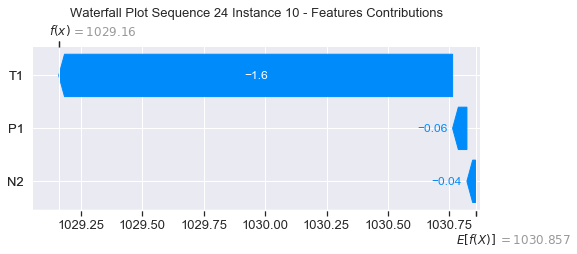

None

Contribution: [-0.06147544 -1.59644774 -0.05801945]


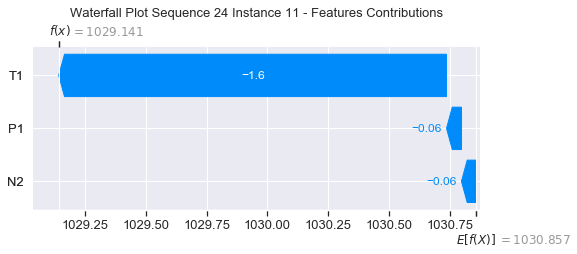

None

Contribution: [ 0.07047414 -1.69639253 -0.02820234]


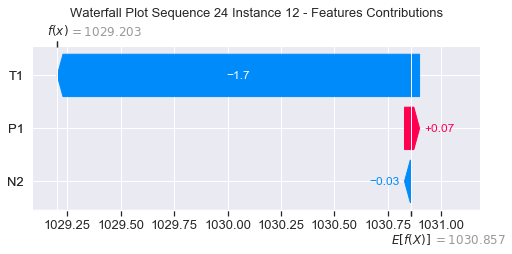

None

Contribution: [ 0.08405517 -1.60892135 -0.01760836]


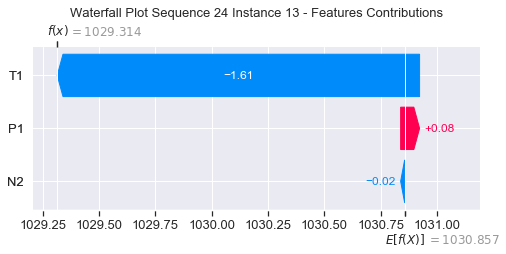

None

Contribution: [ 0.01891416 -1.69703712 -0.06130266]


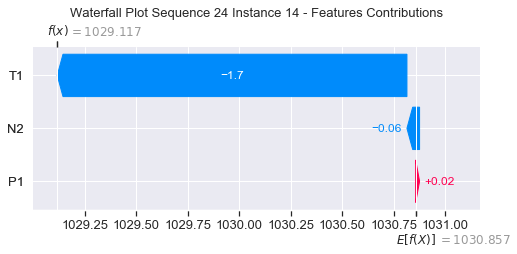

None

Contribution: [ 0.05085235 -1.66753602 -0.10434412]


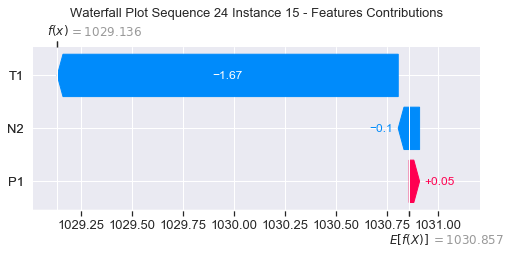

None

Contribution: [-0.12962618 -1.86025973 -0.23083131]


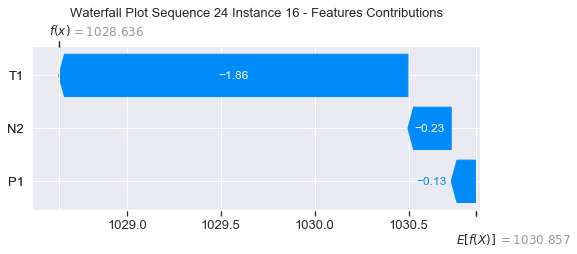

None

Contribution: [ 0.01301237 -1.68721472 -0.31236437]


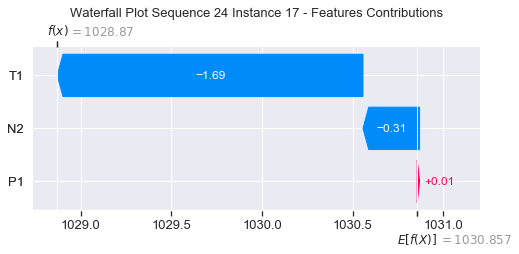

None

Contribution: [ 0.01703065 -1.71525348 -0.31403797]


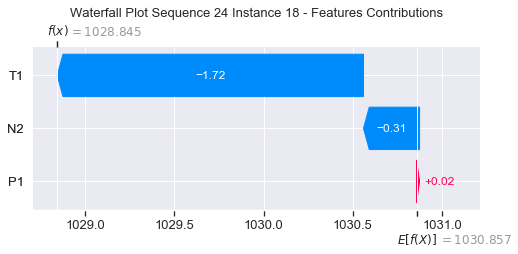

None

Contribution: [-0.02016655 -1.7041034   0.0628177 ]


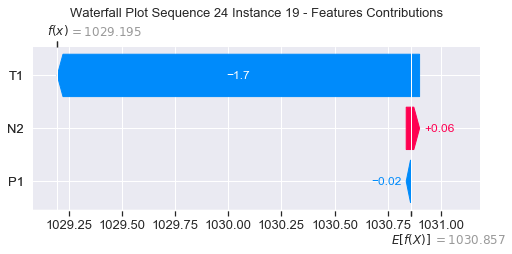

None

Contribution: [ 0.39246826 -1.50716173  0.73405468]


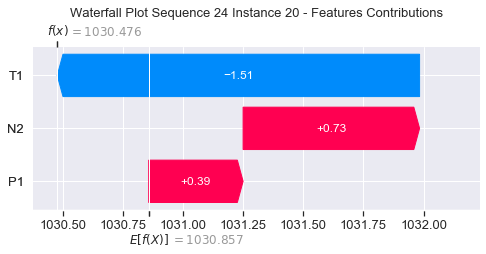

None

Contribution: [ 0.90028126 -1.46467308  2.12491733]


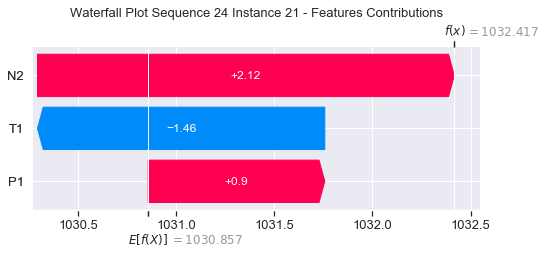

None

Contribution: [ 1.5313182  -1.74212774  3.98341337]


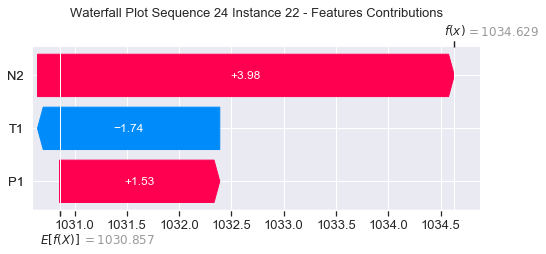

None

Contribution: [ 1.82569823 -2.81041981  5.57769953]


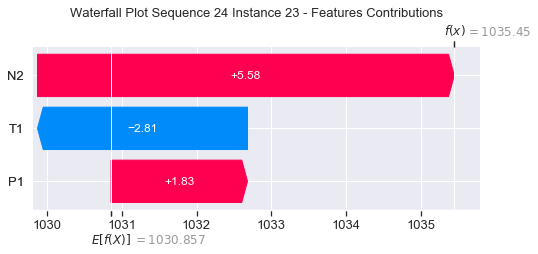

None

Contribution: [ 2.00913178 -4.29950244  5.30790477]


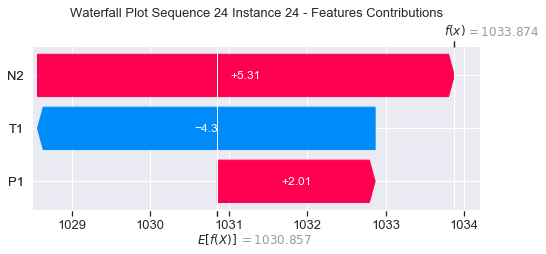

None

Contribution: [  1.93928642 -12.98794197   2.83368895]


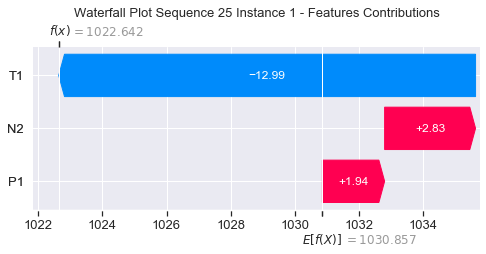

None

Contribution: [ 0.10998364 -2.07897067 -0.24030478]


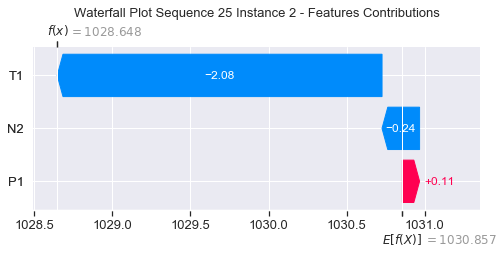

None

Contribution: [ 0.5109121  -4.40847233  0.34586538]


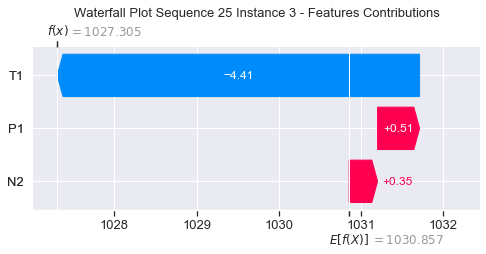

None

Contribution: [-0.07826433 -2.11107047 -0.09819882]


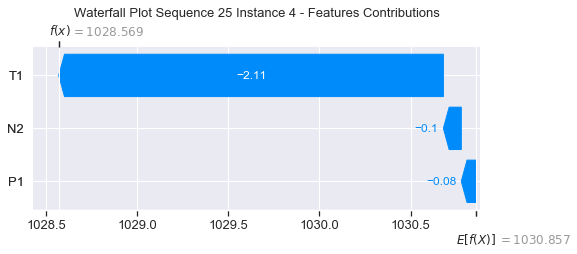

None

Contribution: [ 0.0122601  -1.53451352 -0.08288341]


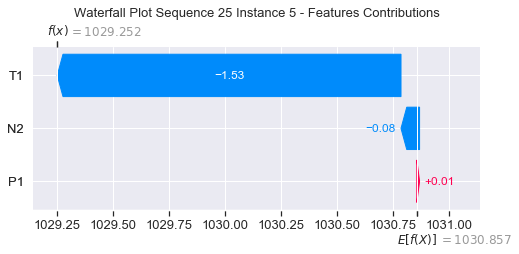

None

Contribution: [-0.00770203 -1.50636981 -0.07624471]


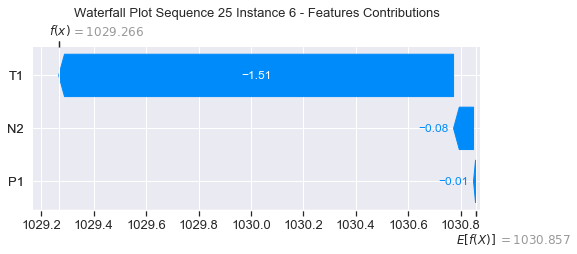

None

Contribution: [-0.01436894 -1.47518215 -0.08879073]


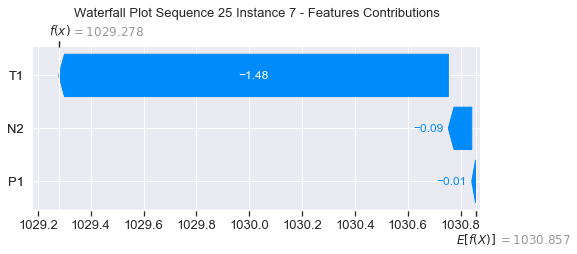

None

Contribution: [-0.01338968 -1.41633144 -0.09597503]


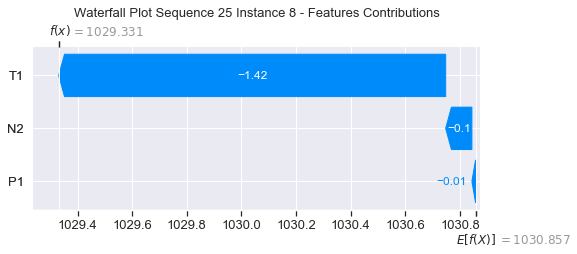

None

Contribution: [-0.03183194 -1.37189578 -0.04819057]


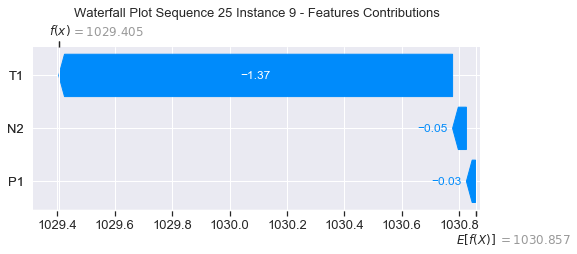

None

Contribution: [-0.22051959 -1.50654372 -0.06160439]


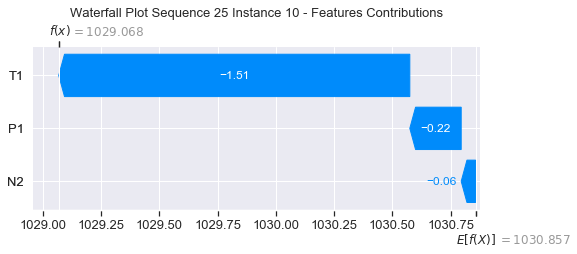

None

Contribution: [-0.01254441 -1.27793266 -0.01905498]


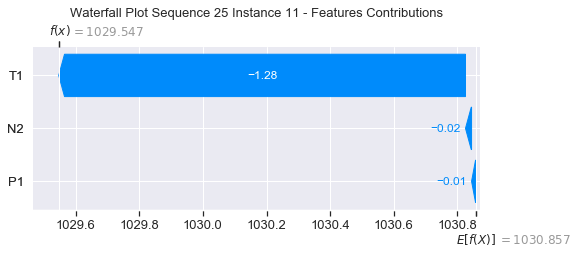

None

Contribution: [ 0.01614192 -1.48307103 -0.03382644]


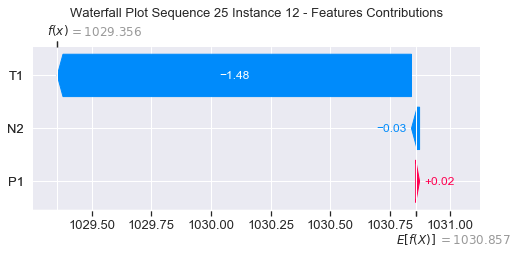

None

Contribution: [ 0.0265855  -1.41975071 -0.02650364]


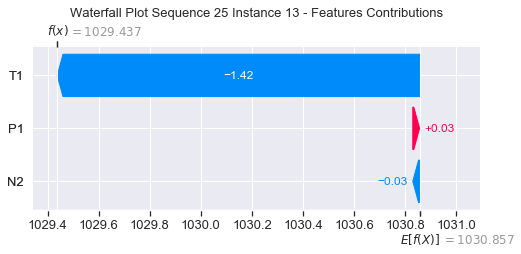

None

Contribution: [ 0.04426354 -1.51235146 -0.06166063]


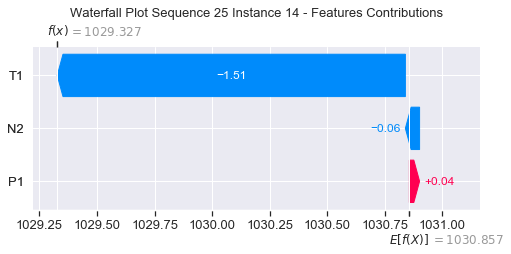

None

Contribution: [-0.0079649  -1.49758868 -0.11257798]


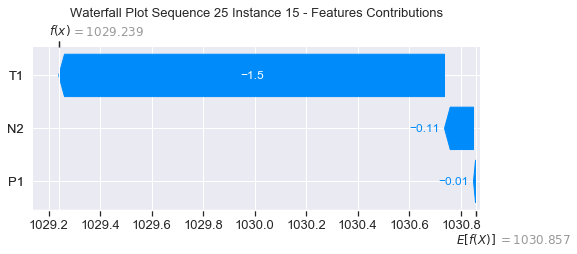

None

Contribution: [-0.21336808 -1.73055544 -0.23246464]


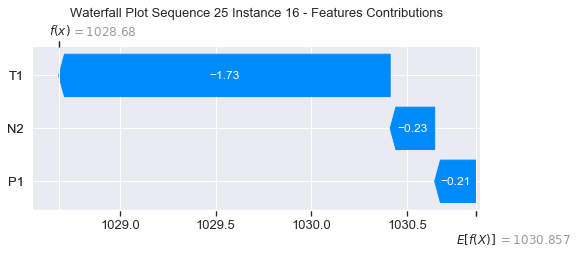

None

Contribution: [-0.0510717  -1.56849353 -0.31256935]


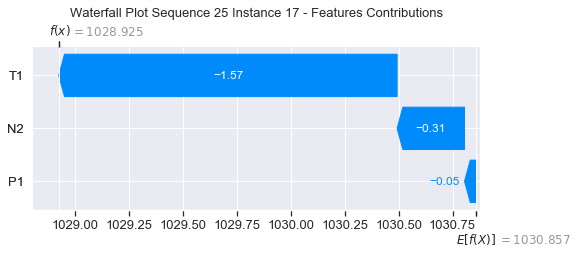

None

Contribution: [-0.04942852 -1.59196049 -0.30750535]


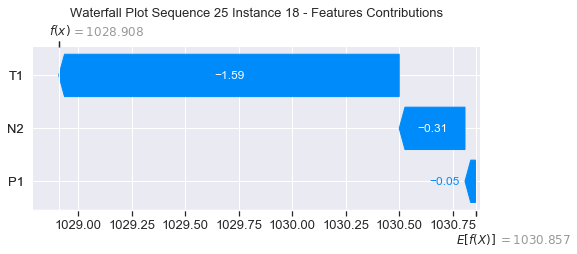

None

Contribution: [ 0.06116992 -1.62780233  0.03138934]


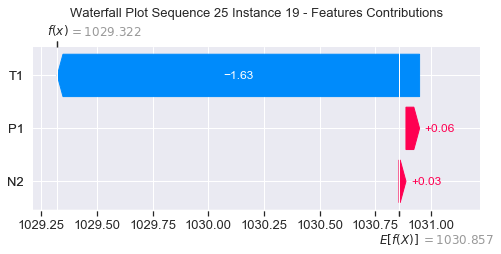

None

Contribution: [ 0.28617367 -1.39878329  0.7377216 ]


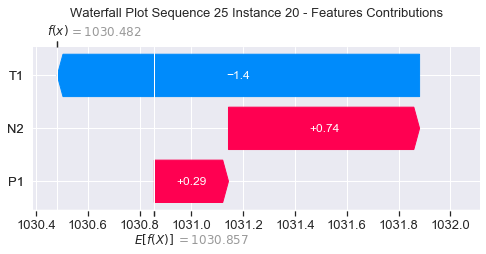

None

Contribution: [ 0.74953279 -1.23338766  2.12645013]


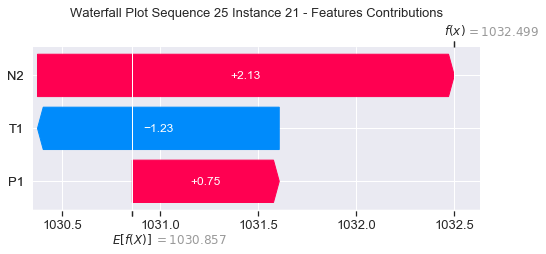

None

Contribution: [ 1.32168681 -1.24669015  3.98335559]


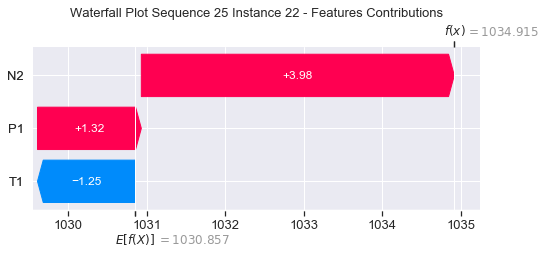

None

Contribution: [ 1.55013547 -2.23697674  5.58395169]


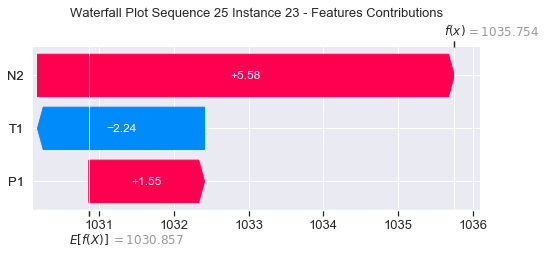

None

Contribution: [ 1.71085032 -3.63104279  5.42056238]


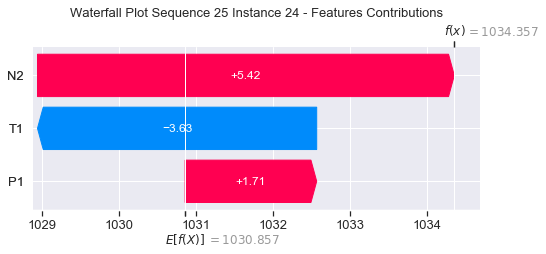

None

Contribution: [  1.53971851 -11.71255566   3.86016686]


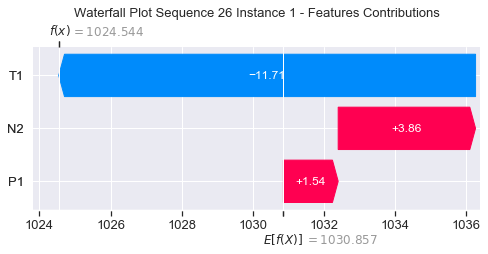

None

Contribution: [ 0.04511613 -1.89920218 -0.22625707]


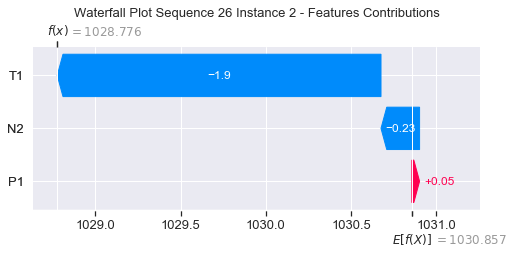

None

Contribution: [ 0.45762002 -3.50066033  0.41115078]


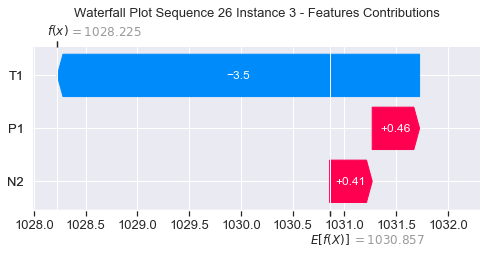

None

Contribution: [ 0.05637314 -1.64901213 -0.02402712]


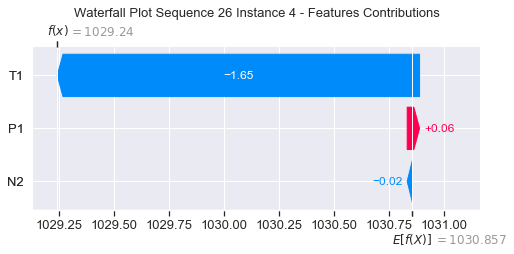

None

Contribution: [ 0.05820871 -1.35256488 -0.03285576]


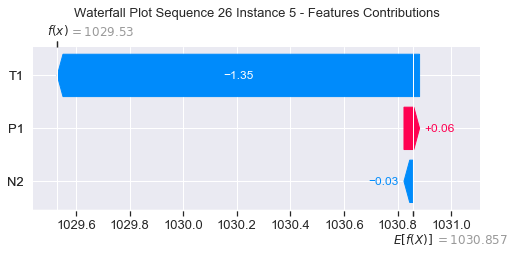

None

Contribution: [-0.00336803 -1.3565882  -0.04804383]


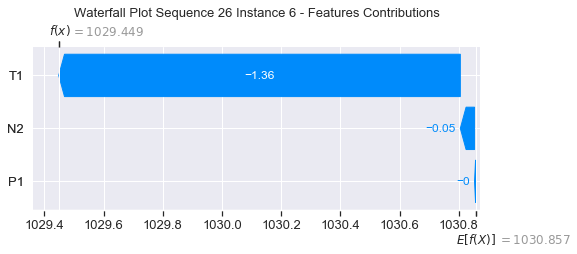

None

Contribution: [-0.00429985 -1.31712162 -0.06197748]


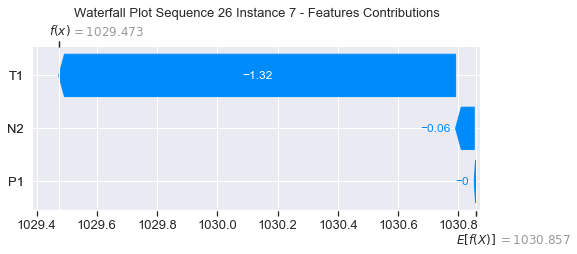

None

Contribution: [-0.00616838 -1.29355452 -0.07395028]


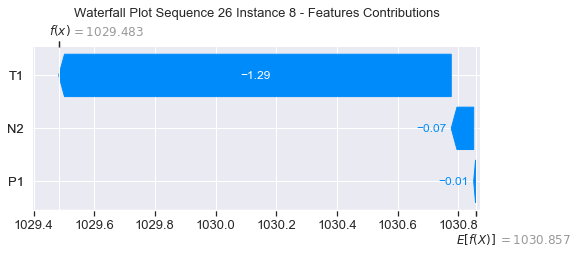

None

Contribution: [-0.0593072  -1.25086232 -0.05394997]


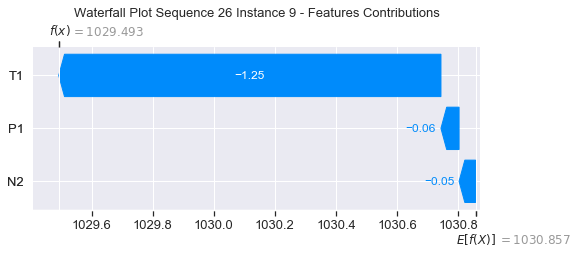

None

Contribution: [-0.09686184 -1.22492006 -0.01318769]


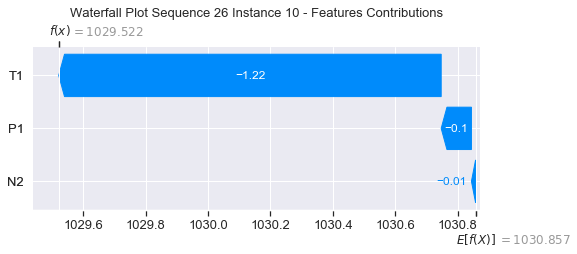

None

Contribution: [-0.02290623 -1.26231879 -0.02789106]


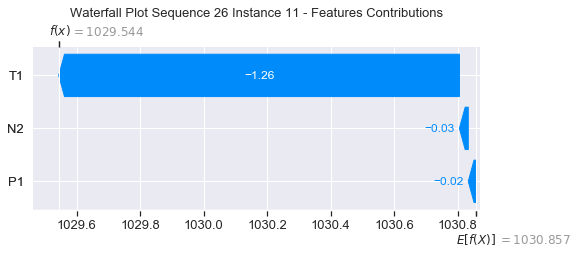

None

Contribution: [ 0.09049072 -1.39327137 -0.01077657]


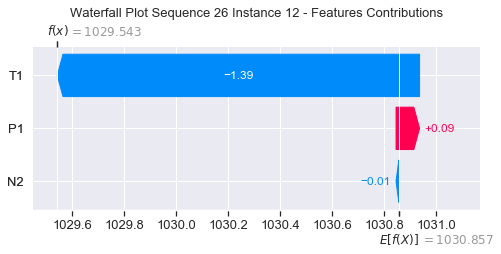

None

Contribution: [ 0.09247086 -1.31600271 -0.00652077]


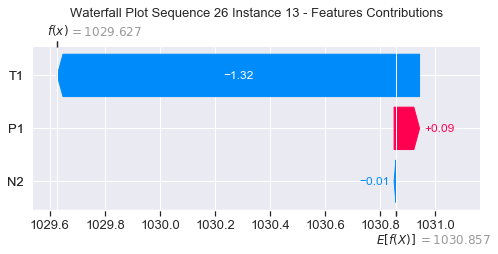

None

Contribution: [ 0.04123545 -1.35829843 -0.04198593]


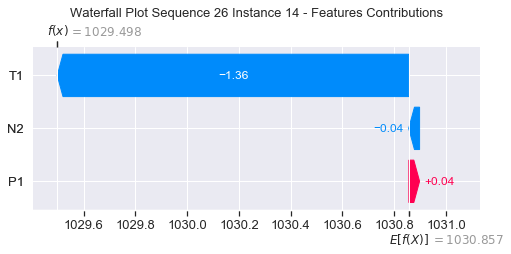

None

Contribution: [ 0.03038716 -1.43694965 -0.09538449]


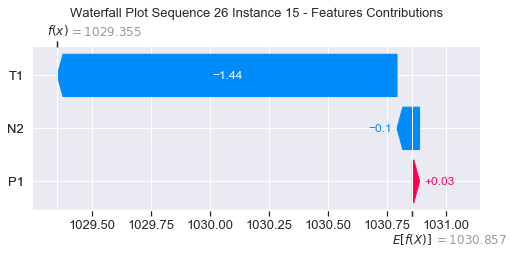

None

Contribution: [-0.08954236 -1.33695145 -0.16443824]


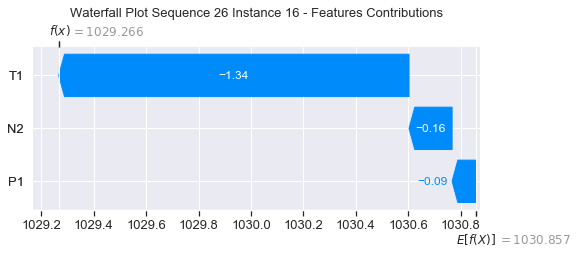

None

Contribution: [-0.02171974 -1.49016131 -0.28629702]


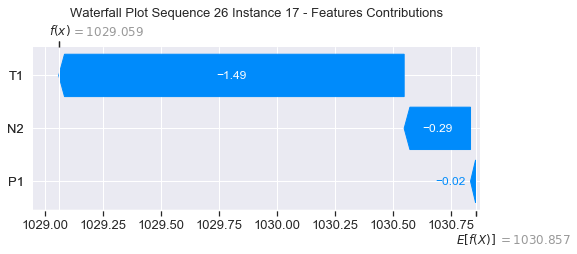

None

Contribution: [-0.03147338 -1.53108383 -0.2787085 ]


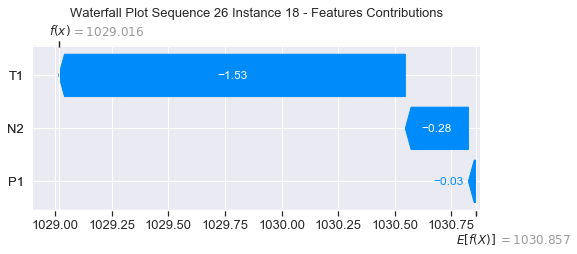

None

Contribution: [-0.01725865 -1.45373838  0.02851473]


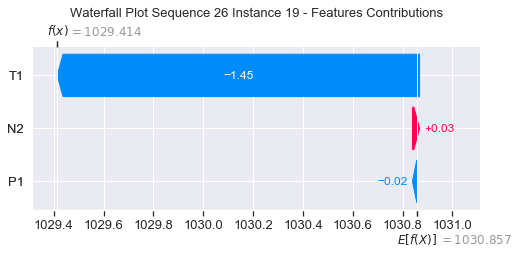

None

Contribution: [ 0.26544092 -1.36580926  0.75702995]


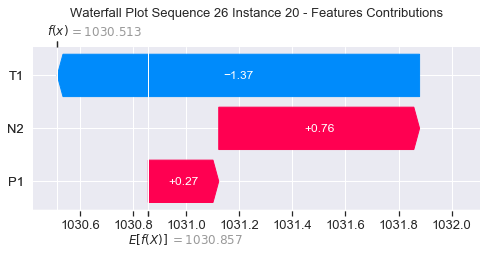

None

Contribution: [ 0.75147151 -1.28091188  2.1331492 ]


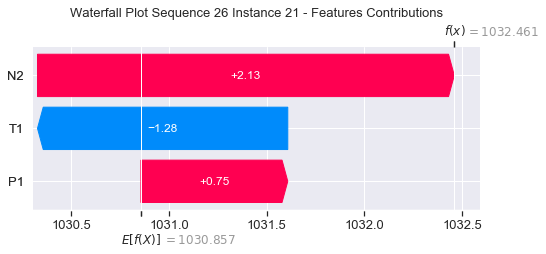

None

Contribution: [ 1.34915551 -1.55401108  3.97156215]


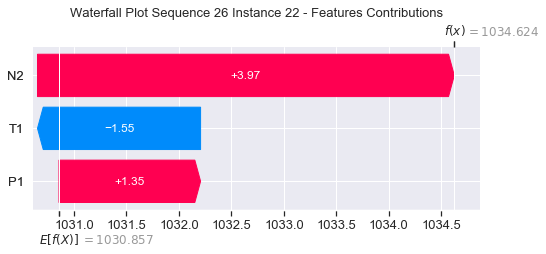

None

Contribution: [ 1.5274679  -2.76141915  5.52034106]


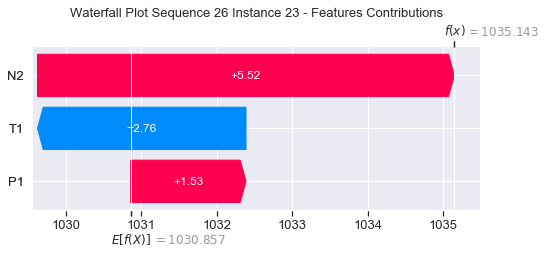

None

Contribution: [ 1.53159851 -4.45944539  5.23151491]


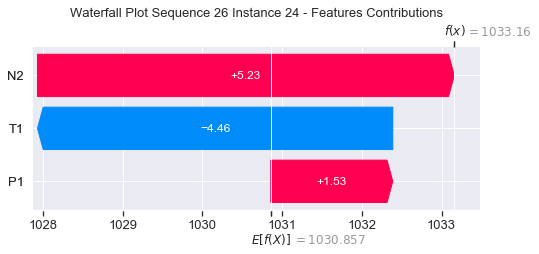

None

Contribution: [  0.97742358 -13.44839896   2.64089996]


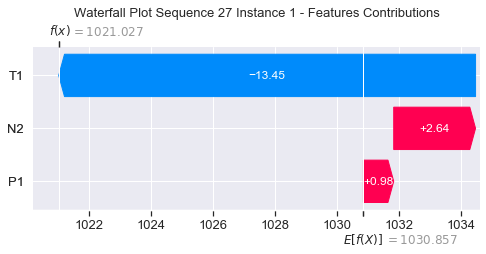

None

Contribution: [ 0.15228852 -2.07241673 -0.22314136]


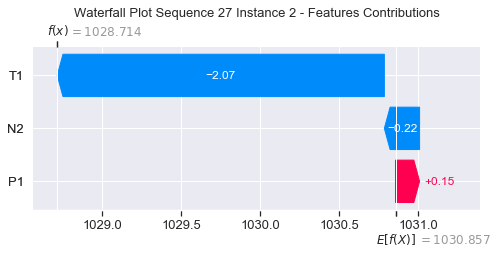

None

Contribution: [ 0.41626112 -4.60742899  0.38367985]


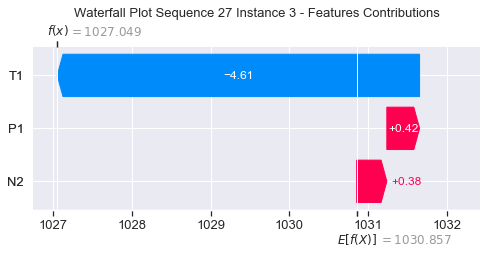

None

Contribution: [ 0.07692037 -1.72252366 -0.03956265]


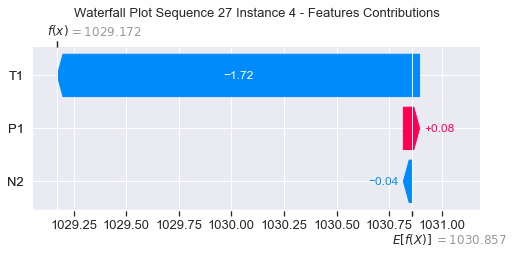

None

Contribution: [-0.04930915 -1.71530105 -0.08618973]


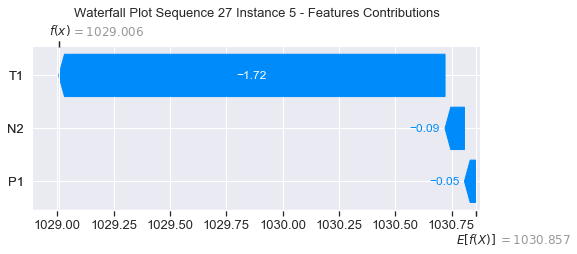

None

Contribution: [ 0.01111852 -1.49750578 -0.06981027]


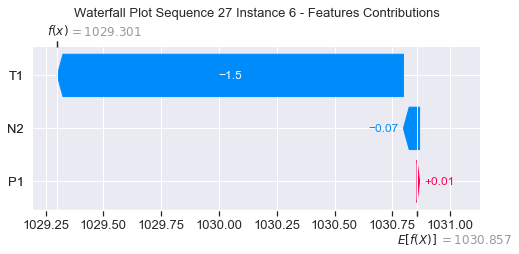

None

Contribution: [ 0.00197708 -1.42423741 -0.08568068]


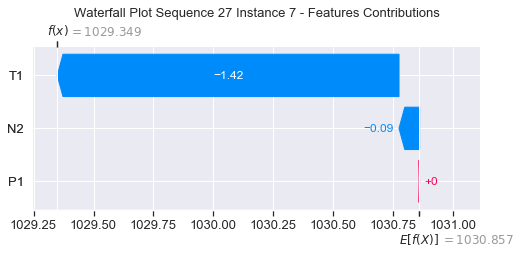

None

Contribution: [-0.01250159 -1.4108629  -0.09696209]


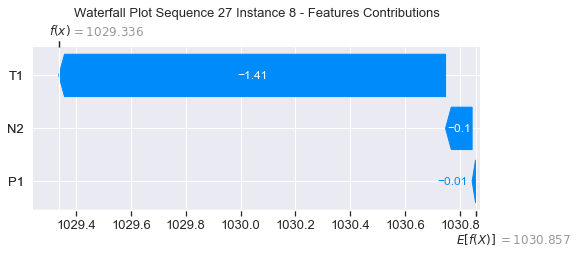

None

Contribution: [-0.10045473 -1.33545751 -0.07939079]


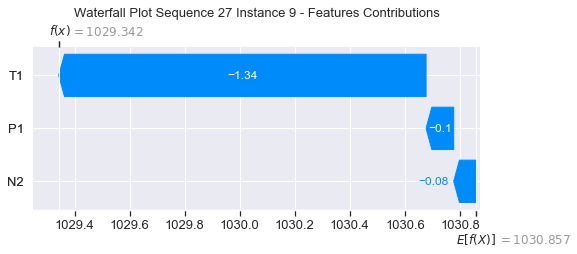

None

Contribution: [-0.13278166 -1.33335836 -0.04915692]


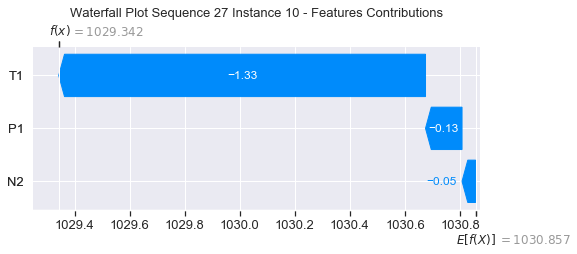

None

Contribution: [-0.0874971  -1.42681937 -0.0626531 ]


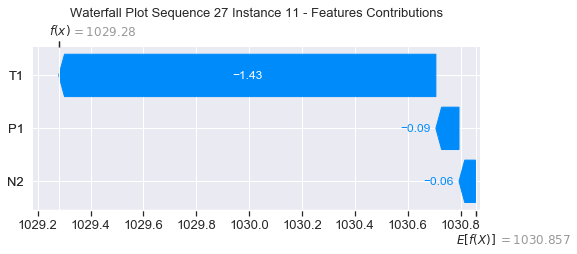

None

Contribution: [-0.0305255  -1.56743844 -0.07637371]


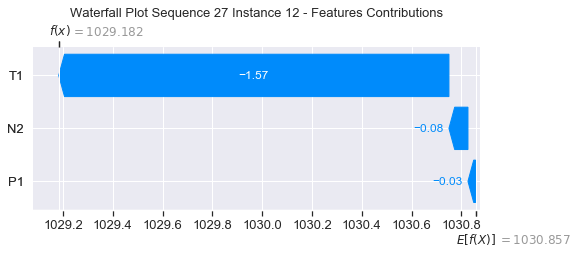

None

Contribution: [-0.01842537 -1.4710565  -0.06646742]


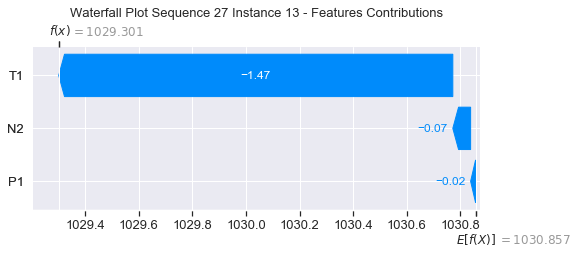

None

Contribution: [-0.03116496 -1.42367232 -0.07382944]


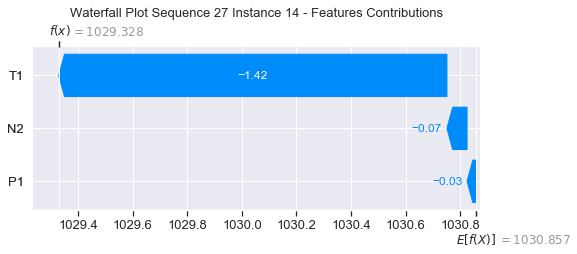

None

Contribution: [-0.04552644 -1.51871019 -0.14337202]


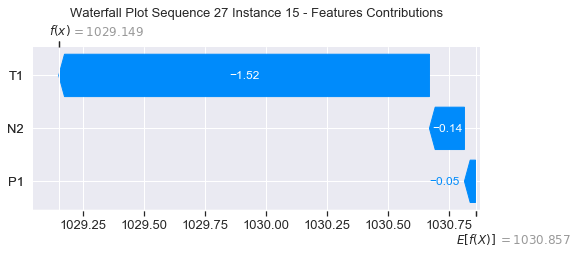

None

Contribution: [-0.08986164 -1.3797233  -0.19823321]


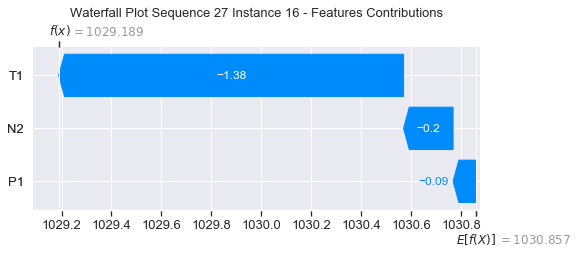

None

Contribution: [-0.06469853 -1.49428857 -0.33881303]


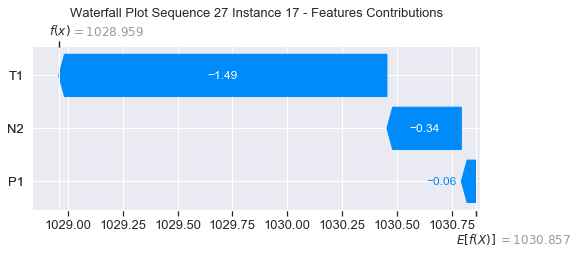

None

Contribution: [-0.05273578 -1.4957772  -0.33513761]


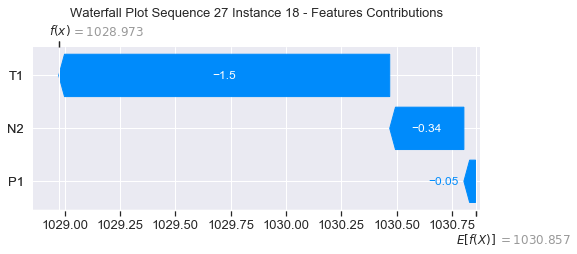

None

Contribution: [-0.05548084 -1.5370404  -0.06062775]


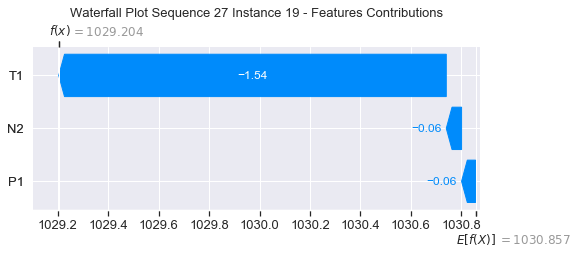

None

Contribution: [ 0.27590087 -1.19452253  0.70109865]


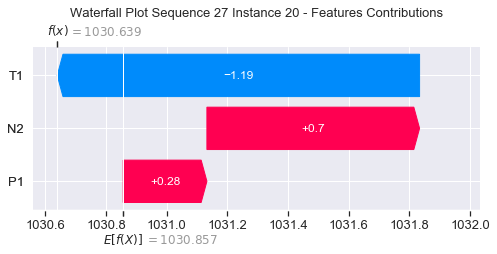

None

Contribution: [ 0.67244832 -1.1079524   2.05363633]


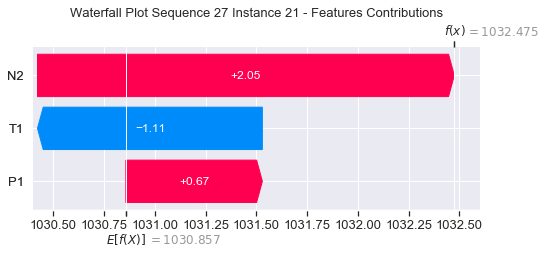

None

Contribution: [ 1.097691   -1.41708292  3.84988292]


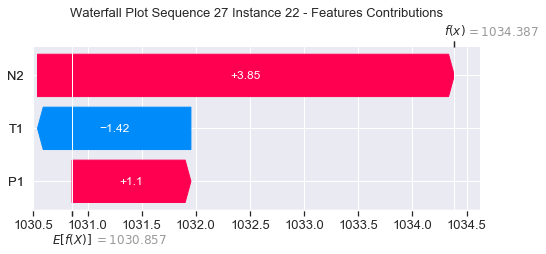

None

Contribution: [ 1.37291699 -2.2558169   5.4127172 ]


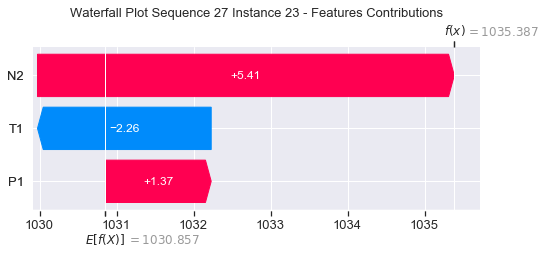

None

Contribution: [ 1.45276856 -3.55629498  5.1724227 ]


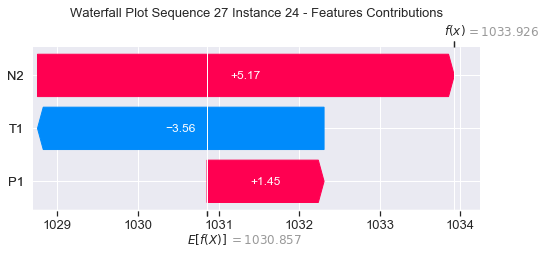

None

Contribution: [  0.04054276 -11.45281868   2.40302148]


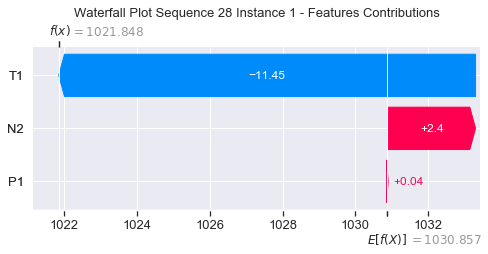

None

Contribution: [-0.18306501 -2.22703281 -0.3356762 ]


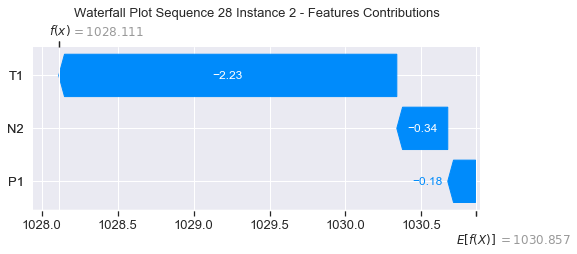

None

Contribution: [-0.39502626 -4.54257314  0.08616459]


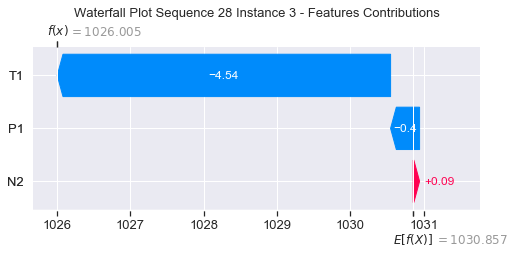

None

Contribution: [ 0.09125962 -1.79274465 -0.08700122]


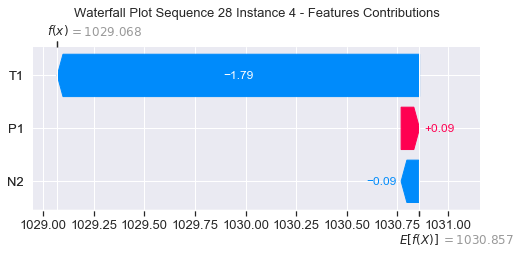

None

Contribution: [ 0.16106617 -1.54442112 -0.04341533]


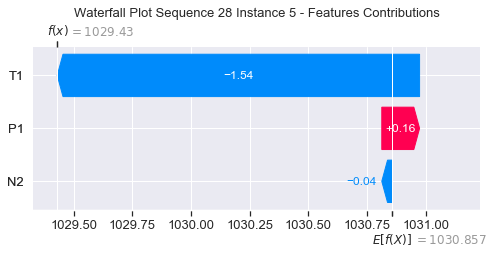

None

Contribution: [ 0.06576952 -1.22683926 -0.07342761]


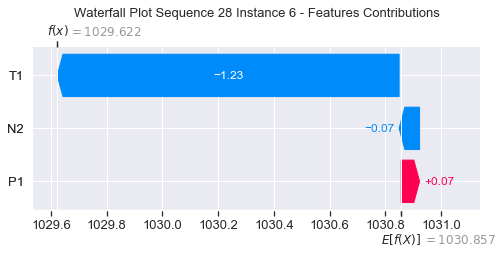

None

Contribution: [ 0.0133131  -1.08682673 -0.07892034]


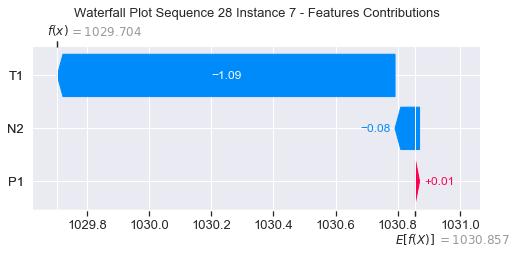

None

Contribution: [ 0.05456175 -1.23427645 -0.07905445]


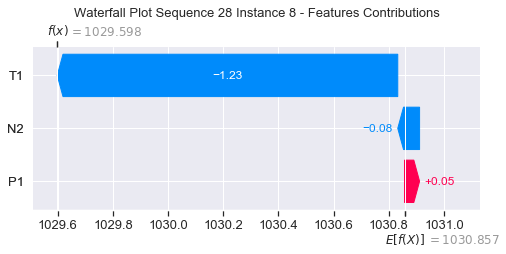

None

Contribution: [-0.04176345 -0.86988584  0.00924404]


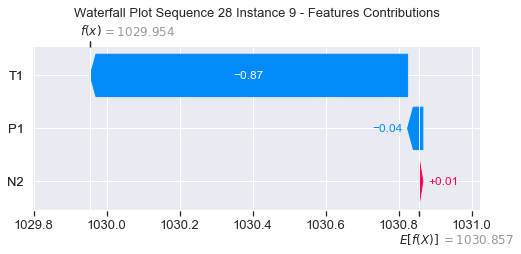

None

Contribution: [ 0.04786058 -0.91067741  0.04087141]


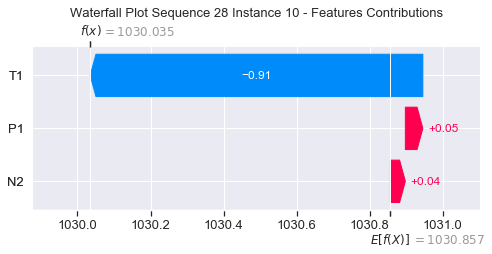

None

Contribution: [ 9.28016589e-02 -1.28678144e+00 -4.04500724e-04]


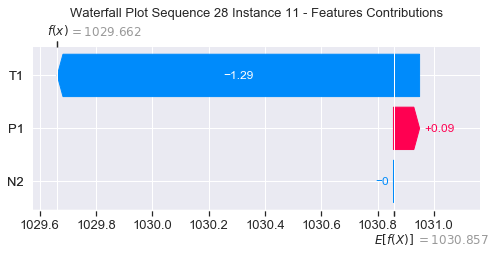

None

Contribution: [ 0.09318107 -1.54512768 -0.02895661]


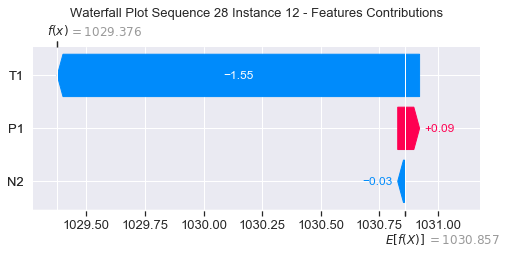

None

Contribution: [ 0.09953973 -1.47441698 -0.01717493]


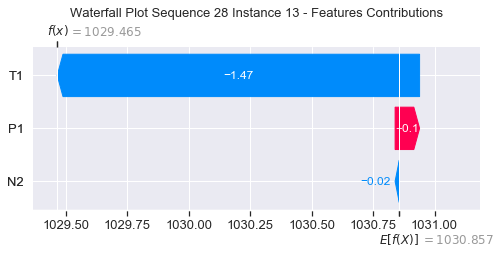

None

Contribution: [-0.02120219 -1.64283269 -0.06869869]


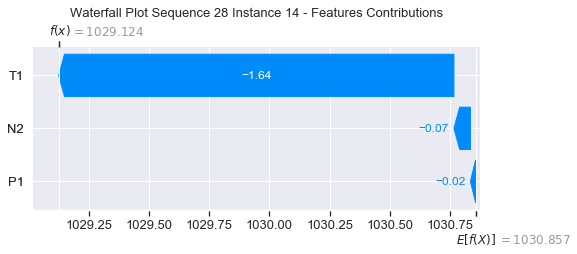

None

Contribution: [ 0.08236723 -1.7474179  -0.11171795]


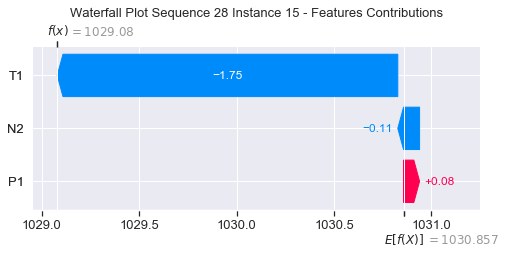

None

Contribution: [ 0.07731467 -1.58149619 -0.15612037]


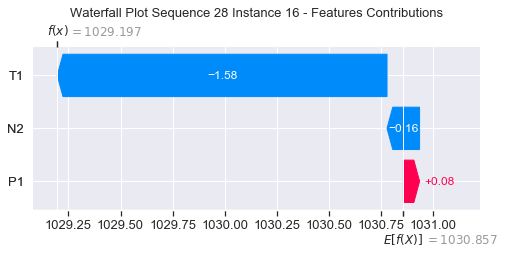

None

Contribution: [ 0.05059771 -1.89325922 -0.3098742 ]


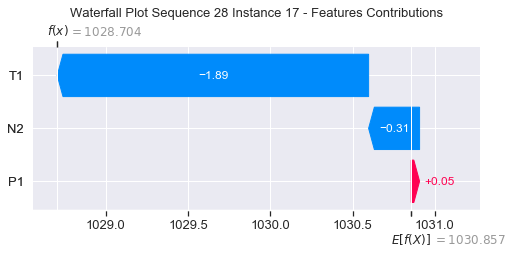

None

Contribution: [ 0.09928524 -2.16280718 -0.31815861]


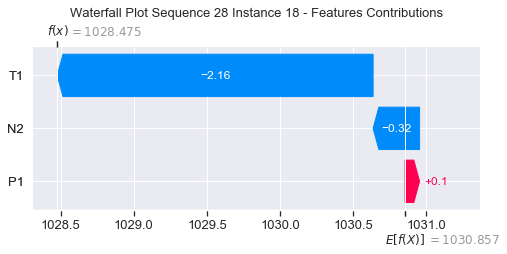

None

Contribution: [-0.02150358 -2.52379384 -0.01490085]


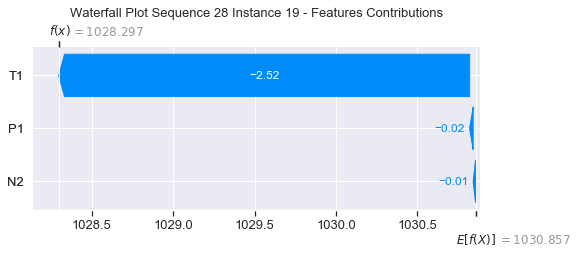

None

Contribution: [ 0.62858434 -2.89412289  0.76052237]


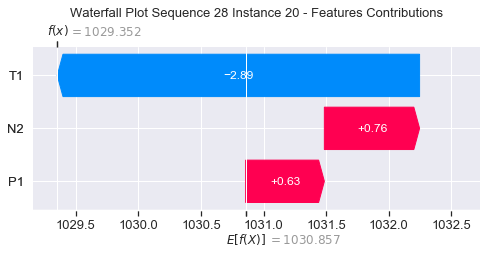

None

Contribution: [ 1.36352924 -3.99101068  2.19243498]


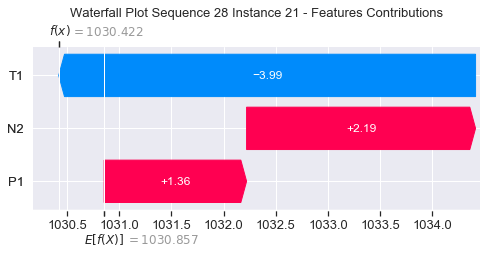

None

Contribution: [ 2.46534486 -6.66030171  4.09789672]


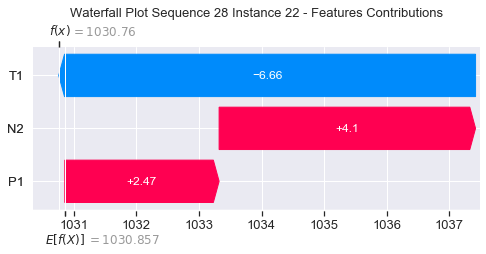

None

Contribution: [ 3.17186244 -9.93552256  5.67772114]


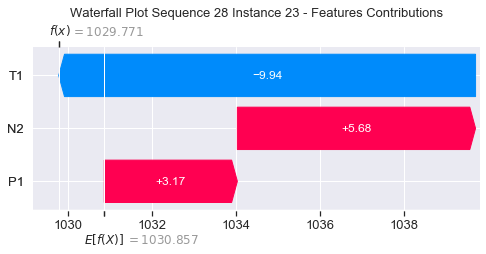

None

Contribution: [  5.05801699 -14.9553751    5.78096333]


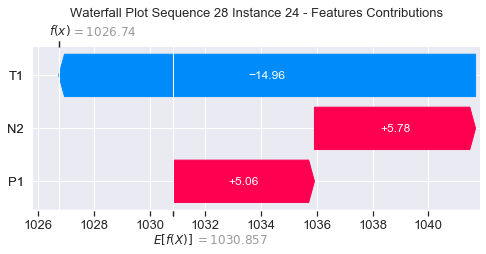

None

Contribution: [ 14.6957199  -38.53125408   5.7900184 ]


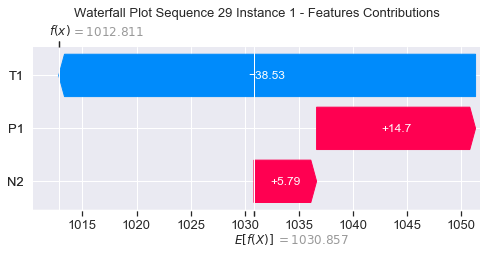

None

Contribution: [ 0.50361553 -3.88805572 -0.19018637]


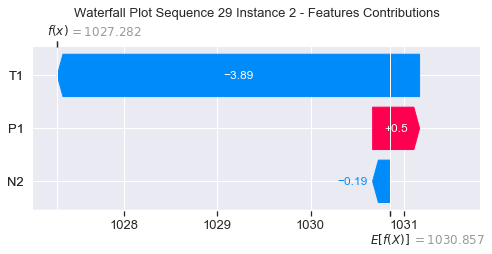

None

Contribution: [  1.70057391 -10.62438937   0.4119289 ]


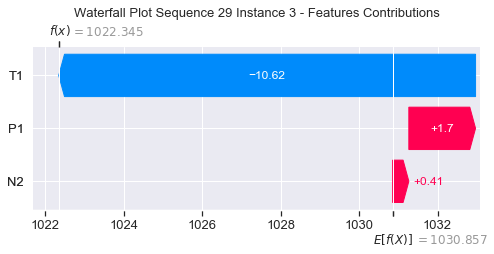

None

Contribution: [ 0.81257783 -3.99033442  0.08994513]


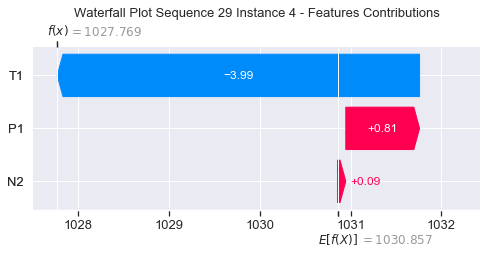

None

Contribution: [ 0.38947789 -3.19268789 -0.04136699]


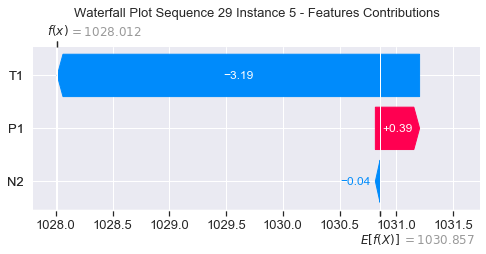

None

Contribution: [ 0.56265049 -2.99478384  0.01208919]


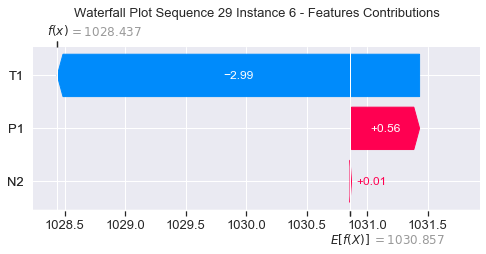

None

Contribution: [ 0.50899595 -2.854026   -0.02001506]


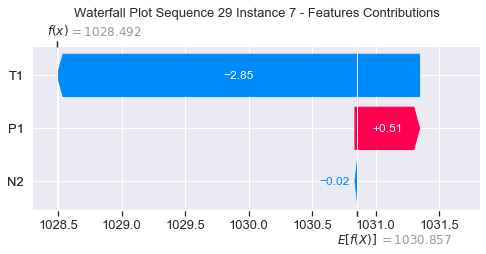

None

Contribution: [ 0.42889129 -2.6838436  -0.04470794]


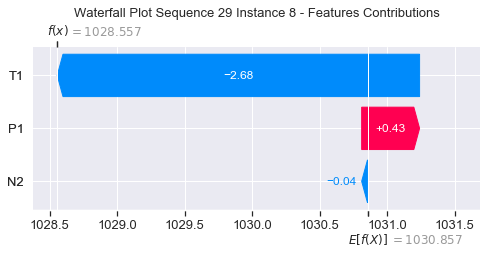

None

Contribution: [ 0.33046858 -2.80804814 -0.05142164]


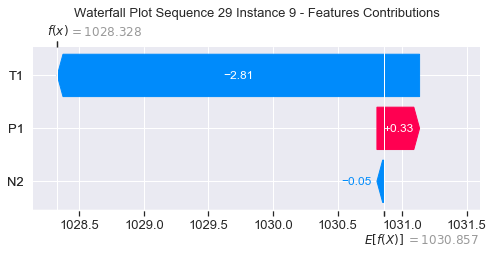

None

Contribution: [ 0.04094894 -2.77347763 -0.0664927 ]


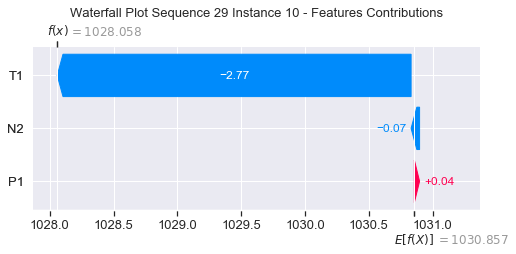

None

Contribution: [ 0.41406073 -2.85869921  0.0174914 ]


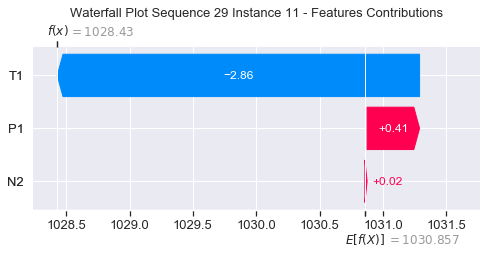

None

Contribution: [ 0.56565146 -3.09571111  0.04013122]


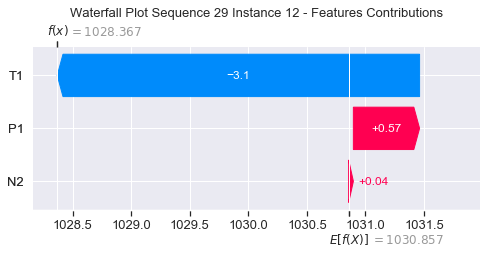

None

Contribution: [ 0.54614792 -3.03243987  0.05509683]


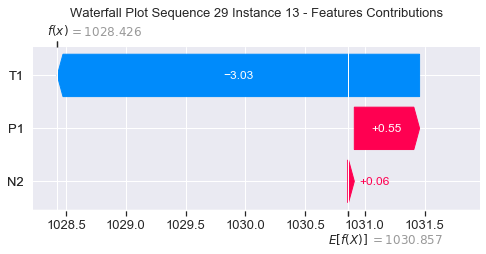

None

Contribution: [ 0.7778169  -3.02510093  0.0874365 ]


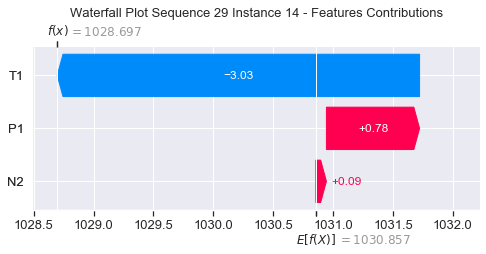

None

Contribution: [ 0.50605792 -3.07835909 -0.02222965]


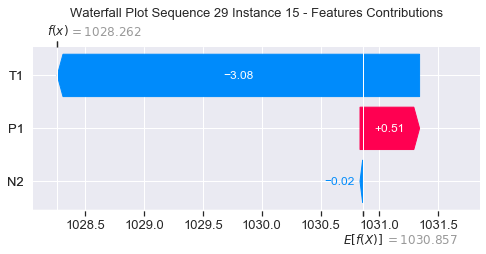

None

Contribution: [ 0.52217432 -3.54345416 -0.10616881]


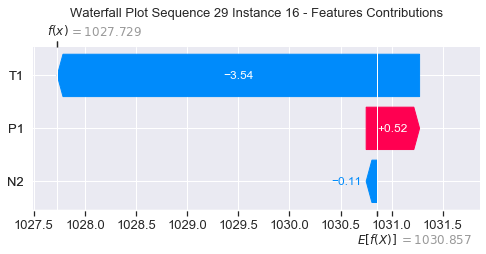

None

Contribution: [ 0.43071498 -3.24733797 -0.31373328]


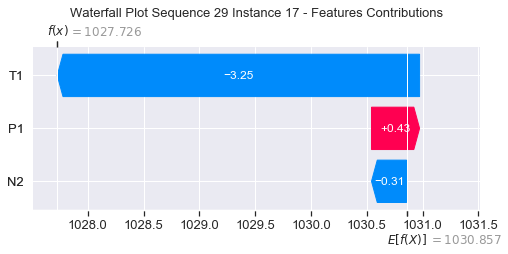

None

Contribution: [ 0.44188211 -3.40838877 -0.35919414]


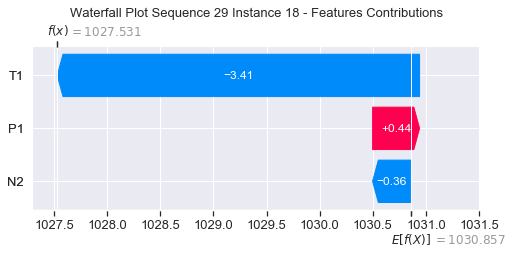

None

Contribution: [ 0.17751112 -3.04741468 -0.1932583 ]


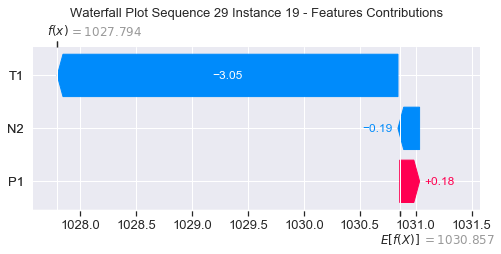

None

Contribution: [ 0.66474636 -3.88322658  0.62722331]


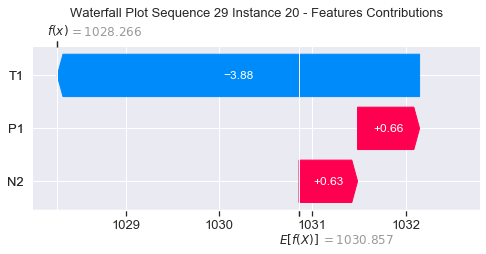

None

Contribution: [ 1.19577556 -4.72835247  2.10101955]


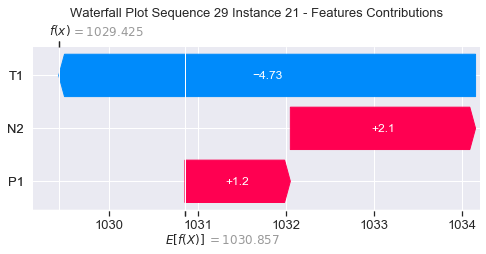

None

Contribution: [ 1.55571818 -5.78888505  4.04279759]


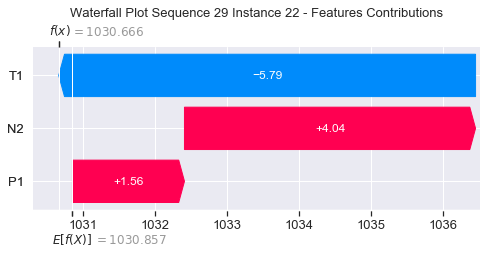

None

Contribution: [ 2.22159229 -8.07476079  5.85449327]


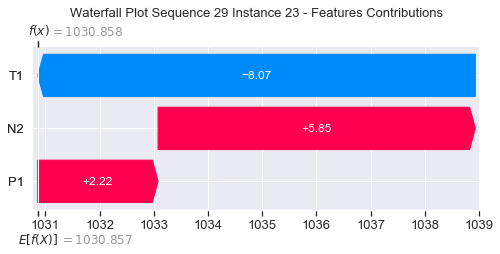

None

Contribution: [ 1.47050333 -7.60662536  5.55109853]


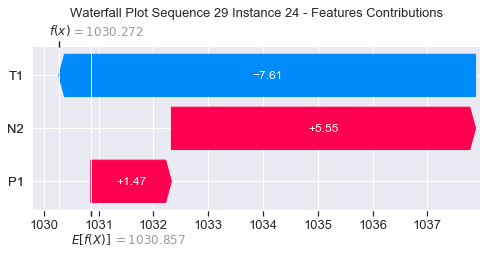

None

Contribution: [  0.3642855  -15.35417797   3.77949202]


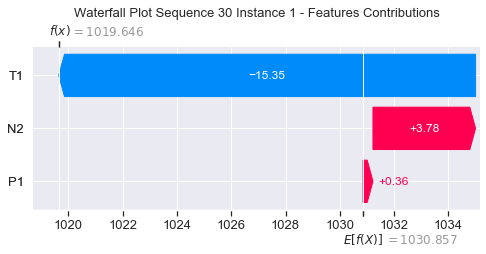

None

Contribution: [-0.21747559 -2.79691339 -0.2907506 ]


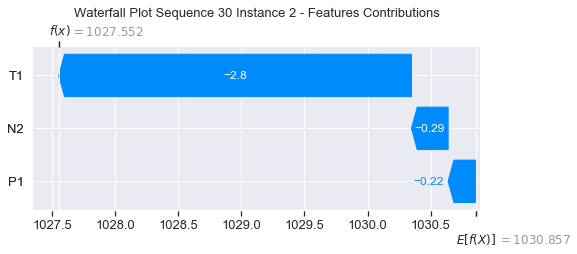

None

Contribution: [-0.04050854 -6.26847657  0.22463431]


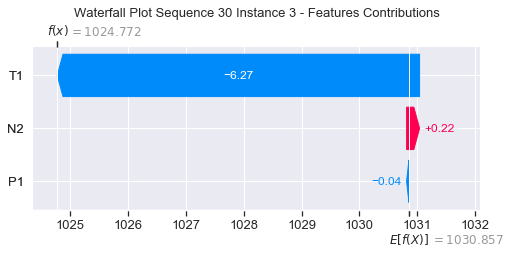

None

Contribution: [-0.37107647 -2.75144251 -0.11683411]


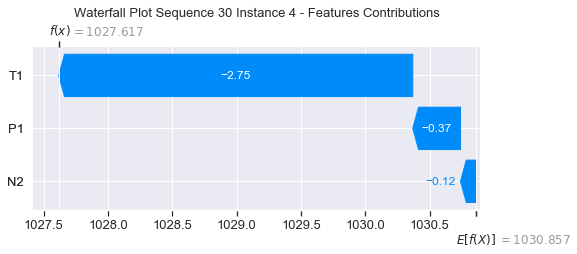

None

Contribution: [ 0.03485401 -1.49010638 -0.05036883]


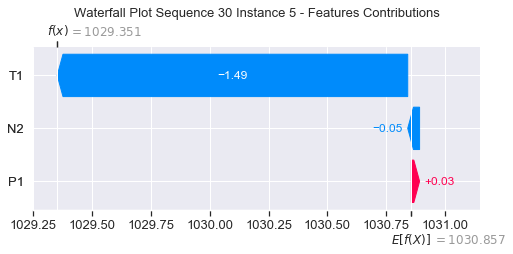

None

Contribution: [ 0.00148013 -1.47554927 -0.06051901]


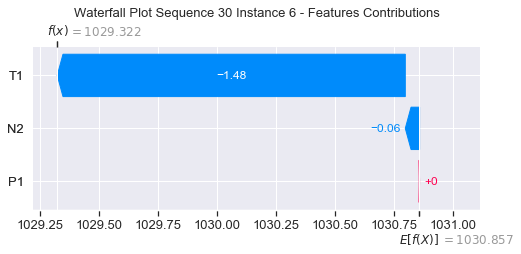

None

Contribution: [-0.00915242 -1.4322561  -0.0809866 ]


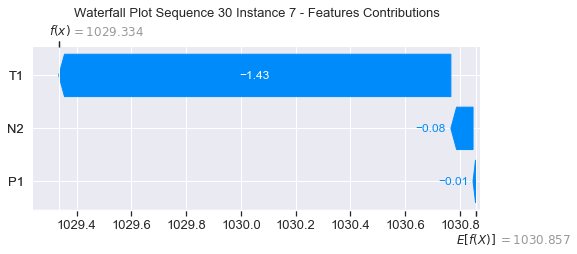

None

Contribution: [-0.01567142 -1.40272546 -0.08781747]


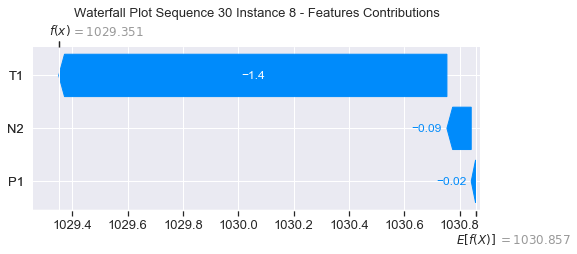

None

Contribution: [-0.06969288 -1.25964528 -0.07797765]


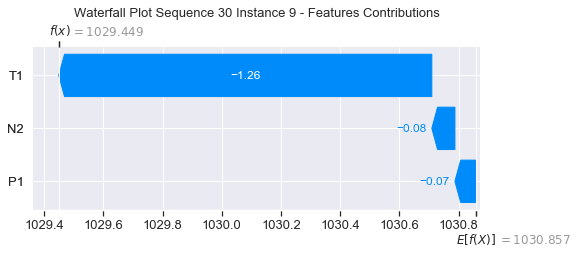

None

Contribution: [-0.0790909  -1.33169656 -0.02548183]


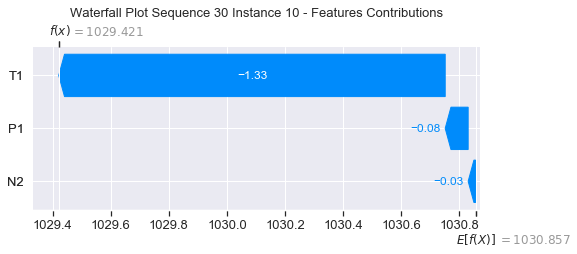

None

Contribution: [-0.08810625 -1.31028033 -0.0371721 ]


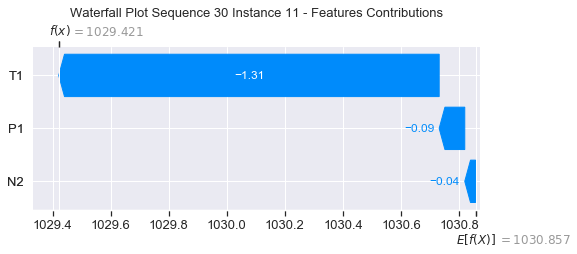

None

Contribution: [-0.0436705  -1.57949046 -0.04257687]


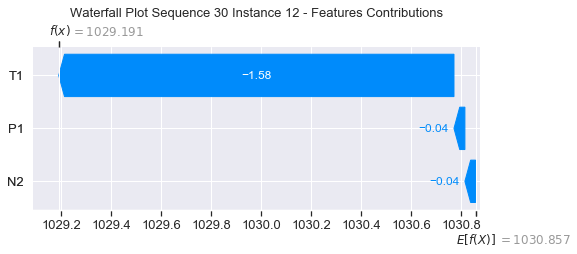

None

Contribution: [-0.02420188 -1.49839431 -0.03763108]


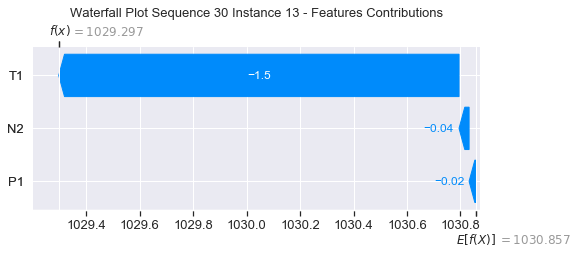

None

Contribution: [-0.01864647 -1.68358882 -0.08758126]


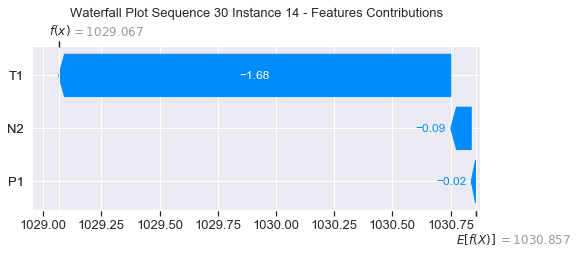

None

Contribution: [-0.06284886 -1.60970382 -0.12152178]


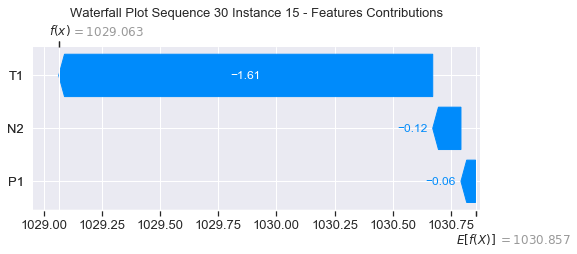

None

Contribution: [-0.07019598 -1.57771905 -0.17172265]


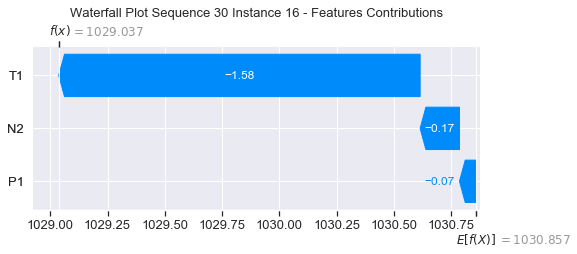

None

Contribution: [-0.11258335 -1.70451862 -0.35388605]


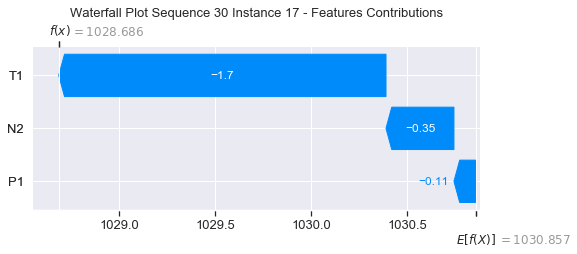

None

Contribution: [-0.12283172 -1.78367133 -0.36771126]


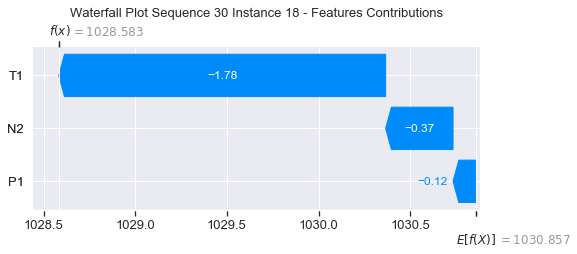

None

Contribution: [-0.05923602 -1.63509251 -0.05758766]


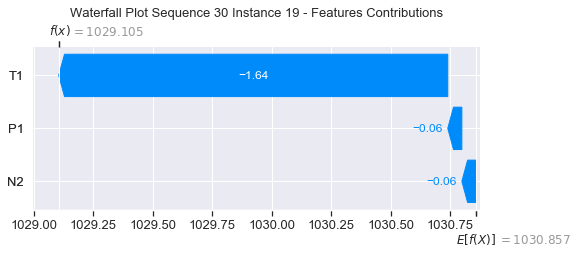

None

Contribution: [ 0.19112561 -1.70652105  0.64753553]


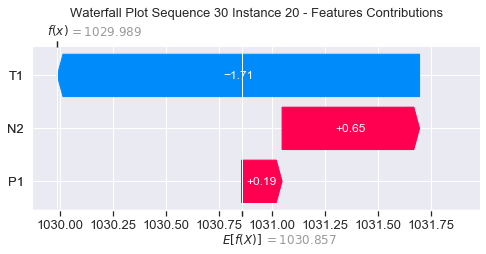

None

Contribution: [ 0.58688548 -1.78542149  2.03186989]


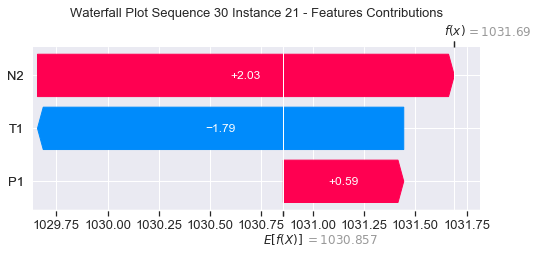

None

Contribution: [ 1.03384958 -2.25704443  3.90246555]


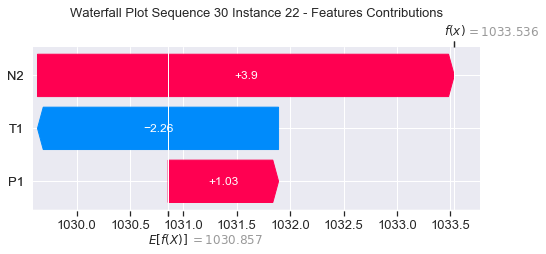

None

Contribution: [ 1.11911809 -3.74937254  5.45736397]


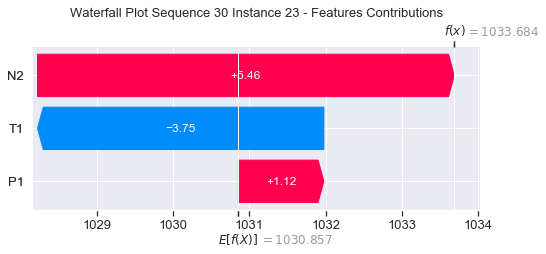

None

Contribution: [ 1.60667961 -4.93088318  5.36515466]


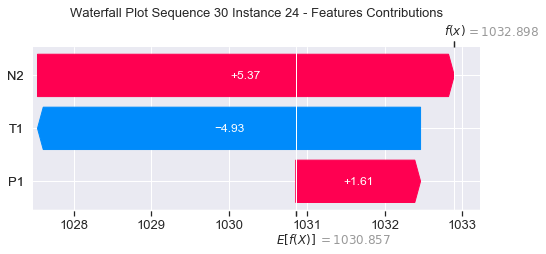

None

Contribution: [  2.72937031 -12.37688494   3.79106309]


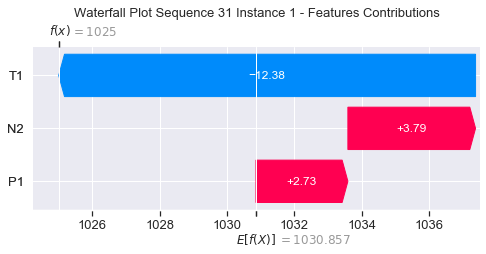

None

Contribution: [-0.13411926 -2.31450488 -0.27790217]


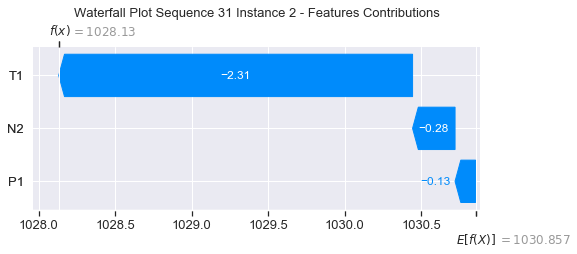

None

Contribution: [-0.07229626 -4.19555842  0.50756403]


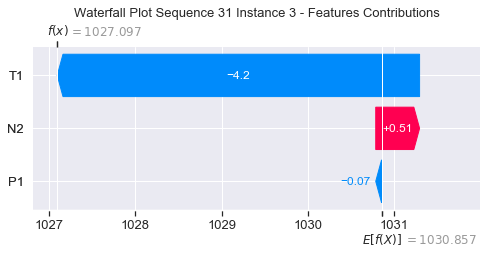

None

Contribution: [-0.10601459 -1.72170426 -0.04692647]


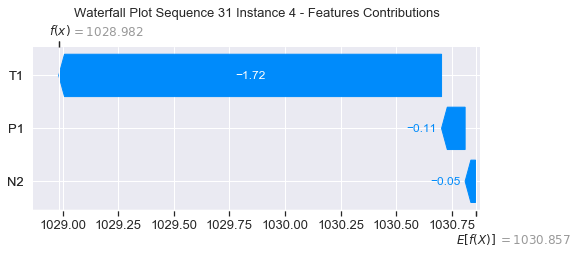

None

Contribution: [ 0.04381139 -1.52192182  0.05260974]


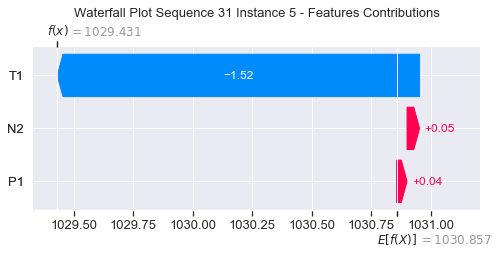

None

Contribution: [-0.04331821 -1.45169529 -0.00707854]


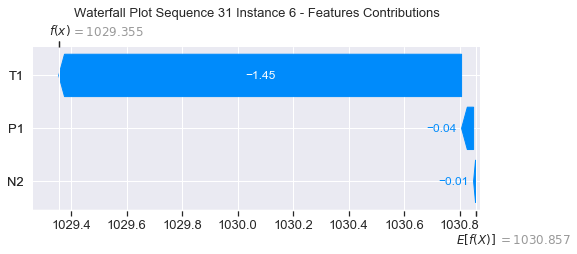

None

Contribution: [-0.03699762 -1.40773104 -0.03289574]


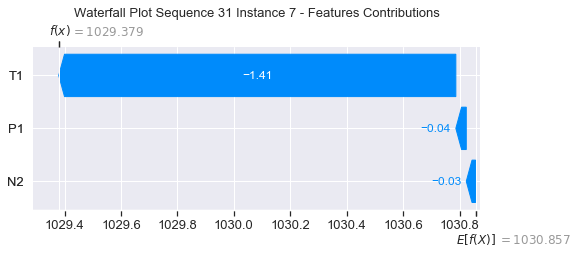

None

Contribution: [-0.02281014 -1.38633548 -0.0381322 ]


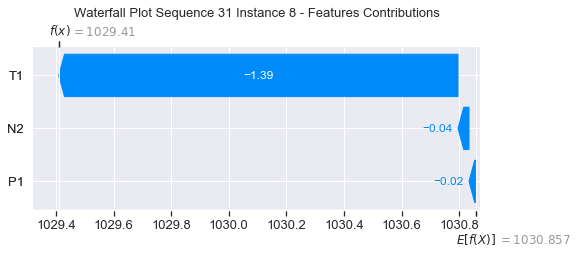

None

Contribution: [ 0.04223173 -1.34924927 -0.00899702]


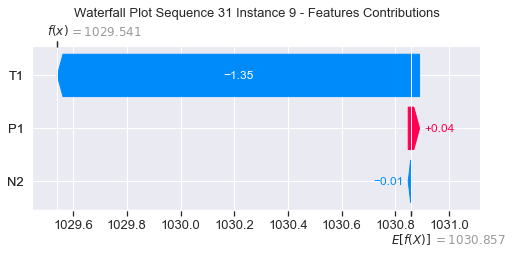

None

Contribution: [-6.21573465e-02 -1.21127607e+00 -3.70201224e-04]


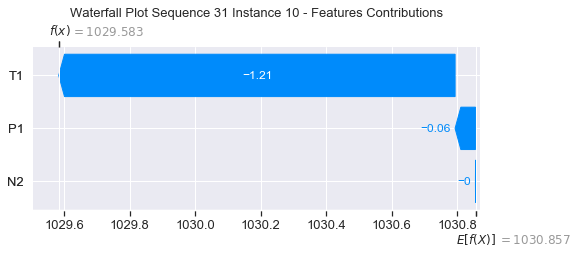

None

Contribution: [-0.0068313  -1.3258121   0.00208106]


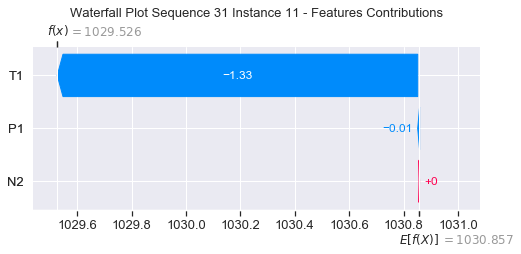

None

Contribution: [-0.05694608 -1.51212065 -0.03441185]


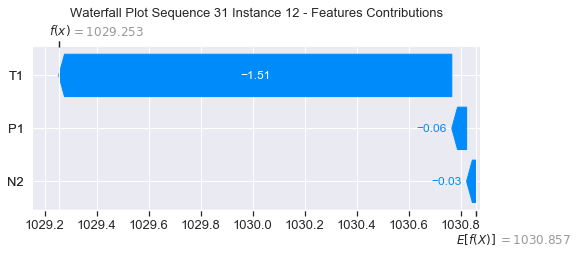

None

Contribution: [-0.02519783 -1.44255969 -0.02387295]


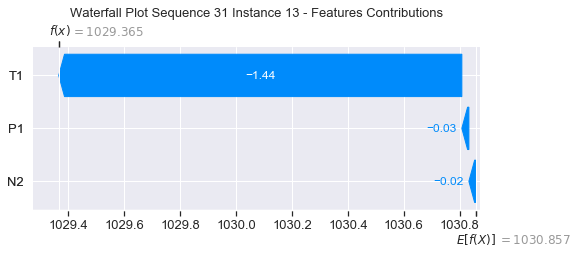

None

Contribution: [-0.05174143 -1.64174542 -0.04105925]


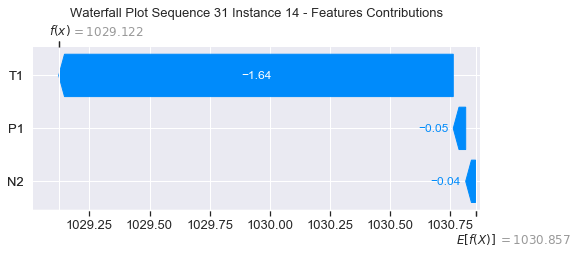

None

Contribution: [-0.06923997 -1.54437538 -0.11217724]


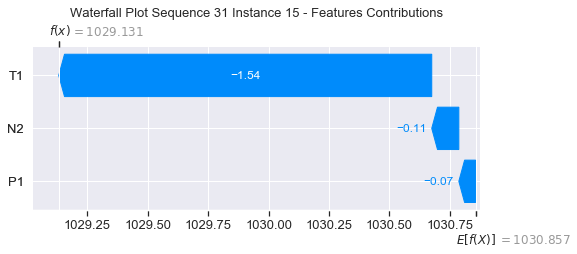

None

Contribution: [-0.08689657 -1.34208833 -0.13385206]


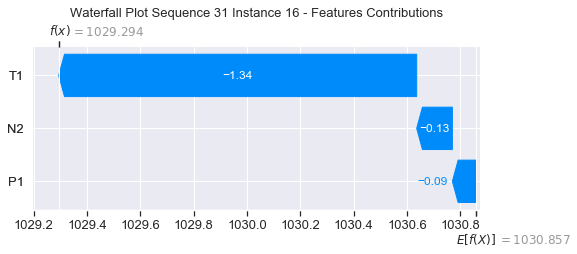

None

Contribution: [-0.08444796 -1.61965142 -0.31313943]


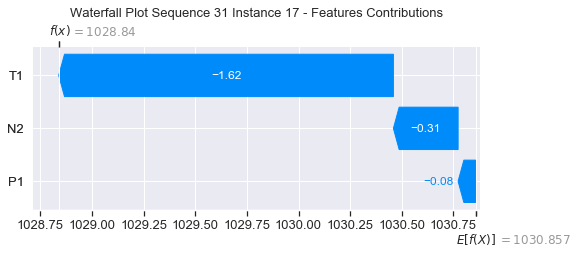

None

Contribution: [-0.08582589 -1.67430679 -0.3099525 ]


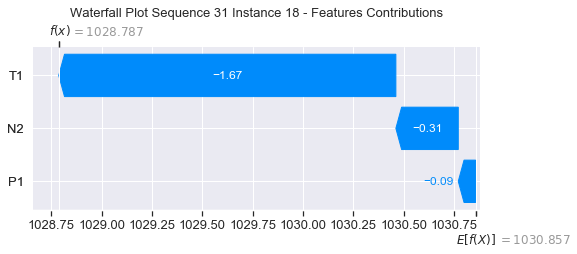

None

Contribution: [-0.1370182  -1.7423245   0.05096846]


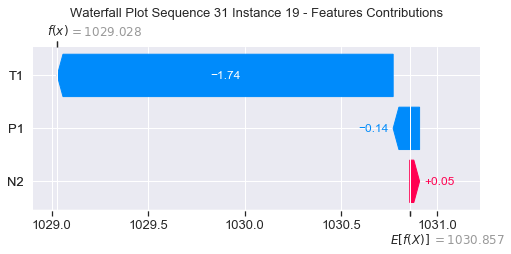

None

Contribution: [ 0.34177643 -1.59285744  0.76909694]


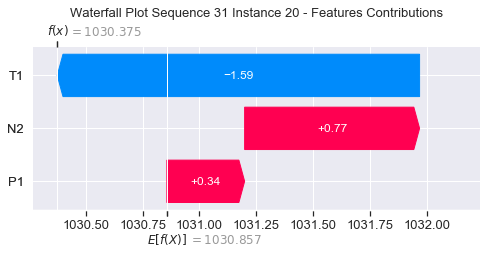

None

Contribution: [ 0.8224324  -1.63402262  2.15891997]


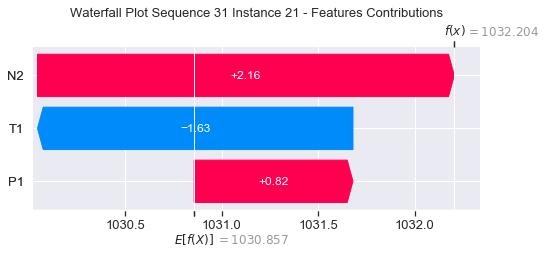

None

Contribution: [ 1.39911592 -2.06317457  4.03084952]


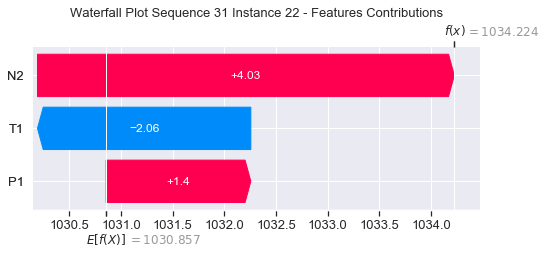

None

Contribution: [ 1.55621446 -3.41045992  5.56287542]


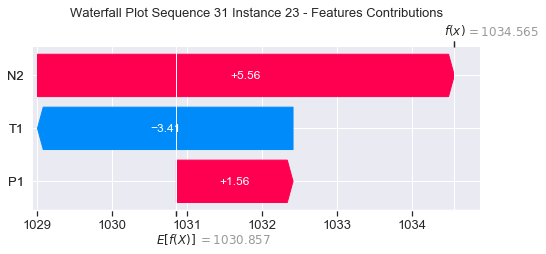

None

Contribution: [ 1.64582475 -5.52801356  5.40377975]


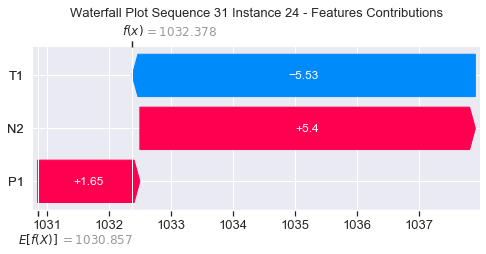

None

Contribution: [ -0.03650086 -18.09409395   2.84956576]


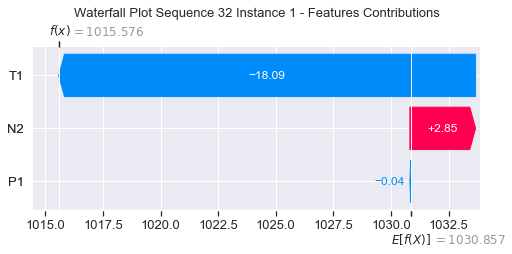

None

Contribution: [ 0.05916376 -2.30591438 -0.24829878]


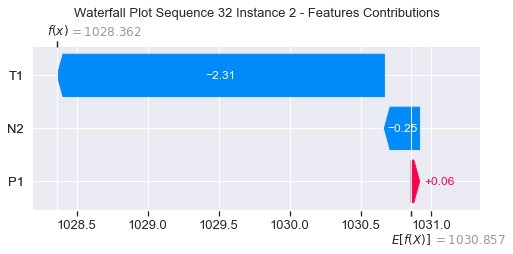

None

Contribution: [-0.33262587 -4.7142093   0.33964446]


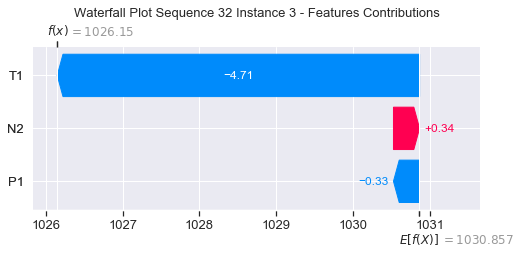

None

Contribution: [ 0.03493946 -1.88089408  0.0986386 ]


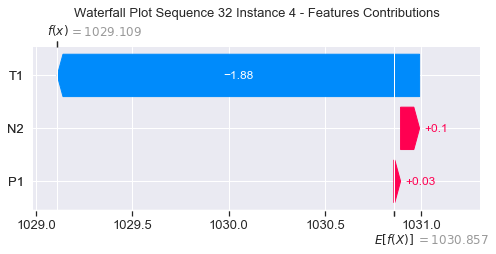

None

Contribution: [ 0.13834052 -1.60801591  0.14553134]


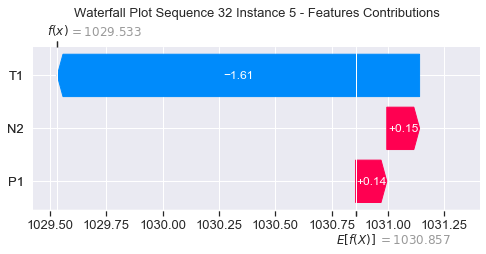

None

Contribution: [ 0.09162287 -1.55254979  0.09380339]


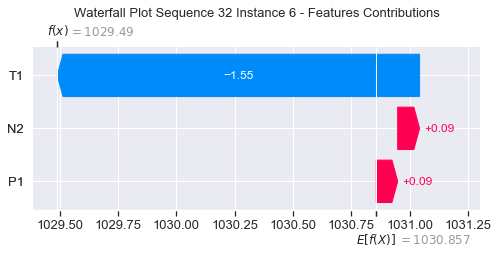

None

Contribution: [ 0.06933767 -1.49400398  0.06185801]


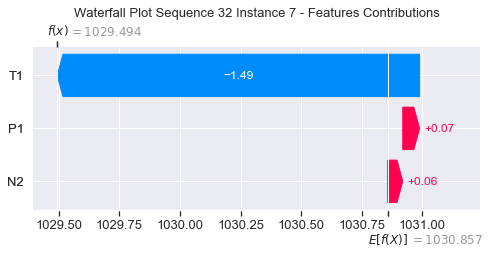

None

Contribution: [ 0.04478137 -1.47360173  0.03584365]


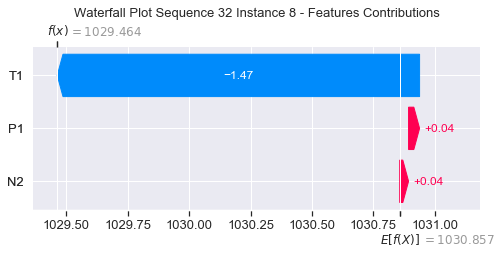

None

Contribution: [-0.14991787 -1.37063586 -0.03809726]


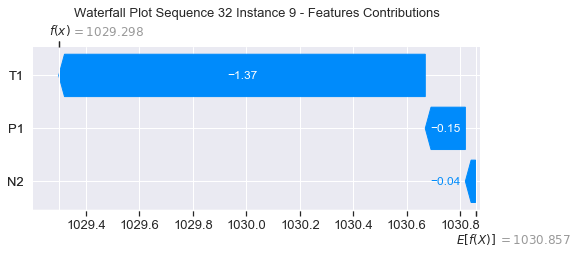

None

Contribution: [-0.25371373 -1.32667308 -0.07407701]


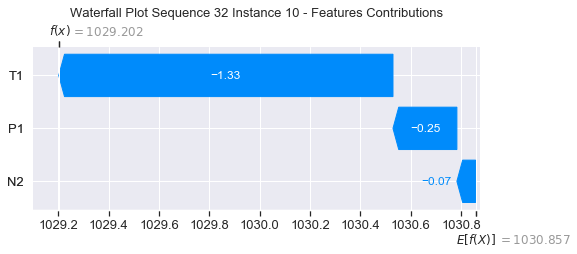

None

Contribution: [-0.11609932 -1.39922836 -0.00818272]


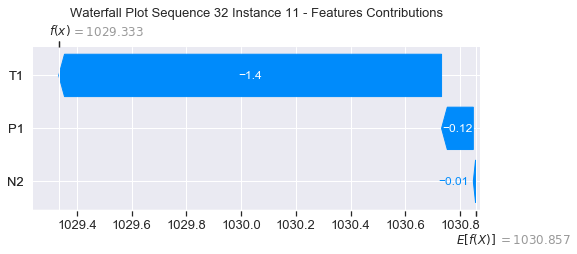

None

Contribution: [ 0.07332625 -1.52776077  0.08470909]


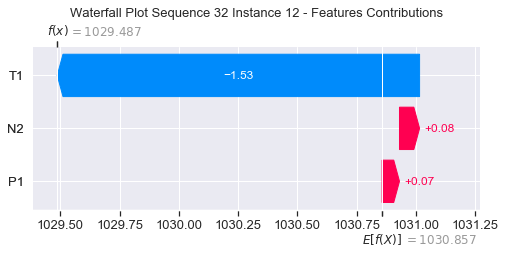

None

Contribution: [ 0.07891968 -1.47631986  0.09828314]


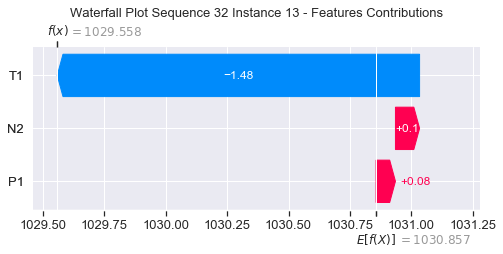

None

Contribution: [-1.10016488e-03 -1.33232685e+00  6.65876153e-02]


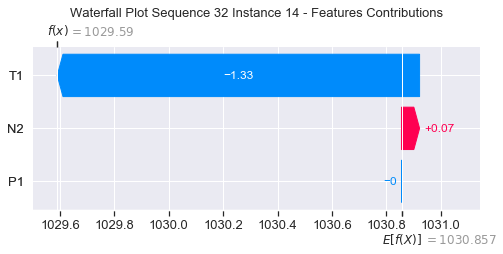

None

Contribution: [ 0.01462801 -1.66638165  0.00962749]


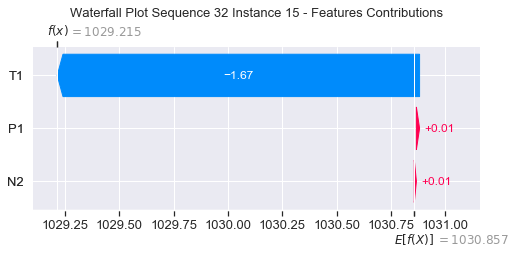

None

Contribution: [-0.15043172 -1.73732826 -0.09493146]


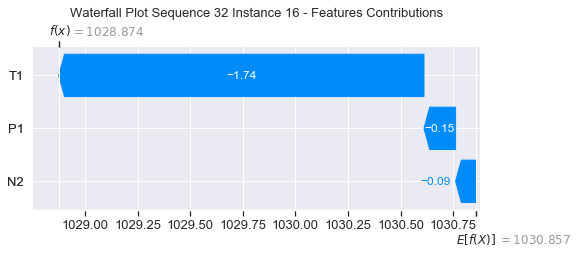

None

Contribution: [-0.04036099 -1.78517124 -0.2148045 ]


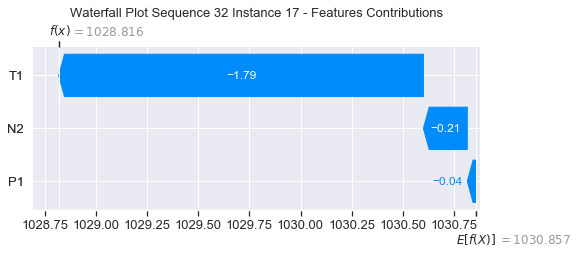

None

Contribution: [-0.04794934 -1.91500907 -0.21878671]


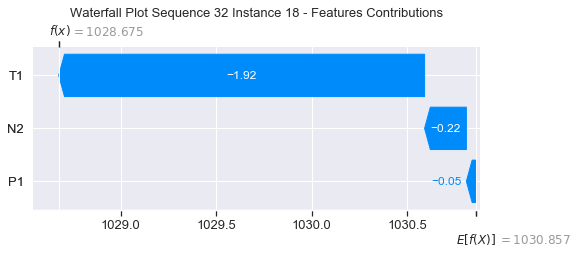

None

Contribution: [-0.38472484 -2.46849773 -0.03629734]


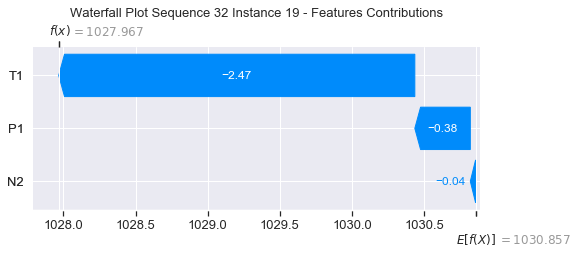

None

Contribution: [ 0.25480307 -2.17434039  0.89766285]


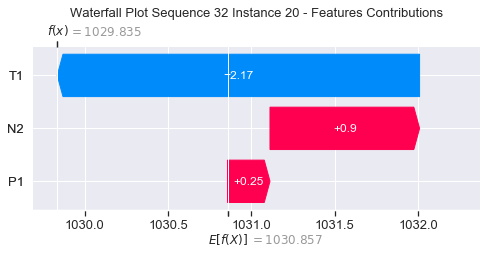

None

Contribution: [ 0.7217949  -2.41593812  2.4149504 ]


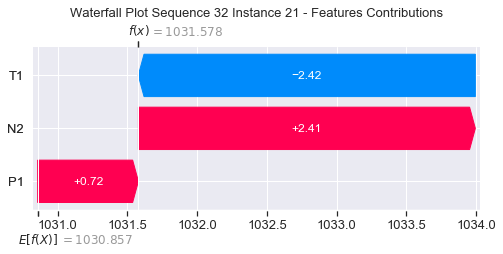

None

Contribution: [ 1.24675257 -3.32038861  4.46472518]


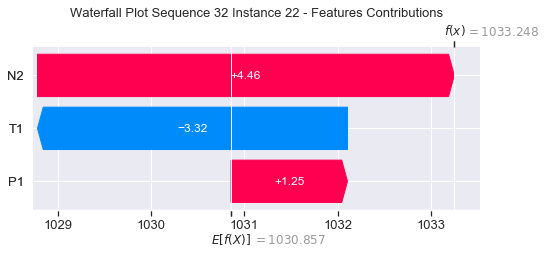

None

Contribution: [ 1.41408096 -5.23355863  6.20834621]


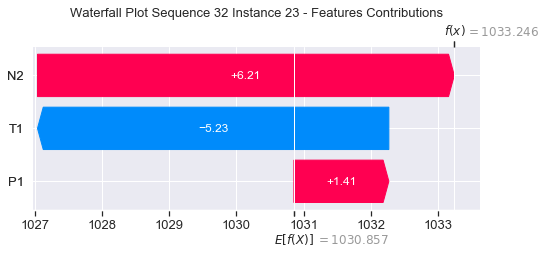

None

Contribution: [ 1.60699624 -7.12694516  6.11862807]


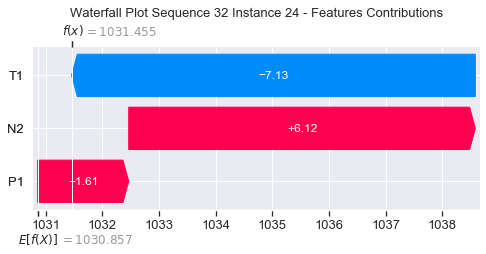

None

Contribution: [  1.21818772 -17.06197642   4.8762506 ]


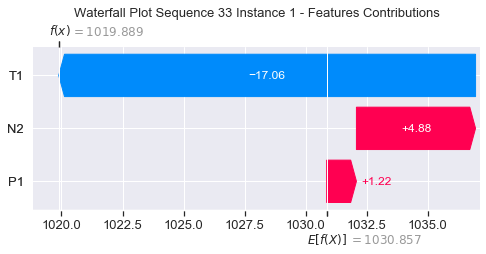

None

Contribution: [-0.03028747 -2.59959299 -0.07718464]


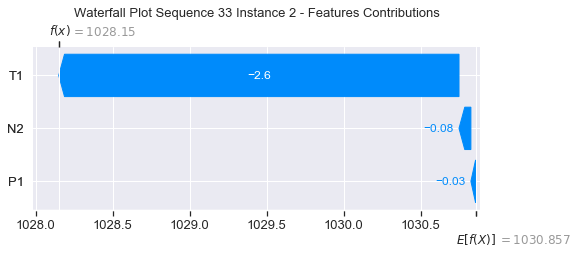

None

Contribution: [-0.40745422 -5.80424339  0.6242648 ]


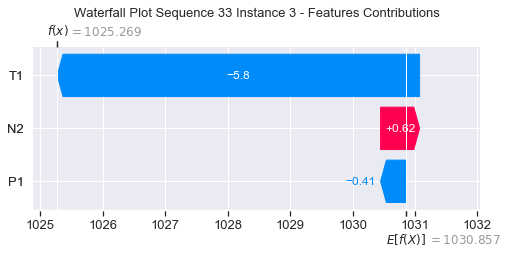

None

Contribution: [ 0.06501148 -1.77546896  0.121562  ]


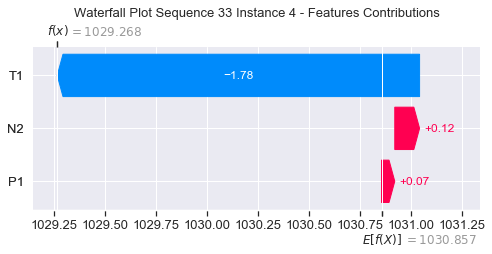

None

Contribution: [-0.07159113 -1.84545491  0.07085191]


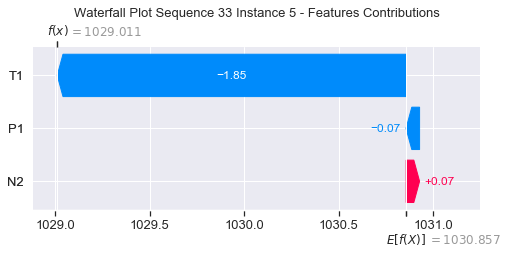

None

Contribution: [ 0.01885807 -1.67003636  0.04259765]


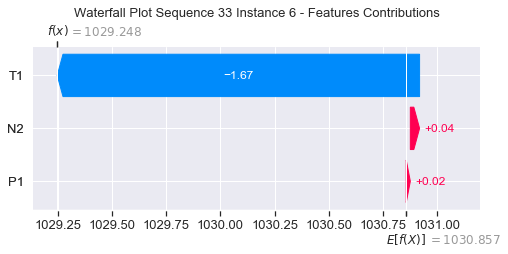

None

Contribution: [-2.07575331e-02 -1.65340344e+00 -6.24315738e-04]


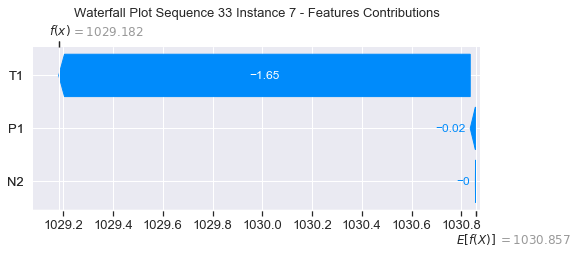

None

Contribution: [-0.04080157 -1.62380118 -0.01845762]


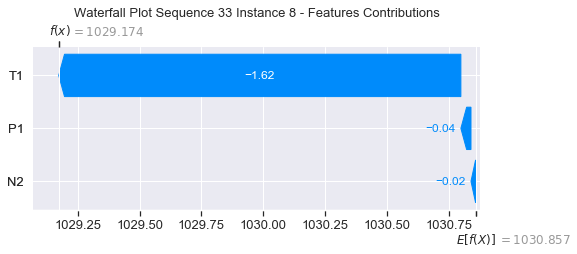

None

Contribution: [-0.27288573 -1.63518028 -0.04364656]


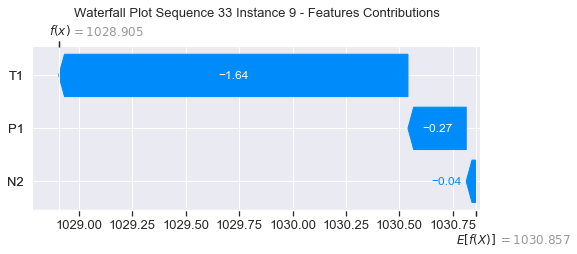

None

Contribution: [-0.24011106 -1.4758596  -0.06421078]


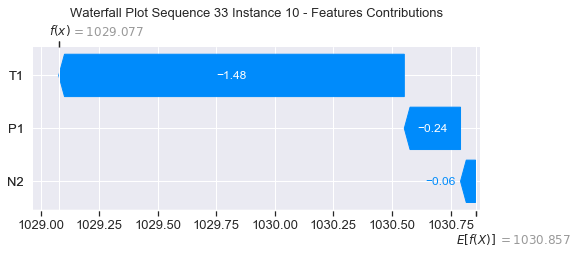

None

Contribution: [-0.14252088 -1.56750814  0.01514204]


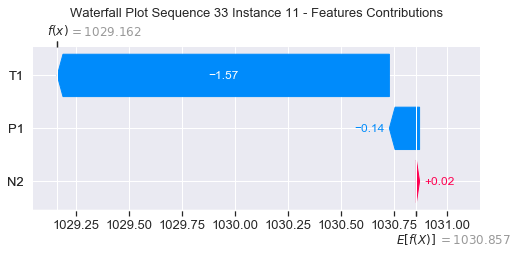

None

Contribution: [ 4.95746833e-04 -1.87458006e+00 -5.99143933e-03]


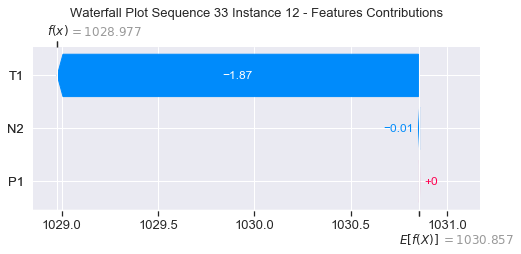

None

Contribution: [-0.01793226 -1.83706415 -0.0028117 ]


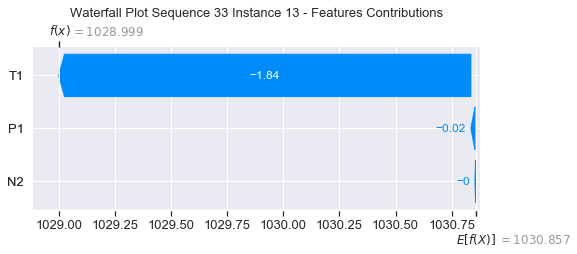

None

Contribution: [-0.04303303 -1.92843858 -0.0628624 ]


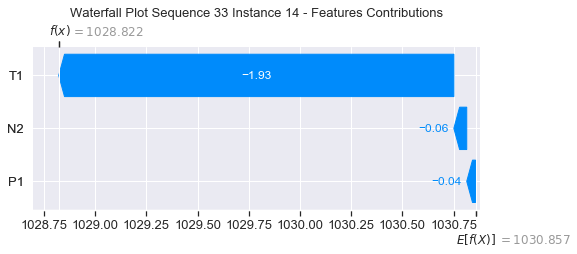

None

Contribution: [-0.05461912 -1.99909149 -0.09727629]


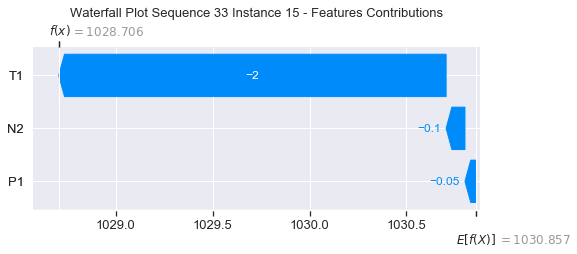

None

Contribution: [-0.18955006 -1.92337206 -0.23210711]


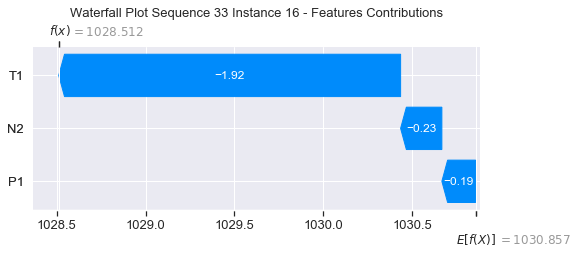

None

Contribution: [-0.1418011  -2.21093102 -0.36534664]


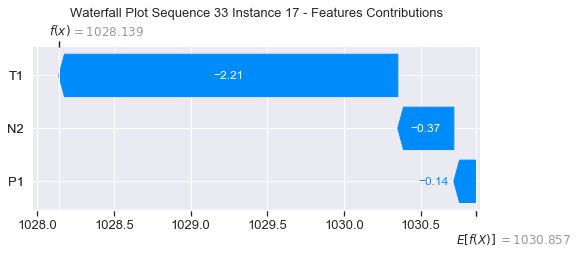

None

Contribution: [-0.14928794 -2.37446956 -0.39656704]


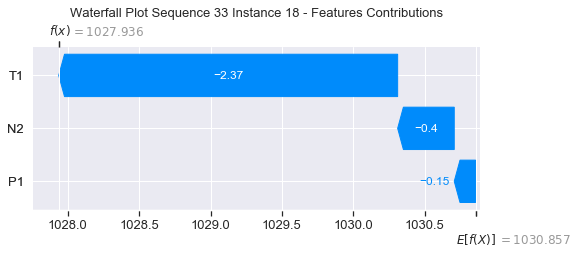

None

Contribution: [-0.34500744 -2.66811727 -0.18203287]


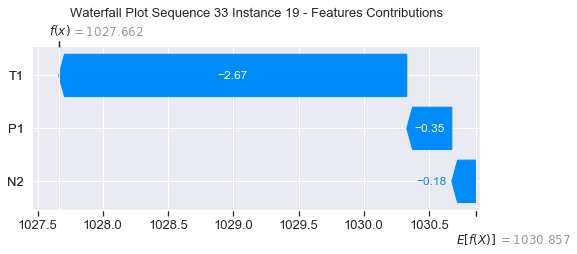

None

Contribution: [-0.02233797 -2.95968374  0.59715087]


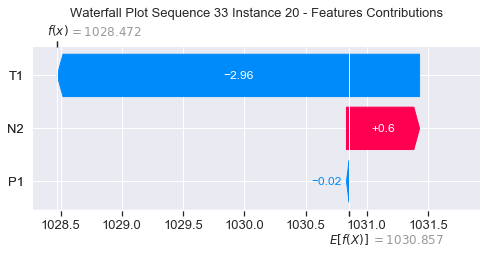

None

Contribution: [ 0.29588995 -3.69764851  1.98897087]


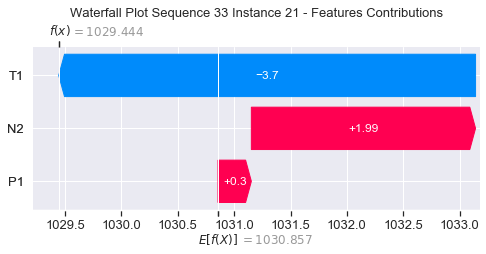

None

Contribution: [ 0.63369402 -5.21384082  3.85890528]


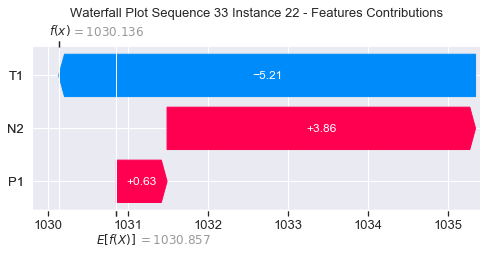

None

Contribution: [ 0.79213924 -7.57350018  5.39560619]


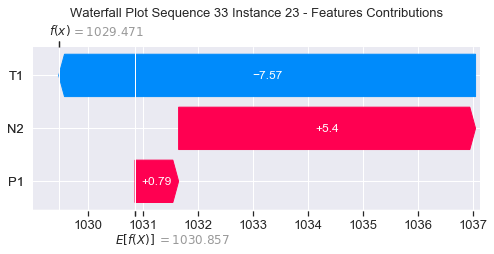

None

Contribution: [ 1.07327701 -9.13717773  5.31718849]


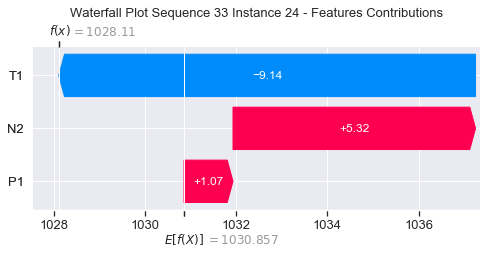

None

Contribution: [  1.07476529 -20.53682578   3.44307146]


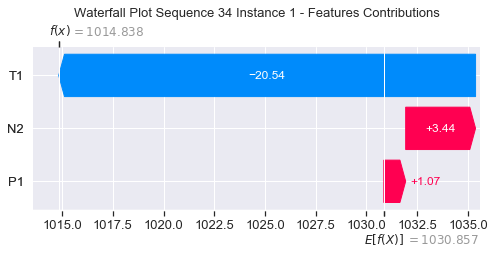

None

Contribution: [-0.30637728 -3.21292039 -0.35143972]


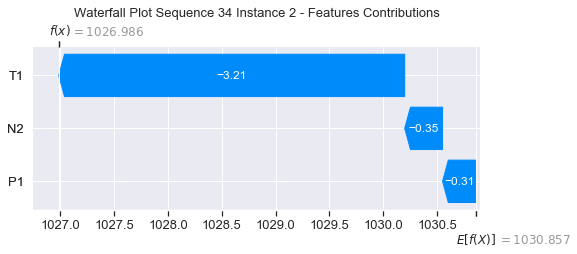

None

Contribution: [-0.26823412 -7.2146671   0.14286074]


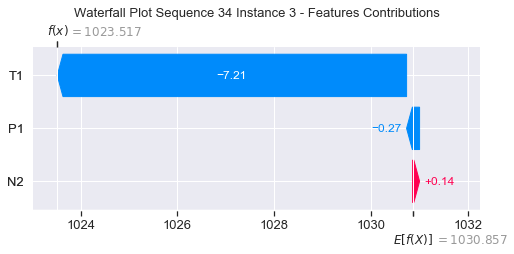

None

Contribution: [-0.14440327 -2.60459152 -0.09300594]


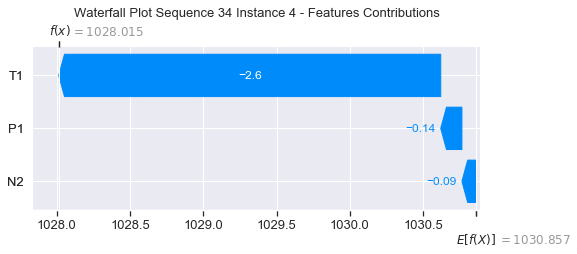

None

Contribution: [-0.14060411 -2.12541697 -0.11180463]


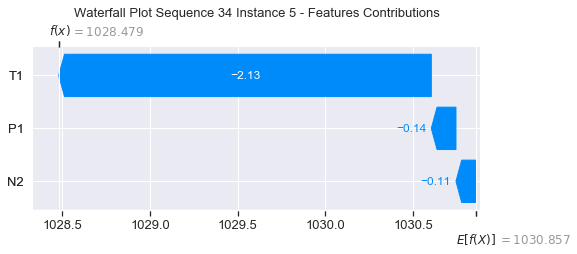

None

Contribution: [-0.123289   -1.89416456 -0.09341245]


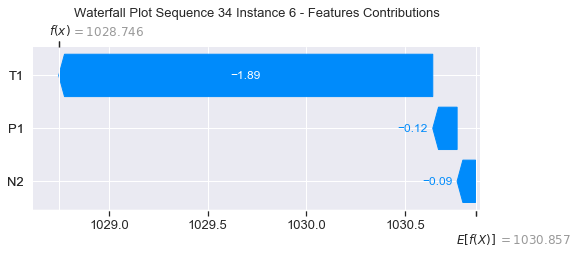

None

Contribution: [-0.12641226 -1.80967939 -0.10818281]


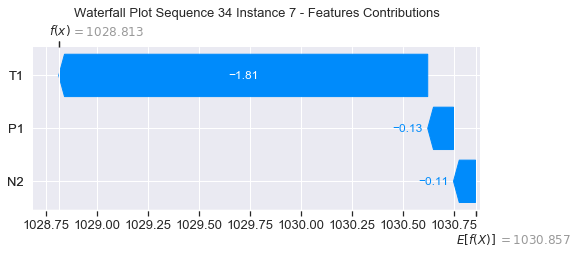

None

Contribution: [-0.15082966 -1.79877425 -0.11977553]


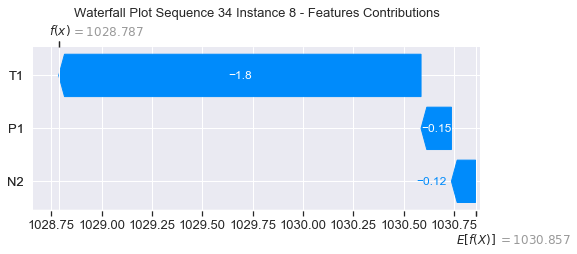

None

Contribution: [-0.30330698 -1.82134373 -0.09018001]


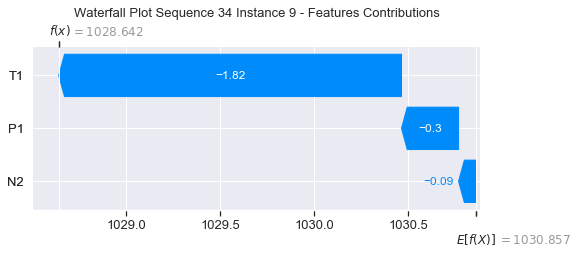

None

Contribution: [-0.36754178 -1.85041622 -0.05849993]


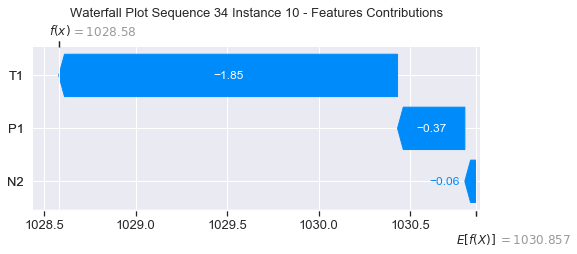

None

Contribution: [-0.33791857 -1.83956279 -0.05645215]


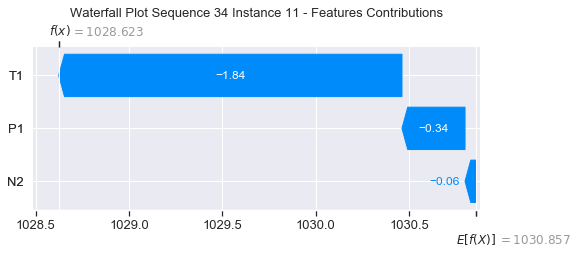

None

Contribution: [-0.22343272 -1.9430442  -0.05553673]


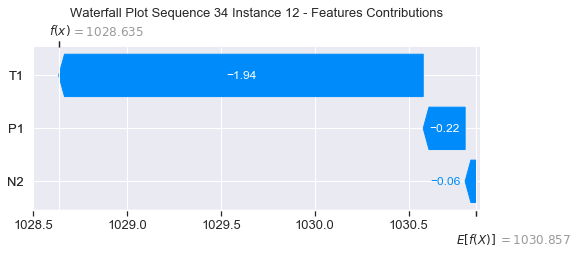

None

Contribution: [-0.20261878 -1.91928915 -0.0384451 ]


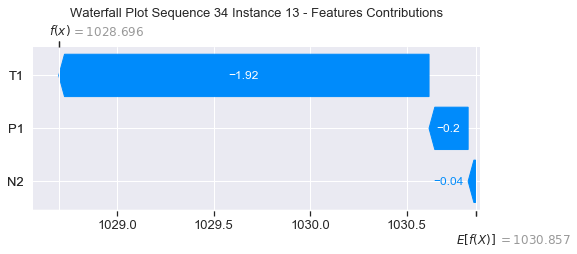

None

Contribution: [-0.36089303 -2.07421157 -0.05693715]


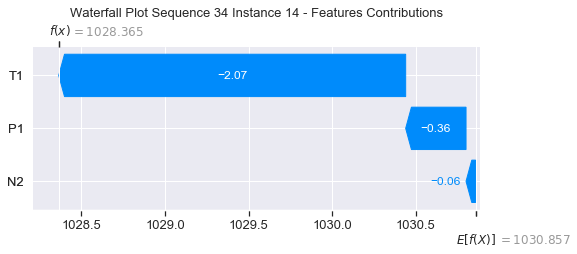

None

Contribution: [-0.21996364 -2.10165632 -0.12152094]


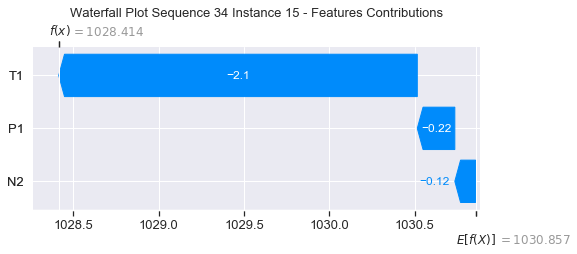

None

Contribution: [-0.20216699 -2.32401761 -0.16754259]


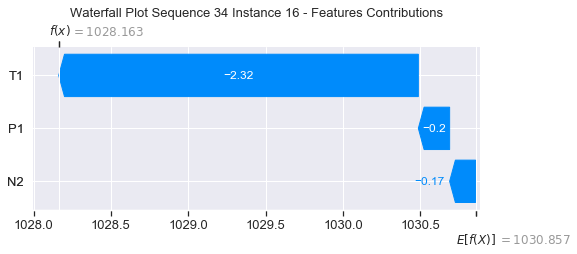

None

Contribution: [-0.2910312  -2.3524281  -0.39850439]


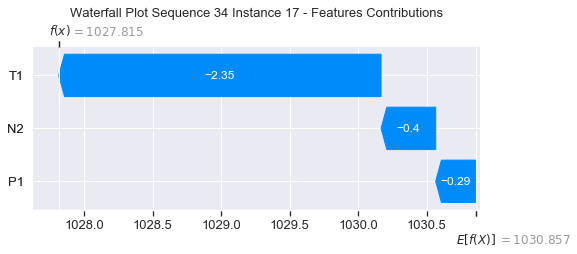

None

Contribution: [-0.32947823 -2.58503653 -0.45434445]


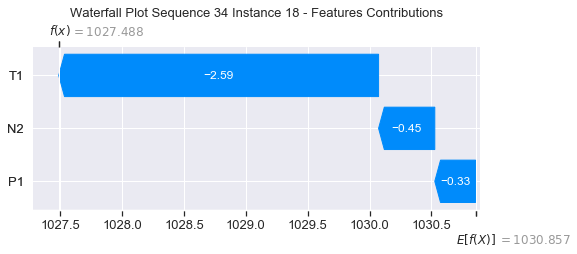

None

Contribution: [-0.5762178  -3.16752984 -0.22171249]


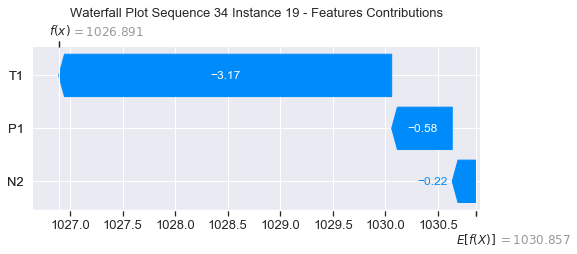

None

Contribution: [-0.11872751 -3.39473016  0.54218911]


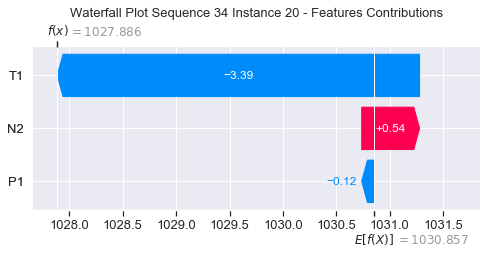

None

Contribution: [ 0.11894451 -4.27853799  1.98647449]


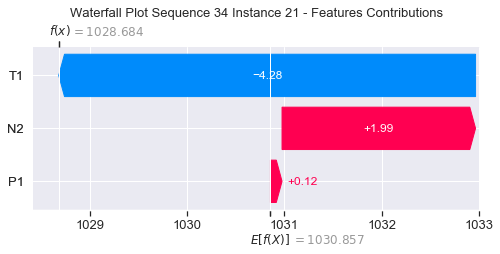

None

Contribution: [ 0.330859   -6.01901905  3.90866514]


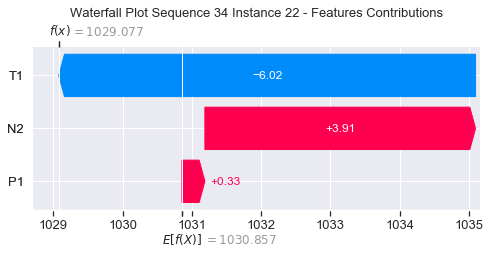

None

Contribution: [ 0.14050282 -8.68680634  5.56219145]


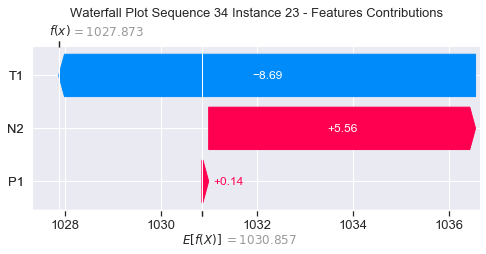

None

Contribution: [  0.62461541 -10.5706331    5.32720375]


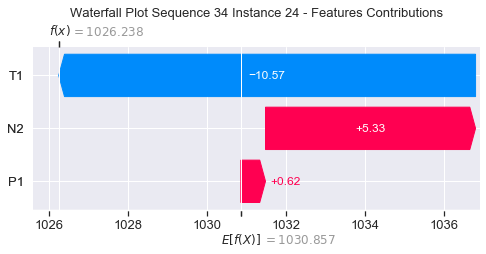

None

In [43]:
#Waterfall Plot for Consistency metric

sns.set()
instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)